In [8]:
from utils_experiment_600 import (
    load_data,
    filter_data_exp_1,
    AutoGluonProcessor,
    fit_predictors_local,
    fit_predictors_global,
    get_model_list,
    create_output_directories,
    process_and_plot_forecasts,
)

In [9]:
import torch
print("Is cuda available? {}".format(torch.cuda.is_available()))
torch.cuda.get_device_name(torch.cuda.current_device())

Is cuda available? True


'Tesla T4'

## Experiment 1 Details

Experiment 1 serves as a baseline for comparing the effect of different window lengths for training. The data will be filtered to include only time series that are available in the time period. To investiage the effect of the time series by themselves, the number of covariates is kept constant across all time series and corresponds to the time series fully available from 1986. The specific time periods were chosen with the condition that between each interval, 5 or more new time series were introduced.

| Time Period - 2024     | Maximum number of covariates | Number of covariates used |
|--------------|:-----:| :-----:| 
| 1986 |   94  |   94  |  
| 1997 |   111  |  94  |  
| 2004 |   133  |   94  |  
| 2007 |   146  |  94  |  
| 2010 |   154  |  94  |  
| 2018 |   159  |  94  |  


The cut-off dates are set at 4 yearly intervals between 2020 and 2024. Since the minimum training length for a yearly interval is 2 years, 2020 is the earliest cut-off date we can use.


In [10]:
exp_test_description = "Full_Report"
report_sim_dates = open("/h/kupfersk/cfpr_2025/generate_forecasts/experiment_cutoff_dates.txt", 'r').read().split()
# report_sim_dates=report_sim_dates[:-1]

target_categories = [
    'Bakery and cereal products (excluding baby food)',
     'Dairy products and eggs',
     'Fish, seafood and other marine products',
     'Food purchased from restaurants',
     'Food',
     'Fruit, fruit preparations and nuts',
     'Meat',
     'Other food products and non-alcoholic beverages',
     'Vegetables and vegetable preparations'
]

target_categories = [f"food_cpi: {col}" for col in target_categories]

start_year = 1986
random_seed = 42

print("Target Categories:\n" + '\n'.join(target_categories))
print("Report Simulation Dates:\n" + '\n'.join(report_sim_dates))


Target Categories:
food_cpi: Bakery and cereal products (excluding baby food)
food_cpi: Dairy products and eggs
food_cpi: Fish, seafood and other marine products
food_cpi: Food purchased from restaurants
food_cpi: Food
food_cpi: Fruit, fruit preparations and nuts
food_cpi: Meat
food_cpi: Other food products and non-alcoholic beverages
food_cpi: Vegetables and vegetable preparations
Report Simulation Dates:
2018-07-01
2019-07-01
2020-07-01
2021-07-01
2022-07-01
2023-07-01


## Load data

`all_data`: dataframe with all the food cpi variables and all the covariates from 1986 to 2024.\
`foodprice_df`: dataframe with only the food cpi variables from 1986 to 2024.\
`target_categories`: list of the names of the food cpi variables.\
`all_covariates`: dataframe with all the covariates from 1986 to 2024.

In [11]:
file_path = "/h/kupfersk/cfpr_2025/data/processed_data/all_select.csv"
all_data, foodprice_df, target_categories, all_covariates = load_data(target_categories, file_path)
all_data = all_data.asfreq("MS")
foodprice_df = foodprice_df.asfreq("MS")
all_covariates = all_covariates.asfreq("MS")


In [12]:
# all_data = filter_data_exp_1(all_data, start_year)
processor = AutoGluonProcessor(all_data, target_categories)


# Experiment List

| AutoGluon Model \ Experiment      | local | global | global + covariates |
|--------------|:-----:| :-----: | :-----: |
| NaiveModel |   x  |   |  | 
| SeasonalNaiveModel|   x    |  |  | 
| AutoARIMAModel|   x   |  |  | 
| AutoETSModel|  x  |    |  | 
| DeepARModel|  x   | x |  x | 
| DLinearModel| x   | x |  x| 
| PatchTSTModel|  x   | x | x |   
|SimpleFeedForwardModel|  x   | x | x |   
| TemporalFusionTransformerModel| x  | x | x |   
| DirectTabularModel| x   | x | x | 
|RecursiveTabularModel|  x   | x | x |  
|ChronosModel|  x   | x | x | 

x - model type supported


# Main experiment loop - global models

5 main loops:
- The first loop goes through the list of years at which we want the time window to start, filters out the covariates that are not fully available from 1986.
- The second loop goes though the two experiment base (global and global+covariates)
- The third loop goes though 8 Autogluon models, excluding all statistical models (Naive, SeasonalNaive, AutoArima, AutoETS).
- The fourth loop goes through each of the yearly cut-off dates to trim the training data.
- The fifth loop goes through each of the 9 food categories, gets the training data in the AutoGluon format depending on the experiment base and plot each prediction period againt the actual values.

In [13]:
import json

# Load the dictionary from the JSON file
with open('experiment_dict_IND.json', 'r') as json_file:
    experiment_dict = json.load(json_file)
    
experiment_dict

{'Bakery and cereal products (excluding baby food)': ['exp2_R3_Bakery and cereal products (excluding baby food).txt',
  'exp2_GPT_P3_Bakery and cereal products (excluding baby food).txt',
  'exp2_R2_Bakery and cereal products (excluding baby food).txt',
  'exp2_GPT_P2_Bakery and cereal products (excluding baby food).txt',
  'exp2_R1_Bakery and cereal products (excluding baby food).txt',
  'exp2_R4_Bakery and cereal products (excluding baby food).txt',
  'exp2_GPT_P1_Bakery and cereal products (excluding baby food).txt',
  'exp2_GPT_P4_Bakery and cereal products (excluding baby food).txt'],
 'Dairy products and eggs': ['exp2_R3_Dairy products and eggs.txt',
  'exp2_GPT_P1_Dairy products and eggs.txt',
  'exp2_GPT_P3_Dairy products and eggs.txt',
  'exp2_GPT_P2_Dairy products and eggs.txt',
  'exp2_R4_Dairy products and eggs.txt',
  'exp2_R1_Dairy products and eggs.txt',
  'exp2_R2_Dairy products and eggs.txt',
  'exp2_GPT_P4_Dairy products and eggs.txt'],
 'Fish, seafood and other marin

Beginning AutoGluon training... Time limit = 2s
AutoGluon will save models to './output/TEST/ag_global_all_TemporalFusionTransformerModel_exp2_R3_/random_seed_42/2018-07-01/model_files/'
=================== System Info ===================
AutoGluon Version:  1.1.1
Python Version:     3.8.20
Operating System:   Linux
Platform Machine:   x86_64
Platform Version:   #147~18.04.1-Ubuntu SMP Sat Oct 15 13:10:18 UTC 2022
CPU Count:          32
GPU Count:          1
Memory Avail:       166.24 GB / 188.57 GB (88.2%)
Disk Space Avail:   18215.11 GB / 249006.62 GB (7.3%)

Fitting with arguments:
{'enable_ensemble': True,
 'eval_metric': MAPE,
 'excluded_model_types': ['DirectTabular', 'RecursiveTabular'],
 'hyperparameters': {'TemporalFusionTransformerModel': {}},
 'known_covariates_names': [],
 'num_val_windows': 1,
 'prediction_length': 18,
 'quantile_levels': [0.01, 0.05, 0.1, 0.25, 0.75, 0.9, 0.95, 0.99],
 'random_seed': 42,
 'refit_every_n_windows': 1,
 'refit_full': False,
 'skip_model_sele

ag_global_all_TemporalFusionTransformerModel
TemporalFusionTransformerModel


Inferred time series frequency: 'MS'
Provided train_data has 8602 rows (NaN fraction=0.1%), 22 time series. Median time series length is 391 (min=391, max=391). 

Provided data contains following columns:
	target: 'target'

AutoGluon will gauge predictive performance using evaluation metric: 'MAPE'
	This metric's sign has been flipped to adhere to being higher_is_better. The metric score can be multiplied by -1 to get the metric value.

Starting training. Start time is 2024-10-27 07:28:38
Excluded model types: ['DirectTabular', 'RecursiveTabular']
Models that will be trained: ['TemporalFusionTransformer']
Training timeseries model TemporalFusionTransformer. Training for up to 1.9s of the 1.9s of remaining time.
	-1.7939       = Validation score (-MAPE)
	2.14    s     = Training runtime
	0.04    s     = Validation (prediction) runtime
Not fitting ensemble due to lack of time remaining. Time left: -0.3 seconds
Training complete. Models trained: ['TemporalFusionTransformer']
Total runtime

****************** Summary of fit() ******************
Estimated performance of each model:
                       model  score_val  pred_time_val  fit_time_marginal  \
0  TemporalFusionTransformer  -1.793923       0.041591           2.139294   

   fit_order  
0          1  
Number of models trained: 1
Types of models trained:
{'MultiWindowBacktestingModel'}
****************** End of fit() summary ******************


Model not specified in predict, will default to the model with the best validation score: TemporalFusionTransformer


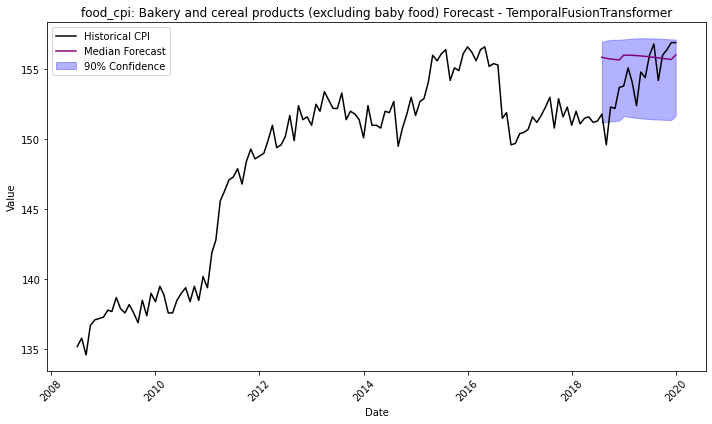

Beginning AutoGluon training... Time limit = 2s
AutoGluon will save models to './output/TEST/ag_global_all_TemporalFusionTransformerModel_exp2_GPT_P3_/random_seed_42/2018-07-01/model_files/'
=================== System Info ===================
AutoGluon Version:  1.1.1
Python Version:     3.8.20
Operating System:   Linux
Platform Machine:   x86_64
Platform Version:   #147~18.04.1-Ubuntu SMP Sat Oct 15 13:10:18 UTC 2022
CPU Count:          32
GPU Count:          1
Memory Avail:       166.20 GB / 188.57 GB (88.1%)
Disk Space Avail:   18215.10 GB / 249006.62 GB (7.3%)

Fitting with arguments:
{'enable_ensemble': True,
 'eval_metric': MAPE,
 'excluded_model_types': ['DirectTabular', 'RecursiveTabular'],
 'hyperparameters': {'TemporalFusionTransformerModel': {}},
 'known_covariates_names': [],
 'num_val_windows': 1,
 'prediction_length': 18,
 'quantile_levels': [0.01, 0.05, 0.1, 0.25, 0.75, 0.9, 0.95, 0.99],
 'random_seed': 42,
 'refit_every_n_windows': 1,
 'refit_full': False,
 'skip_model_

TemporalFusionTransformerModel


	-2.7314       = Validation score (-MAPE)
	2.16    s     = Training runtime
	0.04    s     = Validation (prediction) runtime
Not fitting ensemble due to lack of time remaining. Time left: -0.3 seconds
Training complete. Models trained: ['TemporalFusionTransformer']
Total runtime: 2.25 s
Best model: TemporalFusionTransformer
Best model score: -2.7314
Model not specified in predict, will default to the model with the best validation score: TemporalFusionTransformer
Model not specified in predict, will default to the model with the best validation score: TemporalFusionTransformer


****************** Summary of fit() ******************
Estimated performance of each model:
                       model  score_val  pred_time_val  fit_time_marginal  \
0  TemporalFusionTransformer  -2.731435       0.041326           2.156712   

   fit_order  
0          1  
Number of models trained: 1
Types of models trained:
{'MultiWindowBacktestingModel'}
****************** End of fit() summary ******************


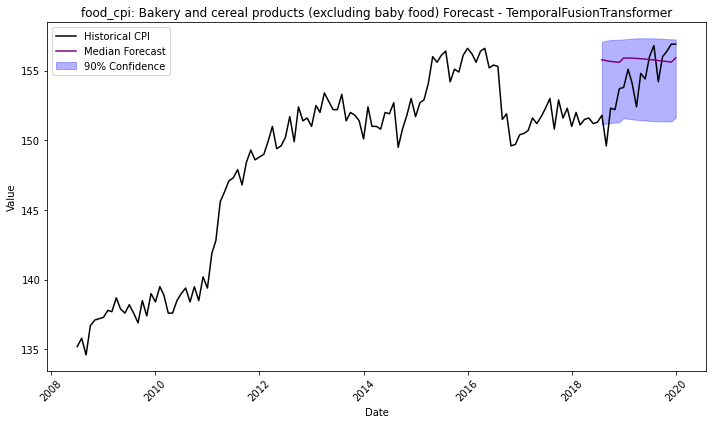

Beginning AutoGluon training... Time limit = 2s
AutoGluon will save models to './output/TEST/ag_global_all_TemporalFusionTransformerModel_exp2_R2_/random_seed_42/2018-07-01/model_files/'
=================== System Info ===================
AutoGluon Version:  1.1.1
Python Version:     3.8.20
Operating System:   Linux
Platform Machine:   x86_64
Platform Version:   #147~18.04.1-Ubuntu SMP Sat Oct 15 13:10:18 UTC 2022
CPU Count:          32
GPU Count:          1
Memory Avail:       166.13 GB / 188.57 GB (88.1%)
Disk Space Avail:   18215.15 GB / 249006.62 GB (7.3%)

Fitting with arguments:
{'enable_ensemble': True,
 'eval_metric': MAPE,
 'excluded_model_types': ['DirectTabular', 'RecursiveTabular'],
 'hyperparameters': {'TemporalFusionTransformerModel': {}},
 'known_covariates_names': [],
 'num_val_windows': 1,
 'prediction_length': 18,
 'quantile_levels': [0.01, 0.05, 0.1, 0.25, 0.75, 0.9, 0.95, 0.99],
 'random_seed': 42,
 'refit_every_n_windows': 1,
 'refit_full': False,
 'skip_model_sele

TemporalFusionTransformerModel


	-0.7255       = Validation score (-MAPE)
	2.13    s     = Training runtime
	0.04    s     = Validation (prediction) runtime
Not fitting ensemble due to lack of time remaining. Time left: -0.3 seconds
Training complete. Models trained: ['TemporalFusionTransformer']
Total runtime: 2.21 s
Best model: TemporalFusionTransformer
Best model score: -0.7255
Model not specified in predict, will default to the model with the best validation score: TemporalFusionTransformer
Model not specified in predict, will default to the model with the best validation score: TemporalFusionTransformer


****************** Summary of fit() ******************
Estimated performance of each model:
                       model  score_val  pred_time_val  fit_time_marginal  \
0  TemporalFusionTransformer  -0.725474       0.042643           2.130669   

   fit_order  
0          1  
Number of models trained: 1
Types of models trained:
{'MultiWindowBacktestingModel'}
****************** End of fit() summary ******************


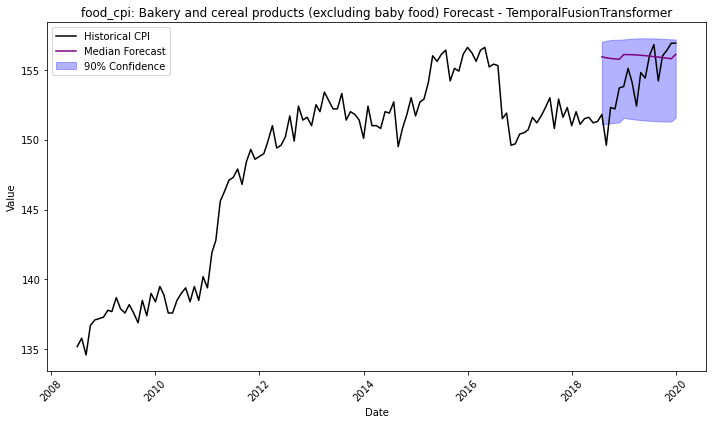

Beginning AutoGluon training... Time limit = 2s
AutoGluon will save models to './output/TEST/ag_global_all_TemporalFusionTransformerModel_exp2_GPT_P2_/random_seed_42/2018-07-01/model_files/'
=================== System Info ===================
AutoGluon Version:  1.1.1
Python Version:     3.8.20
Operating System:   Linux
Platform Machine:   x86_64
Platform Version:   #147~18.04.1-Ubuntu SMP Sat Oct 15 13:10:18 UTC 2022
CPU Count:          32
GPU Count:          1
Memory Avail:       166.12 GB / 188.57 GB (88.1%)
Disk Space Avail:   18215.14 GB / 249006.62 GB (7.3%)

Fitting with arguments:
{'enable_ensemble': True,
 'eval_metric': MAPE,
 'excluded_model_types': ['DirectTabular', 'RecursiveTabular'],
 'hyperparameters': {'TemporalFusionTransformerModel': {}},
 'known_covariates_names': [],
 'num_val_windows': 1,
 'prediction_length': 18,
 'quantile_levels': [0.01, 0.05, 0.1, 0.25, 0.75, 0.9, 0.95, 0.99],
 'random_seed': 42,
 'refit_every_n_windows': 1,
 'refit_full': False,
 'skip_model_

TemporalFusionTransformerModel


	-2.4914       = Validation score (-MAPE)
	2.15    s     = Training runtime
	0.05    s     = Validation (prediction) runtime
Not fitting ensemble due to lack of time remaining. Time left: -0.3 seconds
Training complete. Models trained: ['TemporalFusionTransformer']
Total runtime: 2.23 s
Best model: TemporalFusionTransformer
Best model score: -2.4914
Model not specified in predict, will default to the model with the best validation score: TemporalFusionTransformer
Model not specified in predict, will default to the model with the best validation score: TemporalFusionTransformer


****************** Summary of fit() ******************
Estimated performance of each model:
                       model  score_val  pred_time_val  fit_time_marginal  \
0  TemporalFusionTransformer  -2.491378       0.045673            2.14634   

   fit_order  
0          1  
Number of models trained: 1
Types of models trained:
{'MultiWindowBacktestingModel'}
****************** End of fit() summary ******************


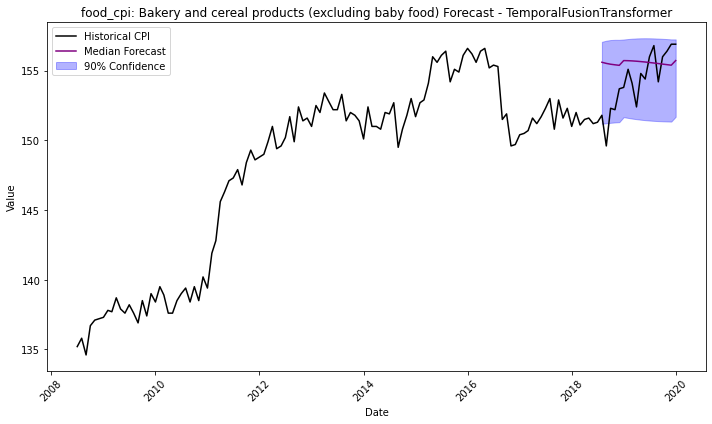

Beginning AutoGluon training... Time limit = 2s
AutoGluon will save models to './output/TEST/ag_global_all_TemporalFusionTransformerModel_exp2_R1_/random_seed_42/2018-07-01/model_files/'
=================== System Info ===================
AutoGluon Version:  1.1.1
Python Version:     3.8.20
Operating System:   Linux
Platform Machine:   x86_64
Platform Version:   #147~18.04.1-Ubuntu SMP Sat Oct 15 13:10:18 UTC 2022
CPU Count:          32
GPU Count:          1
Memory Avail:       166.12 GB / 188.57 GB (88.1%)
Disk Space Avail:   18215.13 GB / 249006.62 GB (7.3%)

Fitting with arguments:
{'enable_ensemble': True,
 'eval_metric': MAPE,
 'excluded_model_types': ['DirectTabular', 'RecursiveTabular'],
 'hyperparameters': {'TemporalFusionTransformerModel': {}},
 'known_covariates_names': [],
 'num_val_windows': 1,
 'prediction_length': 18,
 'quantile_levels': [0.01, 0.05, 0.1, 0.25, 0.75, 0.9, 0.95, 0.99],
 'random_seed': 42,
 'refit_every_n_windows': 1,
 'refit_full': False,
 'skip_model_sele

TemporalFusionTransformerModel


	-1.1255       = Validation score (-MAPE)
	2.14    s     = Training runtime
	0.04    s     = Validation (prediction) runtime
Not fitting ensemble due to lack of time remaining. Time left: -0.3 seconds
Training complete. Models trained: ['TemporalFusionTransformer']
Total runtime: 2.22 s
Best model: TemporalFusionTransformer
Best model score: -1.1255
Model not specified in predict, will default to the model with the best validation score: TemporalFusionTransformer
Model not specified in predict, will default to the model with the best validation score: TemporalFusionTransformer


****************** Summary of fit() ******************
Estimated performance of each model:
                       model  score_val  pred_time_val  fit_time_marginal  \
0  TemporalFusionTransformer  -1.125451       0.044595           2.136791   

   fit_order  
0          1  
Number of models trained: 1
Types of models trained:
{'MultiWindowBacktestingModel'}
****************** End of fit() summary ******************


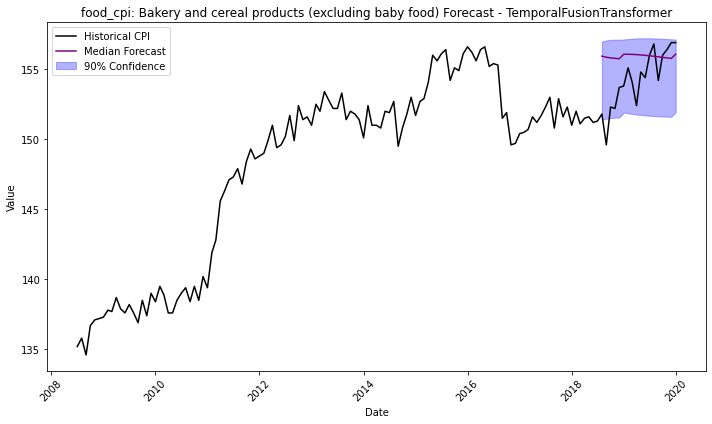

Beginning AutoGluon training... Time limit = 2s
AutoGluon will save models to './output/TEST/ag_global_all_TemporalFusionTransformerModel_exp2_R4_/random_seed_42/2018-07-01/model_files/'
=================== System Info ===================
AutoGluon Version:  1.1.1
Python Version:     3.8.20
Operating System:   Linux
Platform Machine:   x86_64
Platform Version:   #147~18.04.1-Ubuntu SMP Sat Oct 15 13:10:18 UTC 2022
CPU Count:          32
GPU Count:          1
Memory Avail:       166.11 GB / 188.57 GB (88.1%)
Disk Space Avail:   18215.12 GB / 249006.62 GB (7.3%)

Fitting with arguments:
{'enable_ensemble': True,
 'eval_metric': MAPE,
 'excluded_model_types': ['DirectTabular', 'RecursiveTabular'],
 'hyperparameters': {'TemporalFusionTransformerModel': {}},
 'known_covariates_names': [],
 'num_val_windows': 1,
 'prediction_length': 18,
 'quantile_levels': [0.01, 0.05, 0.1, 0.25, 0.75, 0.9, 0.95, 0.99],
 'random_seed': 42,
 'refit_every_n_windows': 1,
 'refit_full': False,
 'skip_model_sele

TemporalFusionTransformerModel


	-1.2677       = Validation score (-MAPE)
	2.21    s     = Training runtime
	0.04    s     = Validation (prediction) runtime
Not fitting ensemble due to lack of time remaining. Time left: -0.3 seconds
Training complete. Models trained: ['TemporalFusionTransformer']
Total runtime: 2.28 s
Best model: TemporalFusionTransformer
Best model score: -1.2677
Model not specified in predict, will default to the model with the best validation score: TemporalFusionTransformer
Model not specified in predict, will default to the model with the best validation score: TemporalFusionTransformer


****************** Summary of fit() ******************
Estimated performance of each model:
                       model  score_val  pred_time_val  fit_time_marginal  \
0  TemporalFusionTransformer  -1.267694       0.041998           2.206132   

   fit_order  
0          1  
Number of models trained: 1
Types of models trained:
{'MultiWindowBacktestingModel'}
****************** End of fit() summary ******************


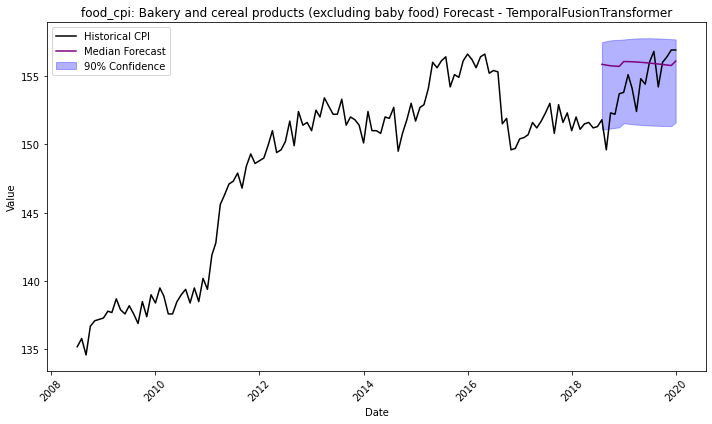

Beginning AutoGluon training... Time limit = 2s
AutoGluon will save models to './output/TEST/ag_global_all_TemporalFusionTransformerModel_exp2_GPT_P1_/random_seed_42/2018-07-01/model_files/'
=================== System Info ===================
AutoGluon Version:  1.1.1
Python Version:     3.8.20
Operating System:   Linux
Platform Machine:   x86_64
Platform Version:   #147~18.04.1-Ubuntu SMP Sat Oct 15 13:10:18 UTC 2022
CPU Count:          32
GPU Count:          1
Memory Avail:       166.11 GB / 188.57 GB (88.1%)
Disk Space Avail:   18215.11 GB / 249006.62 GB (7.3%)

Fitting with arguments:
{'enable_ensemble': True,
 'eval_metric': MAPE,
 'excluded_model_types': ['DirectTabular', 'RecursiveTabular'],
 'hyperparameters': {'TemporalFusionTransformerModel': {}},
 'known_covariates_names': [],
 'num_val_windows': 1,
 'prediction_length': 18,
 'quantile_levels': [0.01, 0.05, 0.1, 0.25, 0.75, 0.9, 0.95, 0.99],
 'random_seed': 42,
 'refit_every_n_windows': 1,
 'refit_full': False,
 'skip_model_

TemporalFusionTransformerModel


Inferred time series frequency: 'MS'
Provided train_data has 8602 rows, 22 time series. Median time series length is 391 (min=391, max=391). 

Provided data contains following columns:
	target: 'target'

AutoGluon will gauge predictive performance using evaluation metric: 'MAPE'
	This metric's sign has been flipped to adhere to being higher_is_better. The metric score can be multiplied by -1 to get the metric value.

Starting training. Start time is 2024-10-27 07:28:56
Excluded model types: ['DirectTabular', 'RecursiveTabular']
Models that will be trained: ['TemporalFusionTransformer']
Training timeseries model TemporalFusionTransformer. Training for up to 1.6s of the 1.6s of remaining time.
	-2.7260       = Validation score (-MAPE)
	1.83    s     = Training runtime
	0.05    s     = Validation (prediction) runtime
Not fitting ensemble due to lack of time remaining. Time left: -0.3 seconds
Training complete. Models trained: ['TemporalFusionTransformer']
Total runtime: 1.91 s
Best model:

****************** Summary of fit() ******************
Estimated performance of each model:
                       model  score_val  pred_time_val  fit_time_marginal  \
0  TemporalFusionTransformer  -2.726029       0.046938            1.82849   

   fit_order  
0          1  
Number of models trained: 1
Types of models trained:
{'MultiWindowBacktestingModel'}
****************** End of fit() summary ******************


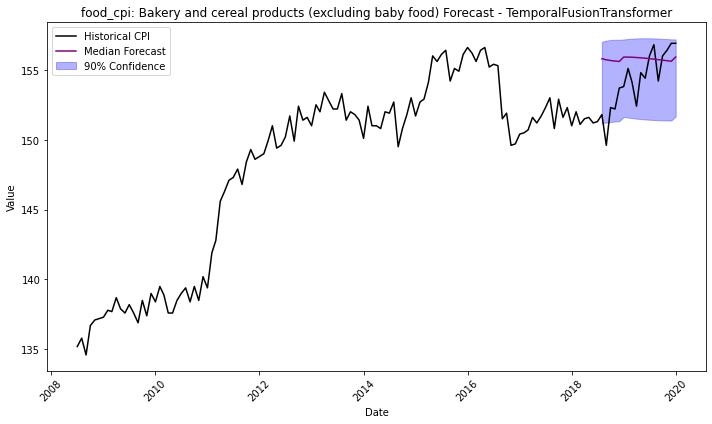

Beginning AutoGluon training... Time limit = 2s
AutoGluon will save models to './output/TEST/ag_global_all_TemporalFusionTransformerModel_exp2_GPT_P4_/random_seed_42/2018-07-01/model_files/'
=================== System Info ===================
AutoGluon Version:  1.1.1
Python Version:     3.8.20
Operating System:   Linux
Platform Machine:   x86_64
Platform Version:   #147~18.04.1-Ubuntu SMP Sat Oct 15 13:10:18 UTC 2022
CPU Count:          32
GPU Count:          1
Memory Avail:       166.10 GB / 188.57 GB (88.1%)
Disk Space Avail:   18215.11 GB / 249006.62 GB (7.3%)

Fitting with arguments:
{'enable_ensemble': True,
 'eval_metric': MAPE,
 'excluded_model_types': ['DirectTabular', 'RecursiveTabular'],
 'hyperparameters': {'TemporalFusionTransformerModel': {}},
 'known_covariates_names': [],
 'num_val_windows': 1,
 'prediction_length': 18,
 'quantile_levels': [0.01, 0.05, 0.1, 0.25, 0.75, 0.9, 0.95, 0.99],
 'random_seed': 42,
 'refit_every_n_windows': 1,
 'refit_full': False,
 'skip_model_

TemporalFusionTransformerModel


	-1.8130       = Validation score (-MAPE)
	2.17    s     = Training runtime
	0.04    s     = Validation (prediction) runtime
Not fitting ensemble due to lack of time remaining. Time left: -0.3 seconds
Training complete. Models trained: ['TemporalFusionTransformer']
Total runtime: 2.25 s
Best model: TemporalFusionTransformer
Best model score: -1.8130
Model not specified in predict, will default to the model with the best validation score: TemporalFusionTransformer
Model not specified in predict, will default to the model with the best validation score: TemporalFusionTransformer


****************** Summary of fit() ******************
Estimated performance of each model:
                       model  score_val  pred_time_val  fit_time_marginal  \
0  TemporalFusionTransformer  -1.812979       0.039674           2.171726   

   fit_order  
0          1  
Number of models trained: 1
Types of models trained:
{'MultiWindowBacktestingModel'}
****************** End of fit() summary ******************


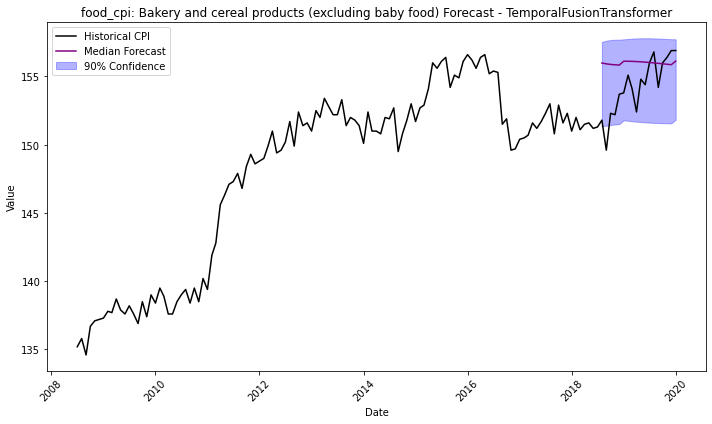

Beginning AutoGluon training... Time limit = 2s
AutoGluon will save models to './output/TEST/ag_global_all_TemporalFusionTransformerModel_exp2_R3_/random_seed_42/2019-07-01/model_files/'
=================== System Info ===================
AutoGluon Version:  1.1.1
Python Version:     3.8.20
Operating System:   Linux
Platform Machine:   x86_64
Platform Version:   #147~18.04.1-Ubuntu SMP Sat Oct 15 13:10:18 UTC 2022
CPU Count:          32
GPU Count:          1
Memory Avail:       166.11 GB / 188.57 GB (88.1%)
Disk Space Avail:   18215.16 GB / 249006.62 GB (7.3%)

Fitting with arguments:
{'enable_ensemble': True,
 'eval_metric': MAPE,
 'excluded_model_types': ['DirectTabular', 'RecursiveTabular'],
 'hyperparameters': {'TemporalFusionTransformerModel': {}},
 'known_covariates_names': [],
 'num_val_windows': 1,
 'prediction_length': 18,
 'quantile_levels': [0.01, 0.05, 0.1, 0.25, 0.75, 0.9, 0.95, 0.99],
 'random_seed': 42,
 'refit_every_n_windows': 1,
 'refit_full': False,
 'skip_model_sele

TemporalFusionTransformerModel


	-0.7081       = Validation score (-MAPE)
	2.13    s     = Training runtime
	0.04    s     = Validation (prediction) runtime
Not fitting ensemble due to lack of time remaining. Time left: -0.3 seconds
Training complete. Models trained: ['TemporalFusionTransformer']
Total runtime: 2.22 s
Best model: TemporalFusionTransformer
Best model score: -0.7081
Model not specified in predict, will default to the model with the best validation score: TemporalFusionTransformer
Model not specified in predict, will default to the model with the best validation score: TemporalFusionTransformer


****************** Summary of fit() ******************
Estimated performance of each model:
                       model  score_val  pred_time_val  fit_time_marginal  \
0  TemporalFusionTransformer  -0.708126       0.042635           2.132326   

   fit_order  
0          1  
Number of models trained: 1
Types of models trained:
{'MultiWindowBacktestingModel'}
****************** End of fit() summary ******************


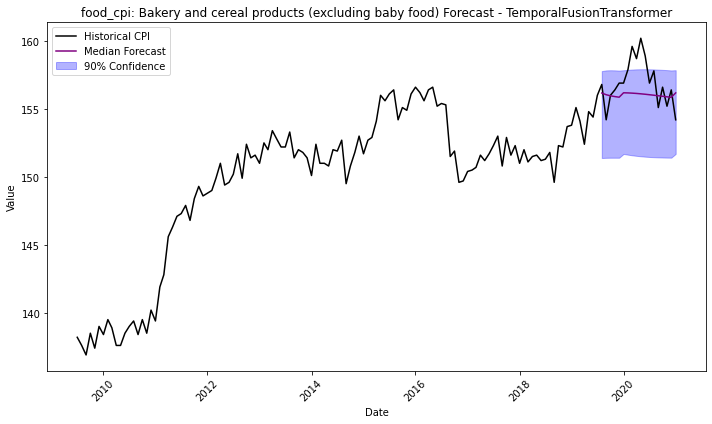

Beginning AutoGluon training... Time limit = 2s
AutoGluon will save models to './output/TEST/ag_global_all_TemporalFusionTransformerModel_exp2_GPT_P3_/random_seed_42/2019-07-01/model_files/'
=================== System Info ===================
AutoGluon Version:  1.1.1
Python Version:     3.8.20
Operating System:   Linux
Platform Machine:   x86_64
Platform Version:   #147~18.04.1-Ubuntu SMP Sat Oct 15 13:10:18 UTC 2022
CPU Count:          32
GPU Count:          1
Memory Avail:       166.11 GB / 188.57 GB (88.1%)
Disk Space Avail:   18215.15 GB / 249006.62 GB (7.3%)

Fitting with arguments:
{'enable_ensemble': True,
 'eval_metric': MAPE,
 'excluded_model_types': ['DirectTabular', 'RecursiveTabular'],
 'hyperparameters': {'TemporalFusionTransformerModel': {}},
 'known_covariates_names': [],
 'num_val_windows': 1,
 'prediction_length': 18,
 'quantile_levels': [0.01, 0.05, 0.1, 0.25, 0.75, 0.9, 0.95, 0.99],
 'random_seed': 42,
 'refit_every_n_windows': 1,
 'refit_full': False,
 'skip_model_

TemporalFusionTransformerModel


	-1.0513       = Validation score (-MAPE)
	2.12    s     = Training runtime
	0.05    s     = Validation (prediction) runtime
Not fitting ensemble due to lack of time remaining. Time left: -0.3 seconds
Training complete. Models trained: ['TemporalFusionTransformer']
Total runtime: 2.20 s
Best model: TemporalFusionTransformer
Best model score: -1.0513
Model not specified in predict, will default to the model with the best validation score: TemporalFusionTransformer
Model not specified in predict, will default to the model with the best validation score: TemporalFusionTransformer


****************** Summary of fit() ******************
Estimated performance of each model:
                       model  score_val  pred_time_val  fit_time_marginal  \
0  TemporalFusionTransformer  -1.051322       0.047471           2.119409   

   fit_order  
0          1  
Number of models trained: 1
Types of models trained:
{'MultiWindowBacktestingModel'}
****************** End of fit() summary ******************


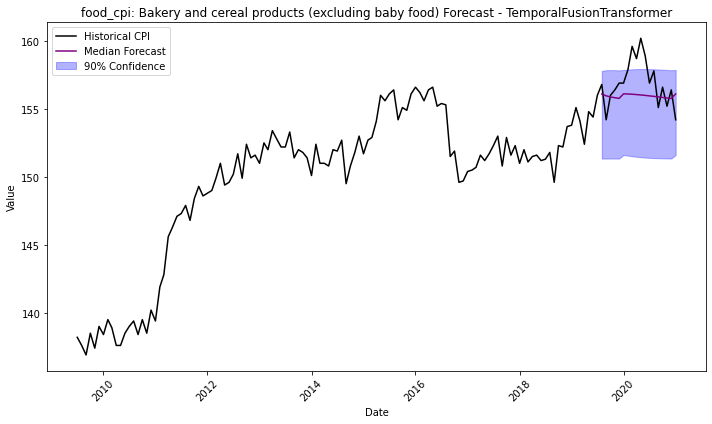

Beginning AutoGluon training... Time limit = 2s
AutoGluon will save models to './output/TEST/ag_global_all_TemporalFusionTransformerModel_exp2_R2_/random_seed_42/2019-07-01/model_files/'
=================== System Info ===================
AutoGluon Version:  1.1.1
Python Version:     3.8.20
Operating System:   Linux
Platform Machine:   x86_64
Platform Version:   #147~18.04.1-Ubuntu SMP Sat Oct 15 13:10:18 UTC 2022
CPU Count:          32
GPU Count:          1
Memory Avail:       166.11 GB / 188.57 GB (88.1%)
Disk Space Avail:   18215.14 GB / 249006.62 GB (7.3%)

Fitting with arguments:
{'enable_ensemble': True,
 'eval_metric': MAPE,
 'excluded_model_types': ['DirectTabular', 'RecursiveTabular'],
 'hyperparameters': {'TemporalFusionTransformerModel': {}},
 'known_covariates_names': [],
 'num_val_windows': 1,
 'prediction_length': 18,
 'quantile_levels': [0.01, 0.05, 0.1, 0.25, 0.75, 0.9, 0.95, 0.99],
 'random_seed': 42,
 'refit_every_n_windows': 1,
 'refit_full': False,
 'skip_model_sele

TemporalFusionTransformerModel


	-0.3824       = Validation score (-MAPE)
	2.15    s     = Training runtime
	0.04    s     = Validation (prediction) runtime
Not fitting ensemble due to lack of time remaining. Time left: -0.3 seconds
Training complete. Models trained: ['TemporalFusionTransformer']
Total runtime: 2.22 s
Best model: TemporalFusionTransformer
Best model score: -0.3824
Model not specified in predict, will default to the model with the best validation score: TemporalFusionTransformer
Model not specified in predict, will default to the model with the best validation score: TemporalFusionTransformer


****************** Summary of fit() ******************
Estimated performance of each model:
                       model  score_val  pred_time_val  fit_time_marginal  \
0  TemporalFusionTransformer  -0.382419       0.042126           2.146746   

   fit_order  
0          1  
Number of models trained: 1
Types of models trained:
{'MultiWindowBacktestingModel'}
****************** End of fit() summary ******************


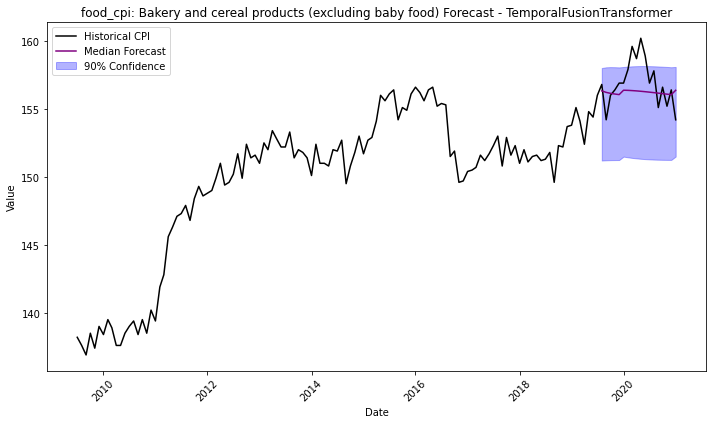

Beginning AutoGluon training... Time limit = 2s
AutoGluon will save models to './output/TEST/ag_global_all_TemporalFusionTransformerModel_exp2_GPT_P2_/random_seed_42/2019-07-01/model_files/'
=================== System Info ===================
AutoGluon Version:  1.1.1
Python Version:     3.8.20
Operating System:   Linux
Platform Machine:   x86_64
Platform Version:   #147~18.04.1-Ubuntu SMP Sat Oct 15 13:10:18 UTC 2022
CPU Count:          32
GPU Count:          1
Memory Avail:       166.13 GB / 188.57 GB (88.1%)
Disk Space Avail:   18215.12 GB / 249006.62 GB (7.3%)

Fitting with arguments:
{'enable_ensemble': True,
 'eval_metric': MAPE,
 'excluded_model_types': ['DirectTabular', 'RecursiveTabular'],
 'hyperparameters': {'TemporalFusionTransformerModel': {}},
 'known_covariates_names': [],
 'num_val_windows': 1,
 'prediction_length': 18,
 'quantile_levels': [0.01, 0.05, 0.1, 0.25, 0.75, 0.9, 0.95, 0.99],
 'random_seed': 42,
 'refit_every_n_windows': 1,
 'refit_full': False,
 'skip_model_

TemporalFusionTransformerModel


	-1.1605       = Validation score (-MAPE)
	2.43    s     = Training runtime
	0.04    s     = Validation (prediction) runtime
Not fitting ensemble due to lack of time remaining. Time left: -0.6 seconds
Training complete. Models trained: ['TemporalFusionTransformer']
Total runtime: 2.50 s
Best model: TemporalFusionTransformer
Best model score: -1.1605
Model not specified in predict, will default to the model with the best validation score: TemporalFusionTransformer
Model not specified in predict, will default to the model with the best validation score: TemporalFusionTransformer


****************** Summary of fit() ******************
Estimated performance of each model:
                       model  score_val  pred_time_val  fit_time_marginal  \
0  TemporalFusionTransformer  -1.160471       0.041981           2.427647   

   fit_order  
0          1  
Number of models trained: 1
Types of models trained:
{'MultiWindowBacktestingModel'}
****************** End of fit() summary ******************


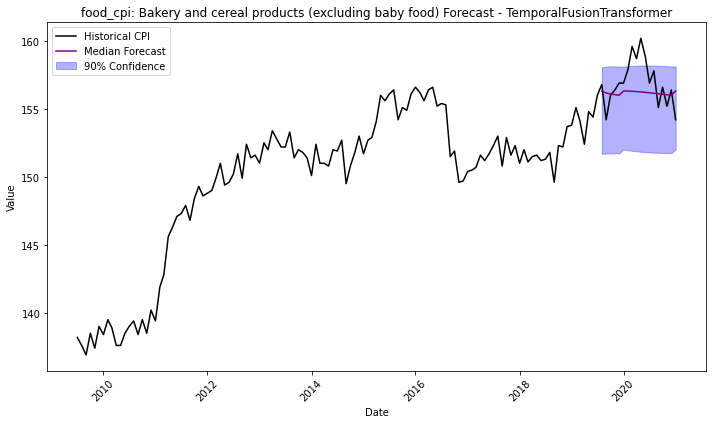

Beginning AutoGluon training... Time limit = 2s
AutoGluon will save models to './output/TEST/ag_global_all_TemporalFusionTransformerModel_exp2_R1_/random_seed_42/2019-07-01/model_files/'
=================== System Info ===================
AutoGluon Version:  1.1.1
Python Version:     3.8.20
Operating System:   Linux
Platform Machine:   x86_64
Platform Version:   #147~18.04.1-Ubuntu SMP Sat Oct 15 13:10:18 UTC 2022
CPU Count:          32
GPU Count:          1
Memory Avail:       166.10 GB / 188.57 GB (88.1%)
Disk Space Avail:   18215.11 GB / 249006.62 GB (7.3%)

Fitting with arguments:
{'enable_ensemble': True,
 'eval_metric': MAPE,
 'excluded_model_types': ['DirectTabular', 'RecursiveTabular'],
 'hyperparameters': {'TemporalFusionTransformerModel': {}},
 'known_covariates_names': [],
 'num_val_windows': 1,
 'prediction_length': 18,
 'quantile_levels': [0.01, 0.05, 0.1, 0.25, 0.75, 0.9, 0.95, 0.99],
 'random_seed': 42,
 'refit_every_n_windows': 1,
 'refit_full': False,
 'skip_model_sele

TemporalFusionTransformerModel


	-0.7714       = Validation score (-MAPE)
	2.15    s     = Training runtime
	0.04    s     = Validation (prediction) runtime
Not fitting ensemble due to lack of time remaining. Time left: -0.3 seconds
Training complete. Models trained: ['TemporalFusionTransformer']
Total runtime: 2.22 s
Best model: TemporalFusionTransformer
Best model score: -0.7714
Model not specified in predict, will default to the model with the best validation score: TemporalFusionTransformer
Model not specified in predict, will default to the model with the best validation score: TemporalFusionTransformer


****************** Summary of fit() ******************
Estimated performance of each model:
                       model  score_val  pred_time_val  fit_time_marginal  \
0  TemporalFusionTransformer  -0.771447       0.043331            2.15023   

   fit_order  
0          1  
Number of models trained: 1
Types of models trained:
{'MultiWindowBacktestingModel'}
****************** End of fit() summary ******************


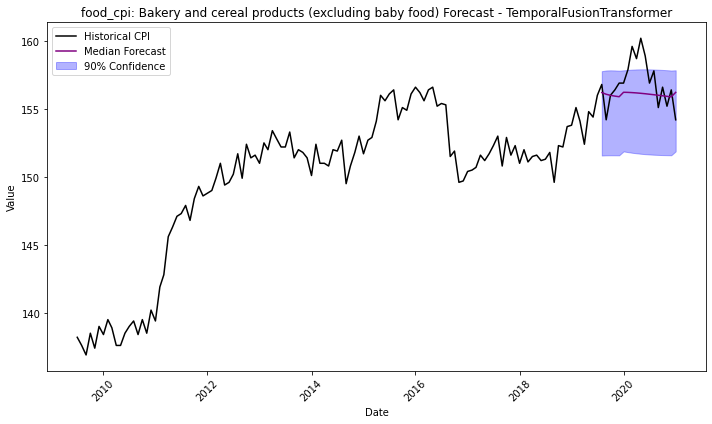

Beginning AutoGluon training... Time limit = 2s
AutoGluon will save models to './output/TEST/ag_global_all_TemporalFusionTransformerModel_exp2_R4_/random_seed_42/2019-07-01/model_files/'
=================== System Info ===================
AutoGluon Version:  1.1.1
Python Version:     3.8.20
Operating System:   Linux
Platform Machine:   x86_64
Platform Version:   #147~18.04.1-Ubuntu SMP Sat Oct 15 13:10:18 UTC 2022
CPU Count:          32
GPU Count:          1
Memory Avail:       166.10 GB / 188.57 GB (88.1%)
Disk Space Avail:   18215.10 GB / 249006.62 GB (7.3%)

Fitting with arguments:
{'enable_ensemble': True,
 'eval_metric': MAPE,
 'excluded_model_types': ['DirectTabular', 'RecursiveTabular'],
 'hyperparameters': {'TemporalFusionTransformerModel': {}},
 'known_covariates_names': [],
 'num_val_windows': 1,
 'prediction_length': 18,
 'quantile_levels': [0.01, 0.05, 0.1, 0.25, 0.75, 0.9, 0.95, 0.99],
 'random_seed': 42,
 'refit_every_n_windows': 1,
 'refit_full': False,
 'skip_model_sele

TemporalFusionTransformerModel


	-0.5634       = Validation score (-MAPE)
	2.12    s     = Training runtime
	0.04    s     = Validation (prediction) runtime
Not fitting ensemble due to lack of time remaining. Time left: -0.3 seconds
Training complete. Models trained: ['TemporalFusionTransformer']
Total runtime: 2.19 s
Best model: TemporalFusionTransformer
Best model score: -0.5634
Model not specified in predict, will default to the model with the best validation score: TemporalFusionTransformer
Model not specified in predict, will default to the model with the best validation score: TemporalFusionTransformer


****************** Summary of fit() ******************
Estimated performance of each model:
                       model  score_val  pred_time_val  fit_time_marginal  \
0  TemporalFusionTransformer  -0.563434       0.043165           2.116798   

   fit_order  
0          1  
Number of models trained: 1
Types of models trained:
{'MultiWindowBacktestingModel'}
****************** End of fit() summary ******************


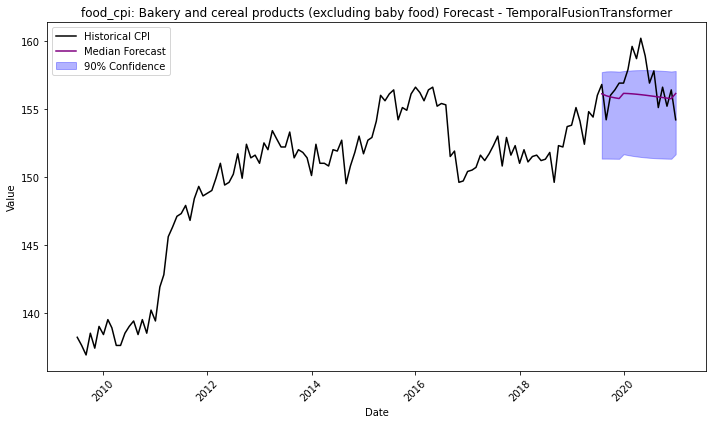

Beginning AutoGluon training... Time limit = 2s
AutoGluon will save models to './output/TEST/ag_global_all_TemporalFusionTransformerModel_exp2_GPT_P1_/random_seed_42/2019-07-01/model_files/'
=================== System Info ===================
AutoGluon Version:  1.1.1
Python Version:     3.8.20
Operating System:   Linux
Platform Machine:   x86_64
Platform Version:   #147~18.04.1-Ubuntu SMP Sat Oct 15 13:10:18 UTC 2022
CPU Count:          32
GPU Count:          1
Memory Avail:       166.10 GB / 188.57 GB (88.1%)
Disk Space Avail:   18215.15 GB / 249006.62 GB (7.3%)

Fitting with arguments:
{'enable_ensemble': True,
 'eval_metric': MAPE,
 'excluded_model_types': ['DirectTabular', 'RecursiveTabular'],
 'hyperparameters': {'TemporalFusionTransformerModel': {}},
 'known_covariates_names': [],
 'num_val_windows': 1,
 'prediction_length': 18,
 'quantile_levels': [0.01, 0.05, 0.1, 0.25, 0.75, 0.9, 0.95, 0.99],
 'random_seed': 42,
 'refit_every_n_windows': 1,
 'refit_full': False,
 'skip_model_

TemporalFusionTransformerModel


	-1.0693       = Validation score (-MAPE)
	2.13    s     = Training runtime
	0.04    s     = Validation (prediction) runtime
Not fitting ensemble due to lack of time remaining. Time left: -0.3 seconds
Training complete. Models trained: ['TemporalFusionTransformer']
Total runtime: 2.20 s
Best model: TemporalFusionTransformer
Best model score: -1.0693
Model not specified in predict, will default to the model with the best validation score: TemporalFusionTransformer
Model not specified in predict, will default to the model with the best validation score: TemporalFusionTransformer


****************** Summary of fit() ******************
Estimated performance of each model:
                       model  score_val  pred_time_val  fit_time_marginal  \
0  TemporalFusionTransformer  -1.069306       0.044427           2.125942   

   fit_order  
0          1  
Number of models trained: 1
Types of models trained:
{'MultiWindowBacktestingModel'}
****************** End of fit() summary ******************


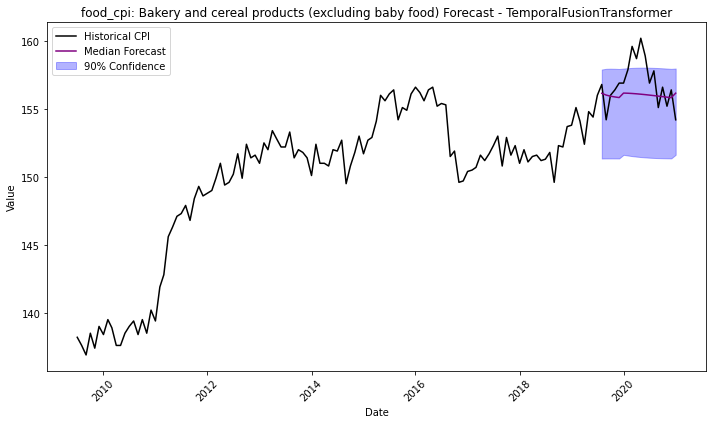

Beginning AutoGluon training... Time limit = 2s
AutoGluon will save models to './output/TEST/ag_global_all_TemporalFusionTransformerModel_exp2_GPT_P4_/random_seed_42/2019-07-01/model_files/'
=================== System Info ===================
AutoGluon Version:  1.1.1
Python Version:     3.8.20
Operating System:   Linux
Platform Machine:   x86_64
Platform Version:   #147~18.04.1-Ubuntu SMP Sat Oct 15 13:10:18 UTC 2022
CPU Count:          32
GPU Count:          1
Memory Avail:       166.10 GB / 188.57 GB (88.1%)
Disk Space Avail:   18215.14 GB / 249006.62 GB (7.3%)

Fitting with arguments:
{'enable_ensemble': True,
 'eval_metric': MAPE,
 'excluded_model_types': ['DirectTabular', 'RecursiveTabular'],
 'hyperparameters': {'TemporalFusionTransformerModel': {}},
 'known_covariates_names': [],
 'num_val_windows': 1,
 'prediction_length': 18,
 'quantile_levels': [0.01, 0.05, 0.1, 0.25, 0.75, 0.9, 0.95, 0.99],
 'random_seed': 42,
 'refit_every_n_windows': 1,
 'refit_full': False,
 'skip_model_

TemporalFusionTransformerModel


	-0.7104       = Validation score (-MAPE)
	2.14    s     = Training runtime
	0.04    s     = Validation (prediction) runtime
Not fitting ensemble due to lack of time remaining. Time left: -0.3 seconds
Training complete. Models trained: ['TemporalFusionTransformer']
Total runtime: 2.22 s
Best model: TemporalFusionTransformer
Best model score: -0.7104
Model not specified in predict, will default to the model with the best validation score: TemporalFusionTransformer
Model not specified in predict, will default to the model with the best validation score: TemporalFusionTransformer


****************** Summary of fit() ******************
Estimated performance of each model:
                       model  score_val  pred_time_val  fit_time_marginal  \
0  TemporalFusionTransformer  -0.710401       0.040237           2.141265   

   fit_order  
0          1  
Number of models trained: 1
Types of models trained:
{'MultiWindowBacktestingModel'}
****************** End of fit() summary ******************


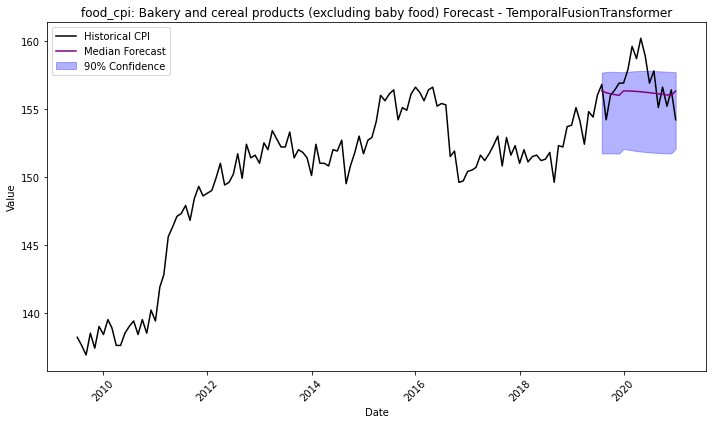

Beginning AutoGluon training... Time limit = 2s
AutoGluon will save models to './output/TEST/ag_global_all_TemporalFusionTransformerModel_exp2_R3_/random_seed_42/2020-07-01/model_files/'
=================== System Info ===================
AutoGluon Version:  1.1.1
Python Version:     3.8.20
Operating System:   Linux
Platform Machine:   x86_64
Platform Version:   #147~18.04.1-Ubuntu SMP Sat Oct 15 13:10:18 UTC 2022
CPU Count:          32
GPU Count:          1
Memory Avail:       166.10 GB / 188.57 GB (88.1%)
Disk Space Avail:   18215.14 GB / 249006.62 GB (7.3%)

Fitting with arguments:
{'enable_ensemble': True,
 'eval_metric': MAPE,
 'excluded_model_types': ['DirectTabular', 'RecursiveTabular'],
 'hyperparameters': {'TemporalFusionTransformerModel': {}},
 'known_covariates_names': [],
 'num_val_windows': 1,
 'prediction_length': 18,
 'quantile_levels': [0.01, 0.05, 0.1, 0.25, 0.75, 0.9, 0.95, 0.99],
 'random_seed': 42,
 'refit_every_n_windows': 1,
 'refit_full': False,
 'skip_model_sele

TemporalFusionTransformerModel


	-0.5866       = Validation score (-MAPE)
	2.15    s     = Training runtime
	0.04    s     = Validation (prediction) runtime
Not fitting ensemble due to lack of time remaining. Time left: -0.3 seconds
Training complete. Models trained: ['TemporalFusionTransformer']
Total runtime: 2.22 s
Best model: TemporalFusionTransformer
Best model score: -0.5866
Model not specified in predict, will default to the model with the best validation score: TemporalFusionTransformer


****************** Summary of fit() ******************
Estimated performance of each model:
                       model  score_val  pred_time_val  fit_time_marginal  \
0  TemporalFusionTransformer  -0.586593       0.043616           2.146828   

   fit_order  
0          1  
Number of models trained: 1
Types of models trained:
{'MultiWindowBacktestingModel'}
****************** End of fit() summary ******************


Model not specified in predict, will default to the model with the best validation score: TemporalFusionTransformer


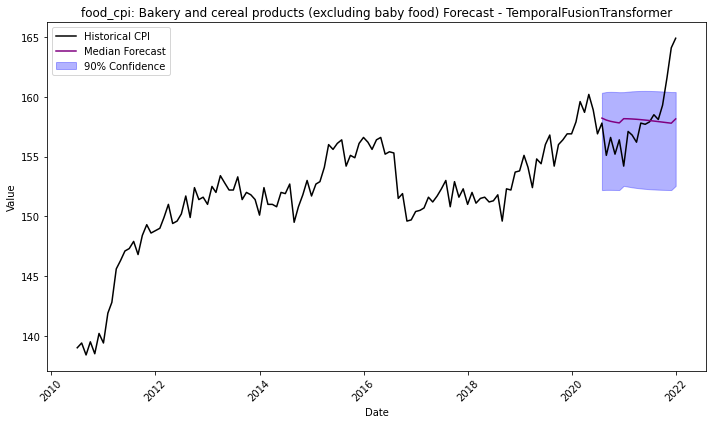

Beginning AutoGluon training... Time limit = 2s
AutoGluon will save models to './output/TEST/ag_global_all_TemporalFusionTransformerModel_exp2_GPT_P3_/random_seed_42/2020-07-01/model_files/'
=================== System Info ===================
AutoGluon Version:  1.1.1
Python Version:     3.8.20
Operating System:   Linux
Platform Machine:   x86_64
Platform Version:   #147~18.04.1-Ubuntu SMP Sat Oct 15 13:10:18 UTC 2022
CPU Count:          32
GPU Count:          1
Memory Avail:       166.10 GB / 188.57 GB (88.1%)
Disk Space Avail:   18214.75 GB / 249006.62 GB (7.3%)

Fitting with arguments:
{'enable_ensemble': True,
 'eval_metric': MAPE,
 'excluded_model_types': ['DirectTabular', 'RecursiveTabular'],
 'hyperparameters': {'TemporalFusionTransformerModel': {}},
 'known_covariates_names': [],
 'num_val_windows': 1,
 'prediction_length': 18,
 'quantile_levels': [0.01, 0.05, 0.1, 0.25, 0.75, 0.9, 0.95, 0.99],
 'random_seed': 42,
 'refit_every_n_windows': 1,
 'refit_full': False,
 'skip_model_

TemporalFusionTransformerModel


	-0.8260       = Validation score (-MAPE)
	2.17    s     = Training runtime
	0.04    s     = Validation (prediction) runtime
Not fitting ensemble due to lack of time remaining. Time left: -0.3 seconds
Training complete. Models trained: ['TemporalFusionTransformer']
Total runtime: 2.26 s
Best model: TemporalFusionTransformer
Best model score: -0.8260
Model not specified in predict, will default to the model with the best validation score: TemporalFusionTransformer
Model not specified in predict, will default to the model with the best validation score: TemporalFusionTransformer


****************** Summary of fit() ******************
Estimated performance of each model:
                       model  score_val  pred_time_val  fit_time_marginal  \
0  TemporalFusionTransformer  -0.825996       0.042945           2.172112   

   fit_order  
0          1  
Number of models trained: 1
Types of models trained:
{'MultiWindowBacktestingModel'}
****************** End of fit() summary ******************


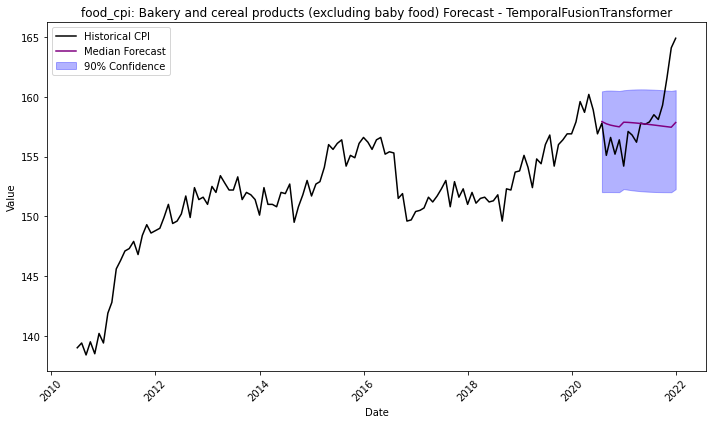

Beginning AutoGluon training... Time limit = 2s
AutoGluon will save models to './output/TEST/ag_global_all_TemporalFusionTransformerModel_exp2_R2_/random_seed_42/2020-07-01/model_files/'
=================== System Info ===================
AutoGluon Version:  1.1.1
Python Version:     3.8.20
Operating System:   Linux
Platform Machine:   x86_64
Platform Version:   #147~18.04.1-Ubuntu SMP Sat Oct 15 13:10:18 UTC 2022
CPU Count:          32
GPU Count:          1
Memory Avail:       166.27 GB / 188.57 GB (88.2%)
Disk Space Avail:   18213.91 GB / 249006.62 GB (7.3%)

Fitting with arguments:
{'enable_ensemble': True,
 'eval_metric': MAPE,
 'excluded_model_types': ['DirectTabular', 'RecursiveTabular'],
 'hyperparameters': {'TemporalFusionTransformerModel': {}},
 'known_covariates_names': [],
 'num_val_windows': 1,
 'prediction_length': 18,
 'quantile_levels': [0.01, 0.05, 0.1, 0.25, 0.75, 0.9, 0.95, 0.99],
 'random_seed': 42,
 'refit_every_n_windows': 1,
 'refit_full': False,
 'skip_model_sele

TemporalFusionTransformerModel


	-0.3753       = Validation score (-MAPE)
	2.14    s     = Training runtime
	0.05    s     = Validation (prediction) runtime
Not fitting ensemble due to lack of time remaining. Time left: -0.3 seconds
Training complete. Models trained: ['TemporalFusionTransformer']
Total runtime: 2.22 s
Best model: TemporalFusionTransformer
Best model score: -0.3753
Model not specified in predict, will default to the model with the best validation score: TemporalFusionTransformer
Model not specified in predict, will default to the model with the best validation score: TemporalFusionTransformer


****************** Summary of fit() ******************
Estimated performance of each model:
                       model  score_val  pred_time_val  fit_time_marginal  \
0  TemporalFusionTransformer  -0.375285       0.045038           2.141345   

   fit_order  
0          1  
Number of models trained: 1
Types of models trained:
{'MultiWindowBacktestingModel'}
****************** End of fit() summary ******************


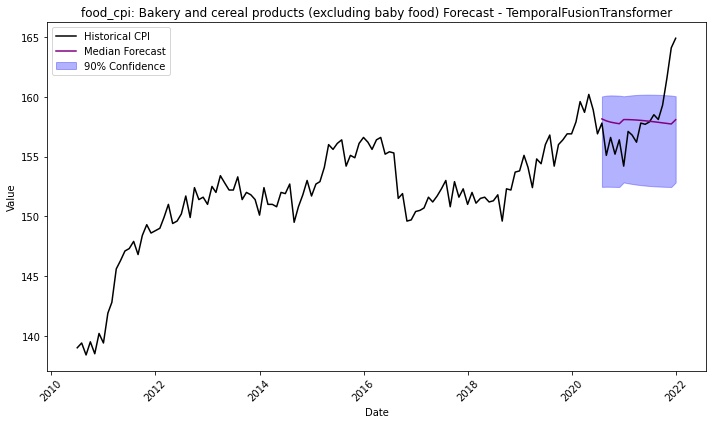

Beginning AutoGluon training... Time limit = 2s
AutoGluon will save models to './output/TEST/ag_global_all_TemporalFusionTransformerModel_exp2_GPT_P2_/random_seed_42/2020-07-01/model_files/'
=================== System Info ===================
AutoGluon Version:  1.1.1
Python Version:     3.8.20
Operating System:   Linux
Platform Machine:   x86_64
Platform Version:   #147~18.04.1-Ubuntu SMP Sat Oct 15 13:10:18 UTC 2022
CPU Count:          32
GPU Count:          1
Memory Avail:       166.10 GB / 188.57 GB (88.1%)
Disk Space Avail:   18213.94 GB / 249006.62 GB (7.3%)

Fitting with arguments:
{'enable_ensemble': True,
 'eval_metric': MAPE,
 'excluded_model_types': ['DirectTabular', 'RecursiveTabular'],
 'hyperparameters': {'TemporalFusionTransformerModel': {}},
 'known_covariates_names': [],
 'num_val_windows': 1,
 'prediction_length': 18,
 'quantile_levels': [0.01, 0.05, 0.1, 0.25, 0.75, 0.9, 0.95, 0.99],
 'random_seed': 42,
 'refit_every_n_windows': 1,
 'refit_full': False,
 'skip_model_

TemporalFusionTransformerModel


	-0.9918       = Validation score (-MAPE)
	2.13    s     = Training runtime
	0.04    s     = Validation (prediction) runtime
Not fitting ensemble due to lack of time remaining. Time left: -0.3 seconds
Training complete. Models trained: ['TemporalFusionTransformer']
Total runtime: 2.20 s
Best model: TemporalFusionTransformer
Best model score: -0.9918
Model not specified in predict, will default to the model with the best validation score: TemporalFusionTransformer
Model not specified in predict, will default to the model with the best validation score: TemporalFusionTransformer


****************** Summary of fit() ******************
Estimated performance of each model:
                       model  score_val  pred_time_val  fit_time_marginal  \
0  TemporalFusionTransformer  -0.991805       0.041074           2.126678   

   fit_order  
0          1  
Number of models trained: 1
Types of models trained:
{'MultiWindowBacktestingModel'}
****************** End of fit() summary ******************


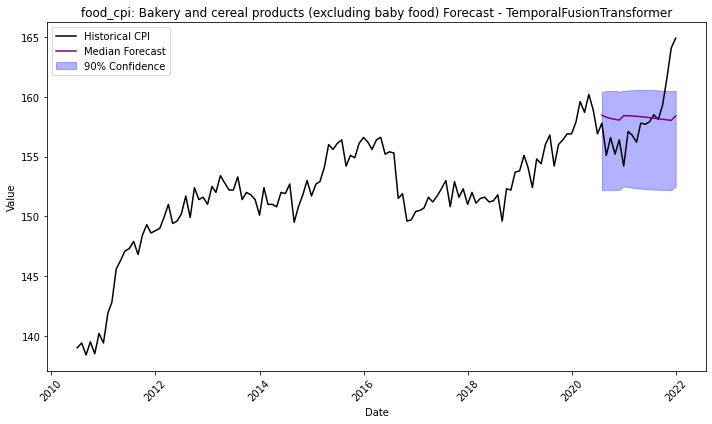

Beginning AutoGluon training... Time limit = 2s
AutoGluon will save models to './output/TEST/ag_global_all_TemporalFusionTransformerModel_exp2_R1_/random_seed_42/2020-07-01/model_files/'
=================== System Info ===================
AutoGluon Version:  1.1.1
Python Version:     3.8.20
Operating System:   Linux
Platform Machine:   x86_64
Platform Version:   #147~18.04.1-Ubuntu SMP Sat Oct 15 13:10:18 UTC 2022
CPU Count:          32
GPU Count:          1
Memory Avail:       166.10 GB / 188.57 GB (88.1%)
Disk Space Avail:   18213.93 GB / 249006.62 GB (7.3%)

Fitting with arguments:
{'enable_ensemble': True,
 'eval_metric': MAPE,
 'excluded_model_types': ['DirectTabular', 'RecursiveTabular'],
 'hyperparameters': {'TemporalFusionTransformerModel': {}},
 'known_covariates_names': [],
 'num_val_windows': 1,
 'prediction_length': 18,
 'quantile_levels': [0.01, 0.05, 0.1, 0.25, 0.75, 0.9, 0.95, 0.99],
 'random_seed': 42,
 'refit_every_n_windows': 1,
 'refit_full': False,
 'skip_model_sele

TemporalFusionTransformerModel


	-2.5389       = Validation score (-MAPE)
	2.16    s     = Training runtime
	0.04    s     = Validation (prediction) runtime
Not fitting ensemble due to lack of time remaining. Time left: -0.3 seconds
Training complete. Models trained: ['TemporalFusionTransformer']
Total runtime: 2.24 s
Best model: TemporalFusionTransformer
Best model score: -2.5389
Model not specified in predict, will default to the model with the best validation score: TemporalFusionTransformer
Model not specified in predict, will default to the model with the best validation score: TemporalFusionTransformer


****************** Summary of fit() ******************
Estimated performance of each model:
                       model  score_val  pred_time_val  fit_time_marginal  \
0  TemporalFusionTransformer   -2.53893       0.043717           2.164226   

   fit_order  
0          1  
Number of models trained: 1
Types of models trained:
{'MultiWindowBacktestingModel'}
****************** End of fit() summary ******************


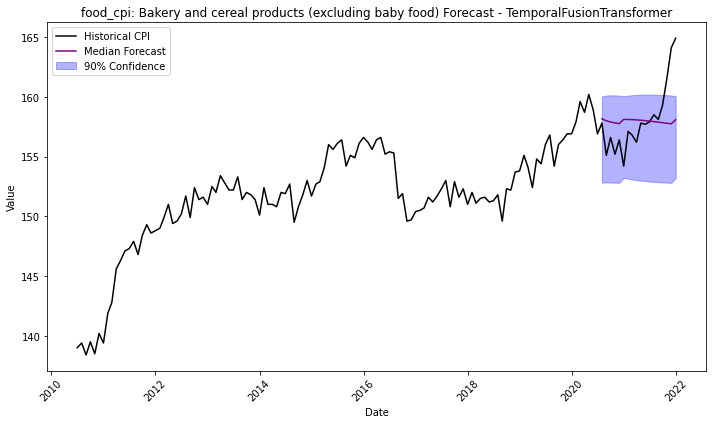

Beginning AutoGluon training... Time limit = 2s
AutoGluon will save models to './output/TEST/ag_global_all_TemporalFusionTransformerModel_exp2_R4_/random_seed_42/2020-07-01/model_files/'
=================== System Info ===================
AutoGluon Version:  1.1.1
Python Version:     3.8.20
Operating System:   Linux
Platform Machine:   x86_64
Platform Version:   #147~18.04.1-Ubuntu SMP Sat Oct 15 13:10:18 UTC 2022
CPU Count:          32
GPU Count:          1
Memory Avail:       166.09 GB / 188.57 GB (88.1%)
Disk Space Avail:   18213.92 GB / 249006.62 GB (7.3%)

Fitting with arguments:
{'enable_ensemble': True,
 'eval_metric': MAPE,
 'excluded_model_types': ['DirectTabular', 'RecursiveTabular'],
 'hyperparameters': {'TemporalFusionTransformerModel': {}},
 'known_covariates_names': [],
 'num_val_windows': 1,
 'prediction_length': 18,
 'quantile_levels': [0.01, 0.05, 0.1, 0.25, 0.75, 0.9, 0.95, 0.99],
 'random_seed': 42,
 'refit_every_n_windows': 1,
 'refit_full': False,
 'skip_model_sele

TemporalFusionTransformerModel


	-0.5128       = Validation score (-MAPE)
	2.12    s     = Training runtime
	0.04    s     = Validation (prediction) runtime
Not fitting ensemble due to lack of time remaining. Time left: -0.3 seconds
Training complete. Models trained: ['TemporalFusionTransformer']
Total runtime: 2.19 s
Best model: TemporalFusionTransformer
Best model score: -0.5128
Model not specified in predict, will default to the model with the best validation score: TemporalFusionTransformer
Model not specified in predict, will default to the model with the best validation score: TemporalFusionTransformer


****************** Summary of fit() ******************
Estimated performance of each model:
                       model  score_val  pred_time_val  fit_time_marginal  \
0  TemporalFusionTransformer  -0.512819       0.044819           2.115661   

   fit_order  
0          1  
Number of models trained: 1
Types of models trained:
{'MultiWindowBacktestingModel'}
****************** End of fit() summary ******************


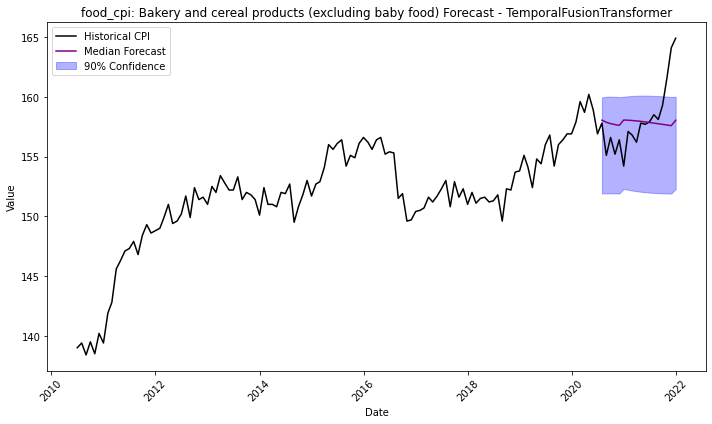

Beginning AutoGluon training... Time limit = 2s
AutoGluon will save models to './output/TEST/ag_global_all_TemporalFusionTransformerModel_exp2_GPT_P1_/random_seed_42/2020-07-01/model_files/'
=================== System Info ===================
AutoGluon Version:  1.1.1
Python Version:     3.8.20
Operating System:   Linux
Platform Machine:   x86_64
Platform Version:   #147~18.04.1-Ubuntu SMP Sat Oct 15 13:10:18 UTC 2022
CPU Count:          32
GPU Count:          1
Memory Avail:       166.18 GB / 188.57 GB (88.1%)
Disk Space Avail:   18213.91 GB / 249006.62 GB (7.3%)

Fitting with arguments:
{'enable_ensemble': True,
 'eval_metric': MAPE,
 'excluded_model_types': ['DirectTabular', 'RecursiveTabular'],
 'hyperparameters': {'TemporalFusionTransformerModel': {}},
 'known_covariates_names': [],
 'num_val_windows': 1,
 'prediction_length': 18,
 'quantile_levels': [0.01, 0.05, 0.1, 0.25, 0.75, 0.9, 0.95, 0.99],
 'random_seed': 42,
 'refit_every_n_windows': 1,
 'refit_full': False,
 'skip_model_

TemporalFusionTransformerModel


	-0.8187       = Validation score (-MAPE)
	2.42    s     = Training runtime
	0.05    s     = Validation (prediction) runtime
Not fitting ensemble due to lack of time remaining. Time left: -0.6 seconds
Training complete. Models trained: ['TemporalFusionTransformer']
Total runtime: 2.50 s
Best model: TemporalFusionTransformer
Best model score: -0.8187
Model not specified in predict, will default to the model with the best validation score: TemporalFusionTransformer
Model not specified in predict, will default to the model with the best validation score: TemporalFusionTransformer


****************** Summary of fit() ******************
Estimated performance of each model:
                       model  score_val  pred_time_val  fit_time_marginal  \
0  TemporalFusionTransformer  -0.818746       0.045245           2.422198   

   fit_order  
0          1  
Number of models trained: 1
Types of models trained:
{'MultiWindowBacktestingModel'}
****************** End of fit() summary ******************


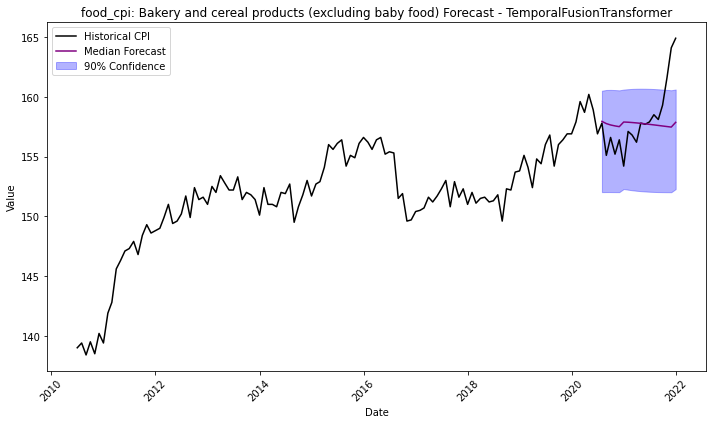

Beginning AutoGluon training... Time limit = 2s
AutoGluon will save models to './output/TEST/ag_global_all_TemporalFusionTransformerModel_exp2_GPT_P4_/random_seed_42/2020-07-01/model_files/'
=================== System Info ===================
AutoGluon Version:  1.1.1
Python Version:     3.8.20
Operating System:   Linux
Platform Machine:   x86_64
Platform Version:   #147~18.04.1-Ubuntu SMP Sat Oct 15 13:10:18 UTC 2022
CPU Count:          32
GPU Count:          1
Memory Avail:       166.10 GB / 188.57 GB (88.1%)
Disk Space Avail:   18213.96 GB / 249006.62 GB (7.3%)

Fitting with arguments:
{'enable_ensemble': True,
 'eval_metric': MAPE,
 'excluded_model_types': ['DirectTabular', 'RecursiveTabular'],
 'hyperparameters': {'TemporalFusionTransformerModel': {}},
 'known_covariates_names': [],
 'num_val_windows': 1,
 'prediction_length': 18,
 'quantile_levels': [0.01, 0.05, 0.1, 0.25, 0.75, 0.9, 0.95, 0.99],
 'random_seed': 42,
 'refit_every_n_windows': 1,
 'refit_full': False,
 'skip_model_

TemporalFusionTransformerModel


	-0.7006       = Validation score (-MAPE)
	2.22    s     = Training runtime
	0.04    s     = Validation (prediction) runtime
Not fitting ensemble due to lack of time remaining. Time left: -0.3 seconds
Training complete. Models trained: ['TemporalFusionTransformer']
Total runtime: 2.29 s
Best model: TemporalFusionTransformer
Best model score: -0.7006
Model not specified in predict, will default to the model with the best validation score: TemporalFusionTransformer
Model not specified in predict, will default to the model with the best validation score: TemporalFusionTransformer


****************** Summary of fit() ******************
Estimated performance of each model:
                       model  score_val  pred_time_val  fit_time_marginal  \
0  TemporalFusionTransformer  -0.700609       0.038614           2.220517   

   fit_order  
0          1  
Number of models trained: 1
Types of models trained:
{'MultiWindowBacktestingModel'}
****************** End of fit() summary ******************


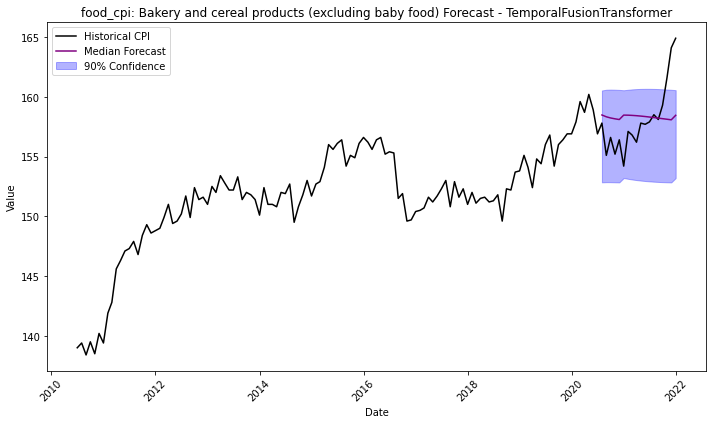

Beginning AutoGluon training... Time limit = 2s
AutoGluon will save models to './output/TEST/ag_global_all_TemporalFusionTransformerModel_exp2_R3_/random_seed_42/2021-07-01/model_files/'
=================== System Info ===================
AutoGluon Version:  1.1.1
Python Version:     3.8.20
Operating System:   Linux
Platform Machine:   x86_64
Platform Version:   #147~18.04.1-Ubuntu SMP Sat Oct 15 13:10:18 UTC 2022
CPU Count:          32
GPU Count:          1
Memory Avail:       166.09 GB / 188.57 GB (88.1%)
Disk Space Avail:   18213.95 GB / 249006.62 GB (7.3%)

Fitting with arguments:
{'enable_ensemble': True,
 'eval_metric': MAPE,
 'excluded_model_types': ['DirectTabular', 'RecursiveTabular'],
 'hyperparameters': {'TemporalFusionTransformerModel': {}},
 'known_covariates_names': [],
 'num_val_windows': 1,
 'prediction_length': 18,
 'quantile_levels': [0.01, 0.05, 0.1, 0.25, 0.75, 0.9, 0.95, 0.99],
 'random_seed': 42,
 'refit_every_n_windows': 1,
 'refit_full': False,
 'skip_model_sele

TemporalFusionTransformerModel


	-0.7210       = Validation score (-MAPE)
	2.15    s     = Training runtime
	0.04    s     = Validation (prediction) runtime
Not fitting ensemble due to lack of time remaining. Time left: -0.3 seconds
Training complete. Models trained: ['TemporalFusionTransformer']
Total runtime: 2.23 s
Best model: TemporalFusionTransformer
Best model score: -0.7210
Model not specified in predict, will default to the model with the best validation score: TemporalFusionTransformer
Model not specified in predict, will default to the model with the best validation score: TemporalFusionTransformer


****************** Summary of fit() ******************
Estimated performance of each model:
                       model  score_val  pred_time_val  fit_time_marginal  \
0  TemporalFusionTransformer  -0.721014       0.042886           2.148772   

   fit_order  
0          1  
Number of models trained: 1
Types of models trained:
{'MultiWindowBacktestingModel'}
****************** End of fit() summary ******************


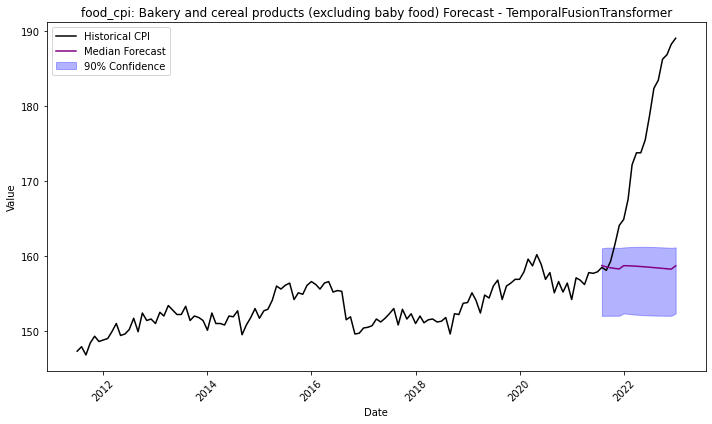

Beginning AutoGluon training... Time limit = 2s
AutoGluon will save models to './output/TEST/ag_global_all_TemporalFusionTransformerModel_exp2_GPT_P3_/random_seed_42/2021-07-01/model_files/'
=================== System Info ===================
AutoGluon Version:  1.1.1
Python Version:     3.8.20
Operating System:   Linux
Platform Machine:   x86_64
Platform Version:   #147~18.04.1-Ubuntu SMP Sat Oct 15 13:10:18 UTC 2022
CPU Count:          32
GPU Count:          1
Memory Avail:       166.31 GB / 188.57 GB (88.2%)
Disk Space Avail:   18213.94 GB / 249006.62 GB (7.3%)

Fitting with arguments:
{'enable_ensemble': True,
 'eval_metric': MAPE,
 'excluded_model_types': ['DirectTabular', 'RecursiveTabular'],
 'hyperparameters': {'TemporalFusionTransformerModel': {}},
 'known_covariates_names': [],
 'num_val_windows': 1,
 'prediction_length': 18,
 'quantile_levels': [0.01, 0.05, 0.1, 0.25, 0.75, 0.9, 0.95, 0.99],
 'random_seed': 42,
 'refit_every_n_windows': 1,
 'refit_full': False,
 'skip_model_

TemporalFusionTransformerModel


	-1.1387       = Validation score (-MAPE)
	2.14    s     = Training runtime
	0.04    s     = Validation (prediction) runtime
Not fitting ensemble due to lack of time remaining. Time left: -0.3 seconds
Training complete. Models trained: ['TemporalFusionTransformer']
Total runtime: 2.22 s
Best model: TemporalFusionTransformer
Best model score: -1.1387
Model not specified in predict, will default to the model with the best validation score: TemporalFusionTransformer
Model not specified in predict, will default to the model with the best validation score: TemporalFusionTransformer


****************** Summary of fit() ******************
Estimated performance of each model:
                       model  score_val  pred_time_val  fit_time_marginal  \
0  TemporalFusionTransformer  -1.138665       0.043733           2.142074   

   fit_order  
0          1  
Number of models trained: 1
Types of models trained:
{'MultiWindowBacktestingModel'}
****************** End of fit() summary ******************


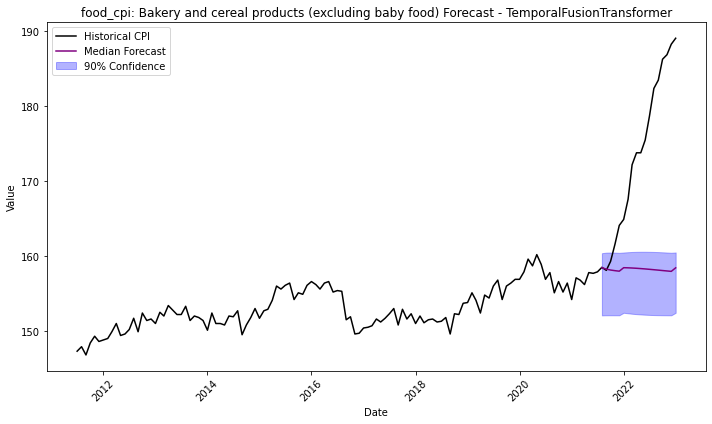

Beginning AutoGluon training... Time limit = 2s
AutoGluon will save models to './output/TEST/ag_global_all_TemporalFusionTransformerModel_exp2_R2_/random_seed_42/2021-07-01/model_files/'
=================== System Info ===================
AutoGluon Version:  1.1.1
Python Version:     3.8.20
Operating System:   Linux
Platform Machine:   x86_64
Platform Version:   #147~18.04.1-Ubuntu SMP Sat Oct 15 13:10:18 UTC 2022
CPU Count:          32
GPU Count:          1
Memory Avail:       166.09 GB / 188.57 GB (88.1%)
Disk Space Avail:   18213.93 GB / 249006.62 GB (7.3%)

Fitting with arguments:
{'enable_ensemble': True,
 'eval_metric': MAPE,
 'excluded_model_types': ['DirectTabular', 'RecursiveTabular'],
 'hyperparameters': {'TemporalFusionTransformerModel': {}},
 'known_covariates_names': [],
 'num_val_windows': 1,
 'prediction_length': 18,
 'quantile_levels': [0.01, 0.05, 0.1, 0.25, 0.75, 0.9, 0.95, 0.99],
 'random_seed': 42,
 'refit_every_n_windows': 1,
 'refit_full': False,
 'skip_model_sele

TemporalFusionTransformerModel


	-0.5388       = Validation score (-MAPE)
	2.19    s     = Training runtime
	0.04    s     = Validation (prediction) runtime
Not fitting ensemble due to lack of time remaining. Time left: -0.3 seconds
Training complete. Models trained: ['TemporalFusionTransformer']
Total runtime: 2.26 s
Best model: TemporalFusionTransformer
Best model score: -0.5388
Model not specified in predict, will default to the model with the best validation score: TemporalFusionTransformer
Model not specified in predict, will default to the model with the best validation score: TemporalFusionTransformer


****************** Summary of fit() ******************
Estimated performance of each model:
                       model  score_val  pred_time_val  fit_time_marginal  \
0  TemporalFusionTransformer  -0.538765        0.04299           2.187496   

   fit_order  
0          1  
Number of models trained: 1
Types of models trained:
{'MultiWindowBacktestingModel'}
****************** End of fit() summary ******************


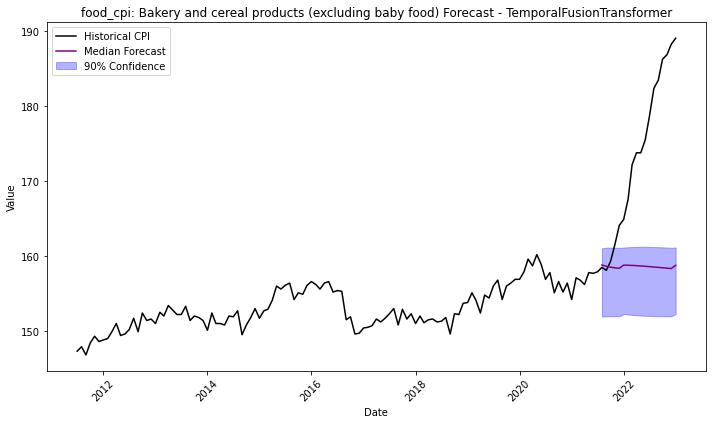

Beginning AutoGluon training... Time limit = 2s
AutoGluon will save models to './output/TEST/ag_global_all_TemporalFusionTransformerModel_exp2_GPT_P2_/random_seed_42/2021-07-01/model_files/'
=================== System Info ===================
AutoGluon Version:  1.1.1
Python Version:     3.8.20
Operating System:   Linux
Platform Machine:   x86_64
Platform Version:   #147~18.04.1-Ubuntu SMP Sat Oct 15 13:10:18 UTC 2022
CPU Count:          32
GPU Count:          1
Memory Avail:       166.10 GB / 188.57 GB (88.1%)
Disk Space Avail:   18213.92 GB / 249006.62 GB (7.3%)

Fitting with arguments:
{'enable_ensemble': True,
 'eval_metric': MAPE,
 'excluded_model_types': ['DirectTabular', 'RecursiveTabular'],
 'hyperparameters': {'TemporalFusionTransformerModel': {}},
 'known_covariates_names': [],
 'num_val_windows': 1,
 'prediction_length': 18,
 'quantile_levels': [0.01, 0.05, 0.1, 0.25, 0.75, 0.9, 0.95, 0.99],
 'random_seed': 42,
 'refit_every_n_windows': 1,
 'refit_full': False,
 'skip_model_

TemporalFusionTransformerModel


	-1.0965       = Validation score (-MAPE)
	2.15    s     = Training runtime
	0.04    s     = Validation (prediction) runtime
Not fitting ensemble due to lack of time remaining. Time left: -0.3 seconds
Training complete. Models trained: ['TemporalFusionTransformer']
Total runtime: 2.22 s
Best model: TemporalFusionTransformer
Best model score: -1.0965
Model not specified in predict, will default to the model with the best validation score: TemporalFusionTransformer


****************** Summary of fit() ******************
Estimated performance of each model:
                       model  score_val  pred_time_val  fit_time_marginal  \
0  TemporalFusionTransformer  -1.096471       0.038911           2.148338   

   fit_order  
0          1  
Number of models trained: 1
Types of models trained:
{'MultiWindowBacktestingModel'}
****************** End of fit() summary ******************


Model not specified in predict, will default to the model with the best validation score: TemporalFusionTransformer


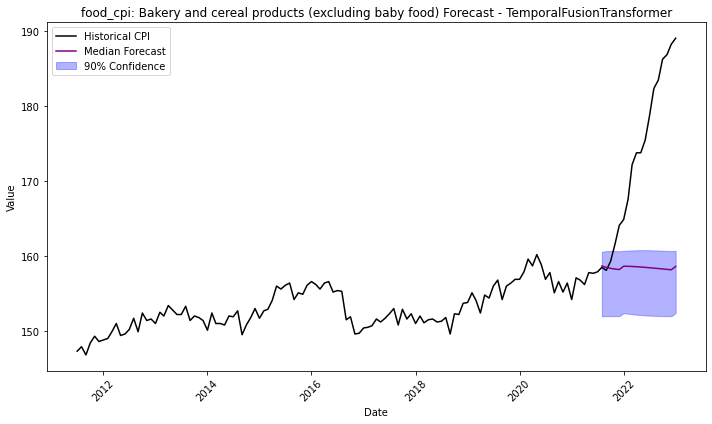

Beginning AutoGluon training... Time limit = 2s
AutoGluon will save models to './output/TEST/ag_global_all_TemporalFusionTransformerModel_exp2_R1_/random_seed_42/2021-07-01/model_files/'
=================== System Info ===================
AutoGluon Version:  1.1.1
Python Version:     3.8.20
Operating System:   Linux
Platform Machine:   x86_64
Platform Version:   #147~18.04.1-Ubuntu SMP Sat Oct 15 13:10:18 UTC 2022
CPU Count:          32
GPU Count:          1
Memory Avail:       166.09 GB / 188.57 GB (88.1%)
Disk Space Avail:   18213.91 GB / 249006.62 GB (7.3%)

Fitting with arguments:
{'enable_ensemble': True,
 'eval_metric': MAPE,
 'excluded_model_types': ['DirectTabular', 'RecursiveTabular'],
 'hyperparameters': {'TemporalFusionTransformerModel': {}},
 'known_covariates_names': [],
 'num_val_windows': 1,
 'prediction_length': 18,
 'quantile_levels': [0.01, 0.05, 0.1, 0.25, 0.75, 0.9, 0.95, 0.99],
 'random_seed': 42,
 'refit_every_n_windows': 1,
 'refit_full': False,
 'skip_model_sele

TemporalFusionTransformerModel


	-1.0301       = Validation score (-MAPE)
	2.16    s     = Training runtime
	0.04    s     = Validation (prediction) runtime
Not fitting ensemble due to lack of time remaining. Time left: -0.3 seconds
Training complete. Models trained: ['TemporalFusionTransformer']
Total runtime: 2.24 s
Best model: TemporalFusionTransformer
Best model score: -1.0301
Model not specified in predict, will default to the model with the best validation score: TemporalFusionTransformer
Model not specified in predict, will default to the model with the best validation score: TemporalFusionTransformer


****************** Summary of fit() ******************
Estimated performance of each model:
                       model  score_val  pred_time_val  fit_time_marginal  \
0  TemporalFusionTransformer  -1.030094       0.042923           2.158522   

   fit_order  
0          1  
Number of models trained: 1
Types of models trained:
{'MultiWindowBacktestingModel'}
****************** End of fit() summary ******************


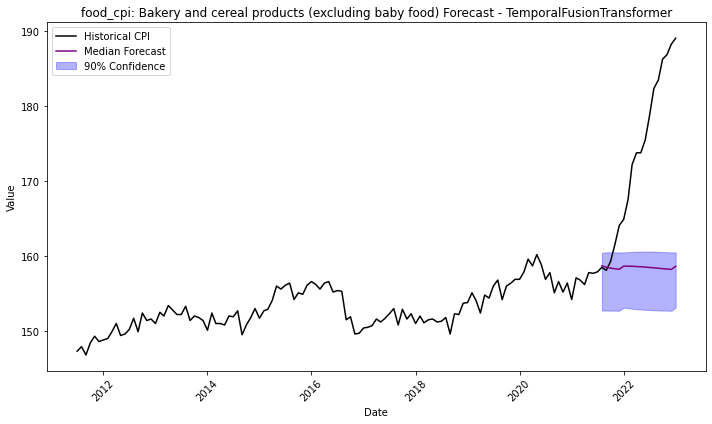

Beginning AutoGluon training... Time limit = 2s
AutoGluon will save models to './output/TEST/ag_global_all_TemporalFusionTransformerModel_exp2_R4_/random_seed_42/2021-07-01/model_files/'
=================== System Info ===================
AutoGluon Version:  1.1.1
Python Version:     3.8.20
Operating System:   Linux
Platform Machine:   x86_64
Platform Version:   #147~18.04.1-Ubuntu SMP Sat Oct 15 13:10:18 UTC 2022
CPU Count:          32
GPU Count:          1
Memory Avail:       166.21 GB / 188.57 GB (88.1%)
Disk Space Avail:   18213.96 GB / 249006.62 GB (7.3%)

Fitting with arguments:
{'enable_ensemble': True,
 'eval_metric': MAPE,
 'excluded_model_types': ['DirectTabular', 'RecursiveTabular'],
 'hyperparameters': {'TemporalFusionTransformerModel': {}},
 'known_covariates_names': [],
 'num_val_windows': 1,
 'prediction_length': 18,
 'quantile_levels': [0.01, 0.05, 0.1, 0.25, 0.75, 0.9, 0.95, 0.99],
 'random_seed': 42,
 'refit_every_n_windows': 1,
 'refit_full': False,
 'skip_model_sele

TemporalFusionTransformerModel


	-0.7075       = Validation score (-MAPE)
	2.14    s     = Training runtime
	0.04    s     = Validation (prediction) runtime
Not fitting ensemble due to lack of time remaining. Time left: -0.3 seconds
Training complete. Models trained: ['TemporalFusionTransformer']
Total runtime: 2.21 s
Best model: TemporalFusionTransformer
Best model score: -0.7075
Model not specified in predict, will default to the model with the best validation score: TemporalFusionTransformer
Model not specified in predict, will default to the model with the best validation score: TemporalFusionTransformer


****************** Summary of fit() ******************
Estimated performance of each model:
                       model  score_val  pred_time_val  fit_time_marginal  \
0  TemporalFusionTransformer  -0.707477       0.042737           2.135449   

   fit_order  
0          1  
Number of models trained: 1
Types of models trained:
{'MultiWindowBacktestingModel'}
****************** End of fit() summary ******************


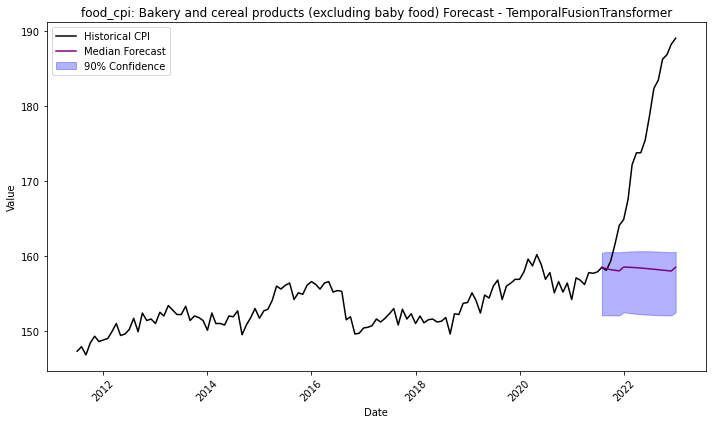

Beginning AutoGluon training... Time limit = 2s
AutoGluon will save models to './output/TEST/ag_global_all_TemporalFusionTransformerModel_exp2_GPT_P1_/random_seed_42/2021-07-01/model_files/'
=================== System Info ===================
AutoGluon Version:  1.1.1
Python Version:     3.8.20
Operating System:   Linux
Platform Machine:   x86_64
Platform Version:   #147~18.04.1-Ubuntu SMP Sat Oct 15 13:10:18 UTC 2022
CPU Count:          32
GPU Count:          1
Memory Avail:       166.09 GB / 188.57 GB (88.1%)
Disk Space Avail:   18213.95 GB / 249006.62 GB (7.3%)

Fitting with arguments:
{'enable_ensemble': True,
 'eval_metric': MAPE,
 'excluded_model_types': ['DirectTabular', 'RecursiveTabular'],
 'hyperparameters': {'TemporalFusionTransformerModel': {}},
 'known_covariates_names': [],
 'num_val_windows': 1,
 'prediction_length': 18,
 'quantile_levels': [0.01, 0.05, 0.1, 0.25, 0.75, 0.9, 0.95, 0.99],
 'random_seed': 42,
 'refit_every_n_windows': 1,
 'refit_full': False,
 'skip_model_

TemporalFusionTransformerModel


	-1.0981       = Validation score (-MAPE)
	2.13    s     = Training runtime
	0.05    s     = Validation (prediction) runtime
Not fitting ensemble due to lack of time remaining. Time left: -0.3 seconds
Training complete. Models trained: ['TemporalFusionTransformer']
Total runtime: 2.21 s
Best model: TemporalFusionTransformer
Best model score: -1.0981
Model not specified in predict, will default to the model with the best validation score: TemporalFusionTransformer
Model not specified in predict, will default to the model with the best validation score: TemporalFusionTransformer


****************** Summary of fit() ******************
Estimated performance of each model:
                       model  score_val  pred_time_val  fit_time_marginal  \
0  TemporalFusionTransformer  -1.098056       0.046252           2.132368   

   fit_order  
0          1  
Number of models trained: 1
Types of models trained:
{'MultiWindowBacktestingModel'}
****************** End of fit() summary ******************


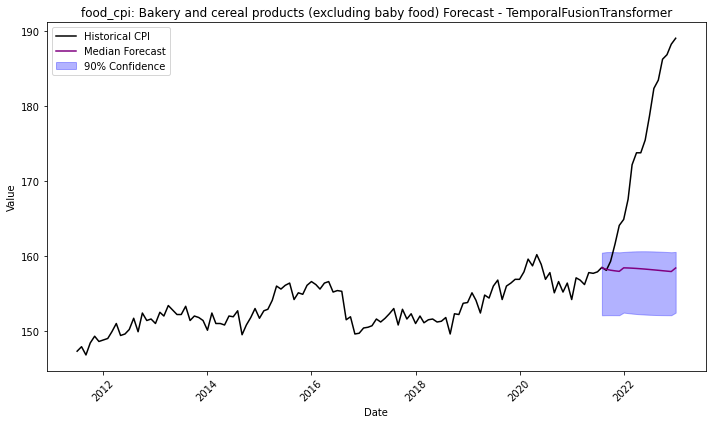

Beginning AutoGluon training... Time limit = 2s
AutoGluon will save models to './output/TEST/ag_global_all_TemporalFusionTransformerModel_exp2_GPT_P4_/random_seed_42/2021-07-01/model_files/'
=================== System Info ===================
AutoGluon Version:  1.1.1
Python Version:     3.8.20
Operating System:   Linux
Platform Machine:   x86_64
Platform Version:   #147~18.04.1-Ubuntu SMP Sat Oct 15 13:10:18 UTC 2022
CPU Count:          32
GPU Count:          1
Memory Avail:       166.11 GB / 188.57 GB (88.1%)
Disk Space Avail:   18213.95 GB / 249006.62 GB (7.3%)

Fitting with arguments:
{'enable_ensemble': True,
 'eval_metric': MAPE,
 'excluded_model_types': ['DirectTabular', 'RecursiveTabular'],
 'hyperparameters': {'TemporalFusionTransformerModel': {}},
 'known_covariates_names': [],
 'num_val_windows': 1,
 'prediction_length': 18,
 'quantile_levels': [0.01, 0.05, 0.1, 0.25, 0.75, 0.9, 0.95, 0.99],
 'random_seed': 42,
 'refit_every_n_windows': 1,
 'refit_full': False,
 'skip_model_

TemporalFusionTransformerModel


	-0.8965       = Validation score (-MAPE)
	2.16    s     = Training runtime
	0.04    s     = Validation (prediction) runtime
Not fitting ensemble due to lack of time remaining. Time left: -0.3 seconds
Training complete. Models trained: ['TemporalFusionTransformer']
Total runtime: 2.24 s
Best model: TemporalFusionTransformer
Best model score: -0.8965
Model not specified in predict, will default to the model with the best validation score: TemporalFusionTransformer
Model not specified in predict, will default to the model with the best validation score: TemporalFusionTransformer


****************** Summary of fit() ******************
Estimated performance of each model:
                       model  score_val  pred_time_val  fit_time_marginal  \
0  TemporalFusionTransformer  -0.896482       0.038055           2.163723   

   fit_order  
0          1  
Number of models trained: 1
Types of models trained:
{'MultiWindowBacktestingModel'}
****************** End of fit() summary ******************


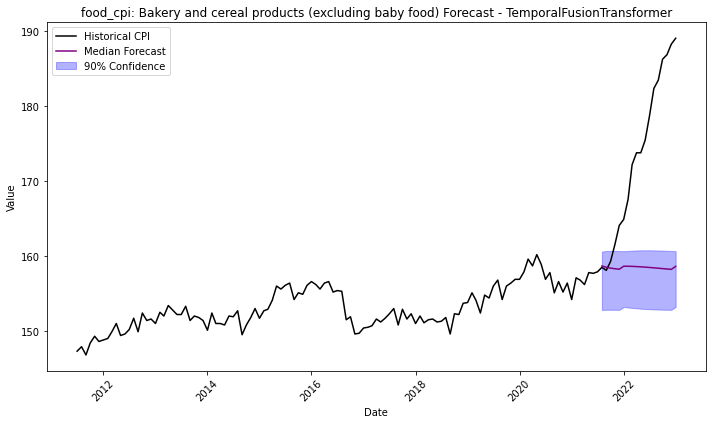

Beginning AutoGluon training... Time limit = 2s
AutoGluon will save models to './output/TEST/ag_global_all_TemporalFusionTransformerModel_exp2_R3_/random_seed_42/2022-07-01/model_files/'
=================== System Info ===================
AutoGluon Version:  1.1.1
Python Version:     3.8.20
Operating System:   Linux
Platform Machine:   x86_64
Platform Version:   #147~18.04.1-Ubuntu SMP Sat Oct 15 13:10:18 UTC 2022
CPU Count:          32
GPU Count:          1
Memory Avail:       166.11 GB / 188.57 GB (88.1%)
Disk Space Avail:   18213.94 GB / 249006.62 GB (7.3%)

Fitting with arguments:
{'enable_ensemble': True,
 'eval_metric': MAPE,
 'excluded_model_types': ['DirectTabular', 'RecursiveTabular'],
 'hyperparameters': {'TemporalFusionTransformerModel': {}},
 'known_covariates_names': [],
 'num_val_windows': 1,
 'prediction_length': 18,
 'quantile_levels': [0.01, 0.05, 0.1, 0.25, 0.75, 0.9, 0.95, 0.99],
 'random_seed': 42,
 'refit_every_n_windows': 1,
 'refit_full': False,
 'skip_model_sele

TemporalFusionTransformerModel


	-0.4345       = Validation score (-MAPE)
	2.21    s     = Training runtime
	0.04    s     = Validation (prediction) runtime
Not fitting ensemble due to lack of time remaining. Time left: -0.3 seconds
Training complete. Models trained: ['TemporalFusionTransformer']
Total runtime: 2.28 s
Best model: TemporalFusionTransformer
Best model score: -0.4345
Model not specified in predict, will default to the model with the best validation score: TemporalFusionTransformer
Model not specified in predict, will default to the model with the best validation score: TemporalFusionTransformer


****************** Summary of fit() ******************
Estimated performance of each model:
                       model  score_val  pred_time_val  fit_time_marginal  \
0  TemporalFusionTransformer  -0.434451       0.043981           2.208251   

   fit_order  
0          1  
Number of models trained: 1
Types of models trained:
{'MultiWindowBacktestingModel'}
****************** End of fit() summary ******************


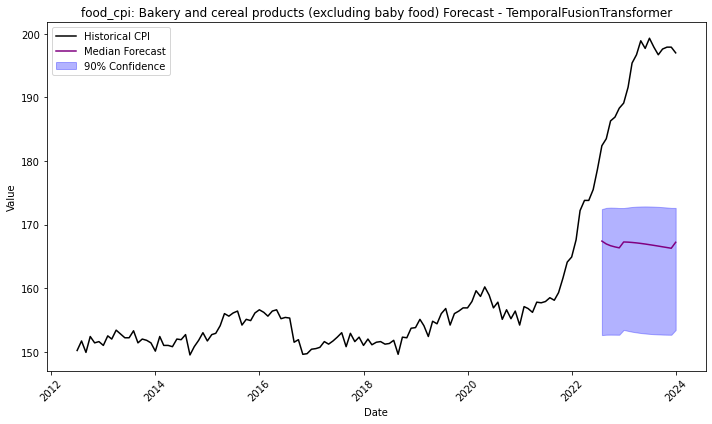

Beginning AutoGluon training... Time limit = 2s
AutoGluon will save models to './output/TEST/ag_global_all_TemporalFusionTransformerModel_exp2_GPT_P3_/random_seed_42/2022-07-01/model_files/'
=================== System Info ===================
AutoGluon Version:  1.1.1
Python Version:     3.8.20
Operating System:   Linux
Platform Machine:   x86_64
Platform Version:   #147~18.04.1-Ubuntu SMP Sat Oct 15 13:10:18 UTC 2022
CPU Count:          32
GPU Count:          1
Memory Avail:       166.11 GB / 188.57 GB (88.1%)
Disk Space Avail:   18213.93 GB / 249006.62 GB (7.3%)

Fitting with arguments:
{'enable_ensemble': True,
 'eval_metric': MAPE,
 'excluded_model_types': ['DirectTabular', 'RecursiveTabular'],
 'hyperparameters': {'TemporalFusionTransformerModel': {}},
 'known_covariates_names': [],
 'num_val_windows': 1,
 'prediction_length': 18,
 'quantile_levels': [0.01, 0.05, 0.1, 0.25, 0.75, 0.9, 0.95, 0.99],
 'random_seed': 42,
 'refit_every_n_windows': 1,
 'refit_full': False,
 'skip_model_

TemporalFusionTransformerModel


Inferred time series frequency: 'MS'
Provided train_data has 9658 rows, 22 time series. Median time series length is 439 (min=439, max=439). 

Provided data contains following columns:
	target: 'target'

AutoGluon will gauge predictive performance using evaluation metric: 'MAPE'
	This metric's sign has been flipped to adhere to being higher_is_better. The metric score can be multiplied by -1 to get the metric value.

Starting training. Start time is 2024-10-27 07:30:14
Excluded model types: ['DirectTabular', 'RecursiveTabular']
Models that will be trained: ['TemporalFusionTransformer']
Training timeseries model TemporalFusionTransformer. Training for up to 1.6s of the 1.6s of remaining time.
	-5.4404       = Validation score (-MAPE)
	1.81    s     = Training runtime
	0.04    s     = Validation (prediction) runtime
Not fitting ensemble due to lack of time remaining. Time left: -0.3 seconds
Training complete. Models trained: ['TemporalFusionTransformer']
Total runtime: 1.88 s
Best model:

****************** Summary of fit() ******************
Estimated performance of each model:
                       model  score_val  pred_time_val  fit_time_marginal  \
0  TemporalFusionTransformer  -5.440425       0.043789           1.806673   

   fit_order  
0          1  
Number of models trained: 1
Types of models trained:
{'MultiWindowBacktestingModel'}
****************** End of fit() summary ******************


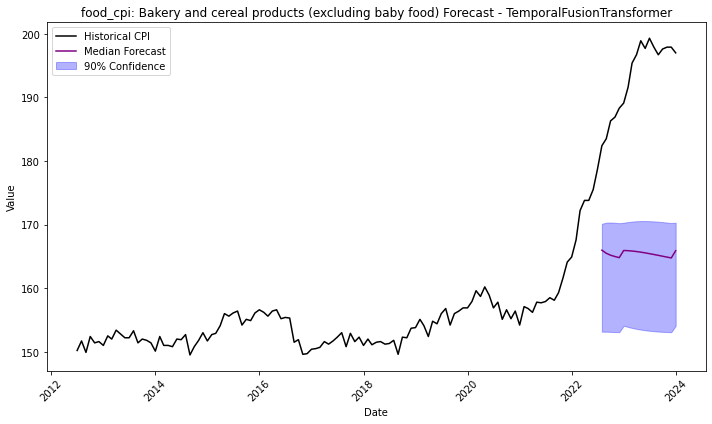

Beginning AutoGluon training... Time limit = 2s
AutoGluon will save models to './output/TEST/ag_global_all_TemporalFusionTransformerModel_exp2_R2_/random_seed_42/2022-07-01/model_files/'
=================== System Info ===================
AutoGluon Version:  1.1.1
Python Version:     3.8.20
Operating System:   Linux
Platform Machine:   x86_64
Platform Version:   #147~18.04.1-Ubuntu SMP Sat Oct 15 13:10:18 UTC 2022
CPU Count:          32
GPU Count:          1
Memory Avail:       166.11 GB / 188.57 GB (88.1%)
Disk Space Avail:   18213.91 GB / 249006.62 GB (7.3%)

Fitting with arguments:
{'enable_ensemble': True,
 'eval_metric': MAPE,
 'excluded_model_types': ['DirectTabular', 'RecursiveTabular'],
 'hyperparameters': {'TemporalFusionTransformerModel': {}},
 'known_covariates_names': [],
 'num_val_windows': 1,
 'prediction_length': 18,
 'quantile_levels': [0.01, 0.05, 0.1, 0.25, 0.75, 0.9, 0.95, 0.99],
 'random_seed': 42,
 'refit_every_n_windows': 1,
 'refit_full': False,
 'skip_model_sele

TemporalFusionTransformerModel


	-0.5746       = Validation score (-MAPE)
	2.16    s     = Training runtime
	0.04    s     = Validation (prediction) runtime
Not fitting ensemble due to lack of time remaining. Time left: -0.3 seconds
Training complete. Models trained: ['TemporalFusionTransformer']
Total runtime: 2.24 s
Best model: TemporalFusionTransformer
Best model score: -0.5746
Model not specified in predict, will default to the model with the best validation score: TemporalFusionTransformer
Model not specified in predict, will default to the model with the best validation score: TemporalFusionTransformer


****************** Summary of fit() ******************
Estimated performance of each model:
                       model  score_val  pred_time_val  fit_time_marginal  \
0  TemporalFusionTransformer  -0.574632       0.043858           2.157495   

   fit_order  
0          1  
Number of models trained: 1
Types of models trained:
{'MultiWindowBacktestingModel'}
****************** End of fit() summary ******************


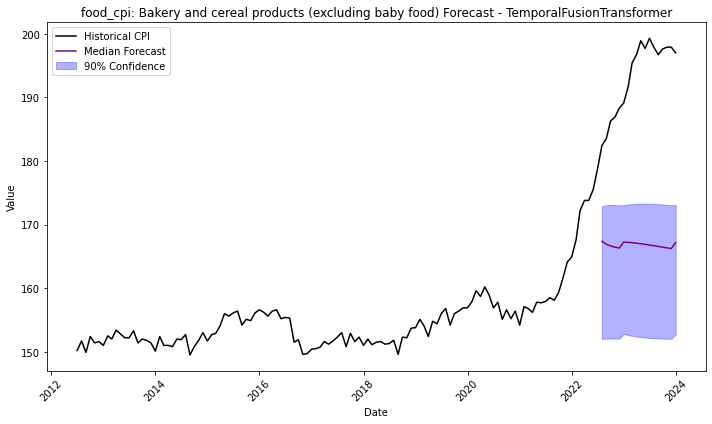

Beginning AutoGluon training... Time limit = 2s
AutoGluon will save models to './output/TEST/ag_global_all_TemporalFusionTransformerModel_exp2_GPT_P2_/random_seed_42/2022-07-01/model_files/'
=================== System Info ===================
AutoGluon Version:  1.1.1
Python Version:     3.8.20
Operating System:   Linux
Platform Machine:   x86_64
Platform Version:   #147~18.04.1-Ubuntu SMP Sat Oct 15 13:10:18 UTC 2022
CPU Count:          32
GPU Count:          1
Memory Avail:       166.10 GB / 188.57 GB (88.1%)
Disk Space Avail:   18213.95 GB / 249006.62 GB (7.3%)

Fitting with arguments:
{'enable_ensemble': True,
 'eval_metric': MAPE,
 'excluded_model_types': ['DirectTabular', 'RecursiveTabular'],
 'hyperparameters': {'TemporalFusionTransformerModel': {}},
 'known_covariates_names': [],
 'num_val_windows': 1,
 'prediction_length': 18,
 'quantile_levels': [0.01, 0.05, 0.1, 0.25, 0.75, 0.9, 0.95, 0.99],
 'random_seed': 42,
 'refit_every_n_windows': 1,
 'refit_full': False,
 'skip_model_

TemporalFusionTransformerModel


	-6.2938       = Validation score (-MAPE)
	2.13    s     = Training runtime
	0.04    s     = Validation (prediction) runtime
Not fitting ensemble due to lack of time remaining. Time left: -0.3 seconds
Training complete. Models trained: ['TemporalFusionTransformer']
Total runtime: 2.21 s
Best model: TemporalFusionTransformer
Best model score: -6.2938
Model not specified in predict, will default to the model with the best validation score: TemporalFusionTransformer
Model not specified in predict, will default to the model with the best validation score: TemporalFusionTransformer


****************** Summary of fit() ******************
Estimated performance of each model:
                       model  score_val  pred_time_val  fit_time_marginal  \
0  TemporalFusionTransformer  -6.293792       0.040201            2.13468   

   fit_order  
0          1  
Number of models trained: 1
Types of models trained:
{'MultiWindowBacktestingModel'}
****************** End of fit() summary ******************


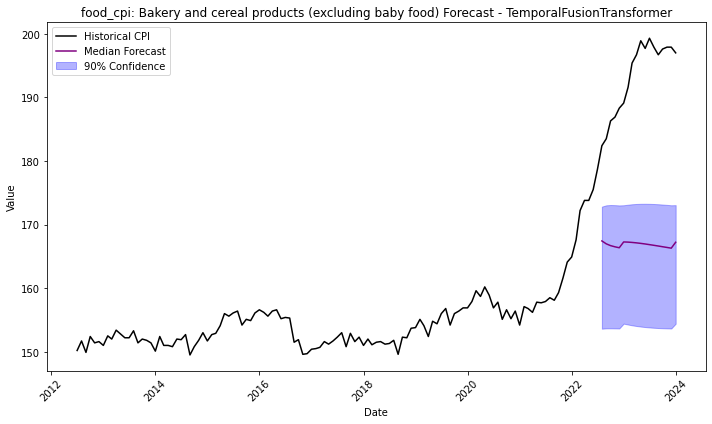

Beginning AutoGluon training... Time limit = 2s
AutoGluon will save models to './output/TEST/ag_global_all_TemporalFusionTransformerModel_exp2_R1_/random_seed_42/2022-07-01/model_files/'
=================== System Info ===================
AutoGluon Version:  1.1.1
Python Version:     3.8.20
Operating System:   Linux
Platform Machine:   x86_64
Platform Version:   #147~18.04.1-Ubuntu SMP Sat Oct 15 13:10:18 UTC 2022
CPU Count:          32
GPU Count:          1
Memory Avail:       166.10 GB / 188.57 GB (88.1%)
Disk Space Avail:   18213.93 GB / 249006.62 GB (7.3%)

Fitting with arguments:
{'enable_ensemble': True,
 'eval_metric': MAPE,
 'excluded_model_types': ['DirectTabular', 'RecursiveTabular'],
 'hyperparameters': {'TemporalFusionTransformerModel': {}},
 'known_covariates_names': [],
 'num_val_windows': 1,
 'prediction_length': 18,
 'quantile_levels': [0.01, 0.05, 0.1, 0.25, 0.75, 0.9, 0.95, 0.99],
 'random_seed': 42,
 'refit_every_n_windows': 1,
 'refit_full': False,
 'skip_model_sele

TemporalFusionTransformerModel


	-5.5852       = Validation score (-MAPE)
	2.12    s     = Training runtime
	0.04    s     = Validation (prediction) runtime
Not fitting ensemble due to lack of time remaining. Time left: -0.3 seconds
Training complete. Models trained: ['TemporalFusionTransformer']
Total runtime: 2.20 s
Best model: TemporalFusionTransformer
Best model score: -5.5852
Model not specified in predict, will default to the model with the best validation score: TemporalFusionTransformer
Model not specified in predict, will default to the model with the best validation score: TemporalFusionTransformer


****************** Summary of fit() ******************
Estimated performance of each model:
                       model  score_val  pred_time_val  fit_time_marginal  \
0  TemporalFusionTransformer  -5.585218       0.043135           2.121541   

   fit_order  
0          1  
Number of models trained: 1
Types of models trained:
{'MultiWindowBacktestingModel'}
****************** End of fit() summary ******************


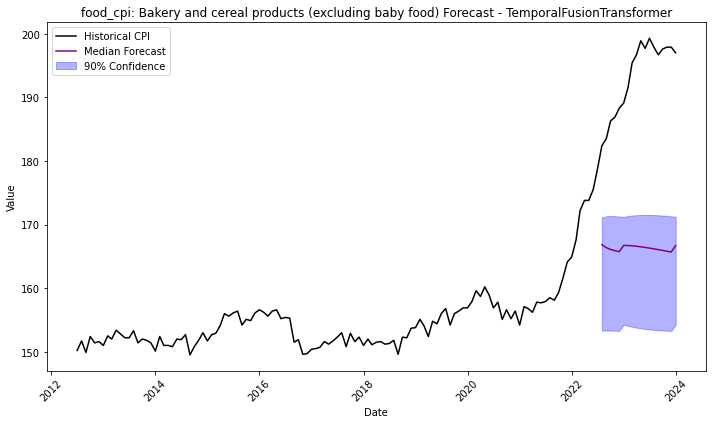

Beginning AutoGluon training... Time limit = 2s
AutoGluon will save models to './output/TEST/ag_global_all_TemporalFusionTransformerModel_exp2_R4_/random_seed_42/2022-07-01/model_files/'
=================== System Info ===================
AutoGluon Version:  1.1.1
Python Version:     3.8.20
Operating System:   Linux
Platform Machine:   x86_64
Platform Version:   #147~18.04.1-Ubuntu SMP Sat Oct 15 13:10:18 UTC 2022
CPU Count:          32
GPU Count:          1
Memory Avail:       166.10 GB / 188.57 GB (88.1%)
Disk Space Avail:   18214.38 GB / 249006.62 GB (7.3%)

Fitting with arguments:
{'enable_ensemble': True,
 'eval_metric': MAPE,
 'excluded_model_types': ['DirectTabular', 'RecursiveTabular'],
 'hyperparameters': {'TemporalFusionTransformerModel': {}},
 'known_covariates_names': [],
 'num_val_windows': 1,
 'prediction_length': 18,
 'quantile_levels': [0.01, 0.05, 0.1, 0.25, 0.75, 0.9, 0.95, 0.99],
 'random_seed': 42,
 'refit_every_n_windows': 1,
 'refit_full': False,
 'skip_model_sele

TemporalFusionTransformerModel


	-5.3844       = Validation score (-MAPE)
	2.15    s     = Training runtime
	0.04    s     = Validation (prediction) runtime
Not fitting ensemble due to lack of time remaining. Time left: -0.3 seconds
Training complete. Models trained: ['TemporalFusionTransformer']
Total runtime: 2.23 s
Best model: TemporalFusionTransformer
Best model score: -5.3844
Model not specified in predict, will default to the model with the best validation score: TemporalFusionTransformer
Model not specified in predict, will default to the model with the best validation score: TemporalFusionTransformer


****************** Summary of fit() ******************
Estimated performance of each model:
                       model  score_val  pred_time_val  fit_time_marginal  \
0  TemporalFusionTransformer  -5.384368       0.043919            2.14953   

   fit_order  
0          1  
Number of models trained: 1
Types of models trained:
{'MultiWindowBacktestingModel'}
****************** End of fit() summary ******************


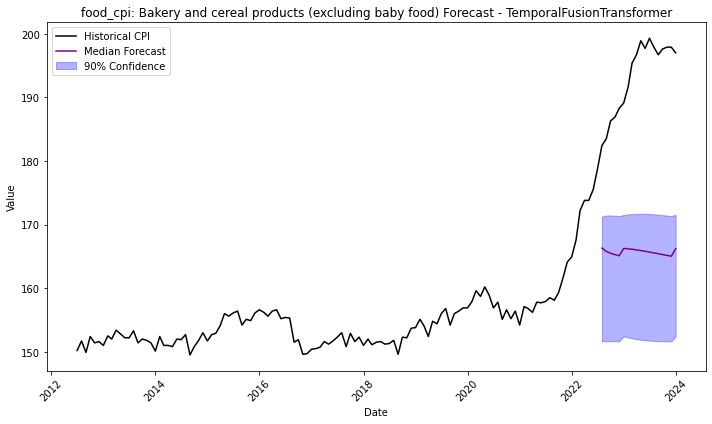

Beginning AutoGluon training... Time limit = 2s
AutoGluon will save models to './output/TEST/ag_global_all_TemporalFusionTransformerModel_exp2_GPT_P1_/random_seed_42/2022-07-01/model_files/'
=================== System Info ===================
AutoGluon Version:  1.1.1
Python Version:     3.8.20
Operating System:   Linux
Platform Machine:   x86_64
Platform Version:   #147~18.04.1-Ubuntu SMP Sat Oct 15 13:10:18 UTC 2022
CPU Count:          32
GPU Count:          1
Memory Avail:       166.09 GB / 188.57 GB (88.1%)
Disk Space Avail:   18214.37 GB / 249006.62 GB (7.3%)

Fitting with arguments:
{'enable_ensemble': True,
 'eval_metric': MAPE,
 'excluded_model_types': ['DirectTabular', 'RecursiveTabular'],
 'hyperparameters': {'TemporalFusionTransformerModel': {}},
 'known_covariates_names': [],
 'num_val_windows': 1,
 'prediction_length': 18,
 'quantile_levels': [0.01, 0.05, 0.1, 0.25, 0.75, 0.9, 0.95, 0.99],
 'random_seed': 42,
 'refit_every_n_windows': 1,
 'refit_full': False,
 'skip_model_

TemporalFusionTransformerModel


Inferred time series frequency: 'MS'
Provided train_data has 9658 rows, 22 time series. Median time series length is 439 (min=439, max=439). 

Provided data contains following columns:
	target: 'target'

AutoGluon will gauge predictive performance using evaluation metric: 'MAPE'
	This metric's sign has been flipped to adhere to being higher_is_better. The metric score can be multiplied by -1 to get the metric value.

Starting training. Start time is 2024-10-27 07:30:28
Excluded model types: ['DirectTabular', 'RecursiveTabular']
Models that will be trained: ['TemporalFusionTransformer']
Training timeseries model TemporalFusionTransformer. Training for up to 1.6s of the 1.6s of remaining time.
	-5.4484       = Validation score (-MAPE)
	1.90    s     = Training runtime
	0.04    s     = Validation (prediction) runtime
Not fitting ensemble due to lack of time remaining. Time left: -0.3 seconds
Training complete. Models trained: ['TemporalFusionTransformer']
Total runtime: 1.98 s
Best model:

****************** Summary of fit() ******************
Estimated performance of each model:
                       model  score_val  pred_time_val  fit_time_marginal  \
0  TemporalFusionTransformer  -5.448378       0.043216           1.899806   

   fit_order  
0          1  
Number of models trained: 1
Types of models trained:
{'MultiWindowBacktestingModel'}
****************** End of fit() summary ******************


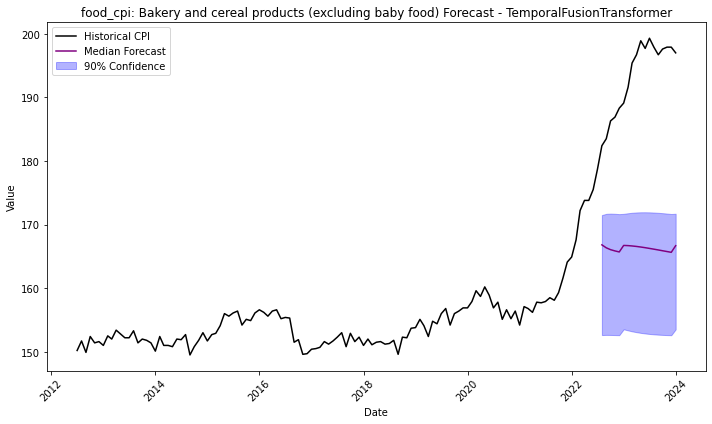

Beginning AutoGluon training... Time limit = 2s
AutoGluon will save models to './output/TEST/ag_global_all_TemporalFusionTransformerModel_exp2_GPT_P4_/random_seed_42/2022-07-01/model_files/'
=================== System Info ===================
AutoGluon Version:  1.1.1
Python Version:     3.8.20
Operating System:   Linux
Platform Machine:   x86_64
Platform Version:   #147~18.04.1-Ubuntu SMP Sat Oct 15 13:10:18 UTC 2022
CPU Count:          32
GPU Count:          1
Memory Avail:       166.09 GB / 188.57 GB (88.1%)
Disk Space Avail:   18214.36 GB / 249006.62 GB (7.3%)

Fitting with arguments:
{'enable_ensemble': True,
 'eval_metric': MAPE,
 'excluded_model_types': ['DirectTabular', 'RecursiveTabular'],
 'hyperparameters': {'TemporalFusionTransformerModel': {}},
 'known_covariates_names': [],
 'num_val_windows': 1,
 'prediction_length': 18,
 'quantile_levels': [0.01, 0.05, 0.1, 0.25, 0.75, 0.9, 0.95, 0.99],
 'random_seed': 42,
 'refit_every_n_windows': 1,
 'refit_full': False,
 'skip_model_

TemporalFusionTransformerModel


	-6.6064       = Validation score (-MAPE)
	2.15    s     = Training runtime
	0.05    s     = Validation (prediction) runtime
Not fitting ensemble due to lack of time remaining. Time left: -0.3 seconds
Training complete. Models trained: ['TemporalFusionTransformer']
Total runtime: 2.23 s
Best model: TemporalFusionTransformer
Best model score: -6.6064
Model not specified in predict, will default to the model with the best validation score: TemporalFusionTransformer
Model not specified in predict, will default to the model with the best validation score: TemporalFusionTransformer


****************** Summary of fit() ******************
Estimated performance of each model:
                       model  score_val  pred_time_val  fit_time_marginal  \
0  TemporalFusionTransformer  -6.606448       0.049266           2.146975   

   fit_order  
0          1  
Number of models trained: 1
Types of models trained:
{'MultiWindowBacktestingModel'}
****************** End of fit() summary ******************


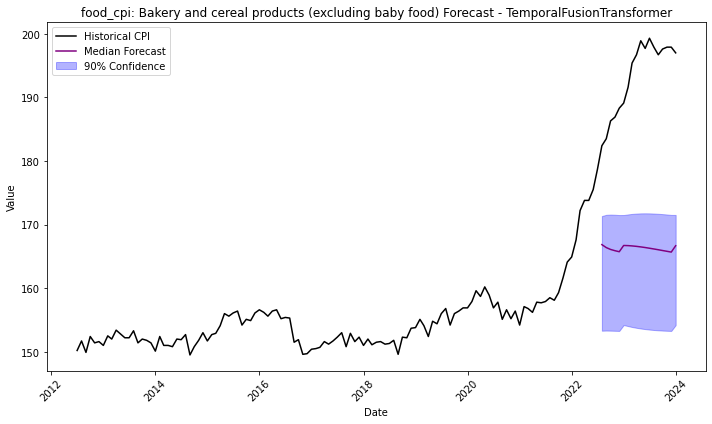

Beginning AutoGluon training... Time limit = 2s
AutoGluon will save models to './output/TEST/ag_global_all_TemporalFusionTransformerModel_exp2_R3_/random_seed_42/2023-07-01/model_files/'
=================== System Info ===================
AutoGluon Version:  1.1.1
Python Version:     3.8.20
Operating System:   Linux
Platform Machine:   x86_64
Platform Version:   #147~18.04.1-Ubuntu SMP Sat Oct 15 13:10:18 UTC 2022
CPU Count:          32
GPU Count:          1
Memory Avail:       166.09 GB / 188.57 GB (88.1%)
Disk Space Avail:   18214.34 GB / 249006.62 GB (7.3%)

Fitting with arguments:
{'enable_ensemble': True,
 'eval_metric': MAPE,
 'excluded_model_types': ['DirectTabular', 'RecursiveTabular'],
 'hyperparameters': {'TemporalFusionTransformerModel': {}},
 'known_covariates_names': [],
 'num_val_windows': 1,
 'prediction_length': 18,
 'quantile_levels': [0.01, 0.05, 0.1, 0.25, 0.75, 0.9, 0.95, 0.99],
 'random_seed': 42,
 'refit_every_n_windows': 1,
 'refit_full': False,
 'skip_model_sele

TemporalFusionTransformerModel


	-0.4643       = Validation score (-MAPE)
	2.12    s     = Training runtime
	0.04    s     = Validation (prediction) runtime
Not fitting ensemble due to lack of time remaining. Time left: -0.3 seconds
Training complete. Models trained: ['TemporalFusionTransformer']
Total runtime: 2.20 s
Best model: TemporalFusionTransformer
Best model score: -0.4643
Model not specified in predict, will default to the model with the best validation score: TemporalFusionTransformer
Model not specified in predict, will default to the model with the best validation score: TemporalFusionTransformer


****************** Summary of fit() ******************
Estimated performance of each model:
                       model  score_val  pred_time_val  fit_time_marginal  \
0  TemporalFusionTransformer  -0.464256         0.0433            2.12202   

   fit_order  
0          1  
Number of models trained: 1
Types of models trained:
{'MultiWindowBacktestingModel'}
****************** End of fit() summary ******************


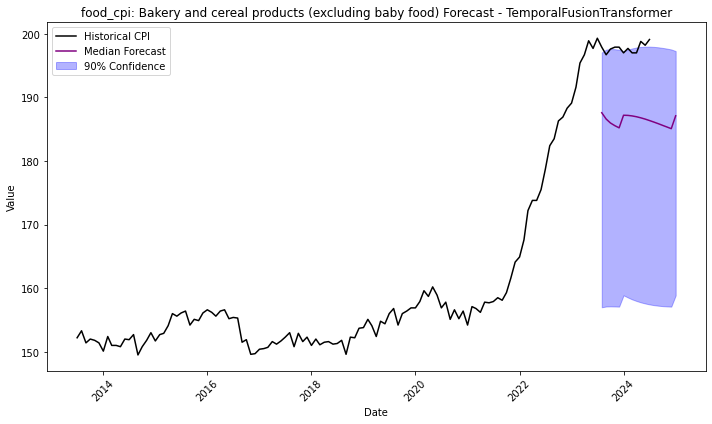

Beginning AutoGluon training... Time limit = 2s
AutoGluon will save models to './output/TEST/ag_global_all_TemporalFusionTransformerModel_exp2_GPT_P3_/random_seed_42/2023-07-01/model_files/'
=================== System Info ===================
AutoGluon Version:  1.1.1
Python Version:     3.8.20
Operating System:   Linux
Platform Machine:   x86_64
Platform Version:   #147~18.04.1-Ubuntu SMP Sat Oct 15 13:10:18 UTC 2022
CPU Count:          32
GPU Count:          1
Memory Avail:       166.09 GB / 188.57 GB (88.1%)
Disk Space Avail:   18214.34 GB / 249006.62 GB (7.3%)

Fitting with arguments:
{'enable_ensemble': True,
 'eval_metric': MAPE,
 'excluded_model_types': ['DirectTabular', 'RecursiveTabular'],
 'hyperparameters': {'TemporalFusionTransformerModel': {}},
 'known_covariates_names': [],
 'num_val_windows': 1,
 'prediction_length': 18,
 'quantile_levels': [0.01, 0.05, 0.1, 0.25, 0.75, 0.9, 0.95, 0.99],
 'random_seed': 42,
 'refit_every_n_windows': 1,
 'refit_full': False,
 'skip_model_

TemporalFusionTransformerModel


	-1.0813       = Validation score (-MAPE)
	2.15    s     = Training runtime
	0.05    s     = Validation (prediction) runtime
Not fitting ensemble due to lack of time remaining. Time left: -0.3 seconds
Training complete. Models trained: ['TemporalFusionTransformer']
Total runtime: 2.22 s
Best model: TemporalFusionTransformer
Best model score: -1.0813
Model not specified in predict, will default to the model with the best validation score: TemporalFusionTransformer
Model not specified in predict, will default to the model with the best validation score: TemporalFusionTransformer


****************** Summary of fit() ******************
Estimated performance of each model:
                       model  score_val  pred_time_val  fit_time_marginal  \
0  TemporalFusionTransformer  -1.081297       0.045475           2.147768   

   fit_order  
0          1  
Number of models trained: 1
Types of models trained:
{'MultiWindowBacktestingModel'}
****************** End of fit() summary ******************


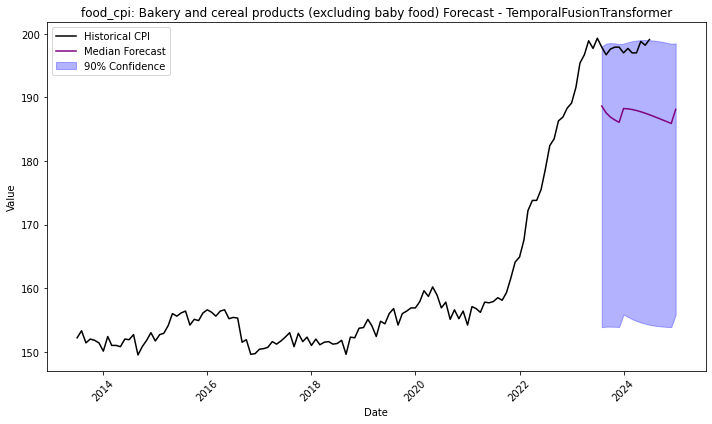

Beginning AutoGluon training... Time limit = 2s
AutoGluon will save models to './output/TEST/ag_global_all_TemporalFusionTransformerModel_exp2_R2_/random_seed_42/2023-07-01/model_files/'
=================== System Info ===================
AutoGluon Version:  1.1.1
Python Version:     3.8.20
Operating System:   Linux
Platform Machine:   x86_64
Platform Version:   #147~18.04.1-Ubuntu SMP Sat Oct 15 13:10:18 UTC 2022
CPU Count:          32
GPU Count:          1
Memory Avail:       166.09 GB / 188.57 GB (88.1%)
Disk Space Avail:   18214.33 GB / 249006.62 GB (7.3%)

Fitting with arguments:
{'enable_ensemble': True,
 'eval_metric': MAPE,
 'excluded_model_types': ['DirectTabular', 'RecursiveTabular'],
 'hyperparameters': {'TemporalFusionTransformerModel': {}},
 'known_covariates_names': [],
 'num_val_windows': 1,
 'prediction_length': 18,
 'quantile_levels': [0.01, 0.05, 0.1, 0.25, 0.75, 0.9, 0.95, 0.99],
 'random_seed': 42,
 'refit_every_n_windows': 1,
 'refit_full': False,
 'skip_model_sele

TemporalFusionTransformerModel


	-0.5297       = Validation score (-MAPE)
	2.12    s     = Training runtime
	0.04    s     = Validation (prediction) runtime
Not fitting ensemble due to lack of time remaining. Time left: -0.3 seconds
Training complete. Models trained: ['TemporalFusionTransformer']
Total runtime: 2.22 s
Best model: TemporalFusionTransformer
Best model score: -0.5297
Model not specified in predict, will default to the model with the best validation score: TemporalFusionTransformer
Model not specified in predict, will default to the model with the best validation score: TemporalFusionTransformer


****************** Summary of fit() ******************
Estimated performance of each model:
                       model  score_val  pred_time_val  fit_time_marginal  \
0  TemporalFusionTransformer  -0.529657       0.043983            2.12452   

   fit_order  
0          1  
Number of models trained: 1
Types of models trained:
{'MultiWindowBacktestingModel'}
****************** End of fit() summary ******************


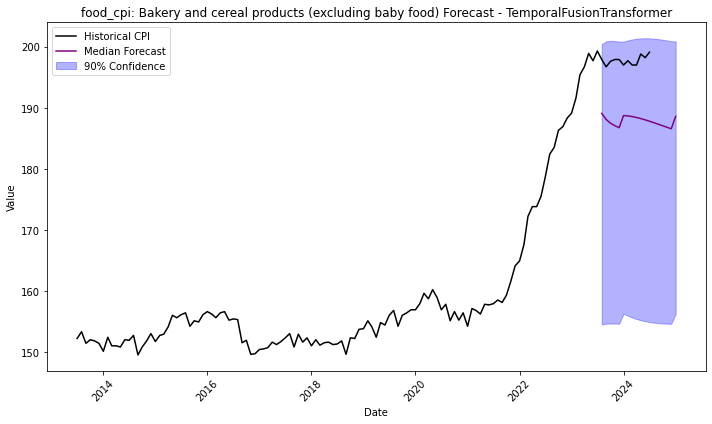

Beginning AutoGluon training... Time limit = 2s
AutoGluon will save models to './output/TEST/ag_global_all_TemporalFusionTransformerModel_exp2_GPT_P2_/random_seed_42/2023-07-01/model_files/'
=================== System Info ===================
AutoGluon Version:  1.1.1
Python Version:     3.8.20
Operating System:   Linux
Platform Machine:   x86_64
Platform Version:   #147~18.04.1-Ubuntu SMP Sat Oct 15 13:10:18 UTC 2022
CPU Count:          32
GPU Count:          1
Memory Avail:       166.08 GB / 188.57 GB (88.1%)
Disk Space Avail:   18214.32 GB / 249006.62 GB (7.3%)

Fitting with arguments:
{'enable_ensemble': True,
 'eval_metric': MAPE,
 'excluded_model_types': ['DirectTabular', 'RecursiveTabular'],
 'hyperparameters': {'TemporalFusionTransformerModel': {}},
 'known_covariates_names': [],
 'num_val_windows': 1,
 'prediction_length': 18,
 'quantile_levels': [0.01, 0.05, 0.1, 0.25, 0.75, 0.9, 0.95, 0.99],
 'random_seed': 42,
 'refit_every_n_windows': 1,
 'refit_full': False,
 'skip_model_

TemporalFusionTransformerModel


	-0.6447       = Validation score (-MAPE)
	2.11    s     = Training runtime
	0.04    s     = Validation (prediction) runtime
Not fitting ensemble due to lack of time remaining. Time left: -0.2 seconds
Training complete. Models trained: ['TemporalFusionTransformer']
Total runtime: 2.19 s
Best model: TemporalFusionTransformer
Best model score: -0.6447


****************** Summary of fit() ******************
Estimated performance of each model:
                       model  score_val  pred_time_val  fit_time_marginal  \
0  TemporalFusionTransformer  -0.644686       0.041593           2.111701   

   fit_order  
0          1  
Number of models trained: 1
Types of models trained:
{'MultiWindowBacktestingModel'}
****************** End of fit() summary ******************


Model not specified in predict, will default to the model with the best validation score: TemporalFusionTransformer
Model not specified in predict, will default to the model with the best validation score: TemporalFusionTransformer


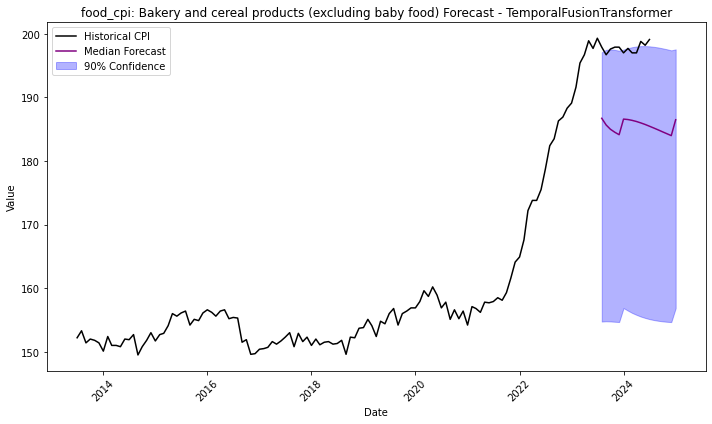

Beginning AutoGluon training... Time limit = 2s
AutoGluon will save models to './output/TEST/ag_global_all_TemporalFusionTransformerModel_exp2_R1_/random_seed_42/2023-07-01/model_files/'
=================== System Info ===================
AutoGluon Version:  1.1.1
Python Version:     3.8.20
Operating System:   Linux
Platform Machine:   x86_64
Platform Version:   #147~18.04.1-Ubuntu SMP Sat Oct 15 13:10:18 UTC 2022
CPU Count:          32
GPU Count:          1
Memory Avail:       166.09 GB / 188.57 GB (88.1%)
Disk Space Avail:   18214.37 GB / 249006.62 GB (7.3%)

Fitting with arguments:
{'enable_ensemble': True,
 'eval_metric': MAPE,
 'excluded_model_types': ['DirectTabular', 'RecursiveTabular'],
 'hyperparameters': {'TemporalFusionTransformerModel': {}},
 'known_covariates_names': [],
 'num_val_windows': 1,
 'prediction_length': 18,
 'quantile_levels': [0.01, 0.05, 0.1, 0.25, 0.75, 0.9, 0.95, 0.99],
 'random_seed': 42,
 'refit_every_n_windows': 1,
 'refit_full': False,
 'skip_model_sele

TemporalFusionTransformerModel


	-0.9907       = Validation score (-MAPE)
	2.17    s     = Training runtime
	0.04    s     = Validation (prediction) runtime
Not fitting ensemble due to lack of time remaining. Time left: -0.3 seconds
Training complete. Models trained: ['TemporalFusionTransformer']
Total runtime: 2.26 s
Best model: TemporalFusionTransformer
Best model score: -0.9907
Model not specified in predict, will default to the model with the best validation score: TemporalFusionTransformer
Model not specified in predict, will default to the model with the best validation score: TemporalFusionTransformer


****************** Summary of fit() ******************
Estimated performance of each model:
                       model  score_val  pred_time_val  fit_time_marginal  \
0  TemporalFusionTransformer  -0.990726       0.044843           2.171806   

   fit_order  
0          1  
Number of models trained: 1
Types of models trained:
{'MultiWindowBacktestingModel'}
****************** End of fit() summary ******************


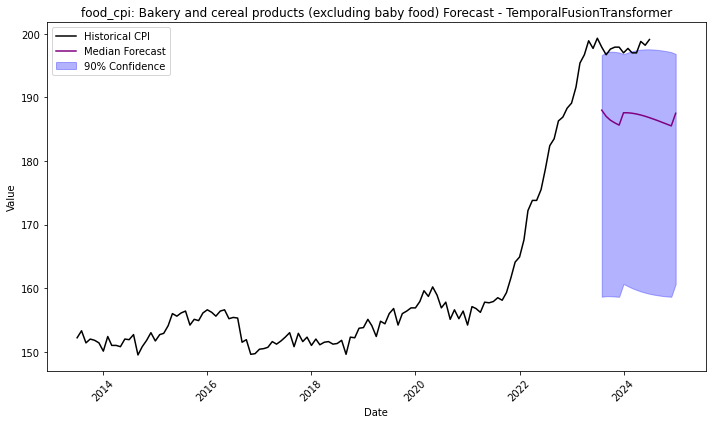

Beginning AutoGluon training... Time limit = 2s
AutoGluon will save models to './output/TEST/ag_global_all_TemporalFusionTransformerModel_exp2_R4_/random_seed_42/2023-07-01/model_files/'
=================== System Info ===================
AutoGluon Version:  1.1.1
Python Version:     3.8.20
Operating System:   Linux
Platform Machine:   x86_64
Platform Version:   #147~18.04.1-Ubuntu SMP Sat Oct 15 13:10:18 UTC 2022
CPU Count:          32
GPU Count:          1
Memory Avail:       166.21 GB / 188.57 GB (88.1%)
Disk Space Avail:   18214.36 GB / 249006.62 GB (7.3%)

Fitting with arguments:
{'enable_ensemble': True,
 'eval_metric': MAPE,
 'excluded_model_types': ['DirectTabular', 'RecursiveTabular'],
 'hyperparameters': {'TemporalFusionTransformerModel': {}},
 'known_covariates_names': [],
 'num_val_windows': 1,
 'prediction_length': 18,
 'quantile_levels': [0.01, 0.05, 0.1, 0.25, 0.75, 0.9, 0.95, 0.99],
 'random_seed': 42,
 'refit_every_n_windows': 1,
 'refit_full': False,
 'skip_model_sele

TemporalFusionTransformerModel


	-0.8076       = Validation score (-MAPE)
	2.13    s     = Training runtime
	0.04    s     = Validation (prediction) runtime
Not fitting ensemble due to lack of time remaining. Time left: -0.3 seconds
Training complete. Models trained: ['TemporalFusionTransformer']
Total runtime: 2.21 s
Best model: TemporalFusionTransformer
Best model score: -0.8076
Model not specified in predict, will default to the model with the best validation score: TemporalFusionTransformer
Model not specified in predict, will default to the model with the best validation score: TemporalFusionTransformer


****************** Summary of fit() ******************
Estimated performance of each model:
                       model  score_val  pred_time_val  fit_time_marginal  \
0  TemporalFusionTransformer  -0.807553       0.044301           2.130153   

   fit_order  
0          1  
Number of models trained: 1
Types of models trained:
{'MultiWindowBacktestingModel'}
****************** End of fit() summary ******************


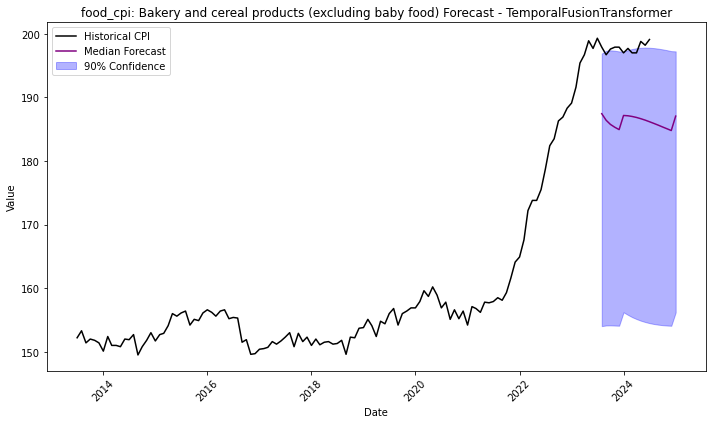

Beginning AutoGluon training... Time limit = 2s
AutoGluon will save models to './output/TEST/ag_global_all_TemporalFusionTransformerModel_exp2_GPT_P1_/random_seed_42/2023-07-01/model_files/'
=================== System Info ===================
AutoGluon Version:  1.1.1
Python Version:     3.8.20
Operating System:   Linux
Platform Machine:   x86_64
Platform Version:   #147~18.04.1-Ubuntu SMP Sat Oct 15 13:10:18 UTC 2022
CPU Count:          32
GPU Count:          1
Memory Avail:       166.09 GB / 188.57 GB (88.1%)
Disk Space Avail:   18214.35 GB / 249006.62 GB (7.3%)

Fitting with arguments:
{'enable_ensemble': True,
 'eval_metric': MAPE,
 'excluded_model_types': ['DirectTabular', 'RecursiveTabular'],
 'hyperparameters': {'TemporalFusionTransformerModel': {}},
 'known_covariates_names': [],
 'num_val_windows': 1,
 'prediction_length': 18,
 'quantile_levels': [0.01, 0.05, 0.1, 0.25, 0.75, 0.9, 0.95, 0.99],
 'random_seed': 42,
 'refit_every_n_windows': 1,
 'refit_full': False,
 'skip_model_

TemporalFusionTransformerModel


	-0.7108       = Validation score (-MAPE)
	2.15    s     = Training runtime
	0.04    s     = Validation (prediction) runtime
Not fitting ensemble due to lack of time remaining. Time left: -0.3 seconds
Training complete. Models trained: ['TemporalFusionTransformer']
Total runtime: 2.23 s
Best model: TemporalFusionTransformer
Best model score: -0.7108
Model not specified in predict, will default to the model with the best validation score: TemporalFusionTransformer
Model not specified in predict, will default to the model with the best validation score: TemporalFusionTransformer


****************** Summary of fit() ******************
Estimated performance of each model:
                       model  score_val  pred_time_val  fit_time_marginal  \
0  TemporalFusionTransformer  -0.710814       0.044247           2.150563   

   fit_order  
0          1  
Number of models trained: 1
Types of models trained:
{'MultiWindowBacktestingModel'}
****************** End of fit() summary ******************


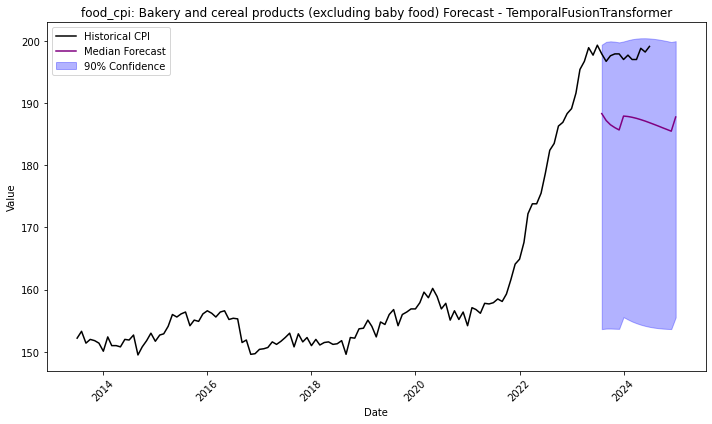

Beginning AutoGluon training... Time limit = 2s
AutoGluon will save models to './output/TEST/ag_global_all_TemporalFusionTransformerModel_exp2_GPT_P4_/random_seed_42/2023-07-01/model_files/'
=================== System Info ===================
AutoGluon Version:  1.1.1
Python Version:     3.8.20
Operating System:   Linux
Platform Machine:   x86_64
Platform Version:   #147~18.04.1-Ubuntu SMP Sat Oct 15 13:10:18 UTC 2022
CPU Count:          32
GPU Count:          1
Memory Avail:       166.09 GB / 188.57 GB (88.1%)
Disk Space Avail:   18214.34 GB / 249006.62 GB (7.3%)

Fitting with arguments:
{'enable_ensemble': True,
 'eval_metric': MAPE,
 'excluded_model_types': ['DirectTabular', 'RecursiveTabular'],
 'hyperparameters': {'TemporalFusionTransformerModel': {}},
 'known_covariates_names': [],
 'num_val_windows': 1,
 'prediction_length': 18,
 'quantile_levels': [0.01, 0.05, 0.1, 0.25, 0.75, 0.9, 0.95, 0.99],
 'random_seed': 42,
 'refit_every_n_windows': 1,
 'refit_full': False,
 'skip_model_

TemporalFusionTransformerModel


	-1.0325       = Validation score (-MAPE)
	2.21    s     = Training runtime
	0.04    s     = Validation (prediction) runtime
Not fitting ensemble due to lack of time remaining. Time left: -0.3 seconds
Training complete. Models trained: ['TemporalFusionTransformer']
Total runtime: 2.28 s
Best model: TemporalFusionTransformer
Best model score: -1.0325
Model not specified in predict, will default to the model with the best validation score: TemporalFusionTransformer
Model not specified in predict, will default to the model with the best validation score: TemporalFusionTransformer


****************** Summary of fit() ******************
Estimated performance of each model:
                       model  score_val  pred_time_val  fit_time_marginal  \
0  TemporalFusionTransformer  -1.032505       0.039383           2.205446   

   fit_order  
0          1  
Number of models trained: 1
Types of models trained:
{'MultiWindowBacktestingModel'}
****************** End of fit() summary ******************


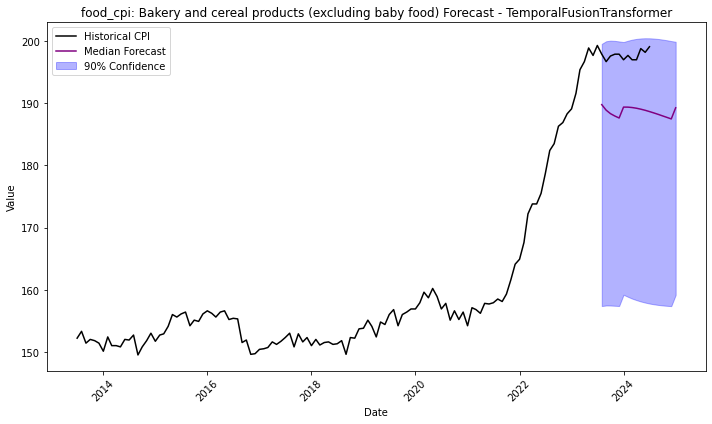

Beginning AutoGluon training... Time limit = 2s
AutoGluon will save models to './output/TEST/ag_global_all_TemporalFusionTransformerModel_exp2_R3_/random_seed_42/2018-07-01/model_files/'
=================== System Info ===================
AutoGluon Version:  1.1.1
Python Version:     3.8.20
Operating System:   Linux
Platform Machine:   x86_64
Platform Version:   #147~18.04.1-Ubuntu SMP Sat Oct 15 13:10:18 UTC 2022
CPU Count:          32
GPU Count:          1
Memory Avail:       166.17 GB / 188.57 GB (88.1%)
Disk Space Avail:   18214.32 GB / 249006.62 GB (7.3%)

Fitting with arguments:
{'enable_ensemble': True,
 'eval_metric': MAPE,
 'excluded_model_types': ['DirectTabular', 'RecursiveTabular'],
 'hyperparameters': {'TemporalFusionTransformerModel': {}},
 'known_covariates_names': [],
 'num_val_windows': 1,
 'prediction_length': 18,
 'quantile_levels': [0.01, 0.05, 0.1, 0.25, 0.75, 0.9, 0.95, 0.99],
 'random_seed': 42,
 'refit_every_n_windows': 1,
 'refit_full': False,
 'skip_model_sele

TemporalFusionTransformerModel


	-1.8059       = Validation score (-MAPE)
	2.15    s     = Training runtime
	0.04    s     = Validation (prediction) runtime
Not fitting ensemble due to lack of time remaining. Time left: -0.3 seconds
Training complete. Models trained: ['TemporalFusionTransformer']
Total runtime: 2.24 s
Best model: TemporalFusionTransformer
Best model score: -1.8059
Model not specified in predict, will default to the model with the best validation score: TemporalFusionTransformer
Model not specified in predict, will default to the model with the best validation score: TemporalFusionTransformer


****************** Summary of fit() ******************
Estimated performance of each model:
                       model  score_val  pred_time_val  fit_time_marginal  \
0  TemporalFusionTransformer  -1.805879       0.043296           2.152305   

   fit_order  
0          1  
Number of models trained: 1
Types of models trained:
{'MultiWindowBacktestingModel'}
****************** End of fit() summary ******************


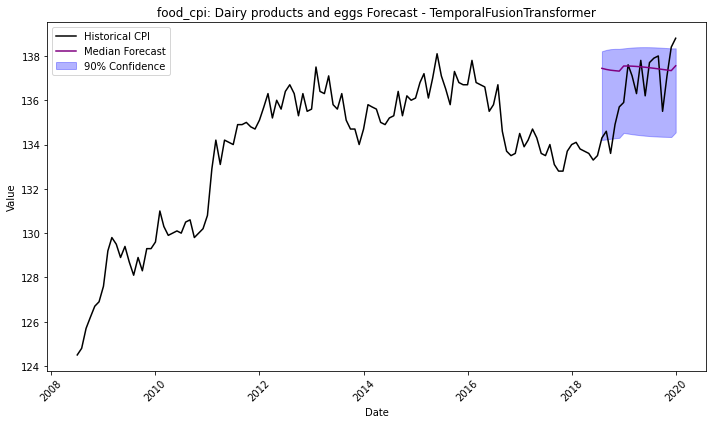

Beginning AutoGluon training... Time limit = 2s
AutoGluon will save models to './output/TEST/ag_global_all_TemporalFusionTransformerModel_exp2_GPT_P1_/random_seed_42/2018-07-01/model_files/'
=================== System Info ===================
AutoGluon Version:  1.1.1
Python Version:     3.8.20
Operating System:   Linux
Platform Machine:   x86_64
Platform Version:   #147~18.04.1-Ubuntu SMP Sat Oct 15 13:10:18 UTC 2022
CPU Count:          32
GPU Count:          1
Memory Avail:       166.09 GB / 188.57 GB (88.1%)
Disk Space Avail:   18214.32 GB / 249006.62 GB (7.3%)

Fitting with arguments:
{'enable_ensemble': True,
 'eval_metric': MAPE,
 'excluded_model_types': ['DirectTabular', 'RecursiveTabular'],
 'hyperparameters': {'TemporalFusionTransformerModel': {}},
 'known_covariates_names': [],
 'num_val_windows': 1,
 'prediction_length': 18,
 'quantile_levels': [0.01, 0.05, 0.1, 0.25, 0.75, 0.9, 0.95, 0.99],
 'random_seed': 42,
 'refit_every_n_windows': 1,
 'refit_full': False,
 'skip_model_

TemporalFusionTransformerModel


Inferred time series frequency: 'MS'
Provided train_data has 8602 rows, 22 time series. Median time series length is 391 (min=391, max=391). 

Provided data contains following columns:
	target: 'target'

AutoGluon will gauge predictive performance using evaluation metric: 'MAPE'
	This metric's sign has been flipped to adhere to being higher_is_better. The metric score can be multiplied by -1 to get the metric value.

Starting training. Start time is 2024-10-27 07:31:00
Excluded model types: ['DirectTabular', 'RecursiveTabular']
Models that will be trained: ['TemporalFusionTransformer']
Training timeseries model TemporalFusionTransformer. Training for up to 1.6s of the 1.6s of remaining time.
	-2.7327       = Validation score (-MAPE)
	1.83    s     = Training runtime
	0.04    s     = Validation (prediction) runtime
Not fitting ensemble due to lack of time remaining. Time left: -0.3 seconds
Training complete. Models trained: ['TemporalFusionTransformer']
Total runtime: 1.92 s
Best model:

****************** Summary of fit() ******************
Estimated performance of each model:
                       model  score_val  pred_time_val  fit_time_marginal  \
0  TemporalFusionTransformer  -2.732653       0.042542           1.829918   

   fit_order  
0          1  
Number of models trained: 1
Types of models trained:
{'MultiWindowBacktestingModel'}
****************** End of fit() summary ******************


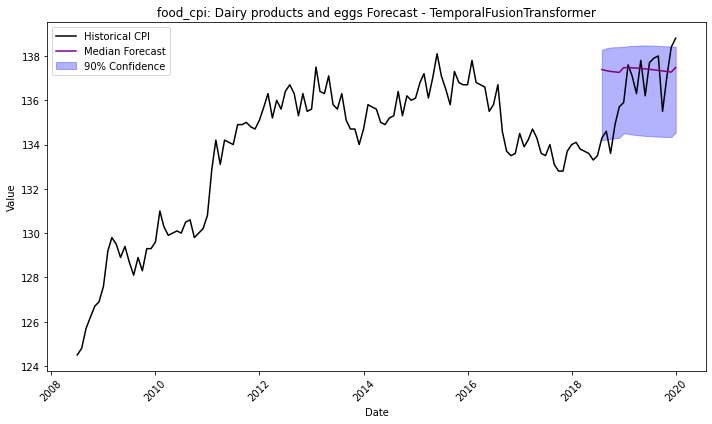

Beginning AutoGluon training... Time limit = 2s
AutoGluon will save models to './output/TEST/ag_global_all_TemporalFusionTransformerModel_exp2_GPT_P3_/random_seed_42/2018-07-01/model_files/'
=================== System Info ===================
AutoGluon Version:  1.1.1
Python Version:     3.8.20
Operating System:   Linux
Platform Machine:   x86_64
Platform Version:   #147~18.04.1-Ubuntu SMP Sat Oct 15 13:10:18 UTC 2022
CPU Count:          32
GPU Count:          1
Memory Avail:       166.09 GB / 188.57 GB (88.1%)
Disk Space Avail:   18214.37 GB / 249006.62 GB (7.3%)

Fitting with arguments:
{'enable_ensemble': True,
 'eval_metric': MAPE,
 'excluded_model_types': ['DirectTabular', 'RecursiveTabular'],
 'hyperparameters': {'TemporalFusionTransformerModel': {}},
 'known_covariates_names': [],
 'num_val_windows': 1,
 'prediction_length': 18,
 'quantile_levels': [0.01, 0.05, 0.1, 0.25, 0.75, 0.9, 0.95, 0.99],
 'random_seed': 42,
 'refit_every_n_windows': 1,
 'refit_full': False,
 'skip_model_

TemporalFusionTransformerModel


	-2.6954       = Validation score (-MAPE)
	2.13    s     = Training runtime
	0.04    s     = Validation (prediction) runtime
Not fitting ensemble due to lack of time remaining. Time left: -0.3 seconds
Training complete. Models trained: ['TemporalFusionTransformer']
Total runtime: 2.22 s
Best model: TemporalFusionTransformer
Best model score: -2.6954
Model not specified in predict, will default to the model with the best validation score: TemporalFusionTransformer
Model not specified in predict, will default to the model with the best validation score: TemporalFusionTransformer


****************** Summary of fit() ******************
Estimated performance of each model:
                       model  score_val  pred_time_val  fit_time_marginal  \
0  TemporalFusionTransformer  -2.695443       0.042146           2.133447   

   fit_order  
0          1  
Number of models trained: 1
Types of models trained:
{'MultiWindowBacktestingModel'}
****************** End of fit() summary ******************


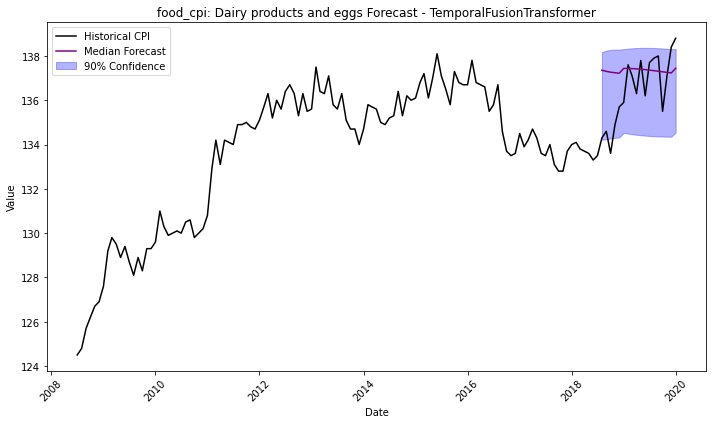

Beginning AutoGluon training... Time limit = 2s
AutoGluon will save models to './output/TEST/ag_global_all_TemporalFusionTransformerModel_exp2_GPT_P2_/random_seed_42/2018-07-01/model_files/'
=================== System Info ===================
AutoGluon Version:  1.1.1
Python Version:     3.8.20
Operating System:   Linux
Platform Machine:   x86_64
Platform Version:   #147~18.04.1-Ubuntu SMP Sat Oct 15 13:10:18 UTC 2022
CPU Count:          32
GPU Count:          1
Memory Avail:       166.08 GB / 188.57 GB (88.1%)
Disk Space Avail:   18214.36 GB / 249006.62 GB (7.3%)

Fitting with arguments:
{'enable_ensemble': True,
 'eval_metric': MAPE,
 'excluded_model_types': ['DirectTabular', 'RecursiveTabular'],
 'hyperparameters': {'TemporalFusionTransformerModel': {}},
 'known_covariates_names': [],
 'num_val_windows': 1,
 'prediction_length': 18,
 'quantile_levels': [0.01, 0.05, 0.1, 0.25, 0.75, 0.9, 0.95, 0.99],
 'random_seed': 42,
 'refit_every_n_windows': 1,
 'refit_full': False,
 'skip_model_

TemporalFusionTransformerModel


	-2.5742       = Validation score (-MAPE)
	2.13    s     = Training runtime
	0.04    s     = Validation (prediction) runtime
Not fitting ensemble due to lack of time remaining. Time left: -0.3 seconds
Training complete. Models trained: ['TemporalFusionTransformer']
Total runtime: 2.21 s
Best model: TemporalFusionTransformer
Best model score: -2.5742
Model not specified in predict, will default to the model with the best validation score: TemporalFusionTransformer
Model not specified in predict, will default to the model with the best validation score: TemporalFusionTransformer


****************** Summary of fit() ******************
Estimated performance of each model:
                       model  score_val  pred_time_val  fit_time_marginal  \
0  TemporalFusionTransformer  -2.574193        0.04056           2.129245   

   fit_order  
0          1  
Number of models trained: 1
Types of models trained:
{'MultiWindowBacktestingModel'}
****************** End of fit() summary ******************


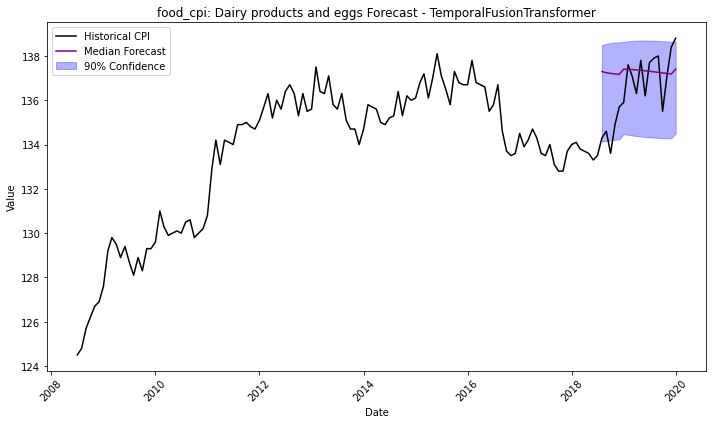

Beginning AutoGluon training... Time limit = 2s
AutoGluon will save models to './output/TEST/ag_global_all_TemporalFusionTransformerModel_exp2_R4_/random_seed_42/2018-07-01/model_files/'
=================== System Info ===================
AutoGluon Version:  1.1.1
Python Version:     3.8.20
Operating System:   Linux
Platform Machine:   x86_64
Platform Version:   #147~18.04.1-Ubuntu SMP Sat Oct 15 13:10:18 UTC 2022
CPU Count:          32
GPU Count:          1
Memory Avail:       166.13 GB / 188.57 GB (88.1%)
Disk Space Avail:   18214.35 GB / 249006.62 GB (7.3%)

Fitting with arguments:
{'enable_ensemble': True,
 'eval_metric': MAPE,
 'excluded_model_types': ['DirectTabular', 'RecursiveTabular'],
 'hyperparameters': {'TemporalFusionTransformerModel': {}},
 'known_covariates_names': [],
 'num_val_windows': 1,
 'prediction_length': 18,
 'quantile_levels': [0.01, 0.05, 0.1, 0.25, 0.75, 0.9, 0.95, 0.99],
 'random_seed': 42,
 'refit_every_n_windows': 1,
 'refit_full': False,
 'skip_model_sele

TemporalFusionTransformerModel


	-1.2677       = Validation score (-MAPE)
	2.15    s     = Training runtime
	0.04    s     = Validation (prediction) runtime
Not fitting ensemble due to lack of time remaining. Time left: -0.3 seconds
Training complete. Models trained: ['TemporalFusionTransformer']
Total runtime: 2.24 s
Best model: TemporalFusionTransformer
Best model score: -1.2677
Model not specified in predict, will default to the model with the best validation score: TemporalFusionTransformer
Model not specified in predict, will default to the model with the best validation score: TemporalFusionTransformer


****************** Summary of fit() ******************
Estimated performance of each model:
                       model  score_val  pred_time_val  fit_time_marginal  \
0  TemporalFusionTransformer  -1.267694       0.042591           2.153492   

   fit_order  
0          1  
Number of models trained: 1
Types of models trained:
{'MultiWindowBacktestingModel'}
****************** End of fit() summary ******************


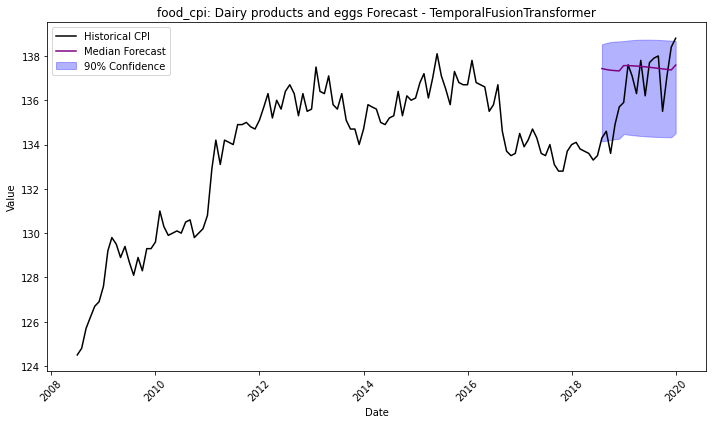

Beginning AutoGluon training... Time limit = 2s
AutoGluon will save models to './output/TEST/ag_global_all_TemporalFusionTransformerModel_exp2_R1_/random_seed_42/2018-07-01/model_files/'
=================== System Info ===================
AutoGluon Version:  1.1.1
Python Version:     3.8.20
Operating System:   Linux
Platform Machine:   x86_64
Platform Version:   #147~18.04.1-Ubuntu SMP Sat Oct 15 13:10:18 UTC 2022
CPU Count:          32
GPU Count:          1
Memory Avail:       166.09 GB / 188.57 GB (88.1%)
Disk Space Avail:   18214.34 GB / 249006.62 GB (7.3%)

Fitting with arguments:
{'enable_ensemble': True,
 'eval_metric': MAPE,
 'excluded_model_types': ['DirectTabular', 'RecursiveTabular'],
 'hyperparameters': {'TemporalFusionTransformerModel': {}},
 'known_covariates_names': [],
 'num_val_windows': 1,
 'prediction_length': 18,
 'quantile_levels': [0.01, 0.05, 0.1, 0.25, 0.75, 0.9, 0.95, 0.99],
 'random_seed': 42,
 'refit_every_n_windows': 1,
 'refit_full': False,
 'skip_model_sele

TemporalFusionTransformerModel


	-1.0906       = Validation score (-MAPE)
	2.14    s     = Training runtime
	0.04    s     = Validation (prediction) runtime
Not fitting ensemble due to lack of time remaining. Time left: -0.3 seconds
Training complete. Models trained: ['TemporalFusionTransformer']
Total runtime: 2.22 s
Best model: TemporalFusionTransformer
Best model score: -1.0906
Model not specified in predict, will default to the model with the best validation score: TemporalFusionTransformer
Model not specified in predict, will default to the model with the best validation score: TemporalFusionTransformer


****************** Summary of fit() ******************
Estimated performance of each model:
                       model  score_val  pred_time_val  fit_time_marginal  \
0  TemporalFusionTransformer  -1.090572       0.042448           2.143985   

   fit_order  
0          1  
Number of models trained: 1
Types of models trained:
{'MultiWindowBacktestingModel'}
****************** End of fit() summary ******************


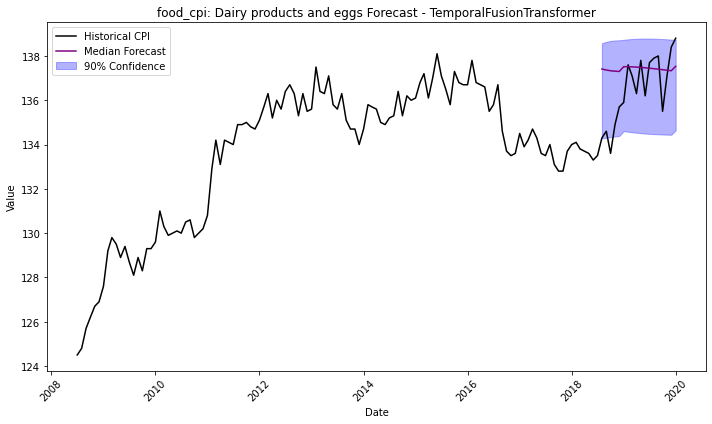

Beginning AutoGluon training... Time limit = 2s
AutoGluon will save models to './output/TEST/ag_global_all_TemporalFusionTransformerModel_exp2_R2_/random_seed_42/2018-07-01/model_files/'
=================== System Info ===================
AutoGluon Version:  1.1.1
Python Version:     3.8.20
Operating System:   Linux
Platform Machine:   x86_64
Platform Version:   #147~18.04.1-Ubuntu SMP Sat Oct 15 13:10:18 UTC 2022
CPU Count:          32
GPU Count:          1
Memory Avail:       166.09 GB / 188.57 GB (88.1%)
Disk Space Avail:   18214.32 GB / 249006.62 GB (7.3%)

Fitting with arguments:
{'enable_ensemble': True,
 'eval_metric': MAPE,
 'excluded_model_types': ['DirectTabular', 'RecursiveTabular'],
 'hyperparameters': {'TemporalFusionTransformerModel': {}},
 'known_covariates_names': [],
 'num_val_windows': 1,
 'prediction_length': 18,
 'quantile_levels': [0.01, 0.05, 0.1, 0.25, 0.75, 0.9, 0.95, 0.99],
 'random_seed': 42,
 'refit_every_n_windows': 1,
 'refit_full': False,
 'skip_model_sele

TemporalFusionTransformerModel


	-0.7197       = Validation score (-MAPE)
	2.12    s     = Training runtime
	0.04    s     = Validation (prediction) runtime
Not fitting ensemble due to lack of time remaining. Time left: -0.3 seconds
Training complete. Models trained: ['TemporalFusionTransformer']
Total runtime: 2.20 s
Best model: TemporalFusionTransformer
Best model score: -0.7197


****************** Summary of fit() ******************
Estimated performance of each model:
                       model  score_val  pred_time_val  fit_time_marginal  \
0  TemporalFusionTransformer  -0.719661       0.043928            2.12248   

   fit_order  
0          1  
Number of models trained: 1
Types of models trained:
{'MultiWindowBacktestingModel'}
****************** End of fit() summary ******************


Model not specified in predict, will default to the model with the best validation score: TemporalFusionTransformer
Model not specified in predict, will default to the model with the best validation score: TemporalFusionTransformer


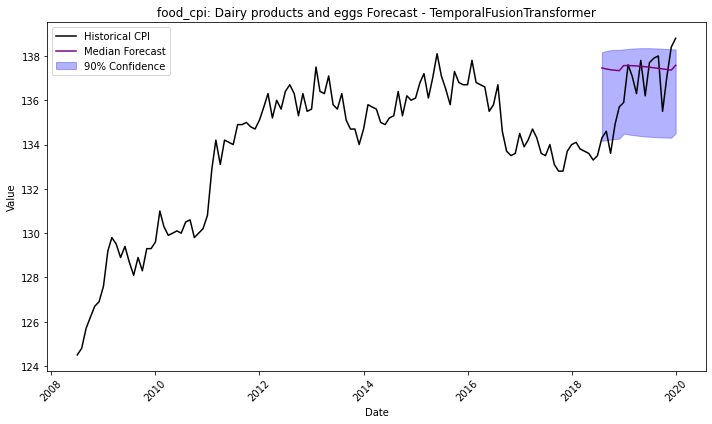

Beginning AutoGluon training... Time limit = 2s
AutoGluon will save models to './output/TEST/ag_global_all_TemporalFusionTransformerModel_exp2_GPT_P4_/random_seed_42/2018-07-01/model_files/'
=================== System Info ===================
AutoGluon Version:  1.1.1
Python Version:     3.8.20
Operating System:   Linux
Platform Machine:   x86_64
Platform Version:   #147~18.04.1-Ubuntu SMP Sat Oct 15 13:10:18 UTC 2022
CPU Count:          32
GPU Count:          1
Memory Avail:       166.08 GB / 188.57 GB (88.1%)
Disk Space Avail:   18214.31 GB / 249006.62 GB (7.3%)

Fitting with arguments:
{'enable_ensemble': True,
 'eval_metric': MAPE,
 'excluded_model_types': ['DirectTabular', 'RecursiveTabular'],
 'hyperparameters': {'TemporalFusionTransformerModel': {}},
 'known_covariates_names': [],
 'num_val_windows': 1,
 'prediction_length': 18,
 'quantile_levels': [0.01, 0.05, 0.1, 0.25, 0.75, 0.9, 0.95, 0.99],
 'random_seed': 42,
 'refit_every_n_windows': 1,
 'refit_full': False,
 'skip_model_

TemporalFusionTransformerModel


	-1.6408       = Validation score (-MAPE)
	2.12    s     = Training runtime
	0.04    s     = Validation (prediction) runtime
Not fitting ensemble due to lack of time remaining. Time left: -0.2 seconds
Training complete. Models trained: ['TemporalFusionTransformer']
Total runtime: 2.20 s
Best model: TemporalFusionTransformer
Best model score: -1.6408
Model not specified in predict, will default to the model with the best validation score: TemporalFusionTransformer
Model not specified in predict, will default to the model with the best validation score: TemporalFusionTransformer


****************** Summary of fit() ******************
Estimated performance of each model:
                       model  score_val  pred_time_val  fit_time_marginal  \
0  TemporalFusionTransformer  -1.640808       0.038559           2.124506   

   fit_order  
0          1  
Number of models trained: 1
Types of models trained:
{'MultiWindowBacktestingModel'}
****************** End of fit() summary ******************


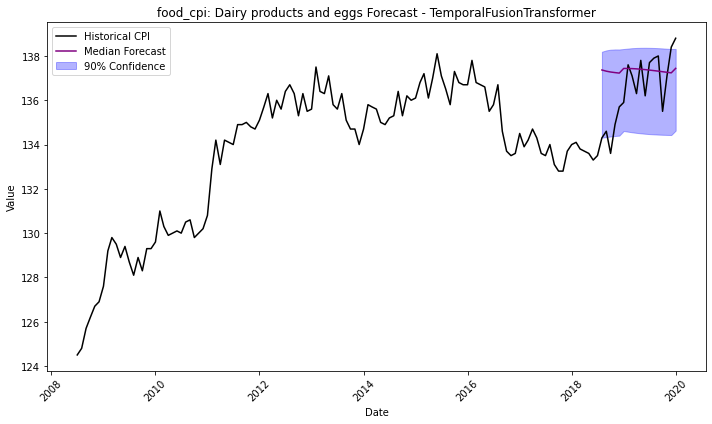

Beginning AutoGluon training... Time limit = 2s
AutoGluon will save models to './output/TEST/ag_global_all_TemporalFusionTransformerModel_exp2_R3_/random_seed_42/2019-07-01/model_files/'
=================== System Info ===================
AutoGluon Version:  1.1.1
Python Version:     3.8.20
Operating System:   Linux
Platform Machine:   x86_64
Platform Version:   #147~18.04.1-Ubuntu SMP Sat Oct 15 13:10:18 UTC 2022
CPU Count:          32
GPU Count:          1
Memory Avail:       166.16 GB / 188.57 GB (88.1%)
Disk Space Avail:   18214.36 GB / 249006.62 GB (7.3%)

Fitting with arguments:
{'enable_ensemble': True,
 'eval_metric': MAPE,
 'excluded_model_types': ['DirectTabular', 'RecursiveTabular'],
 'hyperparameters': {'TemporalFusionTransformerModel': {}},
 'known_covariates_names': [],
 'num_val_windows': 1,
 'prediction_length': 18,
 'quantile_levels': [0.01, 0.05, 0.1, 0.25, 0.75, 0.9, 0.95, 0.99],
 'random_seed': 42,
 'refit_every_n_windows': 1,
 'refit_full': False,
 'skip_model_sele

TemporalFusionTransformerModel


	-0.7047       = Validation score (-MAPE)
	2.12    s     = Training runtime
	0.04    s     = Validation (prediction) runtime
Not fitting ensemble due to lack of time remaining. Time left: -0.3 seconds
Training complete. Models trained: ['TemporalFusionTransformer']
Total runtime: 2.22 s
Best model: TemporalFusionTransformer
Best model score: -0.7047
Model not specified in predict, will default to the model with the best validation score: TemporalFusionTransformer
Model not specified in predict, will default to the model with the best validation score: TemporalFusionTransformer


****************** Summary of fit() ******************
Estimated performance of each model:
                       model  score_val  pred_time_val  fit_time_marginal  \
0  TemporalFusionTransformer  -0.704747       0.041238           2.124142   

   fit_order  
0          1  
Number of models trained: 1
Types of models trained:
{'MultiWindowBacktestingModel'}
****************** End of fit() summary ******************


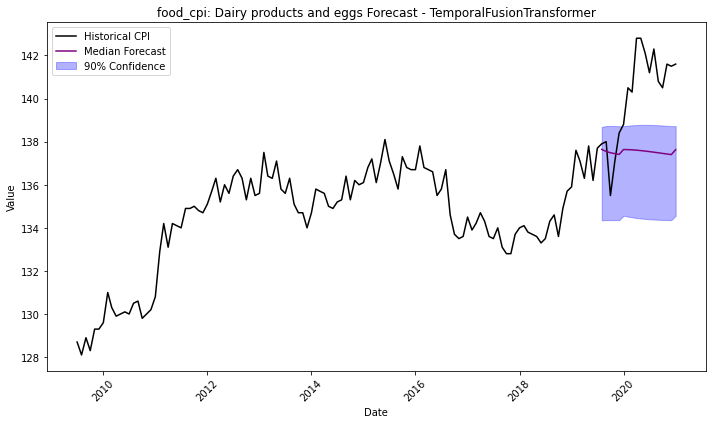

Beginning AutoGluon training... Time limit = 2s
AutoGluon will save models to './output/TEST/ag_global_all_TemporalFusionTransformerModel_exp2_GPT_P1_/random_seed_42/2019-07-01/model_files/'
=================== System Info ===================
AutoGluon Version:  1.1.1
Python Version:     3.8.20
Operating System:   Linux
Platform Machine:   x86_64
Platform Version:   #147~18.04.1-Ubuntu SMP Sat Oct 15 13:10:18 UTC 2022
CPU Count:          32
GPU Count:          1
Memory Avail:       166.08 GB / 188.57 GB (88.1%)
Disk Space Avail:   18214.36 GB / 249006.62 GB (7.3%)

Fitting with arguments:
{'enable_ensemble': True,
 'eval_metric': MAPE,
 'excluded_model_types': ['DirectTabular', 'RecursiveTabular'],
 'hyperparameters': {'TemporalFusionTransformerModel': {}},
 'known_covariates_names': [],
 'num_val_windows': 1,
 'prediction_length': 18,
 'quantile_levels': [0.01, 0.05, 0.1, 0.25, 0.75, 0.9, 0.95, 0.99],
 'random_seed': 42,
 'refit_every_n_windows': 1,
 'refit_full': False,
 'skip_model_

TemporalFusionTransformerModel


	-1.0808       = Validation score (-MAPE)
	2.12    s     = Training runtime
	0.04    s     = Validation (prediction) runtime
Not fitting ensemble due to lack of time remaining. Time left: -0.3 seconds
Training complete. Models trained: ['TemporalFusionTransformer']
Total runtime: 2.20 s
Best model: TemporalFusionTransformer
Best model score: -1.0808
Model not specified in predict, will default to the model with the best validation score: TemporalFusionTransformer
Model not specified in predict, will default to the model with the best validation score: TemporalFusionTransformer


****************** Summary of fit() ******************
Estimated performance of each model:
                       model  score_val  pred_time_val  fit_time_marginal  \
0  TemporalFusionTransformer  -1.080787       0.044174           2.115834   

   fit_order  
0          1  
Number of models trained: 1
Types of models trained:
{'MultiWindowBacktestingModel'}
****************** End of fit() summary ******************


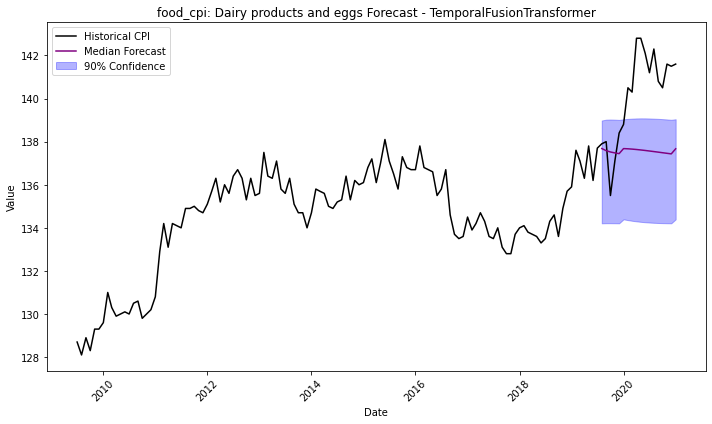

Beginning AutoGluon training... Time limit = 2s
AutoGluon will save models to './output/TEST/ag_global_all_TemporalFusionTransformerModel_exp2_GPT_P3_/random_seed_42/2019-07-01/model_files/'
=================== System Info ===================
AutoGluon Version:  1.1.1
Python Version:     3.8.20
Operating System:   Linux
Platform Machine:   x86_64
Platform Version:   #147~18.04.1-Ubuntu SMP Sat Oct 15 13:10:18 UTC 2022
CPU Count:          32
GPU Count:          1
Memory Avail:       166.08 GB / 188.57 GB (88.1%)
Disk Space Avail:   18214.02 GB / 249006.62 GB (7.3%)

Fitting with arguments:
{'enable_ensemble': True,
 'eval_metric': MAPE,
 'excluded_model_types': ['DirectTabular', 'RecursiveTabular'],
 'hyperparameters': {'TemporalFusionTransformerModel': {}},
 'known_covariates_names': [],
 'num_val_windows': 1,
 'prediction_length': 18,
 'quantile_levels': [0.01, 0.05, 0.1, 0.25, 0.75, 0.9, 0.95, 0.99],
 'random_seed': 42,
 'refit_every_n_windows': 1,
 'refit_full': False,
 'skip_model_

TemporalFusionTransformerModel


	-1.0543       = Validation score (-MAPE)
	2.11    s     = Training runtime
	0.04    s     = Validation (prediction) runtime
Not fitting ensemble due to lack of time remaining. Time left: -0.3 seconds
Training complete. Models trained: ['TemporalFusionTransformer']
Total runtime: 2.19 s
Best model: TemporalFusionTransformer
Best model score: -1.0543
Model not specified in predict, will default to the model with the best validation score: TemporalFusionTransformer
Model not specified in predict, will default to the model with the best validation score: TemporalFusionTransformer


****************** Summary of fit() ******************
Estimated performance of each model:
                       model  score_val  pred_time_val  fit_time_marginal  \
0  TemporalFusionTransformer  -1.054266       0.043644           2.109964   

   fit_order  
0          1  
Number of models trained: 1
Types of models trained:
{'MultiWindowBacktestingModel'}
****************** End of fit() summary ******************


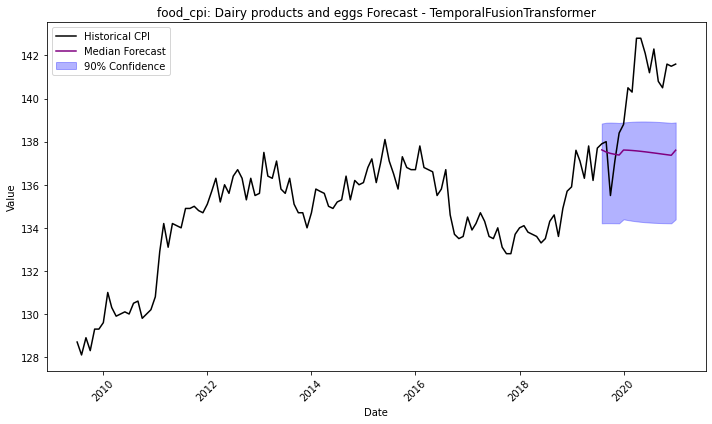

Beginning AutoGluon training... Time limit = 2s
AutoGluon will save models to './output/TEST/ag_global_all_TemporalFusionTransformerModel_exp2_GPT_P2_/random_seed_42/2019-07-01/model_files/'
=================== System Info ===================
AutoGluon Version:  1.1.1
Python Version:     3.8.20
Operating System:   Linux
Platform Machine:   x86_64
Platform Version:   #147~18.04.1-Ubuntu SMP Sat Oct 15 13:10:18 UTC 2022
CPU Count:          32
GPU Count:          1
Memory Avail:       166.08 GB / 188.57 GB (88.1%)
Disk Space Avail:   18213.16 GB / 249006.62 GB (7.3%)

Fitting with arguments:
{'enable_ensemble': True,
 'eval_metric': MAPE,
 'excluded_model_types': ['DirectTabular', 'RecursiveTabular'],
 'hyperparameters': {'TemporalFusionTransformerModel': {}},
 'known_covariates_names': [],
 'num_val_windows': 1,
 'prediction_length': 18,
 'quantile_levels': [0.01, 0.05, 0.1, 0.25, 0.75, 0.9, 0.95, 0.99],
 'random_seed': 42,
 'refit_every_n_windows': 1,
 'refit_full': False,
 'skip_model_

TemporalFusionTransformerModel


	-1.1414       = Validation score (-MAPE)
	2.12    s     = Training runtime
	0.04    s     = Validation (prediction) runtime
Not fitting ensemble due to lack of time remaining. Time left: -0.2 seconds
Training complete. Models trained: ['TemporalFusionTransformer']
Total runtime: 2.20 s
Best model: TemporalFusionTransformer
Best model score: -1.1414
Model not specified in predict, will default to the model with the best validation score: TemporalFusionTransformer
Model not specified in predict, will default to the model with the best validation score: TemporalFusionTransformer


****************** Summary of fit() ******************
Estimated performance of each model:
                       model  score_val  pred_time_val  fit_time_marginal  \
0  TemporalFusionTransformer  -1.141376        0.04031            2.12476   

   fit_order  
0          1  
Number of models trained: 1
Types of models trained:
{'MultiWindowBacktestingModel'}
****************** End of fit() summary ******************


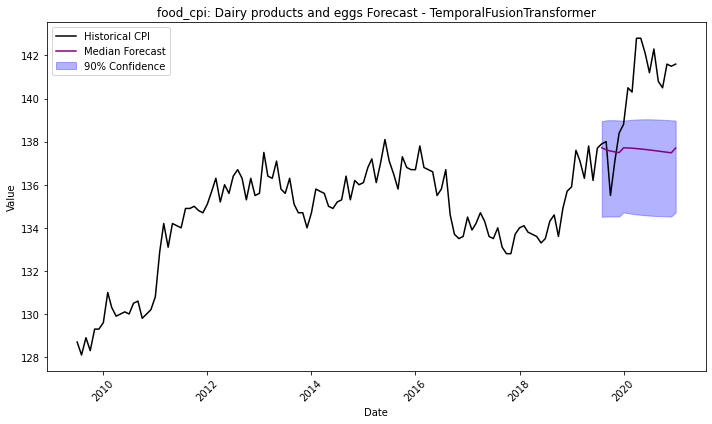

Beginning AutoGluon training... Time limit = 2s
AutoGluon will save models to './output/TEST/ag_global_all_TemporalFusionTransformerModel_exp2_R4_/random_seed_42/2019-07-01/model_files/'
=================== System Info ===================
AutoGluon Version:  1.1.1
Python Version:     3.8.20
Operating System:   Linux
Platform Machine:   x86_64
Platform Version:   #147~18.04.1-Ubuntu SMP Sat Oct 15 13:10:18 UTC 2022
CPU Count:          32
GPU Count:          1
Memory Avail:       166.08 GB / 188.57 GB (88.1%)
Disk Space Avail:   18213.19 GB / 249006.62 GB (7.3%)

Fitting with arguments:
{'enable_ensemble': True,
 'eval_metric': MAPE,
 'excluded_model_types': ['DirectTabular', 'RecursiveTabular'],
 'hyperparameters': {'TemporalFusionTransformerModel': {}},
 'known_covariates_names': [],
 'num_val_windows': 1,
 'prediction_length': 18,
 'quantile_levels': [0.01, 0.05, 0.1, 0.25, 0.75, 0.9, 0.95, 0.99],
 'random_seed': 42,
 'refit_every_n_windows': 1,
 'refit_full': False,
 'skip_model_sele

TemporalFusionTransformerModel


Inferred time series frequency: 'MS'
Provided train_data has 8866 rows, 22 time series. Median time series length is 403 (min=403, max=403). 

Provided data contains following columns:
	target: 'target'

AutoGluon will gauge predictive performance using evaluation metric: 'MAPE'
	This metric's sign has been flipped to adhere to being higher_is_better. The metric score can be multiplied by -1 to get the metric value.

Starting training. Start time is 2024-10-27 07:31:31
Excluded model types: ['DirectTabular', 'RecursiveTabular']
Models that will be trained: ['TemporalFusionTransformer']
Training timeseries model TemporalFusionTransformer. Training for up to 1.6s of the 1.6s of remaining time.
	-0.5305       = Validation score (-MAPE)
	1.83    s     = Training runtime
	0.04    s     = Validation (prediction) runtime
Not fitting ensemble due to lack of time remaining. Time left: -0.3 seconds
Training complete. Models trained: ['TemporalFusionTransformer']
Total runtime: 1.91 s
Best model:

****************** Summary of fit() ******************
Estimated performance of each model:
                       model  score_val  pred_time_val  fit_time_marginal  \
0  TemporalFusionTransformer  -0.530534       0.042409           1.828102   

   fit_order  
0          1  
Number of models trained: 1
Types of models trained:
{'MultiWindowBacktestingModel'}
****************** End of fit() summary ******************


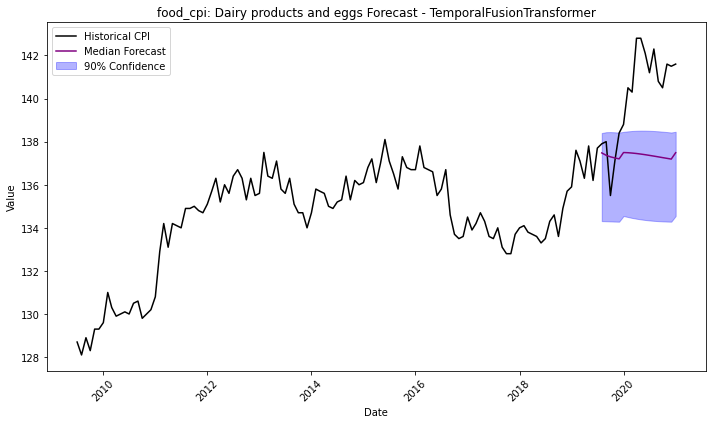

Beginning AutoGluon training... Time limit = 2s
AutoGluon will save models to './output/TEST/ag_global_all_TemporalFusionTransformerModel_exp2_R1_/random_seed_42/2019-07-01/model_files/'
=================== System Info ===================
AutoGluon Version:  1.1.1
Python Version:     3.8.20
Operating System:   Linux
Platform Machine:   x86_64
Platform Version:   #147~18.04.1-Ubuntu SMP Sat Oct 15 13:10:18 UTC 2022
CPU Count:          32
GPU Count:          1
Memory Avail:       166.08 GB / 188.57 GB (88.1%)
Disk Space Avail:   18213.19 GB / 249006.62 GB (7.3%)

Fitting with arguments:
{'enable_ensemble': True,
 'eval_metric': MAPE,
 'excluded_model_types': ['DirectTabular', 'RecursiveTabular'],
 'hyperparameters': {'TemporalFusionTransformerModel': {}},
 'known_covariates_names': [],
 'num_val_windows': 1,
 'prediction_length': 18,
 'quantile_levels': [0.01, 0.05, 0.1, 0.25, 0.75, 0.9, 0.95, 0.99],
 'random_seed': 42,
 'refit_every_n_windows': 1,
 'refit_full': False,
 'skip_model_sele

TemporalFusionTransformerModel


	-0.7702       = Validation score (-MAPE)
	2.12    s     = Training runtime
	0.04    s     = Validation (prediction) runtime
Not fitting ensemble due to lack of time remaining. Time left: -0.3 seconds
Training complete. Models trained: ['TemporalFusionTransformer']
Total runtime: 2.20 s
Best model: TemporalFusionTransformer
Best model score: -0.7702
Model not specified in predict, will default to the model with the best validation score: TemporalFusionTransformer
Model not specified in predict, will default to the model with the best validation score: TemporalFusionTransformer


****************** Summary of fit() ******************
Estimated performance of each model:
                       model  score_val  pred_time_val  fit_time_marginal  \
0  TemporalFusionTransformer  -0.770203       0.043253            2.12463   

   fit_order  
0          1  
Number of models trained: 1
Types of models trained:
{'MultiWindowBacktestingModel'}
****************** End of fit() summary ******************


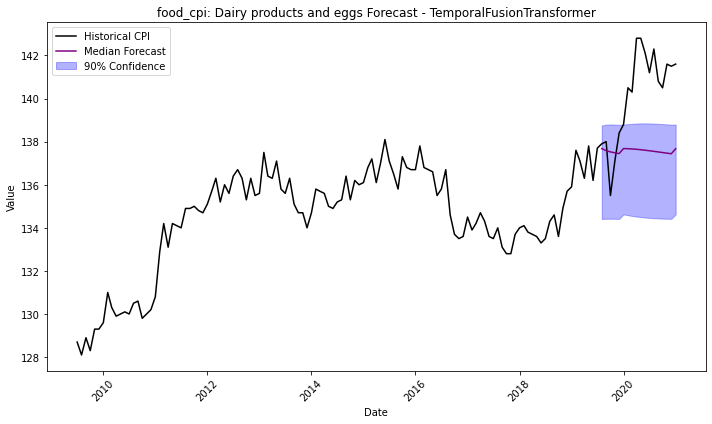

Beginning AutoGluon training... Time limit = 2s
AutoGluon will save models to './output/TEST/ag_global_all_TemporalFusionTransformerModel_exp2_R2_/random_seed_42/2019-07-01/model_files/'
=================== System Info ===================
AutoGluon Version:  1.1.1
Python Version:     3.8.20
Operating System:   Linux
Platform Machine:   x86_64
Platform Version:   #147~18.04.1-Ubuntu SMP Sat Oct 15 13:10:18 UTC 2022
CPU Count:          32
GPU Count:          1
Memory Avail:       166.08 GB / 188.57 GB (88.1%)
Disk Space Avail:   18213.18 GB / 249006.62 GB (7.3%)

Fitting with arguments:
{'enable_ensemble': True,
 'eval_metric': MAPE,
 'excluded_model_types': ['DirectTabular', 'RecursiveTabular'],
 'hyperparameters': {'TemporalFusionTransformerModel': {}},
 'known_covariates_names': [],
 'num_val_windows': 1,
 'prediction_length': 18,
 'quantile_levels': [0.01, 0.05, 0.1, 0.25, 0.75, 0.9, 0.95, 0.99],
 'random_seed': 42,
 'refit_every_n_windows': 1,
 'refit_full': False,
 'skip_model_sele

TemporalFusionTransformerModel


	-0.3824       = Validation score (-MAPE)
	2.16    s     = Training runtime
	0.04    s     = Validation (prediction) runtime
Not fitting ensemble due to lack of time remaining. Time left: -0.3 seconds
Training complete. Models trained: ['TemporalFusionTransformer']
Total runtime: 2.24 s
Best model: TemporalFusionTransformer
Best model score: -0.3824
Model not specified in predict, will default to the model with the best validation score: TemporalFusionTransformer
Model not specified in predict, will default to the model with the best validation score: TemporalFusionTransformer


****************** Summary of fit() ******************
Estimated performance of each model:
                       model  score_val  pred_time_val  fit_time_marginal  \
0  TemporalFusionTransformer  -0.382419       0.043552             2.1608   

   fit_order  
0          1  
Number of models trained: 1
Types of models trained:
{'MultiWindowBacktestingModel'}
****************** End of fit() summary ******************


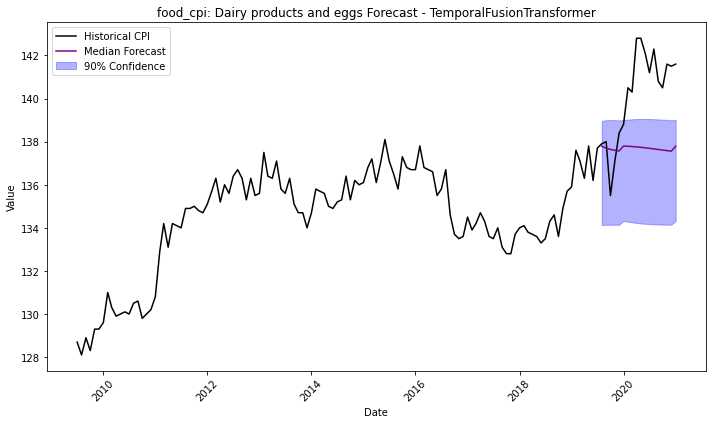

Beginning AutoGluon training... Time limit = 2s
AutoGluon will save models to './output/TEST/ag_global_all_TemporalFusionTransformerModel_exp2_GPT_P4_/random_seed_42/2019-07-01/model_files/'
=================== System Info ===================
AutoGluon Version:  1.1.1
Python Version:     3.8.20
Operating System:   Linux
Platform Machine:   x86_64
Platform Version:   #147~18.04.1-Ubuntu SMP Sat Oct 15 13:10:18 UTC 2022
CPU Count:          32
GPU Count:          1
Memory Avail:       166.19 GB / 188.57 GB (88.1%)
Disk Space Avail:   18213.17 GB / 249006.62 GB (7.3%)

Fitting with arguments:
{'enable_ensemble': True,
 'eval_metric': MAPE,
 'excluded_model_types': ['DirectTabular', 'RecursiveTabular'],
 'hyperparameters': {'TemporalFusionTransformerModel': {}},
 'known_covariates_names': [],
 'num_val_windows': 1,
 'prediction_length': 18,
 'quantile_levels': [0.01, 0.05, 0.1, 0.25, 0.75, 0.9, 0.95, 0.99],
 'random_seed': 42,
 'refit_every_n_windows': 1,
 'refit_full': False,
 'skip_model_

TemporalFusionTransformerModel


	-0.7107       = Validation score (-MAPE)
	2.14    s     = Training runtime
	0.05    s     = Validation (prediction) runtime
Not fitting ensemble due to lack of time remaining. Time left: -0.3 seconds
Training complete. Models trained: ['TemporalFusionTransformer']
Total runtime: 2.23 s
Best model: TemporalFusionTransformer
Best model score: -0.7107
Model not specified in predict, will default to the model with the best validation score: TemporalFusionTransformer
Model not specified in predict, will default to the model with the best validation score: TemporalFusionTransformer


****************** Summary of fit() ******************
Estimated performance of each model:
                       model  score_val  pred_time_val  fit_time_marginal  \
0  TemporalFusionTransformer  -0.710654       0.047483           2.141963   

   fit_order  
0          1  
Number of models trained: 1
Types of models trained:
{'MultiWindowBacktestingModel'}
****************** End of fit() summary ******************


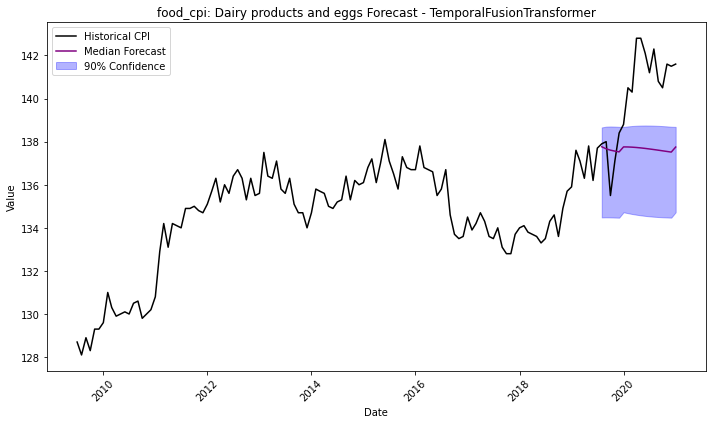

Beginning AutoGluon training... Time limit = 2s
AutoGluon will save models to './output/TEST/ag_global_all_TemporalFusionTransformerModel_exp2_R3_/random_seed_42/2020-07-01/model_files/'
=================== System Info ===================
AutoGluon Version:  1.1.1
Python Version:     3.8.20
Operating System:   Linux
Platform Machine:   x86_64
Platform Version:   #147~18.04.1-Ubuntu SMP Sat Oct 15 13:10:18 UTC 2022
CPU Count:          32
GPU Count:          1
Memory Avail:       166.08 GB / 188.57 GB (88.1%)
Disk Space Avail:   18213.22 GB / 249006.62 GB (7.3%)

Fitting with arguments:
{'enable_ensemble': True,
 'eval_metric': MAPE,
 'excluded_model_types': ['DirectTabular', 'RecursiveTabular'],
 'hyperparameters': {'TemporalFusionTransformerModel': {}},
 'known_covariates_names': [],
 'num_val_windows': 1,
 'prediction_length': 18,
 'quantile_levels': [0.01, 0.05, 0.1, 0.25, 0.75, 0.9, 0.95, 0.99],
 'random_seed': 42,
 'refit_every_n_windows': 1,
 'refit_full': False,
 'skip_model_sele

TemporalFusionTransformerModel


	-0.5865       = Validation score (-MAPE)
	2.16    s     = Training runtime
	0.04    s     = Validation (prediction) runtime
Not fitting ensemble due to lack of time remaining. Time left: -0.3 seconds
Training complete. Models trained: ['TemporalFusionTransformer']
Total runtime: 2.24 s
Best model: TemporalFusionTransformer
Best model score: -0.5865
Model not specified in predict, will default to the model with the best validation score: TemporalFusionTransformer
Model not specified in predict, will default to the model with the best validation score: TemporalFusionTransformer


****************** Summary of fit() ******************
Estimated performance of each model:
                       model  score_val  pred_time_val  fit_time_marginal  \
0  TemporalFusionTransformer   -0.58652        0.04106           2.162085   

   fit_order  
0          1  
Number of models trained: 1
Types of models trained:
{'MultiWindowBacktestingModel'}
****************** End of fit() summary ******************


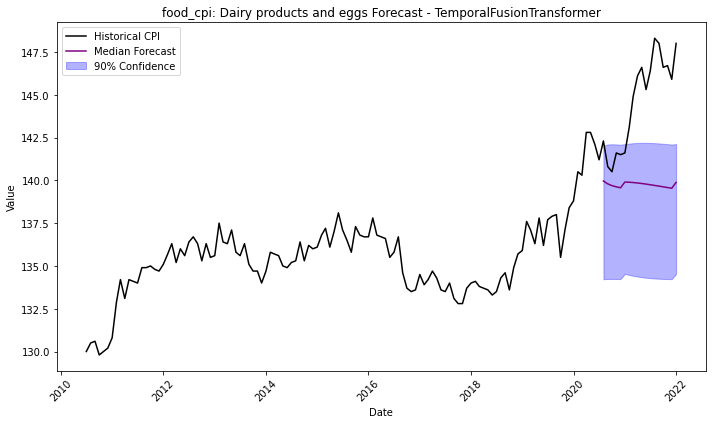

Beginning AutoGluon training... Time limit = 2s
AutoGluon will save models to './output/TEST/ag_global_all_TemporalFusionTransformerModel_exp2_GPT_P1_/random_seed_42/2020-07-01/model_files/'
=================== System Info ===================
AutoGluon Version:  1.1.1
Python Version:     3.8.20
Operating System:   Linux
Platform Machine:   x86_64
Platform Version:   #147~18.04.1-Ubuntu SMP Sat Oct 15 13:10:18 UTC 2022
CPU Count:          32
GPU Count:          1
Memory Avail:       166.08 GB / 188.57 GB (88.1%)
Disk Space Avail:   18213.21 GB / 249006.62 GB (7.3%)

Fitting with arguments:
{'enable_ensemble': True,
 'eval_metric': MAPE,
 'excluded_model_types': ['DirectTabular', 'RecursiveTabular'],
 'hyperparameters': {'TemporalFusionTransformerModel': {}},
 'known_covariates_names': [],
 'num_val_windows': 1,
 'prediction_length': 18,
 'quantile_levels': [0.01, 0.05, 0.1, 0.25, 0.75, 0.9, 0.95, 0.99],
 'random_seed': 42,
 'refit_every_n_windows': 1,
 'refit_full': False,
 'skip_model_

TemporalFusionTransformerModel


	-0.8319       = Validation score (-MAPE)
	2.11    s     = Training runtime
	0.04    s     = Validation (prediction) runtime
Not fitting ensemble due to lack of time remaining. Time left: -0.6 seconds
Training complete. Models trained: ['TemporalFusionTransformer']
Total runtime: 2.54 s
Best model: TemporalFusionTransformer
Best model score: -0.8319
Model not specified in predict, will default to the model with the best validation score: TemporalFusionTransformer
Model not specified in predict, will default to the model with the best validation score: TemporalFusionTransformer


****************** Summary of fit() ******************
Estimated performance of each model:
                       model  score_val  pred_time_val  fit_time_marginal  \
0  TemporalFusionTransformer  -0.831916        0.04441           2.111047   

   fit_order  
0          1  
Number of models trained: 1
Types of models trained:
{'MultiWindowBacktestingModel'}
****************** End of fit() summary ******************


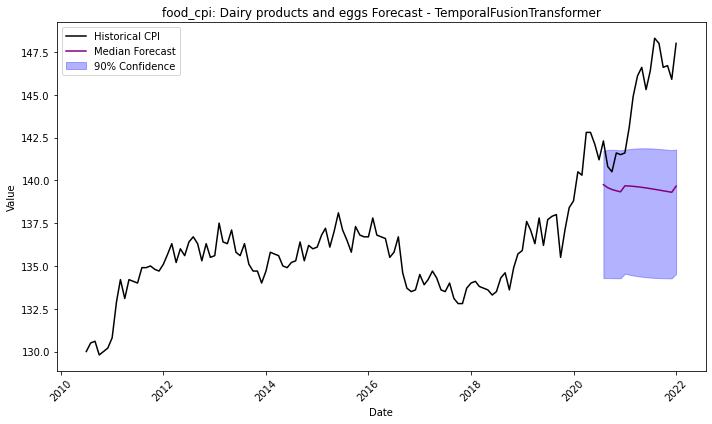

Beginning AutoGluon training... Time limit = 2s
AutoGluon will save models to './output/TEST/ag_global_all_TemporalFusionTransformerModel_exp2_GPT_P3_/random_seed_42/2020-07-01/model_files/'
=================== System Info ===================
AutoGluon Version:  1.1.1
Python Version:     3.8.20
Operating System:   Linux
Platform Machine:   x86_64
Platform Version:   #147~18.04.1-Ubuntu SMP Sat Oct 15 13:10:18 UTC 2022
CPU Count:          32
GPU Count:          1
Memory Avail:       166.11 GB / 188.57 GB (88.1%)
Disk Space Avail:   18213.20 GB / 249006.62 GB (7.3%)

Fitting with arguments:
{'enable_ensemble': True,
 'eval_metric': MAPE,
 'excluded_model_types': ['DirectTabular', 'RecursiveTabular'],
 'hyperparameters': {'TemporalFusionTransformerModel': {}},
 'known_covariates_names': [],
 'num_val_windows': 1,
 'prediction_length': 18,
 'quantile_levels': [0.01, 0.05, 0.1, 0.25, 0.75, 0.9, 0.95, 0.99],
 'random_seed': 42,
 'refit_every_n_windows': 1,
 'refit_full': False,
 'skip_model_

TemporalFusionTransformerModel


	-0.8465       = Validation score (-MAPE)
	2.15    s     = Training runtime
	0.04    s     = Validation (prediction) runtime
Not fitting ensemble due to lack of time remaining. Time left: -0.3 seconds
Training complete. Models trained: ['TemporalFusionTransformer']
Total runtime: 2.23 s
Best model: TemporalFusionTransformer
Best model score: -0.8465
Model not specified in predict, will default to the model with the best validation score: TemporalFusionTransformer
Model not specified in predict, will default to the model with the best validation score: TemporalFusionTransformer


****************** Summary of fit() ******************
Estimated performance of each model:
                       model  score_val  pred_time_val  fit_time_marginal  \
0  TemporalFusionTransformer  -0.846507       0.044633           2.150509   

   fit_order  
0          1  
Number of models trained: 1
Types of models trained:
{'MultiWindowBacktestingModel'}
****************** End of fit() summary ******************


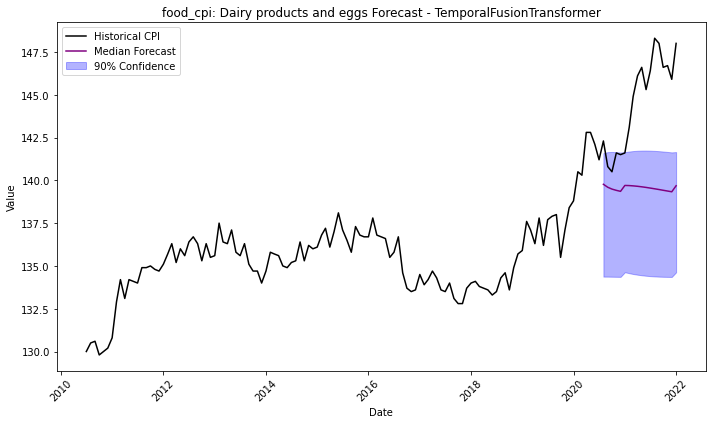

Beginning AutoGluon training... Time limit = 2s
AutoGluon will save models to './output/TEST/ag_global_all_TemporalFusionTransformerModel_exp2_GPT_P2_/random_seed_42/2020-07-01/model_files/'
=================== System Info ===================
AutoGluon Version:  1.1.1
Python Version:     3.8.20
Operating System:   Linux
Platform Machine:   x86_64
Platform Version:   #147~18.04.1-Ubuntu SMP Sat Oct 15 13:10:18 UTC 2022
CPU Count:          32
GPU Count:          1
Memory Avail:       166.19 GB / 188.57 GB (88.1%)
Disk Space Avail:   18213.19 GB / 249006.62 GB (7.3%)

Fitting with arguments:
{'enable_ensemble': True,
 'eval_metric': MAPE,
 'excluded_model_types': ['DirectTabular', 'RecursiveTabular'],
 'hyperparameters': {'TemporalFusionTransformerModel': {}},
 'known_covariates_names': [],
 'num_val_windows': 1,
 'prediction_length': 18,
 'quantile_levels': [0.01, 0.05, 0.1, 0.25, 0.75, 0.9, 0.95, 0.99],
 'random_seed': 42,
 'refit_every_n_windows': 1,
 'refit_full': False,
 'skip_model_

TemporalFusionTransformerModel


	-0.9928       = Validation score (-MAPE)
	2.11    s     = Training runtime
	0.04    s     = Validation (prediction) runtime
Not fitting ensemble due to lack of time remaining. Time left: -0.3 seconds
Training complete. Models trained: ['TemporalFusionTransformer']
Total runtime: 2.19 s
Best model: TemporalFusionTransformer
Best model score: -0.9928
Model not specified in predict, will default to the model with the best validation score: TemporalFusionTransformer
Model not specified in predict, will default to the model with the best validation score: TemporalFusionTransformer


****************** Summary of fit() ******************
Estimated performance of each model:
                       model  score_val  pred_time_val  fit_time_marginal  \
0  TemporalFusionTransformer  -0.992752         0.0397           2.105972   

   fit_order  
0          1  
Number of models trained: 1
Types of models trained:
{'MultiWindowBacktestingModel'}
****************** End of fit() summary ******************


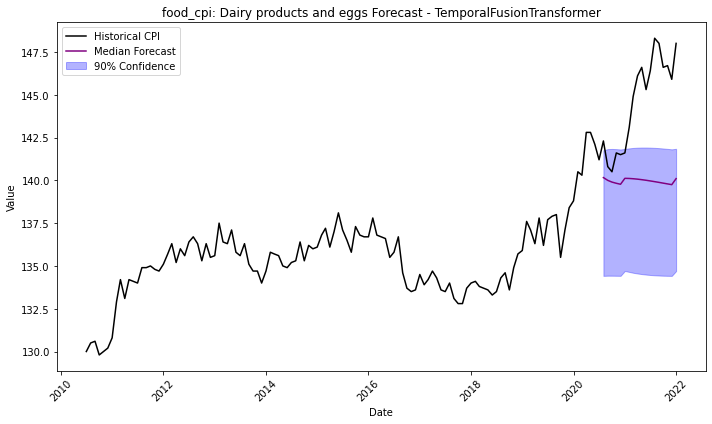

Beginning AutoGluon training... Time limit = 2s
AutoGluon will save models to './output/TEST/ag_global_all_TemporalFusionTransformerModel_exp2_R4_/random_seed_42/2020-07-01/model_files/'
=================== System Info ===================
AutoGluon Version:  1.1.1
Python Version:     3.8.20
Operating System:   Linux
Platform Machine:   x86_64
Platform Version:   #147~18.04.1-Ubuntu SMP Sat Oct 15 13:10:18 UTC 2022
CPU Count:          32
GPU Count:          1
Memory Avail:       166.08 GB / 188.57 GB (88.1%)
Disk Space Avail:   18213.18 GB / 249006.62 GB (7.3%)

Fitting with arguments:
{'enable_ensemble': True,
 'eval_metric': MAPE,
 'excluded_model_types': ['DirectTabular', 'RecursiveTabular'],
 'hyperparameters': {'TemporalFusionTransformerModel': {}},
 'known_covariates_names': [],
 'num_val_windows': 1,
 'prediction_length': 18,
 'quantile_levels': [0.01, 0.05, 0.1, 0.25, 0.75, 0.9, 0.95, 0.99],
 'random_seed': 42,
 'refit_every_n_windows': 1,
 'refit_full': False,
 'skip_model_sele

TemporalFusionTransformerModel


	-0.5354       = Validation score (-MAPE)
	2.13    s     = Training runtime
	0.04    s     = Validation (prediction) runtime
Not fitting ensemble due to lack of time remaining. Time left: -0.3 seconds
Training complete. Models trained: ['TemporalFusionTransformer']
Total runtime: 2.21 s
Best model: TemporalFusionTransformer
Best model score: -0.5354
Model not specified in predict, will default to the model with the best validation score: TemporalFusionTransformer
Model not specified in predict, will default to the model with the best validation score: TemporalFusionTransformer


****************** Summary of fit() ******************
Estimated performance of each model:
                       model  score_val  pred_time_val  fit_time_marginal  \
0  TemporalFusionTransformer  -0.535373       0.044701           2.126362   

   fit_order  
0          1  
Number of models trained: 1
Types of models trained:
{'MultiWindowBacktestingModel'}
****************** End of fit() summary ******************


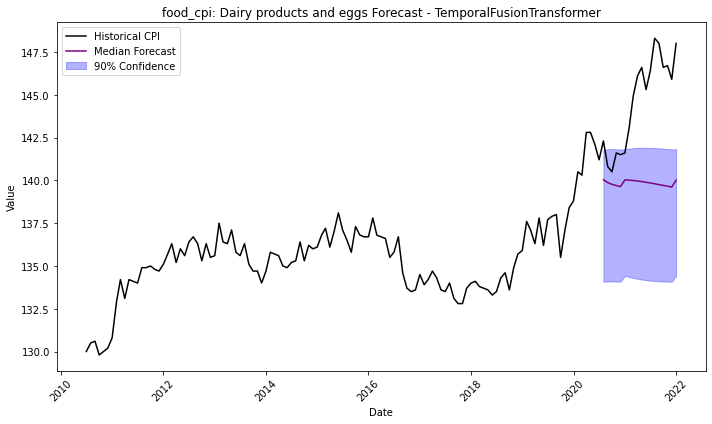

Beginning AutoGluon training... Time limit = 2s
AutoGluon will save models to './output/TEST/ag_global_all_TemporalFusionTransformerModel_exp2_R1_/random_seed_42/2020-07-01/model_files/'
=================== System Info ===================
AutoGluon Version:  1.1.1
Python Version:     3.8.20
Operating System:   Linux
Platform Machine:   x86_64
Platform Version:   #147~18.04.1-Ubuntu SMP Sat Oct 15 13:10:18 UTC 2022
CPU Count:          32
GPU Count:          1
Memory Avail:       166.19 GB / 188.57 GB (88.1%)
Disk Space Avail:   18213.17 GB / 249006.62 GB (7.3%)

Fitting with arguments:
{'enable_ensemble': True,
 'eval_metric': MAPE,
 'excluded_model_types': ['DirectTabular', 'RecursiveTabular'],
 'hyperparameters': {'TemporalFusionTransformerModel': {}},
 'known_covariates_names': [],
 'num_val_windows': 1,
 'prediction_length': 18,
 'quantile_levels': [0.01, 0.05, 0.1, 0.25, 0.75, 0.9, 0.95, 0.99],
 'random_seed': 42,
 'refit_every_n_windows': 1,
 'refit_full': False,
 'skip_model_sele

TemporalFusionTransformerModel


	-2.6262       = Validation score (-MAPE)
	2.12    s     = Training runtime
	0.04    s     = Validation (prediction) runtime
Not fitting ensemble due to lack of time remaining. Time left: -0.3 seconds
Training complete. Models trained: ['TemporalFusionTransformer']
Total runtime: 2.20 s
Best model: TemporalFusionTransformer
Best model score: -2.6262
Model not specified in predict, will default to the model with the best validation score: TemporalFusionTransformer
Model not specified in predict, will default to the model with the best validation score: TemporalFusionTransformer


****************** Summary of fit() ******************
Estimated performance of each model:
                       model  score_val  pred_time_val  fit_time_marginal  \
0  TemporalFusionTransformer  -2.626184       0.043039           2.124082   

   fit_order  
0          1  
Number of models trained: 1
Types of models trained:
{'MultiWindowBacktestingModel'}
****************** End of fit() summary ******************


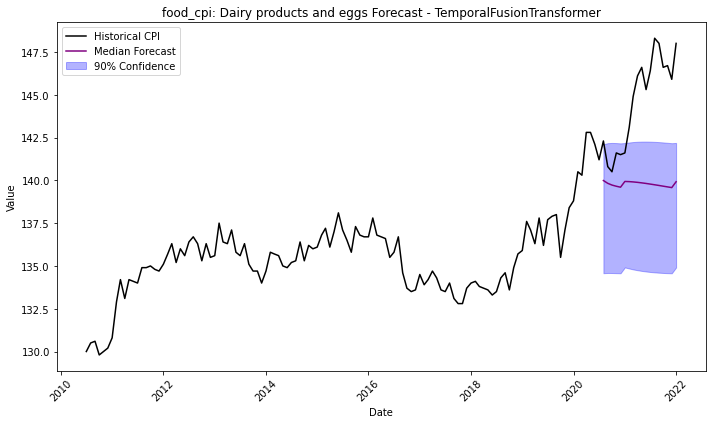

Beginning AutoGluon training... Time limit = 2s
AutoGluon will save models to './output/TEST/ag_global_all_TemporalFusionTransformerModel_exp2_R2_/random_seed_42/2020-07-01/model_files/'
=================== System Info ===================
AutoGluon Version:  1.1.1
Python Version:     3.8.20
Operating System:   Linux
Platform Machine:   x86_64
Platform Version:   #147~18.04.1-Ubuntu SMP Sat Oct 15 13:10:18 UTC 2022
CPU Count:          32
GPU Count:          1
Memory Avail:       166.09 GB / 188.57 GB (88.1%)
Disk Space Avail:   18213.21 GB / 249006.62 GB (7.3%)

Fitting with arguments:
{'enable_ensemble': True,
 'eval_metric': MAPE,
 'excluded_model_types': ['DirectTabular', 'RecursiveTabular'],
 'hyperparameters': {'TemporalFusionTransformerModel': {}},
 'known_covariates_names': [],
 'num_val_windows': 1,
 'prediction_length': 18,
 'quantile_levels': [0.01, 0.05, 0.1, 0.25, 0.75, 0.9, 0.95, 0.99],
 'random_seed': 42,
 'refit_every_n_windows': 1,
 'refit_full': False,
 'skip_model_sele

TemporalFusionTransformerModel


	-0.3764       = Validation score (-MAPE)
	2.14    s     = Training runtime
	0.04    s     = Validation (prediction) runtime
Not fitting ensemble due to lack of time remaining. Time left: -0.3 seconds
Training complete. Models trained: ['TemporalFusionTransformer']
Total runtime: 2.23 s
Best model: TemporalFusionTransformer
Best model score: -0.3764
Model not specified in predict, will default to the model with the best validation score: TemporalFusionTransformer
Model not specified in predict, will default to the model with the best validation score: TemporalFusionTransformer


****************** Summary of fit() ******************
Estimated performance of each model:
                       model  score_val  pred_time_val  fit_time_marginal  \
0  TemporalFusionTransformer   -0.37641       0.044783           2.141607   

   fit_order  
0          1  
Number of models trained: 1
Types of models trained:
{'MultiWindowBacktestingModel'}
****************** End of fit() summary ******************


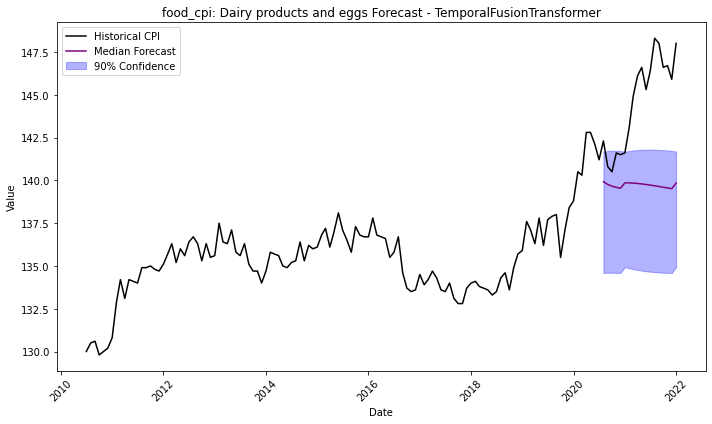

Beginning AutoGluon training... Time limit = 2s
AutoGluon will save models to './output/TEST/ag_global_all_TemporalFusionTransformerModel_exp2_GPT_P4_/random_seed_42/2020-07-01/model_files/'
=================== System Info ===================
AutoGluon Version:  1.1.1
Python Version:     3.8.20
Operating System:   Linux
Platform Machine:   x86_64
Platform Version:   #147~18.04.1-Ubuntu SMP Sat Oct 15 13:10:18 UTC 2022
CPU Count:          32
GPU Count:          1
Memory Avail:       166.08 GB / 188.57 GB (88.1%)
Disk Space Avail:   18213.20 GB / 249006.62 GB (7.3%)

Fitting with arguments:
{'enable_ensemble': True,
 'eval_metric': MAPE,
 'excluded_model_types': ['DirectTabular', 'RecursiveTabular'],
 'hyperparameters': {'TemporalFusionTransformerModel': {}},
 'known_covariates_names': [],
 'num_val_windows': 1,
 'prediction_length': 18,
 'quantile_levels': [0.01, 0.05, 0.1, 0.25, 0.75, 0.9, 0.95, 0.99],
 'random_seed': 42,
 'refit_every_n_windows': 1,
 'refit_full': False,
 'skip_model_

TemporalFusionTransformerModel


Inferred time series frequency: 'MS'
Provided train_data has 7470 rows, 18 time series. Median time series length is 415 (min=415, max=415). 

Provided data contains following columns:
	target: 'target'

AutoGluon will gauge predictive performance using evaluation metric: 'MAPE'
	This metric's sign has been flipped to adhere to being higher_is_better. The metric score can be multiplied by -1 to get the metric value.

Starting training. Start time is 2024-10-27 07:32:03
Excluded model types: ['DirectTabular', 'RecursiveTabular']
Models that will be trained: ['TemporalFusionTransformer']
Training timeseries model TemporalFusionTransformer. Training for up to 1.6s of the 1.6s of remaining time.
	-0.6596       = Validation score (-MAPE)
	1.86    s     = Training runtime
	0.04    s     = Validation (prediction) runtime
Not fitting ensemble due to lack of time remaining. Time left: -0.3 seconds
Training complete. Models trained: ['TemporalFusionTransformer']
Total runtime: 1.94 s
Best model:

****************** Summary of fit() ******************
Estimated performance of each model:
                       model  score_val  pred_time_val  fit_time_marginal  \
0  TemporalFusionTransformer   -0.65957       0.040336           1.857911   

   fit_order  
0          1  
Number of models trained: 1
Types of models trained:
{'MultiWindowBacktestingModel'}
****************** End of fit() summary ******************


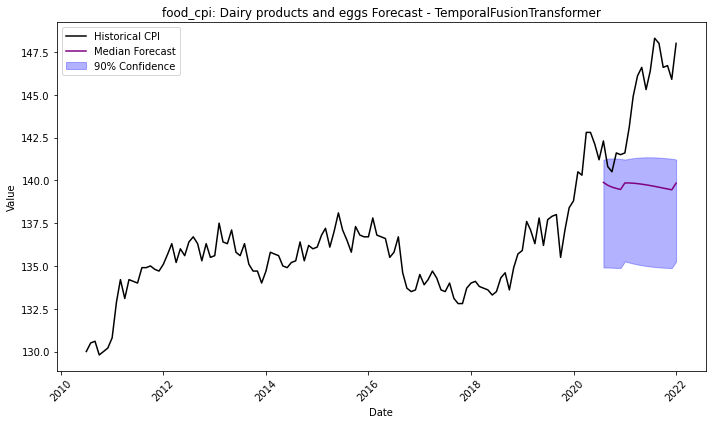

Beginning AutoGluon training... Time limit = 2s
AutoGluon will save models to './output/TEST/ag_global_all_TemporalFusionTransformerModel_exp2_R3_/random_seed_42/2021-07-01/model_files/'
=================== System Info ===================
AutoGluon Version:  1.1.1
Python Version:     3.8.20
Operating System:   Linux
Platform Machine:   x86_64
Platform Version:   #147~18.04.1-Ubuntu SMP Sat Oct 15 13:10:18 UTC 2022
CPU Count:          32
GPU Count:          1
Memory Avail:       166.08 GB / 188.57 GB (88.1%)
Disk Space Avail:   18213.20 GB / 249006.62 GB (7.3%)

Fitting with arguments:
{'enable_ensemble': True,
 'eval_metric': MAPE,
 'excluded_model_types': ['DirectTabular', 'RecursiveTabular'],
 'hyperparameters': {'TemporalFusionTransformerModel': {}},
 'known_covariates_names': [],
 'num_val_windows': 1,
 'prediction_length': 18,
 'quantile_levels': [0.01, 0.05, 0.1, 0.25, 0.75, 0.9, 0.95, 0.99],
 'random_seed': 42,
 'refit_every_n_windows': 1,
 'refit_full': False,
 'skip_model_sele

TemporalFusionTransformerModel


	-0.7306       = Validation score (-MAPE)
	2.13    s     = Training runtime
	0.05    s     = Validation (prediction) runtime
Not fitting ensemble due to lack of time remaining. Time left: -0.3 seconds
Training complete. Models trained: ['TemporalFusionTransformer']
Total runtime: 2.21 s
Best model: TemporalFusionTransformer
Best model score: -0.7306
Model not specified in predict, will default to the model with the best validation score: TemporalFusionTransformer
Model not specified in predict, will default to the model with the best validation score: TemporalFusionTransformer


****************** Summary of fit() ******************
Estimated performance of each model:
                       model  score_val  pred_time_val  fit_time_marginal  \
0  TemporalFusionTransformer  -0.730553       0.047229           2.130625   

   fit_order  
0          1  
Number of models trained: 1
Types of models trained:
{'MultiWindowBacktestingModel'}
****************** End of fit() summary ******************


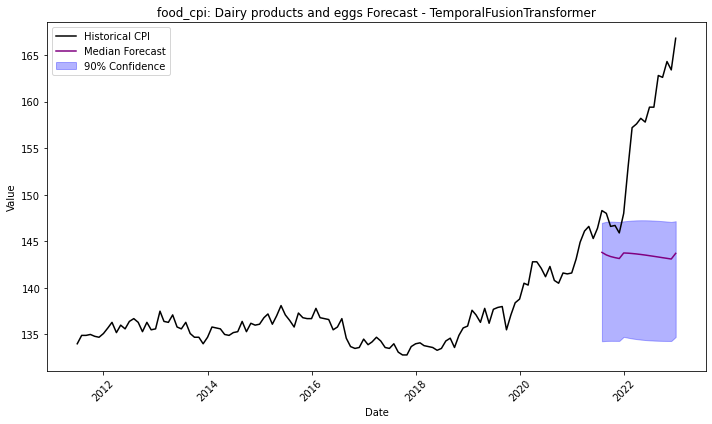

Beginning AutoGluon training... Time limit = 2s
AutoGluon will save models to './output/TEST/ag_global_all_TemporalFusionTransformerModel_exp2_GPT_P1_/random_seed_42/2021-07-01/model_files/'
=================== System Info ===================
AutoGluon Version:  1.1.1
Python Version:     3.8.20
Operating System:   Linux
Platform Machine:   x86_64
Platform Version:   #147~18.04.1-Ubuntu SMP Sat Oct 15 13:10:18 UTC 2022
CPU Count:          32
GPU Count:          1
Memory Avail:       166.21 GB / 188.57 GB (88.1%)
Disk Space Avail:   18213.18 GB / 249006.62 GB (7.3%)

Fitting with arguments:
{'enable_ensemble': True,
 'eval_metric': MAPE,
 'excluded_model_types': ['DirectTabular', 'RecursiveTabular'],
 'hyperparameters': {'TemporalFusionTransformerModel': {}},
 'known_covariates_names': [],
 'num_val_windows': 1,
 'prediction_length': 18,
 'quantile_levels': [0.01, 0.05, 0.1, 0.25, 0.75, 0.9, 0.95, 0.99],
 'random_seed': 42,
 'refit_every_n_windows': 1,
 'refit_full': False,
 'skip_model_

TemporalFusionTransformerModel


	-1.1170       = Validation score (-MAPE)
	2.15    s     = Training runtime
	0.04    s     = Validation (prediction) runtime
Not fitting ensemble due to lack of time remaining. Time left: -0.3 seconds
Training complete. Models trained: ['TemporalFusionTransformer']
Total runtime: 2.23 s
Best model: TemporalFusionTransformer
Best model score: -1.1170
Model not specified in predict, will default to the model with the best validation score: TemporalFusionTransformer
Model not specified in predict, will default to the model with the best validation score: TemporalFusionTransformer


****************** Summary of fit() ******************
Estimated performance of each model:
                       model  score_val  pred_time_val  fit_time_marginal  \
0  TemporalFusionTransformer  -1.116953       0.041875           2.150877   

   fit_order  
0          1  
Number of models trained: 1
Types of models trained:
{'MultiWindowBacktestingModel'}
****************** End of fit() summary ******************


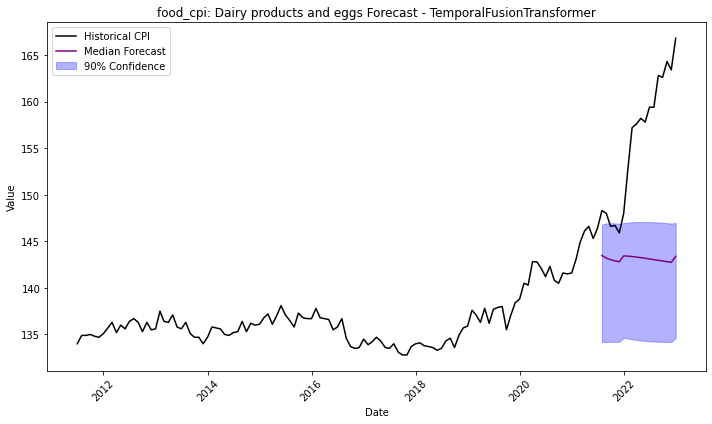

Beginning AutoGluon training... Time limit = 2s
AutoGluon will save models to './output/TEST/ag_global_all_TemporalFusionTransformerModel_exp2_GPT_P3_/random_seed_42/2021-07-01/model_files/'
=================== System Info ===================
AutoGluon Version:  1.1.1
Python Version:     3.8.20
Operating System:   Linux
Platform Machine:   x86_64
Platform Version:   #147~18.04.1-Ubuntu SMP Sat Oct 15 13:10:18 UTC 2022
CPU Count:          32
GPU Count:          1
Memory Avail:       166.08 GB / 188.57 GB (88.1%)
Disk Space Avail:   18213.17 GB / 249006.62 GB (7.3%)

Fitting with arguments:
{'enable_ensemble': True,
 'eval_metric': MAPE,
 'excluded_model_types': ['DirectTabular', 'RecursiveTabular'],
 'hyperparameters': {'TemporalFusionTransformerModel': {}},
 'known_covariates_names': [],
 'num_val_windows': 1,
 'prediction_length': 18,
 'quantile_levels': [0.01, 0.05, 0.1, 0.25, 0.75, 0.9, 0.95, 0.99],
 'random_seed': 42,
 'refit_every_n_windows': 1,
 'refit_full': False,
 'skip_model_

TemporalFusionTransformerModel


	-1.1414       = Validation score (-MAPE)
	2.09    s     = Training runtime
	0.04    s     = Validation (prediction) runtime
Not fitting ensemble due to lack of time remaining. Time left: -0.2 seconds
Training complete. Models trained: ['TemporalFusionTransformer']
Total runtime: 2.17 s
Best model: TemporalFusionTransformer
Best model score: -1.1414
Model not specified in predict, will default to the model with the best validation score: TemporalFusionTransformer
Model not specified in predict, will default to the model with the best validation score: TemporalFusionTransformer


****************** Summary of fit() ******************
Estimated performance of each model:
                       model  score_val  pred_time_val  fit_time_marginal  \
0  TemporalFusionTransformer  -1.141449        0.04222           2.093504   

   fit_order  
0          1  
Number of models trained: 1
Types of models trained:
{'MultiWindowBacktestingModel'}
****************** End of fit() summary ******************


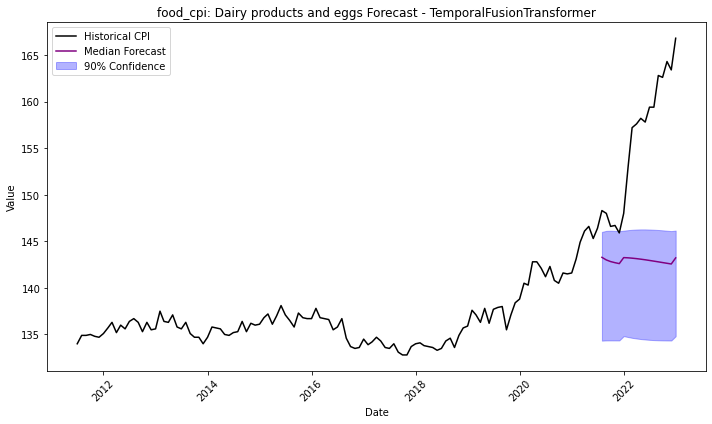

Beginning AutoGluon training... Time limit = 2s
AutoGluon will save models to './output/TEST/ag_global_all_TemporalFusionTransformerModel_exp2_GPT_P2_/random_seed_42/2021-07-01/model_files/'
=================== System Info ===================
AutoGluon Version:  1.1.1
Python Version:     3.8.20
Operating System:   Linux
Platform Machine:   x86_64
Platform Version:   #147~18.04.1-Ubuntu SMP Sat Oct 15 13:10:18 UTC 2022
CPU Count:          32
GPU Count:          1
Memory Avail:       166.05 GB / 188.57 GB (88.1%)
Disk Space Avail:   18213.16 GB / 249006.62 GB (7.3%)

Fitting with arguments:
{'enable_ensemble': True,
 'eval_metric': MAPE,
 'excluded_model_types': ['DirectTabular', 'RecursiveTabular'],
 'hyperparameters': {'TemporalFusionTransformerModel': {}},
 'known_covariates_names': [],
 'num_val_windows': 1,
 'prediction_length': 18,
 'quantile_levels': [0.01, 0.05, 0.1, 0.25, 0.75, 0.9, 0.95, 0.99],
 'random_seed': 42,
 'refit_every_n_windows': 1,
 'refit_full': False,
 'skip_model_

TemporalFusionTransformerModel


	-1.0692       = Validation score (-MAPE)
	2.12    s     = Training runtime
	0.04    s     = Validation (prediction) runtime
Not fitting ensemble due to lack of time remaining. Time left: -0.2 seconds
Training complete. Models trained: ['TemporalFusionTransformer']
Total runtime: 2.20 s
Best model: TemporalFusionTransformer
Best model score: -1.0692
Model not specified in predict, will default to the model with the best validation score: TemporalFusionTransformer
Model not specified in predict, will default to the model with the best validation score: TemporalFusionTransformer


****************** Summary of fit() ******************
Estimated performance of each model:
                       model  score_val  pred_time_val  fit_time_marginal  \
0  TemporalFusionTransformer   -1.06925       0.041202            2.11933   

   fit_order  
0          1  
Number of models trained: 1
Types of models trained:
{'MultiWindowBacktestingModel'}
****************** End of fit() summary ******************


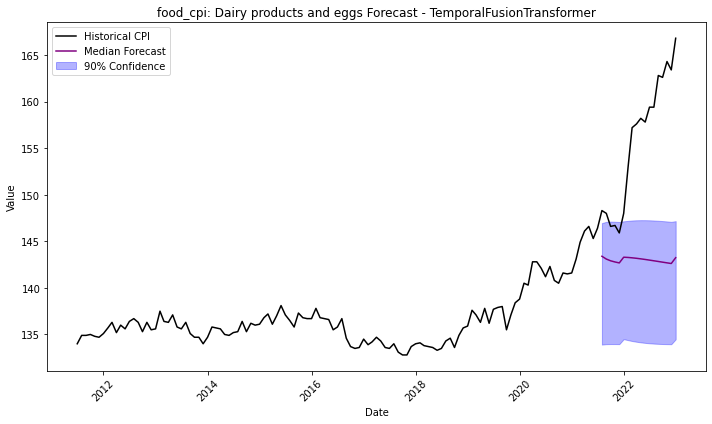

Beginning AutoGluon training... Time limit = 2s
AutoGluon will save models to './output/TEST/ag_global_all_TemporalFusionTransformerModel_exp2_R4_/random_seed_42/2021-07-01/model_files/'
=================== System Info ===================
AutoGluon Version:  1.1.1
Python Version:     3.8.20
Operating System:   Linux
Platform Machine:   x86_64
Platform Version:   #147~18.04.1-Ubuntu SMP Sat Oct 15 13:10:18 UTC 2022
CPU Count:          32
GPU Count:          1
Memory Avail:       166.05 GB / 188.57 GB (88.1%)
Disk Space Avail:   18213.20 GB / 249006.62 GB (7.3%)

Fitting with arguments:
{'enable_ensemble': True,
 'eval_metric': MAPE,
 'excluded_model_types': ['DirectTabular', 'RecursiveTabular'],
 'hyperparameters': {'TemporalFusionTransformerModel': {}},
 'known_covariates_names': [],
 'num_val_windows': 1,
 'prediction_length': 18,
 'quantile_levels': [0.01, 0.05, 0.1, 0.25, 0.75, 0.9, 0.95, 0.99],
 'random_seed': 42,
 'refit_every_n_windows': 1,
 'refit_full': False,
 'skip_model_sele

TemporalFusionTransformerModel


Inferred time series frequency: 'MS'
Provided train_data has 9394 rows, 22 time series. Median time series length is 427 (min=427, max=427). 

Provided data contains following columns:
	target: 'target'

AutoGluon will gauge predictive performance using evaluation metric: 'MAPE'
	This metric's sign has been flipped to adhere to being higher_is_better. The metric score can be multiplied by -1 to get the metric value.

Starting training. Start time is 2024-10-27 07:32:17
Excluded model types: ['DirectTabular', 'RecursiveTabular']
Models that will be trained: ['TemporalFusionTransformer']
Training timeseries model TemporalFusionTransformer. Training for up to 1.6s of the 1.6s of remaining time.
	-0.6946       = Validation score (-MAPE)
	1.87    s     = Training runtime
	0.04    s     = Validation (prediction) runtime
Not fitting ensemble due to lack of time remaining. Time left: -0.3 seconds
Training complete. Models trained: ['TemporalFusionTransformer']
Total runtime: 1.95 s
Best model:

****************** Summary of fit() ******************
Estimated performance of each model:
                       model  score_val  pred_time_val  fit_time_marginal  \
0  TemporalFusionTransformer  -0.694632       0.042458            1.86667   

   fit_order  
0          1  
Number of models trained: 1
Types of models trained:
{'MultiWindowBacktestingModel'}
****************** End of fit() summary ******************


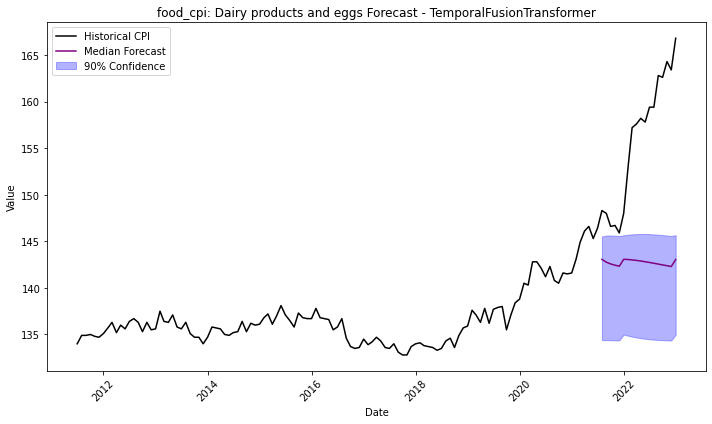

Beginning AutoGluon training... Time limit = 2s
AutoGluon will save models to './output/TEST/ag_global_all_TemporalFusionTransformerModel_exp2_R1_/random_seed_42/2021-07-01/model_files/'
=================== System Info ===================
AutoGluon Version:  1.1.1
Python Version:     3.8.20
Operating System:   Linux
Platform Machine:   x86_64
Platform Version:   #147~18.04.1-Ubuntu SMP Sat Oct 15 13:10:18 UTC 2022
CPU Count:          32
GPU Count:          1
Memory Avail:       166.02 GB / 188.57 GB (88.0%)
Disk Space Avail:   18213.18 GB / 249006.62 GB (7.3%)

Fitting with arguments:
{'enable_ensemble': True,
 'eval_metric': MAPE,
 'excluded_model_types': ['DirectTabular', 'RecursiveTabular'],
 'hyperparameters': {'TemporalFusionTransformerModel': {}},
 'known_covariates_names': [],
 'num_val_windows': 1,
 'prediction_length': 18,
 'quantile_levels': [0.01, 0.05, 0.1, 0.25, 0.75, 0.9, 0.95, 0.99],
 'random_seed': 42,
 'refit_every_n_windows': 1,
 'refit_full': False,
 'skip_model_sele

TemporalFusionTransformerModel


	-1.0335       = Validation score (-MAPE)
	2.11    s     = Training runtime
	0.04    s     = Validation (prediction) runtime
Not fitting ensemble due to lack of time remaining. Time left: -0.3 seconds
Training complete. Models trained: ['TemporalFusionTransformer']
Total runtime: 2.20 s
Best model: TemporalFusionTransformer
Best model score: -1.0335
Model not specified in predict, will default to the model with the best validation score: TemporalFusionTransformer
Model not specified in predict, will default to the model with the best validation score: TemporalFusionTransformer


****************** Summary of fit() ******************
Estimated performance of each model:
                       model  score_val  pred_time_val  fit_time_marginal  \
0  TemporalFusionTransformer  -1.033525       0.042817           2.107826   

   fit_order  
0          1  
Number of models trained: 1
Types of models trained:
{'MultiWindowBacktestingModel'}
****************** End of fit() summary ******************


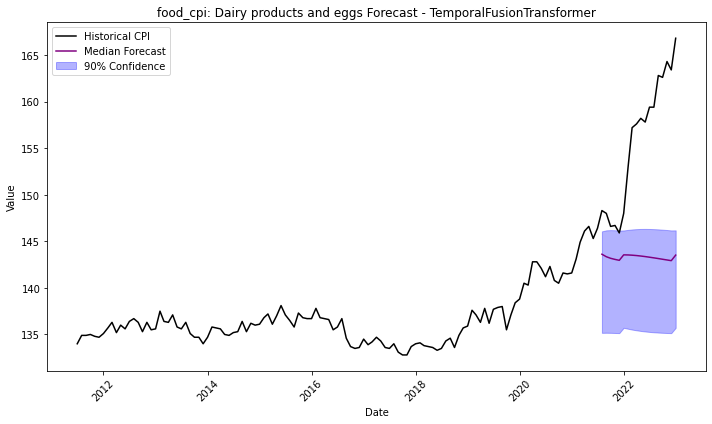

Beginning AutoGluon training... Time limit = 2s
AutoGluon will save models to './output/TEST/ag_global_all_TemporalFusionTransformerModel_exp2_R2_/random_seed_42/2021-07-01/model_files/'
=================== System Info ===================
AutoGluon Version:  1.1.1
Python Version:     3.8.20
Operating System:   Linux
Platform Machine:   x86_64
Platform Version:   #147~18.04.1-Ubuntu SMP Sat Oct 15 13:10:18 UTC 2022
CPU Count:          32
GPU Count:          1
Memory Avail:       166.02 GB / 188.57 GB (88.0%)
Disk Space Avail:   18213.17 GB / 249006.62 GB (7.3%)

Fitting with arguments:
{'enable_ensemble': True,
 'eval_metric': MAPE,
 'excluded_model_types': ['DirectTabular', 'RecursiveTabular'],
 'hyperparameters': {'TemporalFusionTransformerModel': {}},
 'known_covariates_names': [],
 'num_val_windows': 1,
 'prediction_length': 18,
 'quantile_levels': [0.01, 0.05, 0.1, 0.25, 0.75, 0.9, 0.95, 0.99],
 'random_seed': 42,
 'refit_every_n_windows': 1,
 'refit_full': False,
 'skip_model_sele

TemporalFusionTransformerModel


	-0.5354       = Validation score (-MAPE)
	2.12    s     = Training runtime
	0.04    s     = Validation (prediction) runtime
Not fitting ensemble due to lack of time remaining. Time left: -0.3 seconds
Training complete. Models trained: ['TemporalFusionTransformer']
Total runtime: 2.21 s
Best model: TemporalFusionTransformer
Best model score: -0.5354
Model not specified in predict, will default to the model with the best validation score: TemporalFusionTransformer
Model not specified in predict, will default to the model with the best validation score: TemporalFusionTransformer


****************** Summary of fit() ******************
Estimated performance of each model:
                       model  score_val  pred_time_val  fit_time_marginal  \
0  TemporalFusionTransformer  -0.535431       0.041776            2.11987   

   fit_order  
0          1  
Number of models trained: 1
Types of models trained:
{'MultiWindowBacktestingModel'}
****************** End of fit() summary ******************


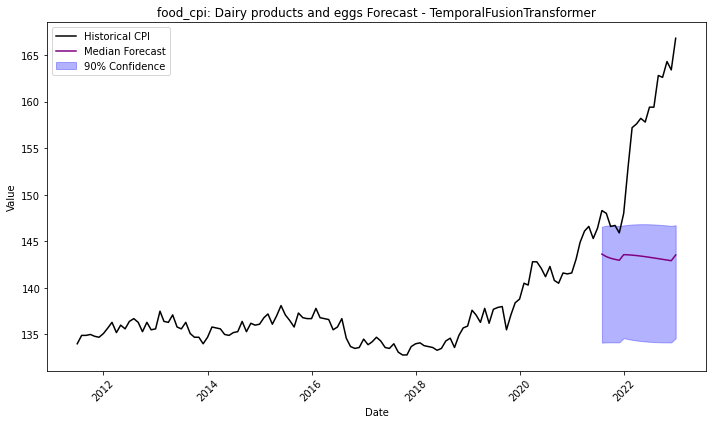

Beginning AutoGluon training... Time limit = 2s
AutoGluon will save models to './output/TEST/ag_global_all_TemporalFusionTransformerModel_exp2_GPT_P4_/random_seed_42/2021-07-01/model_files/'
=================== System Info ===================
AutoGluon Version:  1.1.1
Python Version:     3.8.20
Operating System:   Linux
Platform Machine:   x86_64
Platform Version:   #147~18.04.1-Ubuntu SMP Sat Oct 15 13:10:18 UTC 2022
CPU Count:          32
GPU Count:          1
Memory Avail:       166.04 GB / 188.57 GB (88.1%)
Disk Space Avail:   18213.66 GB / 249006.62 GB (7.3%)

Fitting with arguments:
{'enable_ensemble': True,
 'eval_metric': MAPE,
 'excluded_model_types': ['DirectTabular', 'RecursiveTabular'],
 'hyperparameters': {'TemporalFusionTransformerModel': {}},
 'known_covariates_names': [],
 'num_val_windows': 1,
 'prediction_length': 18,
 'quantile_levels': [0.01, 0.05, 0.1, 0.25, 0.75, 0.9, 0.95, 0.99],
 'random_seed': 42,
 'refit_every_n_windows': 1,
 'refit_full': False,
 'skip_model_

TemporalFusionTransformerModel


	-0.8915       = Validation score (-MAPE)
	2.12    s     = Training runtime
	0.04    s     = Validation (prediction) runtime
Not fitting ensemble due to lack of time remaining. Time left: -0.3 seconds
Training complete. Models trained: ['TemporalFusionTransformer']
Total runtime: 2.20 s
Best model: TemporalFusionTransformer
Best model score: -0.8915
Model not specified in predict, will default to the model with the best validation score: TemporalFusionTransformer
Model not specified in predict, will default to the model with the best validation score: TemporalFusionTransformer


****************** Summary of fit() ******************
Estimated performance of each model:
                       model  score_val  pred_time_val  fit_time_marginal  \
0  TemporalFusionTransformer  -0.891475        0.04233           2.119903   

   fit_order  
0          1  
Number of models trained: 1
Types of models trained:
{'MultiWindowBacktestingModel'}
****************** End of fit() summary ******************


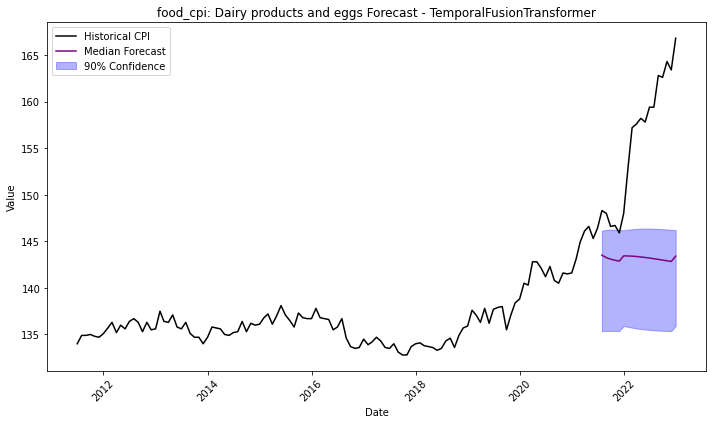

Beginning AutoGluon training... Time limit = 2s
AutoGluon will save models to './output/TEST/ag_global_all_TemporalFusionTransformerModel_exp2_R3_/random_seed_42/2022-07-01/model_files/'
=================== System Info ===================
AutoGluon Version:  1.1.1
Python Version:     3.8.20
Operating System:   Linux
Platform Machine:   x86_64
Platform Version:   #147~18.04.1-Ubuntu SMP Sat Oct 15 13:10:18 UTC 2022
CPU Count:          32
GPU Count:          1
Memory Avail:       166.08 GB / 188.57 GB (88.1%)
Disk Space Avail:   18213.65 GB / 249006.62 GB (7.3%)

Fitting with arguments:
{'enable_ensemble': True,
 'eval_metric': MAPE,
 'excluded_model_types': ['DirectTabular', 'RecursiveTabular'],
 'hyperparameters': {'TemporalFusionTransformerModel': {}},
 'known_covariates_names': [],
 'num_val_windows': 1,
 'prediction_length': 18,
 'quantile_levels': [0.01, 0.05, 0.1, 0.25, 0.75, 0.9, 0.95, 0.99],
 'random_seed': 42,
 'refit_every_n_windows': 1,
 'refit_full': False,
 'skip_model_sele

TemporalFusionTransformerModel


	-0.4260       = Validation score (-MAPE)
	2.11    s     = Training runtime
	0.04    s     = Validation (prediction) runtime
Not fitting ensemble due to lack of time remaining. Time left: -0.3 seconds
Training complete. Models trained: ['TemporalFusionTransformer']
Total runtime: 2.20 s
Best model: TemporalFusionTransformer
Best model score: -0.4260
Model not specified in predict, will default to the model with the best validation score: TemporalFusionTransformer
Model not specified in predict, will default to the model with the best validation score: TemporalFusionTransformer


****************** Summary of fit() ******************
Estimated performance of each model:
                       model  score_val  pred_time_val  fit_time_marginal  \
0  TemporalFusionTransformer  -0.425989       0.044287           2.113977   

   fit_order  
0          1  
Number of models trained: 1
Types of models trained:
{'MultiWindowBacktestingModel'}
****************** End of fit() summary ******************


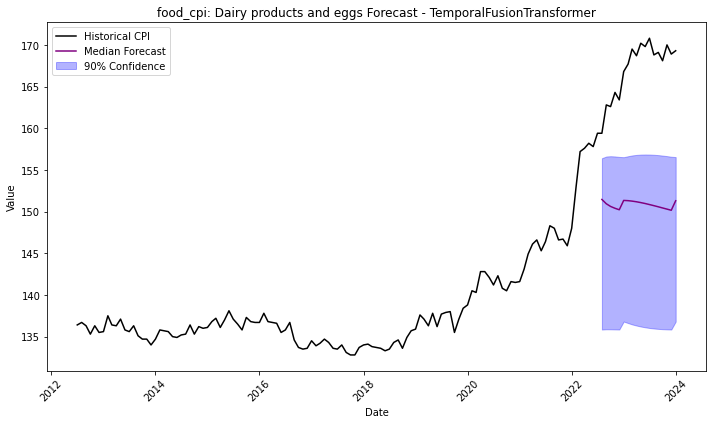

Beginning AutoGluon training... Time limit = 2s
AutoGluon will save models to './output/TEST/ag_global_all_TemporalFusionTransformerModel_exp2_GPT_P1_/random_seed_42/2022-07-01/model_files/'
=================== System Info ===================
AutoGluon Version:  1.1.1
Python Version:     3.8.20
Operating System:   Linux
Platform Machine:   x86_64
Platform Version:   #147~18.04.1-Ubuntu SMP Sat Oct 15 13:10:18 UTC 2022
CPU Count:          32
GPU Count:          1
Memory Avail:       166.11 GB / 188.57 GB (88.1%)
Disk Space Avail:   18213.64 GB / 249006.62 GB (7.3%)

Fitting with arguments:
{'enable_ensemble': True,
 'eval_metric': MAPE,
 'excluded_model_types': ['DirectTabular', 'RecursiveTabular'],
 'hyperparameters': {'TemporalFusionTransformerModel': {}},
 'known_covariates_names': [],
 'num_val_windows': 1,
 'prediction_length': 18,
 'quantile_levels': [0.01, 0.05, 0.1, 0.25, 0.75, 0.9, 0.95, 0.99],
 'random_seed': 42,
 'refit_every_n_windows': 1,
 'refit_full': False,
 'skip_model_

TemporalFusionTransformerModel


	-5.4484       = Validation score (-MAPE)
	2.12    s     = Training runtime
	0.33    s     = Validation (prediction) runtime
Not fitting ensemble due to lack of time remaining. Time left: -0.5 seconds
Training complete. Models trained: ['TemporalFusionTransformer']
Total runtime: 2.49 s
Best model: TemporalFusionTransformer
Best model score: -5.4484
Model not specified in predict, will default to the model with the best validation score: TemporalFusionTransformer
Model not specified in predict, will default to the model with the best validation score: TemporalFusionTransformer


****************** Summary of fit() ******************
Estimated performance of each model:
                       model  score_val  pred_time_val  fit_time_marginal  \
0  TemporalFusionTransformer  -5.448378       0.333163           2.116255   

   fit_order  
0          1  
Number of models trained: 1
Types of models trained:
{'MultiWindowBacktestingModel'}
****************** End of fit() summary ******************


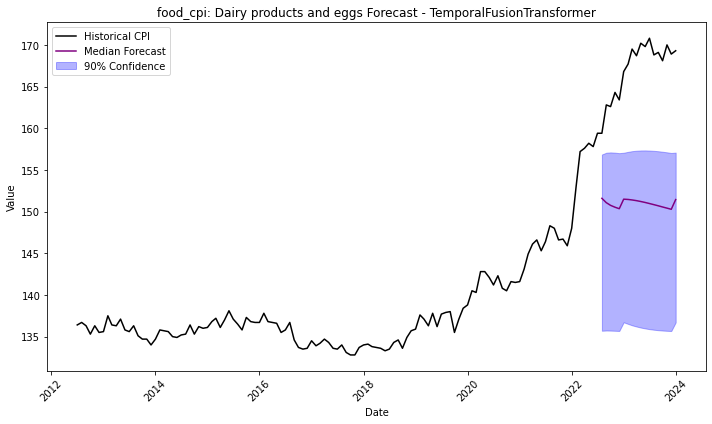

Beginning AutoGluon training... Time limit = 2s
AutoGluon will save models to './output/TEST/ag_global_all_TemporalFusionTransformerModel_exp2_GPT_P3_/random_seed_42/2022-07-01/model_files/'
=================== System Info ===================
AutoGluon Version:  1.1.1
Python Version:     3.8.20
Operating System:   Linux
Platform Machine:   x86_64
Platform Version:   #147~18.04.1-Ubuntu SMP Sat Oct 15 13:10:18 UTC 2022
CPU Count:          32
GPU Count:          1
Memory Avail:       166.04 GB / 188.57 GB (88.1%)
Disk Space Avail:   18213.63 GB / 249006.62 GB (7.3%)

Fitting with arguments:
{'enable_ensemble': True,
 'eval_metric': MAPE,
 'excluded_model_types': ['DirectTabular', 'RecursiveTabular'],
 'hyperparameters': {'TemporalFusionTransformerModel': {}},
 'known_covariates_names': [],
 'num_val_windows': 1,
 'prediction_length': 18,
 'quantile_levels': [0.01, 0.05, 0.1, 0.25, 0.75, 0.9, 0.95, 0.99],
 'random_seed': 42,
 'refit_every_n_windows': 1,
 'refit_full': False,
 'skip_model_

TemporalFusionTransformerModel


	-5.8855       = Validation score (-MAPE)
	2.20    s     = Training runtime
	0.04    s     = Validation (prediction) runtime
Not fitting ensemble due to lack of time remaining. Time left: -0.3 seconds
Training complete. Models trained: ['TemporalFusionTransformer']
Total runtime: 2.28 s
Best model: TemporalFusionTransformer
Best model score: -5.8855
Model not specified in predict, will default to the model with the best validation score: TemporalFusionTransformer
Model not specified in predict, will default to the model with the best validation score: TemporalFusionTransformer


****************** Summary of fit() ******************
Estimated performance of each model:
                       model  score_val  pred_time_val  fit_time_marginal  \
0  TemporalFusionTransformer  -5.885455       0.043338           2.202879   

   fit_order  
0          1  
Number of models trained: 1
Types of models trained:
{'MultiWindowBacktestingModel'}
****************** End of fit() summary ******************


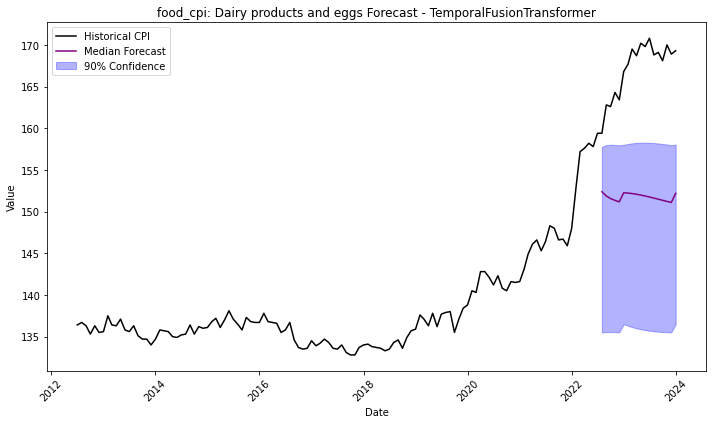

Beginning AutoGluon training... Time limit = 2s
AutoGluon will save models to './output/TEST/ag_global_all_TemporalFusionTransformerModel_exp2_GPT_P2_/random_seed_42/2022-07-01/model_files/'
=================== System Info ===================
AutoGluon Version:  1.1.1
Python Version:     3.8.20
Operating System:   Linux
Platform Machine:   x86_64
Platform Version:   #147~18.04.1-Ubuntu SMP Sat Oct 15 13:10:18 UTC 2022
CPU Count:          32
GPU Count:          1
Memory Avail:       166.04 GB / 188.57 GB (88.1%)
Disk Space Avail:   18213.62 GB / 249006.62 GB (7.3%)

Fitting with arguments:
{'enable_ensemble': True,
 'eval_metric': MAPE,
 'excluded_model_types': ['DirectTabular', 'RecursiveTabular'],
 'hyperparameters': {'TemporalFusionTransformerModel': {}},
 'known_covariates_names': [],
 'num_val_windows': 1,
 'prediction_length': 18,
 'quantile_levels': [0.01, 0.05, 0.1, 0.25, 0.75, 0.9, 0.95, 0.99],
 'random_seed': 42,
 'refit_every_n_windows': 1,
 'refit_full': False,
 'skip_model_

TemporalFusionTransformerModel


	-6.2968       = Validation score (-MAPE)
	2.12    s     = Training runtime
	0.04    s     = Validation (prediction) runtime
Not fitting ensemble due to lack of time remaining. Time left: -0.3 seconds
Training complete. Models trained: ['TemporalFusionTransformer']
Total runtime: 2.20 s
Best model: TemporalFusionTransformer
Best model score: -6.2968
Model not specified in predict, will default to the model with the best validation score: TemporalFusionTransformer
Model not specified in predict, will default to the model with the best validation score: TemporalFusionTransformer


****************** Summary of fit() ******************
Estimated performance of each model:
                       model  score_val  pred_time_val  fit_time_marginal  \
0  TemporalFusionTransformer  -6.296787       0.038554           2.124001   

   fit_order  
0          1  
Number of models trained: 1
Types of models trained:
{'MultiWindowBacktestingModel'}
****************** End of fit() summary ******************


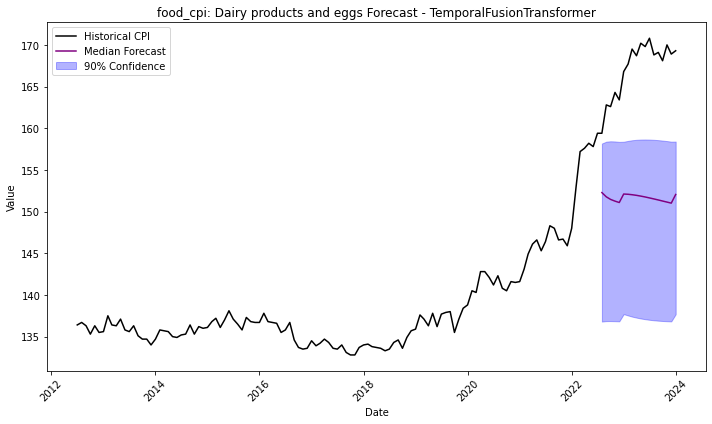

Beginning AutoGluon training... Time limit = 2s
AutoGluon will save models to './output/TEST/ag_global_all_TemporalFusionTransformerModel_exp2_R4_/random_seed_42/2022-07-01/model_files/'
=================== System Info ===================
AutoGluon Version:  1.1.1
Python Version:     3.8.20
Operating System:   Linux
Platform Machine:   x86_64
Platform Version:   #147~18.04.1-Ubuntu SMP Sat Oct 15 13:10:18 UTC 2022
CPU Count:          32
GPU Count:          1
Memory Avail:       166.05 GB / 188.57 GB (88.1%)
Disk Space Avail:   18213.61 GB / 249006.62 GB (7.3%)

Fitting with arguments:
{'enable_ensemble': True,
 'eval_metric': MAPE,
 'excluded_model_types': ['DirectTabular', 'RecursiveTabular'],
 'hyperparameters': {'TemporalFusionTransformerModel': {}},
 'known_covariates_names': [],
 'num_val_windows': 1,
 'prediction_length': 18,
 'quantile_levels': [0.01, 0.05, 0.1, 0.25, 0.75, 0.9, 0.95, 0.99],
 'random_seed': 42,
 'refit_every_n_windows': 1,
 'refit_full': False,
 'skip_model_sele

TemporalFusionTransformerModel


	-5.3453       = Validation score (-MAPE)
	2.15    s     = Training runtime
	0.04    s     = Validation (prediction) runtime
Not fitting ensemble due to lack of time remaining. Time left: -0.3 seconds
Training complete. Models trained: ['TemporalFusionTransformer']
Total runtime: 2.23 s
Best model: TemporalFusionTransformer
Best model score: -5.3453
Model not specified in predict, will default to the model with the best validation score: TemporalFusionTransformer
Model not specified in predict, will default to the model with the best validation score: TemporalFusionTransformer


****************** Summary of fit() ******************
Estimated performance of each model:
                       model  score_val  pred_time_val  fit_time_marginal  \
0  TemporalFusionTransformer  -5.345291       0.044166           2.152044   

   fit_order  
0          1  
Number of models trained: 1
Types of models trained:
{'MultiWindowBacktestingModel'}
****************** End of fit() summary ******************


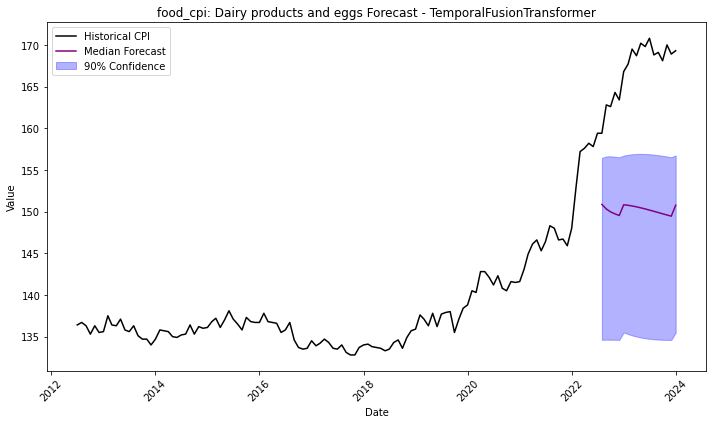

Beginning AutoGluon training... Time limit = 2s
AutoGluon will save models to './output/TEST/ag_global_all_TemporalFusionTransformerModel_exp2_R1_/random_seed_42/2022-07-01/model_files/'
=================== System Info ===================
AutoGluon Version:  1.1.1
Python Version:     3.8.20
Operating System:   Linux
Platform Machine:   x86_64
Platform Version:   #147~18.04.1-Ubuntu SMP Sat Oct 15 13:10:18 UTC 2022
CPU Count:          32
GPU Count:          1
Memory Avail:       166.05 GB / 188.57 GB (88.1%)
Disk Space Avail:   18213.67 GB / 249006.62 GB (7.3%)

Fitting with arguments:
{'enable_ensemble': True,
 'eval_metric': MAPE,
 'excluded_model_types': ['DirectTabular', 'RecursiveTabular'],
 'hyperparameters': {'TemporalFusionTransformerModel': {}},
 'known_covariates_names': [],
 'num_val_windows': 1,
 'prediction_length': 18,
 'quantile_levels': [0.01, 0.05, 0.1, 0.25, 0.75, 0.9, 0.95, 0.99],
 'random_seed': 42,
 'refit_every_n_windows': 1,
 'refit_full': False,
 'skip_model_sele

TemporalFusionTransformerModel


	-5.7893       = Validation score (-MAPE)
	2.13    s     = Training runtime
	0.04    s     = Validation (prediction) runtime
Not fitting ensemble due to lack of time remaining. Time left: -0.3 seconds
Training complete. Models trained: ['TemporalFusionTransformer']
Total runtime: 2.21 s
Best model: TemporalFusionTransformer
Best model score: -5.7893
Model not specified in predict, will default to the model with the best validation score: TemporalFusionTransformer
Model not specified in predict, will default to the model with the best validation score: TemporalFusionTransformer


****************** Summary of fit() ******************
Estimated performance of each model:
                       model  score_val  pred_time_val  fit_time_marginal  \
0  TemporalFusionTransformer  -5.789307       0.043796           2.126549   

   fit_order  
0          1  
Number of models trained: 1
Types of models trained:
{'MultiWindowBacktestingModel'}
****************** End of fit() summary ******************


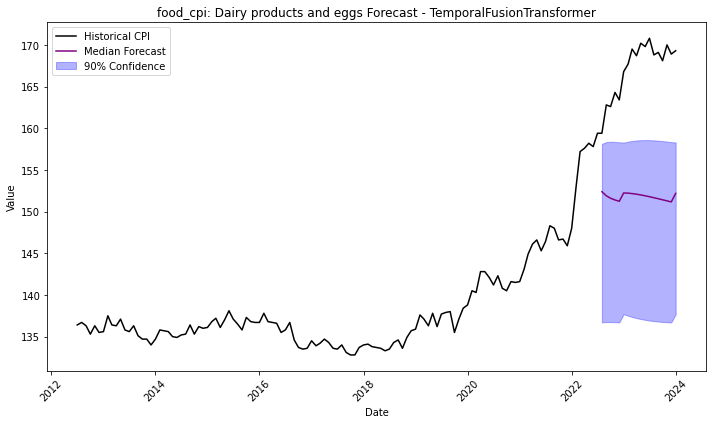

Beginning AutoGluon training... Time limit = 2s
AutoGluon will save models to './output/TEST/ag_global_all_TemporalFusionTransformerModel_exp2_R2_/random_seed_42/2022-07-01/model_files/'
=================== System Info ===================
AutoGluon Version:  1.1.1
Python Version:     3.8.20
Operating System:   Linux
Platform Machine:   x86_64
Platform Version:   #147~18.04.1-Ubuntu SMP Sat Oct 15 13:10:18 UTC 2022
CPU Count:          32
GPU Count:          1
Memory Avail:       166.05 GB / 188.57 GB (88.1%)
Disk Space Avail:   18213.66 GB / 249006.62 GB (7.3%)

Fitting with arguments:
{'enable_ensemble': True,
 'eval_metric': MAPE,
 'excluded_model_types': ['DirectTabular', 'RecursiveTabular'],
 'hyperparameters': {'TemporalFusionTransformerModel': {}},
 'known_covariates_names': [],
 'num_val_windows': 1,
 'prediction_length': 18,
 'quantile_levels': [0.01, 0.05, 0.1, 0.25, 0.75, 0.9, 0.95, 0.99],
 'random_seed': 42,
 'refit_every_n_windows': 1,
 'refit_full': False,
 'skip_model_sele

TemporalFusionTransformerModel


	-0.5577       = Validation score (-MAPE)
	2.13    s     = Training runtime
	0.39    s     = Validation (prediction) runtime
Not fitting ensemble due to lack of time remaining. Time left: -0.6 seconds
Training complete. Models trained: ['TemporalFusionTransformer']
Total runtime: 2.56 s
Best model: TemporalFusionTransformer
Best model score: -0.5577
Model not specified in predict, will default to the model with the best validation score: TemporalFusionTransformer
Model not specified in predict, will default to the model with the best validation score: TemporalFusionTransformer


****************** Summary of fit() ******************
Estimated performance of each model:
                       model  score_val  pred_time_val  fit_time_marginal  \
0  TemporalFusionTransformer   -0.55771       0.393047           2.126943   

   fit_order  
0          1  
Number of models trained: 1
Types of models trained:
{'MultiWindowBacktestingModel'}
****************** End of fit() summary ******************


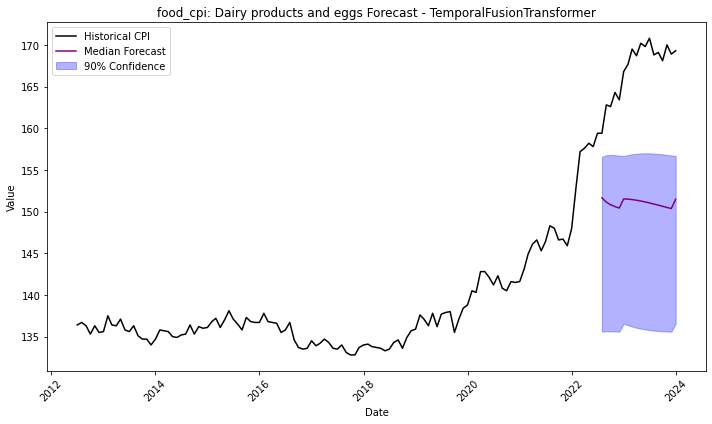

Beginning AutoGluon training... Time limit = 2s
AutoGluon will save models to './output/TEST/ag_global_all_TemporalFusionTransformerModel_exp2_GPT_P4_/random_seed_42/2022-07-01/model_files/'
=================== System Info ===================
AutoGluon Version:  1.1.1
Python Version:     3.8.20
Operating System:   Linux
Platform Machine:   x86_64
Platform Version:   #147~18.04.1-Ubuntu SMP Sat Oct 15 13:10:18 UTC 2022
CPU Count:          32
GPU Count:          1
Memory Avail:       166.05 GB / 188.57 GB (88.1%)
Disk Space Avail:   18213.65 GB / 249006.62 GB (7.3%)

Fitting with arguments:
{'enable_ensemble': True,
 'eval_metric': MAPE,
 'excluded_model_types': ['DirectTabular', 'RecursiveTabular'],
 'hyperparameters': {'TemporalFusionTransformerModel': {}},
 'known_covariates_names': [],
 'num_val_windows': 1,
 'prediction_length': 18,
 'quantile_levels': [0.01, 0.05, 0.1, 0.25, 0.75, 0.9, 0.95, 0.99],
 'random_seed': 42,
 'refit_every_n_windows': 1,
 'refit_full': False,
 'skip_model_

TemporalFusionTransformerModel


	-6.9764       = Validation score (-MAPE)
	2.13    s     = Training runtime
	0.04    s     = Validation (prediction) runtime
Not fitting ensemble due to lack of time remaining. Time left: -0.3 seconds
Training complete. Models trained: ['TemporalFusionTransformer']
Total runtime: 2.21 s
Best model: TemporalFusionTransformer
Best model score: -6.9764
Model not specified in predict, will default to the model with the best validation score: TemporalFusionTransformer
Model not specified in predict, will default to the model with the best validation score: TemporalFusionTransformer


****************** Summary of fit() ******************
Estimated performance of each model:
                       model  score_val  pred_time_val  fit_time_marginal  \
0  TemporalFusionTransformer  -6.976409       0.039936           2.129375   

   fit_order  
0          1  
Number of models trained: 1
Types of models trained:
{'MultiWindowBacktestingModel'}
****************** End of fit() summary ******************


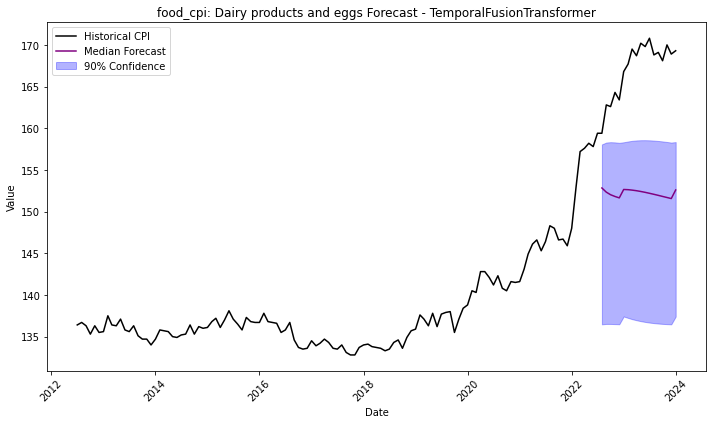

Beginning AutoGluon training... Time limit = 2s
AutoGluon will save models to './output/TEST/ag_global_all_TemporalFusionTransformerModel_exp2_R3_/random_seed_42/2023-07-01/model_files/'
=================== System Info ===================
AutoGluon Version:  1.1.1
Python Version:     3.8.20
Operating System:   Linux
Platform Machine:   x86_64
Platform Version:   #147~18.04.1-Ubuntu SMP Sat Oct 15 13:10:18 UTC 2022
CPU Count:          32
GPU Count:          1
Memory Avail:       166.05 GB / 188.57 GB (88.1%)
Disk Space Avail:   18213.63 GB / 249006.62 GB (7.3%)

Fitting with arguments:
{'enable_ensemble': True,
 'eval_metric': MAPE,
 'excluded_model_types': ['DirectTabular', 'RecursiveTabular'],
 'hyperparameters': {'TemporalFusionTransformerModel': {}},
 'known_covariates_names': [],
 'num_val_windows': 1,
 'prediction_length': 18,
 'quantile_levels': [0.01, 0.05, 0.1, 0.25, 0.75, 0.9, 0.95, 0.99],
 'random_seed': 42,
 'refit_every_n_windows': 1,
 'refit_full': False,
 'skip_model_sele

TemporalFusionTransformerModel


	-0.4642       = Validation score (-MAPE)
	2.14    s     = Training runtime
	0.04    s     = Validation (prediction) runtime
Not fitting ensemble due to lack of time remaining. Time left: -0.3 seconds
Training complete. Models trained: ['TemporalFusionTransformer']
Total runtime: 2.23 s
Best model: TemporalFusionTransformer
Best model score: -0.4642
Model not specified in predict, will default to the model with the best validation score: TemporalFusionTransformer
Model not specified in predict, will default to the model with the best validation score: TemporalFusionTransformer


****************** Summary of fit() ******************
Estimated performance of each model:
                       model  score_val  pred_time_val  fit_time_marginal  \
0  TemporalFusionTransformer  -0.464162       0.044302           2.142003   

   fit_order  
0          1  
Number of models trained: 1
Types of models trained:
{'MultiWindowBacktestingModel'}
****************** End of fit() summary ******************


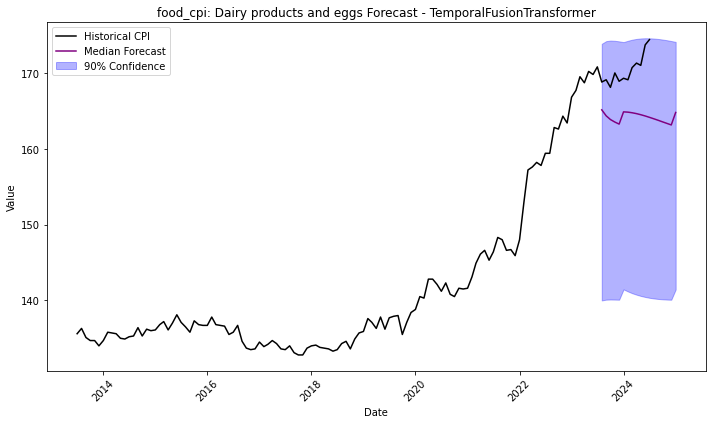

Beginning AutoGluon training... Time limit = 2s
AutoGluon will save models to './output/TEST/ag_global_all_TemporalFusionTransformerModel_exp2_GPT_P1_/random_seed_42/2023-07-01/model_files/'
=================== System Info ===================
AutoGluon Version:  1.1.1
Python Version:     3.8.20
Operating System:   Linux
Platform Machine:   x86_64
Platform Version:   #147~18.04.1-Ubuntu SMP Sat Oct 15 13:10:18 UTC 2022
CPU Count:          32
GPU Count:          1
Memory Avail:       166.07 GB / 188.57 GB (88.1%)
Disk Space Avail:   18213.62 GB / 249006.62 GB (7.3%)

Fitting with arguments:
{'enable_ensemble': True,
 'eval_metric': MAPE,
 'excluded_model_types': ['DirectTabular', 'RecursiveTabular'],
 'hyperparameters': {'TemporalFusionTransformerModel': {}},
 'known_covariates_names': [],
 'num_val_windows': 1,
 'prediction_length': 18,
 'quantile_levels': [0.01, 0.05, 0.1, 0.25, 0.75, 0.9, 0.95, 0.99],
 'random_seed': 42,
 'refit_every_n_windows': 1,
 'refit_full': False,
 'skip_model_

TemporalFusionTransformerModel


	-0.7082       = Validation score (-MAPE)
	2.13    s     = Training runtime
	0.04    s     = Validation (prediction) runtime
Not fitting ensemble due to lack of time remaining. Time left: -0.3 seconds
Training complete. Models trained: ['TemporalFusionTransformer']
Total runtime: 2.21 s
Best model: TemporalFusionTransformer
Best model score: -0.7082
Model not specified in predict, will default to the model with the best validation score: TemporalFusionTransformer
Model not specified in predict, will default to the model with the best validation score: TemporalFusionTransformer


****************** Summary of fit() ******************
Estimated performance of each model:
                       model  score_val  pred_time_val  fit_time_marginal  \
0  TemporalFusionTransformer  -0.708159       0.043559           2.130687   

   fit_order  
0          1  
Number of models trained: 1
Types of models trained:
{'MultiWindowBacktestingModel'}
****************** End of fit() summary ******************


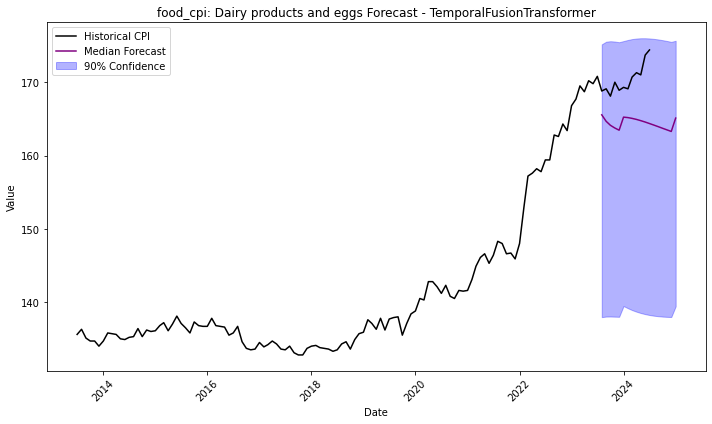

Beginning AutoGluon training... Time limit = 2s
AutoGluon will save models to './output/TEST/ag_global_all_TemporalFusionTransformerModel_exp2_GPT_P3_/random_seed_42/2023-07-01/model_files/'
=================== System Info ===================
AutoGluon Version:  1.1.1
Python Version:     3.8.20
Operating System:   Linux
Platform Machine:   x86_64
Platform Version:   #147~18.04.1-Ubuntu SMP Sat Oct 15 13:10:18 UTC 2022
CPU Count:          32
GPU Count:          1
Memory Avail:       166.07 GB / 188.57 GB (88.1%)
Disk Space Avail:   18213.67 GB / 249006.62 GB (7.3%)

Fitting with arguments:
{'enable_ensemble': True,
 'eval_metric': MAPE,
 'excluded_model_types': ['DirectTabular', 'RecursiveTabular'],
 'hyperparameters': {'TemporalFusionTransformerModel': {}},
 'known_covariates_names': [],
 'num_val_windows': 1,
 'prediction_length': 18,
 'quantile_levels': [0.01, 0.05, 0.1, 0.25, 0.75, 0.9, 0.95, 0.99],
 'random_seed': 42,
 'refit_every_n_windows': 1,
 'refit_full': False,
 'skip_model_

TemporalFusionTransformerModel


	-1.0726       = Validation score (-MAPE)
	2.21    s     = Training runtime
	0.05    s     = Validation (prediction) runtime
Not fitting ensemble due to lack of time remaining. Time left: -0.4 seconds
Training complete. Models trained: ['TemporalFusionTransformer']
Total runtime: 2.30 s
Best model: TemporalFusionTransformer
Best model score: -1.0726
Model not specified in predict, will default to the model with the best validation score: TemporalFusionTransformer
Model not specified in predict, will default to the model with the best validation score: TemporalFusionTransformer


****************** Summary of fit() ******************
Estimated performance of each model:
                       model  score_val  pred_time_val  fit_time_marginal  \
0  TemporalFusionTransformer  -1.072602        0.04683           2.209722   

   fit_order  
0          1  
Number of models trained: 1
Types of models trained:
{'MultiWindowBacktestingModel'}
****************** End of fit() summary ******************


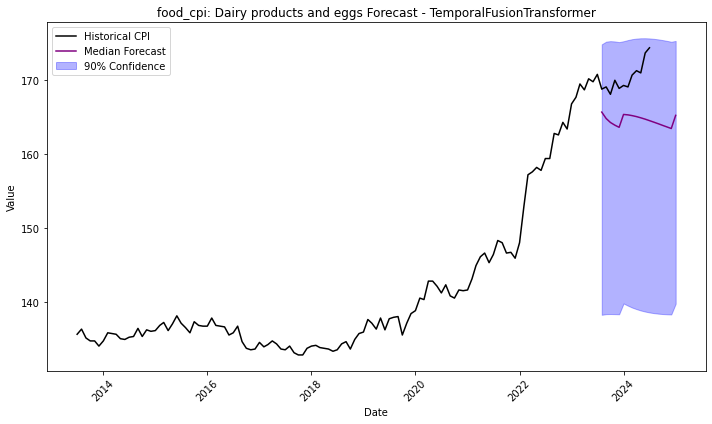

Beginning AutoGluon training... Time limit = 2s
AutoGluon will save models to './output/TEST/ag_global_all_TemporalFusionTransformerModel_exp2_GPT_P2_/random_seed_42/2023-07-01/model_files/'
=================== System Info ===================
AutoGluon Version:  1.1.1
Python Version:     3.8.20
Operating System:   Linux
Platform Machine:   x86_64
Platform Version:   #147~18.04.1-Ubuntu SMP Sat Oct 15 13:10:18 UTC 2022
CPU Count:          32
GPU Count:          1
Memory Avail:       166.07 GB / 188.57 GB (88.1%)
Disk Space Avail:   18213.65 GB / 249006.62 GB (7.3%)

Fitting with arguments:
{'enable_ensemble': True,
 'eval_metric': MAPE,
 'excluded_model_types': ['DirectTabular', 'RecursiveTabular'],
 'hyperparameters': {'TemporalFusionTransformerModel': {}},
 'known_covariates_names': [],
 'num_val_windows': 1,
 'prediction_length': 18,
 'quantile_levels': [0.01, 0.05, 0.1, 0.25, 0.75, 0.9, 0.95, 0.99],
 'random_seed': 42,
 'refit_every_n_windows': 1,
 'refit_full': False,
 'skip_model_

TemporalFusionTransformerModel


	-0.6453       = Validation score (-MAPE)
	2.14    s     = Training runtime
	0.04    s     = Validation (prediction) runtime
Not fitting ensemble due to lack of time remaining. Time left: -0.3 seconds
Training complete. Models trained: ['TemporalFusionTransformer']
Total runtime: 2.23 s
Best model: TemporalFusionTransformer
Best model score: -0.6453
Model not specified in predict, will default to the model with the best validation score: TemporalFusionTransformer
Model not specified in predict, will default to the model with the best validation score: TemporalFusionTransformer


****************** Summary of fit() ******************
Estimated performance of each model:
                       model  score_val  pred_time_val  fit_time_marginal  \
0  TemporalFusionTransformer  -0.645308       0.043055           2.140083   

   fit_order  
0          1  
Number of models trained: 1
Types of models trained:
{'MultiWindowBacktestingModel'}
****************** End of fit() summary ******************


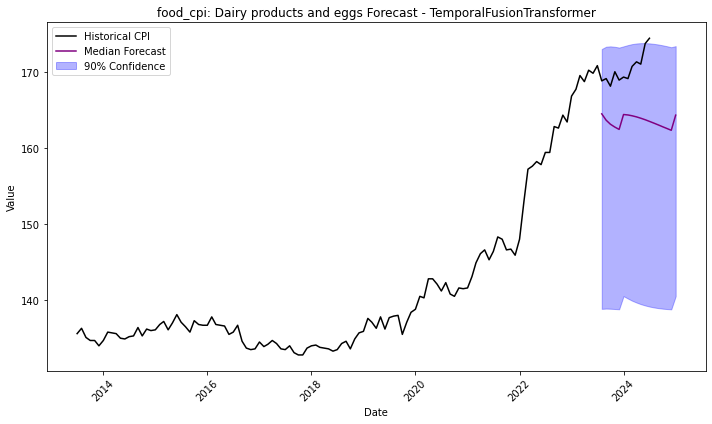

Beginning AutoGluon training... Time limit = 2s
AutoGluon will save models to './output/TEST/ag_global_all_TemporalFusionTransformerModel_exp2_R4_/random_seed_42/2023-07-01/model_files/'
=================== System Info ===================
AutoGluon Version:  1.1.1
Python Version:     3.8.20
Operating System:   Linux
Platform Machine:   x86_64
Platform Version:   #147~18.04.1-Ubuntu SMP Sat Oct 15 13:10:18 UTC 2022
CPU Count:          32
GPU Count:          1
Memory Avail:       166.06 GB / 188.57 GB (88.1%)
Disk Space Avail:   18213.64 GB / 249006.62 GB (7.3%)

Fitting with arguments:
{'enable_ensemble': True,
 'eval_metric': MAPE,
 'excluded_model_types': ['DirectTabular', 'RecursiveTabular'],
 'hyperparameters': {'TemporalFusionTransformerModel': {}},
 'known_covariates_names': [],
 'num_val_windows': 1,
 'prediction_length': 18,
 'quantile_levels': [0.01, 0.05, 0.1, 0.25, 0.75, 0.9, 0.95, 0.99],
 'random_seed': 42,
 'refit_every_n_windows': 1,
 'refit_full': False,
 'skip_model_sele

TemporalFusionTransformerModel


Inferred time series frequency: 'MS'
Provided train_data has 9922 rows, 22 time series. Median time series length is 451 (min=451, max=451). 

Provided data contains following columns:
	target: 'target'

AutoGluon will gauge predictive performance using evaluation metric: 'MAPE'
	This metric's sign has been flipped to adhere to being higher_is_better. The metric score can be multiplied by -1 to get the metric value.

Starting training. Start time is 2024-10-27 07:33:03
Excluded model types: ['DirectTabular', 'RecursiveTabular']
Models that will be trained: ['TemporalFusionTransformer']
Training timeseries model TemporalFusionTransformer. Training for up to 1.6s of the 1.6s of remaining time.
	-0.8027       = Validation score (-MAPE)
	1.85    s     = Training runtime
	0.04    s     = Validation (prediction) runtime
Not fitting ensemble due to lack of time remaining. Time left: -0.3 seconds
Training complete. Models trained: ['TemporalFusionTransformer']
Total runtime: 1.94 s
Best model:

****************** Summary of fit() ******************
Estimated performance of each model:
                       model  score_val  pred_time_val  fit_time_marginal  \
0  TemporalFusionTransformer  -0.802713       0.043927           1.854059   

   fit_order  
0          1  
Number of models trained: 1
Types of models trained:
{'MultiWindowBacktestingModel'}
****************** End of fit() summary ******************


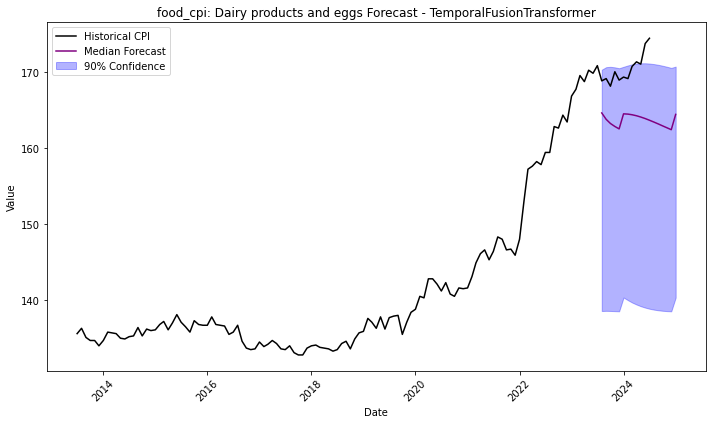

Beginning AutoGluon training... Time limit = 2s
AutoGluon will save models to './output/TEST/ag_global_all_TemporalFusionTransformerModel_exp2_R1_/random_seed_42/2023-07-01/model_files/'
=================== System Info ===================
AutoGluon Version:  1.1.1
Python Version:     3.8.20
Operating System:   Linux
Platform Machine:   x86_64
Platform Version:   #147~18.04.1-Ubuntu SMP Sat Oct 15 13:10:18 UTC 2022
CPU Count:          32
GPU Count:          1
Memory Avail:       166.07 GB / 188.57 GB (88.1%)
Disk Space Avail:   18213.63 GB / 249006.62 GB (7.3%)

Fitting with arguments:
{'enable_ensemble': True,
 'eval_metric': MAPE,
 'excluded_model_types': ['DirectTabular', 'RecursiveTabular'],
 'hyperparameters': {'TemporalFusionTransformerModel': {}},
 'known_covariates_names': [],
 'num_val_windows': 1,
 'prediction_length': 18,
 'quantile_levels': [0.01, 0.05, 0.1, 0.25, 0.75, 0.9, 0.95, 0.99],
 'random_seed': 42,
 'refit_every_n_windows': 1,
 'refit_full': False,
 'skip_model_sele

TemporalFusionTransformerModel


	-0.9923       = Validation score (-MAPE)
	2.13    s     = Training runtime
	0.04    s     = Validation (prediction) runtime
Not fitting ensemble due to lack of time remaining. Time left: -0.3 seconds
Training complete. Models trained: ['TemporalFusionTransformer']
Total runtime: 2.21 s
Best model: TemporalFusionTransformer
Best model score: -0.9923
Model not specified in predict, will default to the model with the best validation score: TemporalFusionTransformer
Model not specified in predict, will default to the model with the best validation score: TemporalFusionTransformer


****************** Summary of fit() ******************
Estimated performance of each model:
                       model  score_val  pred_time_val  fit_time_marginal  \
0  TemporalFusionTransformer  -0.992332       0.044712           2.126869   

   fit_order  
0          1  
Number of models trained: 1
Types of models trained:
{'MultiWindowBacktestingModel'}
****************** End of fit() summary ******************


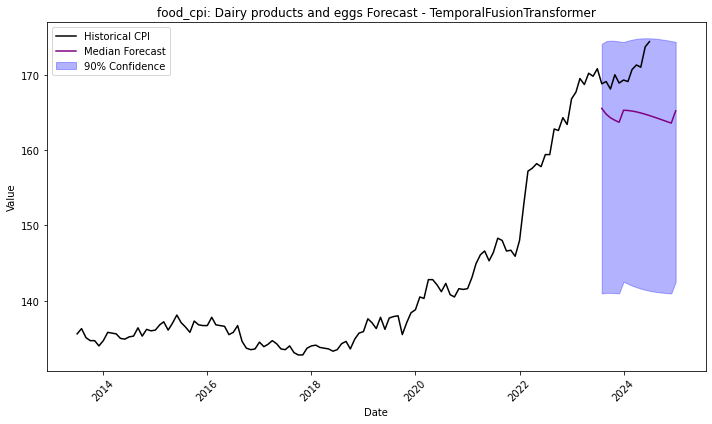

Beginning AutoGluon training... Time limit = 2s
AutoGluon will save models to './output/TEST/ag_global_all_TemporalFusionTransformerModel_exp2_R2_/random_seed_42/2023-07-01/model_files/'
=================== System Info ===================
AutoGluon Version:  1.1.1
Python Version:     3.8.20
Operating System:   Linux
Platform Machine:   x86_64
Platform Version:   #147~18.04.1-Ubuntu SMP Sat Oct 15 13:10:18 UTC 2022
CPU Count:          32
GPU Count:          1
Memory Avail:       166.07 GB / 188.57 GB (88.1%)
Disk Space Avail:   18213.62 GB / 249006.62 GB (7.3%)

Fitting with arguments:
{'enable_ensemble': True,
 'eval_metric': MAPE,
 'excluded_model_types': ['DirectTabular', 'RecursiveTabular'],
 'hyperparameters': {'TemporalFusionTransformerModel': {}},
 'known_covariates_names': [],
 'num_val_windows': 1,
 'prediction_length': 18,
 'quantile_levels': [0.01, 0.05, 0.1, 0.25, 0.75, 0.9, 0.95, 0.99],
 'random_seed': 42,
 'refit_every_n_windows': 1,
 'refit_full': False,
 'skip_model_sele

TemporalFusionTransformerModel


	-0.5326       = Validation score (-MAPE)
	2.14    s     = Training runtime
	0.04    s     = Validation (prediction) runtime
Not fitting ensemble due to lack of time remaining. Time left: -0.3 seconds
Training complete. Models trained: ['TemporalFusionTransformer']
Total runtime: 2.23 s
Best model: TemporalFusionTransformer
Best model score: -0.5326
Model not specified in predict, will default to the model with the best validation score: TemporalFusionTransformer
Model not specified in predict, will default to the model with the best validation score: TemporalFusionTransformer


****************** Summary of fit() ******************
Estimated performance of each model:
                       model  score_val  pred_time_val  fit_time_marginal  \
0  TemporalFusionTransformer  -0.532563       0.044812           2.143553   

   fit_order  
0          1  
Number of models trained: 1
Types of models trained:
{'MultiWindowBacktestingModel'}
****************** End of fit() summary ******************


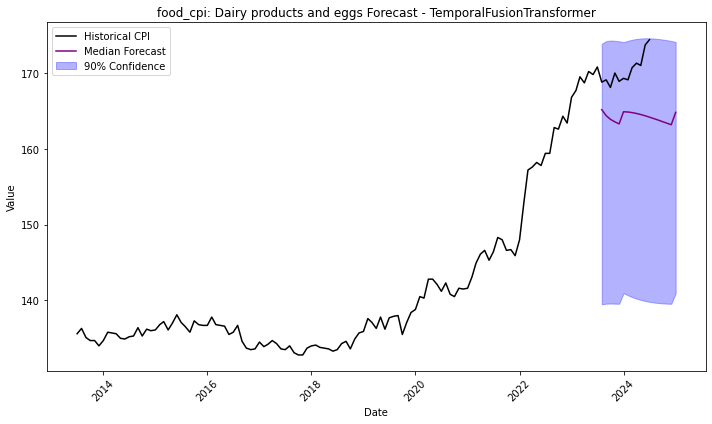

Beginning AutoGluon training... Time limit = 2s
AutoGluon will save models to './output/TEST/ag_global_all_TemporalFusionTransformerModel_exp2_GPT_P4_/random_seed_42/2023-07-01/model_files/'
=================== System Info ===================
AutoGluon Version:  1.1.1
Python Version:     3.8.20
Operating System:   Linux
Platform Machine:   x86_64
Platform Version:   #147~18.04.1-Ubuntu SMP Sat Oct 15 13:10:18 UTC 2022
CPU Count:          32
GPU Count:          1
Memory Avail:       166.07 GB / 188.57 GB (88.1%)
Disk Space Avail:   18213.61 GB / 249006.62 GB (7.3%)

Fitting with arguments:
{'enable_ensemble': True,
 'eval_metric': MAPE,
 'excluded_model_types': ['DirectTabular', 'RecursiveTabular'],
 'hyperparameters': {'TemporalFusionTransformerModel': {}},
 'known_covariates_names': [],
 'num_val_windows': 1,
 'prediction_length': 18,
 'quantile_levels': [0.01, 0.05, 0.1, 0.25, 0.75, 0.9, 0.95, 0.99],
 'random_seed': 42,
 'refit_every_n_windows': 1,
 'refit_full': False,
 'skip_model_

TemporalFusionTransformerModel


	-1.0072       = Validation score (-MAPE)
	2.17    s     = Training runtime
	0.04    s     = Validation (prediction) runtime
Not fitting ensemble due to lack of time remaining. Time left: -0.3 seconds
Training complete. Models trained: ['TemporalFusionTransformer']
Total runtime: 2.25 s
Best model: TemporalFusionTransformer
Best model score: -1.0072
Model not specified in predict, will default to the model with the best validation score: TemporalFusionTransformer
Model not specified in predict, will default to the model with the best validation score: TemporalFusionTransformer


****************** Summary of fit() ******************
Estimated performance of each model:
                       model  score_val  pred_time_val  fit_time_marginal  \
0  TemporalFusionTransformer  -1.007199       0.039643           2.165328   

   fit_order  
0          1  
Number of models trained: 1
Types of models trained:
{'MultiWindowBacktestingModel'}
****************** End of fit() summary ******************


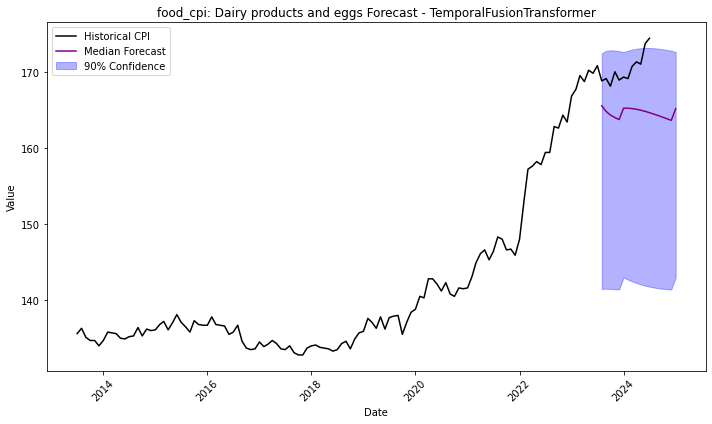

Beginning AutoGluon training... Time limit = 2s
AutoGluon will save models to './output/TEST/ag_global_all_TemporalFusionTransformerModel_exp2_R2_/random_seed_42/2018-07-01/model_files/'
=================== System Info ===================
AutoGluon Version:  1.1.1
Python Version:     3.8.20
Operating System:   Linux
Platform Machine:   x86_64
Platform Version:   #147~18.04.1-Ubuntu SMP Sat Oct 15 13:10:18 UTC 2022
CPU Count:          32
GPU Count:          1
Memory Avail:       166.07 GB / 188.57 GB (88.1%)
Disk Space Avail:   18213.66 GB / 249006.62 GB (7.3%)

Fitting with arguments:
{'enable_ensemble': True,
 'eval_metric': MAPE,
 'excluded_model_types': ['DirectTabular', 'RecursiveTabular'],
 'hyperparameters': {'TemporalFusionTransformerModel': {}},
 'known_covariates_names': [],
 'num_val_windows': 1,
 'prediction_length': 18,
 'quantile_levels': [0.01, 0.05, 0.1, 0.25, 0.75, 0.9, 0.95, 0.99],
 'random_seed': 42,
 'refit_every_n_windows': 1,
 'refit_full': False,
 'skip_model_sele

TemporalFusionTransformerModel


	-0.7255       = Validation score (-MAPE)
	2.13    s     = Training runtime
	0.04    s     = Validation (prediction) runtime
Not fitting ensemble due to lack of time remaining. Time left: -0.3 seconds
Training complete. Models trained: ['TemporalFusionTransformer']
Total runtime: 2.21 s
Best model: TemporalFusionTransformer
Best model score: -0.7255
Model not specified in predict, will default to the model with the best validation score: TemporalFusionTransformer
Model not specified in predict, will default to the model with the best validation score: TemporalFusionTransformer


****************** Summary of fit() ******************
Estimated performance of each model:
                       model  score_val  pred_time_val  fit_time_marginal  \
0  TemporalFusionTransformer  -0.725474       0.040892            2.13216   

   fit_order  
0          1  
Number of models trained: 1
Types of models trained:
{'MultiWindowBacktestingModel'}
****************** End of fit() summary ******************


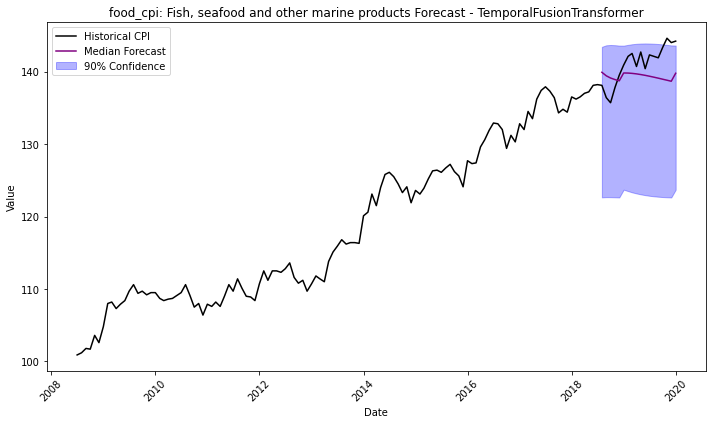

Beginning AutoGluon training... Time limit = 2s
AutoGluon will save models to './output/TEST/ag_global_all_TemporalFusionTransformerModel_exp2_R4_/random_seed_42/2018-07-01/model_files/'
=================== System Info ===================
AutoGluon Version:  1.1.1
Python Version:     3.8.20
Operating System:   Linux
Platform Machine:   x86_64
Platform Version:   #147~18.04.1-Ubuntu SMP Sat Oct 15 13:10:18 UTC 2022
CPU Count:          32
GPU Count:          1
Memory Avail:       166.07 GB / 188.57 GB (88.1%)
Disk Space Avail:   18213.66 GB / 249006.62 GB (7.3%)

Fitting with arguments:
{'enable_ensemble': True,
 'eval_metric': MAPE,
 'excluded_model_types': ['DirectTabular', 'RecursiveTabular'],
 'hyperparameters': {'TemporalFusionTransformerModel': {}},
 'known_covariates_names': [],
 'num_val_windows': 1,
 'prediction_length': 18,
 'quantile_levels': [0.01, 0.05, 0.1, 0.25, 0.75, 0.9, 0.95, 0.99],
 'random_seed': 42,
 'refit_every_n_windows': 1,
 'refit_full': False,
 'skip_model_sele

TemporalFusionTransformerModel


	-1.2519       = Validation score (-MAPE)
	2.13    s     = Training runtime
	0.04    s     = Validation (prediction) runtime
Not fitting ensemble due to lack of time remaining. Time left: -0.3 seconds
Training complete. Models trained: ['TemporalFusionTransformer']
Total runtime: 2.21 s
Best model: TemporalFusionTransformer
Best model score: -1.2519
Model not specified in predict, will default to the model with the best validation score: TemporalFusionTransformer
Model not specified in predict, will default to the model with the best validation score: TemporalFusionTransformer


****************** Summary of fit() ******************
Estimated performance of each model:
                       model  score_val  pred_time_val  fit_time_marginal  \
0  TemporalFusionTransformer  -1.251856       0.043737           2.131026   

   fit_order  
0          1  
Number of models trained: 1
Types of models trained:
{'MultiWindowBacktestingModel'}
****************** End of fit() summary ******************


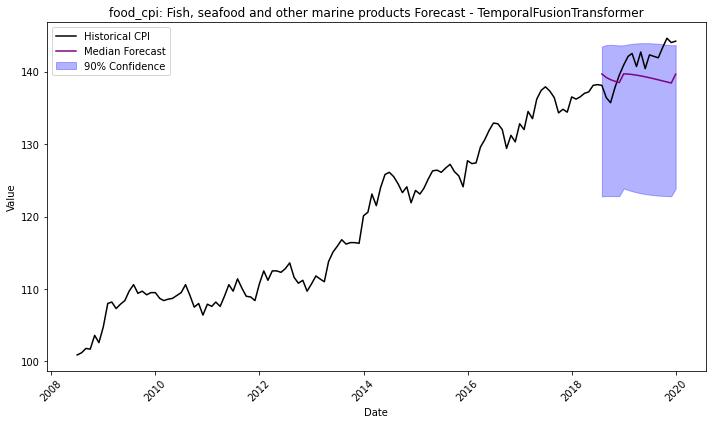

Beginning AutoGluon training... Time limit = 2s
AutoGluon will save models to './output/TEST/ag_global_all_TemporalFusionTransformerModel_exp2_GPT_P1_/random_seed_42/2018-07-01/model_files/'
=================== System Info ===================
AutoGluon Version:  1.1.1
Python Version:     3.8.20
Operating System:   Linux
Platform Machine:   x86_64
Platform Version:   #147~18.04.1-Ubuntu SMP Sat Oct 15 13:10:18 UTC 2022
CPU Count:          32
GPU Count:          1
Memory Avail:       166.19 GB / 188.57 GB (88.1%)
Disk Space Avail:   18213.65 GB / 249006.62 GB (7.3%)

Fitting with arguments:
{'enable_ensemble': True,
 'eval_metric': MAPE,
 'excluded_model_types': ['DirectTabular', 'RecursiveTabular'],
 'hyperparameters': {'TemporalFusionTransformerModel': {}},
 'known_covariates_names': [],
 'num_val_windows': 1,
 'prediction_length': 18,
 'quantile_levels': [0.01, 0.05, 0.1, 0.25, 0.75, 0.9, 0.95, 0.99],
 'random_seed': 42,
 'refit_every_n_windows': 1,
 'refit_full': False,
 'skip_model_

TemporalFusionTransformerModel


	-2.6713       = Validation score (-MAPE)
	2.14    s     = Training runtime
	0.05    s     = Validation (prediction) runtime
Not fitting ensemble due to lack of time remaining. Time left: -0.3 seconds
Training complete. Models trained: ['TemporalFusionTransformer']
Total runtime: 2.22 s
Best model: TemporalFusionTransformer
Best model score: -2.6713
Model not specified in predict, will default to the model with the best validation score: TemporalFusionTransformer
Model not specified in predict, will default to the model with the best validation score: TemporalFusionTransformer


****************** Summary of fit() ******************
Estimated performance of each model:
                       model  score_val  pred_time_val  fit_time_marginal  \
0  TemporalFusionTransformer    -2.6713       0.045634           2.137842   

   fit_order  
0          1  
Number of models trained: 1
Types of models trained:
{'MultiWindowBacktestingModel'}
****************** End of fit() summary ******************


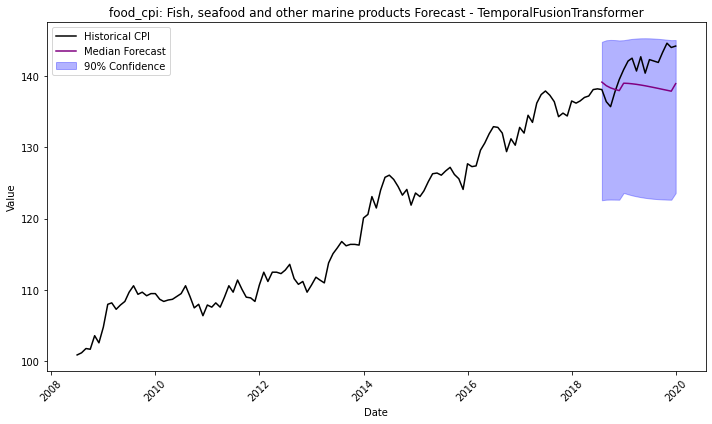

Beginning AutoGluon training... Time limit = 2s
AutoGluon will save models to './output/TEST/ag_global_all_TemporalFusionTransformerModel_exp2_R3_/random_seed_42/2018-07-01/model_files/'
=================== System Info ===================
AutoGluon Version:  1.1.1
Python Version:     3.8.20
Operating System:   Linux
Platform Machine:   x86_64
Platform Version:   #147~18.04.1-Ubuntu SMP Sat Oct 15 13:10:18 UTC 2022
CPU Count:          32
GPU Count:          1
Memory Avail:       166.14 GB / 188.57 GB (88.1%)
Disk Space Avail:   18213.64 GB / 249006.62 GB (7.3%)

Fitting with arguments:
{'enable_ensemble': True,
 'eval_metric': MAPE,
 'excluded_model_types': ['DirectTabular', 'RecursiveTabular'],
 'hyperparameters': {'TemporalFusionTransformerModel': {}},
 'known_covariates_names': [],
 'num_val_windows': 1,
 'prediction_length': 18,
 'quantile_levels': [0.01, 0.05, 0.1, 0.25, 0.75, 0.9, 0.95, 0.99],
 'random_seed': 42,
 'refit_every_n_windows': 1,
 'refit_full': False,
 'skip_model_sele

TemporalFusionTransformerModel


	-1.7939       = Validation score (-MAPE)
	2.13    s     = Training runtime
	0.04    s     = Validation (prediction) runtime
Not fitting ensemble due to lack of time remaining. Time left: -0.3 seconds
Training complete. Models trained: ['TemporalFusionTransformer']
Total runtime: 2.22 s
Best model: TemporalFusionTransformer
Best model score: -1.7939
Model not specified in predict, will default to the model with the best validation score: TemporalFusionTransformer
Model not specified in predict, will default to the model with the best validation score: TemporalFusionTransformer


****************** Summary of fit() ******************
Estimated performance of each model:
                       model  score_val  pred_time_val  fit_time_marginal  \
0  TemporalFusionTransformer  -1.793923       0.043079           2.134926   

   fit_order  
0          1  
Number of models trained: 1
Types of models trained:
{'MultiWindowBacktestingModel'}
****************** End of fit() summary ******************


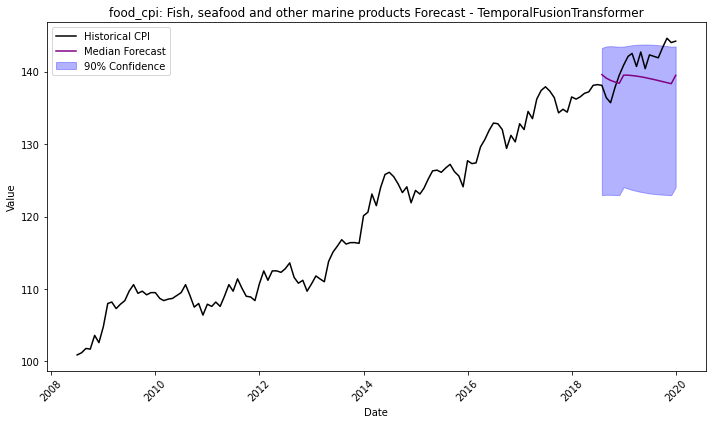

Beginning AutoGluon training... Time limit = 2s
AutoGluon will save models to './output/TEST/ag_global_all_TemporalFusionTransformerModel_exp2_GPT_P4_/random_seed_42/2018-07-01/model_files/'
=================== System Info ===================
AutoGluon Version:  1.1.1
Python Version:     3.8.20
Operating System:   Linux
Platform Machine:   x86_64
Platform Version:   #147~18.04.1-Ubuntu SMP Sat Oct 15 13:10:18 UTC 2022
CPU Count:          32
GPU Count:          1
Memory Avail:       166.06 GB / 188.57 GB (88.1%)
Disk Space Avail:   18213.34 GB / 249006.62 GB (7.3%)

Fitting with arguments:
{'enable_ensemble': True,
 'eval_metric': MAPE,
 'excluded_model_types': ['DirectTabular', 'RecursiveTabular'],
 'hyperparameters': {'TemporalFusionTransformerModel': {}},
 'known_covariates_names': [],
 'num_val_windows': 1,
 'prediction_length': 18,
 'quantile_levels': [0.01, 0.05, 0.1, 0.25, 0.75, 0.9, 0.95, 0.99],
 'random_seed': 42,
 'refit_every_n_windows': 1,
 'refit_full': False,
 'skip_model_

TemporalFusionTransformerModel


	-1.8038       = Validation score (-MAPE)
	2.13    s     = Training runtime
	0.04    s     = Validation (prediction) runtime
Not fitting ensemble due to lack of time remaining. Time left: -0.3 seconds
Training complete. Models trained: ['TemporalFusionTransformer']
Total runtime: 2.22 s
Best model: TemporalFusionTransformer
Best model score: -1.8038
Model not specified in predict, will default to the model with the best validation score: TemporalFusionTransformer
Model not specified in predict, will default to the model with the best validation score: TemporalFusionTransformer


****************** Summary of fit() ******************
Estimated performance of each model:
                       model  score_val  pred_time_val  fit_time_marginal  \
0  TemporalFusionTransformer  -1.803769       0.038521           2.132163   

   fit_order  
0          1  
Number of models trained: 1
Types of models trained:
{'MultiWindowBacktestingModel'}
****************** End of fit() summary ******************


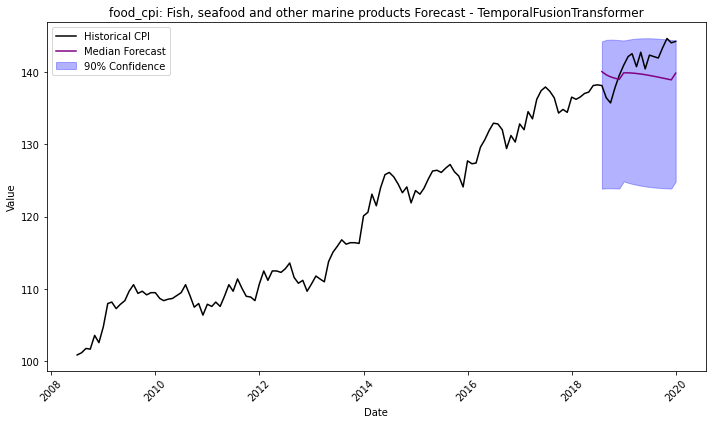

Beginning AutoGluon training... Time limit = 2s
AutoGluon will save models to './output/TEST/ag_global_all_TemporalFusionTransformerModel_exp2_R1_/random_seed_42/2018-07-01/model_files/'
=================== System Info ===================
AutoGluon Version:  1.1.1
Python Version:     3.8.20
Operating System:   Linux
Platform Machine:   x86_64
Platform Version:   #147~18.04.1-Ubuntu SMP Sat Oct 15 13:10:18 UTC 2022
CPU Count:          32
GPU Count:          1
Memory Avail:       166.06 GB / 188.57 GB (88.1%)
Disk Space Avail:   18212.49 GB / 249006.62 GB (7.3%)

Fitting with arguments:
{'enable_ensemble': True,
 'eval_metric': MAPE,
 'excluded_model_types': ['DirectTabular', 'RecursiveTabular'],
 'hyperparameters': {'TemporalFusionTransformerModel': {}},
 'known_covariates_names': [],
 'num_val_windows': 1,
 'prediction_length': 18,
 'quantile_levels': [0.01, 0.05, 0.1, 0.25, 0.75, 0.9, 0.95, 0.99],
 'random_seed': 42,
 'refit_every_n_windows': 1,
 'refit_full': False,
 'skip_model_sele

TemporalFusionTransformerModel


	-1.1255       = Validation score (-MAPE)
	2.12    s     = Training runtime
	0.04    s     = Validation (prediction) runtime
Not fitting ensemble due to lack of time remaining. Time left: -0.3 seconds
Training complete. Models trained: ['TemporalFusionTransformer']
Total runtime: 2.20 s
Best model: TemporalFusionTransformer
Best model score: -1.1255
Model not specified in predict, will default to the model with the best validation score: TemporalFusionTransformer
Model not specified in predict, will default to the model with the best validation score: TemporalFusionTransformer


****************** Summary of fit() ******************
Estimated performance of each model:
                       model  score_val  pred_time_val  fit_time_marginal  \
0  TemporalFusionTransformer  -1.125451        0.04255           2.124043   

   fit_order  
0          1  
Number of models trained: 1
Types of models trained:
{'MultiWindowBacktestingModel'}
****************** End of fit() summary ******************


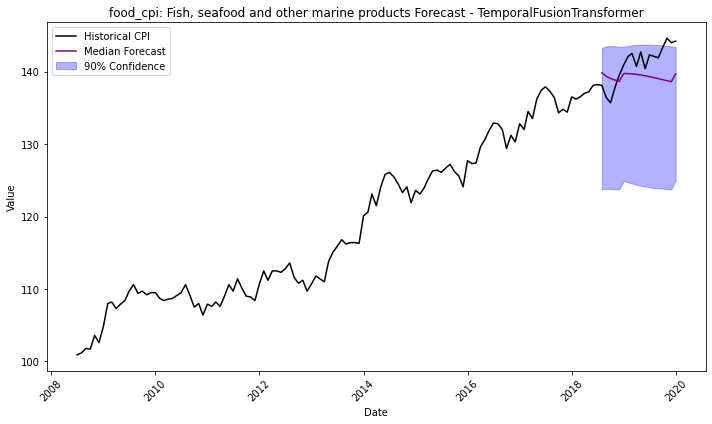

Beginning AutoGluon training... Time limit = 2s
AutoGluon will save models to './output/TEST/ag_global_all_TemporalFusionTransformerModel_exp2_GPT_P3_/random_seed_42/2018-07-01/model_files/'
=================== System Info ===================
AutoGluon Version:  1.1.1
Python Version:     3.8.20
Operating System:   Linux
Platform Machine:   x86_64
Platform Version:   #147~18.04.1-Ubuntu SMP Sat Oct 15 13:10:18 UTC 2022
CPU Count:          32
GPU Count:          1
Memory Avail:       166.28 GB / 188.57 GB (88.2%)
Disk Space Avail:   18212.52 GB / 249006.62 GB (7.3%)

Fitting with arguments:
{'enable_ensemble': True,
 'eval_metric': MAPE,
 'excluded_model_types': ['DirectTabular', 'RecursiveTabular'],
 'hyperparameters': {'TemporalFusionTransformerModel': {}},
 'known_covariates_names': [],
 'num_val_windows': 1,
 'prediction_length': 18,
 'quantile_levels': [0.01, 0.05, 0.1, 0.25, 0.75, 0.9, 0.95, 0.99],
 'random_seed': 42,
 'refit_every_n_windows': 1,
 'refit_full': False,
 'skip_model_

TemporalFusionTransformerModel


	-2.6870       = Validation score (-MAPE)
	2.41    s     = Training runtime
	0.04    s     = Validation (prediction) runtime
Not fitting ensemble due to lack of time remaining. Time left: -0.5 seconds
Training complete. Models trained: ['TemporalFusionTransformer']
Total runtime: 2.49 s
Best model: TemporalFusionTransformer
Best model score: -2.6870
Model not specified in predict, will default to the model with the best validation score: TemporalFusionTransformer
Model not specified in predict, will default to the model with the best validation score: TemporalFusionTransformer


****************** Summary of fit() ******************
Estimated performance of each model:
                       model  score_val  pred_time_val  fit_time_marginal  \
0  TemporalFusionTransformer  -2.687009       0.042868           2.407167   

   fit_order  
0          1  
Number of models trained: 1
Types of models trained:
{'MultiWindowBacktestingModel'}
****************** End of fit() summary ******************


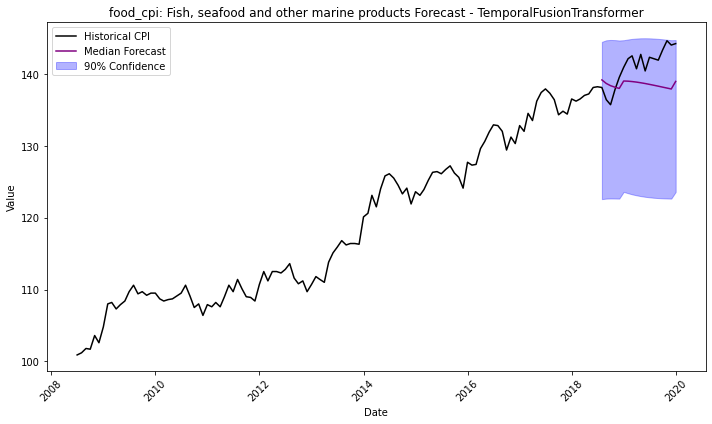

Beginning AutoGluon training... Time limit = 2s
AutoGluon will save models to './output/TEST/ag_global_all_TemporalFusionTransformerModel_exp2_GPT_P2_/random_seed_42/2018-07-01/model_files/'
=================== System Info ===================
AutoGluon Version:  1.1.1
Python Version:     3.8.20
Operating System:   Linux
Platform Machine:   x86_64
Platform Version:   #147~18.04.1-Ubuntu SMP Sat Oct 15 13:10:18 UTC 2022
CPU Count:          32
GPU Count:          1
Memory Avail:       166.06 GB / 188.57 GB (88.1%)
Disk Space Avail:   18212.52 GB / 249006.62 GB (7.3%)

Fitting with arguments:
{'enable_ensemble': True,
 'eval_metric': MAPE,
 'excluded_model_types': ['DirectTabular', 'RecursiveTabular'],
 'hyperparameters': {'TemporalFusionTransformerModel': {}},
 'known_covariates_names': [],
 'num_val_windows': 1,
 'prediction_length': 18,
 'quantile_levels': [0.01, 0.05, 0.1, 0.25, 0.75, 0.9, 0.95, 0.99],
 'random_seed': 42,
 'refit_every_n_windows': 1,
 'refit_full': False,
 'skip_model_

TemporalFusionTransformerModel


	-2.5024       = Validation score (-MAPE)
	2.14    s     = Training runtime
	0.04    s     = Validation (prediction) runtime
Not fitting ensemble due to lack of time remaining. Time left: -0.3 seconds
Training complete. Models trained: ['TemporalFusionTransformer']
Total runtime: 2.22 s
Best model: TemporalFusionTransformer
Best model score: -2.5024
Model not specified in predict, will default to the model with the best validation score: TemporalFusionTransformer
Model not specified in predict, will default to the model with the best validation score: TemporalFusionTransformer


****************** Summary of fit() ******************
Estimated performance of each model:
                       model  score_val  pred_time_val  fit_time_marginal  \
0  TemporalFusionTransformer   -2.50236       0.039908            2.14451   

   fit_order  
0          1  
Number of models trained: 1
Types of models trained:
{'MultiWindowBacktestingModel'}
****************** End of fit() summary ******************


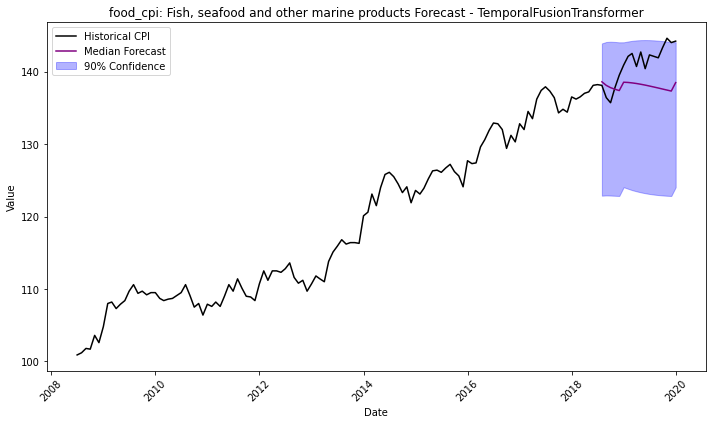

Beginning AutoGluon training... Time limit = 2s
AutoGluon will save models to './output/TEST/ag_global_all_TemporalFusionTransformerModel_exp2_R2_/random_seed_42/2019-07-01/model_files/'
=================== System Info ===================
AutoGluon Version:  1.1.1
Python Version:     3.8.20
Operating System:   Linux
Platform Machine:   x86_64
Platform Version:   #147~18.04.1-Ubuntu SMP Sat Oct 15 13:10:18 UTC 2022
CPU Count:          32
GPU Count:          1
Memory Avail:       166.06 GB / 188.57 GB (88.1%)
Disk Space Avail:   18212.51 GB / 249006.62 GB (7.3%)

Fitting with arguments:
{'enable_ensemble': True,
 'eval_metric': MAPE,
 'excluded_model_types': ['DirectTabular', 'RecursiveTabular'],
 'hyperparameters': {'TemporalFusionTransformerModel': {}},
 'known_covariates_names': [],
 'num_val_windows': 1,
 'prediction_length': 18,
 'quantile_levels': [0.01, 0.05, 0.1, 0.25, 0.75, 0.9, 0.95, 0.99],
 'random_seed': 42,
 'refit_every_n_windows': 1,
 'refit_full': False,
 'skip_model_sele

TemporalFusionTransformerModel


	-0.3824       = Validation score (-MAPE)
	2.12    s     = Training runtime
	0.04    s     = Validation (prediction) runtime
Not fitting ensemble due to lack of time remaining. Time left: -0.2 seconds
Training complete. Models trained: ['TemporalFusionTransformer']
Total runtime: 2.20 s
Best model: TemporalFusionTransformer
Best model score: -0.3824
Model not specified in predict, will default to the model with the best validation score: TemporalFusionTransformer
Model not specified in predict, will default to the model with the best validation score: TemporalFusionTransformer


****************** Summary of fit() ******************
Estimated performance of each model:
                       model  score_val  pred_time_val  fit_time_marginal  \
0  TemporalFusionTransformer  -0.382419       0.040625           2.122393   

   fit_order  
0          1  
Number of models trained: 1
Types of models trained:
{'MultiWindowBacktestingModel'}
****************** End of fit() summary ******************


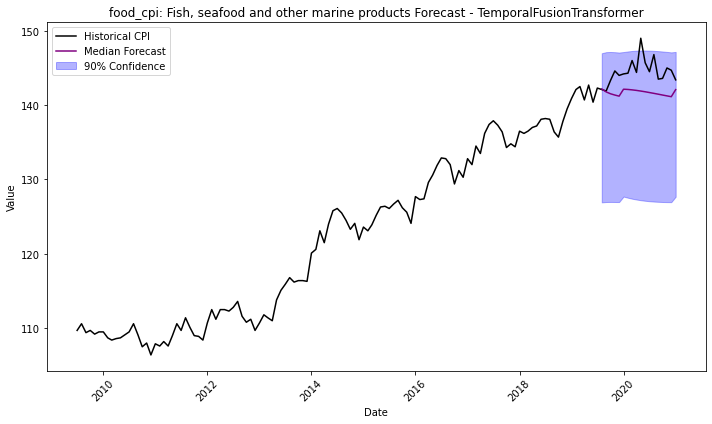

Beginning AutoGluon training... Time limit = 2s
AutoGluon will save models to './output/TEST/ag_global_all_TemporalFusionTransformerModel_exp2_R4_/random_seed_42/2019-07-01/model_files/'
=================== System Info ===================
AutoGluon Version:  1.1.1
Python Version:     3.8.20
Operating System:   Linux
Platform Machine:   x86_64
Platform Version:   #147~18.04.1-Ubuntu SMP Sat Oct 15 13:10:18 UTC 2022
CPU Count:          32
GPU Count:          1
Memory Avail:       166.06 GB / 188.57 GB (88.1%)
Disk Space Avail:   18212.50 GB / 249006.62 GB (7.3%)

Fitting with arguments:
{'enable_ensemble': True,
 'eval_metric': MAPE,
 'excluded_model_types': ['DirectTabular', 'RecursiveTabular'],
 'hyperparameters': {'TemporalFusionTransformerModel': {}},
 'known_covariates_names': [],
 'num_val_windows': 1,
 'prediction_length': 18,
 'quantile_levels': [0.01, 0.05, 0.1, 0.25, 0.75, 0.9, 0.95, 0.99],
 'random_seed': 42,
 'refit_every_n_windows': 1,
 'refit_full': False,
 'skip_model_sele

TemporalFusionTransformerModel


	-0.5461       = Validation score (-MAPE)
	2.12    s     = Training runtime
	0.05    s     = Validation (prediction) runtime
Not fitting ensemble due to lack of time remaining. Time left: -0.3 seconds
Training complete. Models trained: ['TemporalFusionTransformer']
Total runtime: 2.21 s
Best model: TemporalFusionTransformer
Best model score: -0.5461
Model not specified in predict, will default to the model with the best validation score: TemporalFusionTransformer
Model not specified in predict, will default to the model with the best validation score: TemporalFusionTransformer


****************** Summary of fit() ******************
Estimated performance of each model:
                       model  score_val  pred_time_val  fit_time_marginal  \
0  TemporalFusionTransformer  -0.546127       0.049112           2.124841   

   fit_order  
0          1  
Number of models trained: 1
Types of models trained:
{'MultiWindowBacktestingModel'}
****************** End of fit() summary ******************


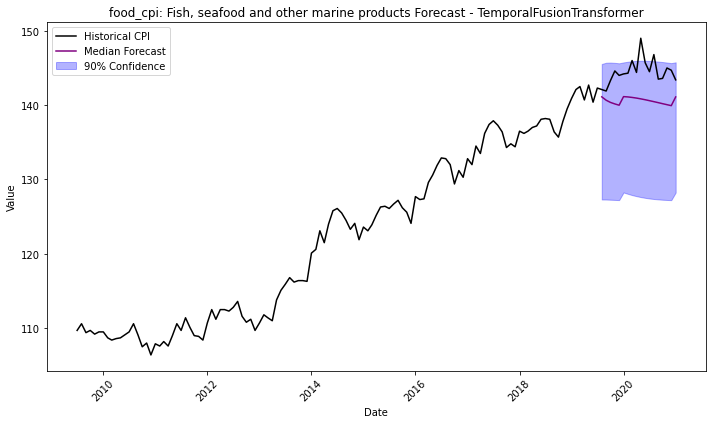

Beginning AutoGluon training... Time limit = 2s
AutoGluon will save models to './output/TEST/ag_global_all_TemporalFusionTransformerModel_exp2_GPT_P1_/random_seed_42/2019-07-01/model_files/'
=================== System Info ===================
AutoGluon Version:  1.1.1
Python Version:     3.8.20
Operating System:   Linux
Platform Machine:   x86_64
Platform Version:   #147~18.04.1-Ubuntu SMP Sat Oct 15 13:10:18 UTC 2022
CPU Count:          32
GPU Count:          1
Memory Avail:       166.08 GB / 188.57 GB (88.1%)
Disk Space Avail:   18212.55 GB / 249006.62 GB (7.3%)

Fitting with arguments:
{'enable_ensemble': True,
 'eval_metric': MAPE,
 'excluded_model_types': ['DirectTabular', 'RecursiveTabular'],
 'hyperparameters': {'TemporalFusionTransformerModel': {}},
 'known_covariates_names': [],
 'num_val_windows': 1,
 'prediction_length': 18,
 'quantile_levels': [0.01, 0.05, 0.1, 0.25, 0.75, 0.9, 0.95, 0.99],
 'random_seed': 42,
 'refit_every_n_windows': 1,
 'refit_full': False,
 'skip_model_

TemporalFusionTransformerModel


	-1.0571       = Validation score (-MAPE)
	2.12    s     = Training runtime
	0.04    s     = Validation (prediction) runtime
Not fitting ensemble due to lack of time remaining. Time left: -0.3 seconds
Training complete. Models trained: ['TemporalFusionTransformer']
Total runtime: 2.20 s
Best model: TemporalFusionTransformer
Best model score: -1.0571
Model not specified in predict, will default to the model with the best validation score: TemporalFusionTransformer
Model not specified in predict, will default to the model with the best validation score: TemporalFusionTransformer


****************** Summary of fit() ******************
Estimated performance of each model:
                       model  score_val  pred_time_val  fit_time_marginal  \
0  TemporalFusionTransformer  -1.057118       0.041863           2.121119   

   fit_order  
0          1  
Number of models trained: 1
Types of models trained:
{'MultiWindowBacktestingModel'}
****************** End of fit() summary ******************


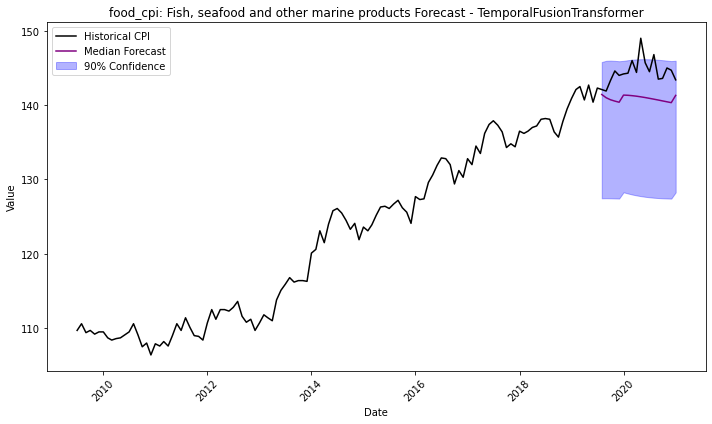

Beginning AutoGluon training... Time limit = 2s
AutoGluon will save models to './output/TEST/ag_global_all_TemporalFusionTransformerModel_exp2_R3_/random_seed_42/2019-07-01/model_files/'
=================== System Info ===================
AutoGluon Version:  1.1.1
Python Version:     3.8.20
Operating System:   Linux
Platform Machine:   x86_64
Platform Version:   #147~18.04.1-Ubuntu SMP Sat Oct 15 13:10:18 UTC 2022
CPU Count:          32
GPU Count:          1
Memory Avail:       166.07 GB / 188.57 GB (88.1%)
Disk Space Avail:   18212.54 GB / 249006.62 GB (7.3%)

Fitting with arguments:
{'enable_ensemble': True,
 'eval_metric': MAPE,
 'excluded_model_types': ['DirectTabular', 'RecursiveTabular'],
 'hyperparameters': {'TemporalFusionTransformerModel': {}},
 'known_covariates_names': [],
 'num_val_windows': 1,
 'prediction_length': 18,
 'quantile_levels': [0.01, 0.05, 0.1, 0.25, 0.75, 0.9, 0.95, 0.99],
 'random_seed': 42,
 'refit_every_n_windows': 1,
 'refit_full': False,
 'skip_model_sele

TemporalFusionTransformerModel


	-0.7058       = Validation score (-MAPE)
	2.41    s     = Training runtime
	0.04    s     = Validation (prediction) runtime
Not fitting ensemble due to lack of time remaining. Time left: -0.6 seconds
Training complete. Models trained: ['TemporalFusionTransformer']
Total runtime: 2.50 s
Best model: TemporalFusionTransformer
Best model score: -0.7058
Model not specified in predict, will default to the model with the best validation score: TemporalFusionTransformer
Model not specified in predict, will default to the model with the best validation score: TemporalFusionTransformer


****************** Summary of fit() ******************
Estimated performance of each model:
                       model  score_val  pred_time_val  fit_time_marginal  \
0  TemporalFusionTransformer  -0.705779        0.04158            2.41123   

   fit_order  
0          1  
Number of models trained: 1
Types of models trained:
{'MultiWindowBacktestingModel'}
****************** End of fit() summary ******************


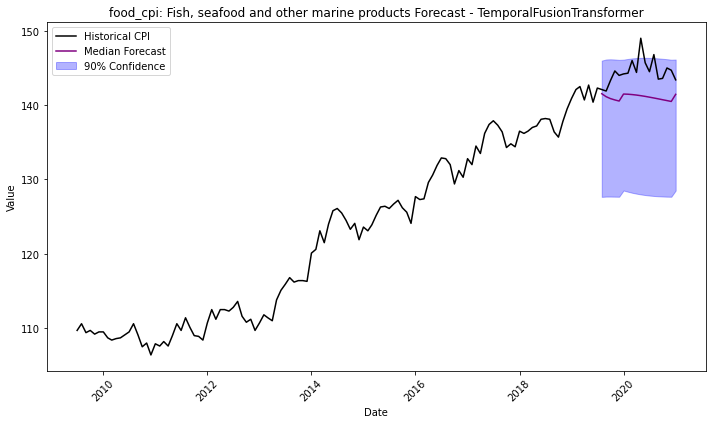

Beginning AutoGluon training... Time limit = 2s
AutoGluon will save models to './output/TEST/ag_global_all_TemporalFusionTransformerModel_exp2_GPT_P4_/random_seed_42/2019-07-01/model_files/'
=================== System Info ===================
AutoGluon Version:  1.1.1
Python Version:     3.8.20
Operating System:   Linux
Platform Machine:   x86_64
Platform Version:   #147~18.04.1-Ubuntu SMP Sat Oct 15 13:10:18 UTC 2022
CPU Count:          32
GPU Count:          1
Memory Avail:       166.07 GB / 188.57 GB (88.1%)
Disk Space Avail:   18212.52 GB / 249006.62 GB (7.3%)

Fitting with arguments:
{'enable_ensemble': True,
 'eval_metric': MAPE,
 'excluded_model_types': ['DirectTabular', 'RecursiveTabular'],
 'hyperparameters': {'TemporalFusionTransformerModel': {}},
 'known_covariates_names': [],
 'num_val_windows': 1,
 'prediction_length': 18,
 'quantile_levels': [0.01, 0.05, 0.1, 0.25, 0.75, 0.9, 0.95, 0.99],
 'random_seed': 42,
 'refit_every_n_windows': 1,
 'refit_full': False,
 'skip_model_

TemporalFusionTransformerModel


	-0.7058       = Validation score (-MAPE)
	2.11    s     = Training runtime
	0.04    s     = Validation (prediction) runtime
Not fitting ensemble due to lack of time remaining. Time left: -0.2 seconds
Training complete. Models trained: ['TemporalFusionTransformer']
Total runtime: 2.18 s
Best model: TemporalFusionTransformer
Best model score: -0.7058
Model not specified in predict, will default to the model with the best validation score: TemporalFusionTransformer
Model not specified in predict, will default to the model with the best validation score: TemporalFusionTransformer


****************** Summary of fit() ******************
Estimated performance of each model:
                       model  score_val  pred_time_val  fit_time_marginal  \
0  TemporalFusionTransformer  -0.705773       0.037985           2.111006   

   fit_order  
0          1  
Number of models trained: 1
Types of models trained:
{'MultiWindowBacktestingModel'}
****************** End of fit() summary ******************


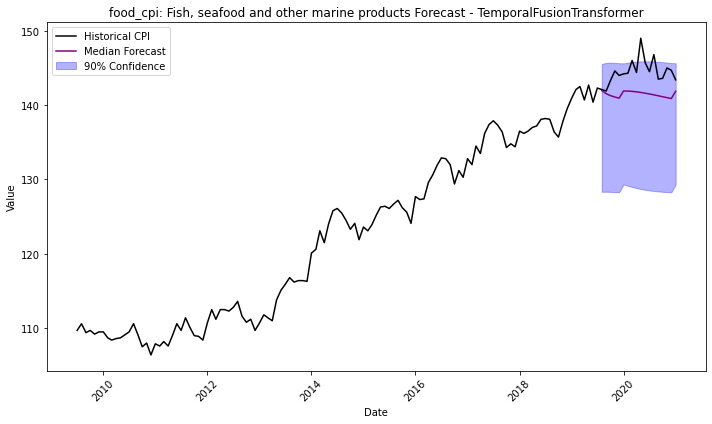

Beginning AutoGluon training... Time limit = 2s
AutoGluon will save models to './output/TEST/ag_global_all_TemporalFusionTransformerModel_exp2_R1_/random_seed_42/2019-07-01/model_files/'
=================== System Info ===================
AutoGluon Version:  1.1.1
Python Version:     3.8.20
Operating System:   Linux
Platform Machine:   x86_64
Platform Version:   #147~18.04.1-Ubuntu SMP Sat Oct 15 13:10:18 UTC 2022
CPU Count:          32
GPU Count:          1
Memory Avail:       166.07 GB / 188.57 GB (88.1%)
Disk Space Avail:   18212.52 GB / 249006.62 GB (7.3%)

Fitting with arguments:
{'enable_ensemble': True,
 'eval_metric': MAPE,
 'excluded_model_types': ['DirectTabular', 'RecursiveTabular'],
 'hyperparameters': {'TemporalFusionTransformerModel': {}},
 'known_covariates_names': [],
 'num_val_windows': 1,
 'prediction_length': 18,
 'quantile_levels': [0.01, 0.05, 0.1, 0.25, 0.75, 0.9, 0.95, 0.99],
 'random_seed': 42,
 'refit_every_n_windows': 1,
 'refit_full': False,
 'skip_model_sele

TemporalFusionTransformerModel


	-0.8230       = Validation score (-MAPE)
	2.15    s     = Training runtime
	0.04    s     = Validation (prediction) runtime
Not fitting ensemble due to lack of time remaining. Time left: -0.3 seconds
Training complete. Models trained: ['TemporalFusionTransformer']
Total runtime: 2.23 s
Best model: TemporalFusionTransformer
Best model score: -0.8230
Model not specified in predict, will default to the model with the best validation score: TemporalFusionTransformer
Model not specified in predict, will default to the model with the best validation score: TemporalFusionTransformer


****************** Summary of fit() ******************
Estimated performance of each model:
                       model  score_val  pred_time_val  fit_time_marginal  \
0  TemporalFusionTransformer  -0.823031       0.042228           2.154114   

   fit_order  
0          1  
Number of models trained: 1
Types of models trained:
{'MultiWindowBacktestingModel'}
****************** End of fit() summary ******************


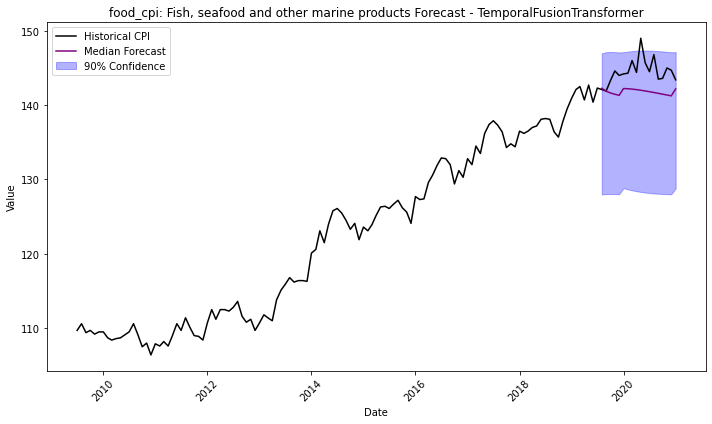

Beginning AutoGluon training... Time limit = 2s
AutoGluon will save models to './output/TEST/ag_global_all_TemporalFusionTransformerModel_exp2_GPT_P3_/random_seed_42/2019-07-01/model_files/'
=================== System Info ===================
AutoGluon Version:  1.1.1
Python Version:     3.8.20
Operating System:   Linux
Platform Machine:   x86_64
Platform Version:   #147~18.04.1-Ubuntu SMP Sat Oct 15 13:10:18 UTC 2022
CPU Count:          32
GPU Count:          1
Memory Avail:       166.07 GB / 188.57 GB (88.1%)
Disk Space Avail:   18212.50 GB / 249006.62 GB (7.3%)

Fitting with arguments:
{'enable_ensemble': True,
 'eval_metric': MAPE,
 'excluded_model_types': ['DirectTabular', 'RecursiveTabular'],
 'hyperparameters': {'TemporalFusionTransformerModel': {}},
 'known_covariates_names': [],
 'num_val_windows': 1,
 'prediction_length': 18,
 'quantile_levels': [0.01, 0.05, 0.1, 0.25, 0.75, 0.9, 0.95, 0.99],
 'random_seed': 42,
 'refit_every_n_windows': 1,
 'refit_full': False,
 'skip_model_

TemporalFusionTransformerModel


	-1.0849       = Validation score (-MAPE)
	2.13    s     = Training runtime
	0.04    s     = Validation (prediction) runtime
Not fitting ensemble due to lack of time remaining. Time left: -0.3 seconds
Training complete. Models trained: ['TemporalFusionTransformer']
Total runtime: 2.20 s
Best model: TemporalFusionTransformer
Best model score: -1.0849
Model not specified in predict, will default to the model with the best validation score: TemporalFusionTransformer
Model not specified in predict, will default to the model with the best validation score: TemporalFusionTransformer


****************** Summary of fit() ******************
Estimated performance of each model:
                       model  score_val  pred_time_val  fit_time_marginal  \
0  TemporalFusionTransformer  -1.084927       0.042022           2.128296   

   fit_order  
0          1  
Number of models trained: 1
Types of models trained:
{'MultiWindowBacktestingModel'}
****************** End of fit() summary ******************


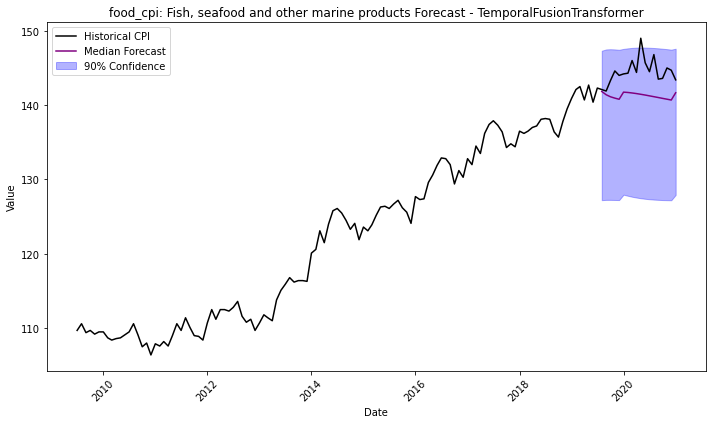

Beginning AutoGluon training... Time limit = 2s
AutoGluon will save models to './output/TEST/ag_global_all_TemporalFusionTransformerModel_exp2_GPT_P2_/random_seed_42/2019-07-01/model_files/'
=================== System Info ===================
AutoGluon Version:  1.1.1
Python Version:     3.8.20
Operating System:   Linux
Platform Machine:   x86_64
Platform Version:   #147~18.04.1-Ubuntu SMP Sat Oct 15 13:10:18 UTC 2022
CPU Count:          32
GPU Count:          1
Memory Avail:       166.07 GB / 188.57 GB (88.1%)
Disk Space Avail:   18212.49 GB / 249006.62 GB (7.3%)

Fitting with arguments:
{'enable_ensemble': True,
 'eval_metric': MAPE,
 'excluded_model_types': ['DirectTabular', 'RecursiveTabular'],
 'hyperparameters': {'TemporalFusionTransformerModel': {}},
 'known_covariates_names': [],
 'num_val_windows': 1,
 'prediction_length': 18,
 'quantile_levels': [0.01, 0.05, 0.1, 0.25, 0.75, 0.9, 0.95, 0.99],
 'random_seed': 42,
 'refit_every_n_windows': 1,
 'refit_full': False,
 'skip_model_

TemporalFusionTransformerModel


	-1.1719       = Validation score (-MAPE)
	2.14    s     = Training runtime
	0.04    s     = Validation (prediction) runtime
Not fitting ensemble due to lack of time remaining. Time left: -0.3 seconds
Training complete. Models trained: ['TemporalFusionTransformer']
Total runtime: 2.22 s
Best model: TemporalFusionTransformer
Best model score: -1.1719
Model not specified in predict, will default to the model with the best validation score: TemporalFusionTransformer
Model not specified in predict, will default to the model with the best validation score: TemporalFusionTransformer


****************** Summary of fit() ******************
Estimated performance of each model:
                       model  score_val  pred_time_val  fit_time_marginal  \
0  TemporalFusionTransformer  -1.171928       0.039978           2.143645   

   fit_order  
0          1  
Number of models trained: 1
Types of models trained:
{'MultiWindowBacktestingModel'}
****************** End of fit() summary ******************


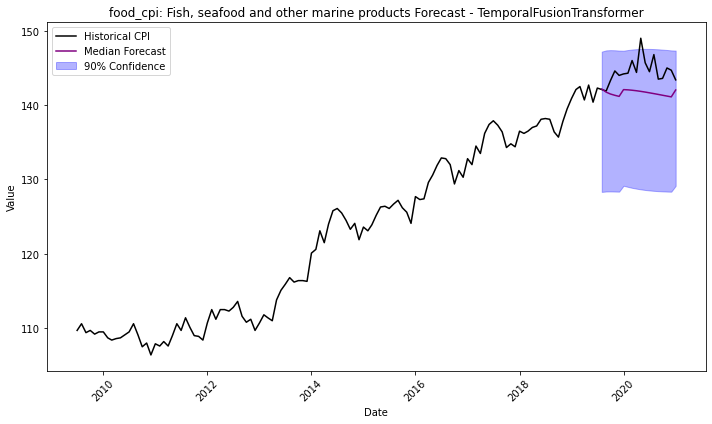

Beginning AutoGluon training... Time limit = 2s
AutoGluon will save models to './output/TEST/ag_global_all_TemporalFusionTransformerModel_exp2_R2_/random_seed_42/2020-07-01/model_files/'
=================== System Info ===================
AutoGluon Version:  1.1.1
Python Version:     3.8.20
Operating System:   Linux
Platform Machine:   x86_64
Platform Version:   #147~18.04.1-Ubuntu SMP Sat Oct 15 13:10:18 UTC 2022
CPU Count:          32
GPU Count:          1
Memory Avail:       166.07 GB / 188.57 GB (88.1%)
Disk Space Avail:   18212.54 GB / 249006.62 GB (7.3%)

Fitting with arguments:
{'enable_ensemble': True,
 'eval_metric': MAPE,
 'excluded_model_types': ['DirectTabular', 'RecursiveTabular'],
 'hyperparameters': {'TemporalFusionTransformerModel': {}},
 'known_covariates_names': [],
 'num_val_windows': 1,
 'prediction_length': 18,
 'quantile_levels': [0.01, 0.05, 0.1, 0.25, 0.75, 0.9, 0.95, 0.99],
 'random_seed': 42,
 'refit_every_n_windows': 1,
 'refit_full': False,
 'skip_model_sele

TemporalFusionTransformerModel


	-0.3785       = Validation score (-MAPE)
	2.22    s     = Training runtime
	0.04    s     = Validation (prediction) runtime
Not fitting ensemble due to lack of time remaining. Time left: -0.4 seconds
Training complete. Models trained: ['TemporalFusionTransformer']
Total runtime: 2.31 s
Best model: TemporalFusionTransformer
Best model score: -0.3785
Model not specified in predict, will default to the model with the best validation score: TemporalFusionTransformer
Model not specified in predict, will default to the model with the best validation score: TemporalFusionTransformer


****************** Summary of fit() ******************
Estimated performance of each model:
                       model  score_val  pred_time_val  fit_time_marginal  \
0  TemporalFusionTransformer  -0.378527       0.043189           2.216618   

   fit_order  
0          1  
Number of models trained: 1
Types of models trained:
{'MultiWindowBacktestingModel'}
****************** End of fit() summary ******************


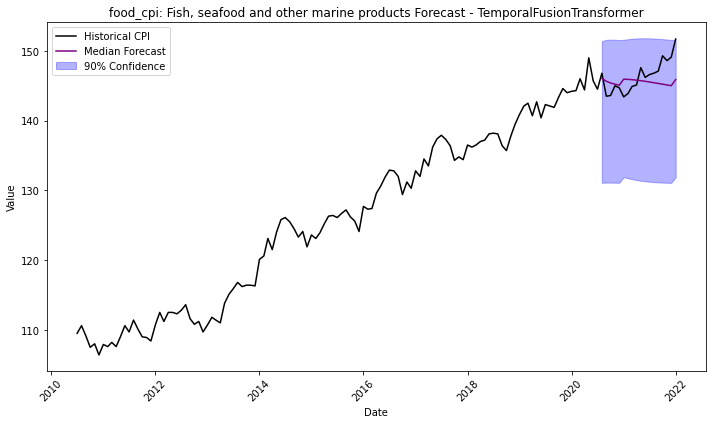

Beginning AutoGluon training... Time limit = 2s
AutoGluon will save models to './output/TEST/ag_global_all_TemporalFusionTransformerModel_exp2_R4_/random_seed_42/2020-07-01/model_files/'
=================== System Info ===================
AutoGluon Version:  1.1.1
Python Version:     3.8.20
Operating System:   Linux
Platform Machine:   x86_64
Platform Version:   #147~18.04.1-Ubuntu SMP Sat Oct 15 13:10:18 UTC 2022
CPU Count:          32
GPU Count:          1
Memory Avail:       166.07 GB / 188.57 GB (88.1%)
Disk Space Avail:   18212.52 GB / 249006.62 GB (7.3%)

Fitting with arguments:
{'enable_ensemble': True,
 'eval_metric': MAPE,
 'excluded_model_types': ['DirectTabular', 'RecursiveTabular'],
 'hyperparameters': {'TemporalFusionTransformerModel': {}},
 'known_covariates_names': [],
 'num_val_windows': 1,
 'prediction_length': 18,
 'quantile_levels': [0.01, 0.05, 0.1, 0.25, 0.75, 0.9, 0.95, 0.99],
 'random_seed': 42,
 'refit_every_n_windows': 1,
 'refit_full': False,
 'skip_model_sele

TemporalFusionTransformerModel


Inferred time series frequency: 'MS'
Provided train_data has 9130 rows, 22 time series. Median time series length is 415 (min=415, max=415). 

Provided data contains following columns:
	target: 'target'

AutoGluon will gauge predictive performance using evaluation metric: 'MAPE'
	This metric's sign has been flipped to adhere to being higher_is_better. The metric score can be multiplied by -1 to get the metric value.

Starting training. Start time is 2024-10-27 07:34:03
Excluded model types: ['DirectTabular', 'RecursiveTabular']
Models that will be trained: ['TemporalFusionTransformer']
Training timeseries model TemporalFusionTransformer. Training for up to 1.6s of the 1.6s of remaining time.
	-0.5021       = Validation score (-MAPE)
	1.83    s     = Training runtime
	0.04    s     = Validation (prediction) runtime
Not fitting ensemble due to lack of time remaining. Time left: -0.3 seconds
Training complete. Models trained: ['TemporalFusionTransformer']
Total runtime: 1.92 s
Best model:

****************** Summary of fit() ******************
Estimated performance of each model:
                       model  score_val  pred_time_val  fit_time_marginal  \
0  TemporalFusionTransformer  -0.502121       0.043345           1.834046   

   fit_order  
0          1  
Number of models trained: 1
Types of models trained:
{'MultiWindowBacktestingModel'}
****************** End of fit() summary ******************


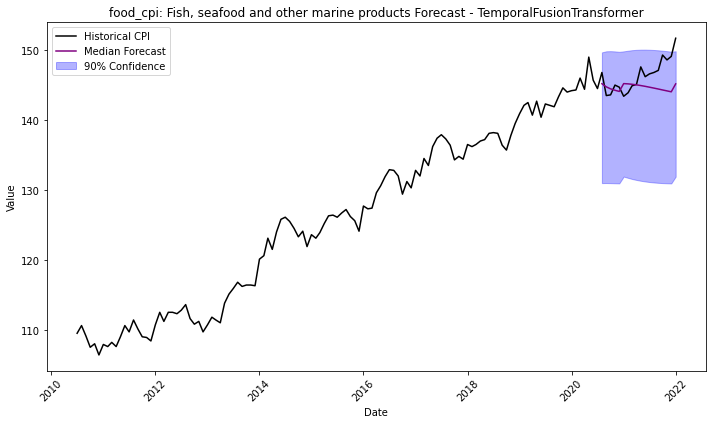

Beginning AutoGluon training... Time limit = 2s
AutoGluon will save models to './output/TEST/ag_global_all_TemporalFusionTransformerModel_exp2_GPT_P1_/random_seed_42/2020-07-01/model_files/'
=================== System Info ===================
AutoGluon Version:  1.1.1
Python Version:     3.8.20
Operating System:   Linux
Platform Machine:   x86_64
Platform Version:   #147~18.04.1-Ubuntu SMP Sat Oct 15 13:10:18 UTC 2022
CPU Count:          32
GPU Count:          1
Memory Avail:       166.07 GB / 188.57 GB (88.1%)
Disk Space Avail:   18212.51 GB / 249006.62 GB (7.3%)

Fitting with arguments:
{'enable_ensemble': True,
 'eval_metric': MAPE,
 'excluded_model_types': ['DirectTabular', 'RecursiveTabular'],
 'hyperparameters': {'TemporalFusionTransformerModel': {}},
 'known_covariates_names': [],
 'num_val_windows': 1,
 'prediction_length': 18,
 'quantile_levels': [0.01, 0.05, 0.1, 0.25, 0.75, 0.9, 0.95, 0.99],
 'random_seed': 42,
 'refit_every_n_windows': 1,
 'refit_full': False,
 'skip_model_

TemporalFusionTransformerModel


	-0.8235       = Validation score (-MAPE)
	2.18    s     = Training runtime
	0.05    s     = Validation (prediction) runtime
Not fitting ensemble due to lack of time remaining. Time left: -0.3 seconds
Training complete. Models trained: ['TemporalFusionTransformer']
Total runtime: 2.26 s
Best model: TemporalFusionTransformer
Best model score: -0.8235
Model not specified in predict, will default to the model with the best validation score: TemporalFusionTransformer
Model not specified in predict, will default to the model with the best validation score: TemporalFusionTransformer


****************** Summary of fit() ******************
Estimated performance of each model:
                       model  score_val  pred_time_val  fit_time_marginal  \
0  TemporalFusionTransformer  -0.823531       0.045764           2.180031   

   fit_order  
0          1  
Number of models trained: 1
Types of models trained:
{'MultiWindowBacktestingModel'}
****************** End of fit() summary ******************


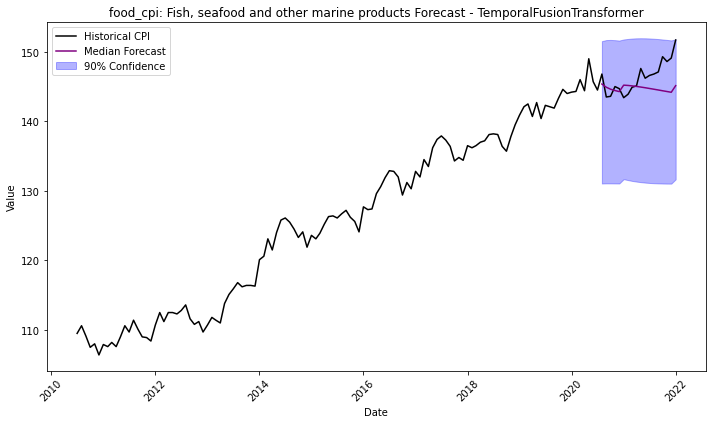

Beginning AutoGluon training... Time limit = 2s
AutoGluon will save models to './output/TEST/ag_global_all_TemporalFusionTransformerModel_exp2_R3_/random_seed_42/2020-07-01/model_files/'
=================== System Info ===================
AutoGluon Version:  1.1.1
Python Version:     3.8.20
Operating System:   Linux
Platform Machine:   x86_64
Platform Version:   #147~18.04.1-Ubuntu SMP Sat Oct 15 13:10:18 UTC 2022
CPU Count:          32
GPU Count:          1
Memory Avail:       166.07 GB / 188.57 GB (88.1%)
Disk Space Avail:   18212.50 GB / 249006.62 GB (7.3%)

Fitting with arguments:
{'enable_ensemble': True,
 'eval_metric': MAPE,
 'excluded_model_types': ['DirectTabular', 'RecursiveTabular'],
 'hyperparameters': {'TemporalFusionTransformerModel': {}},
 'known_covariates_names': [],
 'num_val_windows': 1,
 'prediction_length': 18,
 'quantile_levels': [0.01, 0.05, 0.1, 0.25, 0.75, 0.9, 0.95, 0.99],
 'random_seed': 42,
 'refit_every_n_windows': 1,
 'refit_full': False,
 'skip_model_sele

TemporalFusionTransformerModel


	-0.5851       = Validation score (-MAPE)
	2.11    s     = Training runtime
	0.04    s     = Validation (prediction) runtime
Not fitting ensemble due to lack of time remaining. Time left: -0.3 seconds
Training complete. Models trained: ['TemporalFusionTransformer']
Total runtime: 2.20 s
Best model: TemporalFusionTransformer
Best model score: -0.5851
Model not specified in predict, will default to the model with the best validation score: TemporalFusionTransformer
Model not specified in predict, will default to the model with the best validation score: TemporalFusionTransformer


****************** Summary of fit() ******************
Estimated performance of each model:
                       model  score_val  pred_time_val  fit_time_marginal  \
0  TemporalFusionTransformer  -0.585083        0.04295           2.113865   

   fit_order  
0          1  
Number of models trained: 1
Types of models trained:
{'MultiWindowBacktestingModel'}
****************** End of fit() summary ******************


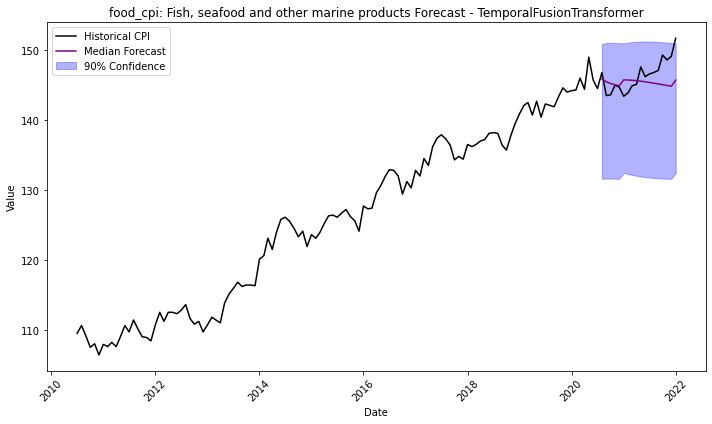

Beginning AutoGluon training... Time limit = 2s
AutoGluon will save models to './output/TEST/ag_global_all_TemporalFusionTransformerModel_exp2_GPT_P4_/random_seed_42/2020-07-01/model_files/'
=================== System Info ===================
AutoGluon Version:  1.1.1
Python Version:     3.8.20
Operating System:   Linux
Platform Machine:   x86_64
Platform Version:   #147~18.04.1-Ubuntu SMP Sat Oct 15 13:10:18 UTC 2022
CPU Count:          32
GPU Count:          1
Memory Avail:       166.20 GB / 188.57 GB (88.1%)
Disk Space Avail:   18212.49 GB / 249006.62 GB (7.3%)

Fitting with arguments:
{'enable_ensemble': True,
 'eval_metric': MAPE,
 'excluded_model_types': ['DirectTabular', 'RecursiveTabular'],
 'hyperparameters': {'TemporalFusionTransformerModel': {}},
 'known_covariates_names': [],
 'num_val_windows': 1,
 'prediction_length': 18,
 'quantile_levels': [0.01, 0.05, 0.1, 0.25, 0.75, 0.9, 0.95, 0.99],
 'random_seed': 42,
 'refit_every_n_windows': 1,
 'refit_full': False,
 'skip_model_

TemporalFusionTransformerModel


	-0.6966       = Validation score (-MAPE)
	2.12    s     = Training runtime
	0.04    s     = Validation (prediction) runtime
Not fitting ensemble due to lack of time remaining. Time left: -0.2 seconds
Training complete. Models trained: ['TemporalFusionTransformer']
Total runtime: 2.20 s
Best model: TemporalFusionTransformer
Best model score: -0.6966
Model not specified in predict, will default to the model with the best validation score: TemporalFusionTransformer
Model not specified in predict, will default to the model with the best validation score: TemporalFusionTransformer


****************** Summary of fit() ******************
Estimated performance of each model:
                       model  score_val  pred_time_val  fit_time_marginal  \
0  TemporalFusionTransformer   -0.69656       0.039726           2.121037   

   fit_order  
0          1  
Number of models trained: 1
Types of models trained:
{'MultiWindowBacktestingModel'}
****************** End of fit() summary ******************


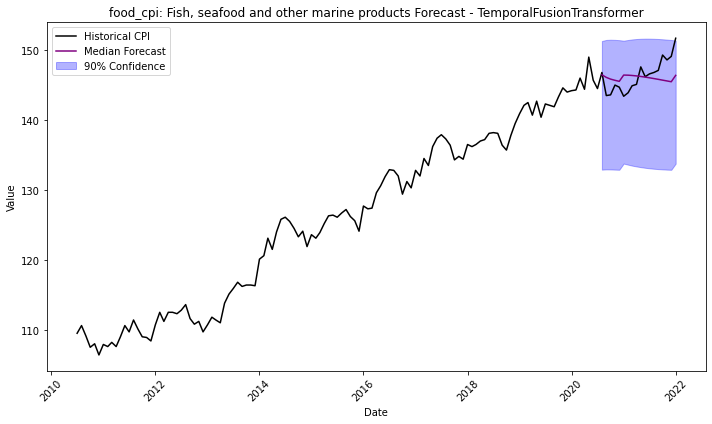

Beginning AutoGluon training... Time limit = 2s
AutoGluon will save models to './output/TEST/ag_global_all_TemporalFusionTransformerModel_exp2_R1_/random_seed_42/2020-07-01/model_files/'
=================== System Info ===================
AutoGluon Version:  1.1.1
Python Version:     3.8.20
Operating System:   Linux
Platform Machine:   x86_64
Platform Version:   #147~18.04.1-Ubuntu SMP Sat Oct 15 13:10:18 UTC 2022
CPU Count:          32
GPU Count:          1
Memory Avail:       166.24 GB / 188.57 GB (88.2%)
Disk Space Avail:   18212.54 GB / 249006.62 GB (7.3%)

Fitting with arguments:
{'enable_ensemble': True,
 'eval_metric': MAPE,
 'excluded_model_types': ['DirectTabular', 'RecursiveTabular'],
 'hyperparameters': {'TemporalFusionTransformerModel': {}},
 'known_covariates_names': [],
 'num_val_windows': 1,
 'prediction_length': 18,
 'quantile_levels': [0.01, 0.05, 0.1, 0.25, 0.75, 0.9, 0.95, 0.99],
 'random_seed': 42,
 'refit_every_n_windows': 1,
 'refit_full': False,
 'skip_model_sele

TemporalFusionTransformerModel


	-2.6767       = Validation score (-MAPE)
	2.20    s     = Training runtime
	0.05    s     = Validation (prediction) runtime
Not fitting ensemble due to lack of time remaining. Time left: -0.3 seconds
Training complete. Models trained: ['TemporalFusionTransformer']
Total runtime: 2.29 s
Best model: TemporalFusionTransformer
Best model score: -2.6767
Model not specified in predict, will default to the model with the best validation score: TemporalFusionTransformer
Model not specified in predict, will default to the model with the best validation score: TemporalFusionTransformer


****************** Summary of fit() ******************
Estimated performance of each model:
                       model  score_val  pred_time_val  fit_time_marginal  \
0  TemporalFusionTransformer  -2.676737       0.052757           2.199102   

   fit_order  
0          1  
Number of models trained: 1
Types of models trained:
{'MultiWindowBacktestingModel'}
****************** End of fit() summary ******************


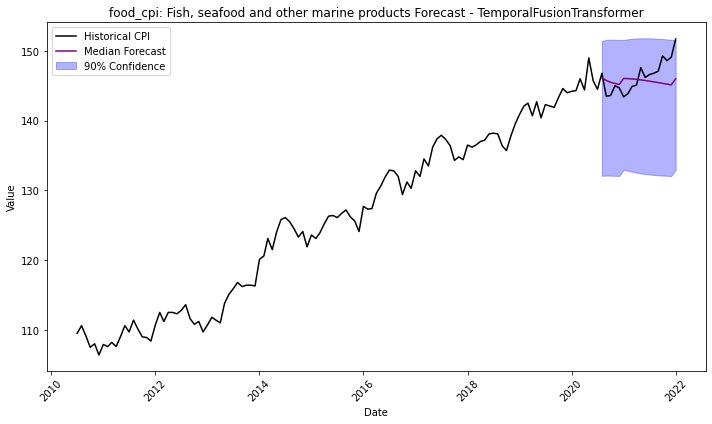

Beginning AutoGluon training... Time limit = 2s
AutoGluon will save models to './output/TEST/ag_global_all_TemporalFusionTransformerModel_exp2_GPT_P3_/random_seed_42/2020-07-01/model_files/'
=================== System Info ===================
AutoGluon Version:  1.1.1
Python Version:     3.8.20
Operating System:   Linux
Platform Machine:   x86_64
Platform Version:   #147~18.04.1-Ubuntu SMP Sat Oct 15 13:10:18 UTC 2022
CPU Count:          32
GPU Count:          1
Memory Avail:       166.06 GB / 188.57 GB (88.1%)
Disk Space Avail:   18212.50 GB / 249006.62 GB (7.3%)

Fitting with arguments:
{'enable_ensemble': True,
 'eval_metric': MAPE,
 'excluded_model_types': ['DirectTabular', 'RecursiveTabular'],
 'hyperparameters': {'TemporalFusionTransformerModel': {}},
 'known_covariates_names': [],
 'num_val_windows': 1,
 'prediction_length': 18,
 'quantile_levels': [0.01, 0.05, 0.1, 0.25, 0.75, 0.9, 0.95, 0.99],
 'random_seed': 42,
 'refit_every_n_windows': 1,
 'refit_full': False,
 'skip_model_

TemporalFusionTransformerModel


	-0.8338       = Validation score (-MAPE)
	2.52    s     = Training runtime
	0.04    s     = Validation (prediction) runtime
Not fitting ensemble due to lack of time remaining. Time left: -0.7 seconds
Training complete. Models trained: ['TemporalFusionTransformer']
Total runtime: 2.61 s
Best model: TemporalFusionTransformer
Best model score: -0.8338
Model not specified in predict, will default to the model with the best validation score: TemporalFusionTransformer
Model not specified in predict, will default to the model with the best validation score: TemporalFusionTransformer


****************** Summary of fit() ******************
Estimated performance of each model:
                       model  score_val  pred_time_val  fit_time_marginal  \
0  TemporalFusionTransformer  -0.833757       0.042137           2.517827   

   fit_order  
0          1  
Number of models trained: 1
Types of models trained:
{'MultiWindowBacktestingModel'}
****************** End of fit() summary ******************


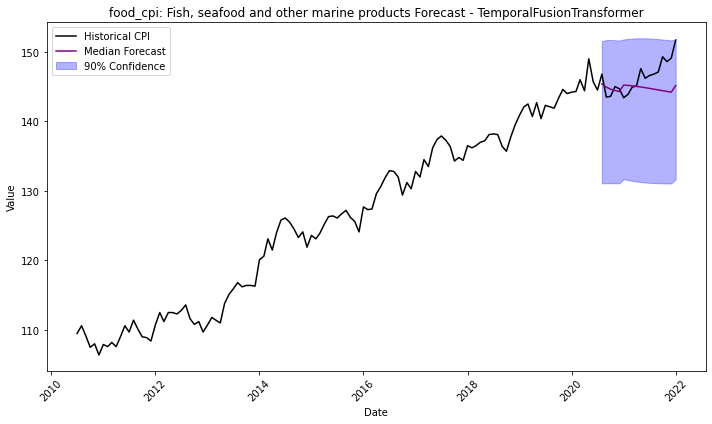

Beginning AutoGluon training... Time limit = 2s
AutoGluon will save models to './output/TEST/ag_global_all_TemporalFusionTransformerModel_exp2_GPT_P2_/random_seed_42/2020-07-01/model_files/'
=================== System Info ===================
AutoGluon Version:  1.1.1
Python Version:     3.8.20
Operating System:   Linux
Platform Machine:   x86_64
Platform Version:   #147~18.04.1-Ubuntu SMP Sat Oct 15 13:10:18 UTC 2022
CPU Count:          32
GPU Count:          1
Memory Avail:       166.06 GB / 188.57 GB (88.1%)
Disk Space Avail:   18212.49 GB / 249006.62 GB (7.3%)

Fitting with arguments:
{'enable_ensemble': True,
 'eval_metric': MAPE,
 'excluded_model_types': ['DirectTabular', 'RecursiveTabular'],
 'hyperparameters': {'TemporalFusionTransformerModel': {}},
 'known_covariates_names': [],
 'num_val_windows': 1,
 'prediction_length': 18,
 'quantile_levels': [0.01, 0.05, 0.1, 0.25, 0.75, 0.9, 0.95, 0.99],
 'random_seed': 42,
 'refit_every_n_windows': 1,
 'refit_full': False,
 'skip_model_

TemporalFusionTransformerModel


	-0.9409       = Validation score (-MAPE)
	2.12    s     = Training runtime
	0.04    s     = Validation (prediction) runtime
Not fitting ensemble due to lack of time remaining. Time left: -0.3 seconds
Training complete. Models trained: ['TemporalFusionTransformer']
Total runtime: 2.20 s
Best model: TemporalFusionTransformer
Best model score: -0.9409
Model not specified in predict, will default to the model with the best validation score: TemporalFusionTransformer
Model not specified in predict, will default to the model with the best validation score: TemporalFusionTransformer


****************** Summary of fit() ******************
Estimated performance of each model:
                       model  score_val  pred_time_val  fit_time_marginal  \
0  TemporalFusionTransformer  -0.940927        0.03975             2.1168   

   fit_order  
0          1  
Number of models trained: 1
Types of models trained:
{'MultiWindowBacktestingModel'}
****************** End of fit() summary ******************


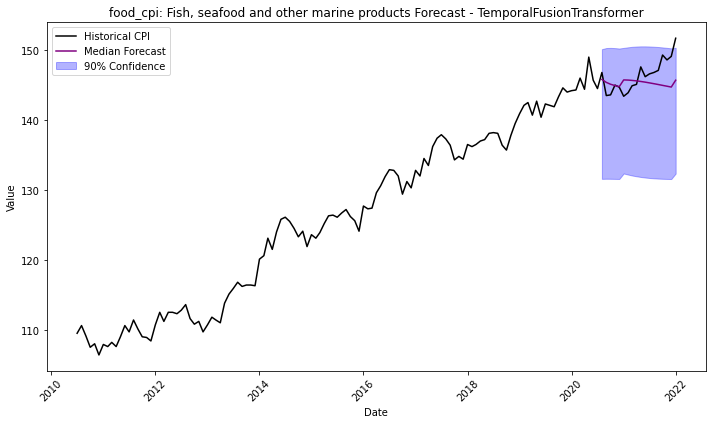

Beginning AutoGluon training... Time limit = 2s
AutoGluon will save models to './output/TEST/ag_global_all_TemporalFusionTransformerModel_exp2_R2_/random_seed_42/2021-07-01/model_files/'
=================== System Info ===================
AutoGluon Version:  1.1.1
Python Version:     3.8.20
Operating System:   Linux
Platform Machine:   x86_64
Platform Version:   #147~18.04.1-Ubuntu SMP Sat Oct 15 13:10:18 UTC 2022
CPU Count:          32
GPU Count:          1
Memory Avail:       166.12 GB / 188.57 GB (88.1%)
Disk Space Avail:   18212.48 GB / 249006.62 GB (7.3%)

Fitting with arguments:
{'enable_ensemble': True,
 'eval_metric': MAPE,
 'excluded_model_types': ['DirectTabular', 'RecursiveTabular'],
 'hyperparameters': {'TemporalFusionTransformerModel': {}},
 'known_covariates_names': [],
 'num_val_windows': 1,
 'prediction_length': 18,
 'quantile_levels': [0.01, 0.05, 0.1, 0.25, 0.75, 0.9, 0.95, 0.99],
 'random_seed': 42,
 'refit_every_n_windows': 1,
 'refit_full': False,
 'skip_model_sele

TemporalFusionTransformerModel


	-0.5338       = Validation score (-MAPE)
	2.12    s     = Training runtime
	0.04    s     = Validation (prediction) runtime
Not fitting ensemble due to lack of time remaining. Time left: -0.3 seconds
Training complete. Models trained: ['TemporalFusionTransformer']
Total runtime: 2.20 s
Best model: TemporalFusionTransformer
Best model score: -0.5338
Model not specified in predict, will default to the model with the best validation score: TemporalFusionTransformer
Model not specified in predict, will default to the model with the best validation score: TemporalFusionTransformer


****************** Summary of fit() ******************
Estimated performance of each model:
                       model  score_val  pred_time_val  fit_time_marginal  \
0  TemporalFusionTransformer  -0.533815       0.043271           2.117845   

   fit_order  
0          1  
Number of models trained: 1
Types of models trained:
{'MultiWindowBacktestingModel'}
****************** End of fit() summary ******************


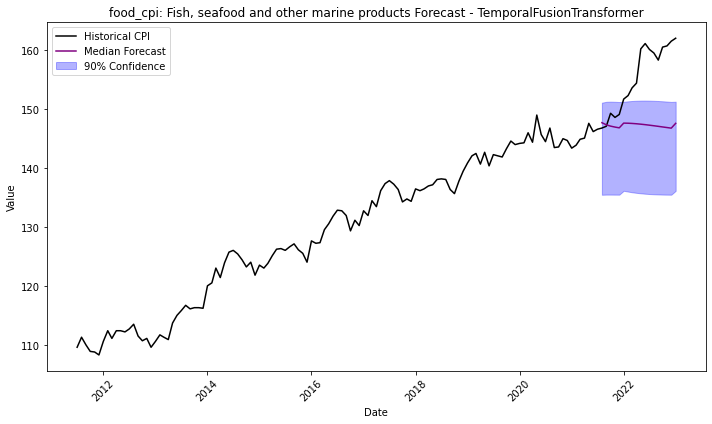

Beginning AutoGluon training... Time limit = 2s
AutoGluon will save models to './output/TEST/ag_global_all_TemporalFusionTransformerModel_exp2_R4_/random_seed_42/2021-07-01/model_files/'
=================== System Info ===================
AutoGluon Version:  1.1.1
Python Version:     3.8.20
Operating System:   Linux
Platform Machine:   x86_64
Platform Version:   #147~18.04.1-Ubuntu SMP Sat Oct 15 13:10:18 UTC 2022
CPU Count:          32
GPU Count:          1
Memory Avail:       166.06 GB / 188.57 GB (88.1%)
Disk Space Avail:   18212.98 GB / 249006.62 GB (7.3%)

Fitting with arguments:
{'enable_ensemble': True,
 'eval_metric': MAPE,
 'excluded_model_types': ['DirectTabular', 'RecursiveTabular'],
 'hyperparameters': {'TemporalFusionTransformerModel': {}},
 'known_covariates_names': [],
 'num_val_windows': 1,
 'prediction_length': 18,
 'quantile_levels': [0.01, 0.05, 0.1, 0.25, 0.75, 0.9, 0.95, 0.99],
 'random_seed': 42,
 'refit_every_n_windows': 1,
 'refit_full': False,
 'skip_model_sele

TemporalFusionTransformerModel


	-0.7075       = Validation score (-MAPE)
	2.14    s     = Training runtime
	0.04    s     = Validation (prediction) runtime
Not fitting ensemble due to lack of time remaining. Time left: -0.3 seconds
Training complete. Models trained: ['TemporalFusionTransformer']
Total runtime: 2.22 s
Best model: TemporalFusionTransformer
Best model score: -0.7075
Model not specified in predict, will default to the model with the best validation score: TemporalFusionTransformer
Model not specified in predict, will default to the model with the best validation score: TemporalFusionTransformer


****************** Summary of fit() ******************
Estimated performance of each model:
                       model  score_val  pred_time_val  fit_time_marginal  \
0  TemporalFusionTransformer  -0.707477       0.042852           2.140646   

   fit_order  
0          1  
Number of models trained: 1
Types of models trained:
{'MultiWindowBacktestingModel'}
****************** End of fit() summary ******************


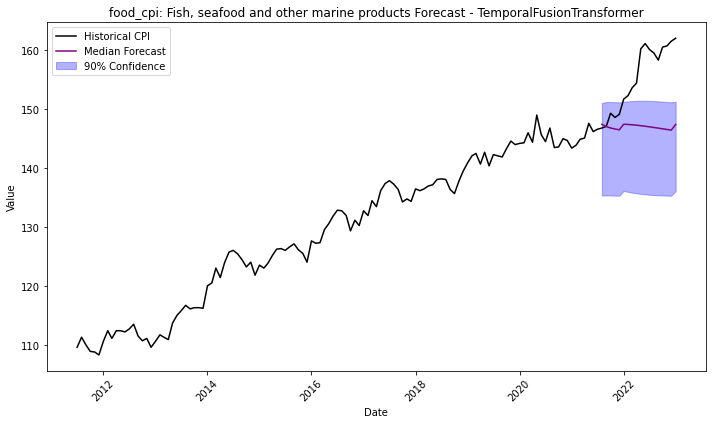

Beginning AutoGluon training... Time limit = 2s
AutoGluon will save models to './output/TEST/ag_global_all_TemporalFusionTransformerModel_exp2_GPT_P1_/random_seed_42/2021-07-01/model_files/'
=================== System Info ===================
AutoGluon Version:  1.1.1
Python Version:     3.8.20
Operating System:   Linux
Platform Machine:   x86_64
Platform Version:   #147~18.04.1-Ubuntu SMP Sat Oct 15 13:10:18 UTC 2022
CPU Count:          32
GPU Count:          1
Memory Avail:       166.06 GB / 188.57 GB (88.1%)
Disk Space Avail:   18212.97 GB / 249006.62 GB (7.3%)

Fitting with arguments:
{'enable_ensemble': True,
 'eval_metric': MAPE,
 'excluded_model_types': ['DirectTabular', 'RecursiveTabular'],
 'hyperparameters': {'TemporalFusionTransformerModel': {}},
 'known_covariates_names': [],
 'num_val_windows': 1,
 'prediction_length': 18,
 'quantile_levels': [0.01, 0.05, 0.1, 0.25, 0.75, 0.9, 0.95, 0.99],
 'random_seed': 42,
 'refit_every_n_windows': 1,
 'refit_full': False,
 'skip_model_

TemporalFusionTransformerModel


	-1.1136       = Validation score (-MAPE)
	2.19    s     = Training runtime
	0.05    s     = Validation (prediction) runtime
Not fitting ensemble due to lack of time remaining. Time left: -0.3 seconds
Training complete. Models trained: ['TemporalFusionTransformer']
Total runtime: 2.27 s
Best model: TemporalFusionTransformer
Best model score: -1.1136
Model not specified in predict, will default to the model with the best validation score: TemporalFusionTransformer
Model not specified in predict, will default to the model with the best validation score: TemporalFusionTransformer


****************** Summary of fit() ******************
Estimated performance of each model:
                       model  score_val  pred_time_val  fit_time_marginal  \
0  TemporalFusionTransformer  -1.113641       0.045654           2.193055   

   fit_order  
0          1  
Number of models trained: 1
Types of models trained:
{'MultiWindowBacktestingModel'}
****************** End of fit() summary ******************


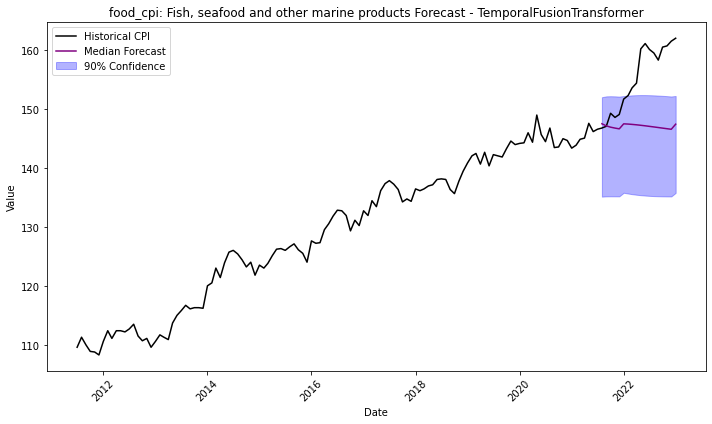

Beginning AutoGluon training... Time limit = 2s
AutoGluon will save models to './output/TEST/ag_global_all_TemporalFusionTransformerModel_exp2_R3_/random_seed_42/2021-07-01/model_files/'
=================== System Info ===================
AutoGluon Version:  1.1.1
Python Version:     3.8.20
Operating System:   Linux
Platform Machine:   x86_64
Platform Version:   #147~18.04.1-Ubuntu SMP Sat Oct 15 13:10:18 UTC 2022
CPU Count:          32
GPU Count:          1
Memory Avail:       166.05 GB / 188.57 GB (88.1%)
Disk Space Avail:   18212.96 GB / 249006.62 GB (7.3%)

Fitting with arguments:
{'enable_ensemble': True,
 'eval_metric': MAPE,
 'excluded_model_types': ['DirectTabular', 'RecursiveTabular'],
 'hyperparameters': {'TemporalFusionTransformerModel': {}},
 'known_covariates_names': [],
 'num_val_windows': 1,
 'prediction_length': 18,
 'quantile_levels': [0.01, 0.05, 0.1, 0.25, 0.75, 0.9, 0.95, 0.99],
 'random_seed': 42,
 'refit_every_n_windows': 1,
 'refit_full': False,
 'skip_model_sele

TemporalFusionTransformerModel


	-0.7122       = Validation score (-MAPE)
	2.15    s     = Training runtime
	0.04    s     = Validation (prediction) runtime
Not fitting ensemble due to lack of time remaining. Time left: -0.3 seconds
Training complete. Models trained: ['TemporalFusionTransformer']
Total runtime: 2.24 s
Best model: TemporalFusionTransformer
Best model score: -0.7122


****************** Summary of fit() ******************
Estimated performance of each model:
                       model  score_val  pred_time_val  fit_time_marginal  \
0  TemporalFusionTransformer  -0.712157       0.044528           2.147736   

   fit_order  
0          1  
Number of models trained: 1
Types of models trained:
{'MultiWindowBacktestingModel'}
****************** End of fit() summary ******************


Model not specified in predict, will default to the model with the best validation score: TemporalFusionTransformer
Model not specified in predict, will default to the model with the best validation score: TemporalFusionTransformer


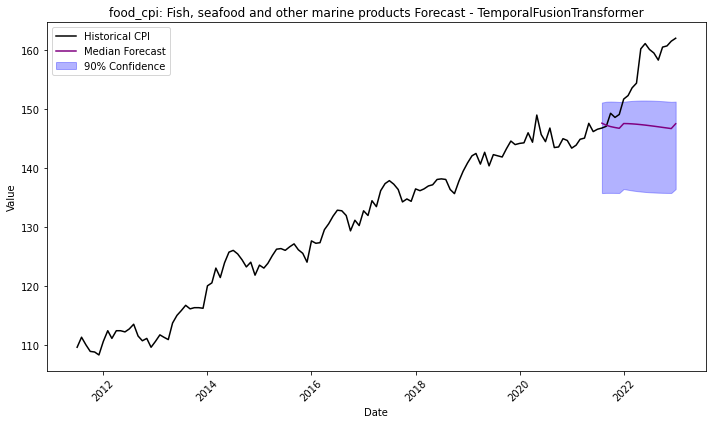

Beginning AutoGluon training... Time limit = 2s
AutoGluon will save models to './output/TEST/ag_global_all_TemporalFusionTransformerModel_exp2_GPT_P4_/random_seed_42/2021-07-01/model_files/'
=================== System Info ===================
AutoGluon Version:  1.1.1
Python Version:     3.8.20
Operating System:   Linux
Platform Machine:   x86_64
Platform Version:   #147~18.04.1-Ubuntu SMP Sat Oct 15 13:10:18 UTC 2022
CPU Count:          32
GPU Count:          1
Memory Avail:       166.22 GB / 188.57 GB (88.1%)
Disk Space Avail:   18212.95 GB / 249006.62 GB (7.3%)

Fitting with arguments:
{'enable_ensemble': True,
 'eval_metric': MAPE,
 'excluded_model_types': ['DirectTabular', 'RecursiveTabular'],
 'hyperparameters': {'TemporalFusionTransformerModel': {}},
 'known_covariates_names': [],
 'num_val_windows': 1,
 'prediction_length': 18,
 'quantile_levels': [0.01, 0.05, 0.1, 0.25, 0.75, 0.9, 0.95, 0.99],
 'random_seed': 42,
 'refit_every_n_windows': 1,
 'refit_full': False,
 'skip_model_

TemporalFusionTransformerModel


	-0.8874       = Validation score (-MAPE)
	2.16    s     = Training runtime
	0.04    s     = Validation (prediction) runtime
Not fitting ensemble due to lack of time remaining. Time left: -0.3 seconds
Training complete. Models trained: ['TemporalFusionTransformer']
Total runtime: 2.25 s
Best model: TemporalFusionTransformer
Best model score: -0.8874
Model not specified in predict, will default to the model with the best validation score: TemporalFusionTransformer
Model not specified in predict, will default to the model with the best validation score: TemporalFusionTransformer


****************** Summary of fit() ******************
Estimated performance of each model:
                       model  score_val  pred_time_val  fit_time_marginal  \
0  TemporalFusionTransformer  -0.887397       0.040308           2.164348   

   fit_order  
0          1  
Number of models trained: 1
Types of models trained:
{'MultiWindowBacktestingModel'}
****************** End of fit() summary ******************


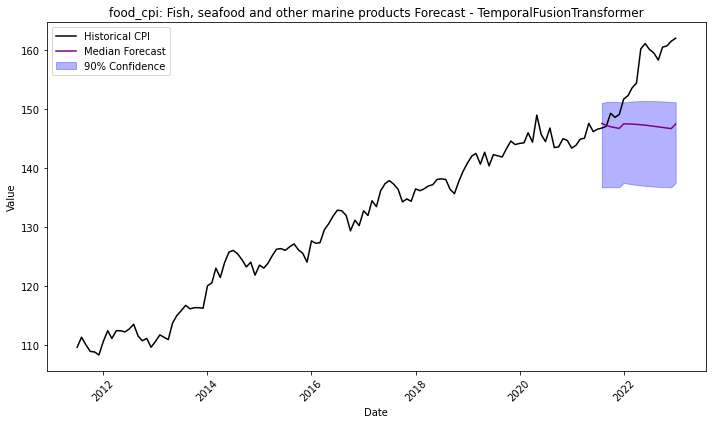

Beginning AutoGluon training... Time limit = 2s
AutoGluon will save models to './output/TEST/ag_global_all_TemporalFusionTransformerModel_exp2_R1_/random_seed_42/2021-07-01/model_files/'
=================== System Info ===================
AutoGluon Version:  1.1.1
Python Version:     3.8.20
Operating System:   Linux
Platform Machine:   x86_64
Platform Version:   #147~18.04.1-Ubuntu SMP Sat Oct 15 13:10:18 UTC 2022
CPU Count:          32
GPU Count:          1
Memory Avail:       166.06 GB / 188.57 GB (88.1%)
Disk Space Avail:   18212.94 GB / 249006.62 GB (7.3%)

Fitting with arguments:
{'enable_ensemble': True,
 'eval_metric': MAPE,
 'excluded_model_types': ['DirectTabular', 'RecursiveTabular'],
 'hyperparameters': {'TemporalFusionTransformerModel': {}},
 'known_covariates_names': [],
 'num_val_windows': 1,
 'prediction_length': 18,
 'quantile_levels': [0.01, 0.05, 0.1, 0.25, 0.75, 0.9, 0.95, 0.99],
 'random_seed': 42,
 'refit_every_n_windows': 1,
 'refit_full': False,
 'skip_model_sele

TemporalFusionTransformerModel


	-1.0412       = Validation score (-MAPE)
	2.13    s     = Training runtime
	0.04    s     = Validation (prediction) runtime
Not fitting ensemble due to lack of time remaining. Time left: -0.3 seconds
Training complete. Models trained: ['TemporalFusionTransformer']
Total runtime: 2.21 s
Best model: TemporalFusionTransformer
Best model score: -1.0412
Model not specified in predict, will default to the model with the best validation score: TemporalFusionTransformer
Model not specified in predict, will default to the model with the best validation score: TemporalFusionTransformer


****************** Summary of fit() ******************
Estimated performance of each model:
                       model  score_val  pred_time_val  fit_time_marginal  \
0  TemporalFusionTransformer   -1.04118       0.041443           2.129297   

   fit_order  
0          1  
Number of models trained: 1
Types of models trained:
{'MultiWindowBacktestingModel'}
****************** End of fit() summary ******************


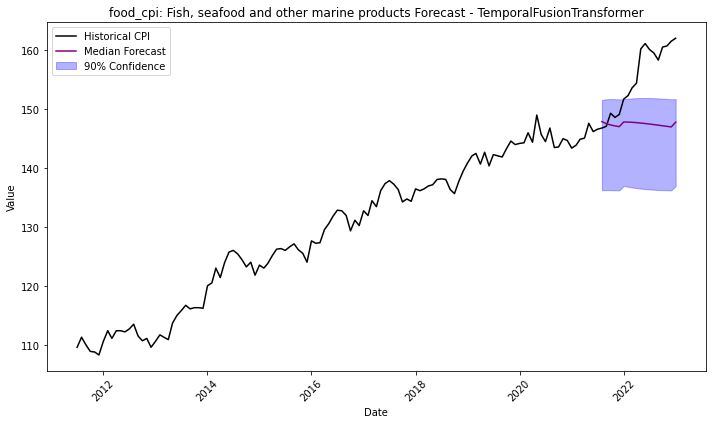

Beginning AutoGluon training... Time limit = 2s
AutoGluon will save models to './output/TEST/ag_global_all_TemporalFusionTransformerModel_exp2_GPT_P3_/random_seed_42/2021-07-01/model_files/'
=================== System Info ===================
AutoGluon Version:  1.1.1
Python Version:     3.8.20
Operating System:   Linux
Platform Machine:   x86_64
Platform Version:   #147~18.04.1-Ubuntu SMP Sat Oct 15 13:10:18 UTC 2022
CPU Count:          32
GPU Count:          1
Memory Avail:       166.06 GB / 188.57 GB (88.1%)
Disk Space Avail:   18212.93 GB / 249006.62 GB (7.3%)

Fitting with arguments:
{'enable_ensemble': True,
 'eval_metric': MAPE,
 'excluded_model_types': ['DirectTabular', 'RecursiveTabular'],
 'hyperparameters': {'TemporalFusionTransformerModel': {}},
 'known_covariates_names': [],
 'num_val_windows': 1,
 'prediction_length': 18,
 'quantile_levels': [0.01, 0.05, 0.1, 0.25, 0.75, 0.9, 0.95, 0.99],
 'random_seed': 42,
 'refit_every_n_windows': 1,
 'refit_full': False,
 'skip_model_

TemporalFusionTransformerModel


	-1.1600       = Validation score (-MAPE)
	2.14    s     = Training runtime
	0.04    s     = Validation (prediction) runtime
Not fitting ensemble due to lack of time remaining. Time left: -0.3 seconds
Training complete. Models trained: ['TemporalFusionTransformer']
Total runtime: 2.22 s
Best model: TemporalFusionTransformer
Best model score: -1.1600
Model not specified in predict, will default to the model with the best validation score: TemporalFusionTransformer
Model not specified in predict, will default to the model with the best validation score: TemporalFusionTransformer


****************** Summary of fit() ******************
Estimated performance of each model:
                       model  score_val  pred_time_val  fit_time_marginal  \
0  TemporalFusionTransformer  -1.159989       0.043079           2.138327   

   fit_order  
0          1  
Number of models trained: 1
Types of models trained:
{'MultiWindowBacktestingModel'}
****************** End of fit() summary ******************


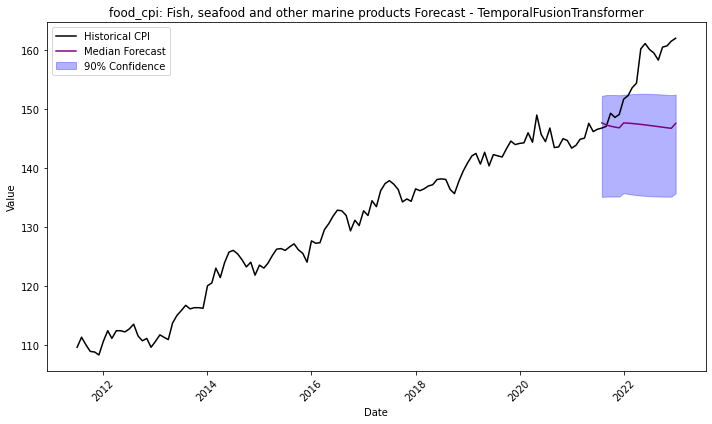

Beginning AutoGluon training... Time limit = 2s
AutoGluon will save models to './output/TEST/ag_global_all_TemporalFusionTransformerModel_exp2_GPT_P2_/random_seed_42/2021-07-01/model_files/'
=================== System Info ===================
AutoGluon Version:  1.1.1
Python Version:     3.8.20
Operating System:   Linux
Platform Machine:   x86_64
Platform Version:   #147~18.04.1-Ubuntu SMP Sat Oct 15 13:10:18 UTC 2022
CPU Count:          32
GPU Count:          1
Memory Avail:       166.10 GB / 188.57 GB (88.1%)
Disk Space Avail:   18212.97 GB / 249006.62 GB (7.3%)

Fitting with arguments:
{'enable_ensemble': True,
 'eval_metric': MAPE,
 'excluded_model_types': ['DirectTabular', 'RecursiveTabular'],
 'hyperparameters': {'TemporalFusionTransformerModel': {}},
 'known_covariates_names': [],
 'num_val_windows': 1,
 'prediction_length': 18,
 'quantile_levels': [0.01, 0.05, 0.1, 0.25, 0.75, 0.9, 0.95, 0.99],
 'random_seed': 42,
 'refit_every_n_windows': 1,
 'refit_full': False,
 'skip_model_

TemporalFusionTransformerModel


	-1.0989       = Validation score (-MAPE)
	2.11    s     = Training runtime
	0.04    s     = Validation (prediction) runtime
Not fitting ensemble due to lack of time remaining. Time left: -0.2 seconds
Training complete. Models trained: ['TemporalFusionTransformer']
Total runtime: 2.18 s
Best model: TemporalFusionTransformer
Best model score: -1.0989
Model not specified in predict, will default to the model with the best validation score: TemporalFusionTransformer
Model not specified in predict, will default to the model with the best validation score: TemporalFusionTransformer


****************** Summary of fit() ******************
Estimated performance of each model:
                       model  score_val  pred_time_val  fit_time_marginal  \
0  TemporalFusionTransformer   -1.09895       0.041233           2.111058   

   fit_order  
0          1  
Number of models trained: 1
Types of models trained:
{'MultiWindowBacktestingModel'}
****************** End of fit() summary ******************


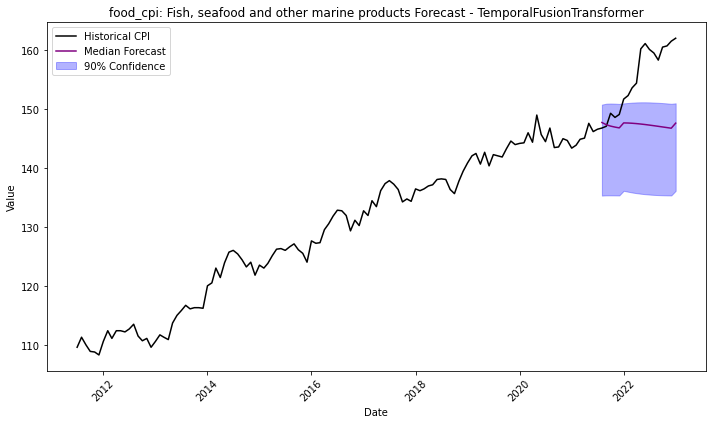

Beginning AutoGluon training... Time limit = 2s
AutoGluon will save models to './output/TEST/ag_global_all_TemporalFusionTransformerModel_exp2_R2_/random_seed_42/2022-07-01/model_files/'
=================== System Info ===================
AutoGluon Version:  1.1.1
Python Version:     3.8.20
Operating System:   Linux
Platform Machine:   x86_64
Platform Version:   #147~18.04.1-Ubuntu SMP Sat Oct 15 13:10:18 UTC 2022
CPU Count:          32
GPU Count:          1
Memory Avail:       166.05 GB / 188.57 GB (88.1%)
Disk Space Avail:   18212.96 GB / 249006.62 GB (7.3%)

Fitting with arguments:
{'enable_ensemble': True,
 'eval_metric': MAPE,
 'excluded_model_types': ['DirectTabular', 'RecursiveTabular'],
 'hyperparameters': {'TemporalFusionTransformerModel': {}},
 'known_covariates_names': [],
 'num_val_windows': 1,
 'prediction_length': 18,
 'quantile_levels': [0.01, 0.05, 0.1, 0.25, 0.75, 0.9, 0.95, 0.99],
 'random_seed': 42,
 'refit_every_n_windows': 1,
 'refit_full': False,
 'skip_model_sele

TemporalFusionTransformerModel


	-0.5577       = Validation score (-MAPE)
	2.13    s     = Training runtime
	0.04    s     = Validation (prediction) runtime
Not fitting ensemble due to lack of time remaining. Time left: -0.3 seconds
Training complete. Models trained: ['TemporalFusionTransformer']
Total runtime: 2.21 s
Best model: TemporalFusionTransformer
Best model score: -0.5577
Model not specified in predict, will default to the model with the best validation score: TemporalFusionTransformer
Model not specified in predict, will default to the model with the best validation score: TemporalFusionTransformer


****************** Summary of fit() ******************
Estimated performance of each model:
                       model  score_val  pred_time_val  fit_time_marginal  \
0  TemporalFusionTransformer   -0.55771        0.04497           2.129265   

   fit_order  
0          1  
Number of models trained: 1
Types of models trained:
{'MultiWindowBacktestingModel'}
****************** End of fit() summary ******************


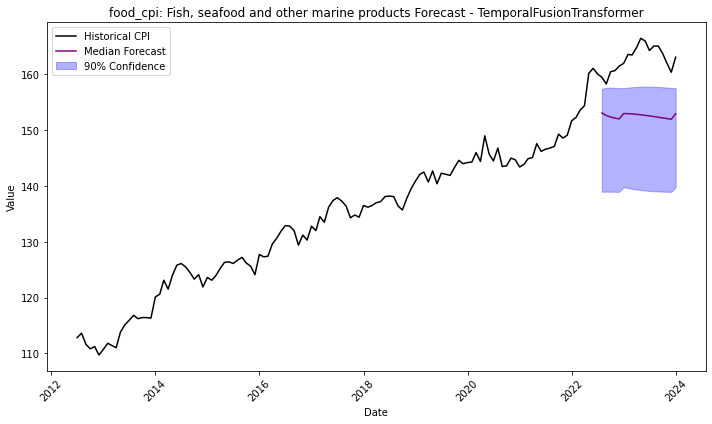

Beginning AutoGluon training... Time limit = 2s
AutoGluon will save models to './output/TEST/ag_global_all_TemporalFusionTransformerModel_exp2_R4_/random_seed_42/2022-07-01/model_files/'
=================== System Info ===================
AutoGluon Version:  1.1.1
Python Version:     3.8.20
Operating System:   Linux
Platform Machine:   x86_64
Platform Version:   #147~18.04.1-Ubuntu SMP Sat Oct 15 13:10:18 UTC 2022
CPU Count:          32
GPU Count:          1
Memory Avail:       166.06 GB / 188.57 GB (88.1%)
Disk Space Avail:   18212.95 GB / 249006.62 GB (7.3%)

Fitting with arguments:
{'enable_ensemble': True,
 'eval_metric': MAPE,
 'excluded_model_types': ['DirectTabular', 'RecursiveTabular'],
 'hyperparameters': {'TemporalFusionTransformerModel': {}},
 'known_covariates_names': [],
 'num_val_windows': 1,
 'prediction_length': 18,
 'quantile_levels': [0.01, 0.05, 0.1, 0.25, 0.75, 0.9, 0.95, 0.99],
 'random_seed': 42,
 'refit_every_n_windows': 1,
 'refit_full': False,
 'skip_model_sele

TemporalFusionTransformerModel


Inferred time series frequency: 'MS'
Provided train_data has 9658 rows, 22 time series. Median time series length is 439 (min=439, max=439). 

Provided data contains following columns:
	target: 'target'

AutoGluon will gauge predictive performance using evaluation metric: 'MAPE'
	This metric's sign has been flipped to adhere to being higher_is_better. The metric score can be multiplied by -1 to get the metric value.

Starting training. Start time is 2024-10-27 07:34:50
Excluded model types: ['DirectTabular', 'RecursiveTabular']
Models that will be trained: ['TemporalFusionTransformer']
Training timeseries model TemporalFusionTransformer. Training for up to 1.6s of the 1.6s of remaining time.
	-5.3844       = Validation score (-MAPE)
	1.88    s     = Training runtime
	0.04    s     = Validation (prediction) runtime
Not fitting ensemble due to lack of time remaining. Time left: -0.3 seconds
Training complete. Models trained: ['TemporalFusionTransformer']
Total runtime: 1.97 s
Best model:

****************** Summary of fit() ******************
Estimated performance of each model:
                       model  score_val  pred_time_val  fit_time_marginal  \
0  TemporalFusionTransformer  -5.384368       0.042579           1.884289   

   fit_order  
0          1  
Number of models trained: 1
Types of models trained:
{'MultiWindowBacktestingModel'}
****************** End of fit() summary ******************


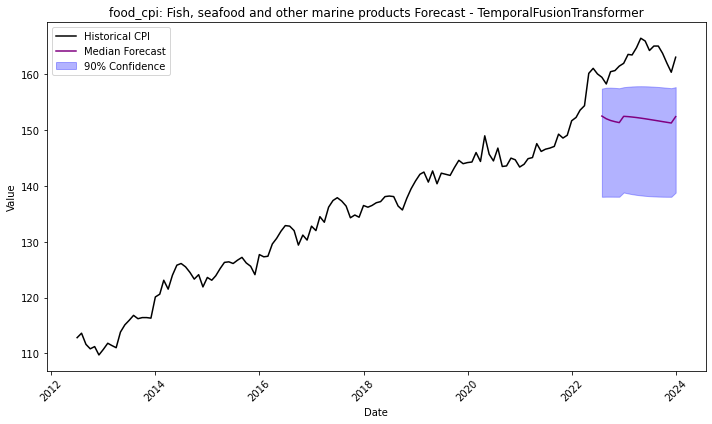

Beginning AutoGluon training... Time limit = 2s
AutoGluon will save models to './output/TEST/ag_global_all_TemporalFusionTransformerModel_exp2_GPT_P1_/random_seed_42/2022-07-01/model_files/'
=================== System Info ===================
AutoGluon Version:  1.1.1
Python Version:     3.8.20
Operating System:   Linux
Platform Machine:   x86_64
Platform Version:   #147~18.04.1-Ubuntu SMP Sat Oct 15 13:10:18 UTC 2022
CPU Count:          32
GPU Count:          1
Memory Avail:       166.05 GB / 188.57 GB (88.1%)
Disk Space Avail:   18212.95 GB / 249006.62 GB (7.3%)

Fitting with arguments:
{'enable_ensemble': True,
 'eval_metric': MAPE,
 'excluded_model_types': ['DirectTabular', 'RecursiveTabular'],
 'hyperparameters': {'TemporalFusionTransformerModel': {}},
 'known_covariates_names': [],
 'num_val_windows': 1,
 'prediction_length': 18,
 'quantile_levels': [0.01, 0.05, 0.1, 0.25, 0.75, 0.9, 0.95, 0.99],
 'random_seed': 42,
 'refit_every_n_windows': 1,
 'refit_full': False,
 'skip_model_

TemporalFusionTransformerModel


	-5.5467       = Validation score (-MAPE)
	2.13    s     = Training runtime
	0.05    s     = Validation (prediction) runtime
Not fitting ensemble due to lack of time remaining. Time left: -0.3 seconds
Training complete. Models trained: ['TemporalFusionTransformer']
Total runtime: 2.21 s
Best model: TemporalFusionTransformer
Best model score: -5.5467
Model not specified in predict, will default to the model with the best validation score: TemporalFusionTransformer
Model not specified in predict, will default to the model with the best validation score: TemporalFusionTransformer


****************** Summary of fit() ******************
Estimated performance of each model:
                       model  score_val  pred_time_val  fit_time_marginal  \
0  TemporalFusionTransformer  -5.546715       0.047303           2.131349   

   fit_order  
0          1  
Number of models trained: 1
Types of models trained:
{'MultiWindowBacktestingModel'}
****************** End of fit() summary ******************


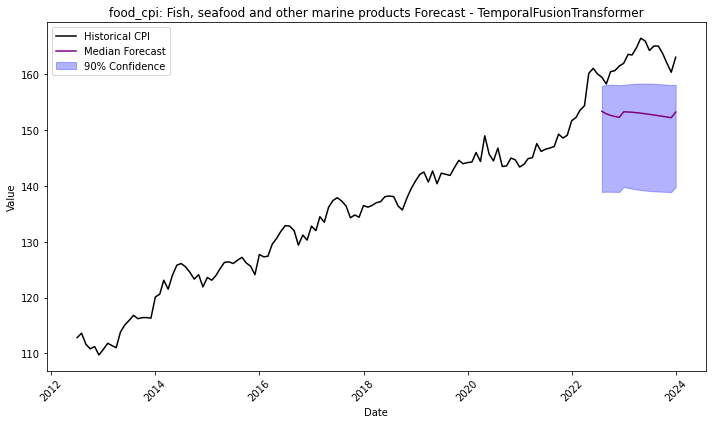

Beginning AutoGluon training... Time limit = 2s
AutoGluon will save models to './output/TEST/ag_global_all_TemporalFusionTransformerModel_exp2_R3_/random_seed_42/2022-07-01/model_files/'
=================== System Info ===================
AutoGluon Version:  1.1.1
Python Version:     3.8.20
Operating System:   Linux
Platform Machine:   x86_64
Platform Version:   #147~18.04.1-Ubuntu SMP Sat Oct 15 13:10:18 UTC 2022
CPU Count:          32
GPU Count:          1
Memory Avail:       166.06 GB / 188.57 GB (88.1%)
Disk Space Avail:   18212.94 GB / 249006.62 GB (7.3%)

Fitting with arguments:
{'enable_ensemble': True,
 'eval_metric': MAPE,
 'excluded_model_types': ['DirectTabular', 'RecursiveTabular'],
 'hyperparameters': {'TemporalFusionTransformerModel': {}},
 'known_covariates_names': [],
 'num_val_windows': 1,
 'prediction_length': 18,
 'quantile_levels': [0.01, 0.05, 0.1, 0.25, 0.75, 0.9, 0.95, 0.99],
 'random_seed': 42,
 'refit_every_n_windows': 1,
 'refit_full': False,
 'skip_model_sele

TemporalFusionTransformerModel


	-0.4260       = Validation score (-MAPE)
	2.12    s     = Training runtime
	0.04    s     = Validation (prediction) runtime
Not fitting ensemble due to lack of time remaining. Time left: -0.3 seconds
Training complete. Models trained: ['TemporalFusionTransformer']
Total runtime: 2.20 s
Best model: TemporalFusionTransformer
Best model score: -0.4260
Model not specified in predict, will default to the model with the best validation score: TemporalFusionTransformer
Model not specified in predict, will default to the model with the best validation score: TemporalFusionTransformer


****************** Summary of fit() ******************
Estimated performance of each model:
                       model  score_val  pred_time_val  fit_time_marginal  \
0  TemporalFusionTransformer  -0.425989       0.044923            2.11953   

   fit_order  
0          1  
Number of models trained: 1
Types of models trained:
{'MultiWindowBacktestingModel'}
****************** End of fit() summary ******************


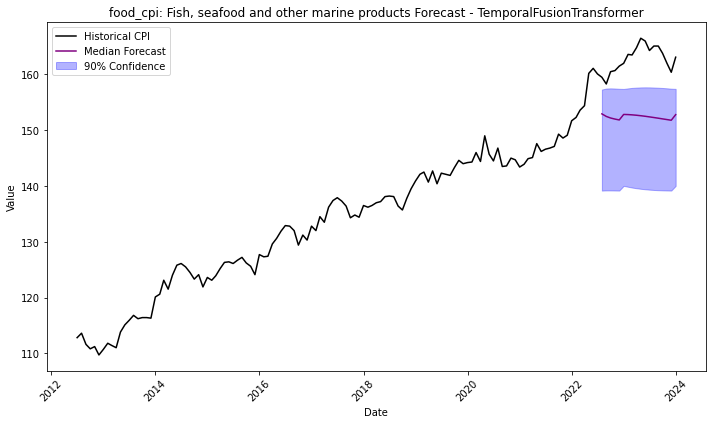

Beginning AutoGluon training... Time limit = 2s
AutoGluon will save models to './output/TEST/ag_global_all_TemporalFusionTransformerModel_exp2_GPT_P4_/random_seed_42/2022-07-01/model_files/'
=================== System Info ===================
AutoGluon Version:  1.1.1
Python Version:     3.8.20
Operating System:   Linux
Platform Machine:   x86_64
Platform Version:   #147~18.04.1-Ubuntu SMP Sat Oct 15 13:10:18 UTC 2022
CPU Count:          32
GPU Count:          1
Memory Avail:       166.08 GB / 188.57 GB (88.1%)
Disk Space Avail:   18212.93 GB / 249006.62 GB (7.3%)

Fitting with arguments:
{'enable_ensemble': True,
 'eval_metric': MAPE,
 'excluded_model_types': ['DirectTabular', 'RecursiveTabular'],
 'hyperparameters': {'TemporalFusionTransformerModel': {}},
 'known_covariates_names': [],
 'num_val_windows': 1,
 'prediction_length': 18,
 'quantile_levels': [0.01, 0.05, 0.1, 0.25, 0.75, 0.9, 0.95, 0.99],
 'random_seed': 42,
 'refit_every_n_windows': 1,
 'refit_full': False,
 'skip_model_

TemporalFusionTransformerModel


	-6.6064       = Validation score (-MAPE)
	2.12    s     = Training runtime
	0.04    s     = Validation (prediction) runtime
Not fitting ensemble due to lack of time remaining. Time left: -0.2 seconds
Training complete. Models trained: ['TemporalFusionTransformer']
Total runtime: 2.20 s
Best model: TemporalFusionTransformer
Best model score: -6.6064
Model not specified in predict, will default to the model with the best validation score: TemporalFusionTransformer
Model not specified in predict, will default to the model with the best validation score: TemporalFusionTransformer


****************** Summary of fit() ******************
Estimated performance of each model:
                       model  score_val  pred_time_val  fit_time_marginal  \
0  TemporalFusionTransformer  -6.606448       0.039999           2.118858   

   fit_order  
0          1  
Number of models trained: 1
Types of models trained:
{'MultiWindowBacktestingModel'}
****************** End of fit() summary ******************


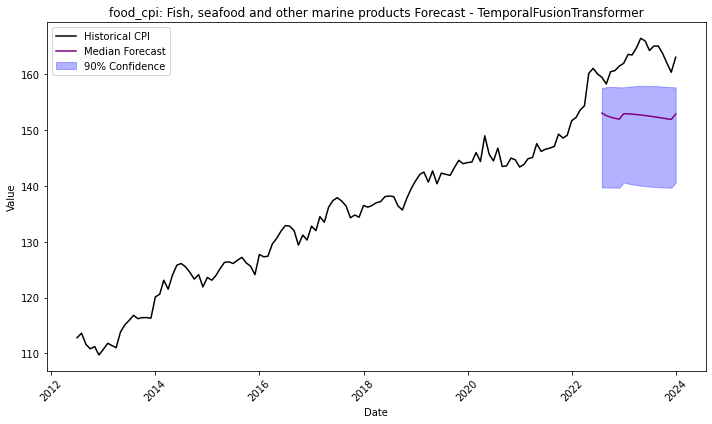

Beginning AutoGluon training... Time limit = 2s
AutoGluon will save models to './output/TEST/ag_global_all_TemporalFusionTransformerModel_exp2_R1_/random_seed_42/2022-07-01/model_files/'
=================== System Info ===================
AutoGluon Version:  1.1.1
Python Version:     3.8.20
Operating System:   Linux
Platform Machine:   x86_64
Platform Version:   #147~18.04.1-Ubuntu SMP Sat Oct 15 13:10:18 UTC 2022
CPU Count:          32
GPU Count:          1
Memory Avail:       166.06 GB / 188.57 GB (88.1%)
Disk Space Avail:   18212.98 GB / 249006.62 GB (7.3%)

Fitting with arguments:
{'enable_ensemble': True,
 'eval_metric': MAPE,
 'excluded_model_types': ['DirectTabular', 'RecursiveTabular'],
 'hyperparameters': {'TemporalFusionTransformerModel': {}},
 'known_covariates_names': [],
 'num_val_windows': 1,
 'prediction_length': 18,
 'quantile_levels': [0.01, 0.05, 0.1, 0.25, 0.75, 0.9, 0.95, 0.99],
 'random_seed': 42,
 'refit_every_n_windows': 1,
 'refit_full': False,
 'skip_model_sele

TemporalFusionTransformerModel


	-5.7947       = Validation score (-MAPE)
	2.13    s     = Training runtime
	0.04    s     = Validation (prediction) runtime
Not fitting ensemble due to lack of time remaining. Time left: -0.3 seconds
Training complete. Models trained: ['TemporalFusionTransformer']
Total runtime: 2.22 s
Best model: TemporalFusionTransformer
Best model score: -5.7947
Model not specified in predict, will default to the model with the best validation score: TemporalFusionTransformer
Model not specified in predict, will default to the model with the best validation score: TemporalFusionTransformer


****************** Summary of fit() ******************
Estimated performance of each model:
                       model  score_val  pred_time_val  fit_time_marginal  \
0  TemporalFusionTransformer  -5.794719       0.043238           2.127339   

   fit_order  
0          1  
Number of models trained: 1
Types of models trained:
{'MultiWindowBacktestingModel'}
****************** End of fit() summary ******************


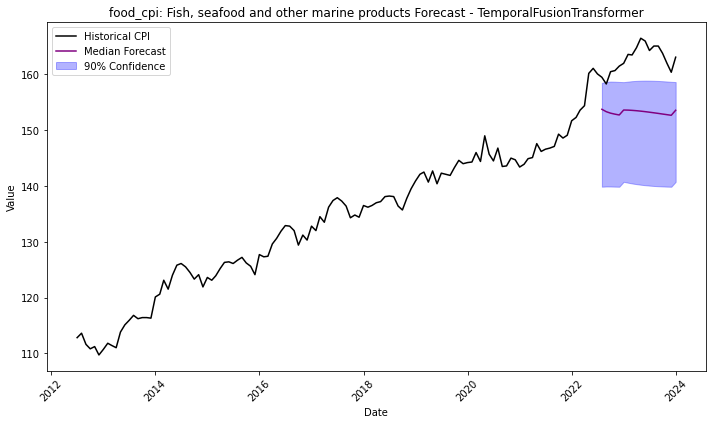

Beginning AutoGluon training... Time limit = 2s
AutoGluon will save models to './output/TEST/ag_global_all_TemporalFusionTransformerModel_exp2_GPT_P3_/random_seed_42/2022-07-01/model_files/'
=================== System Info ===================
AutoGluon Version:  1.1.1
Python Version:     3.8.20
Operating System:   Linux
Platform Machine:   x86_64
Platform Version:   #147~18.04.1-Ubuntu SMP Sat Oct 15 13:10:18 UTC 2022
CPU Count:          32
GPU Count:          1
Memory Avail:       166.06 GB / 188.57 GB (88.1%)
Disk Space Avail:   18212.97 GB / 249006.62 GB (7.3%)

Fitting with arguments:
{'enable_ensemble': True,
 'eval_metric': MAPE,
 'excluded_model_types': ['DirectTabular', 'RecursiveTabular'],
 'hyperparameters': {'TemporalFusionTransformerModel': {}},
 'known_covariates_names': [],
 'num_val_windows': 1,
 'prediction_length': 18,
 'quantile_levels': [0.01, 0.05, 0.1, 0.25, 0.75, 0.9, 0.95, 0.99],
 'random_seed': 42,
 'refit_every_n_windows': 1,
 'refit_full': False,
 'skip_model_

TemporalFusionTransformerModel


	-5.7474       = Validation score (-MAPE)
	2.14    s     = Training runtime
	0.05    s     = Validation (prediction) runtime
Not fitting ensemble due to lack of time remaining. Time left: -0.3 seconds
Training complete. Models trained: ['TemporalFusionTransformer']
Total runtime: 2.23 s
Best model: TemporalFusionTransformer
Best model score: -5.7474


****************** Summary of fit() ******************
Estimated performance of each model:
                       model  score_val  pred_time_val  fit_time_marginal  \
0  TemporalFusionTransformer  -5.747354       0.045348           2.135137   

   fit_order  
0          1  
Number of models trained: 1
Types of models trained:
{'MultiWindowBacktestingModel'}
****************** End of fit() summary ******************


Model not specified in predict, will default to the model with the best validation score: TemporalFusionTransformer
Model not specified in predict, will default to the model with the best validation score: TemporalFusionTransformer


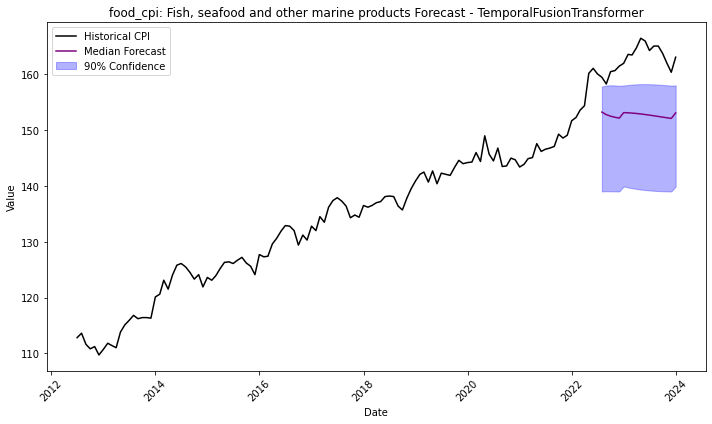

Beginning AutoGluon training... Time limit = 2s
AutoGluon will save models to './output/TEST/ag_global_all_TemporalFusionTransformerModel_exp2_GPT_P2_/random_seed_42/2022-07-01/model_files/'
=================== System Info ===================
AutoGluon Version:  1.1.1
Python Version:     3.8.20
Operating System:   Linux
Platform Machine:   x86_64
Platform Version:   #147~18.04.1-Ubuntu SMP Sat Oct 15 13:10:18 UTC 2022
CPU Count:          32
GPU Count:          1
Memory Avail:       166.06 GB / 188.57 GB (88.1%)
Disk Space Avail:   18212.96 GB / 249006.62 GB (7.3%)

Fitting with arguments:
{'enable_ensemble': True,
 'eval_metric': MAPE,
 'excluded_model_types': ['DirectTabular', 'RecursiveTabular'],
 'hyperparameters': {'TemporalFusionTransformerModel': {}},
 'known_covariates_names': [],
 'num_val_windows': 1,
 'prediction_length': 18,
 'quantile_levels': [0.01, 0.05, 0.1, 0.25, 0.75, 0.9, 0.95, 0.99],
 'random_seed': 42,
 'refit_every_n_windows': 1,
 'refit_full': False,
 'skip_model_

TemporalFusionTransformerModel


	-6.3023       = Validation score (-MAPE)
	2.11    s     = Training runtime
	0.04    s     = Validation (prediction) runtime
Not fitting ensemble due to lack of time remaining. Time left: -0.2 seconds
Training complete. Models trained: ['TemporalFusionTransformer']
Total runtime: 2.19 s
Best model: TemporalFusionTransformer
Best model score: -6.3023
Model not specified in predict, will default to the model with the best validation score: TemporalFusionTransformer
Model not specified in predict, will default to the model with the best validation score: TemporalFusionTransformer


****************** Summary of fit() ******************
Estimated performance of each model:
                       model  score_val  pred_time_val  fit_time_marginal  \
0  TemporalFusionTransformer   -6.30231       0.040773           2.111806   

   fit_order  
0          1  
Number of models trained: 1
Types of models trained:
{'MultiWindowBacktestingModel'}
****************** End of fit() summary ******************


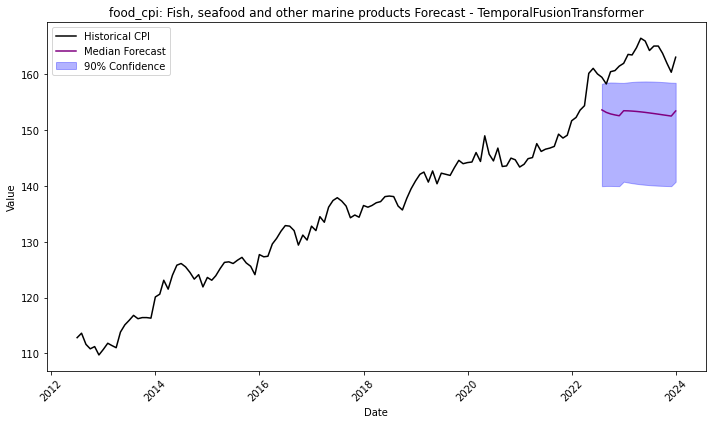

Beginning AutoGluon training... Time limit = 2s
AutoGluon will save models to './output/TEST/ag_global_all_TemporalFusionTransformerModel_exp2_R2_/random_seed_42/2023-07-01/model_files/'
=================== System Info ===================
AutoGluon Version:  1.1.1
Python Version:     3.8.20
Operating System:   Linux
Platform Machine:   x86_64
Platform Version:   #147~18.04.1-Ubuntu SMP Sat Oct 15 13:10:18 UTC 2022
CPU Count:          32
GPU Count:          1
Memory Avail:       166.06 GB / 188.57 GB (88.1%)
Disk Space Avail:   18212.95 GB / 249006.62 GB (7.3%)

Fitting with arguments:
{'enable_ensemble': True,
 'eval_metric': MAPE,
 'excluded_model_types': ['DirectTabular', 'RecursiveTabular'],
 'hyperparameters': {'TemporalFusionTransformerModel': {}},
 'known_covariates_names': [],
 'num_val_windows': 1,
 'prediction_length': 18,
 'quantile_levels': [0.01, 0.05, 0.1, 0.25, 0.75, 0.9, 0.95, 0.99],
 'random_seed': 42,
 'refit_every_n_windows': 1,
 'refit_full': False,
 'skip_model_sele

TemporalFusionTransformerModel


	-0.5325       = Validation score (-MAPE)
	2.12    s     = Training runtime
	0.04    s     = Validation (prediction) runtime
Not fitting ensemble due to lack of time remaining. Time left: -0.3 seconds
Training complete. Models trained: ['TemporalFusionTransformer']
Total runtime: 2.20 s
Best model: TemporalFusionTransformer
Best model score: -0.5325
Model not specified in predict, will default to the model with the best validation score: TemporalFusionTransformer
Model not specified in predict, will default to the model with the best validation score: TemporalFusionTransformer


****************** Summary of fit() ******************
Estimated performance of each model:
                       model  score_val  pred_time_val  fit_time_marginal  \
0  TemporalFusionTransformer  -0.532477       0.044105           2.121583   

   fit_order  
0          1  
Number of models trained: 1
Types of models trained:
{'MultiWindowBacktestingModel'}
****************** End of fit() summary ******************


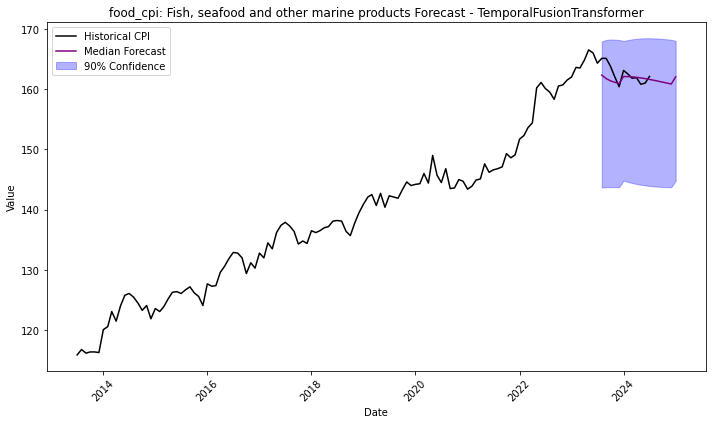

Beginning AutoGluon training... Time limit = 2s
AutoGluon will save models to './output/TEST/ag_global_all_TemporalFusionTransformerModel_exp2_R4_/random_seed_42/2023-07-01/model_files/'
=================== System Info ===================
AutoGluon Version:  1.1.1
Python Version:     3.8.20
Operating System:   Linux
Platform Machine:   x86_64
Platform Version:   #147~18.04.1-Ubuntu SMP Sat Oct 15 13:10:18 UTC 2022
CPU Count:          32
GPU Count:          1
Memory Avail:       166.78 GB / 188.57 GB (88.4%)
Disk Space Avail:   18212.95 GB / 249006.62 GB (7.3%)

Fitting with arguments:
{'enable_ensemble': True,
 'eval_metric': MAPE,
 'excluded_model_types': ['DirectTabular', 'RecursiveTabular'],
 'hyperparameters': {'TemporalFusionTransformerModel': {}},
 'known_covariates_names': [],
 'num_val_windows': 1,
 'prediction_length': 18,
 'quantile_levels': [0.01, 0.05, 0.1, 0.25, 0.75, 0.9, 0.95, 0.99],
 'random_seed': 42,
 'refit_every_n_windows': 1,
 'refit_full': False,
 'skip_model_sele

TemporalFusionTransformerModel


	-0.8099       = Validation score (-MAPE)
	2.10    s     = Training runtime
	0.04    s     = Validation (prediction) runtime
Not fitting ensemble due to lack of time remaining. Time left: -0.2 seconds
Training complete. Models trained: ['TemporalFusionTransformer']
Total runtime: 2.18 s
Best model: TemporalFusionTransformer
Best model score: -0.8099
Model not specified in predict, will default to the model with the best validation score: TemporalFusionTransformer
Model not specified in predict, will default to the model with the best validation score: TemporalFusionTransformer


****************** Summary of fit() ******************
Estimated performance of each model:
                       model  score_val  pred_time_val  fit_time_marginal  \
0  TemporalFusionTransformer  -0.809874       0.043344           2.102255   

   fit_order  
0          1  
Number of models trained: 1
Types of models trained:
{'MultiWindowBacktestingModel'}
****************** End of fit() summary ******************


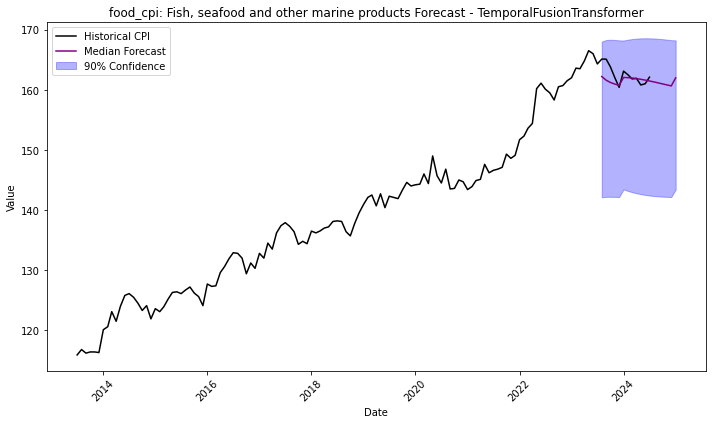

Beginning AutoGluon training... Time limit = 2s
AutoGluon will save models to './output/TEST/ag_global_all_TemporalFusionTransformerModel_exp2_GPT_P1_/random_seed_42/2023-07-01/model_files/'
=================== System Info ===================
AutoGluon Version:  1.1.1
Python Version:     3.8.20
Operating System:   Linux
Platform Machine:   x86_64
Platform Version:   #147~18.04.1-Ubuntu SMP Sat Oct 15 13:10:18 UTC 2022
CPU Count:          32
GPU Count:          1
Memory Avail:       166.78 GB / 188.57 GB (88.4%)
Disk Space Avail:   18212.94 GB / 249006.62 GB (7.3%)

Fitting with arguments:
{'enable_ensemble': True,
 'eval_metric': MAPE,
 'excluded_model_types': ['DirectTabular', 'RecursiveTabular'],
 'hyperparameters': {'TemporalFusionTransformerModel': {}},
 'known_covariates_names': [],
 'num_val_windows': 1,
 'prediction_length': 18,
 'quantile_levels': [0.01, 0.05, 0.1, 0.25, 0.75, 0.9, 0.95, 0.99],
 'random_seed': 42,
 'refit_every_n_windows': 1,
 'refit_full': False,
 'skip_model_

TemporalFusionTransformerModel


	-0.7093       = Validation score (-MAPE)
	2.13    s     = Training runtime
	0.04    s     = Validation (prediction) runtime
Not fitting ensemble due to lack of time remaining. Time left: -0.3 seconds
Training complete. Models trained: ['TemporalFusionTransformer']
Total runtime: 2.21 s
Best model: TemporalFusionTransformer
Best model score: -0.7093
Model not specified in predict, will default to the model with the best validation score: TemporalFusionTransformer
Model not specified in predict, will default to the model with the best validation score: TemporalFusionTransformer


****************** Summary of fit() ******************
Estimated performance of each model:
                       model  score_val  pred_time_val  fit_time_marginal  \
0  TemporalFusionTransformer  -0.709326       0.043767           2.134845   

   fit_order  
0          1  
Number of models trained: 1
Types of models trained:
{'MultiWindowBacktestingModel'}
****************** End of fit() summary ******************


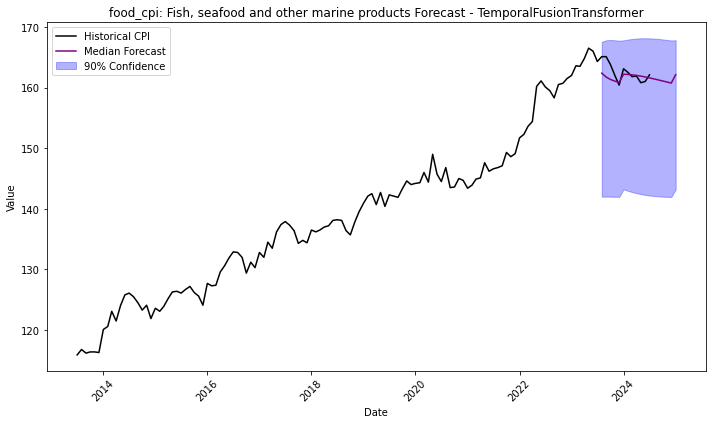

Beginning AutoGluon training... Time limit = 2s
AutoGluon will save models to './output/TEST/ag_global_all_TemporalFusionTransformerModel_exp2_R3_/random_seed_42/2023-07-01/model_files/'
=================== System Info ===================
AutoGluon Version:  1.1.1
Python Version:     3.8.20
Operating System:   Linux
Platform Machine:   x86_64
Platform Version:   #147~18.04.1-Ubuntu SMP Sat Oct 15 13:10:18 UTC 2022
CPU Count:          32
GPU Count:          1
Memory Avail:       166.79 GB / 188.57 GB (88.4%)
Disk Space Avail:   18212.98 GB / 249006.62 GB (7.3%)

Fitting with arguments:
{'enable_ensemble': True,
 'eval_metric': MAPE,
 'excluded_model_types': ['DirectTabular', 'RecursiveTabular'],
 'hyperparameters': {'TemporalFusionTransformerModel': {}},
 'known_covariates_names': [],
 'num_val_windows': 1,
 'prediction_length': 18,
 'quantile_levels': [0.01, 0.05, 0.1, 0.25, 0.75, 0.9, 0.95, 0.99],
 'random_seed': 42,
 'refit_every_n_windows': 1,
 'refit_full': False,
 'skip_model_sele

TemporalFusionTransformerModel


	-0.4640       = Validation score (-MAPE)
	2.12    s     = Training runtime
	0.04    s     = Validation (prediction) runtime
Not fitting ensemble due to lack of time remaining. Time left: -0.3 seconds
Training complete. Models trained: ['TemporalFusionTransformer']
Total runtime: 2.21 s
Best model: TemporalFusionTransformer
Best model score: -0.4640
Model not specified in predict, will default to the model with the best validation score: TemporalFusionTransformer


****************** Summary of fit() ******************
Estimated performance of each model:
                       model  score_val  pred_time_val  fit_time_marginal  \
0  TemporalFusionTransformer  -0.463951       0.042514           2.120514   

   fit_order  
0          1  
Number of models trained: 1
Types of models trained:
{'MultiWindowBacktestingModel'}
****************** End of fit() summary ******************


Model not specified in predict, will default to the model with the best validation score: TemporalFusionTransformer


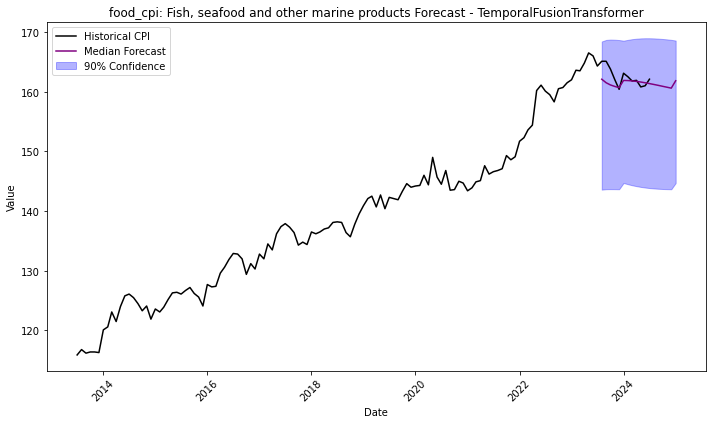

Beginning AutoGluon training... Time limit = 2s
AutoGluon will save models to './output/TEST/ag_global_all_TemporalFusionTransformerModel_exp2_GPT_P4_/random_seed_42/2023-07-01/model_files/'
=================== System Info ===================
AutoGluon Version:  1.1.1
Python Version:     3.8.20
Operating System:   Linux
Platform Machine:   x86_64
Platform Version:   #147~18.04.1-Ubuntu SMP Sat Oct 15 13:10:18 UTC 2022
CPU Count:          32
GPU Count:          1
Memory Avail:       166.79 GB / 188.57 GB (88.4%)
Disk Space Avail:   18212.97 GB / 249006.62 GB (7.3%)

Fitting with arguments:
{'enable_ensemble': True,
 'eval_metric': MAPE,
 'excluded_model_types': ['DirectTabular', 'RecursiveTabular'],
 'hyperparameters': {'TemporalFusionTransformerModel': {}},
 'known_covariates_names': [],
 'num_val_windows': 1,
 'prediction_length': 18,
 'quantile_levels': [0.01, 0.05, 0.1, 0.25, 0.75, 0.9, 0.95, 0.99],
 'random_seed': 42,
 'refit_every_n_windows': 1,
 'refit_full': False,
 'skip_model_

TemporalFusionTransformerModel


	-1.0325       = Validation score (-MAPE)
	2.14    s     = Training runtime
	0.04    s     = Validation (prediction) runtime
Not fitting ensemble due to lack of time remaining. Time left: -0.3 seconds
Training complete. Models trained: ['TemporalFusionTransformer']
Total runtime: 2.22 s
Best model: TemporalFusionTransformer
Best model score: -1.0325
Model not specified in predict, will default to the model with the best validation score: TemporalFusionTransformer
Model not specified in predict, will default to the model with the best validation score: TemporalFusionTransformer


****************** Summary of fit() ******************
Estimated performance of each model:
                       model  score_val  pred_time_val  fit_time_marginal  \
0  TemporalFusionTransformer  -1.032505       0.040579           2.143941   

   fit_order  
0          1  
Number of models trained: 1
Types of models trained:
{'MultiWindowBacktestingModel'}
****************** End of fit() summary ******************


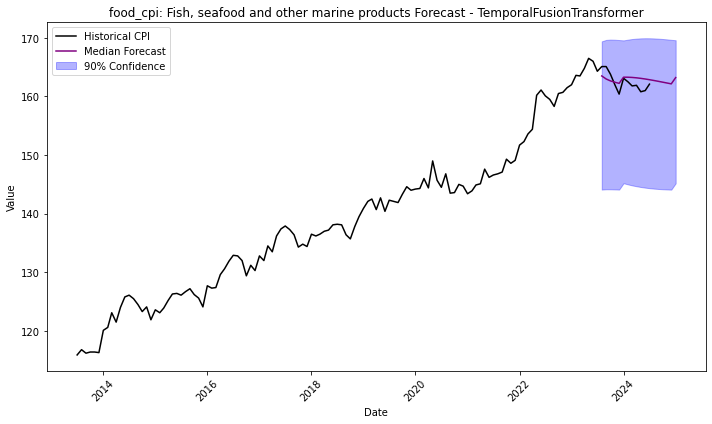

Beginning AutoGluon training... Time limit = 2s
AutoGluon will save models to './output/TEST/ag_global_all_TemporalFusionTransformerModel_exp2_R1_/random_seed_42/2023-07-01/model_files/'
=================== System Info ===================
AutoGluon Version:  1.1.1
Python Version:     3.8.20
Operating System:   Linux
Platform Machine:   x86_64
Platform Version:   #147~18.04.1-Ubuntu SMP Sat Oct 15 13:10:18 UTC 2022
CPU Count:          32
GPU Count:          1
Memory Avail:       166.80 GB / 188.57 GB (88.5%)
Disk Space Avail:   18212.96 GB / 249006.62 GB (7.3%)

Fitting with arguments:
{'enable_ensemble': True,
 'eval_metric': MAPE,
 'excluded_model_types': ['DirectTabular', 'RecursiveTabular'],
 'hyperparameters': {'TemporalFusionTransformerModel': {}},
 'known_covariates_names': [],
 'num_val_windows': 1,
 'prediction_length': 18,
 'quantile_levels': [0.01, 0.05, 0.1, 0.25, 0.75, 0.9, 0.95, 0.99],
 'random_seed': 42,
 'refit_every_n_windows': 1,
 'refit_full': False,
 'skip_model_sele

TemporalFusionTransformerModel


	-0.9890       = Validation score (-MAPE)
	2.14    s     = Training runtime
	0.04    s     = Validation (prediction) runtime
Not fitting ensemble due to lack of time remaining. Time left: -0.3 seconds
Training complete. Models trained: ['TemporalFusionTransformer']
Total runtime: 2.23 s
Best model: TemporalFusionTransformer
Best model score: -0.9890
Model not specified in predict, will default to the model with the best validation score: TemporalFusionTransformer
Model not specified in predict, will default to the model with the best validation score: TemporalFusionTransformer


****************** Summary of fit() ******************
Estimated performance of each model:
                       model  score_val  pred_time_val  fit_time_marginal  \
0  TemporalFusionTransformer  -0.988992       0.044045           2.144108   

   fit_order  
0          1  
Number of models trained: 1
Types of models trained:
{'MultiWindowBacktestingModel'}
****************** End of fit() summary ******************


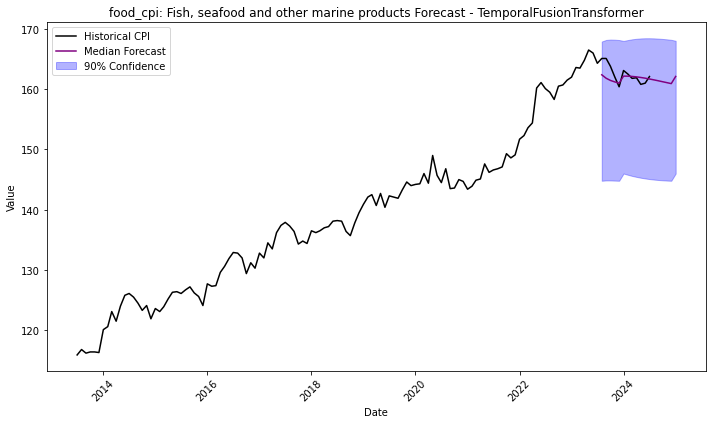

Beginning AutoGluon training... Time limit = 2s
AutoGluon will save models to './output/TEST/ag_global_all_TemporalFusionTransformerModel_exp2_GPT_P3_/random_seed_42/2023-07-01/model_files/'
=================== System Info ===================
AutoGluon Version:  1.1.1
Python Version:     3.8.20
Operating System:   Linux
Platform Machine:   x86_64
Platform Version:   #147~18.04.1-Ubuntu SMP Sat Oct 15 13:10:18 UTC 2022
CPU Count:          32
GPU Count:          1
Memory Avail:       166.87 GB / 188.57 GB (88.5%)
Disk Space Avail:   18212.60 GB / 249006.62 GB (7.3%)

Fitting with arguments:
{'enable_ensemble': True,
 'eval_metric': MAPE,
 'excluded_model_types': ['DirectTabular', 'RecursiveTabular'],
 'hyperparameters': {'TemporalFusionTransformerModel': {}},
 'known_covariates_names': [],
 'num_val_windows': 1,
 'prediction_length': 18,
 'quantile_levels': [0.01, 0.05, 0.1, 0.25, 0.75, 0.9, 0.95, 0.99],
 'random_seed': 42,
 'refit_every_n_windows': 1,
 'refit_full': False,
 'skip_model_

TemporalFusionTransformerModel


	-1.0750       = Validation score (-MAPE)
	2.14    s     = Training runtime
	0.04    s     = Validation (prediction) runtime
Not fitting ensemble due to lack of time remaining. Time left: -0.3 seconds
Training complete. Models trained: ['TemporalFusionTransformer']
Total runtime: 2.22 s
Best model: TemporalFusionTransformer
Best model score: -1.0750
Model not specified in predict, will default to the model with the best validation score: TemporalFusionTransformer
Model not specified in predict, will default to the model with the best validation score: TemporalFusionTransformer


****************** Summary of fit() ******************
Estimated performance of each model:
                       model  score_val  pred_time_val  fit_time_marginal  \
0  TemporalFusionTransformer  -1.074966       0.042709            2.13573   

   fit_order  
0          1  
Number of models trained: 1
Types of models trained:
{'MultiWindowBacktestingModel'}
****************** End of fit() summary ******************


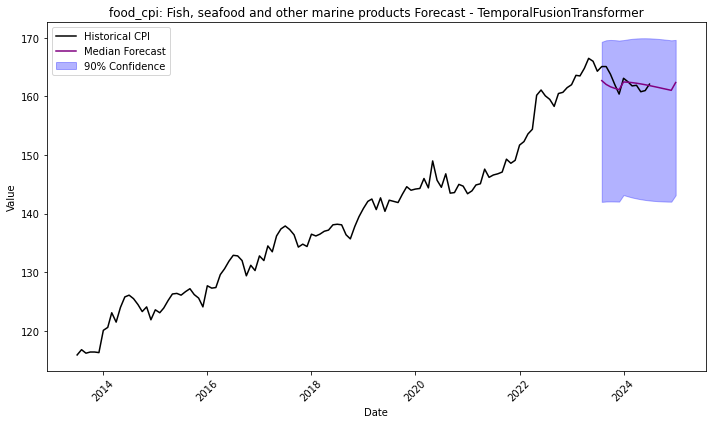

Beginning AutoGluon training... Time limit = 2s
AutoGluon will save models to './output/TEST/ag_global_all_TemporalFusionTransformerModel_exp2_GPT_P2_/random_seed_42/2023-07-01/model_files/'
=================== System Info ===================
AutoGluon Version:  1.1.1
Python Version:     3.8.20
Operating System:   Linux
Platform Machine:   x86_64
Platform Version:   #147~18.04.1-Ubuntu SMP Sat Oct 15 13:10:18 UTC 2022
CPU Count:          32
GPU Count:          1
Memory Avail:       166.78 GB / 188.57 GB (88.4%)
Disk Space Avail:   18211.80 GB / 249006.62 GB (7.3%)

Fitting with arguments:
{'enable_ensemble': True,
 'eval_metric': MAPE,
 'excluded_model_types': ['DirectTabular', 'RecursiveTabular'],
 'hyperparameters': {'TemporalFusionTransformerModel': {}},
 'known_covariates_names': [],
 'num_val_windows': 1,
 'prediction_length': 18,
 'quantile_levels': [0.01, 0.05, 0.1, 0.25, 0.75, 0.9, 0.95, 0.99],
 'random_seed': 42,
 'refit_every_n_windows': 1,
 'refit_full': False,
 'skip_model_

TemporalFusionTransformerModel


	-0.6594       = Validation score (-MAPE)
	2.12    s     = Training runtime
	0.04    s     = Validation (prediction) runtime
Not fitting ensemble due to lack of time remaining. Time left: -0.2 seconds
Training complete. Models trained: ['TemporalFusionTransformer']
Total runtime: 2.20 s
Best model: TemporalFusionTransformer
Best model score: -0.6594
Model not specified in predict, will default to the model with the best validation score: TemporalFusionTransformer
Model not specified in predict, will default to the model with the best validation score: TemporalFusionTransformer


****************** Summary of fit() ******************
Estimated performance of each model:
                       model  score_val  pred_time_val  fit_time_marginal  \
0  TemporalFusionTransformer   -0.65945       0.041575           2.118546   

   fit_order  
0          1  
Number of models trained: 1
Types of models trained:
{'MultiWindowBacktestingModel'}
****************** End of fit() summary ******************


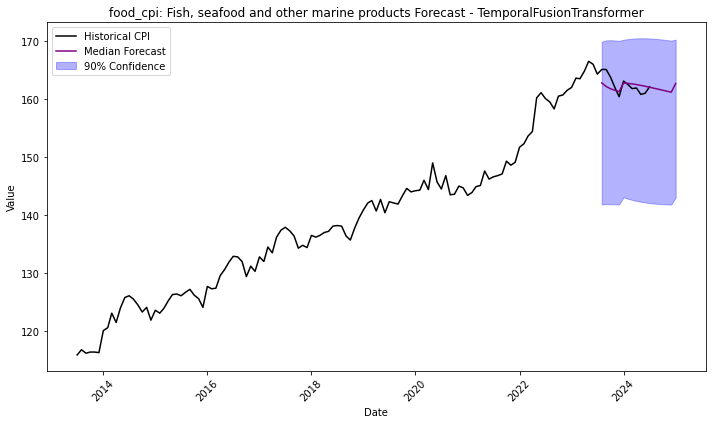

Beginning AutoGluon training... Time limit = 2s
AutoGluon will save models to './output/TEST/ag_global_all_TemporalFusionTransformerModel_exp2_R1_/random_seed_42/2018-07-01/model_files/'
=================== System Info ===================
AutoGluon Version:  1.1.1
Python Version:     3.8.20
Operating System:   Linux
Platform Machine:   x86_64
Platform Version:   #147~18.04.1-Ubuntu SMP Sat Oct 15 13:10:18 UTC 2022
CPU Count:          32
GPU Count:          1
Memory Avail:       166.79 GB / 188.57 GB (88.4%)
Disk Space Avail:   18211.82 GB / 249006.62 GB (7.3%)

Fitting with arguments:
{'enable_ensemble': True,
 'eval_metric': MAPE,
 'excluded_model_types': ['DirectTabular', 'RecursiveTabular'],
 'hyperparameters': {'TemporalFusionTransformerModel': {}},
 'known_covariates_names': [],
 'num_val_windows': 1,
 'prediction_length': 18,
 'quantile_levels': [0.01, 0.05, 0.1, 0.25, 0.75, 0.9, 0.95, 0.99],
 'random_seed': 42,
 'refit_every_n_windows': 1,
 'refit_full': False,
 'skip_model_sele

TemporalFusionTransformerModel


	-1.1395       = Validation score (-MAPE)
	2.14    s     = Training runtime
	0.04    s     = Validation (prediction) runtime
Not fitting ensemble due to lack of time remaining. Time left: -0.3 seconds
Training complete. Models trained: ['TemporalFusionTransformer']
Total runtime: 2.22 s
Best model: TemporalFusionTransformer
Best model score: -1.1395
Model not specified in predict, will default to the model with the best validation score: TemporalFusionTransformer
Model not specified in predict, will default to the model with the best validation score: TemporalFusionTransformer


****************** Summary of fit() ******************
Estimated performance of each model:
                       model  score_val  pred_time_val  fit_time_marginal  \
0  TemporalFusionTransformer  -1.139496        0.04344           2.144449   

   fit_order  
0          1  
Number of models trained: 1
Types of models trained:
{'MultiWindowBacktestingModel'}
****************** End of fit() summary ******************


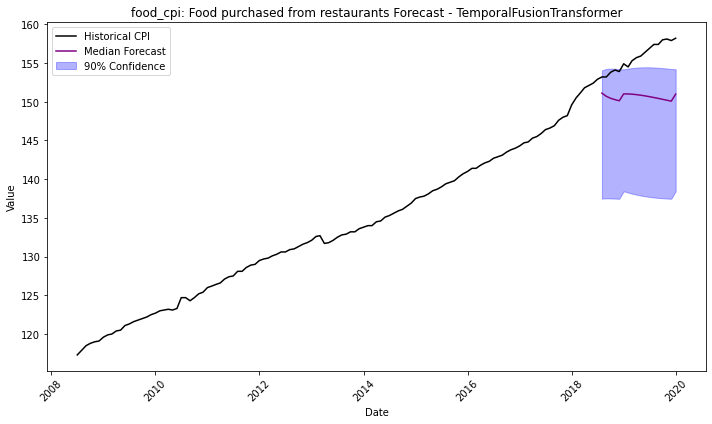

Beginning AutoGluon training... Time limit = 2s
AutoGluon will save models to './output/TEST/ag_global_all_TemporalFusionTransformerModel_exp2_GPT_P4_/random_seed_42/2018-07-01/model_files/'
=================== System Info ===================
AutoGluon Version:  1.1.1
Python Version:     3.8.20
Operating System:   Linux
Platform Machine:   x86_64
Platform Version:   #147~18.04.1-Ubuntu SMP Sat Oct 15 13:10:18 UTC 2022
CPU Count:          32
GPU Count:          1
Memory Avail:       166.79 GB / 188.57 GB (88.4%)
Disk Space Avail:   18211.81 GB / 249006.62 GB (7.3%)

Fitting with arguments:
{'enable_ensemble': True,
 'eval_metric': MAPE,
 'excluded_model_types': ['DirectTabular', 'RecursiveTabular'],
 'hyperparameters': {'TemporalFusionTransformerModel': {}},
 'known_covariates_names': [],
 'num_val_windows': 1,
 'prediction_length': 18,
 'quantile_levels': [0.01, 0.05, 0.1, 0.25, 0.75, 0.9, 0.95, 0.99],
 'random_seed': 42,
 'refit_every_n_windows': 1,
 'refit_full': False,
 'skip_model_

TemporalFusionTransformerModel


	-1.6659       = Validation score (-MAPE)
	2.42    s     = Training runtime
	0.06    s     = Validation (prediction) runtime
Not fitting ensemble due to lack of time remaining. Time left: -0.6 seconds
Training complete. Models trained: ['TemporalFusionTransformer']
Total runtime: 2.52 s
Best model: TemporalFusionTransformer
Best model score: -1.6659
Model not specified in predict, will default to the model with the best validation score: TemporalFusionTransformer
Model not specified in predict, will default to the model with the best validation score: TemporalFusionTransformer


****************** Summary of fit() ******************
Estimated performance of each model:
                       model  score_val  pred_time_val  fit_time_marginal  \
0  TemporalFusionTransformer  -1.665874       0.055895           2.423787   

   fit_order  
0          1  
Number of models trained: 1
Types of models trained:
{'MultiWindowBacktestingModel'}
****************** End of fit() summary ******************


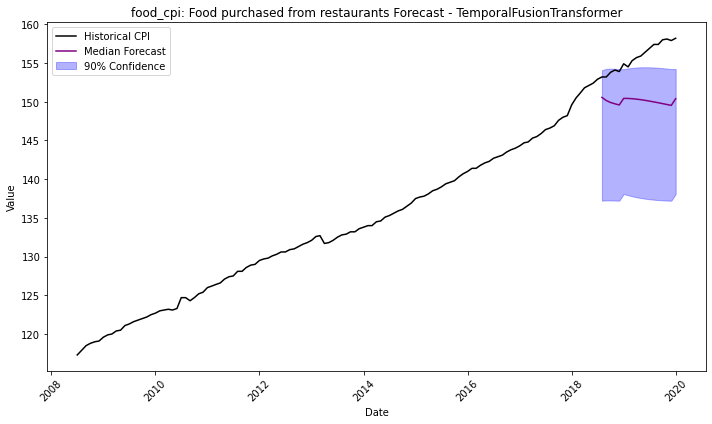

Beginning AutoGluon training... Time limit = 2s
AutoGluon will save models to './output/TEST/ag_global_all_TemporalFusionTransformerModel_exp2_R3_/random_seed_42/2018-07-01/model_files/'
=================== System Info ===================
AutoGluon Version:  1.1.1
Python Version:     3.8.20
Operating System:   Linux
Platform Machine:   x86_64
Platform Version:   #147~18.04.1-Ubuntu SMP Sat Oct 15 13:10:18 UTC 2022
CPU Count:          32
GPU Count:          1
Memory Avail:       166.79 GB / 188.57 GB (88.4%)
Disk Space Avail:   18211.80 GB / 249006.62 GB (7.3%)

Fitting with arguments:
{'enable_ensemble': True,
 'eval_metric': MAPE,
 'excluded_model_types': ['DirectTabular', 'RecursiveTabular'],
 'hyperparameters': {'TemporalFusionTransformerModel': {}},
 'known_covariates_names': [],
 'num_val_windows': 1,
 'prediction_length': 18,
 'quantile_levels': [0.01, 0.05, 0.1, 0.25, 0.75, 0.9, 0.95, 0.99],
 'random_seed': 42,
 'refit_every_n_windows': 1,
 'refit_full': False,
 'skip_model_sele

TemporalFusionTransformerModel


	-1.7939       = Validation score (-MAPE)
	2.15    s     = Training runtime
	0.04    s     = Validation (prediction) runtime
Not fitting ensemble due to lack of time remaining. Time left: -0.3 seconds
Training complete. Models trained: ['TemporalFusionTransformer']
Total runtime: 2.23 s
Best model: TemporalFusionTransformer
Best model score: -1.7939
Model not specified in predict, will default to the model with the best validation score: TemporalFusionTransformer
Model not specified in predict, will default to the model with the best validation score: TemporalFusionTransformer


****************** Summary of fit() ******************
Estimated performance of each model:
                       model  score_val  pred_time_val  fit_time_marginal  \
0  TemporalFusionTransformer  -1.793923       0.043967           2.154083   

   fit_order  
0          1  
Number of models trained: 1
Types of models trained:
{'MultiWindowBacktestingModel'}
****************** End of fit() summary ******************


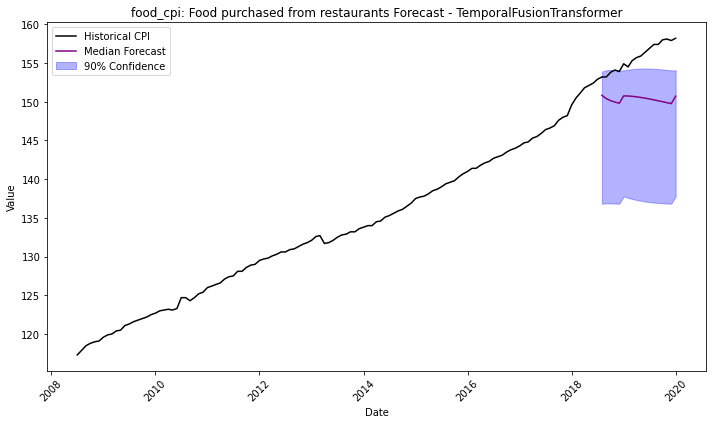

Beginning AutoGluon training... Time limit = 2s
AutoGluon will save models to './output/TEST/ag_global_all_TemporalFusionTransformerModel_exp2_GPT_P2_/random_seed_42/2018-07-01/model_files/'
=================== System Info ===================
AutoGluon Version:  1.1.1
Python Version:     3.8.20
Operating System:   Linux
Platform Machine:   x86_64
Platform Version:   #147~18.04.1-Ubuntu SMP Sat Oct 15 13:10:18 UTC 2022
CPU Count:          32
GPU Count:          1
Memory Avail:       166.79 GB / 188.57 GB (88.4%)
Disk Space Avail:   18211.79 GB / 249006.62 GB (7.3%)

Fitting with arguments:
{'enable_ensemble': True,
 'eval_metric': MAPE,
 'excluded_model_types': ['DirectTabular', 'RecursiveTabular'],
 'hyperparameters': {'TemporalFusionTransformerModel': {}},
 'known_covariates_names': [],
 'num_val_windows': 1,
 'prediction_length': 18,
 'quantile_levels': [0.01, 0.05, 0.1, 0.25, 0.75, 0.9, 0.95, 0.99],
 'random_seed': 42,
 'refit_every_n_windows': 1,
 'refit_full': False,
 'skip_model_

TemporalFusionTransformerModel


	-2.4914       = Validation score (-MAPE)
	2.15    s     = Training runtime
	0.04    s     = Validation (prediction) runtime
Not fitting ensemble due to lack of time remaining. Time left: -0.3 seconds
Training complete. Models trained: ['TemporalFusionTransformer']
Total runtime: 2.22 s
Best model: TemporalFusionTransformer
Best model score: -2.4914
Model not specified in predict, will default to the model with the best validation score: TemporalFusionTransformer
Model not specified in predict, will default to the model with the best validation score: TemporalFusionTransformer


****************** Summary of fit() ******************
Estimated performance of each model:
                       model  score_val  pred_time_val  fit_time_marginal  \
0  TemporalFusionTransformer  -2.491378       0.039705           2.146581   

   fit_order  
0          1  
Number of models trained: 1
Types of models trained:
{'MultiWindowBacktestingModel'}
****************** End of fit() summary ******************


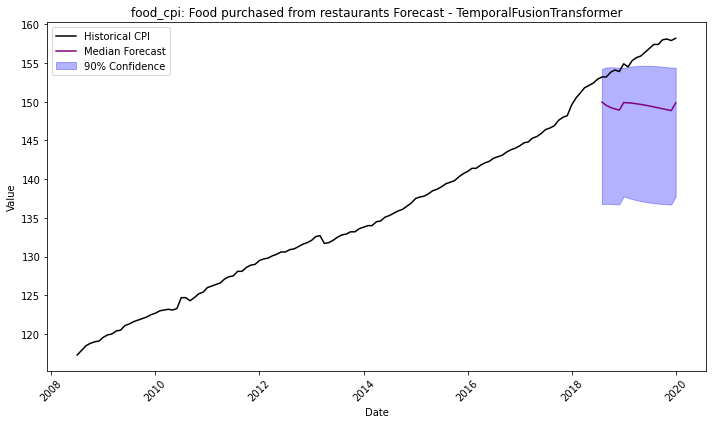

Beginning AutoGluon training... Time limit = 2s
AutoGluon will save models to './output/TEST/ag_global_all_TemporalFusionTransformerModel_exp2_GPT_P1_/random_seed_42/2018-07-01/model_files/'
=================== System Info ===================
AutoGluon Version:  1.1.1
Python Version:     3.8.20
Operating System:   Linux
Platform Machine:   x86_64
Platform Version:   #147~18.04.1-Ubuntu SMP Sat Oct 15 13:10:18 UTC 2022
CPU Count:          32
GPU Count:          1
Memory Avail:       166.79 GB / 188.57 GB (88.4%)
Disk Space Avail:   18211.85 GB / 249006.62 GB (7.3%)

Fitting with arguments:
{'enable_ensemble': True,
 'eval_metric': MAPE,
 'excluded_model_types': ['DirectTabular', 'RecursiveTabular'],
 'hyperparameters': {'TemporalFusionTransformerModel': {}},
 'known_covariates_names': [],
 'num_val_windows': 1,
 'prediction_length': 18,
 'quantile_levels': [0.01, 0.05, 0.1, 0.25, 0.75, 0.9, 0.95, 0.99],
 'random_seed': 42,
 'refit_every_n_windows': 1,
 'refit_full': False,
 'skip_model_

TemporalFusionTransformerModel


	-2.7377       = Validation score (-MAPE)
	2.13    s     = Training runtime
	0.04    s     = Validation (prediction) runtime
Not fitting ensemble due to lack of time remaining. Time left: -0.3 seconds
Training complete. Models trained: ['TemporalFusionTransformer']
Total runtime: 2.21 s
Best model: TemporalFusionTransformer
Best model score: -2.7377
Model not specified in predict, will default to the model with the best validation score: TemporalFusionTransformer
Model not specified in predict, will default to the model with the best validation score: TemporalFusionTransformer


****************** Summary of fit() ******************
Estimated performance of each model:
                       model  score_val  pred_time_val  fit_time_marginal  \
0  TemporalFusionTransformer  -2.737745       0.042547            2.12564   

   fit_order  
0          1  
Number of models trained: 1
Types of models trained:
{'MultiWindowBacktestingModel'}
****************** End of fit() summary ******************


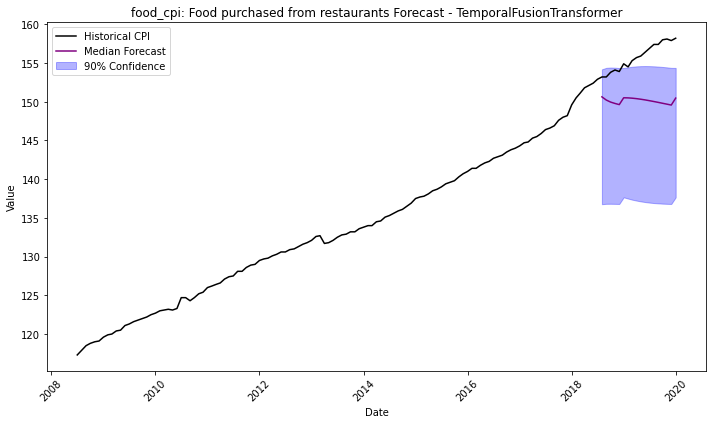

Beginning AutoGluon training... Time limit = 2s
AutoGluon will save models to './output/TEST/ag_global_all_TemporalFusionTransformerModel_exp2_R2_/random_seed_42/2018-07-01/model_files/'
=================== System Info ===================
AutoGluon Version:  1.1.1
Python Version:     3.8.20
Operating System:   Linux
Platform Machine:   x86_64
Platform Version:   #147~18.04.1-Ubuntu SMP Sat Oct 15 13:10:18 UTC 2022
CPU Count:          32
GPU Count:          1
Memory Avail:       166.91 GB / 188.57 GB (88.5%)
Disk Space Avail:   18211.84 GB / 249006.62 GB (7.3%)

Fitting with arguments:
{'enable_ensemble': True,
 'eval_metric': MAPE,
 'excluded_model_types': ['DirectTabular', 'RecursiveTabular'],
 'hyperparameters': {'TemporalFusionTransformerModel': {}},
 'known_covariates_names': [],
 'num_val_windows': 1,
 'prediction_length': 18,
 'quantile_levels': [0.01, 0.05, 0.1, 0.25, 0.75, 0.9, 0.95, 0.99],
 'random_seed': 42,
 'refit_every_n_windows': 1,
 'refit_full': False,
 'skip_model_sele

TemporalFusionTransformerModel


	-0.7309       = Validation score (-MAPE)
	2.12    s     = Training runtime
	0.04    s     = Validation (prediction) runtime
Not fitting ensemble due to lack of time remaining. Time left: -0.3 seconds
Training complete. Models trained: ['TemporalFusionTransformer']
Total runtime: 2.20 s
Best model: TemporalFusionTransformer
Best model score: -0.7309
Model not specified in predict, will default to the model with the best validation score: TemporalFusionTransformer
Model not specified in predict, will default to the model with the best validation score: TemporalFusionTransformer


****************** Summary of fit() ******************
Estimated performance of each model:
                       model  score_val  pred_time_val  fit_time_marginal  \
0  TemporalFusionTransformer  -0.730875       0.043224           2.117192   

   fit_order  
0          1  
Number of models trained: 1
Types of models trained:
{'MultiWindowBacktestingModel'}
****************** End of fit() summary ******************


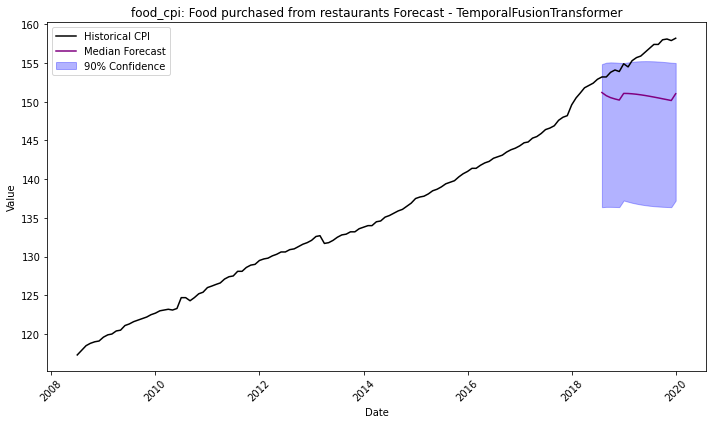

Beginning AutoGluon training... Time limit = 2s
AutoGluon will save models to './output/TEST/ag_global_all_TemporalFusionTransformerModel_exp2_R4_/random_seed_42/2018-07-01/model_files/'
=================== System Info ===================
AutoGluon Version:  1.1.1
Python Version:     3.8.20
Operating System:   Linux
Platform Machine:   x86_64
Platform Version:   #147~18.04.1-Ubuntu SMP Sat Oct 15 13:10:18 UTC 2022
CPU Count:          32
GPU Count:          1
Memory Avail:       166.79 GB / 188.57 GB (88.4%)
Disk Space Avail:   18211.83 GB / 249006.62 GB (7.3%)

Fitting with arguments:
{'enable_ensemble': True,
 'eval_metric': MAPE,
 'excluded_model_types': ['DirectTabular', 'RecursiveTabular'],
 'hyperparameters': {'TemporalFusionTransformerModel': {}},
 'known_covariates_names': [],
 'num_val_windows': 1,
 'prediction_length': 18,
 'quantile_levels': [0.01, 0.05, 0.1, 0.25, 0.75, 0.9, 0.95, 0.99],
 'random_seed': 42,
 'refit_every_n_windows': 1,
 'refit_full': False,
 'skip_model_sele

TemporalFusionTransformerModel


	-1.3127       = Validation score (-MAPE)
	2.12    s     = Training runtime
	0.04    s     = Validation (prediction) runtime
Not fitting ensemble due to lack of time remaining. Time left: -0.3 seconds
Training complete. Models trained: ['TemporalFusionTransformer']
Total runtime: 2.20 s
Best model: TemporalFusionTransformer
Best model score: -1.3127
Model not specified in predict, will default to the model with the best validation score: TemporalFusionTransformer
Model not specified in predict, will default to the model with the best validation score: TemporalFusionTransformer


****************** Summary of fit() ******************
Estimated performance of each model:
                       model  score_val  pred_time_val  fit_time_marginal  \
0  TemporalFusionTransformer  -1.312674       0.042042           2.117767   

   fit_order  
0          1  
Number of models trained: 1
Types of models trained:
{'MultiWindowBacktestingModel'}
****************** End of fit() summary ******************


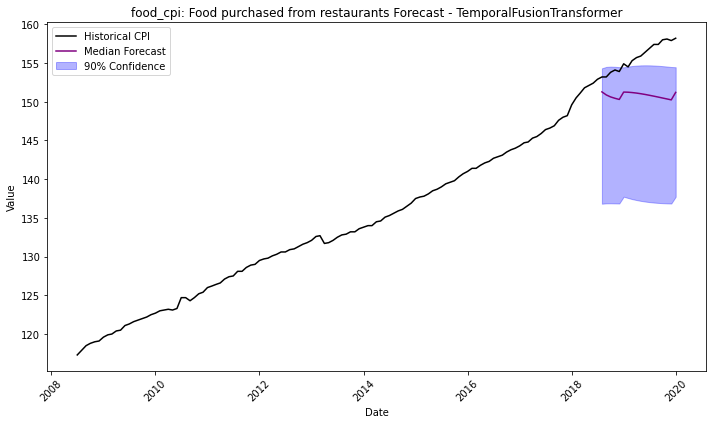

Beginning AutoGluon training... Time limit = 2s
AutoGluon will save models to './output/TEST/ag_global_all_TemporalFusionTransformerModel_exp2_GPT_P3_/random_seed_42/2018-07-01/model_files/'
=================== System Info ===================
AutoGluon Version:  1.1.1
Python Version:     3.8.20
Operating System:   Linux
Platform Machine:   x86_64
Platform Version:   #147~18.04.1-Ubuntu SMP Sat Oct 15 13:10:18 UTC 2022
CPU Count:          32
GPU Count:          1
Memory Avail:       166.87 GB / 188.57 GB (88.5%)
Disk Space Avail:   18211.82 GB / 249006.62 GB (7.3%)

Fitting with arguments:
{'enable_ensemble': True,
 'eval_metric': MAPE,
 'excluded_model_types': ['DirectTabular', 'RecursiveTabular'],
 'hyperparameters': {'TemporalFusionTransformerModel': {}},
 'known_covariates_names': [],
 'num_val_windows': 1,
 'prediction_length': 18,
 'quantile_levels': [0.01, 0.05, 0.1, 0.25, 0.75, 0.9, 0.95, 0.99],
 'random_seed': 42,
 'refit_every_n_windows': 1,
 'refit_full': False,
 'skip_model_

TemporalFusionTransformerModel


	-2.7230       = Validation score (-MAPE)
	2.12    s     = Training runtime
	0.04    s     = Validation (prediction) runtime
Not fitting ensemble due to lack of time remaining. Time left: -0.3 seconds
Training complete. Models trained: ['TemporalFusionTransformer']
Total runtime: 2.21 s
Best model: TemporalFusionTransformer
Best model score: -2.7230
Model not specified in predict, will default to the model with the best validation score: TemporalFusionTransformer
Model not specified in predict, will default to the model with the best validation score: TemporalFusionTransformer


****************** Summary of fit() ******************
Estimated performance of each model:
                       model  score_val  pred_time_val  fit_time_marginal  \
0  TemporalFusionTransformer  -2.723028       0.041959           2.123987   

   fit_order  
0          1  
Number of models trained: 1
Types of models trained:
{'MultiWindowBacktestingModel'}
****************** End of fit() summary ******************


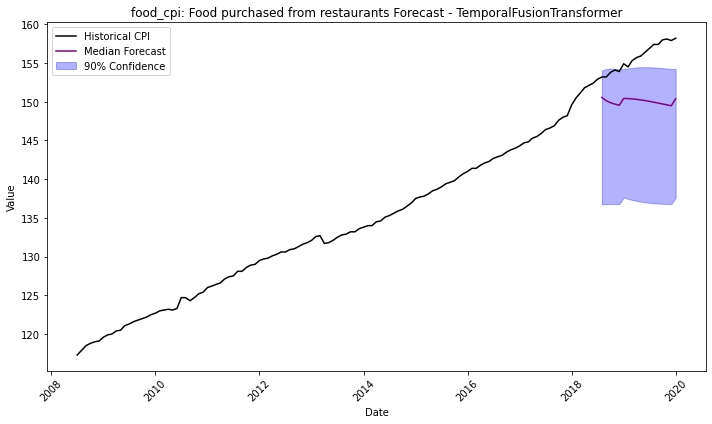

Beginning AutoGluon training... Time limit = 2s
AutoGluon will save models to './output/TEST/ag_global_all_TemporalFusionTransformerModel_exp2_R1_/random_seed_42/2019-07-01/model_files/'
=================== System Info ===================
AutoGluon Version:  1.1.1
Python Version:     3.8.20
Operating System:   Linux
Platform Machine:   x86_64
Platform Version:   #147~18.04.1-Ubuntu SMP Sat Oct 15 13:10:18 UTC 2022
CPU Count:          32
GPU Count:          1
Memory Avail:       166.79 GB / 188.57 GB (88.4%)
Disk Space Avail:   18211.81 GB / 249006.62 GB (7.3%)

Fitting with arguments:
{'enable_ensemble': True,
 'eval_metric': MAPE,
 'excluded_model_types': ['DirectTabular', 'RecursiveTabular'],
 'hyperparameters': {'TemporalFusionTransformerModel': {}},
 'known_covariates_names': [],
 'num_val_windows': 1,
 'prediction_length': 18,
 'quantile_levels': [0.01, 0.05, 0.1, 0.25, 0.75, 0.9, 0.95, 0.99],
 'random_seed': 42,
 'refit_every_n_windows': 1,
 'refit_full': False,
 'skip_model_sele

TemporalFusionTransformerModel


	-0.7906       = Validation score (-MAPE)
	2.13    s     = Training runtime
	0.04    s     = Validation (prediction) runtime
Not fitting ensemble due to lack of time remaining. Time left: -0.3 seconds
Training complete. Models trained: ['TemporalFusionTransformer']
Total runtime: 2.21 s
Best model: TemporalFusionTransformer
Best model score: -0.7906
Model not specified in predict, will default to the model with the best validation score: TemporalFusionTransformer
Model not specified in predict, will default to the model with the best validation score: TemporalFusionTransformer


****************** Summary of fit() ******************
Estimated performance of each model:
                       model  score_val  pred_time_val  fit_time_marginal  \
0  TemporalFusionTransformer  -0.790579       0.044792           2.131539   

   fit_order  
0          1  
Number of models trained: 1
Types of models trained:
{'MultiWindowBacktestingModel'}
****************** End of fit() summary ******************


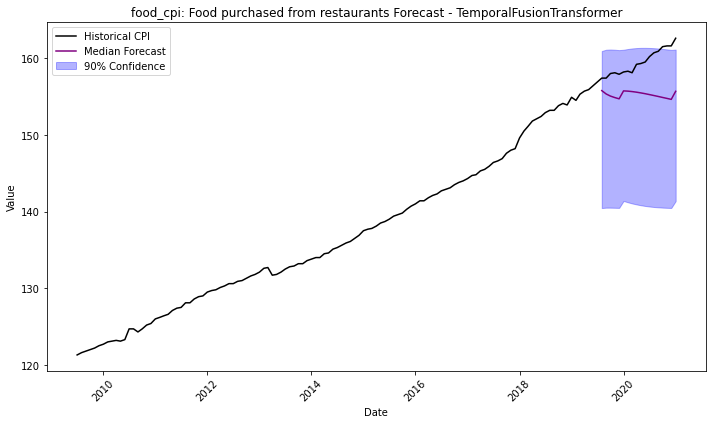

Beginning AutoGluon training... Time limit = 2s
AutoGluon will save models to './output/TEST/ag_global_all_TemporalFusionTransformerModel_exp2_GPT_P4_/random_seed_42/2019-07-01/model_files/'
=================== System Info ===================
AutoGluon Version:  1.1.1
Python Version:     3.8.20
Operating System:   Linux
Platform Machine:   x86_64
Platform Version:   #147~18.04.1-Ubuntu SMP Sat Oct 15 13:10:18 UTC 2022
CPU Count:          32
GPU Count:          1
Memory Avail:       166.79 GB / 188.57 GB (88.4%)
Disk Space Avail:   18211.80 GB / 249006.62 GB (7.3%)

Fitting with arguments:
{'enable_ensemble': True,
 'eval_metric': MAPE,
 'excluded_model_types': ['DirectTabular', 'RecursiveTabular'],
 'hyperparameters': {'TemporalFusionTransformerModel': {}},
 'known_covariates_names': [],
 'num_val_windows': 1,
 'prediction_length': 18,
 'quantile_levels': [0.01, 0.05, 0.1, 0.25, 0.75, 0.9, 0.95, 0.99],
 'random_seed': 42,
 'refit_every_n_windows': 1,
 'refit_full': False,
 'skip_model_

TemporalFusionTransformerModel


	-0.7281       = Validation score (-MAPE)
	2.13    s     = Training runtime
	0.04    s     = Validation (prediction) runtime
Not fitting ensemble due to lack of time remaining. Time left: -0.3 seconds
Training complete. Models trained: ['TemporalFusionTransformer']
Total runtime: 2.21 s
Best model: TemporalFusionTransformer
Best model score: -0.7281
Model not specified in predict, will default to the model with the best validation score: TemporalFusionTransformer
Model not specified in predict, will default to the model with the best validation score: TemporalFusionTransformer


****************** Summary of fit() ******************
Estimated performance of each model:
                       model  score_val  pred_time_val  fit_time_marginal  \
0  TemporalFusionTransformer  -0.728131       0.039765           2.125576   

   fit_order  
0          1  
Number of models trained: 1
Types of models trained:
{'MultiWindowBacktestingModel'}
****************** End of fit() summary ******************


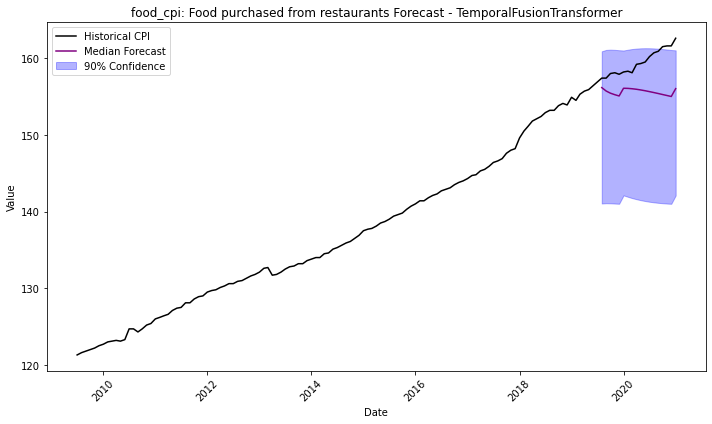

Beginning AutoGluon training... Time limit = 2s
AutoGluon will save models to './output/TEST/ag_global_all_TemporalFusionTransformerModel_exp2_R3_/random_seed_42/2019-07-01/model_files/'
=================== System Info ===================
AutoGluon Version:  1.1.1
Python Version:     3.8.20
Operating System:   Linux
Platform Machine:   x86_64
Platform Version:   #147~18.04.1-Ubuntu SMP Sat Oct 15 13:10:18 UTC 2022
CPU Count:          32
GPU Count:          1
Memory Avail:       166.79 GB / 188.57 GB (88.4%)
Disk Space Avail:   18211.85 GB / 249006.62 GB (7.3%)

Fitting with arguments:
{'enable_ensemble': True,
 'eval_metric': MAPE,
 'excluded_model_types': ['DirectTabular', 'RecursiveTabular'],
 'hyperparameters': {'TemporalFusionTransformerModel': {}},
 'known_covariates_names': [],
 'num_val_windows': 1,
 'prediction_length': 18,
 'quantile_levels': [0.01, 0.05, 0.1, 0.25, 0.75, 0.9, 0.95, 0.99],
 'random_seed': 42,
 'refit_every_n_windows': 1,
 'refit_full': False,
 'skip_model_sele

TemporalFusionTransformerModel


	-0.7336       = Validation score (-MAPE)
	2.18    s     = Training runtime
	0.04    s     = Validation (prediction) runtime
Not fitting ensemble due to lack of time remaining. Time left: -0.3 seconds
Training complete. Models trained: ['TemporalFusionTransformer']
Total runtime: 2.26 s
Best model: TemporalFusionTransformer
Best model score: -0.7336
Model not specified in predict, will default to the model with the best validation score: TemporalFusionTransformer
Model not specified in predict, will default to the model with the best validation score: TemporalFusionTransformer


****************** Summary of fit() ******************
Estimated performance of each model:
                       model  score_val  pred_time_val  fit_time_marginal  \
0  TemporalFusionTransformer  -0.733562       0.041059           2.177606   

   fit_order  
0          1  
Number of models trained: 1
Types of models trained:
{'MultiWindowBacktestingModel'}
****************** End of fit() summary ******************


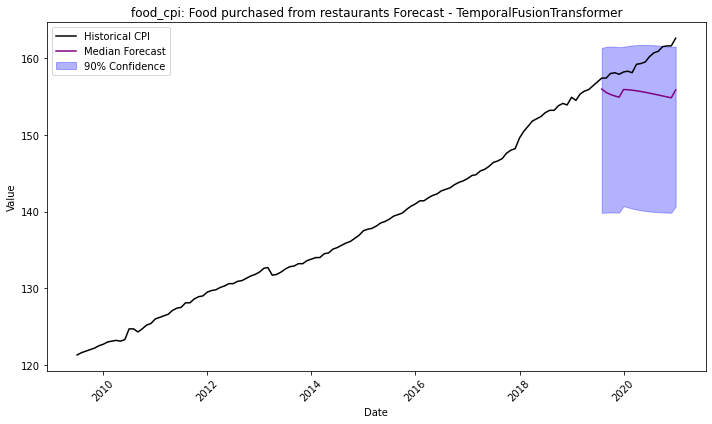

Beginning AutoGluon training... Time limit = 2s
AutoGluon will save models to './output/TEST/ag_global_all_TemporalFusionTransformerModel_exp2_GPT_P2_/random_seed_42/2019-07-01/model_files/'
=================== System Info ===================
AutoGluon Version:  1.1.1
Python Version:     3.8.20
Operating System:   Linux
Platform Machine:   x86_64
Platform Version:   #147~18.04.1-Ubuntu SMP Sat Oct 15 13:10:18 UTC 2022
CPU Count:          32
GPU Count:          1
Memory Avail:       166.79 GB / 188.57 GB (88.4%)
Disk Space Avail:   18211.84 GB / 249006.62 GB (7.3%)

Fitting with arguments:
{'enable_ensemble': True,
 'eval_metric': MAPE,
 'excluded_model_types': ['DirectTabular', 'RecursiveTabular'],
 'hyperparameters': {'TemporalFusionTransformerModel': {}},
 'known_covariates_names': [],
 'num_val_windows': 1,
 'prediction_length': 18,
 'quantile_levels': [0.01, 0.05, 0.1, 0.25, 0.75, 0.9, 0.95, 0.99],
 'random_seed': 42,
 'refit_every_n_windows': 1,
 'refit_full': False,
 'skip_model_

TemporalFusionTransformerModel


	-1.1605       = Validation score (-MAPE)
	2.12    s     = Training runtime
	0.04    s     = Validation (prediction) runtime
Not fitting ensemble due to lack of time remaining. Time left: -0.3 seconds
Training complete. Models trained: ['TemporalFusionTransformer']
Total runtime: 2.20 s
Best model: TemporalFusionTransformer
Best model score: -1.1605
Model not specified in predict, will default to the model with the best validation score: TemporalFusionTransformer
Model not specified in predict, will default to the model with the best validation score: TemporalFusionTransformer


****************** Summary of fit() ******************
Estimated performance of each model:
                       model  score_val  pred_time_val  fit_time_marginal  \
0  TemporalFusionTransformer  -1.160471        0.03974           2.120719   

   fit_order  
0          1  
Number of models trained: 1
Types of models trained:
{'MultiWindowBacktestingModel'}
****************** End of fit() summary ******************


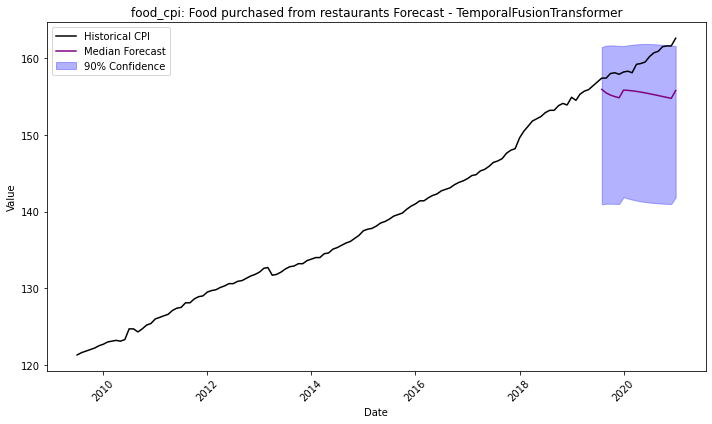

Beginning AutoGluon training... Time limit = 2s
AutoGluon will save models to './output/TEST/ag_global_all_TemporalFusionTransformerModel_exp2_GPT_P1_/random_seed_42/2019-07-01/model_files/'
=================== System Info ===================
AutoGluon Version:  1.1.1
Python Version:     3.8.20
Operating System:   Linux
Platform Machine:   x86_64
Platform Version:   #147~18.04.1-Ubuntu SMP Sat Oct 15 13:10:18 UTC 2022
CPU Count:          32
GPU Count:          1
Memory Avail:       166.79 GB / 188.57 GB (88.4%)
Disk Space Avail:   18211.82 GB / 249006.62 GB (7.3%)

Fitting with arguments:
{'enable_ensemble': True,
 'eval_metric': MAPE,
 'excluded_model_types': ['DirectTabular', 'RecursiveTabular'],
 'hyperparameters': {'TemporalFusionTransformerModel': {}},
 'known_covariates_names': [],
 'num_val_windows': 1,
 'prediction_length': 18,
 'quantile_levels': [0.01, 0.05, 0.1, 0.25, 0.75, 0.9, 0.95, 0.99],
 'random_seed': 42,
 'refit_every_n_windows': 1,
 'refit_full': False,
 'skip_model_

TemporalFusionTransformerModel


Inferred time series frequency: 'MS'
Provided train_data has 8866 rows, 22 time series. Median time series length is 403 (min=403, max=403). 

Provided data contains following columns:
	target: 'target'

AutoGluon will gauge predictive performance using evaluation metric: 'MAPE'
	This metric's sign has been flipped to adhere to being higher_is_better. The metric score can be multiplied by -1 to get the metric value.

Starting training. Start time is 2024-10-27 07:36:07
Excluded model types: ['DirectTabular', 'RecursiveTabular']
Models that will be trained: ['TemporalFusionTransformer']
Training timeseries model TemporalFusionTransformer. Training for up to 1.7s of the 1.7s of remaining time.
	-1.0609       = Validation score (-MAPE)
	1.88    s     = Training runtime
	0.04    s     = Validation (prediction) runtime
Not fitting ensemble due to lack of time remaining. Time left: -0.3 seconds
Training complete. Models trained: ['TemporalFusionTransformer']
Total runtime: 1.96 s
Best model:

****************** Summary of fit() ******************
Estimated performance of each model:
                       model  score_val  pred_time_val  fit_time_marginal  \
0  TemporalFusionTransformer  -1.060892       0.041066           1.880213   

   fit_order  
0          1  
Number of models trained: 1
Types of models trained:
{'MultiWindowBacktestingModel'}
****************** End of fit() summary ******************


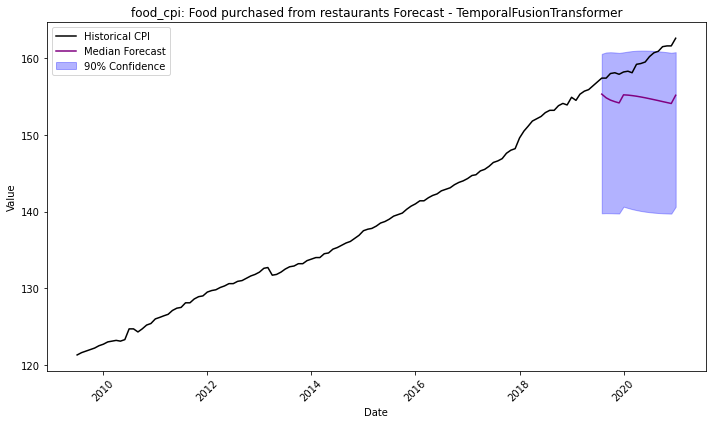

Beginning AutoGluon training... Time limit = 2s
AutoGluon will save models to './output/TEST/ag_global_all_TemporalFusionTransformerModel_exp2_R2_/random_seed_42/2019-07-01/model_files/'
=================== System Info ===================
AutoGluon Version:  1.1.1
Python Version:     3.8.20
Operating System:   Linux
Platform Machine:   x86_64
Platform Version:   #147~18.04.1-Ubuntu SMP Sat Oct 15 13:10:18 UTC 2022
CPU Count:          32
GPU Count:          1
Memory Avail:       166.79 GB / 188.57 GB (88.4%)
Disk Space Avail:   18211.82 GB / 249006.62 GB (7.3%)

Fitting with arguments:
{'enable_ensemble': True,
 'eval_metric': MAPE,
 'excluded_model_types': ['DirectTabular', 'RecursiveTabular'],
 'hyperparameters': {'TemporalFusionTransformerModel': {}},
 'known_covariates_names': [],
 'num_val_windows': 1,
 'prediction_length': 18,
 'quantile_levels': [0.01, 0.05, 0.1, 0.25, 0.75, 0.9, 0.95, 0.99],
 'random_seed': 42,
 'refit_every_n_windows': 1,
 'refit_full': False,
 'skip_model_sele

TemporalFusionTransformerModel


	-0.3720       = Validation score (-MAPE)
	2.13    s     = Training runtime
	0.04    s     = Validation (prediction) runtime
Not fitting ensemble due to lack of time remaining. Time left: -0.3 seconds
Training complete. Models trained: ['TemporalFusionTransformer']
Total runtime: 2.21 s
Best model: TemporalFusionTransformer
Best model score: -0.3720
Model not specified in predict, will default to the model with the best validation score: TemporalFusionTransformer
Model not specified in predict, will default to the model with the best validation score: TemporalFusionTransformer


****************** Summary of fit() ******************
Estimated performance of each model:
                       model  score_val  pred_time_val  fit_time_marginal  \
0  TemporalFusionTransformer  -0.371968       0.043407           2.129638   

   fit_order  
0          1  
Number of models trained: 1
Types of models trained:
{'MultiWindowBacktestingModel'}
****************** End of fit() summary ******************


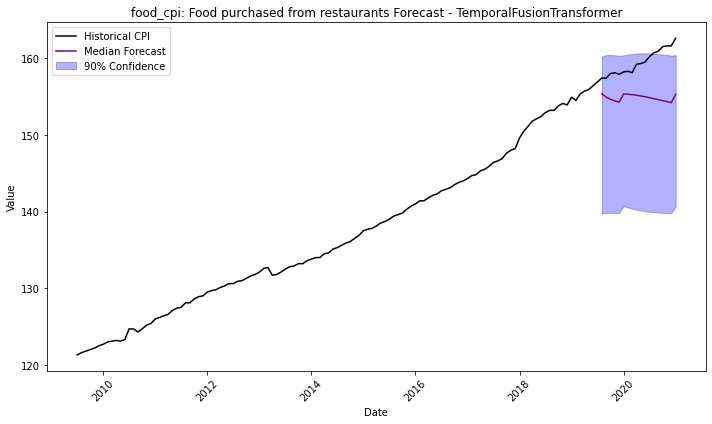

Beginning AutoGluon training... Time limit = 2s
AutoGluon will save models to './output/TEST/ag_global_all_TemporalFusionTransformerModel_exp2_R4_/random_seed_42/2019-07-01/model_files/'
=================== System Info ===================
AutoGluon Version:  1.1.1
Python Version:     3.8.20
Operating System:   Linux
Platform Machine:   x86_64
Platform Version:   #147~18.04.1-Ubuntu SMP Sat Oct 15 13:10:18 UTC 2022
CPU Count:          32
GPU Count:          1
Memory Avail:       166.88 GB / 188.57 GB (88.5%)
Disk Space Avail:   18211.80 GB / 249006.62 GB (7.3%)

Fitting with arguments:
{'enable_ensemble': True,
 'eval_metric': MAPE,
 'excluded_model_types': ['DirectTabular', 'RecursiveTabular'],
 'hyperparameters': {'TemporalFusionTransformerModel': {}},
 'known_covariates_names': [],
 'num_val_windows': 1,
 'prediction_length': 18,
 'quantile_levels': [0.01, 0.05, 0.1, 0.25, 0.75, 0.9, 0.95, 0.99],
 'random_seed': 42,
 'refit_every_n_windows': 1,
 'refit_full': False,
 'skip_model_sele

TemporalFusionTransformerModel


	-0.5667       = Validation score (-MAPE)
	2.14    s     = Training runtime
	0.04    s     = Validation (prediction) runtime
Not fitting ensemble due to lack of time remaining. Time left: -0.3 seconds
Training complete. Models trained: ['TemporalFusionTransformer']
Total runtime: 2.22 s
Best model: TemporalFusionTransformer
Best model score: -0.5667
Model not specified in predict, will default to the model with the best validation score: TemporalFusionTransformer
Model not specified in predict, will default to the model with the best validation score: TemporalFusionTransformer


****************** Summary of fit() ******************
Estimated performance of each model:
                       model  score_val  pred_time_val  fit_time_marginal  \
0  TemporalFusionTransformer  -0.566721       0.044126           2.138086   

   fit_order  
0          1  
Number of models trained: 1
Types of models trained:
{'MultiWindowBacktestingModel'}
****************** End of fit() summary ******************


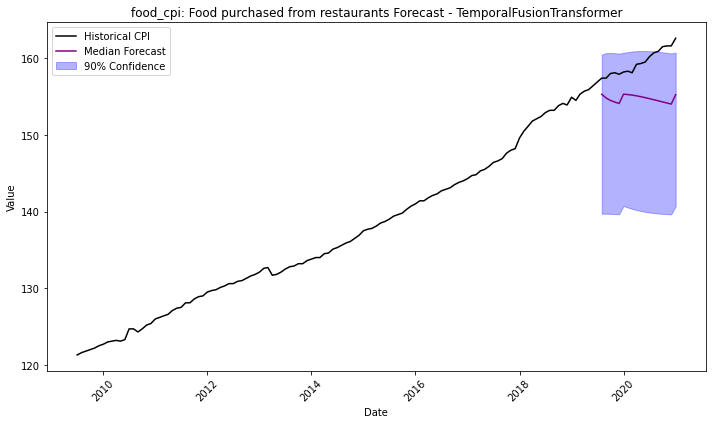

Beginning AutoGluon training... Time limit = 2s
AutoGluon will save models to './output/TEST/ag_global_all_TemporalFusionTransformerModel_exp2_GPT_P3_/random_seed_42/2019-07-01/model_files/'
=================== System Info ===================
AutoGluon Version:  1.1.1
Python Version:     3.8.20
Operating System:   Linux
Platform Machine:   x86_64
Platform Version:   #147~18.04.1-Ubuntu SMP Sat Oct 15 13:10:18 UTC 2022
CPU Count:          32
GPU Count:          1
Memory Avail:       166.79 GB / 188.57 GB (88.4%)
Disk Space Avail:   18211.80 GB / 249006.62 GB (7.3%)

Fitting with arguments:
{'enable_ensemble': True,
 'eval_metric': MAPE,
 'excluded_model_types': ['DirectTabular', 'RecursiveTabular'],
 'hyperparameters': {'TemporalFusionTransformerModel': {}},
 'known_covariates_names': [],
 'num_val_windows': 1,
 'prediction_length': 18,
 'quantile_levels': [0.01, 0.05, 0.1, 0.25, 0.75, 0.9, 0.95, 0.99],
 'random_seed': 42,
 'refit_every_n_windows': 1,
 'refit_full': False,
 'skip_model_

TemporalFusionTransformerModel


	-1.0749       = Validation score (-MAPE)
	2.15    s     = Training runtime
	0.05    s     = Validation (prediction) runtime
Not fitting ensemble due to lack of time remaining. Time left: -0.3 seconds
Training complete. Models trained: ['TemporalFusionTransformer']
Total runtime: 2.23 s
Best model: TemporalFusionTransformer
Best model score: -1.0749
Model not specified in predict, will default to the model with the best validation score: TemporalFusionTransformer
Model not specified in predict, will default to the model with the best validation score: TemporalFusionTransformer


****************** Summary of fit() ******************
Estimated performance of each model:
                       model  score_val  pred_time_val  fit_time_marginal  \
0  TemporalFusionTransformer  -1.074863       0.045857           2.149038   

   fit_order  
0          1  
Number of models trained: 1
Types of models trained:
{'MultiWindowBacktestingModel'}
****************** End of fit() summary ******************


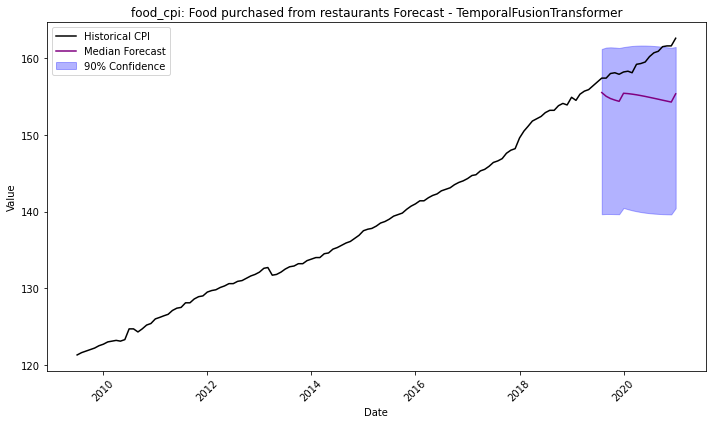

Beginning AutoGluon training... Time limit = 2s
AutoGluon will save models to './output/TEST/ag_global_all_TemporalFusionTransformerModel_exp2_R1_/random_seed_42/2020-07-01/model_files/'
=================== System Info ===================
AutoGluon Version:  1.1.1
Python Version:     3.8.20
Operating System:   Linux
Platform Machine:   x86_64
Platform Version:   #147~18.04.1-Ubuntu SMP Sat Oct 15 13:10:18 UTC 2022
CPU Count:          32
GPU Count:          1
Memory Avail:       166.78 GB / 188.57 GB (88.4%)
Disk Space Avail:   18211.83 GB / 249006.62 GB (7.3%)

Fitting with arguments:
{'enable_ensemble': True,
 'eval_metric': MAPE,
 'excluded_model_types': ['DirectTabular', 'RecursiveTabular'],
 'hyperparameters': {'TemporalFusionTransformerModel': {}},
 'known_covariates_names': [],
 'num_val_windows': 1,
 'prediction_length': 18,
 'quantile_levels': [0.01, 0.05, 0.1, 0.25, 0.75, 0.9, 0.95, 0.99],
 'random_seed': 42,
 'refit_every_n_windows': 1,
 'refit_full': False,
 'skip_model_sele

TemporalFusionTransformerModel


	-2.6566       = Validation score (-MAPE)
	2.15    s     = Training runtime
	0.05    s     = Validation (prediction) runtime
Not fitting ensemble due to lack of time remaining. Time left: -0.3 seconds
Training complete. Models trained: ['TemporalFusionTransformer']
Total runtime: 2.23 s
Best model: TemporalFusionTransformer
Best model score: -2.6566
Model not specified in predict, will default to the model with the best validation score: TemporalFusionTransformer


****************** Summary of fit() ******************
Estimated performance of each model:
                       model  score_val  pred_time_val  fit_time_marginal  \
0  TemporalFusionTransformer  -2.656641       0.045497            2.14607   

   fit_order  
0          1  
Number of models trained: 1
Types of models trained:
{'MultiWindowBacktestingModel'}
****************** End of fit() summary ******************


Model not specified in predict, will default to the model with the best validation score: TemporalFusionTransformer


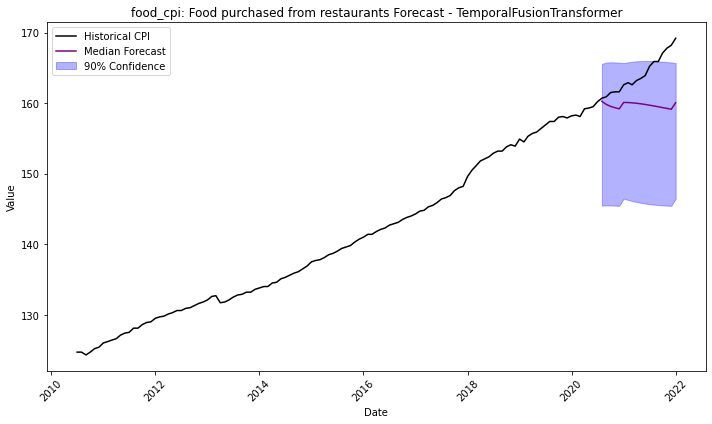

Beginning AutoGluon training... Time limit = 2s
AutoGluon will save models to './output/TEST/ag_global_all_TemporalFusionTransformerModel_exp2_GPT_P4_/random_seed_42/2020-07-01/model_files/'
=================== System Info ===================
AutoGluon Version:  1.1.1
Python Version:     3.8.20
Operating System:   Linux
Platform Machine:   x86_64
Platform Version:   #147~18.04.1-Ubuntu SMP Sat Oct 15 13:10:18 UTC 2022
CPU Count:          32
GPU Count:          1
Memory Avail:       166.78 GB / 188.57 GB (88.4%)
Disk Space Avail:   18211.82 GB / 249006.62 GB (7.3%)

Fitting with arguments:
{'enable_ensemble': True,
 'eval_metric': MAPE,
 'excluded_model_types': ['DirectTabular', 'RecursiveTabular'],
 'hyperparameters': {'TemporalFusionTransformerModel': {}},
 'known_covariates_names': [],
 'num_val_windows': 1,
 'prediction_length': 18,
 'quantile_levels': [0.01, 0.05, 0.1, 0.25, 0.75, 0.9, 0.95, 0.99],
 'random_seed': 42,
 'refit_every_n_windows': 1,
 'refit_full': False,
 'skip_model_

TemporalFusionTransformerModel


	-0.7090       = Validation score (-MAPE)
	2.16    s     = Training runtime
	0.04    s     = Validation (prediction) runtime
Not fitting ensemble due to lack of time remaining. Time left: -0.3 seconds
Training complete. Models trained: ['TemporalFusionTransformer']
Total runtime: 2.24 s
Best model: TemporalFusionTransformer
Best model score: -0.7090
Model not specified in predict, will default to the model with the best validation score: TemporalFusionTransformer
Model not specified in predict, will default to the model with the best validation score: TemporalFusionTransformer


****************** Summary of fit() ******************
Estimated performance of each model:
                       model  score_val  pred_time_val  fit_time_marginal  \
0  TemporalFusionTransformer  -0.709016        0.04263           2.157374   

   fit_order  
0          1  
Number of models trained: 1
Types of models trained:
{'MultiWindowBacktestingModel'}
****************** End of fit() summary ******************


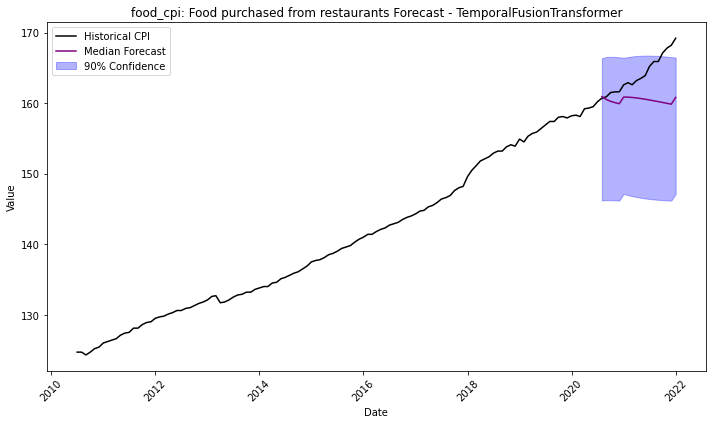

Beginning AutoGluon training... Time limit = 2s
AutoGluon will save models to './output/TEST/ag_global_all_TemporalFusionTransformerModel_exp2_R3_/random_seed_42/2020-07-01/model_files/'
=================== System Info ===================
AutoGluon Version:  1.1.1
Python Version:     3.8.20
Operating System:   Linux
Platform Machine:   x86_64
Platform Version:   #147~18.04.1-Ubuntu SMP Sat Oct 15 13:10:18 UTC 2022
CPU Count:          32
GPU Count:          1
Memory Avail:       166.92 GB / 188.57 GB (88.5%)
Disk Space Avail:   18211.80 GB / 249006.62 GB (7.3%)

Fitting with arguments:
{'enable_ensemble': True,
 'eval_metric': MAPE,
 'excluded_model_types': ['DirectTabular', 'RecursiveTabular'],
 'hyperparameters': {'TemporalFusionTransformerModel': {}},
 'known_covariates_names': [],
 'num_val_windows': 1,
 'prediction_length': 18,
 'quantile_levels': [0.01, 0.05, 0.1, 0.25, 0.75, 0.9, 0.95, 0.99],
 'random_seed': 42,
 'refit_every_n_windows': 1,
 'refit_full': False,
 'skip_model_sele

TemporalFusionTransformerModel


	-0.5757       = Validation score (-MAPE)
	2.13    s     = Training runtime
	0.05    s     = Validation (prediction) runtime
Not fitting ensemble due to lack of time remaining. Time left: -0.3 seconds
Training complete. Models trained: ['TemporalFusionTransformer']
Total runtime: 2.21 s
Best model: TemporalFusionTransformer
Best model score: -0.5757
Model not specified in predict, will default to the model with the best validation score: TemporalFusionTransformer
Model not specified in predict, will default to the model with the best validation score: TemporalFusionTransformer


****************** Summary of fit() ******************
Estimated performance of each model:
                       model  score_val  pred_time_val  fit_time_marginal  \
0  TemporalFusionTransformer  -0.575671       0.046553           2.128371   

   fit_order  
0          1  
Number of models trained: 1
Types of models trained:
{'MultiWindowBacktestingModel'}
****************** End of fit() summary ******************


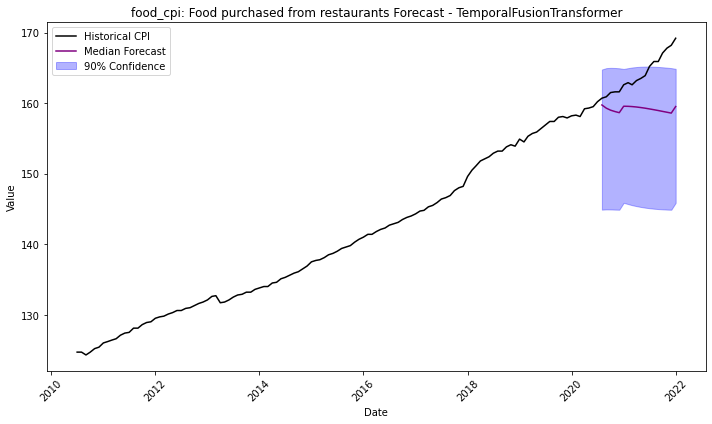

Beginning AutoGluon training... Time limit = 2s
AutoGluon will save models to './output/TEST/ag_global_all_TemporalFusionTransformerModel_exp2_GPT_P2_/random_seed_42/2020-07-01/model_files/'
=================== System Info ===================
AutoGluon Version:  1.1.1
Python Version:     3.8.20
Operating System:   Linux
Platform Machine:   x86_64
Platform Version:   #147~18.04.1-Ubuntu SMP Sat Oct 15 13:10:18 UTC 2022
CPU Count:          32
GPU Count:          1
Memory Avail:       166.78 GB / 188.57 GB (88.4%)
Disk Space Avail:   18212.29 GB / 249006.62 GB (7.3%)

Fitting with arguments:
{'enable_ensemble': True,
 'eval_metric': MAPE,
 'excluded_model_types': ['DirectTabular', 'RecursiveTabular'],
 'hyperparameters': {'TemporalFusionTransformerModel': {}},
 'known_covariates_names': [],
 'num_val_windows': 1,
 'prediction_length': 18,
 'quantile_levels': [0.01, 0.05, 0.1, 0.25, 0.75, 0.9, 0.95, 0.99],
 'random_seed': 42,
 'refit_every_n_windows': 1,
 'refit_full': False,
 'skip_model_

TemporalFusionTransformerModel


	-0.9739       = Validation score (-MAPE)
	2.12    s     = Training runtime
	0.04    s     = Validation (prediction) runtime
Not fitting ensemble due to lack of time remaining. Time left: -0.2 seconds
Training complete. Models trained: ['TemporalFusionTransformer']
Total runtime: 2.20 s
Best model: TemporalFusionTransformer
Best model score: -0.9739
Model not specified in predict, will default to the model with the best validation score: TemporalFusionTransformer
Model not specified in predict, will default to the model with the best validation score: TemporalFusionTransformer


****************** Summary of fit() ******************
Estimated performance of each model:
                       model  score_val  pred_time_val  fit_time_marginal  \
0  TemporalFusionTransformer  -0.973916       0.039754            2.11855   

   fit_order  
0          1  
Number of models trained: 1
Types of models trained:
{'MultiWindowBacktestingModel'}
****************** End of fit() summary ******************


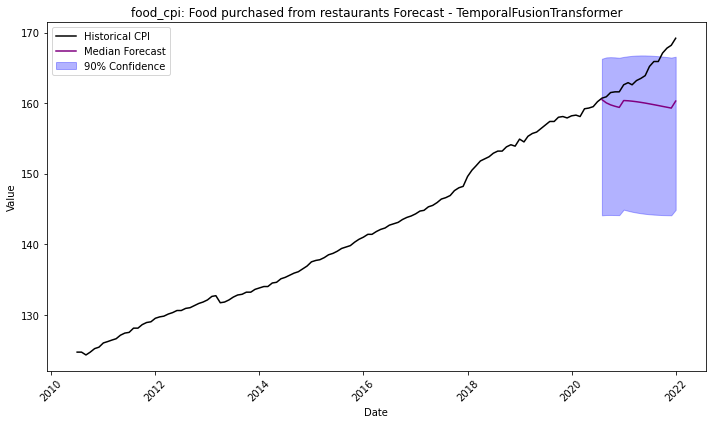

Beginning AutoGluon training... Time limit = 2s
AutoGluon will save models to './output/TEST/ag_global_all_TemporalFusionTransformerModel_exp2_GPT_P1_/random_seed_42/2020-07-01/model_files/'
=================== System Info ===================
AutoGluon Version:  1.1.1
Python Version:     3.8.20
Operating System:   Linux
Platform Machine:   x86_64
Platform Version:   #147~18.04.1-Ubuntu SMP Sat Oct 15 13:10:18 UTC 2022
CPU Count:          32
GPU Count:          1
Memory Avail:       166.90 GB / 188.57 GB (88.5%)
Disk Space Avail:   18212.28 GB / 249006.62 GB (7.3%)

Fitting with arguments:
{'enable_ensemble': True,
 'eval_metric': MAPE,
 'excluded_model_types': ['DirectTabular', 'RecursiveTabular'],
 'hyperparameters': {'TemporalFusionTransformerModel': {}},
 'known_covariates_names': [],
 'num_val_windows': 1,
 'prediction_length': 18,
 'quantile_levels': [0.01, 0.05, 0.1, 0.25, 0.75, 0.9, 0.95, 0.99],
 'random_seed': 42,
 'refit_every_n_windows': 1,
 'refit_full': False,
 'skip_model_

TemporalFusionTransformerModel


	-0.8372       = Validation score (-MAPE)
	2.13    s     = Training runtime
	0.04    s     = Validation (prediction) runtime
Not fitting ensemble due to lack of time remaining. Time left: -0.3 seconds
Training complete. Models trained: ['TemporalFusionTransformer']
Total runtime: 2.22 s
Best model: TemporalFusionTransformer
Best model score: -0.8372
Model not specified in predict, will default to the model with the best validation score: TemporalFusionTransformer
Model not specified in predict, will default to the model with the best validation score: TemporalFusionTransformer


****************** Summary of fit() ******************
Estimated performance of each model:
                       model  score_val  pred_time_val  fit_time_marginal  \
0  TemporalFusionTransformer  -0.837175       0.043065           2.133464   

   fit_order  
0          1  
Number of models trained: 1
Types of models trained:
{'MultiWindowBacktestingModel'}
****************** End of fit() summary ******************


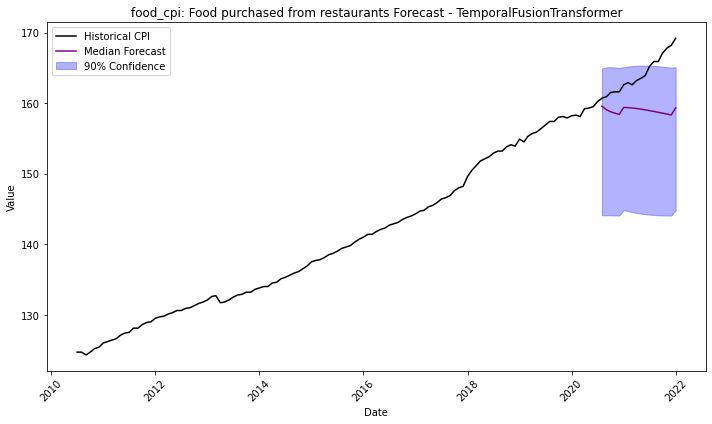

Beginning AutoGluon training... Time limit = 2s
AutoGluon will save models to './output/TEST/ag_global_all_TemporalFusionTransformerModel_exp2_R2_/random_seed_42/2020-07-01/model_files/'
=================== System Info ===================
AutoGluon Version:  1.1.1
Python Version:     3.8.20
Operating System:   Linux
Platform Machine:   x86_64
Platform Version:   #147~18.04.1-Ubuntu SMP Sat Oct 15 13:10:18 UTC 2022
CPU Count:          32
GPU Count:          1
Memory Avail:       166.78 GB / 188.57 GB (88.4%)
Disk Space Avail:   18212.27 GB / 249006.62 GB (7.3%)

Fitting with arguments:
{'enable_ensemble': True,
 'eval_metric': MAPE,
 'excluded_model_types': ['DirectTabular', 'RecursiveTabular'],
 'hyperparameters': {'TemporalFusionTransformerModel': {}},
 'known_covariates_names': [],
 'num_val_windows': 1,
 'prediction_length': 18,
 'quantile_levels': [0.01, 0.05, 0.1, 0.25, 0.75, 0.9, 0.95, 0.99],
 'random_seed': 42,
 'refit_every_n_windows': 1,
 'refit_full': False,
 'skip_model_sele

TemporalFusionTransformerModel


	-0.3753       = Validation score (-MAPE)
	2.13    s     = Training runtime
	0.04    s     = Validation (prediction) runtime
Not fitting ensemble due to lack of time remaining. Time left: -0.3 seconds
Training complete. Models trained: ['TemporalFusionTransformer']
Total runtime: 2.20 s
Best model: TemporalFusionTransformer
Best model score: -0.3753
Model not specified in predict, will default to the model with the best validation score: TemporalFusionTransformer
Model not specified in predict, will default to the model with the best validation score: TemporalFusionTransformer


****************** Summary of fit() ******************
Estimated performance of each model:
                       model  score_val  pred_time_val  fit_time_marginal  \
0  TemporalFusionTransformer  -0.375285       0.043233           2.126369   

   fit_order  
0          1  
Number of models trained: 1
Types of models trained:
{'MultiWindowBacktestingModel'}
****************** End of fit() summary ******************


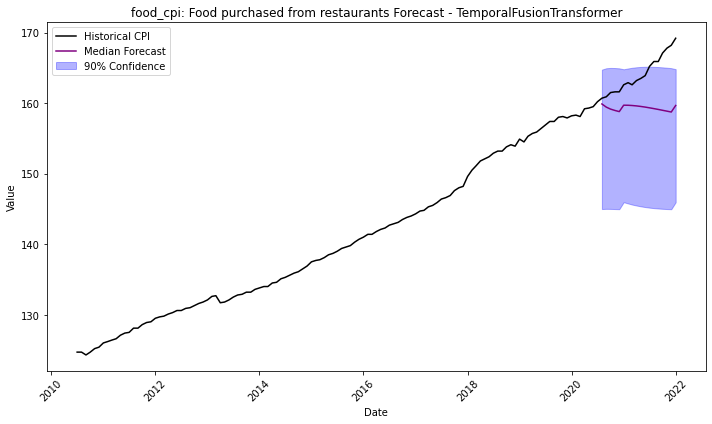

Beginning AutoGluon training... Time limit = 2s
AutoGluon will save models to './output/TEST/ag_global_all_TemporalFusionTransformerModel_exp2_R4_/random_seed_42/2020-07-01/model_files/'
=================== System Info ===================
AutoGluon Version:  1.1.1
Python Version:     3.8.20
Operating System:   Linux
Platform Machine:   x86_64
Platform Version:   #147~18.04.1-Ubuntu SMP Sat Oct 15 13:10:18 UTC 2022
CPU Count:          32
GPU Count:          1
Memory Avail:       166.78 GB / 188.57 GB (88.4%)
Disk Space Avail:   18212.26 GB / 249006.62 GB (7.3%)

Fitting with arguments:
{'enable_ensemble': True,
 'eval_metric': MAPE,
 'excluded_model_types': ['DirectTabular', 'RecursiveTabular'],
 'hyperparameters': {'TemporalFusionTransformerModel': {}},
 'known_covariates_names': [],
 'num_val_windows': 1,
 'prediction_length': 18,
 'quantile_levels': [0.01, 0.05, 0.1, 0.25, 0.75, 0.9, 0.95, 0.99],
 'random_seed': 42,
 'refit_every_n_windows': 1,
 'refit_full': False,
 'skip_model_sele

TemporalFusionTransformerModel


Inferred time series frequency: 'MS'
Provided train_data has 9130 rows, 22 time series. Median time series length is 415 (min=415, max=415). 

Provided data contains following columns:
	target: 'target'

AutoGluon will gauge predictive performance using evaluation metric: 'MAPE'
	This metric's sign has been flipped to adhere to being higher_is_better. The metric score can be multiplied by -1 to get the metric value.

Starting training. Start time is 2024-10-27 07:36:36
Excluded model types: ['DirectTabular', 'RecursiveTabular']
Models that will be trained: ['TemporalFusionTransformer']
Training timeseries model TemporalFusionTransformer. Training for up to 1.6s of the 1.6s of remaining time.
	-0.5236       = Validation score (-MAPE)
	1.82    s     = Training runtime
	0.05    s     = Validation (prediction) runtime
Not fitting ensemble due to lack of time remaining. Time left: -0.3 seconds
Training complete. Models trained: ['TemporalFusionTransformer']
Total runtime: 1.91 s
Best model:

****************** Summary of fit() ******************
Estimated performance of each model:
                       model  score_val  pred_time_val  fit_time_marginal  \
0  TemporalFusionTransformer  -0.523627       0.046607           1.823644   

   fit_order  
0          1  
Number of models trained: 1
Types of models trained:
{'MultiWindowBacktestingModel'}
****************** End of fit() summary ******************


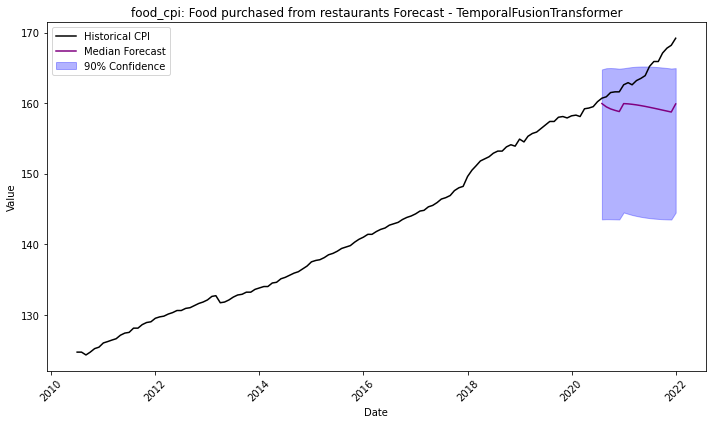

Beginning AutoGluon training... Time limit = 2s
AutoGluon will save models to './output/TEST/ag_global_all_TemporalFusionTransformerModel_exp2_GPT_P3_/random_seed_42/2020-07-01/model_files/'
=================== System Info ===================
AutoGluon Version:  1.1.1
Python Version:     3.8.20
Operating System:   Linux
Platform Machine:   x86_64
Platform Version:   #147~18.04.1-Ubuntu SMP Sat Oct 15 13:10:18 UTC 2022
CPU Count:          32
GPU Count:          1
Memory Avail:       166.78 GB / 188.57 GB (88.4%)
Disk Space Avail:   18212.25 GB / 249006.62 GB (7.3%)

Fitting with arguments:
{'enable_ensemble': True,
 'eval_metric': MAPE,
 'excluded_model_types': ['DirectTabular', 'RecursiveTabular'],
 'hyperparameters': {'TemporalFusionTransformerModel': {}},
 'known_covariates_names': [],
 'num_val_windows': 1,
 'prediction_length': 18,
 'quantile_levels': [0.01, 0.05, 0.1, 0.25, 0.75, 0.9, 0.95, 0.99],
 'random_seed': 42,
 'refit_every_n_windows': 1,
 'refit_full': False,
 'skip_model_

TemporalFusionTransformerModel


	-0.8465       = Validation score (-MAPE)
	2.14    s     = Training runtime
	0.04    s     = Validation (prediction) runtime
Not fitting ensemble due to lack of time remaining. Time left: -0.3 seconds
Training complete. Models trained: ['TemporalFusionTransformer']
Total runtime: 2.22 s
Best model: TemporalFusionTransformer
Best model score: -0.8465
Model not specified in predict, will default to the model with the best validation score: TemporalFusionTransformer
Model not specified in predict, will default to the model with the best validation score: TemporalFusionTransformer


****************** Summary of fit() ******************
Estimated performance of each model:
                       model  score_val  pred_time_val  fit_time_marginal  \
0  TemporalFusionTransformer  -0.846507       0.042522           2.138981   

   fit_order  
0          1  
Number of models trained: 1
Types of models trained:
{'MultiWindowBacktestingModel'}
****************** End of fit() summary ******************


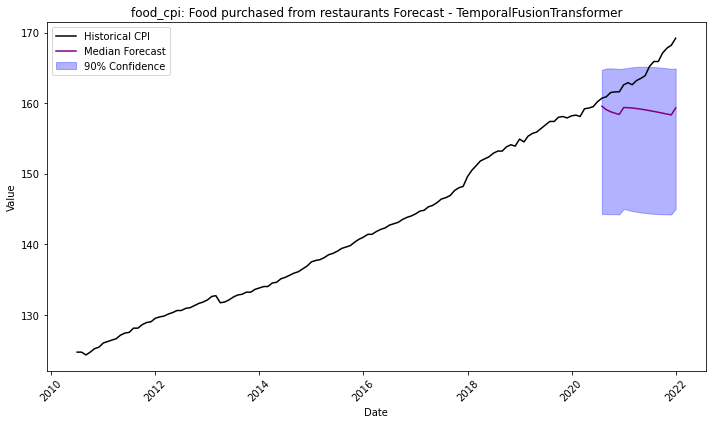

Beginning AutoGluon training... Time limit = 2s
AutoGluon will save models to './output/TEST/ag_global_all_TemporalFusionTransformerModel_exp2_R1_/random_seed_42/2021-07-01/model_files/'
=================== System Info ===================
AutoGluon Version:  1.1.1
Python Version:     3.8.20
Operating System:   Linux
Platform Machine:   x86_64
Platform Version:   #147~18.04.1-Ubuntu SMP Sat Oct 15 13:10:18 UTC 2022
CPU Count:          32
GPU Count:          1
Memory Avail:       166.86 GB / 188.57 GB (88.5%)
Disk Space Avail:   18212.24 GB / 249006.62 GB (7.3%)

Fitting with arguments:
{'enable_ensemble': True,
 'eval_metric': MAPE,
 'excluded_model_types': ['DirectTabular', 'RecursiveTabular'],
 'hyperparameters': {'TemporalFusionTransformerModel': {}},
 'known_covariates_names': [],
 'num_val_windows': 1,
 'prediction_length': 18,
 'quantile_levels': [0.01, 0.05, 0.1, 0.25, 0.75, 0.9, 0.95, 0.99],
 'random_seed': 42,
 'refit_every_n_windows': 1,
 'refit_full': False,
 'skip_model_sele

TemporalFusionTransformerModel


	-1.0669       = Validation score (-MAPE)
	2.12    s     = Training runtime
	0.04    s     = Validation (prediction) runtime
Not fitting ensemble due to lack of time remaining. Time left: -0.3 seconds
Training complete. Models trained: ['TemporalFusionTransformer']
Total runtime: 2.20 s
Best model: TemporalFusionTransformer
Best model score: -1.0669
Model not specified in predict, will default to the model with the best validation score: TemporalFusionTransformer
Model not specified in predict, will default to the model with the best validation score: TemporalFusionTransformer


****************** Summary of fit() ******************
Estimated performance of each model:
                       model  score_val  pred_time_val  fit_time_marginal  \
0  TemporalFusionTransformer  -1.066926       0.043316            2.11805   

   fit_order  
0          1  
Number of models trained: 1
Types of models trained:
{'MultiWindowBacktestingModel'}
****************** End of fit() summary ******************


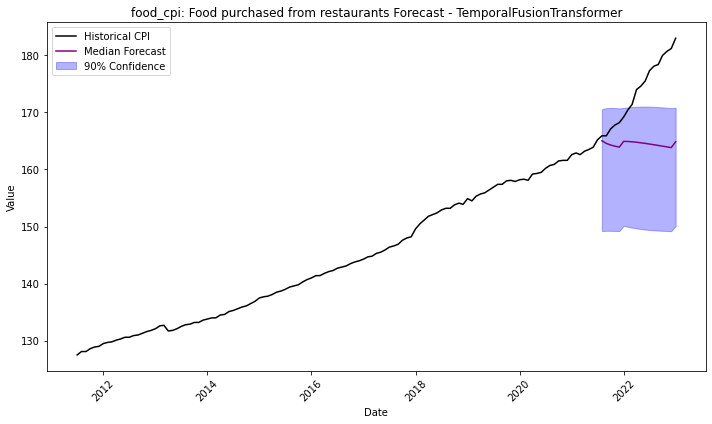

Beginning AutoGluon training... Time limit = 2s
AutoGluon will save models to './output/TEST/ag_global_all_TemporalFusionTransformerModel_exp2_GPT_P4_/random_seed_42/2021-07-01/model_files/'
=================== System Info ===================
AutoGluon Version:  1.1.1
Python Version:     3.8.20
Operating System:   Linux
Platform Machine:   x86_64
Platform Version:   #147~18.04.1-Ubuntu SMP Sat Oct 15 13:10:18 UTC 2022
CPU Count:          32
GPU Count:          1
Memory Avail:       166.92 GB / 188.57 GB (88.5%)
Disk Space Avail:   18212.29 GB / 249006.62 GB (7.3%)

Fitting with arguments:
{'enable_ensemble': True,
 'eval_metric': MAPE,
 'excluded_model_types': ['DirectTabular', 'RecursiveTabular'],
 'hyperparameters': {'TemporalFusionTransformerModel': {}},
 'known_covariates_names': [],
 'num_val_windows': 1,
 'prediction_length': 18,
 'quantile_levels': [0.01, 0.05, 0.1, 0.25, 0.75, 0.9, 0.95, 0.99],
 'random_seed': 42,
 'refit_every_n_windows': 1,
 'refit_full': False,
 'skip_model_

TemporalFusionTransformerModel


	-0.9082       = Validation score (-MAPE)
	2.12    s     = Training runtime
	0.04    s     = Validation (prediction) runtime
Not fitting ensemble due to lack of time remaining. Time left: -0.2 seconds
Training complete. Models trained: ['TemporalFusionTransformer']
Total runtime: 2.19 s
Best model: TemporalFusionTransformer
Best model score: -0.9082
Model not specified in predict, will default to the model with the best validation score: TemporalFusionTransformer
Model not specified in predict, will default to the model with the best validation score: TemporalFusionTransformer


****************** Summary of fit() ******************
Estimated performance of each model:
                       model  score_val  pred_time_val  fit_time_marginal  \
0  TemporalFusionTransformer  -0.908219       0.039635           2.116436   

   fit_order  
0          1  
Number of models trained: 1
Types of models trained:
{'MultiWindowBacktestingModel'}
****************** End of fit() summary ******************


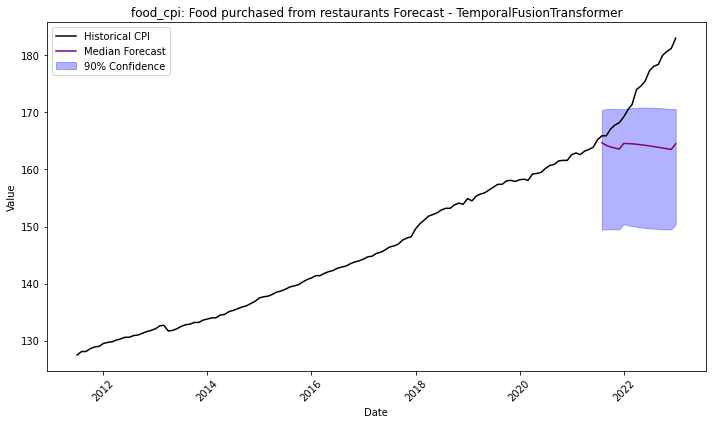

Beginning AutoGluon training... Time limit = 2s
AutoGluon will save models to './output/TEST/ag_global_all_TemporalFusionTransformerModel_exp2_R3_/random_seed_42/2021-07-01/model_files/'
=================== System Info ===================
AutoGluon Version:  1.1.1
Python Version:     3.8.20
Operating System:   Linux
Platform Machine:   x86_64
Platform Version:   #147~18.04.1-Ubuntu SMP Sat Oct 15 13:10:18 UTC 2022
CPU Count:          32
GPU Count:          1
Memory Avail:       166.78 GB / 188.57 GB (88.4%)
Disk Space Avail:   18212.27 GB / 249006.62 GB (7.3%)

Fitting with arguments:
{'enable_ensemble': True,
 'eval_metric': MAPE,
 'excluded_model_types': ['DirectTabular', 'RecursiveTabular'],
 'hyperparameters': {'TemporalFusionTransformerModel': {}},
 'known_covariates_names': [],
 'num_val_windows': 1,
 'prediction_length': 18,
 'quantile_levels': [0.01, 0.05, 0.1, 0.25, 0.75, 0.9, 0.95, 0.99],
 'random_seed': 42,
 'refit_every_n_windows': 1,
 'refit_full': False,
 'skip_model_sele

TemporalFusionTransformerModel


	-0.7123       = Validation score (-MAPE)
	2.16    s     = Training runtime
	0.04    s     = Validation (prediction) runtime
Not fitting ensemble due to lack of time remaining. Time left: -0.3 seconds
Training complete. Models trained: ['TemporalFusionTransformer']
Total runtime: 2.25 s
Best model: TemporalFusionTransformer
Best model score: -0.7123
Model not specified in predict, will default to the model with the best validation score: TemporalFusionTransformer
Model not specified in predict, will default to the model with the best validation score: TemporalFusionTransformer


****************** Summary of fit() ******************
Estimated performance of each model:
                       model  score_val  pred_time_val  fit_time_marginal  \
0  TemporalFusionTransformer  -0.712312       0.043831           2.156694   

   fit_order  
0          1  
Number of models trained: 1
Types of models trained:
{'MultiWindowBacktestingModel'}
****************** End of fit() summary ******************


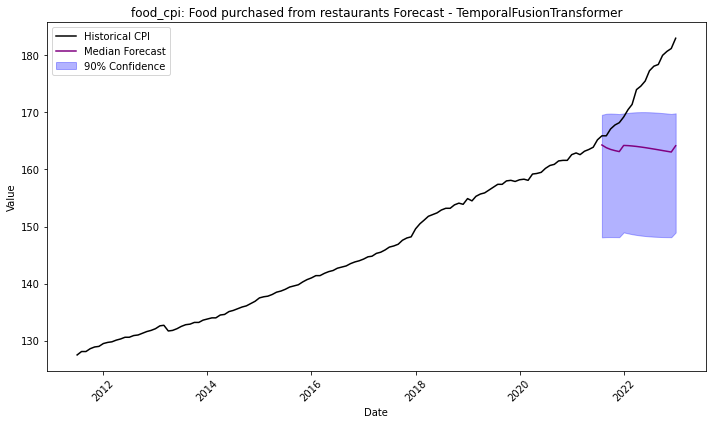

Beginning AutoGluon training... Time limit = 2s
AutoGluon will save models to './output/TEST/ag_global_all_TemporalFusionTransformerModel_exp2_GPT_P2_/random_seed_42/2021-07-01/model_files/'
=================== System Info ===================
AutoGluon Version:  1.1.1
Python Version:     3.8.20
Operating System:   Linux
Platform Machine:   x86_64
Platform Version:   #147~18.04.1-Ubuntu SMP Sat Oct 15 13:10:18 UTC 2022
CPU Count:          32
GPU Count:          1
Memory Avail:       166.77 GB / 188.57 GB (88.4%)
Disk Space Avail:   18212.26 GB / 249006.62 GB (7.3%)

Fitting with arguments:
{'enable_ensemble': True,
 'eval_metric': MAPE,
 'excluded_model_types': ['DirectTabular', 'RecursiveTabular'],
 'hyperparameters': {'TemporalFusionTransformerModel': {}},
 'known_covariates_names': [],
 'num_val_windows': 1,
 'prediction_length': 18,
 'quantile_levels': [0.01, 0.05, 0.1, 0.25, 0.75, 0.9, 0.95, 0.99],
 'random_seed': 42,
 'refit_every_n_windows': 1,
 'refit_full': False,
 'skip_model_

TemporalFusionTransformerModel


	-1.0991       = Validation score (-MAPE)
	2.14    s     = Training runtime
	0.04    s     = Validation (prediction) runtime
Not fitting ensemble due to lack of time remaining. Time left: -0.3 seconds
Training complete. Models trained: ['TemporalFusionTransformer']
Total runtime: 2.22 s
Best model: TemporalFusionTransformer
Best model score: -1.0991
Model not specified in predict, will default to the model with the best validation score: TemporalFusionTransformer
Model not specified in predict, will default to the model with the best validation score: TemporalFusionTransformer


****************** Summary of fit() ******************
Estimated performance of each model:
                       model  score_val  pred_time_val  fit_time_marginal  \
0  TemporalFusionTransformer  -1.099134       0.041153           2.139247   

   fit_order  
0          1  
Number of models trained: 1
Types of models trained:
{'MultiWindowBacktestingModel'}
****************** End of fit() summary ******************


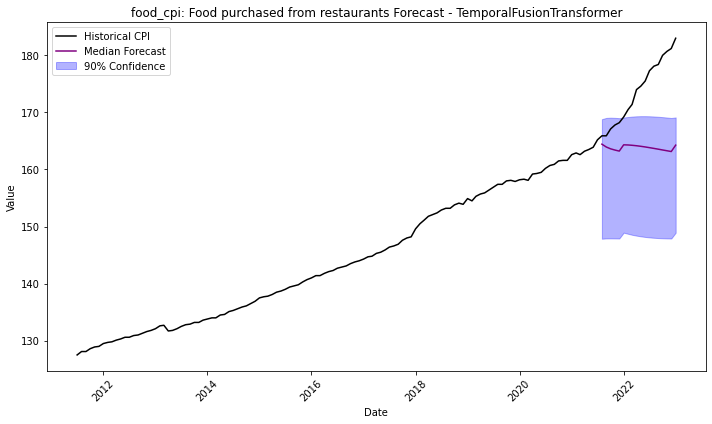

Beginning AutoGluon training... Time limit = 2s
AutoGluon will save models to './output/TEST/ag_global_all_TemporalFusionTransformerModel_exp2_GPT_P1_/random_seed_42/2021-07-01/model_files/'
=================== System Info ===================
AutoGluon Version:  1.1.1
Python Version:     3.8.20
Operating System:   Linux
Platform Machine:   x86_64
Platform Version:   #147~18.04.1-Ubuntu SMP Sat Oct 15 13:10:18 UTC 2022
CPU Count:          32
GPU Count:          1
Memory Avail:       166.98 GB / 188.57 GB (88.5%)
Disk Space Avail:   18212.25 GB / 249006.62 GB (7.3%)

Fitting with arguments:
{'enable_ensemble': True,
 'eval_metric': MAPE,
 'excluded_model_types': ['DirectTabular', 'RecursiveTabular'],
 'hyperparameters': {'TemporalFusionTransformerModel': {}},
 'known_covariates_names': [],
 'num_val_windows': 1,
 'prediction_length': 18,
 'quantile_levels': [0.01, 0.05, 0.1, 0.25, 0.75, 0.9, 0.95, 0.99],
 'random_seed': 42,
 'refit_every_n_windows': 1,
 'refit_full': False,
 'skip_model_

TemporalFusionTransformerModel


	-1.0981       = Validation score (-MAPE)
	2.13    s     = Training runtime
	0.04    s     = Validation (prediction) runtime
Not fitting ensemble due to lack of time remaining. Time left: -0.3 seconds
Training complete. Models trained: ['TemporalFusionTransformer']
Total runtime: 2.21 s
Best model: TemporalFusionTransformer
Best model score: -1.0981
Model not specified in predict, will default to the model with the best validation score: TemporalFusionTransformer
Model not specified in predict, will default to the model with the best validation score: TemporalFusionTransformer


****************** Summary of fit() ******************
Estimated performance of each model:
                       model  score_val  pred_time_val  fit_time_marginal  \
0  TemporalFusionTransformer  -1.098056        0.04224           2.134241   

   fit_order  
0          1  
Number of models trained: 1
Types of models trained:
{'MultiWindowBacktestingModel'}
****************** End of fit() summary ******************


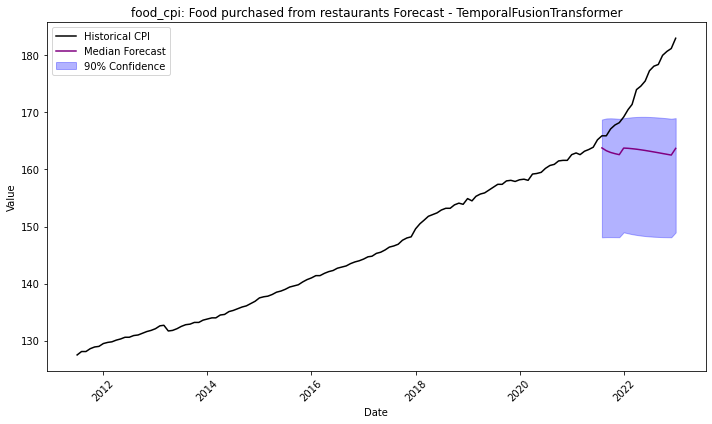

Beginning AutoGluon training... Time limit = 2s
AutoGluon will save models to './output/TEST/ag_global_all_TemporalFusionTransformerModel_exp2_R2_/random_seed_42/2021-07-01/model_files/'
=================== System Info ===================
AutoGluon Version:  1.1.1
Python Version:     3.8.20
Operating System:   Linux
Platform Machine:   x86_64
Platform Version:   #147~18.04.1-Ubuntu SMP Sat Oct 15 13:10:18 UTC 2022
CPU Count:          32
GPU Count:          1
Memory Avail:       166.88 GB / 188.57 GB (88.5%)
Disk Space Avail:   18212.25 GB / 249006.62 GB (7.3%)

Fitting with arguments:
{'enable_ensemble': True,
 'eval_metric': MAPE,
 'excluded_model_types': ['DirectTabular', 'RecursiveTabular'],
 'hyperparameters': {'TemporalFusionTransformerModel': {}},
 'known_covariates_names': [],
 'num_val_windows': 1,
 'prediction_length': 18,
 'quantile_levels': [0.01, 0.05, 0.1, 0.25, 0.75, 0.9, 0.95, 0.99],
 'random_seed': 42,
 'refit_every_n_windows': 1,
 'refit_full': False,
 'skip_model_sele

TemporalFusionTransformerModel


	-0.5338       = Validation score (-MAPE)
	2.11    s     = Training runtime
	0.05    s     = Validation (prediction) runtime
Not fitting ensemble due to lack of time remaining. Time left: -0.3 seconds
Training complete. Models trained: ['TemporalFusionTransformer']
Total runtime: 2.20 s
Best model: TemporalFusionTransformer
Best model score: -0.5338
Model not specified in predict, will default to the model with the best validation score: TemporalFusionTransformer
Model not specified in predict, will default to the model with the best validation score: TemporalFusionTransformer


****************** Summary of fit() ******************
Estimated performance of each model:
                       model  score_val  pred_time_val  fit_time_marginal  \
0  TemporalFusionTransformer  -0.533815       0.048016           2.109926   

   fit_order  
0          1  
Number of models trained: 1
Types of models trained:
{'MultiWindowBacktestingModel'}
****************** End of fit() summary ******************


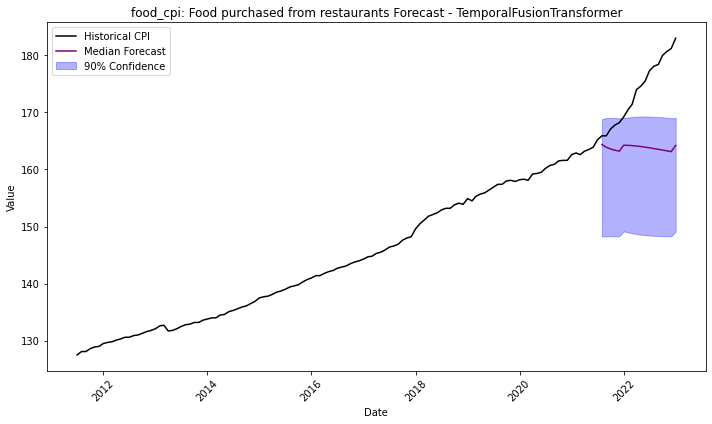

Beginning AutoGluon training... Time limit = 2s
AutoGluon will save models to './output/TEST/ag_global_all_TemporalFusionTransformerModel_exp2_R4_/random_seed_42/2021-07-01/model_files/'
=================== System Info ===================
AutoGluon Version:  1.1.1
Python Version:     3.8.20
Operating System:   Linux
Platform Machine:   x86_64
Platform Version:   #147~18.04.1-Ubuntu SMP Sat Oct 15 13:10:18 UTC 2022
CPU Count:          32
GPU Count:          1
Memory Avail:       166.78 GB / 188.57 GB (88.4%)
Disk Space Avail:   18212.30 GB / 249006.62 GB (7.3%)

Fitting with arguments:
{'enable_ensemble': True,
 'eval_metric': MAPE,
 'excluded_model_types': ['DirectTabular', 'RecursiveTabular'],
 'hyperparameters': {'TemporalFusionTransformerModel': {}},
 'known_covariates_names': [],
 'num_val_windows': 1,
 'prediction_length': 18,
 'quantile_levels': [0.01, 0.05, 0.1, 0.25, 0.75, 0.9, 0.95, 0.99],
 'random_seed': 42,
 'refit_every_n_windows': 1,
 'refit_full': False,
 'skip_model_sele

TemporalFusionTransformerModel


	-0.7075       = Validation score (-MAPE)
	2.11    s     = Training runtime
	0.04    s     = Validation (prediction) runtime
Not fitting ensemble due to lack of time remaining. Time left: -0.3 seconds
Training complete. Models trained: ['TemporalFusionTransformer']
Total runtime: 2.20 s
Best model: TemporalFusionTransformer
Best model score: -0.7075
Model not specified in predict, will default to the model with the best validation score: TemporalFusionTransformer
Model not specified in predict, will default to the model with the best validation score: TemporalFusionTransformer


****************** Summary of fit() ******************
Estimated performance of each model:
                       model  score_val  pred_time_val  fit_time_marginal  \
0  TemporalFusionTransformer  -0.707477       0.042148           2.110164   

   fit_order  
0          1  
Number of models trained: 1
Types of models trained:
{'MultiWindowBacktestingModel'}
****************** End of fit() summary ******************


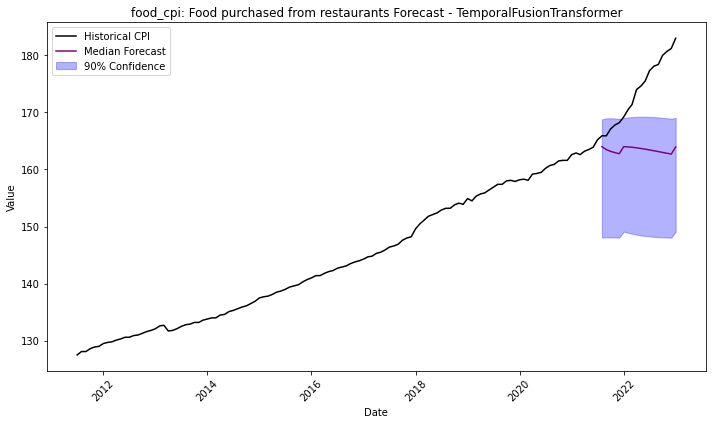

Beginning AutoGluon training... Time limit = 2s
AutoGluon will save models to './output/TEST/ag_global_all_TemporalFusionTransformerModel_exp2_GPT_P3_/random_seed_42/2021-07-01/model_files/'
=================== System Info ===================
AutoGluon Version:  1.1.1
Python Version:     3.8.20
Operating System:   Linux
Platform Machine:   x86_64
Platform Version:   #147~18.04.1-Ubuntu SMP Sat Oct 15 13:10:18 UTC 2022
CPU Count:          32
GPU Count:          1
Memory Avail:       166.77 GB / 188.57 GB (88.4%)
Disk Space Avail:   18212.29 GB / 249006.62 GB (7.3%)

Fitting with arguments:
{'enable_ensemble': True,
 'eval_metric': MAPE,
 'excluded_model_types': ['DirectTabular', 'RecursiveTabular'],
 'hyperparameters': {'TemporalFusionTransformerModel': {}},
 'known_covariates_names': [],
 'num_val_windows': 1,
 'prediction_length': 18,
 'quantile_levels': [0.01, 0.05, 0.1, 0.25, 0.75, 0.9, 0.95, 0.99],
 'random_seed': 42,
 'refit_every_n_windows': 1,
 'refit_full': False,
 'skip_model_

TemporalFusionTransformerModel


	-1.1414       = Validation score (-MAPE)
	2.13    s     = Training runtime
	0.04    s     = Validation (prediction) runtime
Not fitting ensemble due to lack of time remaining. Time left: -0.3 seconds
Training complete. Models trained: ['TemporalFusionTransformer']
Total runtime: 2.21 s
Best model: TemporalFusionTransformer
Best model score: -1.1414
Model not specified in predict, will default to the model with the best validation score: TemporalFusionTransformer
Model not specified in predict, will default to the model with the best validation score: TemporalFusionTransformer


****************** Summary of fit() ******************
Estimated performance of each model:
                       model  score_val  pred_time_val  fit_time_marginal  \
0  TemporalFusionTransformer  -1.141449       0.043794            2.12621   

   fit_order  
0          1  
Number of models trained: 1
Types of models trained:
{'MultiWindowBacktestingModel'}
****************** End of fit() summary ******************


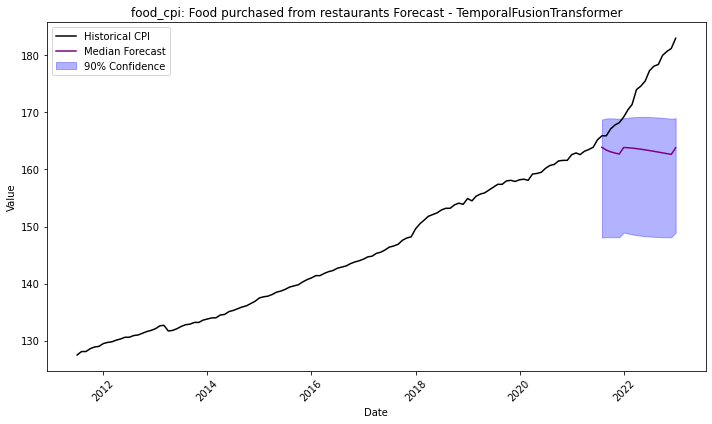

Beginning AutoGluon training... Time limit = 2s
AutoGluon will save models to './output/TEST/ag_global_all_TemporalFusionTransformerModel_exp2_R1_/random_seed_42/2022-07-01/model_files/'
=================== System Info ===================
AutoGluon Version:  1.1.1
Python Version:     3.8.20
Operating System:   Linux
Platform Machine:   x86_64
Platform Version:   #147~18.04.1-Ubuntu SMP Sat Oct 15 13:10:18 UTC 2022
CPU Count:          32
GPU Count:          1
Memory Avail:       166.84 GB / 188.57 GB (88.5%)
Disk Space Avail:   18212.28 GB / 249006.62 GB (7.3%)

Fitting with arguments:
{'enable_ensemble': True,
 'eval_metric': MAPE,
 'excluded_model_types': ['DirectTabular', 'RecursiveTabular'],
 'hyperparameters': {'TemporalFusionTransformerModel': {}},
 'known_covariates_names': [],
 'num_val_windows': 1,
 'prediction_length': 18,
 'quantile_levels': [0.01, 0.05, 0.1, 0.25, 0.75, 0.9, 0.95, 0.99],
 'random_seed': 42,
 'refit_every_n_windows': 1,
 'refit_full': False,
 'skip_model_sele

TemporalFusionTransformerModel


	-5.8000       = Validation score (-MAPE)
	2.18    s     = Training runtime
	0.04    s     = Validation (prediction) runtime
Not fitting ensemble due to lack of time remaining. Time left: -0.3 seconds
Training complete. Models trained: ['TemporalFusionTransformer']
Total runtime: 2.26 s
Best model: TemporalFusionTransformer
Best model score: -5.8000


****************** Summary of fit() ******************
Estimated performance of each model:
                       model  score_val  pred_time_val  fit_time_marginal  \
0  TemporalFusionTransformer  -5.799978       0.043491           2.175503   

   fit_order  
0          1  
Number of models trained: 1
Types of models trained:
{'MultiWindowBacktestingModel'}
****************** End of fit() summary ******************


Model not specified in predict, will default to the model with the best validation score: TemporalFusionTransformer
Model not specified in predict, will default to the model with the best validation score: TemporalFusionTransformer


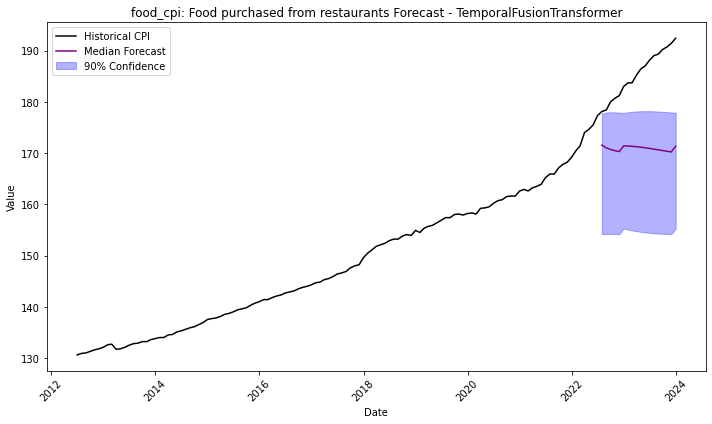

Beginning AutoGluon training... Time limit = 2s
AutoGluon will save models to './output/TEST/ag_global_all_TemporalFusionTransformerModel_exp2_GPT_P4_/random_seed_42/2022-07-01/model_files/'
=================== System Info ===================
AutoGluon Version:  1.1.1
Python Version:     3.8.20
Operating System:   Linux
Platform Machine:   x86_64
Platform Version:   #147~18.04.1-Ubuntu SMP Sat Oct 15 13:10:18 UTC 2022
CPU Count:          32
GPU Count:          1
Memory Avail:       166.78 GB / 188.57 GB (88.4%)
Disk Space Avail:   18212.26 GB / 249006.62 GB (7.3%)

Fitting with arguments:
{'enable_ensemble': True,
 'eval_metric': MAPE,
 'excluded_model_types': ['DirectTabular', 'RecursiveTabular'],
 'hyperparameters': {'TemporalFusionTransformerModel': {}},
 'known_covariates_names': [],
 'num_val_windows': 1,
 'prediction_length': 18,
 'quantile_levels': [0.01, 0.05, 0.1, 0.25, 0.75, 0.9, 0.95, 0.99],
 'random_seed': 42,
 'refit_every_n_windows': 1,
 'refit_full': False,
 'skip_model_

TemporalFusionTransformerModel


	-6.6438       = Validation score (-MAPE)
	2.13    s     = Training runtime
	0.04    s     = Validation (prediction) runtime
Not fitting ensemble due to lack of time remaining. Time left: -0.2 seconds
Training complete. Models trained: ['TemporalFusionTransformer']
Total runtime: 2.20 s
Best model: TemporalFusionTransformer
Best model score: -6.6438
Model not specified in predict, will default to the model with the best validation score: TemporalFusionTransformer
Model not specified in predict, will default to the model with the best validation score: TemporalFusionTransformer


****************** Summary of fit() ******************
Estimated performance of each model:
                       model  score_val  pred_time_val  fit_time_marginal  \
0  TemporalFusionTransformer  -6.643782       0.037667           2.126769   

   fit_order  
0          1  
Number of models trained: 1
Types of models trained:
{'MultiWindowBacktestingModel'}
****************** End of fit() summary ******************


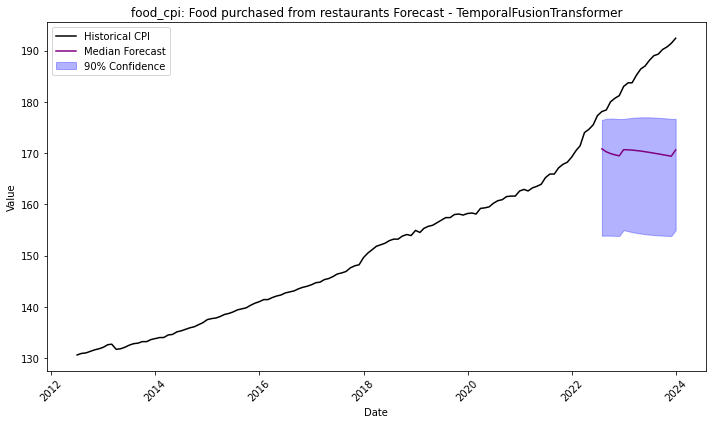

Beginning AutoGluon training... Time limit = 2s
AutoGluon will save models to './output/TEST/ag_global_all_TemporalFusionTransformerModel_exp2_R3_/random_seed_42/2022-07-01/model_files/'
=================== System Info ===================
AutoGluon Version:  1.1.1
Python Version:     3.8.20
Operating System:   Linux
Platform Machine:   x86_64
Platform Version:   #147~18.04.1-Ubuntu SMP Sat Oct 15 13:10:18 UTC 2022
CPU Count:          32
GPU Count:          1
Memory Avail:       166.78 GB / 188.57 GB (88.4%)
Disk Space Avail:   18212.25 GB / 249006.62 GB (7.3%)

Fitting with arguments:
{'enable_ensemble': True,
 'eval_metric': MAPE,
 'excluded_model_types': ['DirectTabular', 'RecursiveTabular'],
 'hyperparameters': {'TemporalFusionTransformerModel': {}},
 'known_covariates_names': [],
 'num_val_windows': 1,
 'prediction_length': 18,
 'quantile_levels': [0.01, 0.05, 0.1, 0.25, 0.75, 0.9, 0.95, 0.99],
 'random_seed': 42,
 'refit_every_n_windows': 1,
 'refit_full': False,
 'skip_model_sele

TemporalFusionTransformerModel


	-0.4277       = Validation score (-MAPE)
	2.13    s     = Training runtime
	0.04    s     = Validation (prediction) runtime
Not fitting ensemble due to lack of time remaining. Time left: -0.3 seconds
Training complete. Models trained: ['TemporalFusionTransformer']
Total runtime: 2.22 s
Best model: TemporalFusionTransformer
Best model score: -0.4277
Model not specified in predict, will default to the model with the best validation score: TemporalFusionTransformer
Model not specified in predict, will default to the model with the best validation score: TemporalFusionTransformer


****************** Summary of fit() ******************
Estimated performance of each model:
                       model  score_val  pred_time_val  fit_time_marginal  \
0  TemporalFusionTransformer  -0.427737       0.044586           2.131875   

   fit_order  
0          1  
Number of models trained: 1
Types of models trained:
{'MultiWindowBacktestingModel'}
****************** End of fit() summary ******************


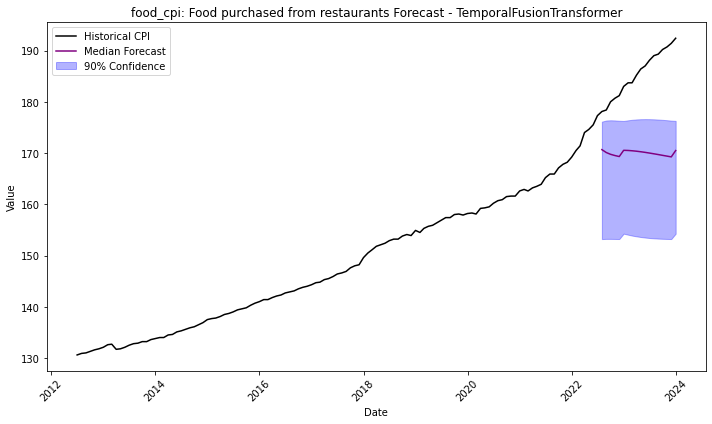

Beginning AutoGluon training... Time limit = 2s
AutoGluon will save models to './output/TEST/ag_global_all_TemporalFusionTransformerModel_exp2_GPT_P2_/random_seed_42/2022-07-01/model_files/'
=================== System Info ===================
AutoGluon Version:  1.1.1
Python Version:     3.8.20
Operating System:   Linux
Platform Machine:   x86_64
Platform Version:   #147~18.04.1-Ubuntu SMP Sat Oct 15 13:10:18 UTC 2022
CPU Count:          32
GPU Count:          1
Memory Avail:       166.78 GB / 188.57 GB (88.4%)
Disk Space Avail:   18211.30 GB / 249006.62 GB (7.3%)

Fitting with arguments:
{'enable_ensemble': True,
 'eval_metric': MAPE,
 'excluded_model_types': ['DirectTabular', 'RecursiveTabular'],
 'hyperparameters': {'TemporalFusionTransformerModel': {}},
 'known_covariates_names': [],
 'num_val_windows': 1,
 'prediction_length': 18,
 'quantile_levels': [0.01, 0.05, 0.1, 0.25, 0.75, 0.9, 0.95, 0.99],
 'random_seed': 42,
 'refit_every_n_windows': 1,
 'refit_full': False,
 'skip_model_

TemporalFusionTransformerModel


	-6.2780       = Validation score (-MAPE)
	2.09    s     = Training runtime
	0.04    s     = Validation (prediction) runtime
Not fitting ensemble due to lack of time remaining. Time left: -0.3 seconds
Training complete. Models trained: ['TemporalFusionTransformer']
Total runtime: 2.16 s
Best model: TemporalFusionTransformer
Best model score: -6.2780
Model not specified in predict, will default to the model with the best validation score: TemporalFusionTransformer
Model not specified in predict, will default to the model with the best validation score: TemporalFusionTransformer


****************** Summary of fit() ******************
Estimated performance of each model:
                       model  score_val  pred_time_val  fit_time_marginal  \
0  TemporalFusionTransformer  -6.278035       0.040872           2.088028   

   fit_order  
0          1  
Number of models trained: 1
Types of models trained:
{'MultiWindowBacktestingModel'}
****************** End of fit() summary ******************


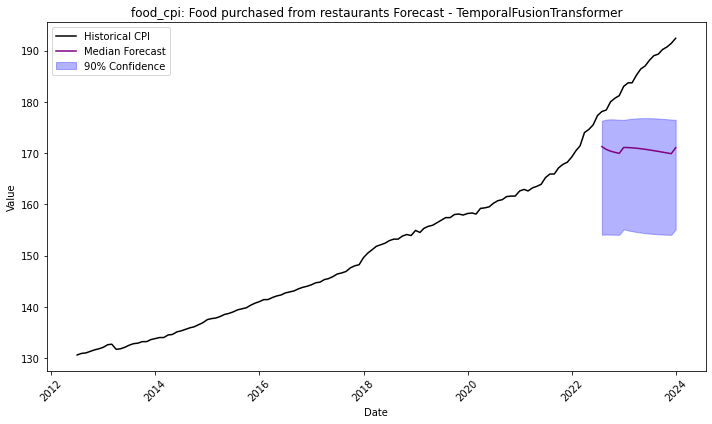

Beginning AutoGluon training... Time limit = 2s
AutoGluon will save models to './output/TEST/ag_global_all_TemporalFusionTransformerModel_exp2_GPT_P1_/random_seed_42/2022-07-01/model_files/'
=================== System Info ===================
AutoGluon Version:  1.1.1
Python Version:     3.8.20
Operating System:   Linux
Platform Machine:   x86_64
Platform Version:   #147~18.04.1-Ubuntu SMP Sat Oct 15 13:10:18 UTC 2022
CPU Count:          32
GPU Count:          1
Memory Avail:       166.88 GB / 188.57 GB (88.5%)
Disk Space Avail:   18211.37 GB / 249006.62 GB (7.3%)

Fitting with arguments:
{'enable_ensemble': True,
 'eval_metric': MAPE,
 'excluded_model_types': ['DirectTabular', 'RecursiveTabular'],
 'hyperparameters': {'TemporalFusionTransformerModel': {}},
 'known_covariates_names': [],
 'num_val_windows': 1,
 'prediction_length': 18,
 'quantile_levels': [0.01, 0.05, 0.1, 0.25, 0.75, 0.9, 0.95, 0.99],
 'random_seed': 42,
 'refit_every_n_windows': 1,
 'refit_full': False,
 'skip_model_

TemporalFusionTransformerModel


	-5.4484       = Validation score (-MAPE)
	2.14    s     = Training runtime
	0.04    s     = Validation (prediction) runtime
Not fitting ensemble due to lack of time remaining. Time left: -0.3 seconds
Training complete. Models trained: ['TemporalFusionTransformer']
Total runtime: 2.22 s
Best model: TemporalFusionTransformer
Best model score: -5.4484
Model not specified in predict, will default to the model with the best validation score: TemporalFusionTransformer
Model not specified in predict, will default to the model with the best validation score: TemporalFusionTransformer


****************** Summary of fit() ******************
Estimated performance of each model:
                       model  score_val  pred_time_val  fit_time_marginal  \
0  TemporalFusionTransformer  -5.448378        0.04269           2.144293   

   fit_order  
0          1  
Number of models trained: 1
Types of models trained:
{'MultiWindowBacktestingModel'}
****************** End of fit() summary ******************


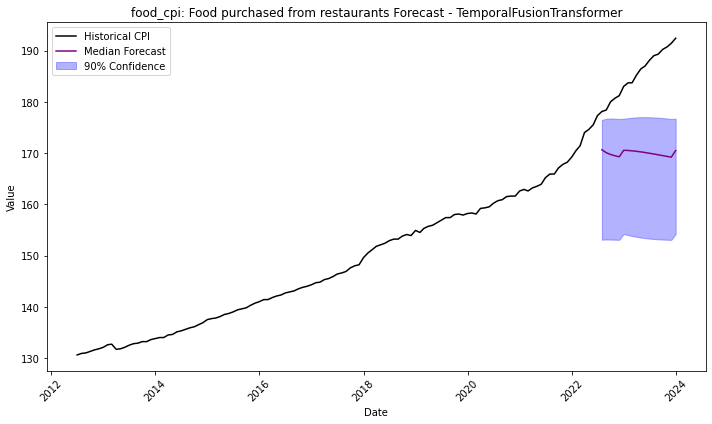

Beginning AutoGluon training... Time limit = 2s
AutoGluon will save models to './output/TEST/ag_global_all_TemporalFusionTransformerModel_exp2_R2_/random_seed_42/2022-07-01/model_files/'
=================== System Info ===================
AutoGluon Version:  1.1.1
Python Version:     3.8.20
Operating System:   Linux
Platform Machine:   x86_64
Platform Version:   #147~18.04.1-Ubuntu SMP Sat Oct 15 13:10:18 UTC 2022
CPU Count:          32
GPU Count:          1
Memory Avail:       166.78 GB / 188.57 GB (88.4%)
Disk Space Avail:   18211.36 GB / 249006.62 GB (7.3%)

Fitting with arguments:
{'enable_ensemble': True,
 'eval_metric': MAPE,
 'excluded_model_types': ['DirectTabular', 'RecursiveTabular'],
 'hyperparameters': {'TemporalFusionTransformerModel': {}},
 'known_covariates_names': [],
 'num_val_windows': 1,
 'prediction_length': 18,
 'quantile_levels': [0.01, 0.05, 0.1, 0.25, 0.75, 0.9, 0.95, 0.99],
 'random_seed': 42,
 'refit_every_n_windows': 1,
 'refit_full': False,
 'skip_model_sele

TemporalFusionTransformerModel


	-0.5746       = Validation score (-MAPE)
	2.10    s     = Training runtime
	0.04    s     = Validation (prediction) runtime
Not fitting ensemble due to lack of time remaining. Time left: -0.2 seconds
Training complete. Models trained: ['TemporalFusionTransformer']
Total runtime: 2.18 s
Best model: TemporalFusionTransformer
Best model score: -0.5746
Model not specified in predict, will default to the model with the best validation score: TemporalFusionTransformer
Model not specified in predict, will default to the model with the best validation score: TemporalFusionTransformer


****************** Summary of fit() ******************
Estimated performance of each model:
                       model  score_val  pred_time_val  fit_time_marginal  \
0  TemporalFusionTransformer  -0.574632       0.042511           2.097173   

   fit_order  
0          1  
Number of models trained: 1
Types of models trained:
{'MultiWindowBacktestingModel'}
****************** End of fit() summary ******************


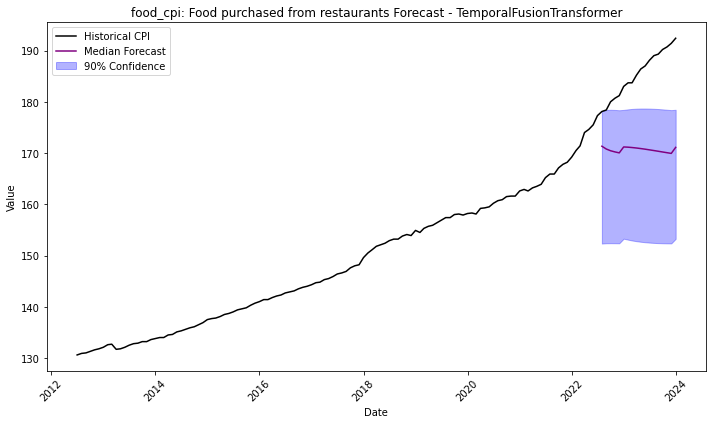

Beginning AutoGluon training... Time limit = 2s
AutoGluon will save models to './output/TEST/ag_global_all_TemporalFusionTransformerModel_exp2_R4_/random_seed_42/2022-07-01/model_files/'
=================== System Info ===================
AutoGluon Version:  1.1.1
Python Version:     3.8.20
Operating System:   Linux
Platform Machine:   x86_64
Platform Version:   #147~18.04.1-Ubuntu SMP Sat Oct 15 13:10:18 UTC 2022
CPU Count:          32
GPU Count:          1
Memory Avail:       166.77 GB / 188.57 GB (88.4%)
Disk Space Avail:   18211.34 GB / 249006.62 GB (7.3%)

Fitting with arguments:
{'enable_ensemble': True,
 'eval_metric': MAPE,
 'excluded_model_types': ['DirectTabular', 'RecursiveTabular'],
 'hyperparameters': {'TemporalFusionTransformerModel': {}},
 'known_covariates_names': [],
 'num_val_windows': 1,
 'prediction_length': 18,
 'quantile_levels': [0.01, 0.05, 0.1, 0.25, 0.75, 0.9, 0.95, 0.99],
 'random_seed': 42,
 'refit_every_n_windows': 1,
 'refit_full': False,
 'skip_model_sele

TemporalFusionTransformerModel


Inferred time series frequency: 'MS'
Provided train_data has 9658 rows, 22 time series. Median time series length is 439 (min=439, max=439). 

Provided data contains following columns:
	target: 'target'

AutoGluon will gauge predictive performance using evaluation metric: 'MAPE'
	This metric's sign has been flipped to adhere to being higher_is_better. The metric score can be multiplied by -1 to get the metric value.

Starting training. Start time is 2024-10-27 07:37:22
Excluded model types: ['DirectTabular', 'RecursiveTabular']
Models that will be trained: ['TemporalFusionTransformer']
Training timeseries model TemporalFusionTransformer. Training for up to 1.7s of the 1.7s of remaining time.
	-5.5368       = Validation score (-MAPE)
	1.86    s     = Training runtime
	0.04    s     = Validation (prediction) runtime
Not fitting ensemble due to lack of time remaining. Time left: -0.3 seconds
Training complete. Models trained: ['TemporalFusionTransformer']
Total runtime: 1.95 s
Best model:

****************** Summary of fit() ******************
Estimated performance of each model:
                       model  score_val  pred_time_val  fit_time_marginal  \
0  TemporalFusionTransformer  -5.536834       0.043073           1.857925   

   fit_order  
0          1  
Number of models trained: 1
Types of models trained:
{'MultiWindowBacktestingModel'}
****************** End of fit() summary ******************


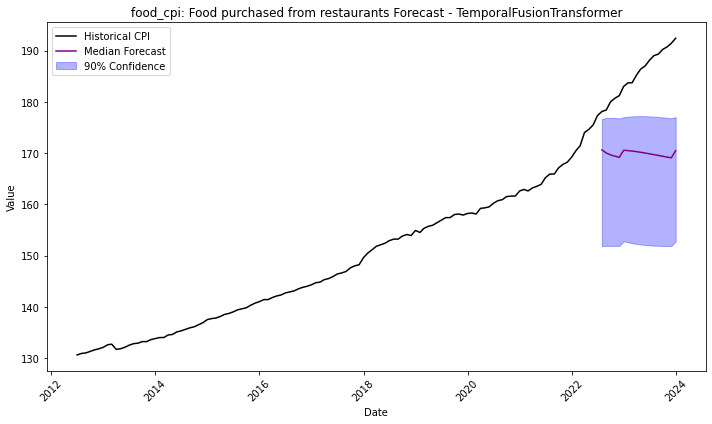

Beginning AutoGluon training... Time limit = 2s
AutoGluon will save models to './output/TEST/ag_global_all_TemporalFusionTransformerModel_exp2_GPT_P3_/random_seed_42/2022-07-01/model_files/'
=================== System Info ===================
AutoGluon Version:  1.1.1
Python Version:     3.8.20
Operating System:   Linux
Platform Machine:   x86_64
Platform Version:   #147~18.04.1-Ubuntu SMP Sat Oct 15 13:10:18 UTC 2022
CPU Count:          32
GPU Count:          1
Memory Avail:       166.78 GB / 188.57 GB (88.4%)
Disk Space Avail:   18211.33 GB / 249006.62 GB (7.3%)

Fitting with arguments:
{'enable_ensemble': True,
 'eval_metric': MAPE,
 'excluded_model_types': ['DirectTabular', 'RecursiveTabular'],
 'hyperparameters': {'TemporalFusionTransformerModel': {}},
 'known_covariates_names': [],
 'num_val_windows': 1,
 'prediction_length': 18,
 'quantile_levels': [0.01, 0.05, 0.1, 0.25, 0.75, 0.9, 0.95, 0.99],
 'random_seed': 42,
 'refit_every_n_windows': 1,
 'refit_full': False,
 'skip_model_

TemporalFusionTransformerModel


	-5.7474       = Validation score (-MAPE)
	2.12    s     = Training runtime
	0.04    s     = Validation (prediction) runtime
Not fitting ensemble due to lack of time remaining. Time left: -0.3 seconds
Training complete. Models trained: ['TemporalFusionTransformer']
Total runtime: 2.19 s
Best model: TemporalFusionTransformer
Best model score: -5.7474
Model not specified in predict, will default to the model with the best validation score: TemporalFusionTransformer
Model not specified in predict, will default to the model with the best validation score: TemporalFusionTransformer


****************** Summary of fit() ******************
Estimated performance of each model:
                       model  score_val  pred_time_val  fit_time_marginal  \
0  TemporalFusionTransformer  -5.747354        0.04385           2.117364   

   fit_order  
0          1  
Number of models trained: 1
Types of models trained:
{'MultiWindowBacktestingModel'}
****************** End of fit() summary ******************


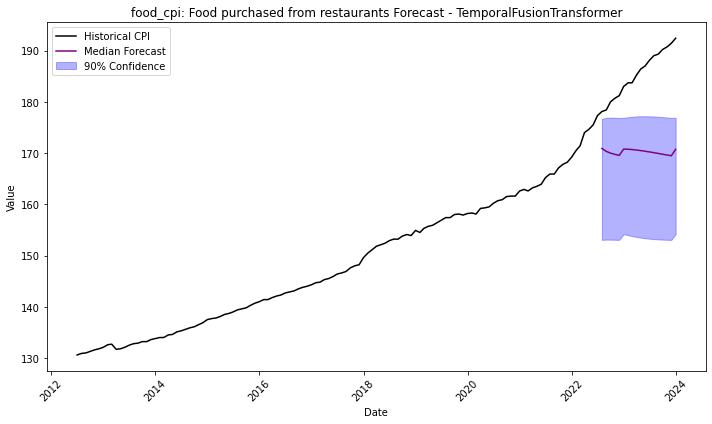

Beginning AutoGluon training... Time limit = 2s
AutoGluon will save models to './output/TEST/ag_global_all_TemporalFusionTransformerModel_exp2_R1_/random_seed_42/2023-07-01/model_files/'
=================== System Info ===================
AutoGluon Version:  1.1.1
Python Version:     3.8.20
Operating System:   Linux
Platform Machine:   x86_64
Platform Version:   #147~18.04.1-Ubuntu SMP Sat Oct 15 13:10:18 UTC 2022
CPU Count:          32
GPU Count:          1
Memory Avail:       166.88 GB / 188.57 GB (88.5%)
Disk Space Avail:   18211.37 GB / 249006.62 GB (7.3%)

Fitting with arguments:
{'enable_ensemble': True,
 'eval_metric': MAPE,
 'excluded_model_types': ['DirectTabular', 'RecursiveTabular'],
 'hyperparameters': {'TemporalFusionTransformerModel': {}},
 'known_covariates_names': [],
 'num_val_windows': 1,
 'prediction_length': 18,
 'quantile_levels': [0.01, 0.05, 0.1, 0.25, 0.75, 0.9, 0.95, 0.99],
 'random_seed': 42,
 'refit_every_n_windows': 1,
 'refit_full': False,
 'skip_model_sele

TemporalFusionTransformerModel


	-0.9833       = Validation score (-MAPE)
	2.15    s     = Training runtime
	0.05    s     = Validation (prediction) runtime
Not fitting ensemble due to lack of time remaining. Time left: -0.3 seconds
Training complete. Models trained: ['TemporalFusionTransformer']
Total runtime: 2.23 s
Best model: TemporalFusionTransformer
Best model score: -0.9833
Model not specified in predict, will default to the model with the best validation score: TemporalFusionTransformer
Model not specified in predict, will default to the model with the best validation score: TemporalFusionTransformer


****************** Summary of fit() ******************
Estimated performance of each model:
                       model  score_val  pred_time_val  fit_time_marginal  \
0  TemporalFusionTransformer  -0.983301         0.0455           2.147579   

   fit_order  
0          1  
Number of models trained: 1
Types of models trained:
{'MultiWindowBacktestingModel'}
****************** End of fit() summary ******************


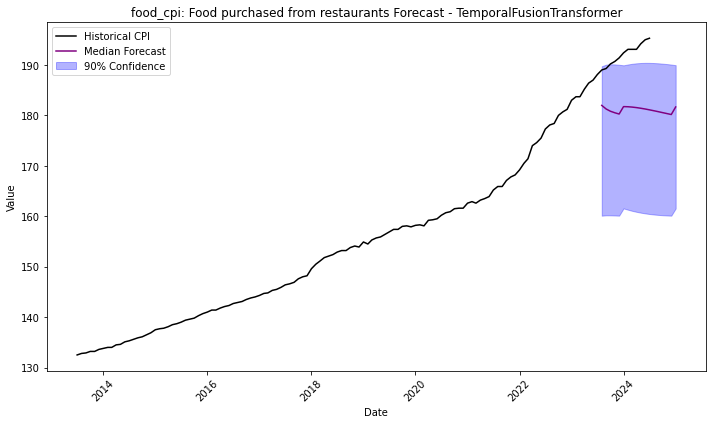

Beginning AutoGluon training... Time limit = 2s
AutoGluon will save models to './output/TEST/ag_global_all_TemporalFusionTransformerModel_exp2_GPT_P4_/random_seed_42/2023-07-01/model_files/'
=================== System Info ===================
AutoGluon Version:  1.1.1
Python Version:     3.8.20
Operating System:   Linux
Platform Machine:   x86_64
Platform Version:   #147~18.04.1-Ubuntu SMP Sat Oct 15 13:10:18 UTC 2022
CPU Count:          32
GPU Count:          1
Memory Avail:       166.78 GB / 188.57 GB (88.4%)
Disk Space Avail:   18211.36 GB / 249006.62 GB (7.3%)

Fitting with arguments:
{'enable_ensemble': True,
 'eval_metric': MAPE,
 'excluded_model_types': ['DirectTabular', 'RecursiveTabular'],
 'hyperparameters': {'TemporalFusionTransformerModel': {}},
 'known_covariates_names': [],
 'num_val_windows': 1,
 'prediction_length': 18,
 'quantile_levels': [0.01, 0.05, 0.1, 0.25, 0.75, 0.9, 0.95, 0.99],
 'random_seed': 42,
 'refit_every_n_windows': 1,
 'refit_full': False,
 'skip_model_

TemporalFusionTransformerModel


	-1.0320       = Validation score (-MAPE)
	2.14    s     = Training runtime
	0.04    s     = Validation (prediction) runtime
Not fitting ensemble due to lack of time remaining. Time left: -0.3 seconds
Training complete. Models trained: ['TemporalFusionTransformer']
Total runtime: 2.23 s
Best model: TemporalFusionTransformer
Best model score: -1.0320
Model not specified in predict, will default to the model with the best validation score: TemporalFusionTransformer
Model not specified in predict, will default to the model with the best validation score: TemporalFusionTransformer


****************** Summary of fit() ******************
Estimated performance of each model:
                       model  score_val  pred_time_val  fit_time_marginal  \
0  TemporalFusionTransformer  -1.031958        0.03901            2.14224   

   fit_order  
0          1  
Number of models trained: 1
Types of models trained:
{'MultiWindowBacktestingModel'}
****************** End of fit() summary ******************


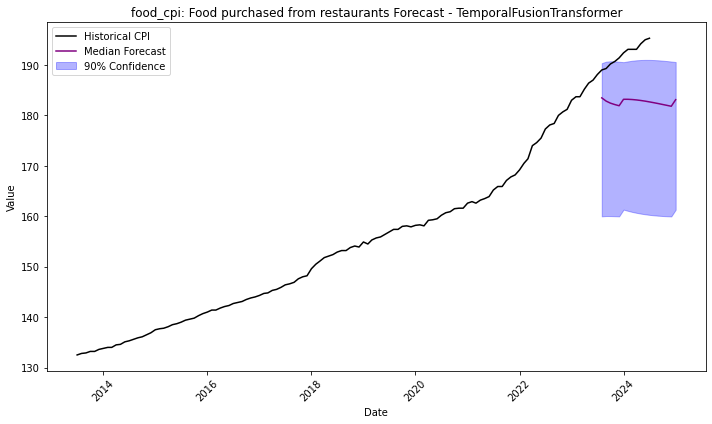

Beginning AutoGluon training... Time limit = 2s
AutoGluon will save models to './output/TEST/ag_global_all_TemporalFusionTransformerModel_exp2_R3_/random_seed_42/2023-07-01/model_files/'
=================== System Info ===================
AutoGluon Version:  1.1.1
Python Version:     3.8.20
Operating System:   Linux
Platform Machine:   x86_64
Platform Version:   #147~18.04.1-Ubuntu SMP Sat Oct 15 13:10:18 UTC 2022
CPU Count:          32
GPU Count:          1
Memory Avail:       166.86 GB / 188.57 GB (88.5%)
Disk Space Avail:   18211.36 GB / 249006.62 GB (7.3%)

Fitting with arguments:
{'enable_ensemble': True,
 'eval_metric': MAPE,
 'excluded_model_types': ['DirectTabular', 'RecursiveTabular'],
 'hyperparameters': {'TemporalFusionTransformerModel': {}},
 'known_covariates_names': [],
 'num_val_windows': 1,
 'prediction_length': 18,
 'quantile_levels': [0.01, 0.05, 0.1, 0.25, 0.75, 0.9, 0.95, 0.99],
 'random_seed': 42,
 'refit_every_n_windows': 1,
 'refit_full': False,
 'skip_model_sele

TemporalFusionTransformerModel


	-0.4646       = Validation score (-MAPE)
	2.12    s     = Training runtime
	0.04    s     = Validation (prediction) runtime
Not fitting ensemble due to lack of time remaining. Time left: -0.3 seconds
Training complete. Models trained: ['TemporalFusionTransformer']
Total runtime: 2.20 s
Best model: TemporalFusionTransformer
Best model score: -0.4646
Model not specified in predict, will default to the model with the best validation score: TemporalFusionTransformer
Model not specified in predict, will default to the model with the best validation score: TemporalFusionTransformer


****************** Summary of fit() ******************
Estimated performance of each model:
                       model  score_val  pred_time_val  fit_time_marginal  \
0  TemporalFusionTransformer  -0.464616       0.044544           2.116954   

   fit_order  
0          1  
Number of models trained: 1
Types of models trained:
{'MultiWindowBacktestingModel'}
****************** End of fit() summary ******************


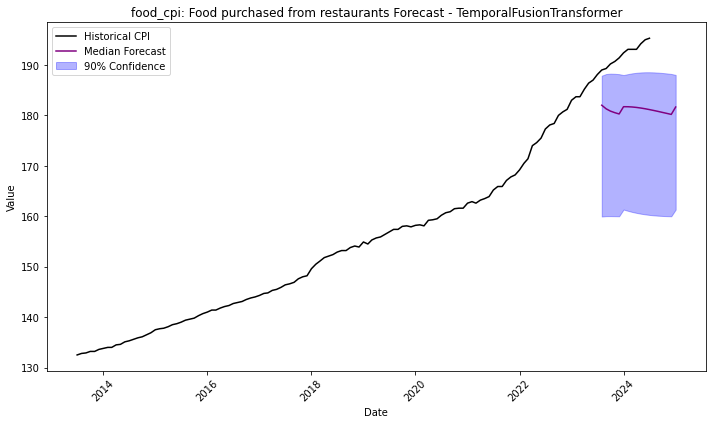

Beginning AutoGluon training... Time limit = 2s
AutoGluon will save models to './output/TEST/ag_global_all_TemporalFusionTransformerModel_exp2_GPT_P2_/random_seed_42/2023-07-01/model_files/'
=================== System Info ===================
AutoGluon Version:  1.1.1
Python Version:     3.8.20
Operating System:   Linux
Platform Machine:   x86_64
Platform Version:   #147~18.04.1-Ubuntu SMP Sat Oct 15 13:10:18 UTC 2022
CPU Count:          32
GPU Count:          1
Memory Avail:       166.78 GB / 188.57 GB (88.4%)
Disk Space Avail:   18211.35 GB / 249006.62 GB (7.3%)

Fitting with arguments:
{'enable_ensemble': True,
 'eval_metric': MAPE,
 'excluded_model_types': ['DirectTabular', 'RecursiveTabular'],
 'hyperparameters': {'TemporalFusionTransformerModel': {}},
 'known_covariates_names': [],
 'num_val_windows': 1,
 'prediction_length': 18,
 'quantile_levels': [0.01, 0.05, 0.1, 0.25, 0.75, 0.9, 0.95, 0.99],
 'random_seed': 42,
 'refit_every_n_windows': 1,
 'refit_full': False,
 'skip_model_

TemporalFusionTransformerModel


	-0.6453       = Validation score (-MAPE)
	2.17    s     = Training runtime
	0.04    s     = Validation (prediction) runtime
Not fitting ensemble due to lack of time remaining. Time left: -0.3 seconds
Training complete. Models trained: ['TemporalFusionTransformer']
Total runtime: 2.25 s
Best model: TemporalFusionTransformer
Best model score: -0.6453
Model not specified in predict, will default to the model with the best validation score: TemporalFusionTransformer
Model not specified in predict, will default to the model with the best validation score: TemporalFusionTransformer


****************** Summary of fit() ******************
Estimated performance of each model:
                       model  score_val  pred_time_val  fit_time_marginal  \
0  TemporalFusionTransformer  -0.645308       0.041489           2.167036   

   fit_order  
0          1  
Number of models trained: 1
Types of models trained:
{'MultiWindowBacktestingModel'}
****************** End of fit() summary ******************


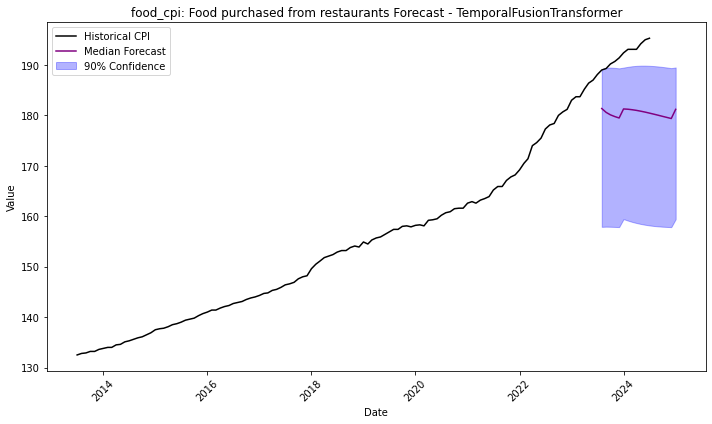

Beginning AutoGluon training... Time limit = 2s
AutoGluon will save models to './output/TEST/ag_global_all_TemporalFusionTransformerModel_exp2_GPT_P1_/random_seed_42/2023-07-01/model_files/'
=================== System Info ===================
AutoGluon Version:  1.1.1
Python Version:     3.8.20
Operating System:   Linux
Platform Machine:   x86_64
Platform Version:   #147~18.04.1-Ubuntu SMP Sat Oct 15 13:10:18 UTC 2022
CPU Count:          32
GPU Count:          1
Memory Avail:       166.78 GB / 188.57 GB (88.4%)
Disk Space Avail:   18211.34 GB / 249006.62 GB (7.3%)

Fitting with arguments:
{'enable_ensemble': True,
 'eval_metric': MAPE,
 'excluded_model_types': ['DirectTabular', 'RecursiveTabular'],
 'hyperparameters': {'TemporalFusionTransformerModel': {}},
 'known_covariates_names': [],
 'num_val_windows': 1,
 'prediction_length': 18,
 'quantile_levels': [0.01, 0.05, 0.1, 0.25, 0.75, 0.9, 0.95, 0.99],
 'random_seed': 42,
 'refit_every_n_windows': 1,
 'refit_full': False,
 'skip_model_

TemporalFusionTransformerModel


	-0.7118       = Validation score (-MAPE)
	2.14    s     = Training runtime
	0.04    s     = Validation (prediction) runtime
Not fitting ensemble due to lack of time remaining. Time left: -0.3 seconds
Training complete. Models trained: ['TemporalFusionTransformer']
Total runtime: 2.21 s
Best model: TemporalFusionTransformer
Best model score: -0.7118
Model not specified in predict, will default to the model with the best validation score: TemporalFusionTransformer
Model not specified in predict, will default to the model with the best validation score: TemporalFusionTransformer


****************** Summary of fit() ******************
Estimated performance of each model:
                       model  score_val  pred_time_val  fit_time_marginal  \
0  TemporalFusionTransformer  -0.711831       0.041339           2.135642   

   fit_order  
0          1  
Number of models trained: 1
Types of models trained:
{'MultiWindowBacktestingModel'}
****************** End of fit() summary ******************


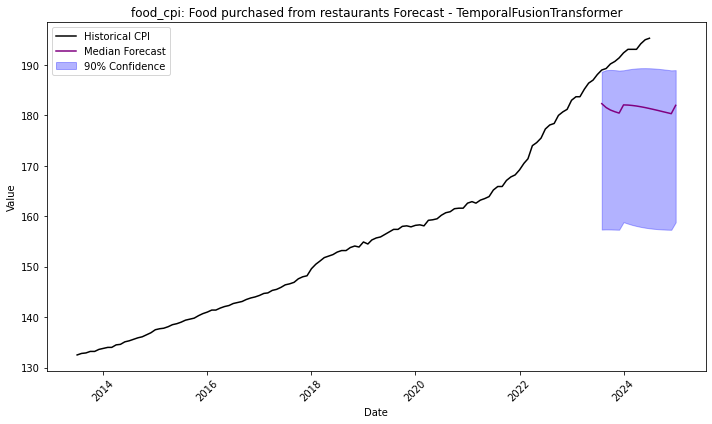

Beginning AutoGluon training... Time limit = 2s
AutoGluon will save models to './output/TEST/ag_global_all_TemporalFusionTransformerModel_exp2_R2_/random_seed_42/2023-07-01/model_files/'
=================== System Info ===================
AutoGluon Version:  1.1.1
Python Version:     3.8.20
Operating System:   Linux
Platform Machine:   x86_64
Platform Version:   #147~18.04.1-Ubuntu SMP Sat Oct 15 13:10:18 UTC 2022
CPU Count:          32
GPU Count:          1
Memory Avail:       166.78 GB / 188.57 GB (88.4%)
Disk Space Avail:   18211.33 GB / 249006.62 GB (7.3%)

Fitting with arguments:
{'enable_ensemble': True,
 'eval_metric': MAPE,
 'excluded_model_types': ['DirectTabular', 'RecursiveTabular'],
 'hyperparameters': {'TemporalFusionTransformerModel': {}},
 'known_covariates_names': [],
 'num_val_windows': 1,
 'prediction_length': 18,
 'quantile_levels': [0.01, 0.05, 0.1, 0.25, 0.75, 0.9, 0.95, 0.99],
 'random_seed': 42,
 'refit_every_n_windows': 1,
 'refit_full': False,
 'skip_model_sele

TemporalFusionTransformerModel


	-0.5325       = Validation score (-MAPE)
	2.11    s     = Training runtime
	0.04    s     = Validation (prediction) runtime
Not fitting ensemble due to lack of time remaining. Time left: -0.3 seconds
Training complete. Models trained: ['TemporalFusionTransformer']
Total runtime: 2.19 s
Best model: TemporalFusionTransformer
Best model score: -0.5325
Model not specified in predict, will default to the model with the best validation score: TemporalFusionTransformer
Model not specified in predict, will default to the model with the best validation score: TemporalFusionTransformer


****************** Summary of fit() ******************
Estimated performance of each model:
                       model  score_val  pred_time_val  fit_time_marginal  \
0  TemporalFusionTransformer  -0.532477       0.044203           2.105255   

   fit_order  
0          1  
Number of models trained: 1
Types of models trained:
{'MultiWindowBacktestingModel'}
****************** End of fit() summary ******************


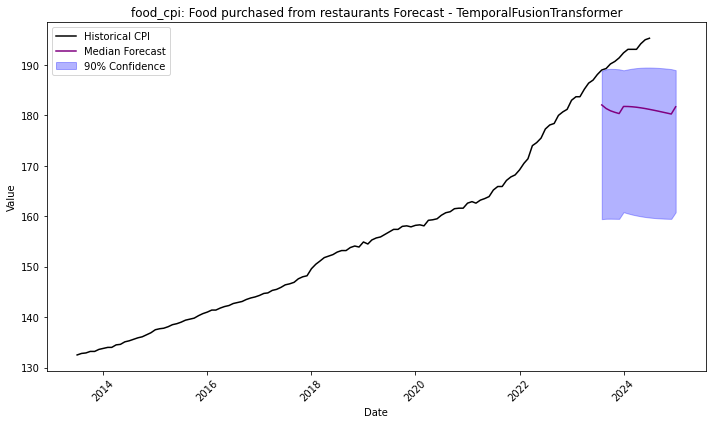

Beginning AutoGluon training... Time limit = 2s
AutoGluon will save models to './output/TEST/ag_global_all_TemporalFusionTransformerModel_exp2_R4_/random_seed_42/2023-07-01/model_files/'
=================== System Info ===================
AutoGluon Version:  1.1.1
Python Version:     3.8.20
Operating System:   Linux
Platform Machine:   x86_64
Platform Version:   #147~18.04.1-Ubuntu SMP Sat Oct 15 13:10:18 UTC 2022
CPU Count:          32
GPU Count:          1
Memory Avail:       166.78 GB / 188.57 GB (88.4%)
Disk Space Avail:   18211.38 GB / 249006.62 GB (7.3%)

Fitting with arguments:
{'enable_ensemble': True,
 'eval_metric': MAPE,
 'excluded_model_types': ['DirectTabular', 'RecursiveTabular'],
 'hyperparameters': {'TemporalFusionTransformerModel': {}},
 'known_covariates_names': [],
 'num_val_windows': 1,
 'prediction_length': 18,
 'quantile_levels': [0.01, 0.05, 0.1, 0.25, 0.75, 0.9, 0.95, 0.99],
 'random_seed': 42,
 'refit_every_n_windows': 1,
 'refit_full': False,
 'skip_model_sele

TemporalFusionTransformerModel


	-0.8142       = Validation score (-MAPE)
	2.14    s     = Training runtime
	0.05    s     = Validation (prediction) runtime
Not fitting ensemble due to lack of time remaining. Time left: -0.3 seconds
Training complete. Models trained: ['TemporalFusionTransformer']
Total runtime: 2.22 s
Best model: TemporalFusionTransformer
Best model score: -0.8142
Model not specified in predict, will default to the model with the best validation score: TemporalFusionTransformer
Model not specified in predict, will default to the model with the best validation score: TemporalFusionTransformer


****************** Summary of fit() ******************
Estimated performance of each model:
                       model  score_val  pred_time_val  fit_time_marginal  \
0  TemporalFusionTransformer  -0.814154       0.045434            2.13762   

   fit_order  
0          1  
Number of models trained: 1
Types of models trained:
{'MultiWindowBacktestingModel'}
****************** End of fit() summary ******************


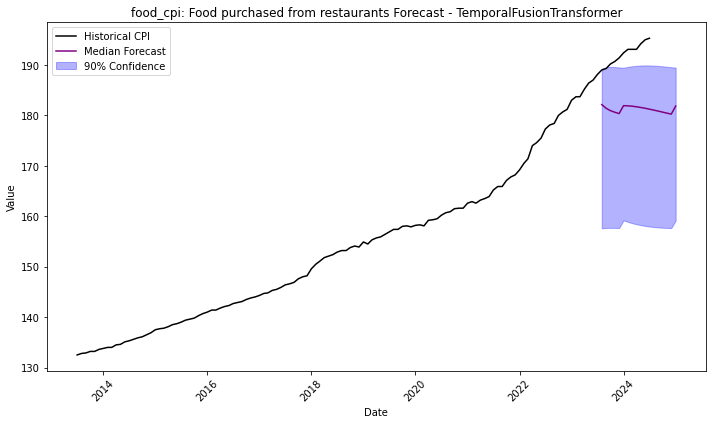

Beginning AutoGluon training... Time limit = 2s
AutoGluon will save models to './output/TEST/ag_global_all_TemporalFusionTransformerModel_exp2_GPT_P3_/random_seed_42/2023-07-01/model_files/'
=================== System Info ===================
AutoGluon Version:  1.1.1
Python Version:     3.8.20
Operating System:   Linux
Platform Machine:   x86_64
Platform Version:   #147~18.04.1-Ubuntu SMP Sat Oct 15 13:10:18 UTC 2022
CPU Count:          32
GPU Count:          1
Memory Avail:       166.80 GB / 188.57 GB (88.5%)
Disk Space Avail:   18211.37 GB / 249006.62 GB (7.3%)

Fitting with arguments:
{'enable_ensemble': True,
 'eval_metric': MAPE,
 'excluded_model_types': ['DirectTabular', 'RecursiveTabular'],
 'hyperparameters': {'TemporalFusionTransformerModel': {}},
 'known_covariates_names': [],
 'num_val_windows': 1,
 'prediction_length': 18,
 'quantile_levels': [0.01, 0.05, 0.1, 0.25, 0.75, 0.9, 0.95, 0.99],
 'random_seed': 42,
 'refit_every_n_windows': 1,
 'refit_full': False,
 'skip_model_

TemporalFusionTransformerModel


	-1.0682       = Validation score (-MAPE)
	2.12    s     = Training runtime
	0.04    s     = Validation (prediction) runtime
Not fitting ensemble due to lack of time remaining. Time left: -0.3 seconds
Training complete. Models trained: ['TemporalFusionTransformer']
Total runtime: 2.20 s
Best model: TemporalFusionTransformer
Best model score: -1.0682
Model not specified in predict, will default to the model with the best validation score: TemporalFusionTransformer
Model not specified in predict, will default to the model with the best validation score: TemporalFusionTransformer


****************** Summary of fit() ******************
Estimated performance of each model:
                       model  score_val  pred_time_val  fit_time_marginal  \
0  TemporalFusionTransformer  -1.068229       0.041918           2.121208   

   fit_order  
0          1  
Number of models trained: 1
Types of models trained:
{'MultiWindowBacktestingModel'}
****************** End of fit() summary ******************


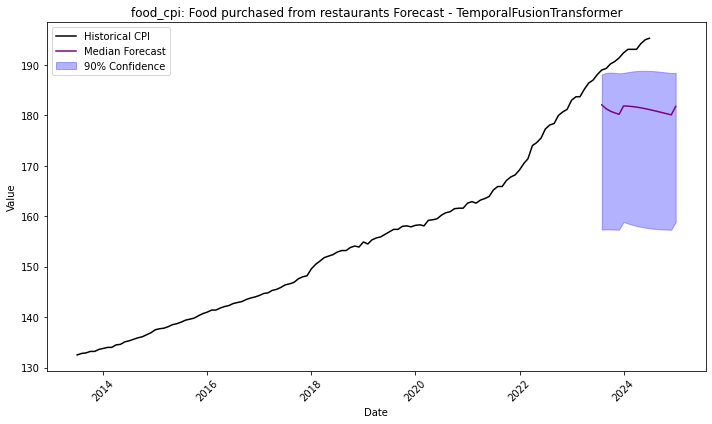

Beginning AutoGluon training... Time limit = 2s
AutoGluon will save models to './output/TEST/ag_global_all_TemporalFusionTransformerModel_exp2_GPT_P2_/random_seed_42/2018-07-01/model_files/'
=================== System Info ===================
AutoGluon Version:  1.1.1
Python Version:     3.8.20
Operating System:   Linux
Platform Machine:   x86_64
Platform Version:   #147~18.04.1-Ubuntu SMP Sat Oct 15 13:10:18 UTC 2022
CPU Count:          32
GPU Count:          1
Memory Avail:       166.78 GB / 188.57 GB (88.4%)
Disk Space Avail:   18211.36 GB / 249006.62 GB (7.3%)

Fitting with arguments:
{'enable_ensemble': True,
 'eval_metric': MAPE,
 'excluded_model_types': ['DirectTabular', 'RecursiveTabular'],
 'hyperparameters': {'TemporalFusionTransformerModel': {}},
 'known_covariates_names': [],
 'num_val_windows': 1,
 'prediction_length': 18,
 'quantile_levels': [0.01, 0.05, 0.1, 0.25, 0.75, 0.9, 0.95, 0.99],
 'random_seed': 42,
 'refit_every_n_windows': 1,
 'refit_full': False,
 'skip_model_

TemporalFusionTransformerModel


	-2.5742       = Validation score (-MAPE)
	2.13    s     = Training runtime
	0.04    s     = Validation (prediction) runtime
Not fitting ensemble due to lack of time remaining. Time left: -0.3 seconds
Training complete. Models trained: ['TemporalFusionTransformer']
Total runtime: 2.21 s
Best model: TemporalFusionTransformer
Best model score: -2.5742
Model not specified in predict, will default to the model with the best validation score: TemporalFusionTransformer
Model not specified in predict, will default to the model with the best validation score: TemporalFusionTransformer


****************** Summary of fit() ******************
Estimated performance of each model:
                       model  score_val  pred_time_val  fit_time_marginal  \
0  TemporalFusionTransformer  -2.574193       0.039323           2.126024   

   fit_order  
0          1  
Number of models trained: 1
Types of models trained:
{'MultiWindowBacktestingModel'}
****************** End of fit() summary ******************


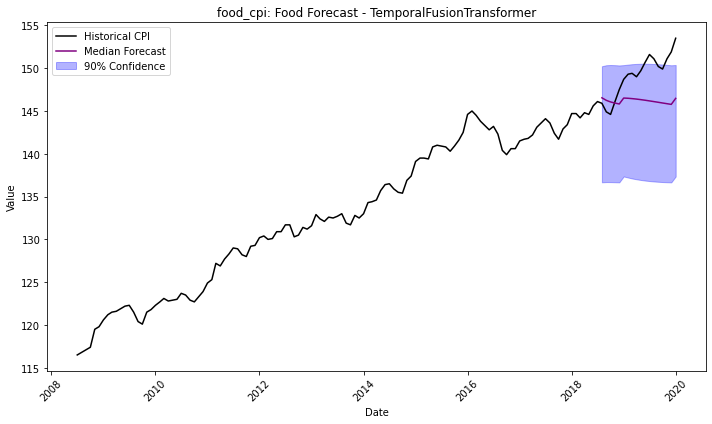

Beginning AutoGluon training... Time limit = 2s
AutoGluon will save models to './output/TEST/ag_global_all_TemporalFusionTransformerModel_exp2_R3_/random_seed_42/2018-07-01/model_files/'
=================== System Info ===================
AutoGluon Version:  1.1.1
Python Version:     3.8.20
Operating System:   Linux
Platform Machine:   x86_64
Platform Version:   #147~18.04.1-Ubuntu SMP Sat Oct 15 13:10:18 UTC 2022
CPU Count:          32
GPU Count:          1
Memory Avail:       166.85 GB / 188.57 GB (88.5%)
Disk Space Avail:   18211.35 GB / 249006.62 GB (7.3%)

Fitting with arguments:
{'enable_ensemble': True,
 'eval_metric': MAPE,
 'excluded_model_types': ['DirectTabular', 'RecursiveTabular'],
 'hyperparameters': {'TemporalFusionTransformerModel': {}},
 'known_covariates_names': [],
 'num_val_windows': 1,
 'prediction_length': 18,
 'quantile_levels': [0.01, 0.05, 0.1, 0.25, 0.75, 0.9, 0.95, 0.99],
 'random_seed': 42,
 'refit_every_n_windows': 1,
 'refit_full': False,
 'skip_model_sele

TemporalFusionTransformerModel


	-1.8067       = Validation score (-MAPE)
	2.46    s     = Training runtime
	0.04    s     = Validation (prediction) runtime
Not fitting ensemble due to lack of time remaining. Time left: -0.6 seconds
Training complete. Models trained: ['TemporalFusionTransformer']
Total runtime: 2.55 s
Best model: TemporalFusionTransformer
Best model score: -1.8067
Model not specified in predict, will default to the model with the best validation score: TemporalFusionTransformer
Model not specified in predict, will default to the model with the best validation score: TemporalFusionTransformer


****************** Summary of fit() ******************
Estimated performance of each model:
                       model  score_val  pred_time_val  fit_time_marginal  \
0  TemporalFusionTransformer  -1.806727       0.042708           2.456087   

   fit_order  
0          1  
Number of models trained: 1
Types of models trained:
{'MultiWindowBacktestingModel'}
****************** End of fit() summary ******************


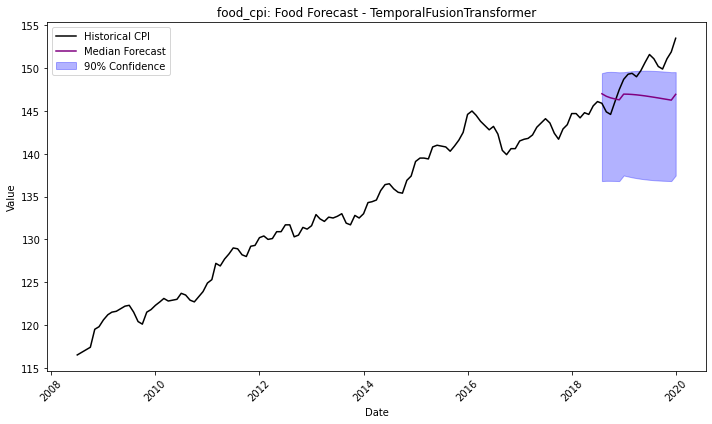

Beginning AutoGluon training... Time limit = 2s
AutoGluon will save models to './output/TEST/ag_global_all_TemporalFusionTransformerModel_exp2_GPT_P1_/random_seed_42/2018-07-01/model_files/'
=================== System Info ===================
AutoGluon Version:  1.1.1
Python Version:     3.8.20
Operating System:   Linux
Platform Machine:   x86_64
Platform Version:   #147~18.04.1-Ubuntu SMP Sat Oct 15 13:10:18 UTC 2022
CPU Count:          32
GPU Count:          1
Memory Avail:       166.78 GB / 188.57 GB (88.4%)
Disk Space Avail:   18211.34 GB / 249006.62 GB (7.3%)

Fitting with arguments:
{'enable_ensemble': True,
 'eval_metric': MAPE,
 'excluded_model_types': ['DirectTabular', 'RecursiveTabular'],
 'hyperparameters': {'TemporalFusionTransformerModel': {}},
 'known_covariates_names': [],
 'num_val_windows': 1,
 'prediction_length': 18,
 'quantile_levels': [0.01, 0.05, 0.1, 0.25, 0.75, 0.9, 0.95, 0.99],
 'random_seed': 42,
 'refit_every_n_windows': 1,
 'refit_full': False,
 'skip_model_

TemporalFusionTransformerModel


	-2.6688       = Validation score (-MAPE)
	2.18    s     = Training runtime
	0.04    s     = Validation (prediction) runtime
Not fitting ensemble due to lack of time remaining. Time left: -0.3 seconds
Training complete. Models trained: ['TemporalFusionTransformer']
Total runtime: 2.26 s
Best model: TemporalFusionTransformer
Best model score: -2.6688
Model not specified in predict, will default to the model with the best validation score: TemporalFusionTransformer
Model not specified in predict, will default to the model with the best validation score: TemporalFusionTransformer


****************** Summary of fit() ******************
Estimated performance of each model:
                       model  score_val  pred_time_val  fit_time_marginal  \
0  TemporalFusionTransformer  -2.668849       0.042194           2.177403   

   fit_order  
0          1  
Number of models trained: 1
Types of models trained:
{'MultiWindowBacktestingModel'}
****************** End of fit() summary ******************


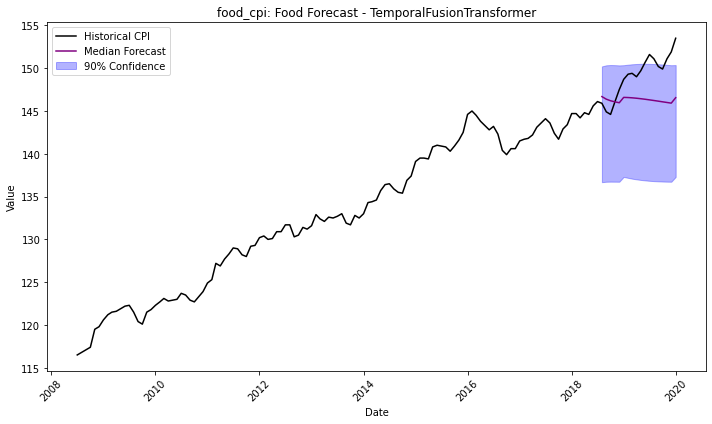

Beginning AutoGluon training... Time limit = 2s
AutoGluon will save models to './output/TEST/ag_global_all_TemporalFusionTransformerModel_exp2_R1_/random_seed_42/2018-07-01/model_files/'
=================== System Info ===================
AutoGluon Version:  1.1.1
Python Version:     3.8.20
Operating System:   Linux
Platform Machine:   x86_64
Platform Version:   #147~18.04.1-Ubuntu SMP Sat Oct 15 13:10:18 UTC 2022
CPU Count:          32
GPU Count:          1
Memory Avail:       166.78 GB / 188.57 GB (88.4%)
Disk Space Avail:   18211.33 GB / 249006.62 GB (7.3%)

Fitting with arguments:
{'enable_ensemble': True,
 'eval_metric': MAPE,
 'excluded_model_types': ['DirectTabular', 'RecursiveTabular'],
 'hyperparameters': {'TemporalFusionTransformerModel': {}},
 'known_covariates_names': [],
 'num_val_windows': 1,
 'prediction_length': 18,
 'quantile_levels': [0.01, 0.05, 0.1, 0.25, 0.75, 0.9, 0.95, 0.99],
 'random_seed': 42,
 'refit_every_n_windows': 1,
 'refit_full': False,
 'skip_model_sele

TemporalFusionTransformerModel


	-1.1524       = Validation score (-MAPE)
	2.07    s     = Training runtime
	0.04    s     = Validation (prediction) runtime
Not fitting ensemble due to lack of time remaining. Time left: -0.2 seconds
Training complete. Models trained: ['TemporalFusionTransformer']
Total runtime: 2.15 s
Best model: TemporalFusionTransformer
Best model score: -1.1524
Model not specified in predict, will default to the model with the best validation score: TemporalFusionTransformer
Model not specified in predict, will default to the model with the best validation score: TemporalFusionTransformer


****************** Summary of fit() ******************
Estimated performance of each model:
                       model  score_val  pred_time_val  fit_time_marginal  \
0  TemporalFusionTransformer  -1.152401       0.043465           2.072965   

   fit_order  
0          1  
Number of models trained: 1
Types of models trained:
{'MultiWindowBacktestingModel'}
****************** End of fit() summary ******************


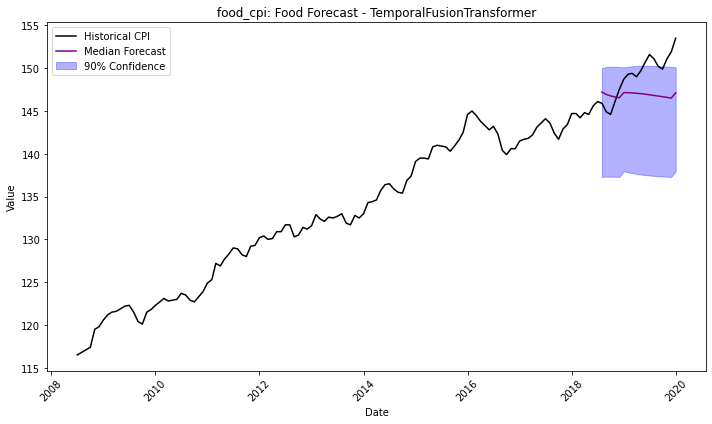

Beginning AutoGluon training... Time limit = 2s
AutoGluon will save models to './output/TEST/ag_global_all_TemporalFusionTransformerModel_exp2_GPT_P4_/random_seed_42/2018-07-01/model_files/'
=================== System Info ===================
AutoGluon Version:  1.1.1
Python Version:     3.8.20
Operating System:   Linux
Platform Machine:   x86_64
Platform Version:   #147~18.04.1-Ubuntu SMP Sat Oct 15 13:10:18 UTC 2022
CPU Count:          32
GPU Count:          1
Memory Avail:       166.78 GB / 188.57 GB (88.4%)
Disk Space Avail:   18211.38 GB / 249006.62 GB (7.3%)

Fitting with arguments:
{'enable_ensemble': True,
 'eval_metric': MAPE,
 'excluded_model_types': ['DirectTabular', 'RecursiveTabular'],
 'hyperparameters': {'TemporalFusionTransformerModel': {}},
 'known_covariates_names': [],
 'num_val_windows': 1,
 'prediction_length': 18,
 'quantile_levels': [0.01, 0.05, 0.1, 0.25, 0.75, 0.9, 0.95, 0.99],
 'random_seed': 42,
 'refit_every_n_windows': 1,
 'refit_full': False,
 'skip_model_

TemporalFusionTransformerModel


	-1.7063       = Validation score (-MAPE)
	2.16    s     = Training runtime
	0.04    s     = Validation (prediction) runtime
Not fitting ensemble due to lack of time remaining. Time left: -0.3 seconds
Training complete. Models trained: ['TemporalFusionTransformer']
Total runtime: 2.24 s
Best model: TemporalFusionTransformer
Best model score: -1.7063
Model not specified in predict, will default to the model with the best validation score: TemporalFusionTransformer
Model not specified in predict, will default to the model with the best validation score: TemporalFusionTransformer


****************** Summary of fit() ******************
Estimated performance of each model:
                       model  score_val  pred_time_val  fit_time_marginal  \
0  TemporalFusionTransformer  -1.706283       0.041947           2.160113   

   fit_order  
0          1  
Number of models trained: 1
Types of models trained:
{'MultiWindowBacktestingModel'}
****************** End of fit() summary ******************


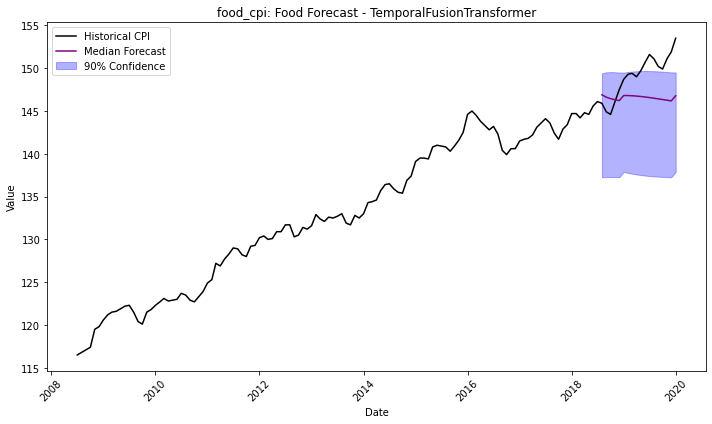

Beginning AutoGluon training... Time limit = 2s
AutoGluon will save models to './output/TEST/ag_global_all_TemporalFusionTransformerModel_exp2_R4_/random_seed_42/2018-07-01/model_files/'
=================== System Info ===================
AutoGluon Version:  1.1.1
Python Version:     3.8.20
Operating System:   Linux
Platform Machine:   x86_64
Platform Version:   #147~18.04.1-Ubuntu SMP Sat Oct 15 13:10:18 UTC 2022
CPU Count:          32
GPU Count:          1
Memory Avail:       166.78 GB / 188.57 GB (88.4%)
Disk Space Avail:   18211.37 GB / 249006.62 GB (7.3%)

Fitting with arguments:
{'enable_ensemble': True,
 'eval_metric': MAPE,
 'excluded_model_types': ['DirectTabular', 'RecursiveTabular'],
 'hyperparameters': {'TemporalFusionTransformerModel': {}},
 'known_covariates_names': [],
 'num_val_windows': 1,
 'prediction_length': 18,
 'quantile_levels': [0.01, 0.05, 0.1, 0.25, 0.75, 0.9, 0.95, 0.99],
 'random_seed': 42,
 'refit_every_n_windows': 1,
 'refit_full': False,
 'skip_model_sele

TemporalFusionTransformerModel


	-1.2677       = Validation score (-MAPE)
	2.16    s     = Training runtime
	0.04    s     = Validation (prediction) runtime
Not fitting ensemble due to lack of time remaining. Time left: -0.3 seconds
Training complete. Models trained: ['TemporalFusionTransformer']
Total runtime: 2.24 s
Best model: TemporalFusionTransformer
Best model score: -1.2677
Model not specified in predict, will default to the model with the best validation score: TemporalFusionTransformer
Model not specified in predict, will default to the model with the best validation score: TemporalFusionTransformer


****************** Summary of fit() ******************
Estimated performance of each model:
                       model  score_val  pred_time_val  fit_time_marginal  \
0  TemporalFusionTransformer  -1.267694       0.042828           2.159343   

   fit_order  
0          1  
Number of models trained: 1
Types of models trained:
{'MultiWindowBacktestingModel'}
****************** End of fit() summary ******************


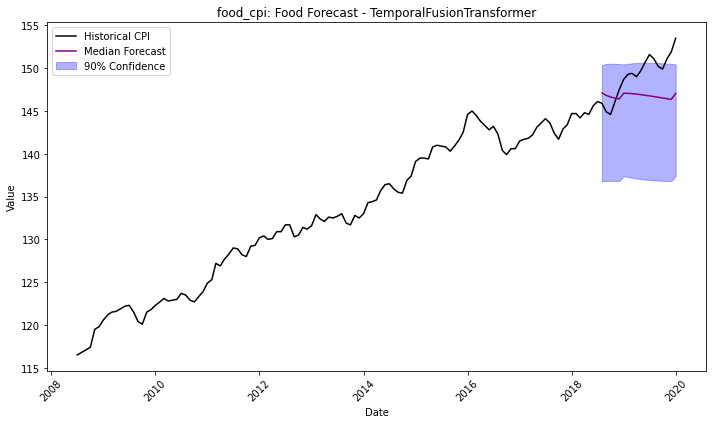

Beginning AutoGluon training... Time limit = 2s
AutoGluon will save models to './output/TEST/ag_global_all_TemporalFusionTransformerModel_exp2_GPT_P3_/random_seed_42/2018-07-01/model_files/'
=================== System Info ===================
AutoGluon Version:  1.1.1
Python Version:     3.8.20
Operating System:   Linux
Platform Machine:   x86_64
Platform Version:   #147~18.04.1-Ubuntu SMP Sat Oct 15 13:10:18 UTC 2022
CPU Count:          32
GPU Count:          1
Memory Avail:       166.78 GB / 188.57 GB (88.4%)
Disk Space Avail:   18211.36 GB / 249006.62 GB (7.3%)

Fitting with arguments:
{'enable_ensemble': True,
 'eval_metric': MAPE,
 'excluded_model_types': ['DirectTabular', 'RecursiveTabular'],
 'hyperparameters': {'TemporalFusionTransformerModel': {}},
 'known_covariates_names': [],
 'num_val_windows': 1,
 'prediction_length': 18,
 'quantile_levels': [0.01, 0.05, 0.1, 0.25, 0.75, 0.9, 0.95, 0.99],
 'random_seed': 42,
 'refit_every_n_windows': 1,
 'refit_full': False,
 'skip_model_

TemporalFusionTransformerModel


	-2.7230       = Validation score (-MAPE)
	2.15    s     = Training runtime
	0.04    s     = Validation (prediction) runtime
Not fitting ensemble due to lack of time remaining. Time left: -0.3 seconds
Training complete. Models trained: ['TemporalFusionTransformer']
Total runtime: 2.23 s
Best model: TemporalFusionTransformer
Best model score: -2.7230


****************** Summary of fit() ******************
Estimated performance of each model:
                       model  score_val  pred_time_val  fit_time_marginal  \
0  TemporalFusionTransformer  -2.723028       0.042701           2.151581   

   fit_order  
0          1  
Number of models trained: 1
Types of models trained:
{'MultiWindowBacktestingModel'}
****************** End of fit() summary ******************


Model not specified in predict, will default to the model with the best validation score: TemporalFusionTransformer
Model not specified in predict, will default to the model with the best validation score: TemporalFusionTransformer


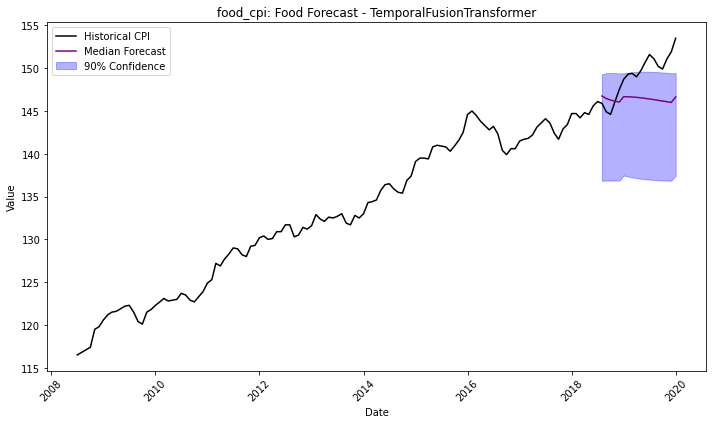

Beginning AutoGluon training... Time limit = 2s
AutoGluon will save models to './output/TEST/ag_global_all_TemporalFusionTransformerModel_exp2_R2_/random_seed_42/2018-07-01/model_files/'
=================== System Info ===================
AutoGluon Version:  1.1.1
Python Version:     3.8.20
Operating System:   Linux
Platform Machine:   x86_64
Platform Version:   #147~18.04.1-Ubuntu SMP Sat Oct 15 13:10:18 UTC 2022
CPU Count:          32
GPU Count:          1
Memory Avail:       166.78 GB / 188.57 GB (88.4%)
Disk Space Avail:   18211.35 GB / 249006.62 GB (7.3%)

Fitting with arguments:
{'enable_ensemble': True,
 'eval_metric': MAPE,
 'excluded_model_types': ['DirectTabular', 'RecursiveTabular'],
 'hyperparameters': {'TemporalFusionTransformerModel': {}},
 'known_covariates_names': [],
 'num_val_windows': 1,
 'prediction_length': 18,
 'quantile_levels': [0.01, 0.05, 0.1, 0.25, 0.75, 0.9, 0.95, 0.99],
 'random_seed': 42,
 'refit_every_n_windows': 1,
 'refit_full': False,
 'skip_model_sele

TemporalFusionTransformerModel


	-0.7285       = Validation score (-MAPE)
	2.13    s     = Training runtime
	0.04    s     = Validation (prediction) runtime
Not fitting ensemble due to lack of time remaining. Time left: -0.3 seconds
Training complete. Models trained: ['TemporalFusionTransformer']
Total runtime: 2.22 s
Best model: TemporalFusionTransformer
Best model score: -0.7285
Model not specified in predict, will default to the model with the best validation score: TemporalFusionTransformer
Model not specified in predict, will default to the model with the best validation score: TemporalFusionTransformer


****************** Summary of fit() ******************
Estimated performance of each model:
                       model  score_val  pred_time_val  fit_time_marginal  \
0  TemporalFusionTransformer  -0.728495       0.042935           2.131153   

   fit_order  
0          1  
Number of models trained: 1
Types of models trained:
{'MultiWindowBacktestingModel'}
****************** End of fit() summary ******************


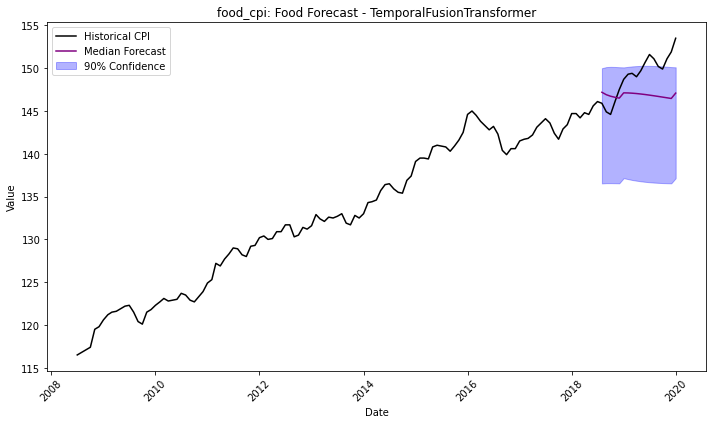

Beginning AutoGluon training... Time limit = 2s
AutoGluon will save models to './output/TEST/ag_global_all_TemporalFusionTransformerModel_exp2_GPT_P2_/random_seed_42/2019-07-01/model_files/'
=================== System Info ===================
AutoGluon Version:  1.1.1
Python Version:     3.8.20
Operating System:   Linux
Platform Machine:   x86_64
Platform Version:   #147~18.04.1-Ubuntu SMP Sat Oct 15 13:10:18 UTC 2022
CPU Count:          32
GPU Count:          1
Memory Avail:       166.78 GB / 188.57 GB (88.4%)
Disk Space Avail:   18211.34 GB / 249006.62 GB (7.3%)

Fitting with arguments:
{'enable_ensemble': True,
 'eval_metric': MAPE,
 'excluded_model_types': ['DirectTabular', 'RecursiveTabular'],
 'hyperparameters': {'TemporalFusionTransformerModel': {}},
 'known_covariates_names': [],
 'num_val_windows': 1,
 'prediction_length': 18,
 'quantile_levels': [0.01, 0.05, 0.1, 0.25, 0.75, 0.9, 0.95, 0.99],
 'random_seed': 42,
 'refit_every_n_windows': 1,
 'refit_full': False,
 'skip_model_

TemporalFusionTransformerModel


	-1.1102       = Validation score (-MAPE)
	2.12    s     = Training runtime
	0.04    s     = Validation (prediction) runtime
Not fitting ensemble due to lack of time remaining. Time left: -0.2 seconds
Training complete. Models trained: ['TemporalFusionTransformer']
Total runtime: 2.20 s
Best model: TemporalFusionTransformer
Best model score: -1.1102
Model not specified in predict, will default to the model with the best validation score: TemporalFusionTransformer
Model not specified in predict, will default to the model with the best validation score: TemporalFusionTransformer


****************** Summary of fit() ******************
Estimated performance of each model:
                       model  score_val  pred_time_val  fit_time_marginal  \
0  TemporalFusionTransformer  -1.110199       0.040041            2.11558   

   fit_order  
0          1  
Number of models trained: 1
Types of models trained:
{'MultiWindowBacktestingModel'}
****************** End of fit() summary ******************


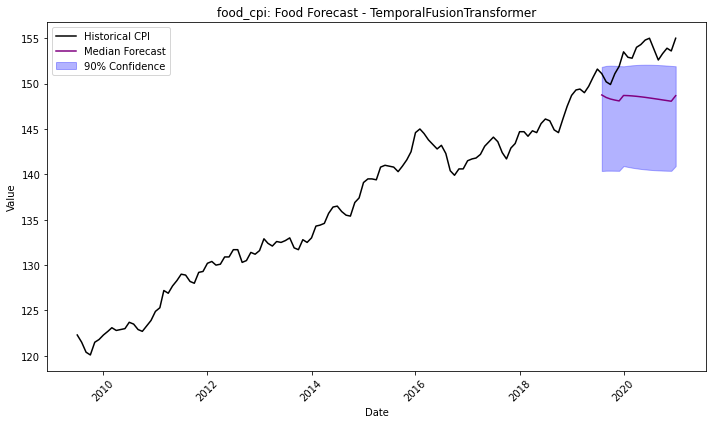

Beginning AutoGluon training... Time limit = 2s
AutoGluon will save models to './output/TEST/ag_global_all_TemporalFusionTransformerModel_exp2_R3_/random_seed_42/2019-07-01/model_files/'
=================== System Info ===================
AutoGluon Version:  1.1.1
Python Version:     3.8.20
Operating System:   Linux
Platform Machine:   x86_64
Platform Version:   #147~18.04.1-Ubuntu SMP Sat Oct 15 13:10:18 UTC 2022
CPU Count:          32
GPU Count:          1
Memory Avail:       166.78 GB / 188.57 GB (88.4%)
Disk Space Avail:   18211.33 GB / 249006.62 GB (7.3%)

Fitting with arguments:
{'enable_ensemble': True,
 'eval_metric': MAPE,
 'excluded_model_types': ['DirectTabular', 'RecursiveTabular'],
 'hyperparameters': {'TemporalFusionTransformerModel': {}},
 'known_covariates_names': [],
 'num_val_windows': 1,
 'prediction_length': 18,
 'quantile_levels': [0.01, 0.05, 0.1, 0.25, 0.75, 0.9, 0.95, 0.99],
 'random_seed': 42,
 'refit_every_n_windows': 1,
 'refit_full': False,
 'skip_model_sele

TemporalFusionTransformerModel


	-0.7260       = Validation score (-MAPE)
	2.14    s     = Training runtime
	0.04    s     = Validation (prediction) runtime
Not fitting ensemble due to lack of time remaining. Time left: -0.3 seconds
Training complete. Models trained: ['TemporalFusionTransformer']
Total runtime: 2.22 s
Best model: TemporalFusionTransformer
Best model score: -0.7260
Model not specified in predict, will default to the model with the best validation score: TemporalFusionTransformer
Model not specified in predict, will default to the model with the best validation score: TemporalFusionTransformer


****************** Summary of fit() ******************
Estimated performance of each model:
                       model  score_val  pred_time_val  fit_time_marginal  \
0  TemporalFusionTransformer   -0.72602       0.042657           2.135633   

   fit_order  
0          1  
Number of models trained: 1
Types of models trained:
{'MultiWindowBacktestingModel'}
****************** End of fit() summary ******************


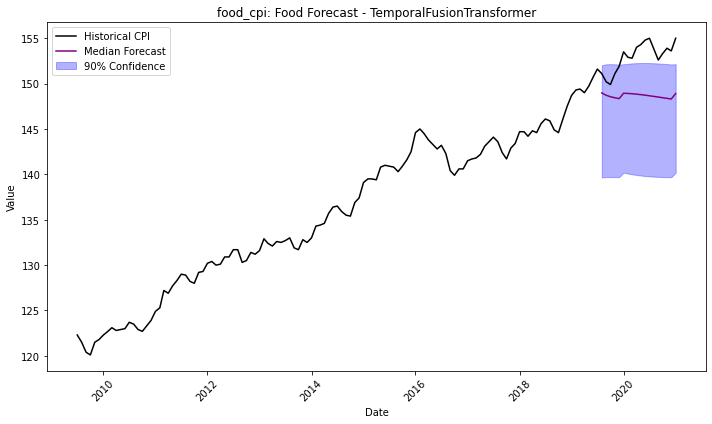

Beginning AutoGluon training... Time limit = 2s
AutoGluon will save models to './output/TEST/ag_global_all_TemporalFusionTransformerModel_exp2_GPT_P1_/random_seed_42/2019-07-01/model_files/'
=================== System Info ===================
AutoGluon Version:  1.1.1
Python Version:     3.8.20
Operating System:   Linux
Platform Machine:   x86_64
Platform Version:   #147~18.04.1-Ubuntu SMP Sat Oct 15 13:10:18 UTC 2022
CPU Count:          32
GPU Count:          1
Memory Avail:       166.89 GB / 188.57 GB (88.5%)
Disk Space Avail:   18211.36 GB / 249006.62 GB (7.3%)

Fitting with arguments:
{'enable_ensemble': True,
 'eval_metric': MAPE,
 'excluded_model_types': ['DirectTabular', 'RecursiveTabular'],
 'hyperparameters': {'TemporalFusionTransformerModel': {}},
 'known_covariates_names': [],
 'num_val_windows': 1,
 'prediction_length': 18,
 'quantile_levels': [0.01, 0.05, 0.1, 0.25, 0.75, 0.9, 0.95, 0.99],
 'random_seed': 42,
 'refit_every_n_windows': 1,
 'refit_full': False,
 'skip_model_

TemporalFusionTransformerModel


	-1.0808       = Validation score (-MAPE)
	2.15    s     = Training runtime
	0.04    s     = Validation (prediction) runtime
Not fitting ensemble due to lack of time remaining. Time left: -0.3 seconds
Training complete. Models trained: ['TemporalFusionTransformer']
Total runtime: 2.23 s
Best model: TemporalFusionTransformer
Best model score: -1.0808
Model not specified in predict, will default to the model with the best validation score: TemporalFusionTransformer
Model not specified in predict, will default to the model with the best validation score: TemporalFusionTransformer


****************** Summary of fit() ******************
Estimated performance of each model:
                       model  score_val  pred_time_val  fit_time_marginal  \
0  TemporalFusionTransformer  -1.080787        0.04328            2.14906   

   fit_order  
0          1  
Number of models trained: 1
Types of models trained:
{'MultiWindowBacktestingModel'}
****************** End of fit() summary ******************


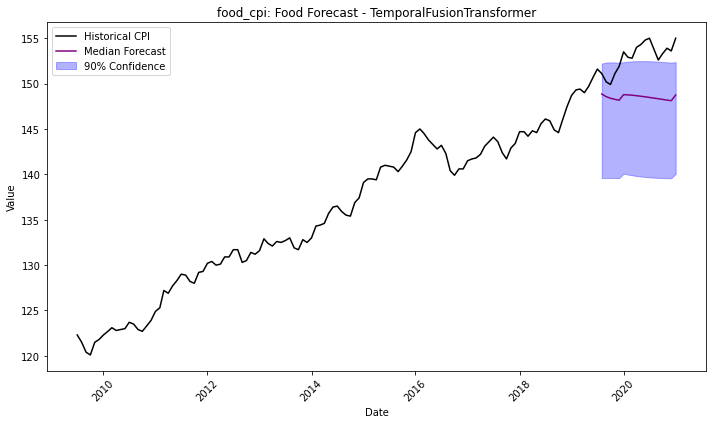

Beginning AutoGluon training... Time limit = 2s
AutoGluon will save models to './output/TEST/ag_global_all_TemporalFusionTransformerModel_exp2_R1_/random_seed_42/2019-07-01/model_files/'
=================== System Info ===================
AutoGluon Version:  1.1.1
Python Version:     3.8.20
Operating System:   Linux
Platform Machine:   x86_64
Platform Version:   #147~18.04.1-Ubuntu SMP Sat Oct 15 13:10:18 UTC 2022
CPU Count:          32
GPU Count:          1
Memory Avail:       166.77 GB / 188.57 GB (88.4%)
Disk Space Avail:   18211.34 GB / 249006.62 GB (7.3%)

Fitting with arguments:
{'enable_ensemble': True,
 'eval_metric': MAPE,
 'excluded_model_types': ['DirectTabular', 'RecursiveTabular'],
 'hyperparameters': {'TemporalFusionTransformerModel': {}},
 'known_covariates_names': [],
 'num_val_windows': 1,
 'prediction_length': 18,
 'quantile_levels': [0.01, 0.05, 0.1, 0.25, 0.75, 0.9, 0.95, 0.99],
 'random_seed': 42,
 'refit_every_n_windows': 1,
 'refit_full': False,
 'skip_model_sele

TemporalFusionTransformerModel


	-0.7714       = Validation score (-MAPE)
	2.13    s     = Training runtime
	0.04    s     = Validation (prediction) runtime
Not fitting ensemble due to lack of time remaining. Time left: -0.3 seconds
Training complete. Models trained: ['TemporalFusionTransformer']
Total runtime: 2.21 s
Best model: TemporalFusionTransformer
Best model score: -0.7714
Model not specified in predict, will default to the model with the best validation score: TemporalFusionTransformer


****************** Summary of fit() ******************
Estimated performance of each model:
                       model  score_val  pred_time_val  fit_time_marginal  \
0  TemporalFusionTransformer  -0.771447       0.043057           2.128501   

   fit_order  
0          1  
Number of models trained: 1
Types of models trained:
{'MultiWindowBacktestingModel'}
****************** End of fit() summary ******************


Model not specified in predict, will default to the model with the best validation score: TemporalFusionTransformer


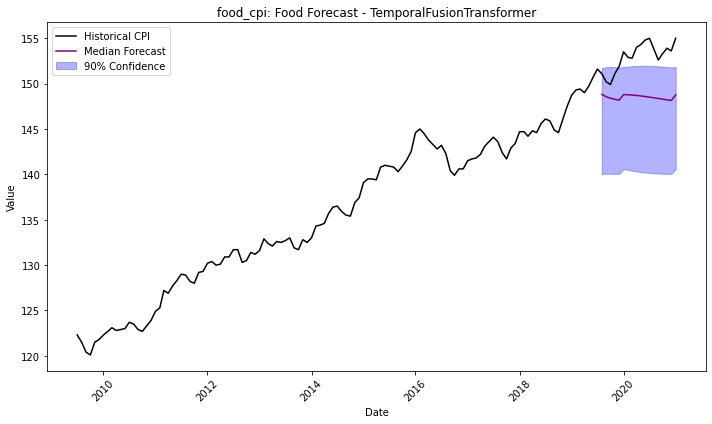

Beginning AutoGluon training... Time limit = 2s
AutoGluon will save models to './output/TEST/ag_global_all_TemporalFusionTransformerModel_exp2_GPT_P4_/random_seed_42/2019-07-01/model_files/'
=================== System Info ===================
AutoGluon Version:  1.1.1
Python Version:     3.8.20
Operating System:   Linux
Platform Machine:   x86_64
Platform Version:   #147~18.04.1-Ubuntu SMP Sat Oct 15 13:10:18 UTC 2022
CPU Count:          32
GPU Count:          1
Memory Avail:       166.77 GB / 188.57 GB (88.4%)
Disk Space Avail:   18211.34 GB / 249006.62 GB (7.3%)

Fitting with arguments:
{'enable_ensemble': True,
 'eval_metric': MAPE,
 'excluded_model_types': ['DirectTabular', 'RecursiveTabular'],
 'hyperparameters': {'TemporalFusionTransformerModel': {}},
 'known_covariates_names': [],
 'num_val_windows': 1,
 'prediction_length': 18,
 'quantile_levels': [0.01, 0.05, 0.1, 0.25, 0.75, 0.9, 0.95, 0.99],
 'random_seed': 42,
 'refit_every_n_windows': 1,
 'refit_full': False,
 'skip_model_

TemporalFusionTransformerModel


	-0.7107       = Validation score (-MAPE)
	2.12    s     = Training runtime
	0.05    s     = Validation (prediction) runtime
Not fitting ensemble due to lack of time remaining. Time left: -0.3 seconds
Training complete. Models trained: ['TemporalFusionTransformer']
Total runtime: 2.21 s
Best model: TemporalFusionTransformer
Best model score: -0.7107
Model not specified in predict, will default to the model with the best validation score: TemporalFusionTransformer
Model not specified in predict, will default to the model with the best validation score: TemporalFusionTransformer


****************** Summary of fit() ******************
Estimated performance of each model:
                       model  score_val  pred_time_val  fit_time_marginal  \
0  TemporalFusionTransformer  -0.710654       0.046377            2.12086   

   fit_order  
0          1  
Number of models trained: 1
Types of models trained:
{'MultiWindowBacktestingModel'}
****************** End of fit() summary ******************


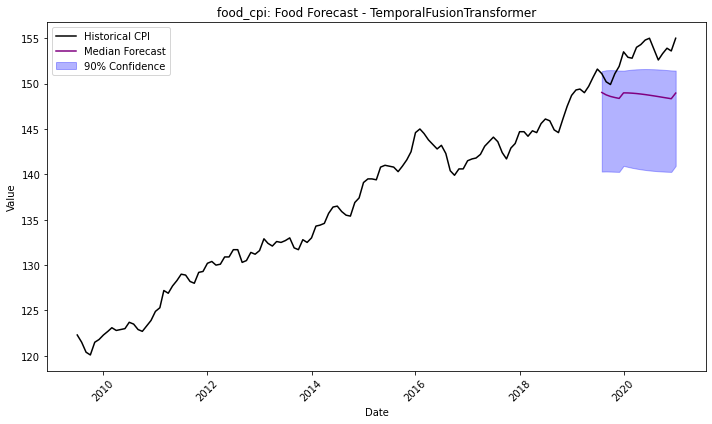

Beginning AutoGluon training... Time limit = 2s
AutoGluon will save models to './output/TEST/ag_global_all_TemporalFusionTransformerModel_exp2_R4_/random_seed_42/2019-07-01/model_files/'
=================== System Info ===================
AutoGluon Version:  1.1.1
Python Version:     3.8.20
Operating System:   Linux
Platform Machine:   x86_64
Platform Version:   #147~18.04.1-Ubuntu SMP Sat Oct 15 13:10:18 UTC 2022
CPU Count:          32
GPU Count:          1
Memory Avail:       166.84 GB / 188.57 GB (88.5%)
Disk Space Avail:   18210.82 GB / 249006.62 GB (7.3%)

Fitting with arguments:
{'enable_ensemble': True,
 'eval_metric': MAPE,
 'excluded_model_types': ['DirectTabular', 'RecursiveTabular'],
 'hyperparameters': {'TemporalFusionTransformerModel': {}},
 'known_covariates_names': [],
 'num_val_windows': 1,
 'prediction_length': 18,
 'quantile_levels': [0.01, 0.05, 0.1, 0.25, 0.75, 0.9, 0.95, 0.99],
 'random_seed': 42,
 'refit_every_n_windows': 1,
 'refit_full': False,
 'skip_model_sele

TemporalFusionTransformerModel


	-0.5594       = Validation score (-MAPE)
	2.12    s     = Training runtime
	0.04    s     = Validation (prediction) runtime
Not fitting ensemble due to lack of time remaining. Time left: -0.3 seconds
Training complete. Models trained: ['TemporalFusionTransformer']
Total runtime: 2.20 s
Best model: TemporalFusionTransformer
Best model score: -0.5594
Model not specified in predict, will default to the model with the best validation score: TemporalFusionTransformer
Model not specified in predict, will default to the model with the best validation score: TemporalFusionTransformer


****************** Summary of fit() ******************
Estimated performance of each model:
                       model  score_val  pred_time_val  fit_time_marginal  \
0  TemporalFusionTransformer   -0.55942        0.04385           2.122056   

   fit_order  
0          1  
Number of models trained: 1
Types of models trained:
{'MultiWindowBacktestingModel'}
****************** End of fit() summary ******************


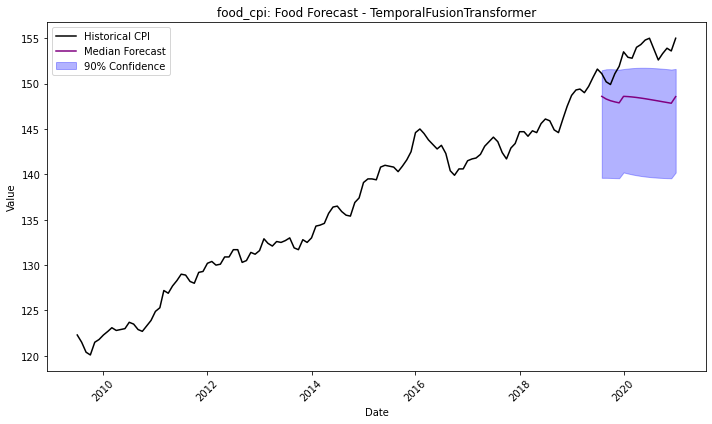

Beginning AutoGluon training... Time limit = 2s
AutoGluon will save models to './output/TEST/ag_global_all_TemporalFusionTransformerModel_exp2_GPT_P3_/random_seed_42/2019-07-01/model_files/'
=================== System Info ===================
AutoGluon Version:  1.1.1
Python Version:     3.8.20
Operating System:   Linux
Platform Machine:   x86_64
Platform Version:   #147~18.04.1-Ubuntu SMP Sat Oct 15 13:10:18 UTC 2022
CPU Count:          32
GPU Count:          1
Memory Avail:       166.77 GB / 188.57 GB (88.4%)
Disk Space Avail:   18210.82 GB / 249006.62 GB (7.3%)

Fitting with arguments:
{'enable_ensemble': True,
 'eval_metric': MAPE,
 'excluded_model_types': ['DirectTabular', 'RecursiveTabular'],
 'hyperparameters': {'TemporalFusionTransformerModel': {}},
 'known_covariates_names': [],
 'num_val_windows': 1,
 'prediction_length': 18,
 'quantile_levels': [0.01, 0.05, 0.1, 0.25, 0.75, 0.9, 0.95, 0.99],
 'random_seed': 42,
 'refit_every_n_windows': 1,
 'refit_full': False,
 'skip_model_

TemporalFusionTransformerModel


	-1.0679       = Validation score (-MAPE)
	2.12    s     = Training runtime
	0.04    s     = Validation (prediction) runtime
Not fitting ensemble due to lack of time remaining. Time left: -0.3 seconds
Training complete. Models trained: ['TemporalFusionTransformer']
Total runtime: 2.20 s
Best model: TemporalFusionTransformer
Best model score: -1.0679
Model not specified in predict, will default to the model with the best validation score: TemporalFusionTransformer
Model not specified in predict, will default to the model with the best validation score: TemporalFusionTransformer


****************** Summary of fit() ******************
Estimated performance of each model:
                       model  score_val  pred_time_val  fit_time_marginal  \
0  TemporalFusionTransformer  -1.067887       0.040782           2.123601   

   fit_order  
0          1  
Number of models trained: 1
Types of models trained:
{'MultiWindowBacktestingModel'}
****************** End of fit() summary ******************


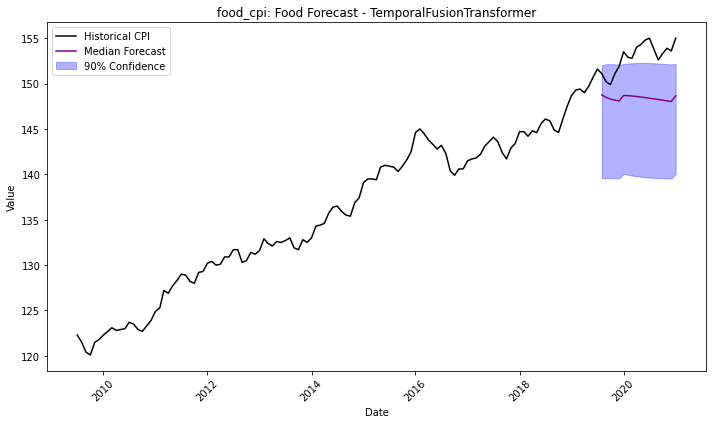

Beginning AutoGluon training... Time limit = 2s
AutoGluon will save models to './output/TEST/ag_global_all_TemporalFusionTransformerModel_exp2_R2_/random_seed_42/2019-07-01/model_files/'
=================== System Info ===================
AutoGluon Version:  1.1.1
Python Version:     3.8.20
Operating System:   Linux
Platform Machine:   x86_64
Platform Version:   #147~18.04.1-Ubuntu SMP Sat Oct 15 13:10:18 UTC 2022
CPU Count:          32
GPU Count:          1
Memory Avail:       166.77 GB / 188.57 GB (88.4%)
Disk Space Avail:   18210.81 GB / 249006.62 GB (7.3%)

Fitting with arguments:
{'enable_ensemble': True,
 'eval_metric': MAPE,
 'excluded_model_types': ['DirectTabular', 'RecursiveTabular'],
 'hyperparameters': {'TemporalFusionTransformerModel': {}},
 'known_covariates_names': [],
 'num_val_windows': 1,
 'prediction_length': 18,
 'quantile_levels': [0.01, 0.05, 0.1, 0.25, 0.75, 0.9, 0.95, 0.99],
 'random_seed': 42,
 'refit_every_n_windows': 1,
 'refit_full': False,
 'skip_model_sele

TemporalFusionTransformerModel


	-0.3816       = Validation score (-MAPE)
	2.11    s     = Training runtime
	0.04    s     = Validation (prediction) runtime
Not fitting ensemble due to lack of time remaining. Time left: -0.2 seconds
Training complete. Models trained: ['TemporalFusionTransformer']
Total runtime: 2.19 s
Best model: TemporalFusionTransformer
Best model score: -0.3816
Model not specified in predict, will default to the model with the best validation score: TemporalFusionTransformer
Model not specified in predict, will default to the model with the best validation score: TemporalFusionTransformer


****************** Summary of fit() ******************
Estimated performance of each model:
                       model  score_val  pred_time_val  fit_time_marginal  \
0  TemporalFusionTransformer  -0.381628       0.042406           2.105154   

   fit_order  
0          1  
Number of models trained: 1
Types of models trained:
{'MultiWindowBacktestingModel'}
****************** End of fit() summary ******************


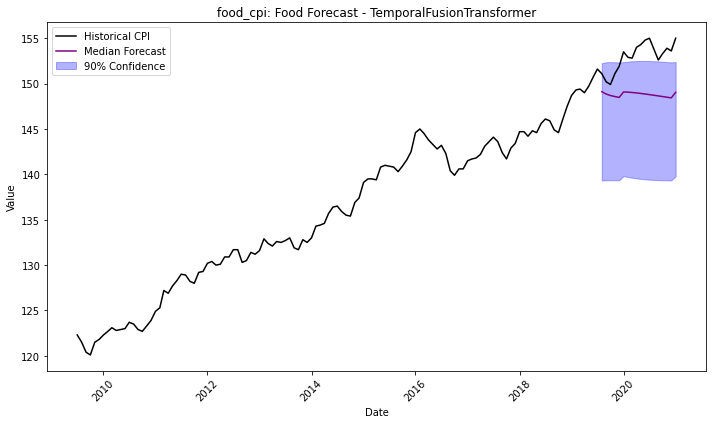

Beginning AutoGluon training... Time limit = 2s
AutoGluon will save models to './output/TEST/ag_global_all_TemporalFusionTransformerModel_exp2_GPT_P2_/random_seed_42/2020-07-01/model_files/'
=================== System Info ===================
AutoGluon Version:  1.1.1
Python Version:     3.8.20
Operating System:   Linux
Platform Machine:   x86_64
Platform Version:   #147~18.04.1-Ubuntu SMP Sat Oct 15 13:10:18 UTC 2022
CPU Count:          32
GPU Count:          1
Memory Avail:       166.77 GB / 188.57 GB (88.4%)
Disk Space Avail:   18210.80 GB / 249006.62 GB (7.3%)

Fitting with arguments:
{'enable_ensemble': True,
 'eval_metric': MAPE,
 'excluded_model_types': ['DirectTabular', 'RecursiveTabular'],
 'hyperparameters': {'TemporalFusionTransformerModel': {}},
 'known_covariates_names': [],
 'num_val_windows': 1,
 'prediction_length': 18,
 'quantile_levels': [0.01, 0.05, 0.1, 0.25, 0.75, 0.9, 0.95, 0.99],
 'random_seed': 42,
 'refit_every_n_windows': 1,
 'refit_full': False,
 'skip_model_

TemporalFusionTransformerModel


	-0.9737       = Validation score (-MAPE)
	2.13    s     = Training runtime
	0.04    s     = Validation (prediction) runtime
Not fitting ensemble due to lack of time remaining. Time left: -0.3 seconds
Training complete. Models trained: ['TemporalFusionTransformer']
Total runtime: 2.21 s
Best model: TemporalFusionTransformer
Best model score: -0.9737
Model not specified in predict, will default to the model with the best validation score: TemporalFusionTransformer
Model not specified in predict, will default to the model with the best validation score: TemporalFusionTransformer


****************** Summary of fit() ******************
Estimated performance of each model:
                       model  score_val  pred_time_val  fit_time_marginal  \
0  TemporalFusionTransformer  -0.973651       0.040843           2.130379   

   fit_order  
0          1  
Number of models trained: 1
Types of models trained:
{'MultiWindowBacktestingModel'}
****************** End of fit() summary ******************


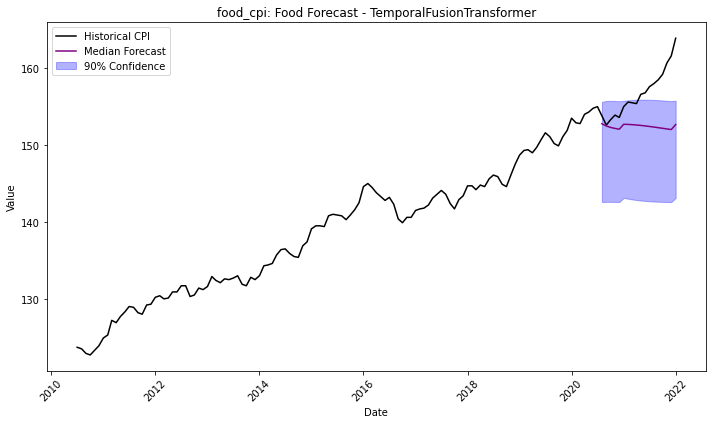

Beginning AutoGluon training... Time limit = 2s
AutoGluon will save models to './output/TEST/ag_global_all_TemporalFusionTransformerModel_exp2_R3_/random_seed_42/2020-07-01/model_files/'
=================== System Info ===================
AutoGluon Version:  1.1.1
Python Version:     3.8.20
Operating System:   Linux
Platform Machine:   x86_64
Platform Version:   #147~18.04.1-Ubuntu SMP Sat Oct 15 13:10:18 UTC 2022
CPU Count:          32
GPU Count:          1
Memory Avail:       166.77 GB / 188.57 GB (88.4%)
Disk Space Avail:   18210.79 GB / 249006.62 GB (7.3%)

Fitting with arguments:
{'enable_ensemble': True,
 'eval_metric': MAPE,
 'excluded_model_types': ['DirectTabular', 'RecursiveTabular'],
 'hyperparameters': {'TemporalFusionTransformerModel': {}},
 'known_covariates_names': [],
 'num_val_windows': 1,
 'prediction_length': 18,
 'quantile_levels': [0.01, 0.05, 0.1, 0.25, 0.75, 0.9, 0.95, 0.99],
 'random_seed': 42,
 'refit_every_n_windows': 1,
 'refit_full': False,
 'skip_model_sele

TemporalFusionTransformerModel


Inferred time series frequency: 'MS'
Provided train_data has 9130 rows (NaN fraction=0.1%), 22 time series. Median time series length is 415 (min=415, max=415). 

Provided data contains following columns:
	target: 'target'

AutoGluon will gauge predictive performance using evaluation metric: 'MAPE'
	This metric's sign has been flipped to adhere to being higher_is_better. The metric score can be multiplied by -1 to get the metric value.

Starting training. Start time is 2024-10-27 07:38:40
Excluded model types: ['DirectTabular', 'RecursiveTabular']
Models that will be trained: ['TemporalFusionTransformer']
Training timeseries model TemporalFusionTransformer. Training for up to 1.6s of the 1.6s of remaining time.
	-0.5784       = Validation score (-MAPE)
	1.90    s     = Training runtime
	0.04    s     = Validation (prediction) runtime
Not fitting ensemble due to lack of time remaining. Time left: -0.3 seconds
Training complete. Models trained: ['TemporalFusionTransformer']
Total runtime

****************** Summary of fit() ******************
Estimated performance of each model:
                       model  score_val  pred_time_val  fit_time_marginal  \
0  TemporalFusionTransformer  -0.578351       0.042596           1.895386   

   fit_order  
0          1  
Number of models trained: 1
Types of models trained:
{'MultiWindowBacktestingModel'}
****************** End of fit() summary ******************


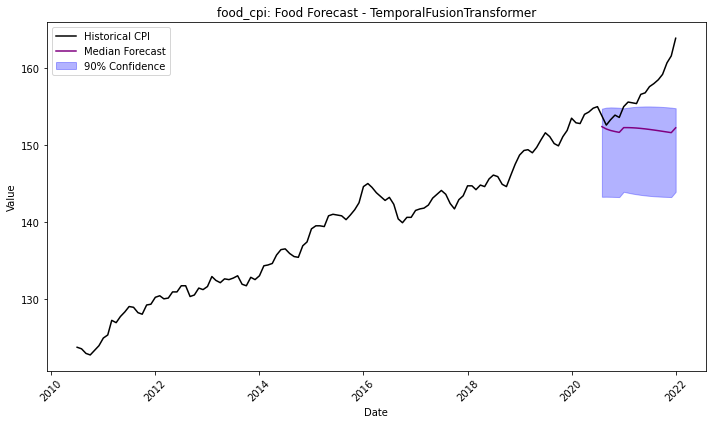

Beginning AutoGluon training... Time limit = 2s
AutoGluon will save models to './output/TEST/ag_global_all_TemporalFusionTransformerModel_exp2_GPT_P1_/random_seed_42/2020-07-01/model_files/'
=================== System Info ===================
AutoGluon Version:  1.1.1
Python Version:     3.8.20
Operating System:   Linux
Platform Machine:   x86_64
Platform Version:   #147~18.04.1-Ubuntu SMP Sat Oct 15 13:10:18 UTC 2022
CPU Count:          32
GPU Count:          1
Memory Avail:       166.77 GB / 188.57 GB (88.4%)
Disk Space Avail:   18210.78 GB / 249006.62 GB (7.3%)

Fitting with arguments:
{'enable_ensemble': True,
 'eval_metric': MAPE,
 'excluded_model_types': ['DirectTabular', 'RecursiveTabular'],
 'hyperparameters': {'TemporalFusionTransformerModel': {}},
 'known_covariates_names': [],
 'num_val_windows': 1,
 'prediction_length': 18,
 'quantile_levels': [0.01, 0.05, 0.1, 0.25, 0.75, 0.9, 0.95, 0.99],
 'random_seed': 42,
 'refit_every_n_windows': 1,
 'refit_full': False,
 'skip_model_

TemporalFusionTransformerModel


	-0.8372       = Validation score (-MAPE)
	2.14    s     = Training runtime
	0.04    s     = Validation (prediction) runtime
Not fitting ensemble due to lack of time remaining. Time left: -0.3 seconds
Training complete. Models trained: ['TemporalFusionTransformer']
Total runtime: 2.22 s
Best model: TemporalFusionTransformer
Best model score: -0.8372
Model not specified in predict, will default to the model with the best validation score: TemporalFusionTransformer
Model not specified in predict, will default to the model with the best validation score: TemporalFusionTransformer


****************** Summary of fit() ******************
Estimated performance of each model:
                       model  score_val  pred_time_val  fit_time_marginal  \
0  TemporalFusionTransformer  -0.837175       0.043231           2.141744   

   fit_order  
0          1  
Number of models trained: 1
Types of models trained:
{'MultiWindowBacktestingModel'}
****************** End of fit() summary ******************


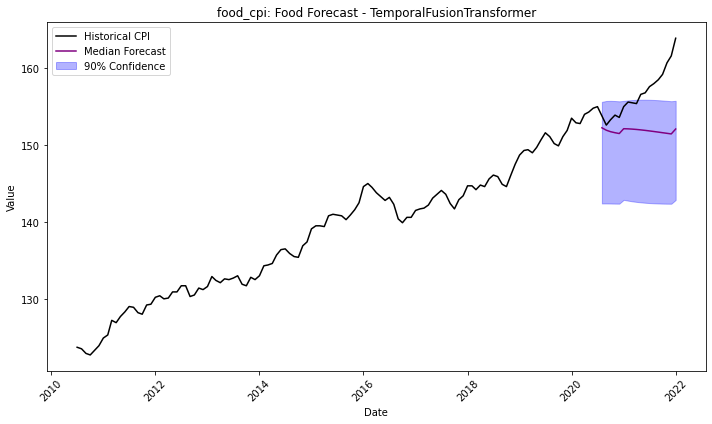

Beginning AutoGluon training... Time limit = 2s
AutoGluon will save models to './output/TEST/ag_global_all_TemporalFusionTransformerModel_exp2_R1_/random_seed_42/2020-07-01/model_files/'
=================== System Info ===================
AutoGluon Version:  1.1.1
Python Version:     3.8.20
Operating System:   Linux
Platform Machine:   x86_64
Platform Version:   #147~18.04.1-Ubuntu SMP Sat Oct 15 13:10:18 UTC 2022
CPU Count:          32
GPU Count:          1
Memory Avail:       166.77 GB / 188.57 GB (88.4%)
Disk Space Avail:   18210.82 GB / 249006.62 GB (7.3%)

Fitting with arguments:
{'enable_ensemble': True,
 'eval_metric': MAPE,
 'excluded_model_types': ['DirectTabular', 'RecursiveTabular'],
 'hyperparameters': {'TemporalFusionTransformerModel': {}},
 'known_covariates_names': [],
 'num_val_windows': 1,
 'prediction_length': 18,
 'quantile_levels': [0.01, 0.05, 0.1, 0.25, 0.75, 0.9, 0.95, 0.99],
 'random_seed': 42,
 'refit_every_n_windows': 1,
 'refit_full': False,
 'skip_model_sele

TemporalFusionTransformerModel


	-2.6318       = Validation score (-MAPE)
	2.14    s     = Training runtime
	0.04    s     = Validation (prediction) runtime
Not fitting ensemble due to lack of time remaining. Time left: -0.3 seconds
Training complete. Models trained: ['TemporalFusionTransformer']
Total runtime: 2.22 s
Best model: TemporalFusionTransformer
Best model score: -2.6318
Model not specified in predict, will default to the model with the best validation score: TemporalFusionTransformer
Model not specified in predict, will default to the model with the best validation score: TemporalFusionTransformer


****************** Summary of fit() ******************
Estimated performance of each model:
                       model  score_val  pred_time_val  fit_time_marginal  \
0  TemporalFusionTransformer  -2.631774       0.042839           2.142084   

   fit_order  
0          1  
Number of models trained: 1
Types of models trained:
{'MultiWindowBacktestingModel'}
****************** End of fit() summary ******************


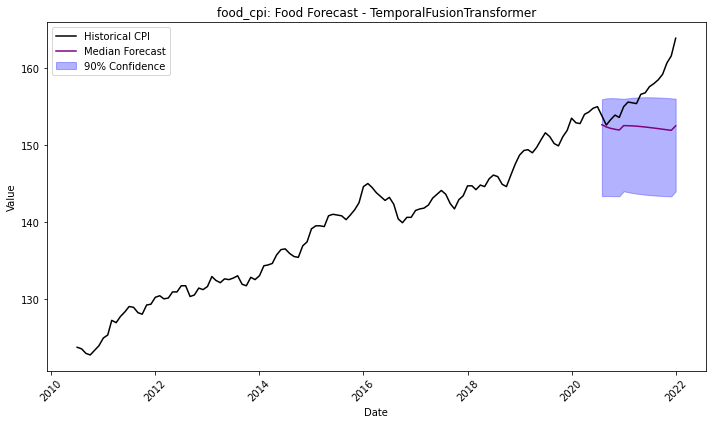

Beginning AutoGluon training... Time limit = 2s
AutoGluon will save models to './output/TEST/ag_global_all_TemporalFusionTransformerModel_exp2_GPT_P4_/random_seed_42/2020-07-01/model_files/'
=================== System Info ===================
AutoGluon Version:  1.1.1
Python Version:     3.8.20
Operating System:   Linux
Platform Machine:   x86_64
Platform Version:   #147~18.04.1-Ubuntu SMP Sat Oct 15 13:10:18 UTC 2022
CPU Count:          32
GPU Count:          1
Memory Avail:       166.77 GB / 188.57 GB (88.4%)
Disk Space Avail:   18210.81 GB / 249006.62 GB (7.3%)

Fitting with arguments:
{'enable_ensemble': True,
 'eval_metric': MAPE,
 'excluded_model_types': ['DirectTabular', 'RecursiveTabular'],
 'hyperparameters': {'TemporalFusionTransformerModel': {}},
 'known_covariates_names': [],
 'num_val_windows': 1,
 'prediction_length': 18,
 'quantile_levels': [0.01, 0.05, 0.1, 0.25, 0.75, 0.9, 0.95, 0.99],
 'random_seed': 42,
 'refit_every_n_windows': 1,
 'refit_full': False,
 'skip_model_

TemporalFusionTransformerModel


	-0.7090       = Validation score (-MAPE)
	2.16    s     = Training runtime
	0.04    s     = Validation (prediction) runtime
Not fitting ensemble due to lack of time remaining. Time left: -0.3 seconds
Training complete. Models trained: ['TemporalFusionTransformer']
Total runtime: 2.23 s
Best model: TemporalFusionTransformer
Best model score: -0.7090
Model not specified in predict, will default to the model with the best validation score: TemporalFusionTransformer
Model not specified in predict, will default to the model with the best validation score: TemporalFusionTransformer


****************** Summary of fit() ******************
Estimated performance of each model:
                       model  score_val  pred_time_val  fit_time_marginal  \
0  TemporalFusionTransformer  -0.709016       0.039016           2.155836   

   fit_order  
0          1  
Number of models trained: 1
Types of models trained:
{'MultiWindowBacktestingModel'}
****************** End of fit() summary ******************


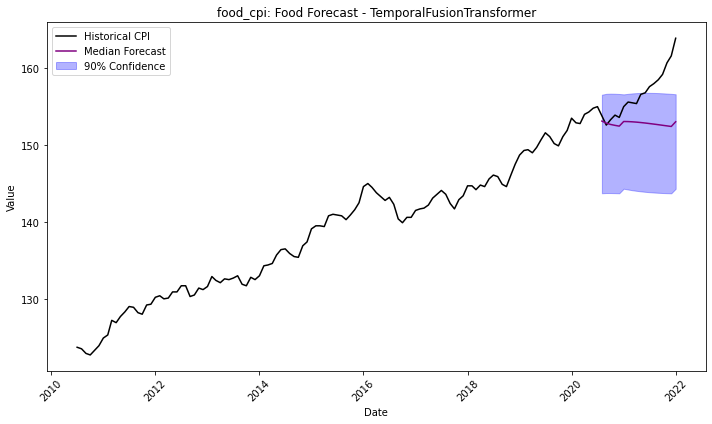

Beginning AutoGluon training... Time limit = 2s
AutoGluon will save models to './output/TEST/ag_global_all_TemporalFusionTransformerModel_exp2_R4_/random_seed_42/2020-07-01/model_files/'
=================== System Info ===================
AutoGluon Version:  1.1.1
Python Version:     3.8.20
Operating System:   Linux
Platform Machine:   x86_64
Platform Version:   #147~18.04.1-Ubuntu SMP Sat Oct 15 13:10:18 UTC 2022
CPU Count:          32
GPU Count:          1
Memory Avail:       166.77 GB / 188.57 GB (88.4%)
Disk Space Avail:   18210.80 GB / 249006.62 GB (7.3%)

Fitting with arguments:
{'enable_ensemble': True,
 'eval_metric': MAPE,
 'excluded_model_types': ['DirectTabular', 'RecursiveTabular'],
 'hyperparameters': {'TemporalFusionTransformerModel': {}},
 'known_covariates_names': [],
 'num_val_windows': 1,
 'prediction_length': 18,
 'quantile_levels': [0.01, 0.05, 0.1, 0.25, 0.75, 0.9, 0.95, 0.99],
 'random_seed': 42,
 'refit_every_n_windows': 1,
 'refit_full': False,
 'skip_model_sele

TemporalFusionTransformerModel


	-0.5348       = Validation score (-MAPE)
	2.14    s     = Training runtime
	0.04    s     = Validation (prediction) runtime
Not fitting ensemble due to lack of time remaining. Time left: -0.3 seconds
Training complete. Models trained: ['TemporalFusionTransformer']
Total runtime: 2.22 s
Best model: TemporalFusionTransformer
Best model score: -0.5348
Model not specified in predict, will default to the model with the best validation score: TemporalFusionTransformer
Model not specified in predict, will default to the model with the best validation score: TemporalFusionTransformer


****************** Summary of fit() ******************
Estimated performance of each model:
                       model  score_val  pred_time_val  fit_time_marginal  \
0  TemporalFusionTransformer  -0.534756       0.043252           2.142167   

   fit_order  
0          1  
Number of models trained: 1
Types of models trained:
{'MultiWindowBacktestingModel'}
****************** End of fit() summary ******************


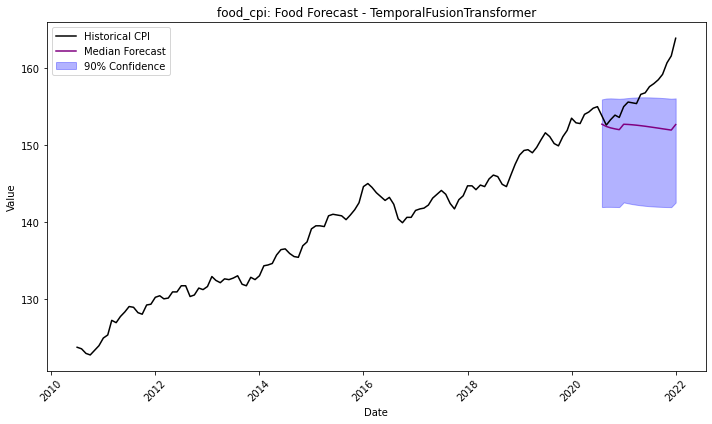

Beginning AutoGluon training... Time limit = 2s
AutoGluon will save models to './output/TEST/ag_global_all_TemporalFusionTransformerModel_exp2_GPT_P3_/random_seed_42/2020-07-01/model_files/'
=================== System Info ===================
AutoGluon Version:  1.1.1
Python Version:     3.8.20
Operating System:   Linux
Platform Machine:   x86_64
Platform Version:   #147~18.04.1-Ubuntu SMP Sat Oct 15 13:10:18 UTC 2022
CPU Count:          32
GPU Count:          1
Memory Avail:       166.76 GB / 188.57 GB (88.4%)
Disk Space Avail:   18210.79 GB / 249006.62 GB (7.3%)

Fitting with arguments:
{'enable_ensemble': True,
 'eval_metric': MAPE,
 'excluded_model_types': ['DirectTabular', 'RecursiveTabular'],
 'hyperparameters': {'TemporalFusionTransformerModel': {}},
 'known_covariates_names': [],
 'num_val_windows': 1,
 'prediction_length': 18,
 'quantile_levels': [0.01, 0.05, 0.1, 0.25, 0.75, 0.9, 0.95, 0.99],
 'random_seed': 42,
 'refit_every_n_windows': 1,
 'refit_full': False,
 'skip_model_

TemporalFusionTransformerModel


	-0.8464       = Validation score (-MAPE)
	2.12    s     = Training runtime
	0.05    s     = Validation (prediction) runtime
Not fitting ensemble due to lack of time remaining. Time left: -0.6 seconds
Training complete. Models trained: ['TemporalFusionTransformer']
Total runtime: 2.54 s
Best model: TemporalFusionTransformer
Best model score: -0.8464
Model not specified in predict, will default to the model with the best validation score: TemporalFusionTransformer
Model not specified in predict, will default to the model with the best validation score: TemporalFusionTransformer


****************** Summary of fit() ******************
Estimated performance of each model:
                       model  score_val  pred_time_val  fit_time_marginal  \
0  TemporalFusionTransformer  -0.846429       0.045769           2.121384   

   fit_order  
0          1  
Number of models trained: 1
Types of models trained:
{'MultiWindowBacktestingModel'}
****************** End of fit() summary ******************


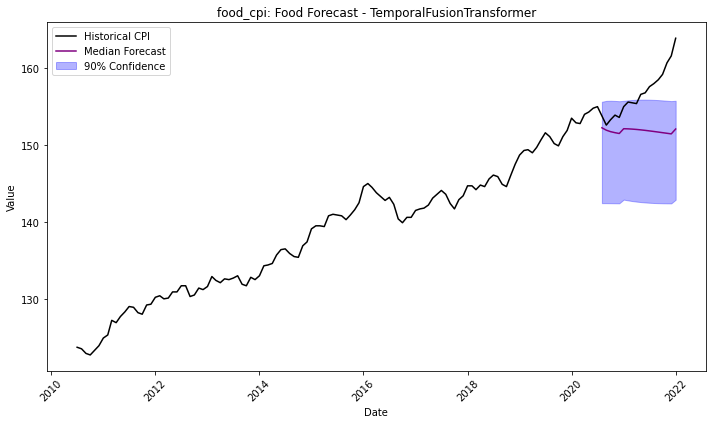

Beginning AutoGluon training... Time limit = 2s
AutoGluon will save models to './output/TEST/ag_global_all_TemporalFusionTransformerModel_exp2_R2_/random_seed_42/2020-07-01/model_files/'
=================== System Info ===================
AutoGluon Version:  1.1.1
Python Version:     3.8.20
Operating System:   Linux
Platform Machine:   x86_64
Platform Version:   #147~18.04.1-Ubuntu SMP Sat Oct 15 13:10:18 UTC 2022
CPU Count:          32
GPU Count:          1
Memory Avail:       166.77 GB / 188.57 GB (88.4%)
Disk Space Avail:   18210.78 GB / 249006.62 GB (7.3%)

Fitting with arguments:
{'enable_ensemble': True,
 'eval_metric': MAPE,
 'excluded_model_types': ['DirectTabular', 'RecursiveTabular'],
 'hyperparameters': {'TemporalFusionTransformerModel': {}},
 'known_covariates_names': [],
 'num_val_windows': 1,
 'prediction_length': 18,
 'quantile_levels': [0.01, 0.05, 0.1, 0.25, 0.75, 0.9, 0.95, 0.99],
 'random_seed': 42,
 'refit_every_n_windows': 1,
 'refit_full': False,
 'skip_model_sele

TemporalFusionTransformerModel


	-0.3764       = Validation score (-MAPE)
	2.13    s     = Training runtime
	0.04    s     = Validation (prediction) runtime
Not fitting ensemble due to lack of time remaining. Time left: -0.3 seconds
Training complete. Models trained: ['TemporalFusionTransformer']
Total runtime: 2.21 s
Best model: TemporalFusionTransformer
Best model score: -0.3764
Model not specified in predict, will default to the model with the best validation score: TemporalFusionTransformer
Model not specified in predict, will default to the model with the best validation score: TemporalFusionTransformer


****************** Summary of fit() ******************
Estimated performance of each model:
                       model  score_val  pred_time_val  fit_time_marginal  \
0  TemporalFusionTransformer   -0.37641       0.042233           2.131303   

   fit_order  
0          1  
Number of models trained: 1
Types of models trained:
{'MultiWindowBacktestingModel'}
****************** End of fit() summary ******************


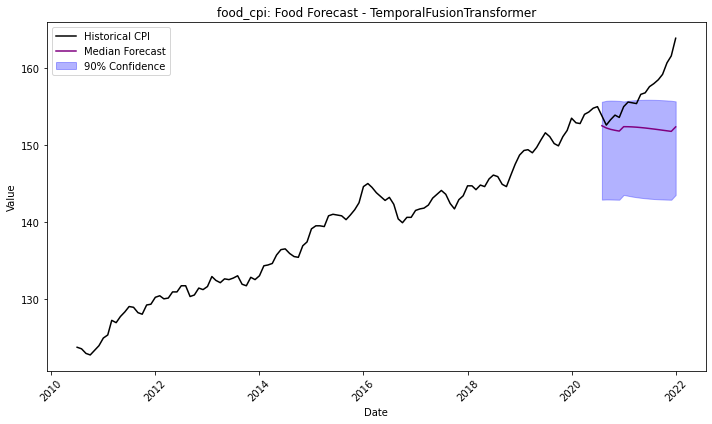

Beginning AutoGluon training... Time limit = 2s
AutoGluon will save models to './output/TEST/ag_global_all_TemporalFusionTransformerModel_exp2_GPT_P2_/random_seed_42/2021-07-01/model_files/'
=================== System Info ===================
AutoGluon Version:  1.1.1
Python Version:     3.8.20
Operating System:   Linux
Platform Machine:   x86_64
Platform Version:   #147~18.04.1-Ubuntu SMP Sat Oct 15 13:10:18 UTC 2022
CPU Count:          32
GPU Count:          1
Memory Avail:       166.79 GB / 188.57 GB (88.4%)
Disk Space Avail:   18210.77 GB / 249006.62 GB (7.3%)

Fitting with arguments:
{'enable_ensemble': True,
 'eval_metric': MAPE,
 'excluded_model_types': ['DirectTabular', 'RecursiveTabular'],
 'hyperparameters': {'TemporalFusionTransformerModel': {}},
 'known_covariates_names': [],
 'num_val_windows': 1,
 'prediction_length': 18,
 'quantile_levels': [0.01, 0.05, 0.1, 0.25, 0.75, 0.9, 0.95, 0.99],
 'random_seed': 42,
 'refit_every_n_windows': 1,
 'refit_full': False,
 'skip_model_

TemporalFusionTransformerModel


	-1.0950       = Validation score (-MAPE)
	2.14    s     = Training runtime
	0.04    s     = Validation (prediction) runtime
Not fitting ensemble due to lack of time remaining. Time left: -0.3 seconds
Training complete. Models trained: ['TemporalFusionTransformer']
Total runtime: 2.23 s
Best model: TemporalFusionTransformer
Best model score: -1.0950
Model not specified in predict, will default to the model with the best validation score: TemporalFusionTransformer
Model not specified in predict, will default to the model with the best validation score: TemporalFusionTransformer


****************** Summary of fit() ******************
Estimated performance of each model:
                       model  score_val  pred_time_val  fit_time_marginal  \
0  TemporalFusionTransformer  -1.095041       0.039179           2.141916   

   fit_order  
0          1  
Number of models trained: 1
Types of models trained:
{'MultiWindowBacktestingModel'}
****************** End of fit() summary ******************


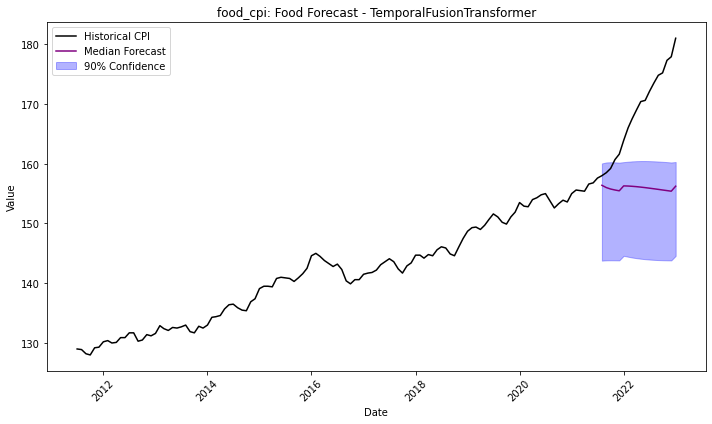

Beginning AutoGluon training... Time limit = 2s
AutoGluon will save models to './output/TEST/ag_global_all_TemporalFusionTransformerModel_exp2_R3_/random_seed_42/2021-07-01/model_files/'
=================== System Info ===================
AutoGluon Version:  1.1.1
Python Version:     3.8.20
Operating System:   Linux
Platform Machine:   x86_64
Platform Version:   #147~18.04.1-Ubuntu SMP Sat Oct 15 13:10:18 UTC 2022
CPU Count:          32
GPU Count:          1
Memory Avail:       166.77 GB / 188.57 GB (88.4%)
Disk Space Avail:   18210.82 GB / 249006.62 GB (7.3%)

Fitting with arguments:
{'enable_ensemble': True,
 'eval_metric': MAPE,
 'excluded_model_types': ['DirectTabular', 'RecursiveTabular'],
 'hyperparameters': {'TemporalFusionTransformerModel': {}},
 'known_covariates_names': [],
 'num_val_windows': 1,
 'prediction_length': 18,
 'quantile_levels': [0.01, 0.05, 0.1, 0.25, 0.75, 0.9, 0.95, 0.99],
 'random_seed': 42,
 'refit_every_n_windows': 1,
 'refit_full': False,
 'skip_model_sele

TemporalFusionTransformerModel


	-0.7135       = Validation score (-MAPE)
	2.13    s     = Training runtime
	0.05    s     = Validation (prediction) runtime
Not fitting ensemble due to lack of time remaining. Time left: -0.3 seconds
Training complete. Models trained: ['TemporalFusionTransformer']
Total runtime: 2.22 s
Best model: TemporalFusionTransformer
Best model score: -0.7135
Model not specified in predict, will default to the model with the best validation score: TemporalFusionTransformer
Model not specified in predict, will default to the model with the best validation score: TemporalFusionTransformer


****************** Summary of fit() ******************
Estimated performance of each model:
                       model  score_val  pred_time_val  fit_time_marginal  \
0  TemporalFusionTransformer   -0.71354       0.046839           2.134432   

   fit_order  
0          1  
Number of models trained: 1
Types of models trained:
{'MultiWindowBacktestingModel'}
****************** End of fit() summary ******************


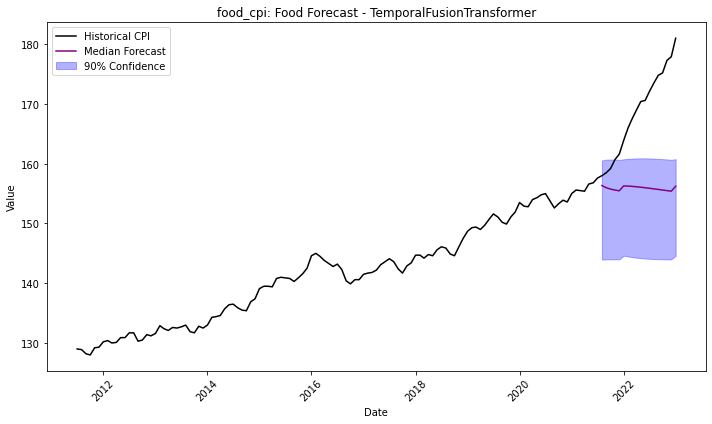

Beginning AutoGluon training... Time limit = 2s
AutoGluon will save models to './output/TEST/ag_global_all_TemporalFusionTransformerModel_exp2_GPT_P1_/random_seed_42/2021-07-01/model_files/'
=================== System Info ===================
AutoGluon Version:  1.1.1
Python Version:     3.8.20
Operating System:   Linux
Platform Machine:   x86_64
Platform Version:   #147~18.04.1-Ubuntu SMP Sat Oct 15 13:10:18 UTC 2022
CPU Count:          32
GPU Count:          1
Memory Avail:       166.77 GB / 188.57 GB (88.4%)
Disk Space Avail:   18210.82 GB / 249006.62 GB (7.3%)

Fitting with arguments:
{'enable_ensemble': True,
 'eval_metric': MAPE,
 'excluded_model_types': ['DirectTabular', 'RecursiveTabular'],
 'hyperparameters': {'TemporalFusionTransformerModel': {}},
 'known_covariates_names': [],
 'num_val_windows': 1,
 'prediction_length': 18,
 'quantile_levels': [0.01, 0.05, 0.1, 0.25, 0.75, 0.9, 0.95, 0.99],
 'random_seed': 42,
 'refit_every_n_windows': 1,
 'refit_full': False,
 'skip_model_

TemporalFusionTransformerModel


	-1.0981       = Validation score (-MAPE)
	2.12    s     = Training runtime
	0.04    s     = Validation (prediction) runtime
Not fitting ensemble due to lack of time remaining. Time left: -0.3 seconds
Training complete. Models trained: ['TemporalFusionTransformer']
Total runtime: 2.20 s
Best model: TemporalFusionTransformer
Best model score: -1.0981
Model not specified in predict, will default to the model with the best validation score: TemporalFusionTransformer
Model not specified in predict, will default to the model with the best validation score: TemporalFusionTransformer


****************** Summary of fit() ******************
Estimated performance of each model:
                       model  score_val  pred_time_val  fit_time_marginal  \
0  TemporalFusionTransformer  -1.098056       0.041996            2.12032   

   fit_order  
0          1  
Number of models trained: 1
Types of models trained:
{'MultiWindowBacktestingModel'}
****************** End of fit() summary ******************


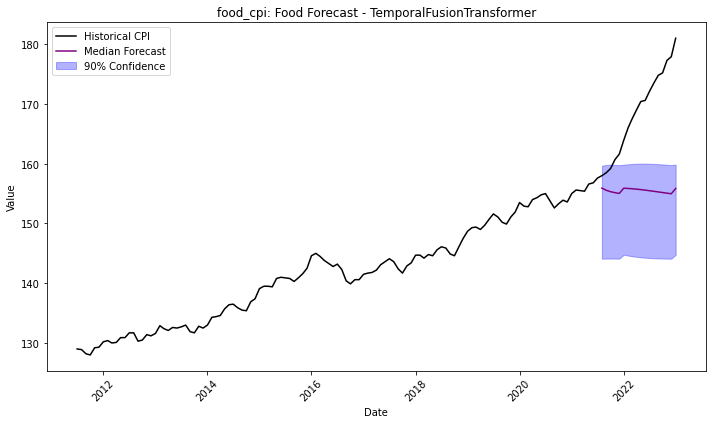

Beginning AutoGluon training... Time limit = 2s
AutoGluon will save models to './output/TEST/ag_global_all_TemporalFusionTransformerModel_exp2_R1_/random_seed_42/2021-07-01/model_files/'
=================== System Info ===================
AutoGluon Version:  1.1.1
Python Version:     3.8.20
Operating System:   Linux
Platform Machine:   x86_64
Platform Version:   #147~18.04.1-Ubuntu SMP Sat Oct 15 13:10:18 UTC 2022
CPU Count:          32
GPU Count:          1
Memory Avail:       166.88 GB / 188.57 GB (88.5%)
Disk Space Avail:   18210.81 GB / 249006.62 GB (7.3%)

Fitting with arguments:
{'enable_ensemble': True,
 'eval_metric': MAPE,
 'excluded_model_types': ['DirectTabular', 'RecursiveTabular'],
 'hyperparameters': {'TemporalFusionTransformerModel': {}},
 'known_covariates_names': [],
 'num_val_windows': 1,
 'prediction_length': 18,
 'quantile_levels': [0.01, 0.05, 0.1, 0.25, 0.75, 0.9, 0.95, 0.99],
 'random_seed': 42,
 'refit_every_n_windows': 1,
 'refit_full': False,
 'skip_model_sele

TemporalFusionTransformerModel


	-1.0616       = Validation score (-MAPE)
	2.13    s     = Training runtime
	0.04    s     = Validation (prediction) runtime
Not fitting ensemble due to lack of time remaining. Time left: -0.3 seconds
Training complete. Models trained: ['TemporalFusionTransformer']
Total runtime: 2.21 s
Best model: TemporalFusionTransformer
Best model score: -1.0616
Model not specified in predict, will default to the model with the best validation score: TemporalFusionTransformer
Model not specified in predict, will default to the model with the best validation score: TemporalFusionTransformer


****************** Summary of fit() ******************
Estimated performance of each model:
                       model  score_val  pred_time_val  fit_time_marginal  \
0  TemporalFusionTransformer  -1.061616       0.042681           2.125485   

   fit_order  
0          1  
Number of models trained: 1
Types of models trained:
{'MultiWindowBacktestingModel'}
****************** End of fit() summary ******************


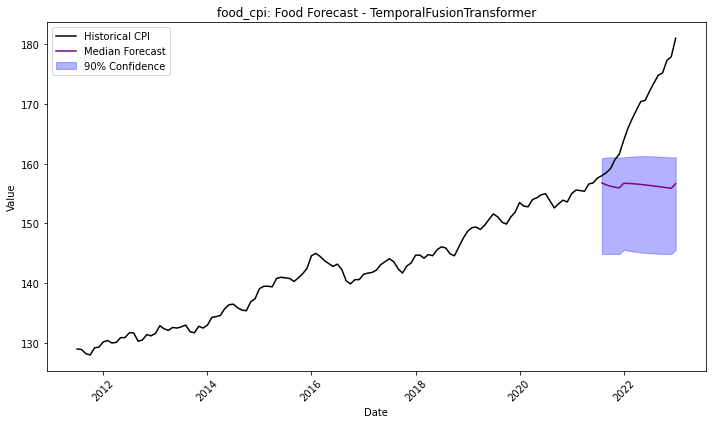

Beginning AutoGluon training... Time limit = 2s
AutoGluon will save models to './output/TEST/ag_global_all_TemporalFusionTransformerModel_exp2_GPT_P4_/random_seed_42/2021-07-01/model_files/'
=================== System Info ===================
AutoGluon Version:  1.1.1
Python Version:     3.8.20
Operating System:   Linux
Platform Machine:   x86_64
Platform Version:   #147~18.04.1-Ubuntu SMP Sat Oct 15 13:10:18 UTC 2022
CPU Count:          32
GPU Count:          1
Memory Avail:       166.94 GB / 188.57 GB (88.5%)
Disk Space Avail:   18210.80 GB / 249006.62 GB (7.3%)

Fitting with arguments:
{'enable_ensemble': True,
 'eval_metric': MAPE,
 'excluded_model_types': ['DirectTabular', 'RecursiveTabular'],
 'hyperparameters': {'TemporalFusionTransformerModel': {}},
 'known_covariates_names': [],
 'num_val_windows': 1,
 'prediction_length': 18,
 'quantile_levels': [0.01, 0.05, 0.1, 0.25, 0.75, 0.9, 0.95, 0.99],
 'random_seed': 42,
 'refit_every_n_windows': 1,
 'refit_full': False,
 'skip_model_

TemporalFusionTransformerModel


Inferred time series frequency: 'MS'
Provided train_data has 7686 rows, 18 time series. Median time series length is 427 (min=427, max=427). 

Provided data contains following columns:
	target: 'target'

AutoGluon will gauge predictive performance using evaluation metric: 'MAPE'
	This metric's sign has been flipped to adhere to being higher_is_better. The metric score can be multiplied by -1 to get the metric value.

Starting training. Start time is 2024-10-27 07:39:11
Excluded model types: ['DirectTabular', 'RecursiveTabular']
Models that will be trained: ['TemporalFusionTransformer']
Training timeseries model TemporalFusionTransformer. Training for up to 1.6s of the 1.6s of remaining time.
	-0.8675       = Validation score (-MAPE)
	1.83    s     = Training runtime
	0.04    s     = Validation (prediction) runtime
Not fitting ensemble due to lack of time remaining. Time left: -0.3 seconds
Training complete. Models trained: ['TemporalFusionTransformer']
Total runtime: 1.92 s
Best model:

****************** Summary of fit() ******************
Estimated performance of each model:
                       model  score_val  pred_time_val  fit_time_marginal  \
0  TemporalFusionTransformer  -0.867453        0.04018           1.834931   

   fit_order  
0          1  
Number of models trained: 1
Types of models trained:
{'MultiWindowBacktestingModel'}
****************** End of fit() summary ******************


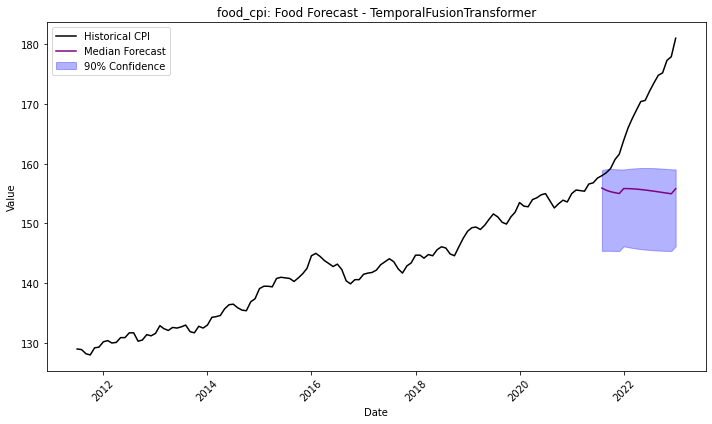

Beginning AutoGluon training... Time limit = 2s
AutoGluon will save models to './output/TEST/ag_global_all_TemporalFusionTransformerModel_exp2_R4_/random_seed_42/2021-07-01/model_files/'
=================== System Info ===================
AutoGluon Version:  1.1.1
Python Version:     3.8.20
Operating System:   Linux
Platform Machine:   x86_64
Platform Version:   #147~18.04.1-Ubuntu SMP Sat Oct 15 13:10:18 UTC 2022
CPU Count:          32
GPU Count:          1
Memory Avail:       166.77 GB / 188.57 GB (88.4%)
Disk Space Avail:   18210.79 GB / 249006.62 GB (7.3%)

Fitting with arguments:
{'enable_ensemble': True,
 'eval_metric': MAPE,
 'excluded_model_types': ['DirectTabular', 'RecursiveTabular'],
 'hyperparameters': {'TemporalFusionTransformerModel': {}},
 'known_covariates_names': [],
 'num_val_windows': 1,
 'prediction_length': 18,
 'quantile_levels': [0.01, 0.05, 0.1, 0.25, 0.75, 0.9, 0.95, 0.99],
 'random_seed': 42,
 'refit_every_n_windows': 1,
 'refit_full': False,
 'skip_model_sele

TemporalFusionTransformerModel


	-0.7138       = Validation score (-MAPE)
	2.10    s     = Training runtime
	0.04    s     = Validation (prediction) runtime
Not fitting ensemble due to lack of time remaining. Time left: -0.2 seconds
Training complete. Models trained: ['TemporalFusionTransformer']
Total runtime: 2.18 s
Best model: TemporalFusionTransformer
Best model score: -0.7138
Model not specified in predict, will default to the model with the best validation score: TemporalFusionTransformer
Model not specified in predict, will default to the model with the best validation score: TemporalFusionTransformer


****************** Summary of fit() ******************
Estimated performance of each model:
                       model  score_val  pred_time_val  fit_time_marginal  \
0  TemporalFusionTransformer  -0.713815       0.042708           2.104655   

   fit_order  
0          1  
Number of models trained: 1
Types of models trained:
{'MultiWindowBacktestingModel'}
****************** End of fit() summary ******************


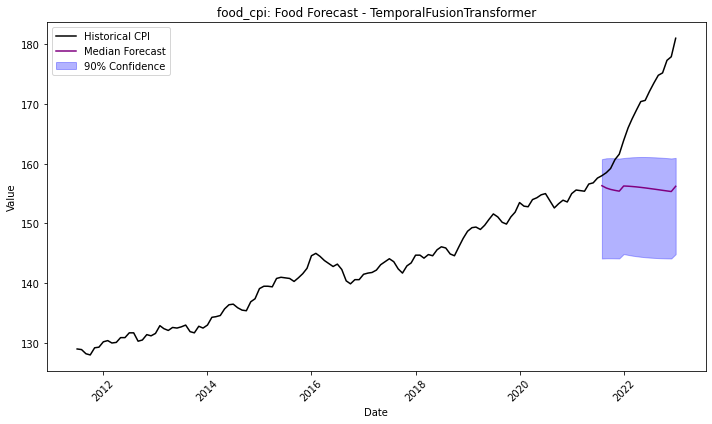

Beginning AutoGluon training... Time limit = 2s
AutoGluon will save models to './output/TEST/ag_global_all_TemporalFusionTransformerModel_exp2_GPT_P3_/random_seed_42/2021-07-01/model_files/'
=================== System Info ===================
AutoGluon Version:  1.1.1
Python Version:     3.8.20
Operating System:   Linux
Platform Machine:   x86_64
Platform Version:   #147~18.04.1-Ubuntu SMP Sat Oct 15 13:10:18 UTC 2022
CPU Count:          32
GPU Count:          1
Memory Avail:       166.77 GB / 188.57 GB (88.4%)
Disk Space Avail:   18210.83 GB / 249006.62 GB (7.3%)

Fitting with arguments:
{'enable_ensemble': True,
 'eval_metric': MAPE,
 'excluded_model_types': ['DirectTabular', 'RecursiveTabular'],
 'hyperparameters': {'TemporalFusionTransformerModel': {}},
 'known_covariates_names': [],
 'num_val_windows': 1,
 'prediction_length': 18,
 'quantile_levels': [0.01, 0.05, 0.1, 0.25, 0.75, 0.9, 0.95, 0.99],
 'random_seed': 42,
 'refit_every_n_windows': 1,
 'refit_full': False,
 'skip_model_

TemporalFusionTransformerModel


	-1.1414       = Validation score (-MAPE)
	2.12    s     = Training runtime
	0.04    s     = Validation (prediction) runtime
Not fitting ensemble due to lack of time remaining. Time left: -0.3 seconds
Training complete. Models trained: ['TemporalFusionTransformer']
Total runtime: 2.20 s
Best model: TemporalFusionTransformer
Best model score: -1.1414
Model not specified in predict, will default to the model with the best validation score: TemporalFusionTransformer
Model not specified in predict, will default to the model with the best validation score: TemporalFusionTransformer


****************** Summary of fit() ******************
Estimated performance of each model:
                       model  score_val  pred_time_val  fit_time_marginal  \
0  TemporalFusionTransformer  -1.141449       0.042712           2.120528   

   fit_order  
0          1  
Number of models trained: 1
Types of models trained:
{'MultiWindowBacktestingModel'}
****************** End of fit() summary ******************


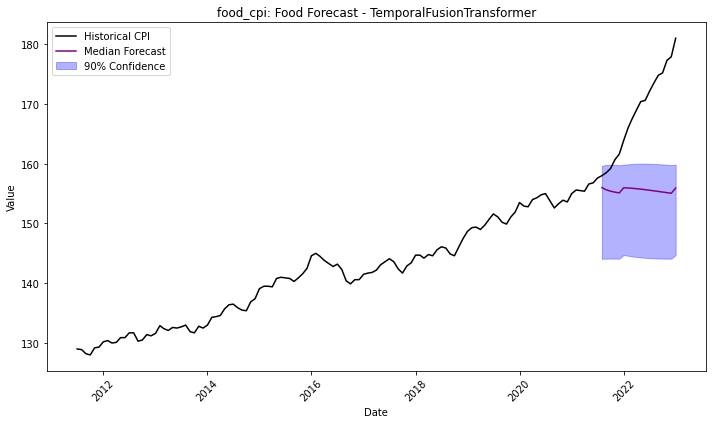

Beginning AutoGluon training... Time limit = 2s
AutoGluon will save models to './output/TEST/ag_global_all_TemporalFusionTransformerModel_exp2_R2_/random_seed_42/2021-07-01/model_files/'
=================== System Info ===================
AutoGluon Version:  1.1.1
Python Version:     3.8.20
Operating System:   Linux
Platform Machine:   x86_64
Platform Version:   #147~18.04.1-Ubuntu SMP Sat Oct 15 13:10:18 UTC 2022
CPU Count:          32
GPU Count:          1
Memory Avail:       166.77 GB / 188.57 GB (88.4%)
Disk Space Avail:   18210.82 GB / 249006.62 GB (7.3%)

Fitting with arguments:
{'enable_ensemble': True,
 'eval_metric': MAPE,
 'excluded_model_types': ['DirectTabular', 'RecursiveTabular'],
 'hyperparameters': {'TemporalFusionTransformerModel': {}},
 'known_covariates_names': [],
 'num_val_windows': 1,
 'prediction_length': 18,
 'quantile_levels': [0.01, 0.05, 0.1, 0.25, 0.75, 0.9, 0.95, 0.99],
 'random_seed': 42,
 'refit_every_n_windows': 1,
 'refit_full': False,
 'skip_model_sele

TemporalFusionTransformerModel


	-0.5347       = Validation score (-MAPE)
	2.14    s     = Training runtime
	0.04    s     = Validation (prediction) runtime
Not fitting ensemble due to lack of time remaining. Time left: -0.3 seconds
Training complete. Models trained: ['TemporalFusionTransformer']
Total runtime: 2.22 s
Best model: TemporalFusionTransformer
Best model score: -0.5347
Model not specified in predict, will default to the model with the best validation score: TemporalFusionTransformer
Model not specified in predict, will default to the model with the best validation score: TemporalFusionTransformer


****************** Summary of fit() ******************
Estimated performance of each model:
                       model  score_val  pred_time_val  fit_time_marginal  \
0  TemporalFusionTransformer   -0.53471       0.043821           2.143722   

   fit_order  
0          1  
Number of models trained: 1
Types of models trained:
{'MultiWindowBacktestingModel'}
****************** End of fit() summary ******************


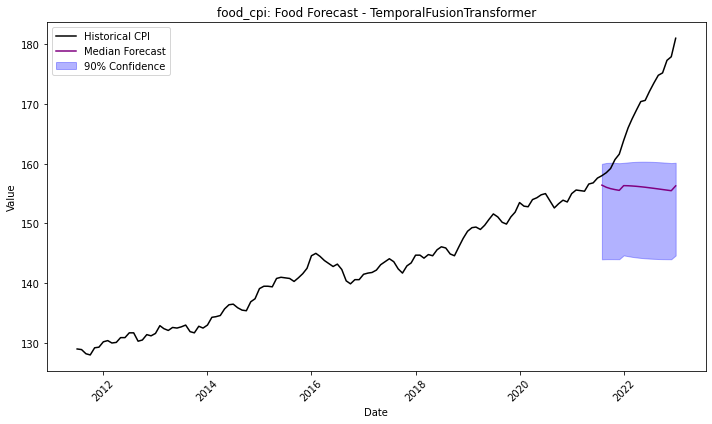

Beginning AutoGluon training... Time limit = 2s
AutoGluon will save models to './output/TEST/ag_global_all_TemporalFusionTransformerModel_exp2_GPT_P2_/random_seed_42/2022-07-01/model_files/'
=================== System Info ===================
AutoGluon Version:  1.1.1
Python Version:     3.8.20
Operating System:   Linux
Platform Machine:   x86_64
Platform Version:   #147~18.04.1-Ubuntu SMP Sat Oct 15 13:10:18 UTC 2022
CPU Count:          32
GPU Count:          1
Memory Avail:       166.82 GB / 188.57 GB (88.5%)
Disk Space Avail:   18210.81 GB / 249006.62 GB (7.3%)

Fitting with arguments:
{'enable_ensemble': True,
 'eval_metric': MAPE,
 'excluded_model_types': ['DirectTabular', 'RecursiveTabular'],
 'hyperparameters': {'TemporalFusionTransformerModel': {}},
 'known_covariates_names': [],
 'num_val_windows': 1,
 'prediction_length': 18,
 'quantile_levels': [0.01, 0.05, 0.1, 0.25, 0.75, 0.9, 0.95, 0.99],
 'random_seed': 42,
 'refit_every_n_windows': 1,
 'refit_full': False,
 'skip_model_

TemporalFusionTransformerModel


	-6.2849       = Validation score (-MAPE)
	2.15    s     = Training runtime
	0.04    s     = Validation (prediction) runtime
Not fitting ensemble due to lack of time remaining. Time left: -0.3 seconds
Training complete. Models trained: ['TemporalFusionTransformer']
Total runtime: 2.23 s
Best model: TemporalFusionTransformer
Best model score: -6.2849
Model not specified in predict, will default to the model with the best validation score: TemporalFusionTransformer
Model not specified in predict, will default to the model with the best validation score: TemporalFusionTransformer


****************** Summary of fit() ******************
Estimated performance of each model:
                       model  score_val  pred_time_val  fit_time_marginal  \
0  TemporalFusionTransformer  -6.284889        0.04078           2.152206   

   fit_order  
0          1  
Number of models trained: 1
Types of models trained:
{'MultiWindowBacktestingModel'}
****************** End of fit() summary ******************


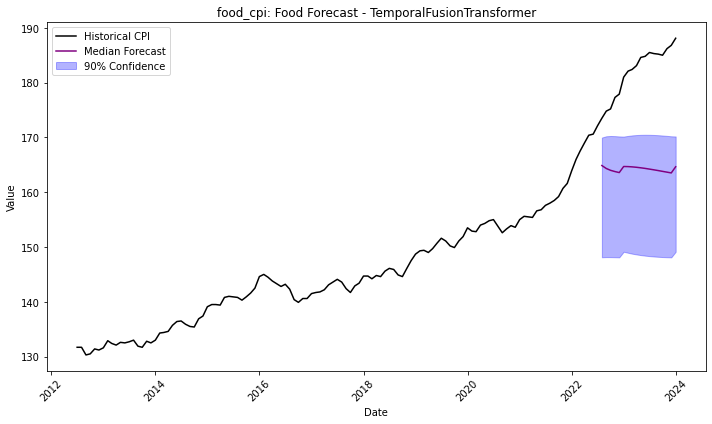

Beginning AutoGluon training... Time limit = 2s
AutoGluon will save models to './output/TEST/ag_global_all_TemporalFusionTransformerModel_exp2_R3_/random_seed_42/2022-07-01/model_files/'
=================== System Info ===================
AutoGluon Version:  1.1.1
Python Version:     3.8.20
Operating System:   Linux
Platform Machine:   x86_64
Platform Version:   #147~18.04.1-Ubuntu SMP Sat Oct 15 13:10:18 UTC 2022
CPU Count:          32
GPU Count:          1
Memory Avail:       166.77 GB / 188.57 GB (88.4%)
Disk Space Avail:   18210.80 GB / 249006.62 GB (7.3%)

Fitting with arguments:
{'enable_ensemble': True,
 'eval_metric': MAPE,
 'excluded_model_types': ['DirectTabular', 'RecursiveTabular'],
 'hyperparameters': {'TemporalFusionTransformerModel': {}},
 'known_covariates_names': [],
 'num_val_windows': 1,
 'prediction_length': 18,
 'quantile_levels': [0.01, 0.05, 0.1, 0.25, 0.75, 0.9, 0.95, 0.99],
 'random_seed': 42,
 'refit_every_n_windows': 1,
 'refit_full': False,
 'skip_model_sele

TemporalFusionTransformerModel


Inferred time series frequency: 'MS'
Provided train_data has 9658 rows (NaN fraction=0.1%), 22 time series. Median time series length is 439 (min=439, max=439). 

Provided data contains following columns:
	target: 'target'

AutoGluon will gauge predictive performance using evaluation metric: 'MAPE'
	This metric's sign has been flipped to adhere to being higher_is_better. The metric score can be multiplied by -1 to get the metric value.

Starting training. Start time is 2024-10-27 07:39:25
Excluded model types: ['DirectTabular', 'RecursiveTabular']
Models that will be trained: ['TemporalFusionTransformer']
Training timeseries model TemporalFusionTransformer. Training for up to 1.7s of the 1.7s of remaining time.
	-0.4240       = Validation score (-MAPE)
	1.88    s     = Training runtime
	0.04    s     = Validation (prediction) runtime
Not fitting ensemble due to lack of time remaining. Time left: -0.3 seconds
Training complete. Models trained: ['TemporalFusionTransformer']
Total runtime

****************** Summary of fit() ******************
Estimated performance of each model:
                       model  score_val  pred_time_val  fit_time_marginal  \
0  TemporalFusionTransformer  -0.424029       0.042312           1.881073   

   fit_order  
0          1  
Number of models trained: 1
Types of models trained:
{'MultiWindowBacktestingModel'}
****************** End of fit() summary ******************


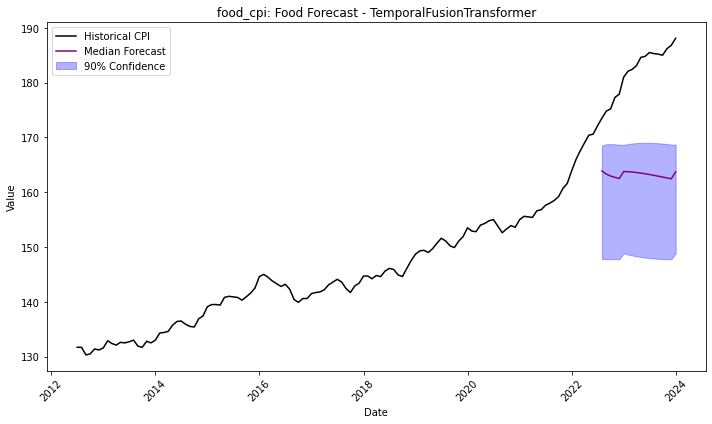

Beginning AutoGluon training... Time limit = 2s
AutoGluon will save models to './output/TEST/ag_global_all_TemporalFusionTransformerModel_exp2_GPT_P1_/random_seed_42/2022-07-01/model_files/'
=================== System Info ===================
AutoGluon Version:  1.1.1
Python Version:     3.8.20
Operating System:   Linux
Platform Machine:   x86_64
Platform Version:   #147~18.04.1-Ubuntu SMP Sat Oct 15 13:10:18 UTC 2022
CPU Count:          32
GPU Count:          1
Memory Avail:       166.77 GB / 188.57 GB (88.4%)
Disk Space Avail:   18210.45 GB / 249006.62 GB (7.3%)

Fitting with arguments:
{'enable_ensemble': True,
 'eval_metric': MAPE,
 'excluded_model_types': ['DirectTabular', 'RecursiveTabular'],
 'hyperparameters': {'TemporalFusionTransformerModel': {}},
 'known_covariates_names': [],
 'num_val_windows': 1,
 'prediction_length': 18,
 'quantile_levels': [0.01, 0.05, 0.1, 0.25, 0.75, 0.9, 0.95, 0.99],
 'random_seed': 42,
 'refit_every_n_windows': 1,
 'refit_full': False,
 'skip_model_

TemporalFusionTransformerModel


	-5.3782       = Validation score (-MAPE)
	2.13    s     = Training runtime
	0.04    s     = Validation (prediction) runtime
Not fitting ensemble due to lack of time remaining. Time left: -0.3 seconds
Training complete. Models trained: ['TemporalFusionTransformer']
Total runtime: 2.21 s
Best model: TemporalFusionTransformer
Best model score: -5.3782
Model not specified in predict, will default to the model with the best validation score: TemporalFusionTransformer
Model not specified in predict, will default to the model with the best validation score: TemporalFusionTransformer


****************** Summary of fit() ******************
Estimated performance of each model:
                       model  score_val  pred_time_val  fit_time_marginal  \
0  TemporalFusionTransformer  -5.378217       0.043605           2.128113   

   fit_order  
0          1  
Number of models trained: 1
Types of models trained:
{'MultiWindowBacktestingModel'}
****************** End of fit() summary ******************


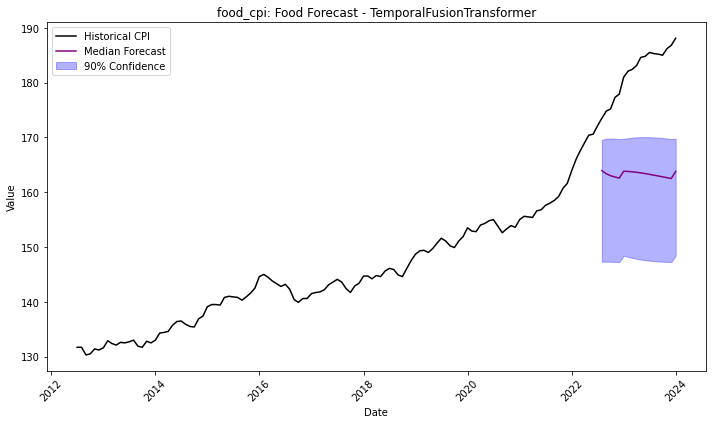

Beginning AutoGluon training... Time limit = 2s
AutoGluon will save models to './output/TEST/ag_global_all_TemporalFusionTransformerModel_exp2_R1_/random_seed_42/2022-07-01/model_files/'
=================== System Info ===================
AutoGluon Version:  1.1.1
Python Version:     3.8.20
Operating System:   Linux
Platform Machine:   x86_64
Platform Version:   #147~18.04.1-Ubuntu SMP Sat Oct 15 13:10:18 UTC 2022
CPU Count:          32
GPU Count:          1
Memory Avail:       166.77 GB / 188.57 GB (88.4%)
Disk Space Avail:   18209.54 GB / 249006.62 GB (7.3%)

Fitting with arguments:
{'enable_ensemble': True,
 'eval_metric': MAPE,
 'excluded_model_types': ['DirectTabular', 'RecursiveTabular'],
 'hyperparameters': {'TemporalFusionTransformerModel': {}},
 'known_covariates_names': [],
 'num_val_windows': 1,
 'prediction_length': 18,
 'quantile_levels': [0.01, 0.05, 0.1, 0.25, 0.75, 0.9, 0.95, 0.99],
 'random_seed': 42,
 'refit_every_n_windows': 1,
 'refit_full': False,
 'skip_model_sele

TemporalFusionTransformerModel


	-5.6249       = Validation score (-MAPE)
	2.14    s     = Training runtime
	0.04    s     = Validation (prediction) runtime
Not fitting ensemble due to lack of time remaining. Time left: -0.3 seconds
Training complete. Models trained: ['TemporalFusionTransformer']
Total runtime: 2.23 s
Best model: TemporalFusionTransformer
Best model score: -5.6249
Model not specified in predict, will default to the model with the best validation score: TemporalFusionTransformer
Model not specified in predict, will default to the model with the best validation score: TemporalFusionTransformer


****************** Summary of fit() ******************
Estimated performance of each model:
                       model  score_val  pred_time_val  fit_time_marginal  \
0  TemporalFusionTransformer  -5.624872       0.042665           2.137771   

   fit_order  
0          1  
Number of models trained: 1
Types of models trained:
{'MultiWindowBacktestingModel'}
****************** End of fit() summary ******************


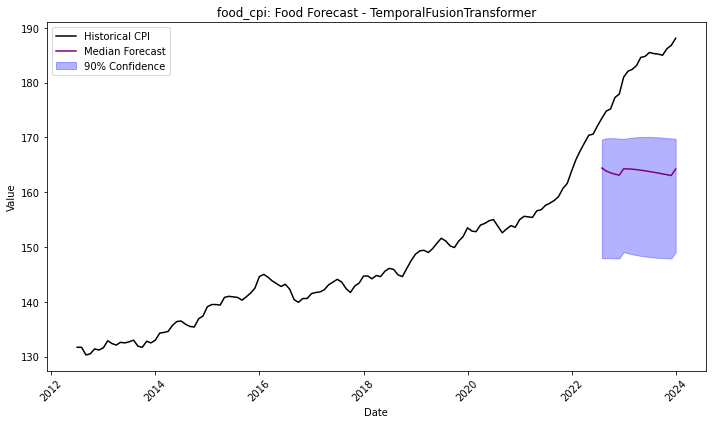

Beginning AutoGluon training... Time limit = 2s
AutoGluon will save models to './output/TEST/ag_global_all_TemporalFusionTransformerModel_exp2_GPT_P4_/random_seed_42/2022-07-01/model_files/'
=================== System Info ===================
AutoGluon Version:  1.1.1
Python Version:     3.8.20
Operating System:   Linux
Platform Machine:   x86_64
Platform Version:   #147~18.04.1-Ubuntu SMP Sat Oct 15 13:10:18 UTC 2022
CPU Count:          32
GPU Count:          1
Memory Avail:       166.77 GB / 188.57 GB (88.4%)
Disk Space Avail:   18209.53 GB / 249006.62 GB (7.3%)

Fitting with arguments:
{'enable_ensemble': True,
 'eval_metric': MAPE,
 'excluded_model_types': ['DirectTabular', 'RecursiveTabular'],
 'hyperparameters': {'TemporalFusionTransformerModel': {}},
 'known_covariates_names': [],
 'num_val_windows': 1,
 'prediction_length': 18,
 'quantile_levels': [0.01, 0.05, 0.1, 0.25, 0.75, 0.9, 0.95, 0.99],
 'random_seed': 42,
 'refit_every_n_windows': 1,
 'refit_full': False,
 'skip_model_

TemporalFusionTransformerModel


	-6.9764       = Validation score (-MAPE)
	2.11    s     = Training runtime
	0.04    s     = Validation (prediction) runtime
Not fitting ensemble due to lack of time remaining. Time left: -0.2 seconds
Training complete. Models trained: ['TemporalFusionTransformer']
Total runtime: 2.19 s
Best model: TemporalFusionTransformer
Best model score: -6.9764
Model not specified in predict, will default to the model with the best validation score: TemporalFusionTransformer
Model not specified in predict, will default to the model with the best validation score: TemporalFusionTransformer


****************** Summary of fit() ******************
Estimated performance of each model:
                       model  score_val  pred_time_val  fit_time_marginal  \
0  TemporalFusionTransformer  -6.976409       0.039917           2.105422   

   fit_order  
0          1  
Number of models trained: 1
Types of models trained:
{'MultiWindowBacktestingModel'}
****************** End of fit() summary ******************


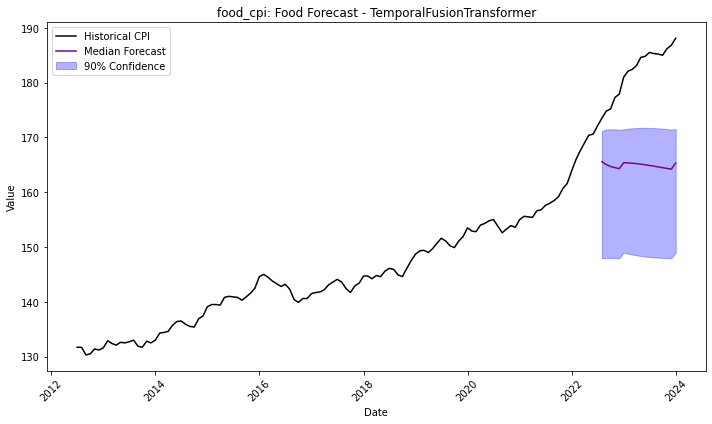

Beginning AutoGluon training... Time limit = 2s
AutoGluon will save models to './output/TEST/ag_global_all_TemporalFusionTransformerModel_exp2_R4_/random_seed_42/2022-07-01/model_files/'
=================== System Info ===================
AutoGluon Version:  1.1.1
Python Version:     3.8.20
Operating System:   Linux
Platform Machine:   x86_64
Platform Version:   #147~18.04.1-Ubuntu SMP Sat Oct 15 13:10:18 UTC 2022
CPU Count:          32
GPU Count:          1
Memory Avail:       166.77 GB / 188.57 GB (88.4%)
Disk Space Avail:   18209.52 GB / 249006.62 GB (7.3%)

Fitting with arguments:
{'enable_ensemble': True,
 'eval_metric': MAPE,
 'excluded_model_types': ['DirectTabular', 'RecursiveTabular'],
 'hyperparameters': {'TemporalFusionTransformerModel': {}},
 'known_covariates_names': [],
 'num_val_windows': 1,
 'prediction_length': 18,
 'quantile_levels': [0.01, 0.05, 0.1, 0.25, 0.75, 0.9, 0.95, 0.99],
 'random_seed': 42,
 'refit_every_n_windows': 1,
 'refit_full': False,
 'skip_model_sele

TemporalFusionTransformerModel


	-5.5690       = Validation score (-MAPE)
	2.12    s     = Training runtime
	0.04    s     = Validation (prediction) runtime
Not fitting ensemble due to lack of time remaining. Time left: -0.3 seconds
Training complete. Models trained: ['TemporalFusionTransformer']
Total runtime: 2.20 s
Best model: TemporalFusionTransformer
Best model score: -5.5690
Model not specified in predict, will default to the model with the best validation score: TemporalFusionTransformer
Model not specified in predict, will default to the model with the best validation score: TemporalFusionTransformer


****************** Summary of fit() ******************
Estimated performance of each model:
                       model  score_val  pred_time_val  fit_time_marginal  \
0  TemporalFusionTransformer  -5.569027       0.044238           2.122119   

   fit_order  
0          1  
Number of models trained: 1
Types of models trained:
{'MultiWindowBacktestingModel'}
****************** End of fit() summary ******************


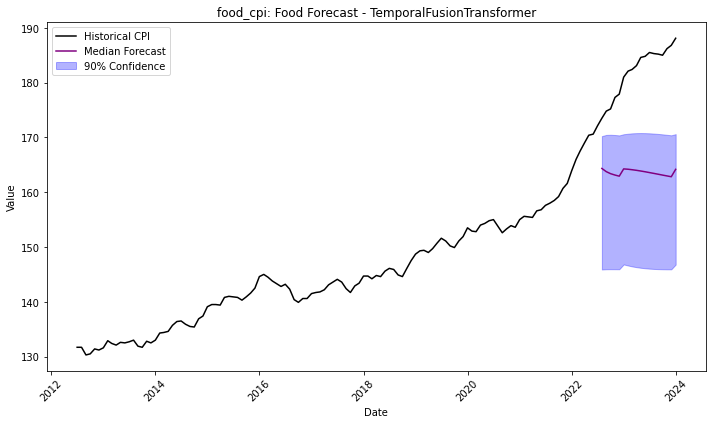

Beginning AutoGluon training... Time limit = 2s
AutoGluon will save models to './output/TEST/ag_global_all_TemporalFusionTransformerModel_exp2_GPT_P3_/random_seed_42/2022-07-01/model_files/'
=================== System Info ===================
AutoGluon Version:  1.1.1
Python Version:     3.8.20
Operating System:   Linux
Platform Machine:   x86_64
Platform Version:   #147~18.04.1-Ubuntu SMP Sat Oct 15 13:10:18 UTC 2022
CPU Count:          32
GPU Count:          1
Memory Avail:       166.87 GB / 188.57 GB (88.5%)
Disk Space Avail:   18209.51 GB / 249006.62 GB (7.3%)

Fitting with arguments:
{'enable_ensemble': True,
 'eval_metric': MAPE,
 'excluded_model_types': ['DirectTabular', 'RecursiveTabular'],
 'hyperparameters': {'TemporalFusionTransformerModel': {}},
 'known_covariates_names': [],
 'num_val_windows': 1,
 'prediction_length': 18,
 'quantile_levels': [0.01, 0.05, 0.1, 0.25, 0.75, 0.9, 0.95, 0.99],
 'random_seed': 42,
 'refit_every_n_windows': 1,
 'refit_full': False,
 'skip_model_

TemporalFusionTransformerModel


	-5.8855       = Validation score (-MAPE)
	2.35    s     = Training runtime
	0.04    s     = Validation (prediction) runtime
Not fitting ensemble due to lack of time remaining. Time left: -0.5 seconds
Training complete. Models trained: ['TemporalFusionTransformer']
Total runtime: 2.43 s
Best model: TemporalFusionTransformer
Best model score: -5.8855
Model not specified in predict, will default to the model with the best validation score: TemporalFusionTransformer
Model not specified in predict, will default to the model with the best validation score: TemporalFusionTransformer


****************** Summary of fit() ******************
Estimated performance of each model:
                       model  score_val  pred_time_val  fit_time_marginal  \
0  TemporalFusionTransformer  -5.885455        0.04318           2.345903   

   fit_order  
0          1  
Number of models trained: 1
Types of models trained:
{'MultiWindowBacktestingModel'}
****************** End of fit() summary ******************


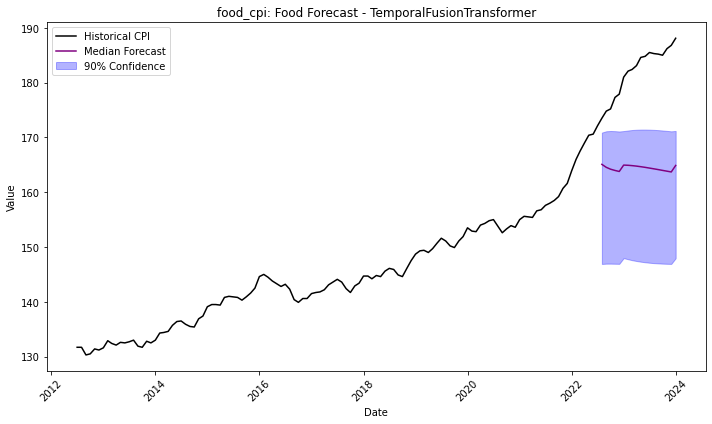

Beginning AutoGluon training... Time limit = 2s
AutoGluon will save models to './output/TEST/ag_global_all_TemporalFusionTransformerModel_exp2_R2_/random_seed_42/2022-07-01/model_files/'
=================== System Info ===================
AutoGluon Version:  1.1.1
Python Version:     3.8.20
Operating System:   Linux
Platform Machine:   x86_64
Platform Version:   #147~18.04.1-Ubuntu SMP Sat Oct 15 13:10:18 UTC 2022
CPU Count:          32
GPU Count:          1
Memory Avail:       166.80 GB / 188.57 GB (88.5%)
Disk Space Avail:   18209.55 GB / 249006.62 GB (7.3%)

Fitting with arguments:
{'enable_ensemble': True,
 'eval_metric': MAPE,
 'excluded_model_types': ['DirectTabular', 'RecursiveTabular'],
 'hyperparameters': {'TemporalFusionTransformerModel': {}},
 'known_covariates_names': [],
 'num_val_windows': 1,
 'prediction_length': 18,
 'quantile_levels': [0.01, 0.05, 0.1, 0.25, 0.75, 0.9, 0.95, 0.99],
 'random_seed': 42,
 'refit_every_n_windows': 1,
 'refit_full': False,
 'skip_model_sele

TemporalFusionTransformerModel


	-0.5818       = Validation score (-MAPE)
	2.12    s     = Training runtime
	0.04    s     = Validation (prediction) runtime
Not fitting ensemble due to lack of time remaining. Time left: -0.3 seconds
Training complete. Models trained: ['TemporalFusionTransformer']
Total runtime: 2.20 s
Best model: TemporalFusionTransformer
Best model score: -0.5818
Model not specified in predict, will default to the model with the best validation score: TemporalFusionTransformer
Model not specified in predict, will default to the model with the best validation score: TemporalFusionTransformer


****************** Summary of fit() ******************
Estimated performance of each model:
                       model  score_val  pred_time_val  fit_time_marginal  \
0  TemporalFusionTransformer   -0.58177         0.0432           2.116884   

   fit_order  
0          1  
Number of models trained: 1
Types of models trained:
{'MultiWindowBacktestingModel'}
****************** End of fit() summary ******************


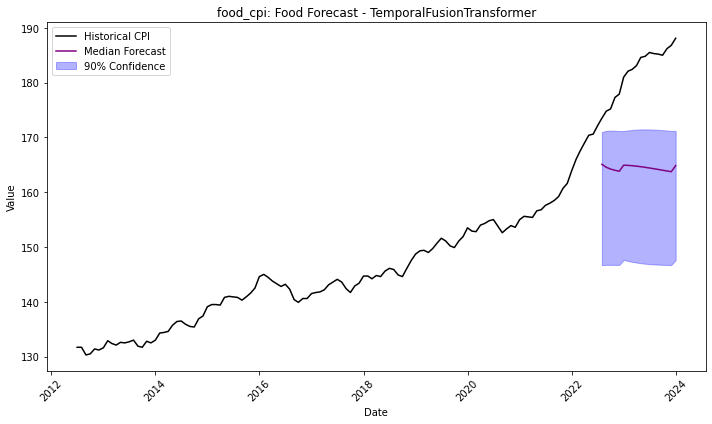

Beginning AutoGluon training... Time limit = 2s
AutoGluon will save models to './output/TEST/ag_global_all_TemporalFusionTransformerModel_exp2_GPT_P2_/random_seed_42/2023-07-01/model_files/'
=================== System Info ===================
AutoGluon Version:  1.1.1
Python Version:     3.8.20
Operating System:   Linux
Platform Machine:   x86_64
Platform Version:   #147~18.04.1-Ubuntu SMP Sat Oct 15 13:10:18 UTC 2022
CPU Count:          32
GPU Count:          1
Memory Avail:       166.77 GB / 188.57 GB (88.4%)
Disk Space Avail:   18209.54 GB / 249006.62 GB (7.3%)

Fitting with arguments:
{'enable_ensemble': True,
 'eval_metric': MAPE,
 'excluded_model_types': ['DirectTabular', 'RecursiveTabular'],
 'hyperparameters': {'TemporalFusionTransformerModel': {}},
 'known_covariates_names': [],
 'num_val_windows': 1,
 'prediction_length': 18,
 'quantile_levels': [0.01, 0.05, 0.1, 0.25, 0.75, 0.9, 0.95, 0.99],
 'random_seed': 42,
 'refit_every_n_windows': 1,
 'refit_full': False,
 'skip_model_

TemporalFusionTransformerModel


	-0.6561       = Validation score (-MAPE)
	2.15    s     = Training runtime
	0.04    s     = Validation (prediction) runtime
Not fitting ensemble due to lack of time remaining. Time left: -0.3 seconds
Training complete. Models trained: ['TemporalFusionTransformer']
Total runtime: 2.23 s
Best model: TemporalFusionTransformer
Best model score: -0.6561
Model not specified in predict, will default to the model with the best validation score: TemporalFusionTransformer
Model not specified in predict, will default to the model with the best validation score: TemporalFusionTransformer


****************** Summary of fit() ******************
Estimated performance of each model:
                       model  score_val  pred_time_val  fit_time_marginal  \
0  TemporalFusionTransformer  -0.656074       0.042641           2.152802   

   fit_order  
0          1  
Number of models trained: 1
Types of models trained:
{'MultiWindowBacktestingModel'}
****************** End of fit() summary ******************


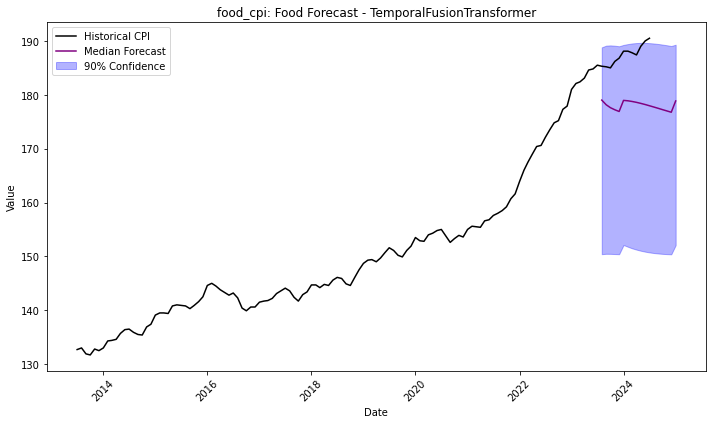

Beginning AutoGluon training... Time limit = 2s
AutoGluon will save models to './output/TEST/ag_global_all_TemporalFusionTransformerModel_exp2_R3_/random_seed_42/2023-07-01/model_files/'
=================== System Info ===================
AutoGluon Version:  1.1.1
Python Version:     3.8.20
Operating System:   Linux
Platform Machine:   x86_64
Platform Version:   #147~18.04.1-Ubuntu SMP Sat Oct 15 13:10:18 UTC 2022
CPU Count:          32
GPU Count:          1
Memory Avail:       166.77 GB / 188.57 GB (88.4%)
Disk Space Avail:   18209.52 GB / 249006.62 GB (7.3%)

Fitting with arguments:
{'enable_ensemble': True,
 'eval_metric': MAPE,
 'excluded_model_types': ['DirectTabular', 'RecursiveTabular'],
 'hyperparameters': {'TemporalFusionTransformerModel': {}},
 'known_covariates_names': [],
 'num_val_windows': 1,
 'prediction_length': 18,
 'quantile_levels': [0.01, 0.05, 0.1, 0.25, 0.75, 0.9, 0.95, 0.99],
 'random_seed': 42,
 'refit_every_n_windows': 1,
 'refit_full': False,
 'skip_model_sele

TemporalFusionTransformerModel


	-0.4648       = Validation score (-MAPE)
	2.13    s     = Training runtime
	0.04    s     = Validation (prediction) runtime
Not fitting ensemble due to lack of time remaining. Time left: -0.3 seconds
Training complete. Models trained: ['TemporalFusionTransformer']
Total runtime: 2.22 s
Best model: TemporalFusionTransformer
Best model score: -0.4648
Model not specified in predict, will default to the model with the best validation score: TemporalFusionTransformer
Model not specified in predict, will default to the model with the best validation score: TemporalFusionTransformer


****************** Summary of fit() ******************
Estimated performance of each model:
                       model  score_val  pred_time_val  fit_time_marginal  \
0  TemporalFusionTransformer   -0.46477       0.042054           2.134404   

   fit_order  
0          1  
Number of models trained: 1
Types of models trained:
{'MultiWindowBacktestingModel'}
****************** End of fit() summary ******************


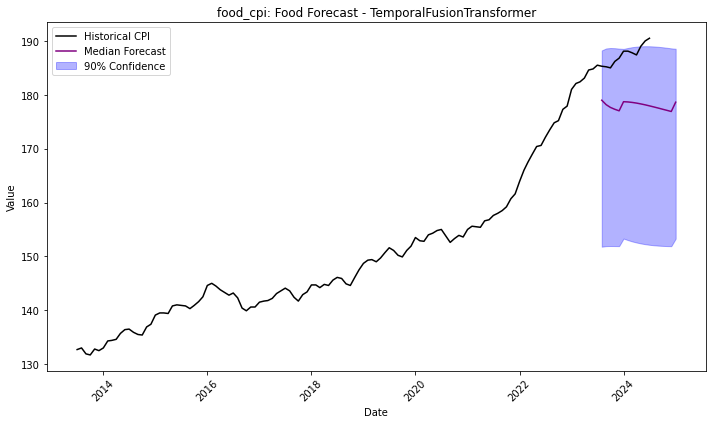

Beginning AutoGluon training... Time limit = 2s
AutoGluon will save models to './output/TEST/ag_global_all_TemporalFusionTransformerModel_exp2_GPT_P1_/random_seed_42/2023-07-01/model_files/'
=================== System Info ===================
AutoGluon Version:  1.1.1
Python Version:     3.8.20
Operating System:   Linux
Platform Machine:   x86_64
Platform Version:   #147~18.04.1-Ubuntu SMP Sat Oct 15 13:10:18 UTC 2022
CPU Count:          32
GPU Count:          1
Memory Avail:       166.77 GB / 188.57 GB (88.4%)
Disk Space Avail:   18209.52 GB / 249006.62 GB (7.3%)

Fitting with arguments:
{'enable_ensemble': True,
 'eval_metric': MAPE,
 'excluded_model_types': ['DirectTabular', 'RecursiveTabular'],
 'hyperparameters': {'TemporalFusionTransformerModel': {}},
 'known_covariates_names': [],
 'num_val_windows': 1,
 'prediction_length': 18,
 'quantile_levels': [0.01, 0.05, 0.1, 0.25, 0.75, 0.9, 0.95, 0.99],
 'random_seed': 42,
 'refit_every_n_windows': 1,
 'refit_full': False,
 'skip_model_

TemporalFusionTransformerModel


	-0.7141       = Validation score (-MAPE)
	2.13    s     = Training runtime
	0.04    s     = Validation (prediction) runtime
Not fitting ensemble due to lack of time remaining. Time left: -0.3 seconds
Training complete. Models trained: ['TemporalFusionTransformer']
Total runtime: 2.22 s
Best model: TemporalFusionTransformer
Best model score: -0.7141
Model not specified in predict, will default to the model with the best validation score: TemporalFusionTransformer
Model not specified in predict, will default to the model with the best validation score: TemporalFusionTransformer


****************** Summary of fit() ******************
Estimated performance of each model:
                       model  score_val  pred_time_val  fit_time_marginal  \
0  TemporalFusionTransformer  -0.714117       0.043226           2.130341   

   fit_order  
0          1  
Number of models trained: 1
Types of models trained:
{'MultiWindowBacktestingModel'}
****************** End of fit() summary ******************


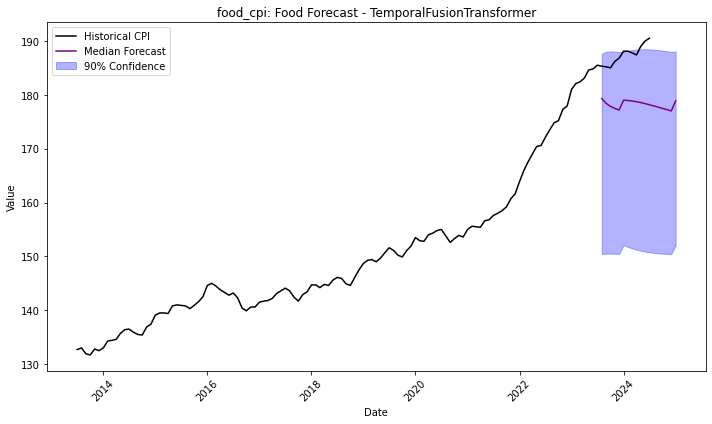

Beginning AutoGluon training... Time limit = 2s
AutoGluon will save models to './output/TEST/ag_global_all_TemporalFusionTransformerModel_exp2_R1_/random_seed_42/2023-07-01/model_files/'
=================== System Info ===================
AutoGluon Version:  1.1.1
Python Version:     3.8.20
Operating System:   Linux
Platform Machine:   x86_64
Platform Version:   #147~18.04.1-Ubuntu SMP Sat Oct 15 13:10:18 UTC 2022
CPU Count:          32
GPU Count:          1
Memory Avail:       166.77 GB / 188.57 GB (88.4%)
Disk Space Avail:   18209.51 GB / 249006.62 GB (7.3%)

Fitting with arguments:
{'enable_ensemble': True,
 'eval_metric': MAPE,
 'excluded_model_types': ['DirectTabular', 'RecursiveTabular'],
 'hyperparameters': {'TemporalFusionTransformerModel': {}},
 'known_covariates_names': [],
 'num_val_windows': 1,
 'prediction_length': 18,
 'quantile_levels': [0.01, 0.05, 0.1, 0.25, 0.75, 0.9, 0.95, 0.99],
 'random_seed': 42,
 'refit_every_n_windows': 1,
 'refit_full': False,
 'skip_model_sele

TemporalFusionTransformerModel


	-0.9948       = Validation score (-MAPE)
	2.12    s     = Training runtime
	0.34    s     = Validation (prediction) runtime
Not fitting ensemble due to lack of time remaining. Time left: -0.6 seconds
Training complete. Models trained: ['TemporalFusionTransformer']
Total runtime: 2.50 s
Best model: TemporalFusionTransformer
Best model score: -0.9948
Model not specified in predict, will default to the model with the best validation score: TemporalFusionTransformer
Model not specified in predict, will default to the model with the best validation score: TemporalFusionTransformer


****************** Summary of fit() ******************
Estimated performance of each model:
                       model  score_val  pred_time_val  fit_time_marginal  \
0  TemporalFusionTransformer  -0.994837       0.343633           2.115288   

   fit_order  
0          1  
Number of models trained: 1
Types of models trained:
{'MultiWindowBacktestingModel'}
****************** End of fit() summary ******************


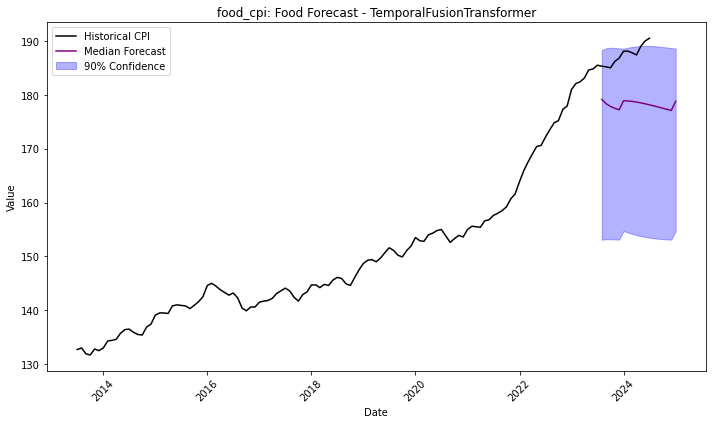

Beginning AutoGluon training... Time limit = 2s
AutoGluon will save models to './output/TEST/ag_global_all_TemporalFusionTransformerModel_exp2_GPT_P4_/random_seed_42/2023-07-01/model_files/'
=================== System Info ===================
AutoGluon Version:  1.1.1
Python Version:     3.8.20
Operating System:   Linux
Platform Machine:   x86_64
Platform Version:   #147~18.04.1-Ubuntu SMP Sat Oct 15 13:10:18 UTC 2022
CPU Count:          32
GPU Count:          1
Memory Avail:       166.77 GB / 188.57 GB (88.4%)
Disk Space Avail:   18209.50 GB / 249006.62 GB (7.3%)

Fitting with arguments:
{'enable_ensemble': True,
 'eval_metric': MAPE,
 'excluded_model_types': ['DirectTabular', 'RecursiveTabular'],
 'hyperparameters': {'TemporalFusionTransformerModel': {}},
 'known_covariates_names': [],
 'num_val_windows': 1,
 'prediction_length': 18,
 'quantile_levels': [0.01, 0.05, 0.1, 0.25, 0.75, 0.9, 0.95, 0.99],
 'random_seed': 42,
 'refit_every_n_windows': 1,
 'refit_full': False,
 'skip_model_

TemporalFusionTransformerModel


	-1.0322       = Validation score (-MAPE)
	2.14    s     = Training runtime
	0.04    s     = Validation (prediction) runtime
Not fitting ensemble due to lack of time remaining. Time left: -0.3 seconds
Training complete. Models trained: ['TemporalFusionTransformer']
Total runtime: 2.22 s
Best model: TemporalFusionTransformer
Best model score: -1.0322
Model not specified in predict, will default to the model with the best validation score: TemporalFusionTransformer
Model not specified in predict, will default to the model with the best validation score: TemporalFusionTransformer


****************** Summary of fit() ******************
Estimated performance of each model:
                       model  score_val  pred_time_val  fit_time_marginal  \
0  TemporalFusionTransformer  -1.032158       0.040142           2.141534   

   fit_order  
0          1  
Number of models trained: 1
Types of models trained:
{'MultiWindowBacktestingModel'}
****************** End of fit() summary ******************


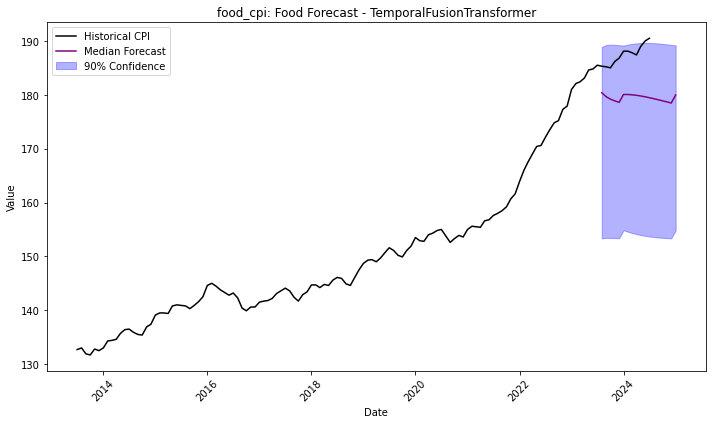

Beginning AutoGluon training... Time limit = 2s
AutoGluon will save models to './output/TEST/ag_global_all_TemporalFusionTransformerModel_exp2_R4_/random_seed_42/2023-07-01/model_files/'
=================== System Info ===================
AutoGluon Version:  1.1.1
Python Version:     3.8.20
Operating System:   Linux
Platform Machine:   x86_64
Platform Version:   #147~18.04.1-Ubuntu SMP Sat Oct 15 13:10:18 UTC 2022
CPU Count:          32
GPU Count:          1
Memory Avail:       166.77 GB / 188.57 GB (88.4%)
Disk Space Avail:   18209.54 GB / 249006.62 GB (7.3%)

Fitting with arguments:
{'enable_ensemble': True,
 'eval_metric': MAPE,
 'excluded_model_types': ['DirectTabular', 'RecursiveTabular'],
 'hyperparameters': {'TemporalFusionTransformerModel': {}},
 'known_covariates_names': [],
 'num_val_windows': 1,
 'prediction_length': 18,
 'quantile_levels': [0.01, 0.05, 0.1, 0.25, 0.75, 0.9, 0.95, 0.99],
 'random_seed': 42,
 'refit_every_n_windows': 1,
 'refit_full': False,
 'skip_model_sele

TemporalFusionTransformerModel


	-0.8201       = Validation score (-MAPE)
	2.15    s     = Training runtime
	0.04    s     = Validation (prediction) runtime
Not fitting ensemble due to lack of time remaining. Time left: -0.3 seconds
Training complete. Models trained: ['TemporalFusionTransformer']
Total runtime: 2.23 s
Best model: TemporalFusionTransformer
Best model score: -0.8201
Model not specified in predict, will default to the model with the best validation score: TemporalFusionTransformer
Model not specified in predict, will default to the model with the best validation score: TemporalFusionTransformer


****************** Summary of fit() ******************
Estimated performance of each model:
                       model  score_val  pred_time_val  fit_time_marginal  \
0  TemporalFusionTransformer  -0.820087       0.044604           2.146467   

   fit_order  
0          1  
Number of models trained: 1
Types of models trained:
{'MultiWindowBacktestingModel'}
****************** End of fit() summary ******************


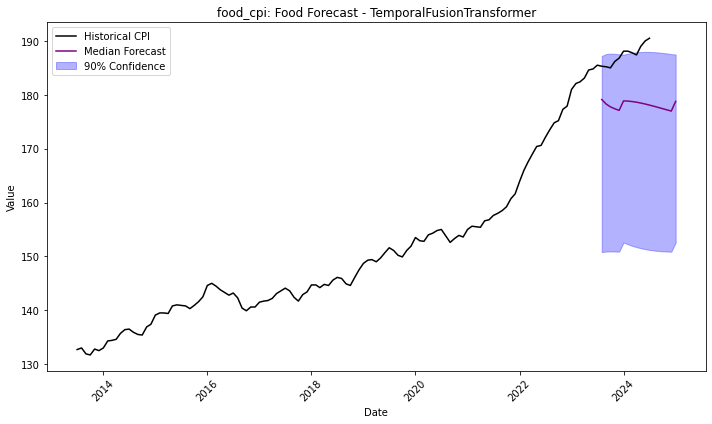

Beginning AutoGluon training... Time limit = 2s
AutoGluon will save models to './output/TEST/ag_global_all_TemporalFusionTransformerModel_exp2_GPT_P3_/random_seed_42/2023-07-01/model_files/'
=================== System Info ===================
AutoGluon Version:  1.1.1
Python Version:     3.8.20
Operating System:   Linux
Platform Machine:   x86_64
Platform Version:   #147~18.04.1-Ubuntu SMP Sat Oct 15 13:10:18 UTC 2022
CPU Count:          32
GPU Count:          1
Memory Avail:       166.78 GB / 188.57 GB (88.4%)
Disk Space Avail:   18209.53 GB / 249006.62 GB (7.3%)

Fitting with arguments:
{'enable_ensemble': True,
 'eval_metric': MAPE,
 'excluded_model_types': ['DirectTabular', 'RecursiveTabular'],
 'hyperparameters': {'TemporalFusionTransformerModel': {}},
 'known_covariates_names': [],
 'num_val_windows': 1,
 'prediction_length': 18,
 'quantile_levels': [0.01, 0.05, 0.1, 0.25, 0.75, 0.9, 0.95, 0.99],
 'random_seed': 42,
 'refit_every_n_windows': 1,
 'refit_full': False,
 'skip_model_

TemporalFusionTransformerModel


	-1.0726       = Validation score (-MAPE)
	2.20    s     = Training runtime
	0.04    s     = Validation (prediction) runtime
Not fitting ensemble due to lack of time remaining. Time left: -0.3 seconds
Training complete. Models trained: ['TemporalFusionTransformer']
Total runtime: 2.27 s
Best model: TemporalFusionTransformer
Best model score: -1.0726
Model not specified in predict, will default to the model with the best validation score: TemporalFusionTransformer
Model not specified in predict, will default to the model with the best validation score: TemporalFusionTransformer


****************** Summary of fit() ******************
Estimated performance of each model:
                       model  score_val  pred_time_val  fit_time_marginal  \
0  TemporalFusionTransformer  -1.072602       0.042758           2.198636   

   fit_order  
0          1  
Number of models trained: 1
Types of models trained:
{'MultiWindowBacktestingModel'}
****************** End of fit() summary ******************


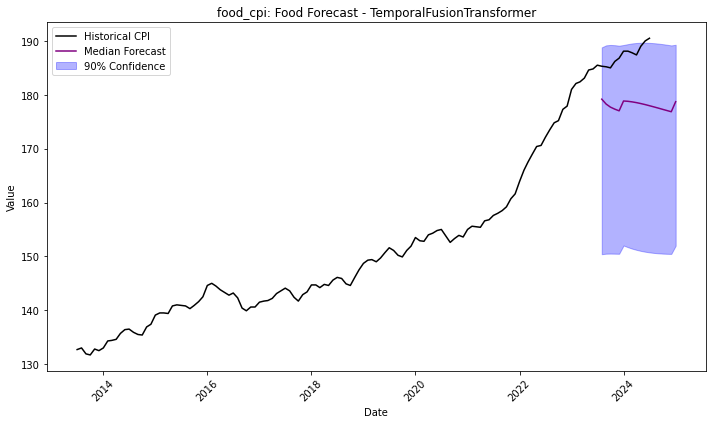

Beginning AutoGluon training... Time limit = 2s
AutoGluon will save models to './output/TEST/ag_global_all_TemporalFusionTransformerModel_exp2_R2_/random_seed_42/2023-07-01/model_files/'
=================== System Info ===================
AutoGluon Version:  1.1.1
Python Version:     3.8.20
Operating System:   Linux
Platform Machine:   x86_64
Platform Version:   #147~18.04.1-Ubuntu SMP Sat Oct 15 13:10:18 UTC 2022
CPU Count:          32
GPU Count:          1
Memory Avail:       166.77 GB / 188.57 GB (88.4%)
Disk Space Avail:   18209.52 GB / 249006.62 GB (7.3%)

Fitting with arguments:
{'enable_ensemble': True,
 'eval_metric': MAPE,
 'excluded_model_types': ['DirectTabular', 'RecursiveTabular'],
 'hyperparameters': {'TemporalFusionTransformerModel': {}},
 'known_covariates_names': [],
 'num_val_windows': 1,
 'prediction_length': 18,
 'quantile_levels': [0.01, 0.05, 0.1, 0.25, 0.75, 0.9, 0.95, 0.99],
 'random_seed': 42,
 'refit_every_n_windows': 1,
 'refit_full': False,
 'skip_model_sele

TemporalFusionTransformerModel


	-0.5325       = Validation score (-MAPE)
	2.13    s     = Training runtime
	0.04    s     = Validation (prediction) runtime
Not fitting ensemble due to lack of time remaining. Time left: -0.3 seconds
Training complete. Models trained: ['TemporalFusionTransformer']
Total runtime: 2.21 s
Best model: TemporalFusionTransformer
Best model score: -0.5325
Model not specified in predict, will default to the model with the best validation score: TemporalFusionTransformer
Model not specified in predict, will default to the model with the best validation score: TemporalFusionTransformer


****************** Summary of fit() ******************
Estimated performance of each model:
                       model  score_val  pred_time_val  fit_time_marginal  \
0  TemporalFusionTransformer  -0.532477       0.043121           2.125968   

   fit_order  
0          1  
Number of models trained: 1
Types of models trained:
{'MultiWindowBacktestingModel'}
****************** End of fit() summary ******************


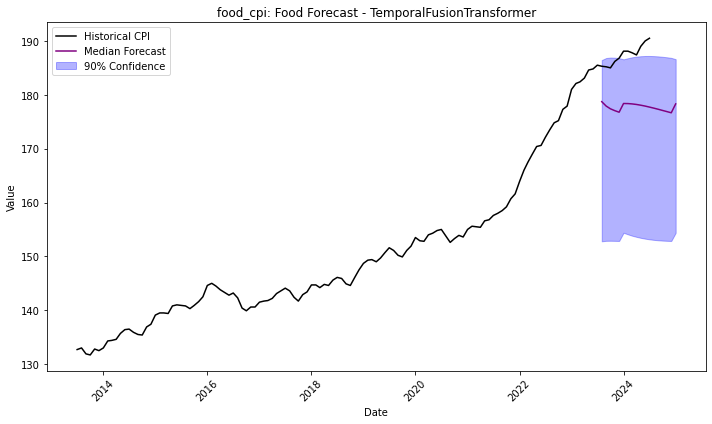

Beginning AutoGluon training... Time limit = 2s
AutoGluon will save models to './output/TEST/ag_global_all_TemporalFusionTransformerModel_exp2_GPT_P4_/random_seed_42/2018-07-01/model_files/'
=================== System Info ===================
AutoGluon Version:  1.1.1
Python Version:     3.8.20
Operating System:   Linux
Platform Machine:   x86_64
Platform Version:   #147~18.04.1-Ubuntu SMP Sat Oct 15 13:10:18 UTC 2022
CPU Count:          32
GPU Count:          1
Memory Avail:       166.77 GB / 188.57 GB (88.4%)
Disk Space Avail:   18209.51 GB / 249006.62 GB (7.3%)

Fitting with arguments:
{'enable_ensemble': True,
 'eval_metric': MAPE,
 'excluded_model_types': ['DirectTabular', 'RecursiveTabular'],
 'hyperparameters': {'TemporalFusionTransformerModel': {}},
 'known_covariates_names': [],
 'num_val_windows': 1,
 'prediction_length': 18,
 'quantile_levels': [0.01, 0.05, 0.1, 0.25, 0.75, 0.9, 0.95, 0.99],
 'random_seed': 42,
 'refit_every_n_windows': 1,
 'refit_full': False,
 'skip_model_

TemporalFusionTransformerModel


	-1.8038       = Validation score (-MAPE)
	2.12    s     = Training runtime
	0.04    s     = Validation (prediction) runtime
Not fitting ensemble due to lack of time remaining. Time left: -0.2 seconds
Training complete. Models trained: ['TemporalFusionTransformer']
Total runtime: 2.19 s
Best model: TemporalFusionTransformer
Best model score: -1.8038
Model not specified in predict, will default to the model with the best validation score: TemporalFusionTransformer
Model not specified in predict, will default to the model with the best validation score: TemporalFusionTransformer


****************** Summary of fit() ******************
Estimated performance of each model:
                       model  score_val  pred_time_val  fit_time_marginal  \
0  TemporalFusionTransformer  -1.803769       0.038122            2.11614   

   fit_order  
0          1  
Number of models trained: 1
Types of models trained:
{'MultiWindowBacktestingModel'}
****************** End of fit() summary ******************


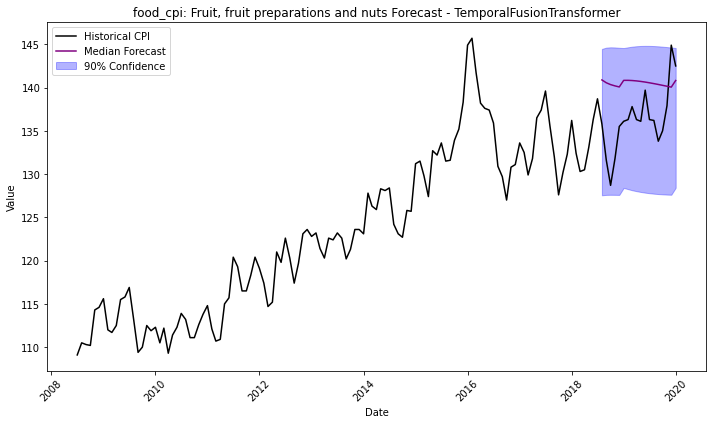

Beginning AutoGluon training... Time limit = 2s
AutoGluon will save models to './output/TEST/ag_global_all_TemporalFusionTransformerModel_exp2_R2_/random_seed_42/2018-07-01/model_files/'
=================== System Info ===================
AutoGluon Version:  1.1.1
Python Version:     3.8.20
Operating System:   Linux
Platform Machine:   x86_64
Platform Version:   #147~18.04.1-Ubuntu SMP Sat Oct 15 13:10:18 UTC 2022
CPU Count:          32
GPU Count:          1
Memory Avail:       166.77 GB / 188.57 GB (88.4%)
Disk Space Avail:   18209.50 GB / 249006.62 GB (7.3%)

Fitting with arguments:
{'enable_ensemble': True,
 'eval_metric': MAPE,
 'excluded_model_types': ['DirectTabular', 'RecursiveTabular'],
 'hyperparameters': {'TemporalFusionTransformerModel': {}},
 'known_covariates_names': [],
 'num_val_windows': 1,
 'prediction_length': 18,
 'quantile_levels': [0.01, 0.05, 0.1, 0.25, 0.75, 0.9, 0.95, 0.99],
 'random_seed': 42,
 'refit_every_n_windows': 1,
 'refit_full': False,
 'skip_model_sele

TemporalFusionTransformerModel


	-0.7285       = Validation score (-MAPE)
	2.42    s     = Training runtime
	0.04    s     = Validation (prediction) runtime
Not fitting ensemble due to lack of time remaining. Time left: -0.6 seconds
Training complete. Models trained: ['TemporalFusionTransformer']
Total runtime: 2.51 s
Best model: TemporalFusionTransformer
Best model score: -0.7285
Model not specified in predict, will default to the model with the best validation score: TemporalFusionTransformer
Model not specified in predict, will default to the model with the best validation score: TemporalFusionTransformer


****************** Summary of fit() ******************
Estimated performance of each model:
                       model  score_val  pred_time_val  fit_time_marginal  \
0  TemporalFusionTransformer  -0.728495       0.042764           2.423787   

   fit_order  
0          1  
Number of models trained: 1
Types of models trained:
{'MultiWindowBacktestingModel'}
****************** End of fit() summary ******************


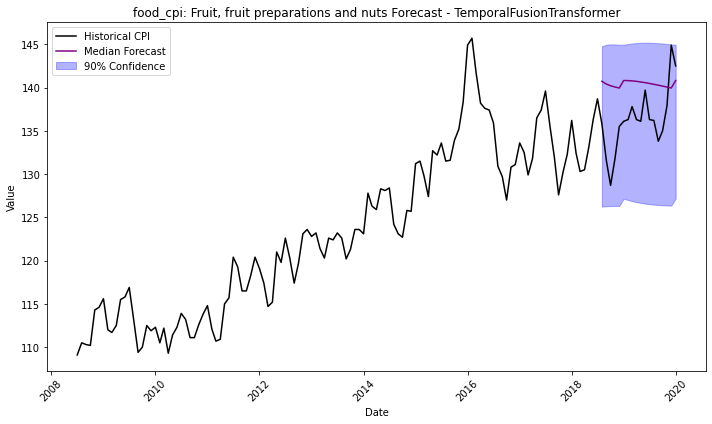

Beginning AutoGluon training... Time limit = 2s
AutoGluon will save models to './output/TEST/ag_global_all_TemporalFusionTransformerModel_exp2_R4_/random_seed_42/2018-07-01/model_files/'
=================== System Info ===================
AutoGluon Version:  1.1.1
Python Version:     3.8.20
Operating System:   Linux
Platform Machine:   x86_64
Platform Version:   #147~18.04.1-Ubuntu SMP Sat Oct 15 13:10:18 UTC 2022
CPU Count:          32
GPU Count:          1
Memory Avail:       166.77 GB / 188.57 GB (88.4%)
Disk Space Avail:   18209.49 GB / 249006.62 GB (7.3%)

Fitting with arguments:
{'enable_ensemble': True,
 'eval_metric': MAPE,
 'excluded_model_types': ['DirectTabular', 'RecursiveTabular'],
 'hyperparameters': {'TemporalFusionTransformerModel': {}},
 'known_covariates_names': [],
 'num_val_windows': 1,
 'prediction_length': 18,
 'quantile_levels': [0.01, 0.05, 0.1, 0.25, 0.75, 0.9, 0.95, 0.99],
 'random_seed': 42,
 'refit_every_n_windows': 1,
 'refit_full': False,
 'skip_model_sele

TemporalFusionTransformerModel


	-1.3127       = Validation score (-MAPE)
	2.12    s     = Training runtime
	0.04    s     = Validation (prediction) runtime
Not fitting ensemble due to lack of time remaining. Time left: -0.3 seconds
Training complete. Models trained: ['TemporalFusionTransformer']
Total runtime: 2.20 s
Best model: TemporalFusionTransformer
Best model score: -1.3127
Model not specified in predict, will default to the model with the best validation score: TemporalFusionTransformer
Model not specified in predict, will default to the model with the best validation score: TemporalFusionTransformer


****************** Summary of fit() ******************
Estimated performance of each model:
                       model  score_val  pred_time_val  fit_time_marginal  \
0  TemporalFusionTransformer  -1.312674       0.042805           2.115787   

   fit_order  
0          1  
Number of models trained: 1
Types of models trained:
{'MultiWindowBacktestingModel'}
****************** End of fit() summary ******************


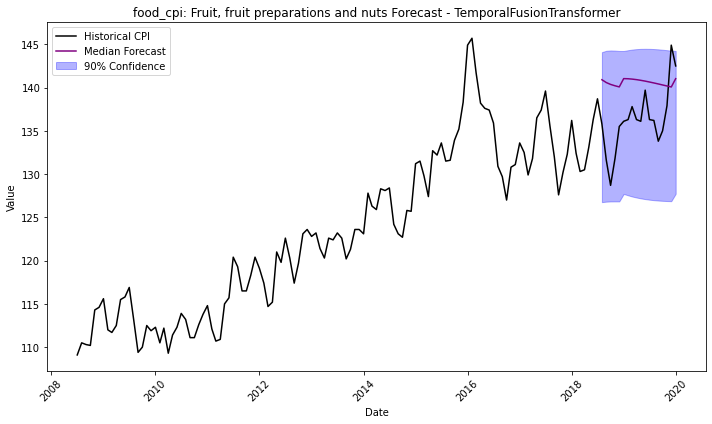

Beginning AutoGluon training... Time limit = 2s
AutoGluon will save models to './output/TEST/ag_global_all_TemporalFusionTransformerModel_exp2_GPT_P3_/random_seed_42/2018-07-01/model_files/'
=================== System Info ===================
AutoGluon Version:  1.1.1
Python Version:     3.8.20
Operating System:   Linux
Platform Machine:   x86_64
Platform Version:   #147~18.04.1-Ubuntu SMP Sat Oct 15 13:10:18 UTC 2022
CPU Count:          32
GPU Count:          1
Memory Avail:       166.77 GB / 188.57 GB (88.4%)
Disk Space Avail:   18209.54 GB / 249006.62 GB (7.3%)

Fitting with arguments:
{'enable_ensemble': True,
 'eval_metric': MAPE,
 'excluded_model_types': ['DirectTabular', 'RecursiveTabular'],
 'hyperparameters': {'TemporalFusionTransformerModel': {}},
 'known_covariates_names': [],
 'num_val_windows': 1,
 'prediction_length': 18,
 'quantile_levels': [0.01, 0.05, 0.1, 0.25, 0.75, 0.9, 0.95, 0.99],
 'random_seed': 42,
 'refit_every_n_windows': 1,
 'refit_full': False,
 'skip_model_

TemporalFusionTransformerModel


	-2.6954       = Validation score (-MAPE)
	2.13    s     = Training runtime
	0.04    s     = Validation (prediction) runtime
Not fitting ensemble due to lack of time remaining. Time left: -0.3 seconds
Training complete. Models trained: ['TemporalFusionTransformer']
Total runtime: 2.21 s
Best model: TemporalFusionTransformer
Best model score: -2.6954
Model not specified in predict, will default to the model with the best validation score: TemporalFusionTransformer
Model not specified in predict, will default to the model with the best validation score: TemporalFusionTransformer


****************** Summary of fit() ******************
Estimated performance of each model:
                       model  score_val  pred_time_val  fit_time_marginal  \
0  TemporalFusionTransformer  -2.695443       0.040675           2.134747   

   fit_order  
0          1  
Number of models trained: 1
Types of models trained:
{'MultiWindowBacktestingModel'}
****************** End of fit() summary ******************


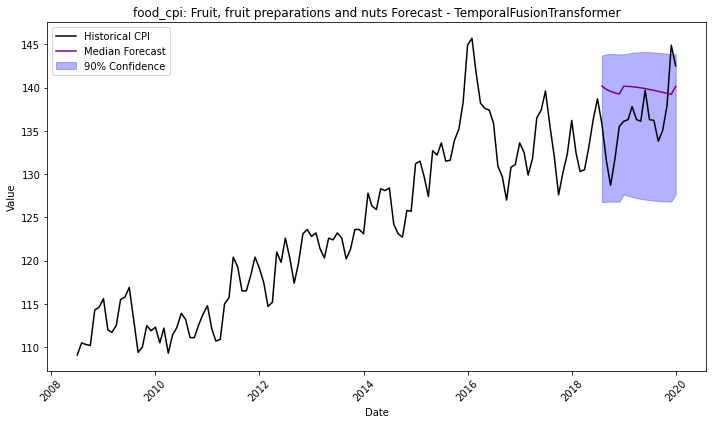

Beginning AutoGluon training... Time limit = 2s
AutoGluon will save models to './output/TEST/ag_global_all_TemporalFusionTransformerModel_exp2_R3_/random_seed_42/2018-07-01/model_files/'
=================== System Info ===================
AutoGluon Version:  1.1.1
Python Version:     3.8.20
Operating System:   Linux
Platform Machine:   x86_64
Platform Version:   #147~18.04.1-Ubuntu SMP Sat Oct 15 13:10:18 UTC 2022
CPU Count:          32
GPU Count:          1
Memory Avail:       166.77 GB / 188.57 GB (88.4%)
Disk Space Avail:   18209.50 GB / 249006.62 GB (7.3%)

Fitting with arguments:
{'enable_ensemble': True,
 'eval_metric': MAPE,
 'excluded_model_types': ['DirectTabular', 'RecursiveTabular'],
 'hyperparameters': {'TemporalFusionTransformerModel': {}},
 'known_covariates_names': [],
 'num_val_windows': 1,
 'prediction_length': 18,
 'quantile_levels': [0.01, 0.05, 0.1, 0.25, 0.75, 0.9, 0.95, 0.99],
 'random_seed': 42,
 'refit_every_n_windows': 1,
 'refit_full': False,
 'skip_model_sele

TemporalFusionTransformerModel


	-1.8109       = Validation score (-MAPE)
	2.14    s     = Training runtime
	0.04    s     = Validation (prediction) runtime
Not fitting ensemble due to lack of time remaining. Time left: -0.3 seconds
Training complete. Models trained: ['TemporalFusionTransformer']
Total runtime: 2.22 s
Best model: TemporalFusionTransformer
Best model score: -1.8109
Model not specified in predict, will default to the model with the best validation score: TemporalFusionTransformer
Model not specified in predict, will default to the model with the best validation score: TemporalFusionTransformer


****************** Summary of fit() ******************
Estimated performance of each model:
                       model  score_val  pred_time_val  fit_time_marginal  \
0  TemporalFusionTransformer  -1.810887       0.043651           2.135183   

   fit_order  
0          1  
Number of models trained: 1
Types of models trained:
{'MultiWindowBacktestingModel'}
****************** End of fit() summary ******************


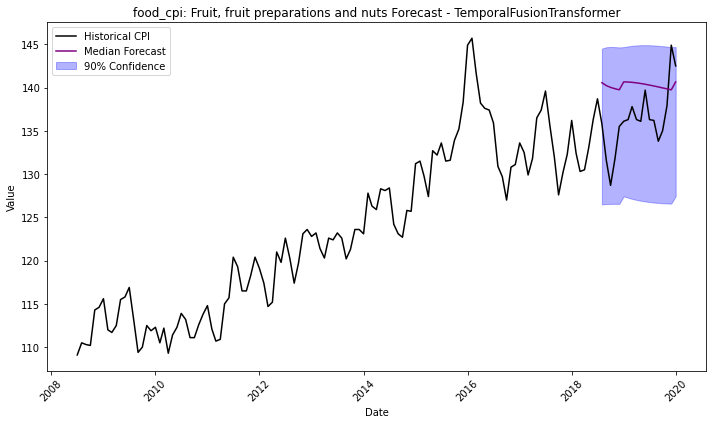

Beginning AutoGluon training... Time limit = 2s
AutoGluon will save models to './output/TEST/ag_global_all_TemporalFusionTransformerModel_exp2_GPT_P2_/random_seed_42/2018-07-01/model_files/'
=================== System Info ===================
AutoGluon Version:  1.1.1
Python Version:     3.8.20
Operating System:   Linux
Platform Machine:   x86_64
Platform Version:   #147~18.04.1-Ubuntu SMP Sat Oct 15 13:10:18 UTC 2022
CPU Count:          32
GPU Count:          1
Memory Avail:       166.87 GB / 188.57 GB (88.5%)
Disk Space Avail:   18209.50 GB / 249006.62 GB (7.3%)

Fitting with arguments:
{'enable_ensemble': True,
 'eval_metric': MAPE,
 'excluded_model_types': ['DirectTabular', 'RecursiveTabular'],
 'hyperparameters': {'TemporalFusionTransformerModel': {}},
 'known_covariates_names': [],
 'num_val_windows': 1,
 'prediction_length': 18,
 'quantile_levels': [0.01, 0.05, 0.1, 0.25, 0.75, 0.9, 0.95, 0.99],
 'random_seed': 42,
 'refit_every_n_windows': 1,
 'refit_full': False,
 'skip_model_

TemporalFusionTransformerModel


	-2.5024       = Validation score (-MAPE)
	2.13    s     = Training runtime
	0.04    s     = Validation (prediction) runtime
Not fitting ensemble due to lack of time remaining. Time left: -0.3 seconds
Training complete. Models trained: ['TemporalFusionTransformer']
Total runtime: 2.21 s
Best model: TemporalFusionTransformer
Best model score: -2.5024
Model not specified in predict, will default to the model with the best validation score: TemporalFusionTransformer
Model not specified in predict, will default to the model with the best validation score: TemporalFusionTransformer


****************** Summary of fit() ******************
Estimated performance of each model:
                       model  score_val  pred_time_val  fit_time_marginal  \
0  TemporalFusionTransformer   -2.50236       0.042005           2.125321   

   fit_order  
0          1  
Number of models trained: 1
Types of models trained:
{'MultiWindowBacktestingModel'}
****************** End of fit() summary ******************


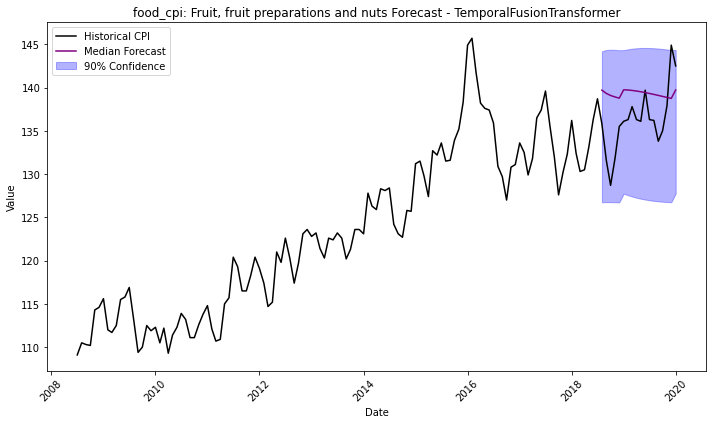

Beginning AutoGluon training... Time limit = 2s
AutoGluon will save models to './output/TEST/ag_global_all_TemporalFusionTransformerModel_exp2_R1_/random_seed_42/2018-07-01/model_files/'
=================== System Info ===================
AutoGluon Version:  1.1.1
Python Version:     3.8.20
Operating System:   Linux
Platform Machine:   x86_64
Platform Version:   #147~18.04.1-Ubuntu SMP Sat Oct 15 13:10:18 UTC 2022
CPU Count:          32
GPU Count:          1
Memory Avail:       166.77 GB / 188.57 GB (88.4%)
Disk Space Avail:   18209.55 GB / 249006.62 GB (7.3%)

Fitting with arguments:
{'enable_ensemble': True,
 'eval_metric': MAPE,
 'excluded_model_types': ['DirectTabular', 'RecursiveTabular'],
 'hyperparameters': {'TemporalFusionTransformerModel': {}},
 'known_covariates_names': [],
 'num_val_windows': 1,
 'prediction_length': 18,
 'quantile_levels': [0.01, 0.05, 0.1, 0.25, 0.75, 0.9, 0.95, 0.99],
 'random_seed': 42,
 'refit_every_n_windows': 1,
 'refit_full': False,
 'skip_model_sele

TemporalFusionTransformerModel


	-1.1458       = Validation score (-MAPE)
	2.41    s     = Training runtime
	0.04    s     = Validation (prediction) runtime
Not fitting ensemble due to lack of time remaining. Time left: -0.5 seconds
Training complete. Models trained: ['TemporalFusionTransformer']
Total runtime: 2.49 s
Best model: TemporalFusionTransformer
Best model score: -1.1458
Model not specified in predict, will default to the model with the best validation score: TemporalFusionTransformer
Model not specified in predict, will default to the model with the best validation score: TemporalFusionTransformer


****************** Summary of fit() ******************
Estimated performance of each model:
                       model  score_val  pred_time_val  fit_time_marginal  \
0  TemporalFusionTransformer  -1.145771       0.040861           2.408823   

   fit_order  
0          1  
Number of models trained: 1
Types of models trained:
{'MultiWindowBacktestingModel'}
****************** End of fit() summary ******************


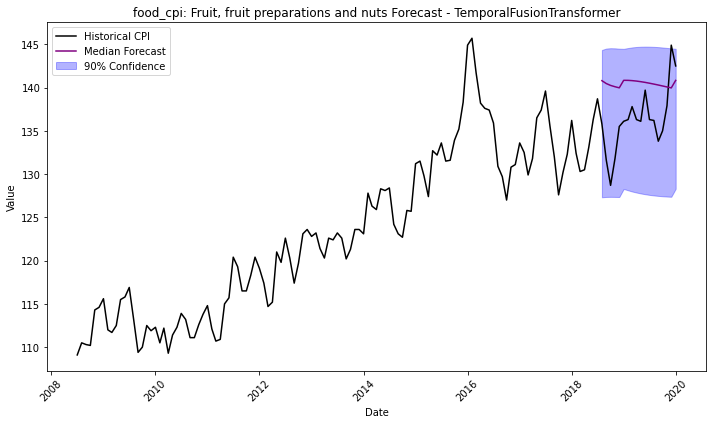

Beginning AutoGluon training... Time limit = 2s
AutoGluon will save models to './output/TEST/ag_global_all_TemporalFusionTransformerModel_exp2_GPT_P1_/random_seed_42/2018-07-01/model_files/'
=================== System Info ===================
AutoGluon Version:  1.1.1
Python Version:     3.8.20
Operating System:   Linux
Platform Machine:   x86_64
Platform Version:   #147~18.04.1-Ubuntu SMP Sat Oct 15 13:10:18 UTC 2022
CPU Count:          32
GPU Count:          1
Memory Avail:       166.77 GB / 188.57 GB (88.4%)
Disk Space Avail:   18210.04 GB / 249006.62 GB (7.3%)

Fitting with arguments:
{'enable_ensemble': True,
 'eval_metric': MAPE,
 'excluded_model_types': ['DirectTabular', 'RecursiveTabular'],
 'hyperparameters': {'TemporalFusionTransformerModel': {}},
 'known_covariates_names': [],
 'num_val_windows': 1,
 'prediction_length': 18,
 'quantile_levels': [0.01, 0.05, 0.1, 0.25, 0.75, 0.9, 0.95, 0.99],
 'random_seed': 42,
 'refit_every_n_windows': 1,
 'refit_full': False,
 'skip_model_

TemporalFusionTransformerModel


	-2.6427       = Validation score (-MAPE)
	2.12    s     = Training runtime
	0.04    s     = Validation (prediction) runtime
Not fitting ensemble due to lack of time remaining. Time left: -0.3 seconds
Training complete. Models trained: ['TemporalFusionTransformer']
Total runtime: 2.21 s
Best model: TemporalFusionTransformer
Best model score: -2.6427
Model not specified in predict, will default to the model with the best validation score: TemporalFusionTransformer
Model not specified in predict, will default to the model with the best validation score: TemporalFusionTransformer


****************** Summary of fit() ******************
Estimated performance of each model:
                       model  score_val  pred_time_val  fit_time_marginal  \
0  TemporalFusionTransformer  -2.642707       0.042659           2.124375   

   fit_order  
0          1  
Number of models trained: 1
Types of models trained:
{'MultiWindowBacktestingModel'}
****************** End of fit() summary ******************


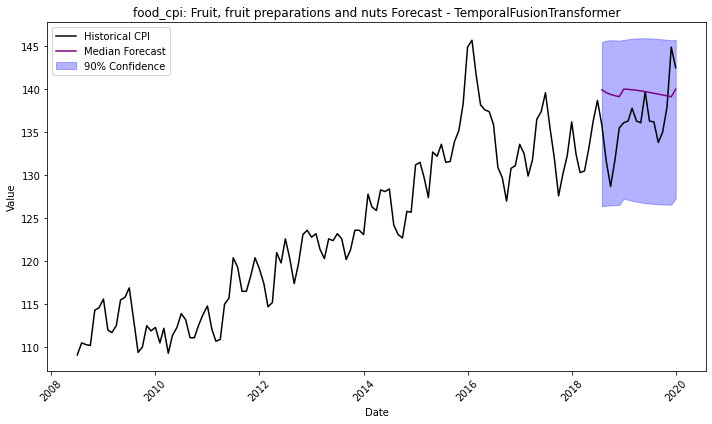

Beginning AutoGluon training... Time limit = 2s
AutoGluon will save models to './output/TEST/ag_global_all_TemporalFusionTransformerModel_exp2_GPT_P4_/random_seed_42/2019-07-01/model_files/'
=================== System Info ===================
AutoGluon Version:  1.1.1
Python Version:     3.8.20
Operating System:   Linux
Platform Machine:   x86_64
Platform Version:   #147~18.04.1-Ubuntu SMP Sat Oct 15 13:10:18 UTC 2022
CPU Count:          32
GPU Count:          1
Memory Avail:       166.83 GB / 188.57 GB (88.5%)
Disk Space Avail:   18210.03 GB / 249006.62 GB (7.3%)

Fitting with arguments:
{'enable_ensemble': True,
 'eval_metric': MAPE,
 'excluded_model_types': ['DirectTabular', 'RecursiveTabular'],
 'hyperparameters': {'TemporalFusionTransformerModel': {}},
 'known_covariates_names': [],
 'num_val_windows': 1,
 'prediction_length': 18,
 'quantile_levels': [0.01, 0.05, 0.1, 0.25, 0.75, 0.9, 0.95, 0.99],
 'random_seed': 42,
 'refit_every_n_windows': 1,
 'refit_full': False,
 'skip_model_

TemporalFusionTransformerModel


	-0.7289       = Validation score (-MAPE)
	2.15    s     = Training runtime
	0.04    s     = Validation (prediction) runtime
Not fitting ensemble due to lack of time remaining. Time left: -0.3 seconds
Training complete. Models trained: ['TemporalFusionTransformer']
Total runtime: 2.23 s
Best model: TemporalFusionTransformer
Best model score: -0.7289
Model not specified in predict, will default to the model with the best validation score: TemporalFusionTransformer
Model not specified in predict, will default to the model with the best validation score: TemporalFusionTransformer


****************** Summary of fit() ******************
Estimated performance of each model:
                       model  score_val  pred_time_val  fit_time_marginal  \
0  TemporalFusionTransformer  -0.728907       0.039246           2.152233   

   fit_order  
0          1  
Number of models trained: 1
Types of models trained:
{'MultiWindowBacktestingModel'}
****************** End of fit() summary ******************


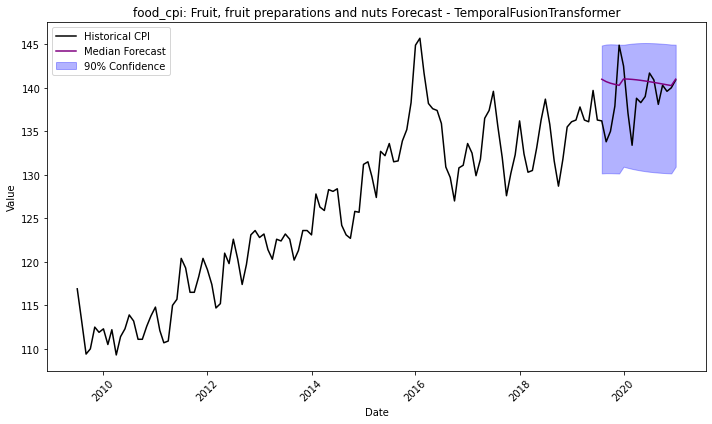

Beginning AutoGluon training... Time limit = 2s
AutoGluon will save models to './output/TEST/ag_global_all_TemporalFusionTransformerModel_exp2_R2_/random_seed_42/2019-07-01/model_files/'
=================== System Info ===================
AutoGluon Version:  1.1.1
Python Version:     3.8.20
Operating System:   Linux
Platform Machine:   x86_64
Platform Version:   #147~18.04.1-Ubuntu SMP Sat Oct 15 13:10:18 UTC 2022
CPU Count:          32
GPU Count:          1
Memory Avail:       166.77 GB / 188.57 GB (88.4%)
Disk Space Avail:   18210.02 GB / 249006.62 GB (7.3%)

Fitting with arguments:
{'enable_ensemble': True,
 'eval_metric': MAPE,
 'excluded_model_types': ['DirectTabular', 'RecursiveTabular'],
 'hyperparameters': {'TemporalFusionTransformerModel': {}},
 'known_covariates_names': [],
 'num_val_windows': 1,
 'prediction_length': 18,
 'quantile_levels': [0.01, 0.05, 0.1, 0.25, 0.75, 0.9, 0.95, 0.99],
 'random_seed': 42,
 'refit_every_n_windows': 1,
 'refit_full': False,
 'skip_model_sele

TemporalFusionTransformerModel


	-0.3728       = Validation score (-MAPE)
	2.15    s     = Training runtime
	0.04    s     = Validation (prediction) runtime
Not fitting ensemble due to lack of time remaining. Time left: -0.3 seconds
Training complete. Models trained: ['TemporalFusionTransformer']
Total runtime: 2.23 s
Best model: TemporalFusionTransformer
Best model score: -0.3728
Model not specified in predict, will default to the model with the best validation score: TemporalFusionTransformer
Model not specified in predict, will default to the model with the best validation score: TemporalFusionTransformer


****************** Summary of fit() ******************
Estimated performance of each model:
                       model  score_val  pred_time_val  fit_time_marginal  \
0  TemporalFusionTransformer  -0.372818       0.043153           2.146406   

   fit_order  
0          1  
Number of models trained: 1
Types of models trained:
{'MultiWindowBacktestingModel'}
****************** End of fit() summary ******************


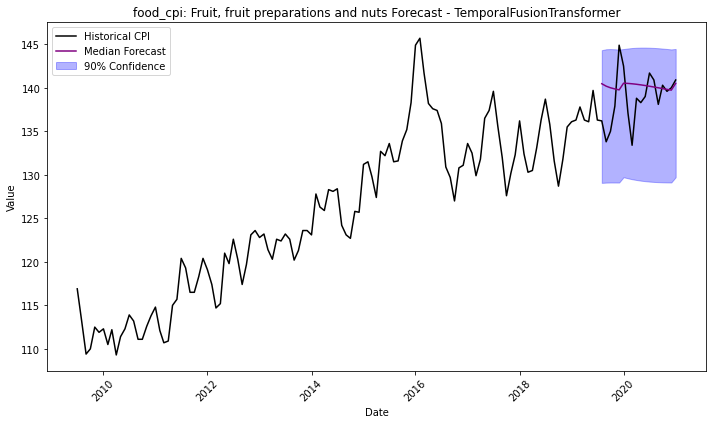

Beginning AutoGluon training... Time limit = 2s
AutoGluon will save models to './output/TEST/ag_global_all_TemporalFusionTransformerModel_exp2_R4_/random_seed_42/2019-07-01/model_files/'
=================== System Info ===================
AutoGluon Version:  1.1.1
Python Version:     3.8.20
Operating System:   Linux
Platform Machine:   x86_64
Platform Version:   #147~18.04.1-Ubuntu SMP Sat Oct 15 13:10:18 UTC 2022
CPU Count:          32
GPU Count:          1
Memory Avail:       166.77 GB / 188.57 GB (88.4%)
Disk Space Avail:   18210.01 GB / 249006.62 GB (7.3%)

Fitting with arguments:
{'enable_ensemble': True,
 'eval_metric': MAPE,
 'excluded_model_types': ['DirectTabular', 'RecursiveTabular'],
 'hyperparameters': {'TemporalFusionTransformerModel': {}},
 'known_covariates_names': [],
 'num_val_windows': 1,
 'prediction_length': 18,
 'quantile_levels': [0.01, 0.05, 0.1, 0.25, 0.75, 0.9, 0.95, 0.99],
 'random_seed': 42,
 'refit_every_n_windows': 1,
 'refit_full': False,
 'skip_model_sele

TemporalFusionTransformerModel


	-0.5612       = Validation score (-MAPE)
	2.14    s     = Training runtime
	0.04    s     = Validation (prediction) runtime
Not fitting ensemble due to lack of time remaining. Time left: -0.3 seconds
Training complete. Models trained: ['TemporalFusionTransformer']
Total runtime: 2.21 s
Best model: TemporalFusionTransformer
Best model score: -0.5612
Model not specified in predict, will default to the model with the best validation score: TemporalFusionTransformer
Model not specified in predict, will default to the model with the best validation score: TemporalFusionTransformer


****************** Summary of fit() ******************
Estimated performance of each model:
                       model  score_val  pred_time_val  fit_time_marginal  \
0  TemporalFusionTransformer  -0.561158       0.044838           2.135862   

   fit_order  
0          1  
Number of models trained: 1
Types of models trained:
{'MultiWindowBacktestingModel'}
****************** End of fit() summary ******************


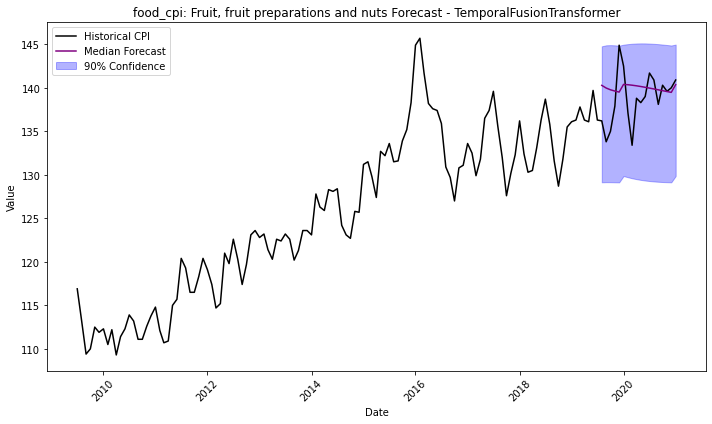

Beginning AutoGluon training... Time limit = 2s
AutoGluon will save models to './output/TEST/ag_global_all_TemporalFusionTransformerModel_exp2_GPT_P3_/random_seed_42/2019-07-01/model_files/'
=================== System Info ===================
AutoGluon Version:  1.1.1
Python Version:     3.8.20
Operating System:   Linux
Platform Machine:   x86_64
Platform Version:   #147~18.04.1-Ubuntu SMP Sat Oct 15 13:10:18 UTC 2022
CPU Count:          32
GPU Count:          1
Memory Avail:       166.77 GB / 188.57 GB (88.4%)
Disk Space Avail:   18210.00 GB / 249006.62 GB (7.3%)

Fitting with arguments:
{'enable_ensemble': True,
 'eval_metric': MAPE,
 'excluded_model_types': ['DirectTabular', 'RecursiveTabular'],
 'hyperparameters': {'TemporalFusionTransformerModel': {}},
 'known_covariates_names': [],
 'num_val_windows': 1,
 'prediction_length': 18,
 'quantile_levels': [0.01, 0.05, 0.1, 0.25, 0.75, 0.9, 0.95, 0.99],
 'random_seed': 42,
 'refit_every_n_windows': 1,
 'refit_full': False,
 'skip_model_

TemporalFusionTransformerModel


	-1.0523       = Validation score (-MAPE)
	2.12    s     = Training runtime
	0.04    s     = Validation (prediction) runtime
Not fitting ensemble due to lack of time remaining. Time left: -0.3 seconds
Training complete. Models trained: ['TemporalFusionTransformer']
Total runtime: 2.21 s
Best model: TemporalFusionTransformer
Best model score: -1.0523
Model not specified in predict, will default to the model with the best validation score: TemporalFusionTransformer
Model not specified in predict, will default to the model with the best validation score: TemporalFusionTransformer


****************** Summary of fit() ******************
Estimated performance of each model:
                       model  score_val  pred_time_val  fit_time_marginal  \
0  TemporalFusionTransformer  -1.052255       0.042825            2.11704   

   fit_order  
0          1  
Number of models trained: 1
Types of models trained:
{'MultiWindowBacktestingModel'}
****************** End of fit() summary ******************


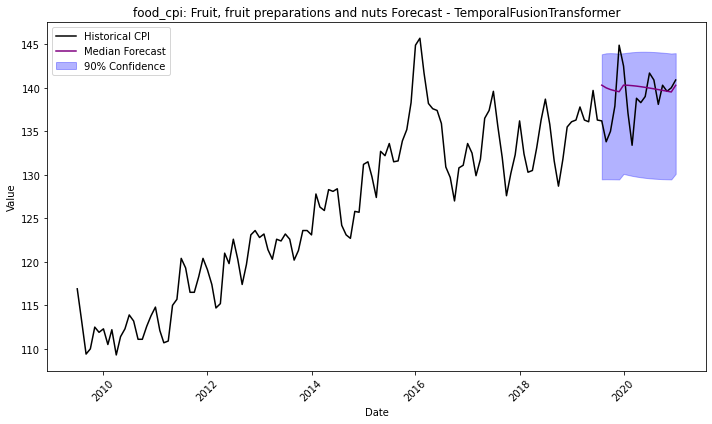

Beginning AutoGluon training... Time limit = 2s
AutoGluon will save models to './output/TEST/ag_global_all_TemporalFusionTransformerModel_exp2_R3_/random_seed_42/2019-07-01/model_files/'
=================== System Info ===================
AutoGluon Version:  1.1.1
Python Version:     3.8.20
Operating System:   Linux
Platform Machine:   x86_64
Platform Version:   #147~18.04.1-Ubuntu SMP Sat Oct 15 13:10:18 UTC 2022
CPU Count:          32
GPU Count:          1
Memory Avail:       166.86 GB / 188.57 GB (88.5%)
Disk Space Avail:   18210.04 GB / 249006.62 GB (7.3%)

Fitting with arguments:
{'enable_ensemble': True,
 'eval_metric': MAPE,
 'excluded_model_types': ['DirectTabular', 'RecursiveTabular'],
 'hyperparameters': {'TemporalFusionTransformerModel': {}},
 'known_covariates_names': [],
 'num_val_windows': 1,
 'prediction_length': 18,
 'quantile_levels': [0.01, 0.05, 0.1, 0.25, 0.75, 0.9, 0.95, 0.99],
 'random_seed': 42,
 'refit_every_n_windows': 1,
 'refit_full': False,
 'skip_model_sele

TemporalFusionTransformerModel


	-0.7058       = Validation score (-MAPE)
	2.13    s     = Training runtime
	0.04    s     = Validation (prediction) runtime
Not fitting ensemble due to lack of time remaining. Time left: -0.3 seconds
Training complete. Models trained: ['TemporalFusionTransformer']
Total runtime: 2.21 s
Best model: TemporalFusionTransformer
Best model score: -0.7058
Model not specified in predict, will default to the model with the best validation score: TemporalFusionTransformer
Model not specified in predict, will default to the model with the best validation score: TemporalFusionTransformer


****************** Summary of fit() ******************
Estimated performance of each model:
                       model  score_val  pred_time_val  fit_time_marginal  \
0  TemporalFusionTransformer  -0.705779       0.042029           2.130294   

   fit_order  
0          1  
Number of models trained: 1
Types of models trained:
{'MultiWindowBacktestingModel'}
****************** End of fit() summary ******************


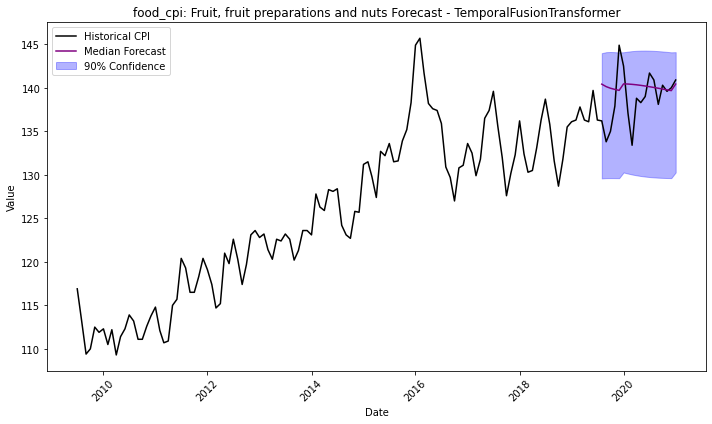

Beginning AutoGluon training... Time limit = 2s
AutoGluon will save models to './output/TEST/ag_global_all_TemporalFusionTransformerModel_exp2_GPT_P2_/random_seed_42/2019-07-01/model_files/'
=================== System Info ===================
AutoGluon Version:  1.1.1
Python Version:     3.8.20
Operating System:   Linux
Platform Machine:   x86_64
Platform Version:   #147~18.04.1-Ubuntu SMP Sat Oct 15 13:10:18 UTC 2022
CPU Count:          32
GPU Count:          1
Memory Avail:       166.89 GB / 188.57 GB (88.5%)
Disk Space Avail:   18210.04 GB / 249006.62 GB (7.3%)

Fitting with arguments:
{'enable_ensemble': True,
 'eval_metric': MAPE,
 'excluded_model_types': ['DirectTabular', 'RecursiveTabular'],
 'hyperparameters': {'TemporalFusionTransformerModel': {}},
 'known_covariates_names': [],
 'num_val_windows': 1,
 'prediction_length': 18,
 'quantile_levels': [0.01, 0.05, 0.1, 0.25, 0.75, 0.9, 0.95, 0.99],
 'random_seed': 42,
 'refit_every_n_windows': 1,
 'refit_full': False,
 'skip_model_

TemporalFusionTransformerModel


	-1.1137       = Validation score (-MAPE)
	2.14    s     = Training runtime
	0.04    s     = Validation (prediction) runtime
Not fitting ensemble due to lack of time remaining. Time left: -0.3 seconds
Training complete. Models trained: ['TemporalFusionTransformer']
Total runtime: 2.22 s
Best model: TemporalFusionTransformer
Best model score: -1.1137
Model not specified in predict, will default to the model with the best validation score: TemporalFusionTransformer
Model not specified in predict, will default to the model with the best validation score: TemporalFusionTransformer


****************** Summary of fit() ******************
Estimated performance of each model:
                       model  score_val  pred_time_val  fit_time_marginal  \
0  TemporalFusionTransformer  -1.113694       0.040166           2.142165   

   fit_order  
0          1  
Number of models trained: 1
Types of models trained:
{'MultiWindowBacktestingModel'}
****************** End of fit() summary ******************


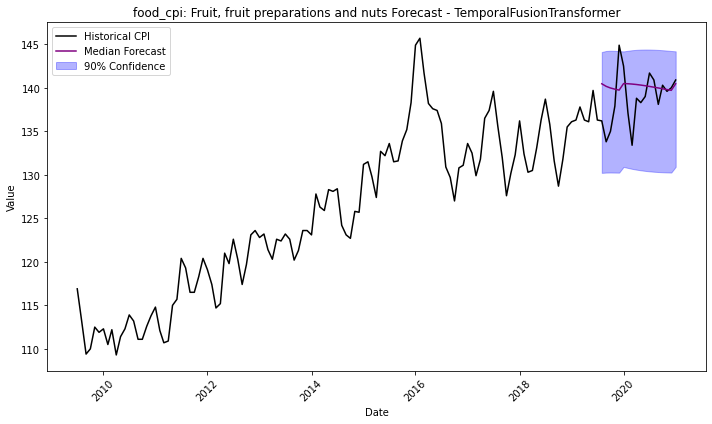

Beginning AutoGluon training... Time limit = 2s
AutoGluon will save models to './output/TEST/ag_global_all_TemporalFusionTransformerModel_exp2_R1_/random_seed_42/2019-07-01/model_files/'
=================== System Info ===================
AutoGluon Version:  1.1.1
Python Version:     3.8.20
Operating System:   Linux
Platform Machine:   x86_64
Platform Version:   #147~18.04.1-Ubuntu SMP Sat Oct 15 13:10:18 UTC 2022
CPU Count:          32
GPU Count:          1
Memory Avail:       166.77 GB / 188.57 GB (88.4%)
Disk Space Avail:   18210.03 GB / 249006.62 GB (7.3%)

Fitting with arguments:
{'enable_ensemble': True,
 'eval_metric': MAPE,
 'excluded_model_types': ['DirectTabular', 'RecursiveTabular'],
 'hyperparameters': {'TemporalFusionTransformerModel': {}},
 'known_covariates_names': [],
 'num_val_windows': 1,
 'prediction_length': 18,
 'quantile_levels': [0.01, 0.05, 0.1, 0.25, 0.75, 0.9, 0.95, 0.99],
 'random_seed': 42,
 'refit_every_n_windows': 1,
 'refit_full': False,
 'skip_model_sele

TemporalFusionTransformerModel


	-0.8055       = Validation score (-MAPE)
	2.12    s     = Training runtime
	0.04    s     = Validation (prediction) runtime
Not fitting ensemble due to lack of time remaining. Time left: -0.3 seconds
Training complete. Models trained: ['TemporalFusionTransformer']
Total runtime: 2.20 s
Best model: TemporalFusionTransformer
Best model score: -0.8055
Model not specified in predict, will default to the model with the best validation score: TemporalFusionTransformer
Model not specified in predict, will default to the model with the best validation score: TemporalFusionTransformer


****************** Summary of fit() ******************
Estimated performance of each model:
                       model  score_val  pred_time_val  fit_time_marginal  \
0  TemporalFusionTransformer  -0.805483       0.043147           2.116134   

   fit_order  
0          1  
Number of models trained: 1
Types of models trained:
{'MultiWindowBacktestingModel'}
****************** End of fit() summary ******************


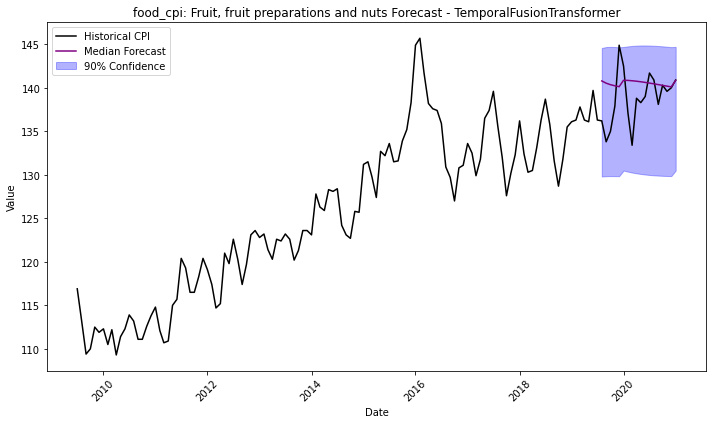

Beginning AutoGluon training... Time limit = 2s
AutoGluon will save models to './output/TEST/ag_global_all_TemporalFusionTransformerModel_exp2_GPT_P1_/random_seed_42/2019-07-01/model_files/'
=================== System Info ===================
AutoGluon Version:  1.1.1
Python Version:     3.8.20
Operating System:   Linux
Platform Machine:   x86_64
Platform Version:   #147~18.04.1-Ubuntu SMP Sat Oct 15 13:10:18 UTC 2022
CPU Count:          32
GPU Count:          1
Memory Avail:       166.77 GB / 188.57 GB (88.4%)
Disk Space Avail:   18210.02 GB / 249006.62 GB (7.3%)

Fitting with arguments:
{'enable_ensemble': True,
 'eval_metric': MAPE,
 'excluded_model_types': ['DirectTabular', 'RecursiveTabular'],
 'hyperparameters': {'TemporalFusionTransformerModel': {}},
 'known_covariates_names': [],
 'num_val_windows': 1,
 'prediction_length': 18,
 'quantile_levels': [0.01, 0.05, 0.1, 0.25, 0.75, 0.9, 0.95, 0.99],
 'random_seed': 42,
 'refit_every_n_windows': 1,
 'refit_full': False,
 'skip_model_

TemporalFusionTransformerModel


	-1.0849       = Validation score (-MAPE)
	2.14    s     = Training runtime
	0.04    s     = Validation (prediction) runtime
Not fitting ensemble due to lack of time remaining. Time left: -0.3 seconds
Training complete. Models trained: ['TemporalFusionTransformer']
Total runtime: 2.23 s
Best model: TemporalFusionTransformer
Best model score: -1.0849
Model not specified in predict, will default to the model with the best validation score: TemporalFusionTransformer
Model not specified in predict, will default to the model with the best validation score: TemporalFusionTransformer


****************** Summary of fit() ******************
Estimated performance of each model:
                       model  score_val  pred_time_val  fit_time_marginal  \
0  TemporalFusionTransformer  -1.084867       0.043377           2.143572   

   fit_order  
0          1  
Number of models trained: 1
Types of models trained:
{'MultiWindowBacktestingModel'}
****************** End of fit() summary ******************


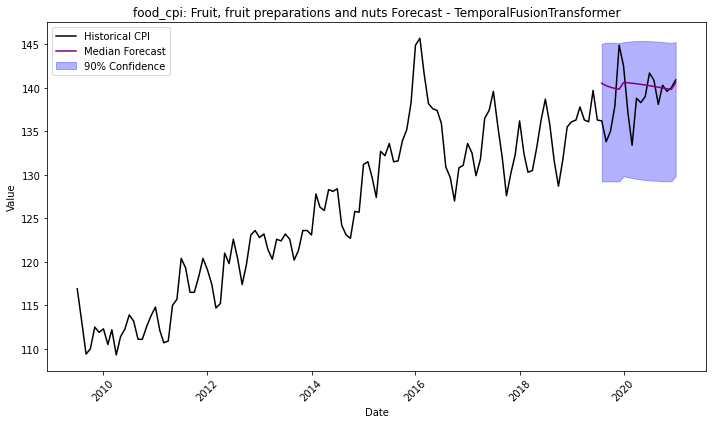

Beginning AutoGluon training... Time limit = 2s
AutoGluon will save models to './output/TEST/ag_global_all_TemporalFusionTransformerModel_exp2_GPT_P4_/random_seed_42/2020-07-01/model_files/'
=================== System Info ===================
AutoGluon Version:  1.1.1
Python Version:     3.8.20
Operating System:   Linux
Platform Machine:   x86_64
Platform Version:   #147~18.04.1-Ubuntu SMP Sat Oct 15 13:10:18 UTC 2022
CPU Count:          32
GPU Count:          1
Memory Avail:       166.77 GB / 188.57 GB (88.4%)
Disk Space Avail:   18210.00 GB / 249006.62 GB (7.3%)

Fitting with arguments:
{'enable_ensemble': True,
 'eval_metric': MAPE,
 'excluded_model_types': ['DirectTabular', 'RecursiveTabular'],
 'hyperparameters': {'TemporalFusionTransformerModel': {}},
 'known_covariates_names': [],
 'num_val_windows': 1,
 'prediction_length': 18,
 'quantile_levels': [0.01, 0.05, 0.1, 0.25, 0.75, 0.9, 0.95, 0.99],
 'random_seed': 42,
 'refit_every_n_windows': 1,
 'refit_full': False,
 'skip_model_

TemporalFusionTransformerModel


	-0.6760       = Validation score (-MAPE)
	2.12    s     = Training runtime
	0.04    s     = Validation (prediction) runtime
Not fitting ensemble due to lack of time remaining. Time left: -0.2 seconds
Training complete. Models trained: ['TemporalFusionTransformer']
Total runtime: 2.19 s
Best model: TemporalFusionTransformer
Best model score: -0.6760
Model not specified in predict, will default to the model with the best validation score: TemporalFusionTransformer
Model not specified in predict, will default to the model with the best validation score: TemporalFusionTransformer


****************** Summary of fit() ******************
Estimated performance of each model:
                       model  score_val  pred_time_val  fit_time_marginal  \
0  TemporalFusionTransformer  -0.675973       0.040217           2.115861   

   fit_order  
0          1  
Number of models trained: 1
Types of models trained:
{'MultiWindowBacktestingModel'}
****************** End of fit() summary ******************


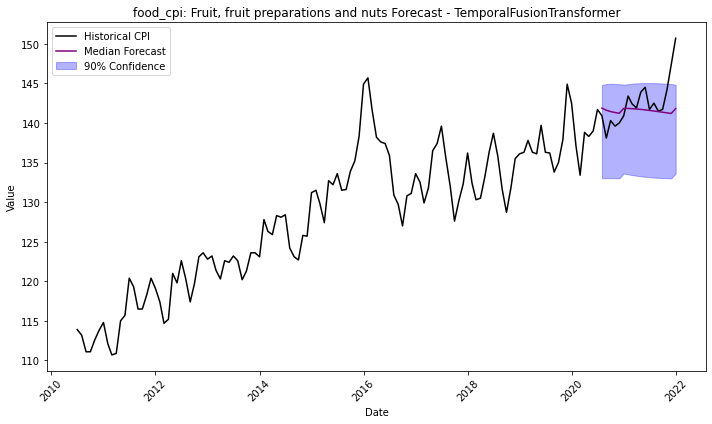

Beginning AutoGluon training... Time limit = 2s
AutoGluon will save models to './output/TEST/ag_global_all_TemporalFusionTransformerModel_exp2_R2_/random_seed_42/2020-07-01/model_files/'
=================== System Info ===================
AutoGluon Version:  1.1.1
Python Version:     3.8.20
Operating System:   Linux
Platform Machine:   x86_64
Platform Version:   #147~18.04.1-Ubuntu SMP Sat Oct 15 13:10:18 UTC 2022
CPU Count:          32
GPU Count:          1
Memory Avail:       166.80 GB / 188.57 GB (88.5%)
Disk Space Avail:   18210.00 GB / 249006.62 GB (7.3%)

Fitting with arguments:
{'enable_ensemble': True,
 'eval_metric': MAPE,
 'excluded_model_types': ['DirectTabular', 'RecursiveTabular'],
 'hyperparameters': {'TemporalFusionTransformerModel': {}},
 'known_covariates_names': [],
 'num_val_windows': 1,
 'prediction_length': 18,
 'quantile_levels': [0.01, 0.05, 0.1, 0.25, 0.75, 0.9, 0.95, 0.99],
 'random_seed': 42,
 'refit_every_n_windows': 1,
 'refit_full': False,
 'skip_model_sele

TemporalFusionTransformerModel


Inferred time series frequency: 'MS'
Provided train_data has 9130 rows (NaN fraction=0.1%), 22 time series. Median time series length is 415 (min=415, max=415). 

Provided data contains following columns:
	target: 'target'

AutoGluon will gauge predictive performance using evaluation metric: 'MAPE'
	This metric's sign has been flipped to adhere to being higher_is_better. The metric score can be multiplied by -1 to get the metric value.

Starting training. Start time is 2024-10-27 07:40:57
Excluded model types: ['DirectTabular', 'RecursiveTabular']
Models that will be trained: ['TemporalFusionTransformer']
Training timeseries model TemporalFusionTransformer. Training for up to 1.6s of the 1.6s of remaining time.
	-0.3780       = Validation score (-MAPE)
	1.84    s     = Training runtime
	0.04    s     = Validation (prediction) runtime
Not fitting ensemble due to lack of time remaining. Time left: -0.3 seconds
Training complete. Models trained: ['TemporalFusionTransformer']
Total runtime

****************** Summary of fit() ******************
Estimated performance of each model:
                       model  score_val  pred_time_val  fit_time_marginal  \
0  TemporalFusionTransformer  -0.377958       0.042285           1.843948   

   fit_order  
0          1  
Number of models trained: 1
Types of models trained:
{'MultiWindowBacktestingModel'}
****************** End of fit() summary ******************


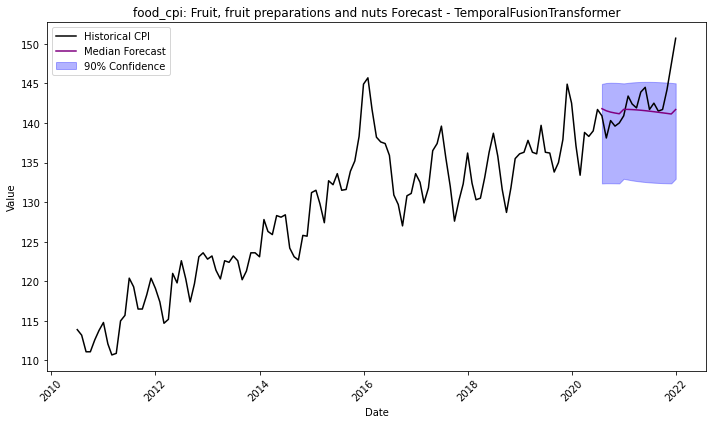

Beginning AutoGluon training... Time limit = 2s
AutoGluon will save models to './output/TEST/ag_global_all_TemporalFusionTransformerModel_exp2_R4_/random_seed_42/2020-07-01/model_files/'
=================== System Info ===================
AutoGluon Version:  1.1.1
Python Version:     3.8.20
Operating System:   Linux
Platform Machine:   x86_64
Platform Version:   #147~18.04.1-Ubuntu SMP Sat Oct 15 13:10:18 UTC 2022
CPU Count:          32
GPU Count:          1
Memory Avail:       166.77 GB / 188.57 GB (88.4%)
Disk Space Avail:   18210.04 GB / 249006.62 GB (7.3%)

Fitting with arguments:
{'enable_ensemble': True,
 'eval_metric': MAPE,
 'excluded_model_types': ['DirectTabular', 'RecursiveTabular'],
 'hyperparameters': {'TemporalFusionTransformerModel': {}},
 'known_covariates_names': [],
 'num_val_windows': 1,
 'prediction_length': 18,
 'quantile_levels': [0.01, 0.05, 0.1, 0.25, 0.75, 0.9, 0.95, 0.99],
 'random_seed': 42,
 'refit_every_n_windows': 1,
 'refit_full': False,
 'skip_model_sele

TemporalFusionTransformerModel


	-0.5169       = Validation score (-MAPE)
	2.14    s     = Training runtime
	0.05    s     = Validation (prediction) runtime
Not fitting ensemble due to lack of time remaining. Time left: -0.3 seconds
Training complete. Models trained: ['TemporalFusionTransformer']
Total runtime: 2.22 s
Best model: TemporalFusionTransformer
Best model score: -0.5169
Model not specified in predict, will default to the model with the best validation score: TemporalFusionTransformer
Model not specified in predict, will default to the model with the best validation score: TemporalFusionTransformer


****************** Summary of fit() ******************
Estimated performance of each model:
                       model  score_val  pred_time_val  fit_time_marginal  \
0  TemporalFusionTransformer  -0.516923        0.04667           2.137666   

   fit_order  
0          1  
Number of models trained: 1
Types of models trained:
{'MultiWindowBacktestingModel'}
****************** End of fit() summary ******************


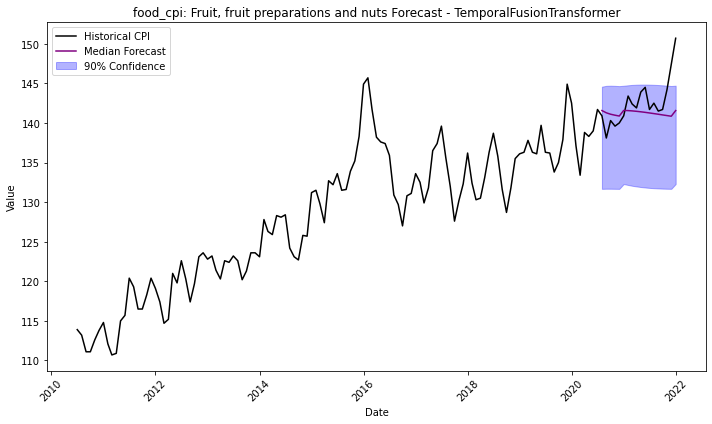

Beginning AutoGluon training... Time limit = 2s
AutoGluon will save models to './output/TEST/ag_global_all_TemporalFusionTransformerModel_exp2_GPT_P3_/random_seed_42/2020-07-01/model_files/'
=================== System Info ===================
AutoGluon Version:  1.1.1
Python Version:     3.8.20
Operating System:   Linux
Platform Machine:   x86_64
Platform Version:   #147~18.04.1-Ubuntu SMP Sat Oct 15 13:10:18 UTC 2022
CPU Count:          32
GPU Count:          1
Memory Avail:       166.77 GB / 188.57 GB (88.4%)
Disk Space Avail:   18210.04 GB / 249006.62 GB (7.3%)

Fitting with arguments:
{'enable_ensemble': True,
 'eval_metric': MAPE,
 'excluded_model_types': ['DirectTabular', 'RecursiveTabular'],
 'hyperparameters': {'TemporalFusionTransformerModel': {}},
 'known_covariates_names': [],
 'num_val_windows': 1,
 'prediction_length': 18,
 'quantile_levels': [0.01, 0.05, 0.1, 0.25, 0.75, 0.9, 0.95, 0.99],
 'random_seed': 42,
 'refit_every_n_windows': 1,
 'refit_full': False,
 'skip_model_

TemporalFusionTransformerModel


	-0.8338       = Validation score (-MAPE)
	2.13    s     = Training runtime
	0.05    s     = Validation (prediction) runtime
Not fitting ensemble due to lack of time remaining. Time left: -0.3 seconds
Training complete. Models trained: ['TemporalFusionTransformer']
Total runtime: 2.21 s
Best model: TemporalFusionTransformer
Best model score: -0.8338
Model not specified in predict, will default to the model with the best validation score: TemporalFusionTransformer
Model not specified in predict, will default to the model with the best validation score: TemporalFusionTransformer


****************** Summary of fit() ******************
Estimated performance of each model:
                       model  score_val  pred_time_val  fit_time_marginal  \
0  TemporalFusionTransformer  -0.833757       0.045106           2.126911   

   fit_order  
0          1  
Number of models trained: 1
Types of models trained:
{'MultiWindowBacktestingModel'}
****************** End of fit() summary ******************


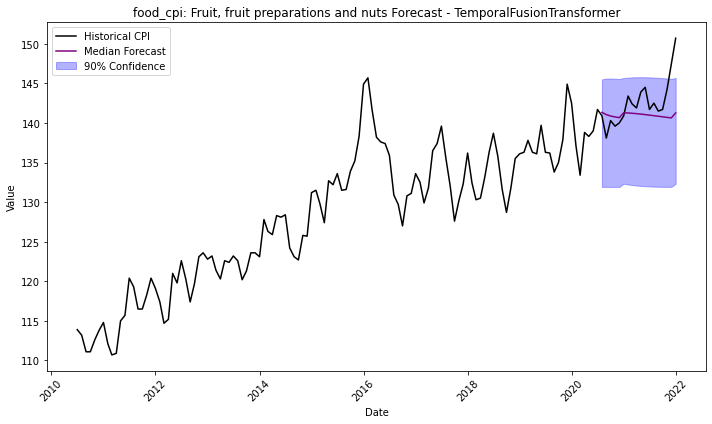

Beginning AutoGluon training... Time limit = 2s
AutoGluon will save models to './output/TEST/ag_global_all_TemporalFusionTransformerModel_exp2_R3_/random_seed_42/2020-07-01/model_files/'
=================== System Info ===================
AutoGluon Version:  1.1.1
Python Version:     3.8.20
Operating System:   Linux
Platform Machine:   x86_64
Platform Version:   #147~18.04.1-Ubuntu SMP Sat Oct 15 13:10:18 UTC 2022
CPU Count:          32
GPU Count:          1
Memory Avail:       166.77 GB / 188.57 GB (88.4%)
Disk Space Avail:   18210.02 GB / 249006.62 GB (7.3%)

Fitting with arguments:
{'enable_ensemble': True,
 'eval_metric': MAPE,
 'excluded_model_types': ['DirectTabular', 'RecursiveTabular'],
 'hyperparameters': {'TemporalFusionTransformerModel': {}},
 'known_covariates_names': [],
 'num_val_windows': 1,
 'prediction_length': 18,
 'quantile_levels': [0.01, 0.05, 0.1, 0.25, 0.75, 0.9, 0.95, 0.99],
 'random_seed': 42,
 'refit_every_n_windows': 1,
 'refit_full': False,
 'skip_model_sele

TemporalFusionTransformerModel


	-0.5826       = Validation score (-MAPE)
	2.12    s     = Training runtime
	0.04    s     = Validation (prediction) runtime
Not fitting ensemble due to lack of time remaining. Time left: -0.3 seconds
Training complete. Models trained: ['TemporalFusionTransformer']
Total runtime: 2.20 s
Best model: TemporalFusionTransformer
Best model score: -0.5826
Model not specified in predict, will default to the model with the best validation score: TemporalFusionTransformer
Model not specified in predict, will default to the model with the best validation score: TemporalFusionTransformer


****************** Summary of fit() ******************
Estimated performance of each model:
                       model  score_val  pred_time_val  fit_time_marginal  \
0  TemporalFusionTransformer  -0.582616       0.043102           2.122483   

   fit_order  
0          1  
Number of models trained: 1
Types of models trained:
{'MultiWindowBacktestingModel'}
****************** End of fit() summary ******************


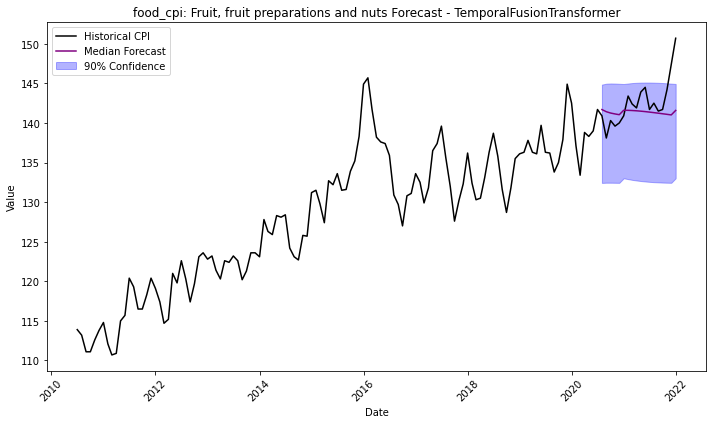

Beginning AutoGluon training... Time limit = 2s
AutoGluon will save models to './output/TEST/ag_global_all_TemporalFusionTransformerModel_exp2_GPT_P2_/random_seed_42/2020-07-01/model_files/'
=================== System Info ===================
AutoGluon Version:  1.1.1
Python Version:     3.8.20
Operating System:   Linux
Platform Machine:   x86_64
Platform Version:   #147~18.04.1-Ubuntu SMP Sat Oct 15 13:10:18 UTC 2022
CPU Count:          32
GPU Count:          1
Memory Avail:       166.77 GB / 188.57 GB (88.4%)
Disk Space Avail:   18210.02 GB / 249006.62 GB (7.3%)

Fitting with arguments:
{'enable_ensemble': True,
 'eval_metric': MAPE,
 'excluded_model_types': ['DirectTabular', 'RecursiveTabular'],
 'hyperparameters': {'TemporalFusionTransformerModel': {}},
 'known_covariates_names': [],
 'num_val_windows': 1,
 'prediction_length': 18,
 'quantile_levels': [0.01, 0.05, 0.1, 0.25, 0.75, 0.9, 0.95, 0.99],
 'random_seed': 42,
 'refit_every_n_windows': 1,
 'refit_full': False,
 'skip_model_

TemporalFusionTransformerModel


	-0.9737       = Validation score (-MAPE)
	2.16    s     = Training runtime
	0.04    s     = Validation (prediction) runtime
Not fitting ensemble due to lack of time remaining. Time left: -0.3 seconds
Training complete. Models trained: ['TemporalFusionTransformer']
Total runtime: 2.24 s
Best model: TemporalFusionTransformer
Best model score: -0.9737
Model not specified in predict, will default to the model with the best validation score: TemporalFusionTransformer
Model not specified in predict, will default to the model with the best validation score: TemporalFusionTransformer


****************** Summary of fit() ******************
Estimated performance of each model:
                       model  score_val  pred_time_val  fit_time_marginal  \
0  TemporalFusionTransformer  -0.973651       0.040308           2.156656   

   fit_order  
0          1  
Number of models trained: 1
Types of models trained:
{'MultiWindowBacktestingModel'}
****************** End of fit() summary ******************


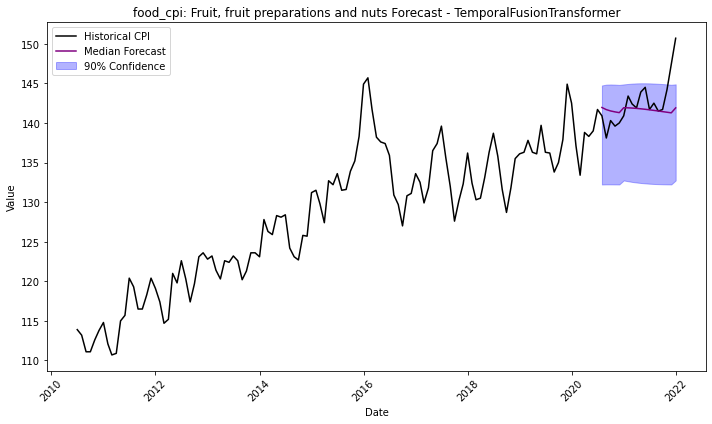

Beginning AutoGluon training... Time limit = 2s
AutoGluon will save models to './output/TEST/ag_global_all_TemporalFusionTransformerModel_exp2_R1_/random_seed_42/2020-07-01/model_files/'
=================== System Info ===================
AutoGluon Version:  1.1.1
Python Version:     3.8.20
Operating System:   Linux
Platform Machine:   x86_64
Platform Version:   #147~18.04.1-Ubuntu SMP Sat Oct 15 13:10:18 UTC 2022
CPU Count:          32
GPU Count:          1
Memory Avail:       166.77 GB / 188.57 GB (88.4%)
Disk Space Avail:   18210.01 GB / 249006.62 GB (7.3%)

Fitting with arguments:
{'enable_ensemble': True,
 'eval_metric': MAPE,
 'excluded_model_types': ['DirectTabular', 'RecursiveTabular'],
 'hyperparameters': {'TemporalFusionTransformerModel': {}},
 'known_covariates_names': [],
 'num_val_windows': 1,
 'prediction_length': 18,
 'quantile_levels': [0.01, 0.05, 0.1, 0.25, 0.75, 0.9, 0.95, 0.99],
 'random_seed': 42,
 'refit_every_n_windows': 1,
 'refit_full': False,
 'skip_model_sele

TemporalFusionTransformerModel


	-2.6318       = Validation score (-MAPE)
	2.13    s     = Training runtime
	0.04    s     = Validation (prediction) runtime
Not fitting ensemble due to lack of time remaining. Time left: -0.6 seconds
Training complete. Models trained: ['TemporalFusionTransformer']
Total runtime: 2.55 s
Best model: TemporalFusionTransformer
Best model score: -2.6318
Model not specified in predict, will default to the model with the best validation score: TemporalFusionTransformer
Model not specified in predict, will default to the model with the best validation score: TemporalFusionTransformer


****************** Summary of fit() ******************
Estimated performance of each model:
                       model  score_val  pred_time_val  fit_time_marginal  \
0  TemporalFusionTransformer  -2.631774       0.042174           2.129333   

   fit_order  
0          1  
Number of models trained: 1
Types of models trained:
{'MultiWindowBacktestingModel'}
****************** End of fit() summary ******************


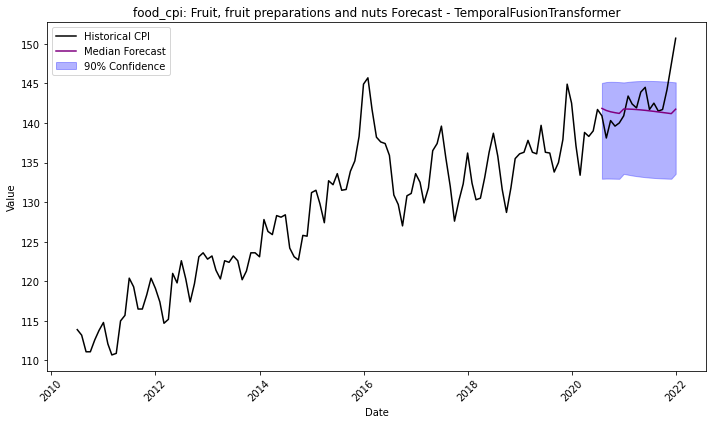

Beginning AutoGluon training... Time limit = 2s
AutoGluon will save models to './output/TEST/ag_global_all_TemporalFusionTransformerModel_exp2_GPT_P1_/random_seed_42/2020-07-01/model_files/'
=================== System Info ===================
AutoGluon Version:  1.1.1
Python Version:     3.8.20
Operating System:   Linux
Platform Machine:   x86_64
Platform Version:   #147~18.04.1-Ubuntu SMP Sat Oct 15 13:10:18 UTC 2022
CPU Count:          32
GPU Count:          1
Memory Avail:       166.88 GB / 188.57 GB (88.5%)
Disk Space Avail:   18210.00 GB / 249006.62 GB (7.3%)

Fitting with arguments:
{'enable_ensemble': True,
 'eval_metric': MAPE,
 'excluded_model_types': ['DirectTabular', 'RecursiveTabular'],
 'hyperparameters': {'TemporalFusionTransformerModel': {}},
 'known_covariates_names': [],
 'num_val_windows': 1,
 'prediction_length': 18,
 'quantile_levels': [0.01, 0.05, 0.1, 0.25, 0.75, 0.9, 0.95, 0.99],
 'random_seed': 42,
 'refit_every_n_windows': 1,
 'refit_full': False,
 'skip_model_

TemporalFusionTransformerModel


	-0.8241       = Validation score (-MAPE)
	2.13    s     = Training runtime
	0.04    s     = Validation (prediction) runtime
Not fitting ensemble due to lack of time remaining. Time left: -0.3 seconds
Training complete. Models trained: ['TemporalFusionTransformer']
Total runtime: 2.22 s
Best model: TemporalFusionTransformer
Best model score: -0.8241
Model not specified in predict, will default to the model with the best validation score: TemporalFusionTransformer
Model not specified in predict, will default to the model with the best validation score: TemporalFusionTransformer


****************** Summary of fit() ******************
Estimated performance of each model:
                       model  score_val  pred_time_val  fit_time_marginal  \
0  TemporalFusionTransformer  -0.824108       0.042515           2.127383   

   fit_order  
0          1  
Number of models trained: 1
Types of models trained:
{'MultiWindowBacktestingModel'}
****************** End of fit() summary ******************


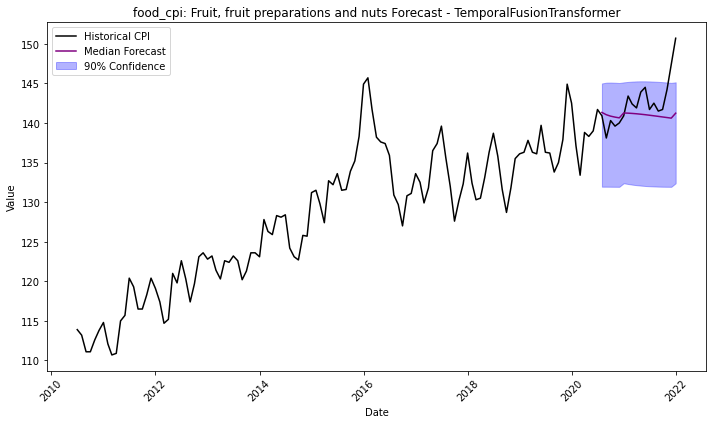

Beginning AutoGluon training... Time limit = 2s
AutoGluon will save models to './output/TEST/ag_global_all_TemporalFusionTransformerModel_exp2_GPT_P4_/random_seed_42/2021-07-01/model_files/'
=================== System Info ===================
AutoGluon Version:  1.1.1
Python Version:     3.8.20
Operating System:   Linux
Platform Machine:   x86_64
Platform Version:   #147~18.04.1-Ubuntu SMP Sat Oct 15 13:10:18 UTC 2022
CPU Count:          32
GPU Count:          1
Memory Avail:       166.77 GB / 188.57 GB (88.4%)
Disk Space Avail:   18210.05 GB / 249006.62 GB (7.3%)

Fitting with arguments:
{'enable_ensemble': True,
 'eval_metric': MAPE,
 'excluded_model_types': ['DirectTabular', 'RecursiveTabular'],
 'hyperparameters': {'TemporalFusionTransformerModel': {}},
 'known_covariates_names': [],
 'num_val_windows': 1,
 'prediction_length': 18,
 'quantile_levels': [0.01, 0.05, 0.1, 0.25, 0.75, 0.9, 0.95, 0.99],
 'random_seed': 42,
 'refit_every_n_windows': 1,
 'refit_full': False,
 'skip_model_

TemporalFusionTransformerModel


	-0.8915       = Validation score (-MAPE)
	2.15    s     = Training runtime
	0.04    s     = Validation (prediction) runtime
Not fitting ensemble due to lack of time remaining. Time left: -0.3 seconds
Training complete. Models trained: ['TemporalFusionTransformer']
Total runtime: 2.22 s
Best model: TemporalFusionTransformer
Best model score: -0.8915
Model not specified in predict, will default to the model with the best validation score: TemporalFusionTransformer
Model not specified in predict, will default to the model with the best validation score: TemporalFusionTransformer


****************** Summary of fit() ******************
Estimated performance of each model:
                       model  score_val  pred_time_val  fit_time_marginal  \
0  TemporalFusionTransformer  -0.891475       0.038737           2.147624   

   fit_order  
0          1  
Number of models trained: 1
Types of models trained:
{'MultiWindowBacktestingModel'}
****************** End of fit() summary ******************


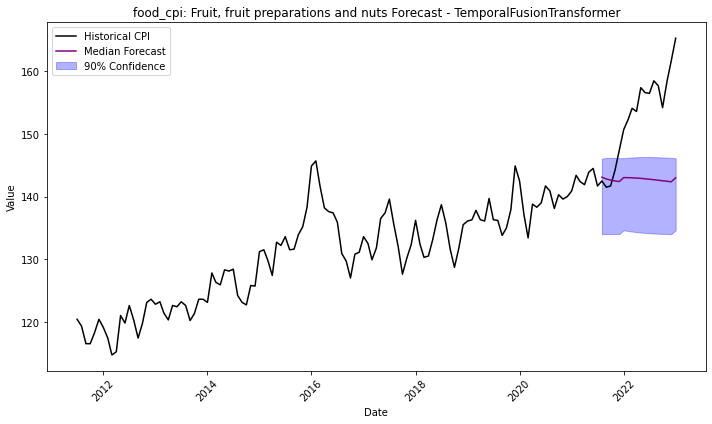

Beginning AutoGluon training... Time limit = 2s
AutoGluon will save models to './output/TEST/ag_global_all_TemporalFusionTransformerModel_exp2_R2_/random_seed_42/2021-07-01/model_files/'
=================== System Info ===================
AutoGluon Version:  1.1.1
Python Version:     3.8.20
Operating System:   Linux
Platform Machine:   x86_64
Platform Version:   #147~18.04.1-Ubuntu SMP Sat Oct 15 13:10:18 UTC 2022
CPU Count:          32
GPU Count:          1
Memory Avail:       166.89 GB / 188.57 GB (88.5%)
Disk Space Avail:   18210.04 GB / 249006.62 GB (7.3%)

Fitting with arguments:
{'enable_ensemble': True,
 'eval_metric': MAPE,
 'excluded_model_types': ['DirectTabular', 'RecursiveTabular'],
 'hyperparameters': {'TemporalFusionTransformerModel': {}},
 'known_covariates_names': [],
 'num_val_windows': 1,
 'prediction_length': 18,
 'quantile_levels': [0.01, 0.05, 0.1, 0.25, 0.75, 0.9, 0.95, 0.99],
 'random_seed': 42,
 'refit_every_n_windows': 1,
 'refit_full': False,
 'skip_model_sele

TemporalFusionTransformerModel


	-0.5388       = Validation score (-MAPE)
	2.12    s     = Training runtime
	0.04    s     = Validation (prediction) runtime
Not fitting ensemble due to lack of time remaining. Time left: -0.3 seconds
Training complete. Models trained: ['TemporalFusionTransformer']
Total runtime: 2.19 s
Best model: TemporalFusionTransformer
Best model score: -0.5388
Model not specified in predict, will default to the model with the best validation score: TemporalFusionTransformer
Model not specified in predict, will default to the model with the best validation score: TemporalFusionTransformer


****************** Summary of fit() ******************
Estimated performance of each model:
                       model  score_val  pred_time_val  fit_time_marginal  \
0  TemporalFusionTransformer  -0.538765       0.041859           2.117362   

   fit_order  
0          1  
Number of models trained: 1
Types of models trained:
{'MultiWindowBacktestingModel'}
****************** End of fit() summary ******************


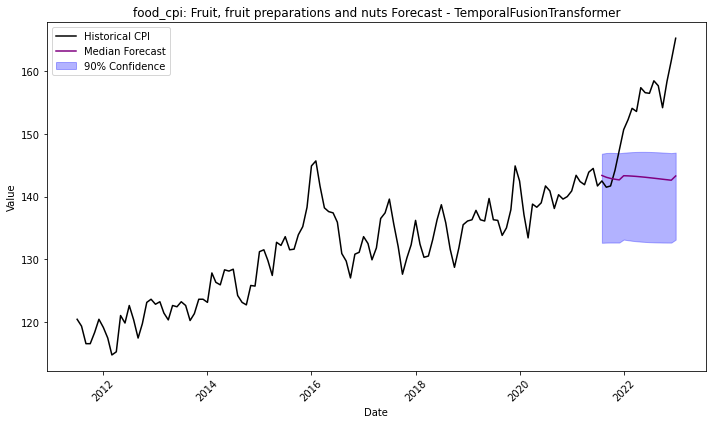

Beginning AutoGluon training... Time limit = 2s
AutoGluon will save models to './output/TEST/ag_global_all_TemporalFusionTransformerModel_exp2_R4_/random_seed_42/2021-07-01/model_files/'
=================== System Info ===================
AutoGluon Version:  1.1.1
Python Version:     3.8.20
Operating System:   Linux
Platform Machine:   x86_64
Platform Version:   #147~18.04.1-Ubuntu SMP Sat Oct 15 13:10:18 UTC 2022
CPU Count:          32
GPU Count:          1
Memory Avail:       166.77 GB / 188.57 GB (88.4%)
Disk Space Avail:   18210.03 GB / 249006.62 GB (7.3%)

Fitting with arguments:
{'enable_ensemble': True,
 'eval_metric': MAPE,
 'excluded_model_types': ['DirectTabular', 'RecursiveTabular'],
 'hyperparameters': {'TemporalFusionTransformerModel': {}},
 'known_covariates_names': [],
 'num_val_windows': 1,
 'prediction_length': 18,
 'quantile_levels': [0.01, 0.05, 0.1, 0.25, 0.75, 0.9, 0.95, 0.99],
 'random_seed': 42,
 'refit_every_n_windows': 1,
 'refit_full': False,
 'skip_model_sele

TemporalFusionTransformerModel


	-0.7030       = Validation score (-MAPE)
	2.12    s     = Training runtime
	0.04    s     = Validation (prediction) runtime
Not fitting ensemble due to lack of time remaining. Time left: -0.3 seconds
Training complete. Models trained: ['TemporalFusionTransformer']
Total runtime: 2.20 s
Best model: TemporalFusionTransformer
Best model score: -0.7030
Model not specified in predict, will default to the model with the best validation score: TemporalFusionTransformer
Model not specified in predict, will default to the model with the best validation score: TemporalFusionTransformer


****************** Summary of fit() ******************
Estimated performance of each model:
                       model  score_val  pred_time_val  fit_time_marginal  \
0  TemporalFusionTransformer     -0.703       0.042249           2.120465   

   fit_order  
0          1  
Number of models trained: 1
Types of models trained:
{'MultiWindowBacktestingModel'}
****************** End of fit() summary ******************


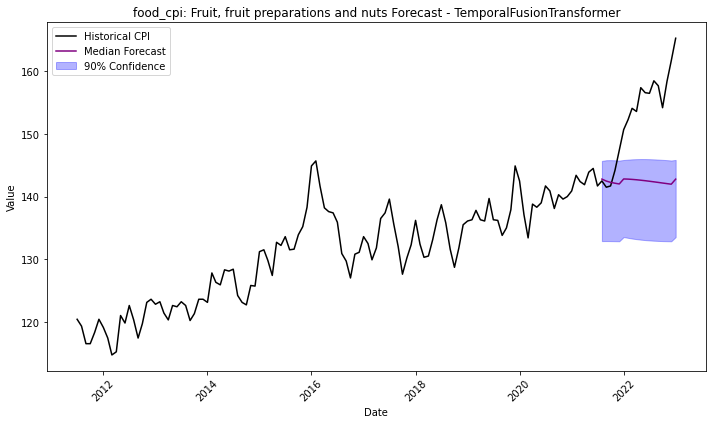

Beginning AutoGluon training... Time limit = 2s
AutoGluon will save models to './output/TEST/ag_global_all_TemporalFusionTransformerModel_exp2_GPT_P3_/random_seed_42/2021-07-01/model_files/'
=================== System Info ===================
AutoGluon Version:  1.1.1
Python Version:     3.8.20
Operating System:   Linux
Platform Machine:   x86_64
Platform Version:   #147~18.04.1-Ubuntu SMP Sat Oct 15 13:10:18 UTC 2022
CPU Count:          32
GPU Count:          1
Memory Avail:       166.77 GB / 188.57 GB (88.4%)
Disk Space Avail:   18210.02 GB / 249006.62 GB (7.3%)

Fitting with arguments:
{'enable_ensemble': True,
 'eval_metric': MAPE,
 'excluded_model_types': ['DirectTabular', 'RecursiveTabular'],
 'hyperparameters': {'TemporalFusionTransformerModel': {}},
 'known_covariates_names': [],
 'num_val_windows': 1,
 'prediction_length': 18,
 'quantile_levels': [0.01, 0.05, 0.1, 0.25, 0.75, 0.9, 0.95, 0.99],
 'random_seed': 42,
 'refit_every_n_windows': 1,
 'refit_full': False,
 'skip_model_

TemporalFusionTransformerModel


	-1.1534       = Validation score (-MAPE)
	2.23    s     = Training runtime
	0.04    s     = Validation (prediction) runtime
Not fitting ensemble due to lack of time remaining. Time left: -0.4 seconds
Training complete. Models trained: ['TemporalFusionTransformer']
Total runtime: 2.31 s
Best model: TemporalFusionTransformer
Best model score: -1.1534
Model not specified in predict, will default to the model with the best validation score: TemporalFusionTransformer
Model not specified in predict, will default to the model with the best validation score: TemporalFusionTransformer


****************** Summary of fit() ******************
Estimated performance of each model:
                       model  score_val  pred_time_val  fit_time_marginal  \
0  TemporalFusionTransformer  -1.153416       0.043093           2.227642   

   fit_order  
0          1  
Number of models trained: 1
Types of models trained:
{'MultiWindowBacktestingModel'}
****************** End of fit() summary ******************


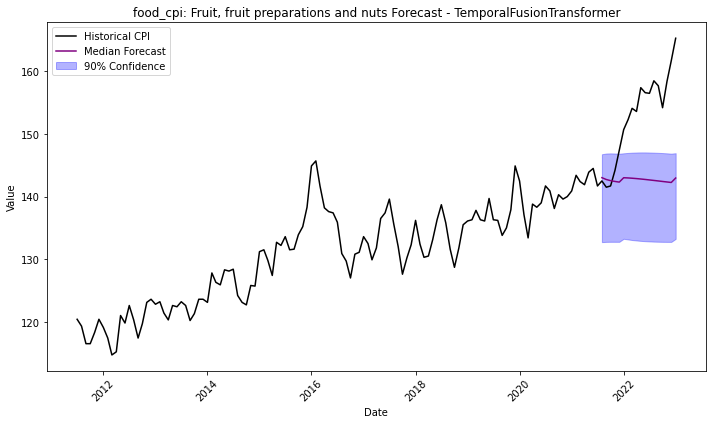

Beginning AutoGluon training... Time limit = 2s
AutoGluon will save models to './output/TEST/ag_global_all_TemporalFusionTransformerModel_exp2_R3_/random_seed_42/2021-07-01/model_files/'
=================== System Info ===================
AutoGluon Version:  1.1.1
Python Version:     3.8.20
Operating System:   Linux
Platform Machine:   x86_64
Platform Version:   #147~18.04.1-Ubuntu SMP Sat Oct 15 13:10:18 UTC 2022
CPU Count:          32
GPU Count:          1
Memory Avail:       166.85 GB / 188.57 GB (88.5%)
Disk Space Avail:   18208.73 GB / 249006.62 GB (7.3%)

Fitting with arguments:
{'enable_ensemble': True,
 'eval_metric': MAPE,
 'excluded_model_types': ['DirectTabular', 'RecursiveTabular'],
 'hyperparameters': {'TemporalFusionTransformerModel': {}},
 'known_covariates_names': [],
 'num_val_windows': 1,
 'prediction_length': 18,
 'quantile_levels': [0.01, 0.05, 0.1, 0.25, 0.75, 0.9, 0.95, 0.99],
 'random_seed': 42,
 'refit_every_n_windows': 1,
 'refit_full': False,
 'skip_model_sele

TemporalFusionTransformerModel


Inferred time series frequency: 'MS'
Provided train_data has 9394 rows (NaN fraction=0.1%), 22 time series. Median time series length is 427 (min=427, max=427). 

Provided data contains following columns:
	target: 'target'

AutoGluon will gauge predictive performance using evaluation metric: 'MAPE'
	This metric's sign has been flipped to adhere to being higher_is_better. The metric score can be multiplied by -1 to get the metric value.

Starting training. Start time is 2024-10-27 07:41:29
Excluded model types: ['DirectTabular', 'RecursiveTabular']
Models that will be trained: ['TemporalFusionTransformer']
Training timeseries model TemporalFusionTransformer. Training for up to 1.6s of the 1.6s of remaining time.
	-0.7052       = Validation score (-MAPE)
	1.86    s     = Training runtime
	0.04    s     = Validation (prediction) runtime
Not fitting ensemble due to lack of time remaining. Time left: -0.3 seconds
Training complete. Models trained: ['TemporalFusionTransformer']
Total runtime

****************** Summary of fit() ******************
Estimated performance of each model:
                       model  score_val  pred_time_val  fit_time_marginal  \
0  TemporalFusionTransformer  -0.705234       0.042822           1.858333   

   fit_order  
0          1  
Number of models trained: 1
Types of models trained:
{'MultiWindowBacktestingModel'}
****************** End of fit() summary ******************


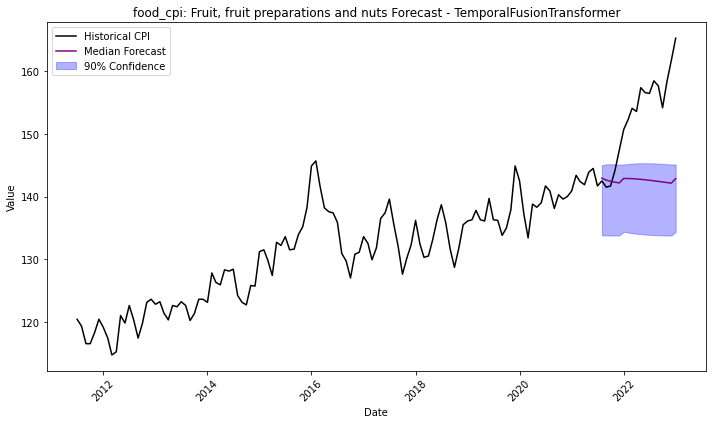

Beginning AutoGluon training... Time limit = 2s
AutoGluon will save models to './output/TEST/ag_global_all_TemporalFusionTransformerModel_exp2_GPT_P2_/random_seed_42/2021-07-01/model_files/'
=================== System Info ===================
AutoGluon Version:  1.1.1
Python Version:     3.8.20
Operating System:   Linux
Platform Machine:   x86_64
Platform Version:   #147~18.04.1-Ubuntu SMP Sat Oct 15 13:10:18 UTC 2022
CPU Count:          32
GPU Count:          1
Memory Avail:       166.77 GB / 188.57 GB (88.4%)
Disk Space Avail:   18208.81 GB / 249006.62 GB (7.3%)

Fitting with arguments:
{'enable_ensemble': True,
 'eval_metric': MAPE,
 'excluded_model_types': ['DirectTabular', 'RecursiveTabular'],
 'hyperparameters': {'TemporalFusionTransformerModel': {}},
 'known_covariates_names': [],
 'num_val_windows': 1,
 'prediction_length': 18,
 'quantile_levels': [0.01, 0.05, 0.1, 0.25, 0.75, 0.9, 0.95, 0.99],
 'random_seed': 42,
 'refit_every_n_windows': 1,
 'refit_full': False,
 'skip_model_

TemporalFusionTransformerModel


	-1.0953       = Validation score (-MAPE)
	2.09    s     = Training runtime
	0.04    s     = Validation (prediction) runtime
Not fitting ensemble due to lack of time remaining. Time left: -0.3 seconds
Training complete. Models trained: ['TemporalFusionTransformer']
Total runtime: 2.17 s
Best model: TemporalFusionTransformer
Best model score: -1.0953
Model not specified in predict, will default to the model with the best validation score: TemporalFusionTransformer
Model not specified in predict, will default to the model with the best validation score: TemporalFusionTransformer


****************** Summary of fit() ******************
Estimated performance of each model:
                       model  score_val  pred_time_val  fit_time_marginal  \
0  TemporalFusionTransformer  -1.095347        0.03914           2.088278   

   fit_order  
0          1  
Number of models trained: 1
Types of models trained:
{'MultiWindowBacktestingModel'}
****************** End of fit() summary ******************


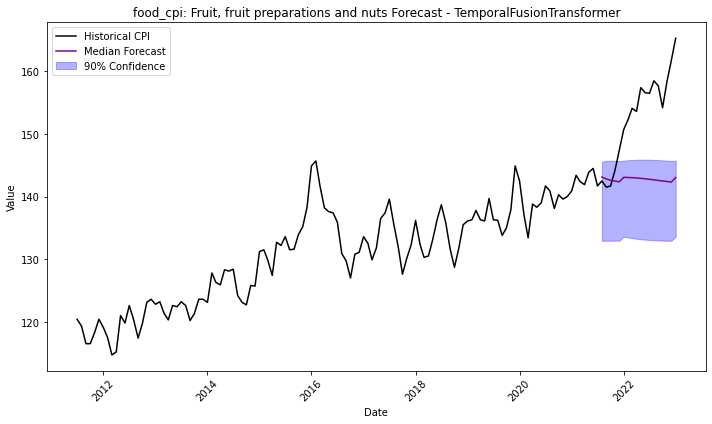

Beginning AutoGluon training... Time limit = 2s
AutoGluon will save models to './output/TEST/ag_global_all_TemporalFusionTransformerModel_exp2_R1_/random_seed_42/2021-07-01/model_files/'
=================== System Info ===================
AutoGluon Version:  1.1.1
Python Version:     3.8.20
Operating System:   Linux
Platform Machine:   x86_64
Platform Version:   #147~18.04.1-Ubuntu SMP Sat Oct 15 13:10:18 UTC 2022
CPU Count:          32
GPU Count:          1
Memory Avail:       166.81 GB / 188.57 GB (88.5%)
Disk Space Avail:   18208.80 GB / 249006.62 GB (7.3%)

Fitting with arguments:
{'enable_ensemble': True,
 'eval_metric': MAPE,
 'excluded_model_types': ['DirectTabular', 'RecursiveTabular'],
 'hyperparameters': {'TemporalFusionTransformerModel': {}},
 'known_covariates_names': [],
 'num_val_windows': 1,
 'prediction_length': 18,
 'quantile_levels': [0.01, 0.05, 0.1, 0.25, 0.75, 0.9, 0.95, 0.99],
 'random_seed': 42,
 'refit_every_n_windows': 1,
 'refit_full': False,
 'skip_model_sele

TemporalFusionTransformerModel


	-1.0412       = Validation score (-MAPE)
	2.11    s     = Training runtime
	0.04    s     = Validation (prediction) runtime
Not fitting ensemble due to lack of time remaining. Time left: -0.3 seconds
Training complete. Models trained: ['TemporalFusionTransformer']
Total runtime: 2.19 s
Best model: TemporalFusionTransformer
Best model score: -1.0412
Model not specified in predict, will default to the model with the best validation score: TemporalFusionTransformer
Model not specified in predict, will default to the model with the best validation score: TemporalFusionTransformer


****************** Summary of fit() ******************
Estimated performance of each model:
                       model  score_val  pred_time_val  fit_time_marginal  \
0  TemporalFusionTransformer   -1.04118       0.044223           2.108822   

   fit_order  
0          1  
Number of models trained: 1
Types of models trained:
{'MultiWindowBacktestingModel'}
****************** End of fit() summary ******************


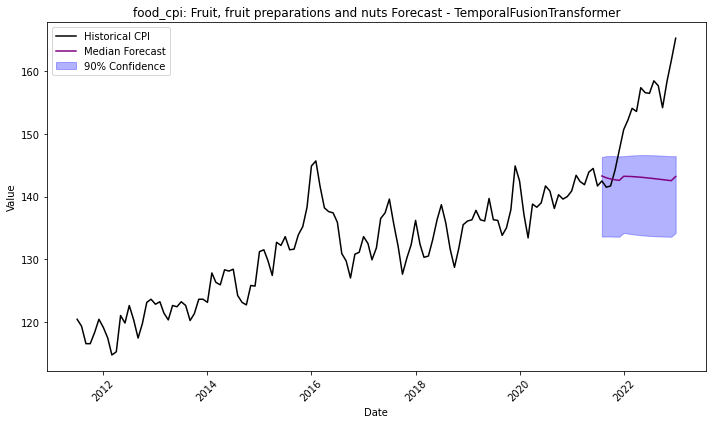

Beginning AutoGluon training... Time limit = 2s
AutoGluon will save models to './output/TEST/ag_global_all_TemporalFusionTransformerModel_exp2_GPT_P1_/random_seed_42/2021-07-01/model_files/'
=================== System Info ===================
AutoGluon Version:  1.1.1
Python Version:     3.8.20
Operating System:   Linux
Platform Machine:   x86_64
Platform Version:   #147~18.04.1-Ubuntu SMP Sat Oct 15 13:10:18 UTC 2022
CPU Count:          32
GPU Count:          1
Memory Avail:       166.77 GB / 188.57 GB (88.4%)
Disk Space Avail:   18208.80 GB / 249006.62 GB (7.3%)

Fitting with arguments:
{'enable_ensemble': True,
 'eval_metric': MAPE,
 'excluded_model_types': ['DirectTabular', 'RecursiveTabular'],
 'hyperparameters': {'TemporalFusionTransformerModel': {}},
 'known_covariates_names': [],
 'num_val_windows': 1,
 'prediction_length': 18,
 'quantile_levels': [0.01, 0.05, 0.1, 0.25, 0.75, 0.9, 0.95, 0.99],
 'random_seed': 42,
 'refit_every_n_windows': 1,
 'refit_full': False,
 'skip_model_

TemporalFusionTransformerModel


	-1.0981       = Validation score (-MAPE)
	2.14    s     = Training runtime
	0.04    s     = Validation (prediction) runtime
Not fitting ensemble due to lack of time remaining. Time left: -0.3 seconds
Training complete. Models trained: ['TemporalFusionTransformer']
Total runtime: 2.22 s
Best model: TemporalFusionTransformer
Best model score: -1.0981
Model not specified in predict, will default to the model with the best validation score: TemporalFusionTransformer
Model not specified in predict, will default to the model with the best validation score: TemporalFusionTransformer


****************** Summary of fit() ******************
Estimated performance of each model:
                       model  score_val  pred_time_val  fit_time_marginal  \
0  TemporalFusionTransformer  -1.098056       0.043423           2.144382   

   fit_order  
0          1  
Number of models trained: 1
Types of models trained:
{'MultiWindowBacktestingModel'}
****************** End of fit() summary ******************


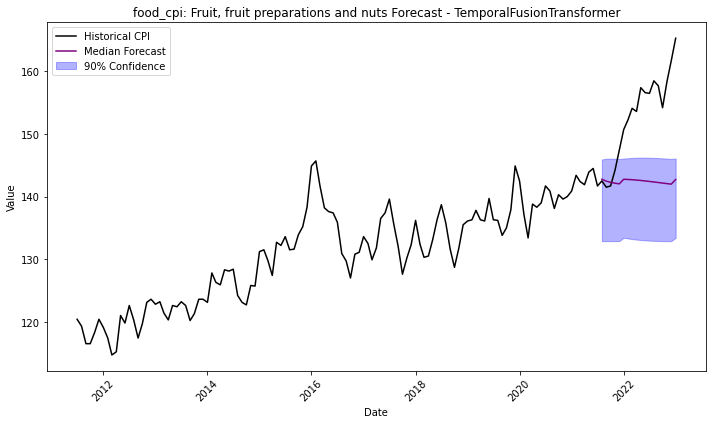

Beginning AutoGluon training... Time limit = 2s
AutoGluon will save models to './output/TEST/ag_global_all_TemporalFusionTransformerModel_exp2_GPT_P4_/random_seed_42/2022-07-01/model_files/'
=================== System Info ===================
AutoGluon Version:  1.1.1
Python Version:     3.8.20
Operating System:   Linux
Platform Machine:   x86_64
Platform Version:   #147~18.04.1-Ubuntu SMP Sat Oct 15 13:10:18 UTC 2022
CPU Count:          32
GPU Count:          1
Memory Avail:       166.73 GB / 188.57 GB (88.4%)
Disk Space Avail:   18208.79 GB / 249006.62 GB (7.3%)

Fitting with arguments:
{'enable_ensemble': True,
 'eval_metric': MAPE,
 'excluded_model_types': ['DirectTabular', 'RecursiveTabular'],
 'hyperparameters': {'TemporalFusionTransformerModel': {}},
 'known_covariates_names': [],
 'num_val_windows': 1,
 'prediction_length': 18,
 'quantile_levels': [0.01, 0.05, 0.1, 0.25, 0.75, 0.9, 0.95, 0.99],
 'random_seed': 42,
 'refit_every_n_windows': 1,
 'refit_full': False,
 'skip_model_

TemporalFusionTransformerModel


	-6.6438       = Validation score (-MAPE)
	2.13    s     = Training runtime
	0.04    s     = Validation (prediction) runtime
Not fitting ensemble due to lack of time remaining. Time left: -0.3 seconds
Training complete. Models trained: ['TemporalFusionTransformer']
Total runtime: 2.21 s
Best model: TemporalFusionTransformer
Best model score: -6.6438
Model not specified in predict, will default to the model with the best validation score: TemporalFusionTransformer
Model not specified in predict, will default to the model with the best validation score: TemporalFusionTransformer


****************** Summary of fit() ******************
Estimated performance of each model:
                       model  score_val  pred_time_val  fit_time_marginal  \
0  TemporalFusionTransformer  -6.643782       0.040608           2.132015   

   fit_order  
0          1  
Number of models trained: 1
Types of models trained:
{'MultiWindowBacktestingModel'}
****************** End of fit() summary ******************


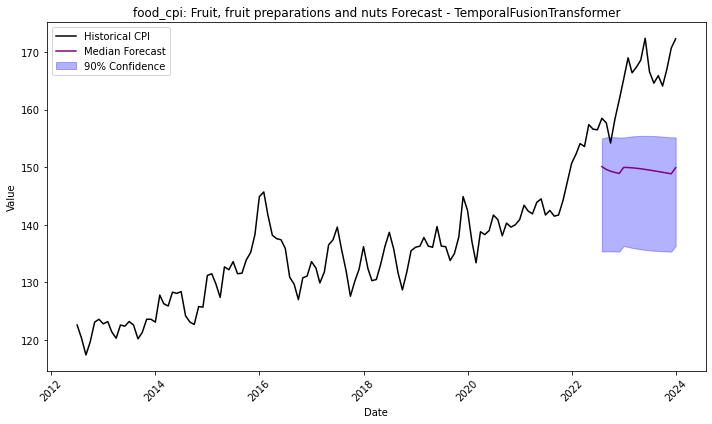

Beginning AutoGluon training... Time limit = 2s
AutoGluon will save models to './output/TEST/ag_global_all_TemporalFusionTransformerModel_exp2_R2_/random_seed_42/2022-07-01/model_files/'
=================== System Info ===================
AutoGluon Version:  1.1.1
Python Version:     3.8.20
Operating System:   Linux
Platform Machine:   x86_64
Platform Version:   #147~18.04.1-Ubuntu SMP Sat Oct 15 13:10:18 UTC 2022
CPU Count:          32
GPU Count:          1
Memory Avail:       166.77 GB / 188.57 GB (88.4%)
Disk Space Avail:   18208.78 GB / 249006.62 GB (7.3%)

Fitting with arguments:
{'enable_ensemble': True,
 'eval_metric': MAPE,
 'excluded_model_types': ['DirectTabular', 'RecursiveTabular'],
 'hyperparameters': {'TemporalFusionTransformerModel': {}},
 'known_covariates_names': [],
 'num_val_windows': 1,
 'prediction_length': 18,
 'quantile_levels': [0.01, 0.05, 0.1, 0.25, 0.75, 0.9, 0.95, 0.99],
 'random_seed': 42,
 'refit_every_n_windows': 1,
 'refit_full': False,
 'skip_model_sele

TemporalFusionTransformerModel


	-0.5812       = Validation score (-MAPE)
	2.10    s     = Training runtime
	0.04    s     = Validation (prediction) runtime
Not fitting ensemble due to lack of time remaining. Time left: -0.3 seconds
Training complete. Models trained: ['TemporalFusionTransformer']
Total runtime: 2.20 s
Best model: TemporalFusionTransformer
Best model score: -0.5812


****************** Summary of fit() ******************
Estimated performance of each model:
                       model  score_val  pred_time_val  fit_time_marginal  \
0  TemporalFusionTransformer  -0.581159       0.044876            2.10454   

   fit_order  
0          1  
Number of models trained: 1
Types of models trained:
{'MultiWindowBacktestingModel'}
****************** End of fit() summary ******************


Model not specified in predict, will default to the model with the best validation score: TemporalFusionTransformer
Model not specified in predict, will default to the model with the best validation score: TemporalFusionTransformer


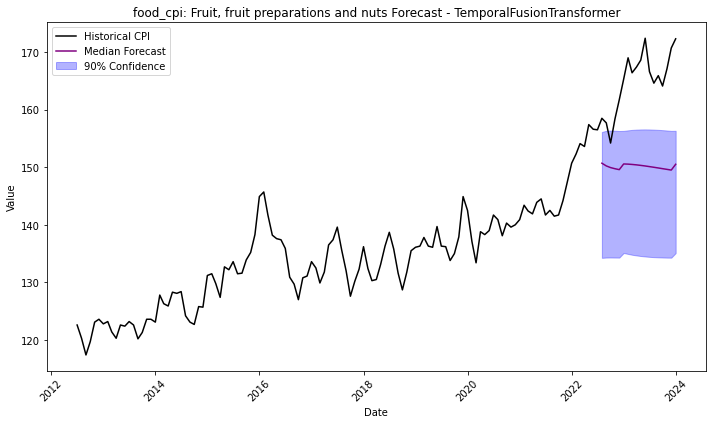

Beginning AutoGluon training... Time limit = 2s
AutoGluon will save models to './output/TEST/ag_global_all_TemporalFusionTransformerModel_exp2_R4_/random_seed_42/2022-07-01/model_files/'
=================== System Info ===================
AutoGluon Version:  1.1.1
Python Version:     3.8.20
Operating System:   Linux
Platform Machine:   x86_64
Platform Version:   #147~18.04.1-Ubuntu SMP Sat Oct 15 13:10:18 UTC 2022
CPU Count:          32
GPU Count:          1
Memory Avail:       166.82 GB / 188.57 GB (88.5%)
Disk Space Avail:   18208.82 GB / 249006.62 GB (7.3%)

Fitting with arguments:
{'enable_ensemble': True,
 'eval_metric': MAPE,
 'excluded_model_types': ['DirectTabular', 'RecursiveTabular'],
 'hyperparameters': {'TemporalFusionTransformerModel': {}},
 'known_covariates_names': [],
 'num_val_windows': 1,
 'prediction_length': 18,
 'quantile_levels': [0.01, 0.05, 0.1, 0.25, 0.75, 0.9, 0.95, 0.99],
 'random_seed': 42,
 'refit_every_n_windows': 1,
 'refit_full': False,
 'skip_model_sele

TemporalFusionTransformerModel


	-5.3844       = Validation score (-MAPE)
	2.12    s     = Training runtime
	0.04    s     = Validation (prediction) runtime
Not fitting ensemble due to lack of time remaining. Time left: -0.3 seconds
Training complete. Models trained: ['TemporalFusionTransformer']
Total runtime: 2.20 s
Best model: TemporalFusionTransformer
Best model score: -5.3844
Model not specified in predict, will default to the model with the best validation score: TemporalFusionTransformer
Model not specified in predict, will default to the model with the best validation score: TemporalFusionTransformer


****************** Summary of fit() ******************
Estimated performance of each model:
                       model  score_val  pred_time_val  fit_time_marginal  \
0  TemporalFusionTransformer  -5.384368       0.043726           2.120217   

   fit_order  
0          1  
Number of models trained: 1
Types of models trained:
{'MultiWindowBacktestingModel'}
****************** End of fit() summary ******************


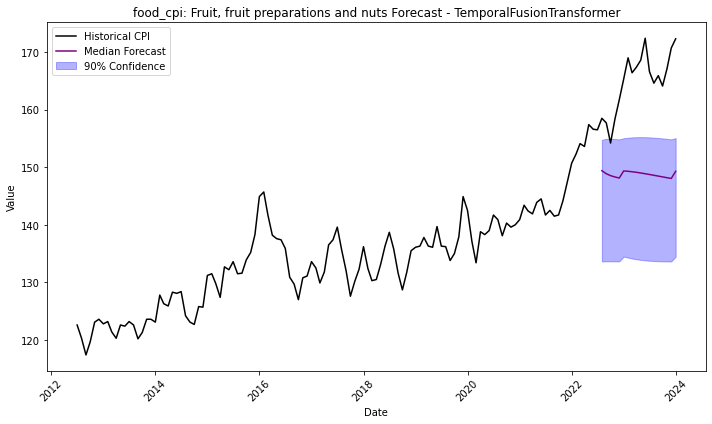

Beginning AutoGluon training... Time limit = 2s
AutoGluon will save models to './output/TEST/ag_global_all_TemporalFusionTransformerModel_exp2_GPT_P3_/random_seed_42/2022-07-01/model_files/'
=================== System Info ===================
AutoGluon Version:  1.1.1
Python Version:     3.8.20
Operating System:   Linux
Platform Machine:   x86_64
Platform Version:   #147~18.04.1-Ubuntu SMP Sat Oct 15 13:10:18 UTC 2022
CPU Count:          32
GPU Count:          1
Memory Avail:       166.85 GB / 188.57 GB (88.5%)
Disk Space Avail:   18208.81 GB / 249006.62 GB (7.3%)

Fitting with arguments:
{'enable_ensemble': True,
 'eval_metric': MAPE,
 'excluded_model_types': ['DirectTabular', 'RecursiveTabular'],
 'hyperparameters': {'TemporalFusionTransformerModel': {}},
 'known_covariates_names': [],
 'num_val_windows': 1,
 'prediction_length': 18,
 'quantile_levels': [0.01, 0.05, 0.1, 0.25, 0.75, 0.9, 0.95, 0.99],
 'random_seed': 42,
 'refit_every_n_windows': 1,
 'refit_full': False,
 'skip_model_

TemporalFusionTransformerModel


	-5.7474       = Validation score (-MAPE)
	2.12    s     = Training runtime
	0.04    s     = Validation (prediction) runtime
Not fitting ensemble due to lack of time remaining. Time left: -0.3 seconds
Training complete. Models trained: ['TemporalFusionTransformer']
Total runtime: 2.21 s
Best model: TemporalFusionTransformer
Best model score: -5.7474
Model not specified in predict, will default to the model with the best validation score: TemporalFusionTransformer
Model not specified in predict, will default to the model with the best validation score: TemporalFusionTransformer


****************** Summary of fit() ******************
Estimated performance of each model:
                       model  score_val  pred_time_val  fit_time_marginal  \
0  TemporalFusionTransformer  -5.747354        0.04362           2.124129   

   fit_order  
0          1  
Number of models trained: 1
Types of models trained:
{'MultiWindowBacktestingModel'}
****************** End of fit() summary ******************


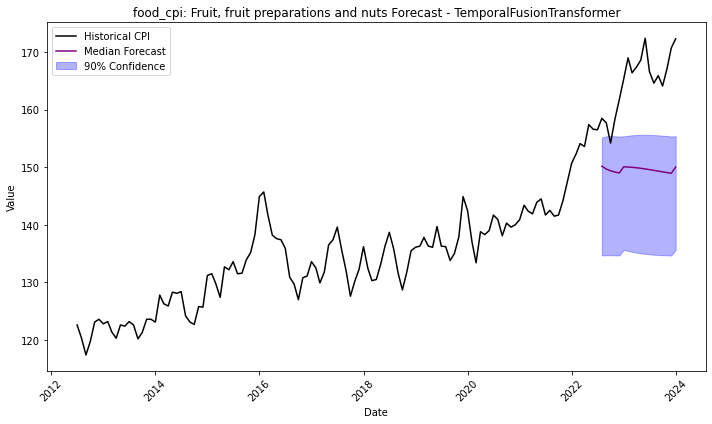

Beginning AutoGluon training... Time limit = 2s
AutoGluon will save models to './output/TEST/ag_global_all_TemporalFusionTransformerModel_exp2_R3_/random_seed_42/2022-07-01/model_files/'
=================== System Info ===================
AutoGluon Version:  1.1.1
Python Version:     3.8.20
Operating System:   Linux
Platform Machine:   x86_64
Platform Version:   #147~18.04.1-Ubuntu SMP Sat Oct 15 13:10:18 UTC 2022
CPU Count:          32
GPU Count:          1
Memory Avail:       166.76 GB / 188.57 GB (88.4%)
Disk Space Avail:   18208.80 GB / 249006.62 GB (7.3%)

Fitting with arguments:
{'enable_ensemble': True,
 'eval_metric': MAPE,
 'excluded_model_types': ['DirectTabular', 'RecursiveTabular'],
 'hyperparameters': {'TemporalFusionTransformerModel': {}},
 'known_covariates_names': [],
 'num_val_windows': 1,
 'prediction_length': 18,
 'quantile_levels': [0.01, 0.05, 0.1, 0.25, 0.75, 0.9, 0.95, 0.99],
 'random_seed': 42,
 'refit_every_n_windows': 1,
 'refit_full': False,
 'skip_model_sele

TemporalFusionTransformerModel


	-0.4294       = Validation score (-MAPE)
	2.14    s     = Training runtime
	0.04    s     = Validation (prediction) runtime
Not fitting ensemble due to lack of time remaining. Time left: -0.3 seconds
Training complete. Models trained: ['TemporalFusionTransformer']
Total runtime: 2.22 s
Best model: TemporalFusionTransformer
Best model score: -0.4294
Model not specified in predict, will default to the model with the best validation score: TemporalFusionTransformer
Model not specified in predict, will default to the model with the best validation score: TemporalFusionTransformer


****************** Summary of fit() ******************
Estimated performance of each model:
                       model  score_val  pred_time_val  fit_time_marginal  \
0  TemporalFusionTransformer  -0.429405       0.044812           2.136921   

   fit_order  
0          1  
Number of models trained: 1
Types of models trained:
{'MultiWindowBacktestingModel'}
****************** End of fit() summary ******************


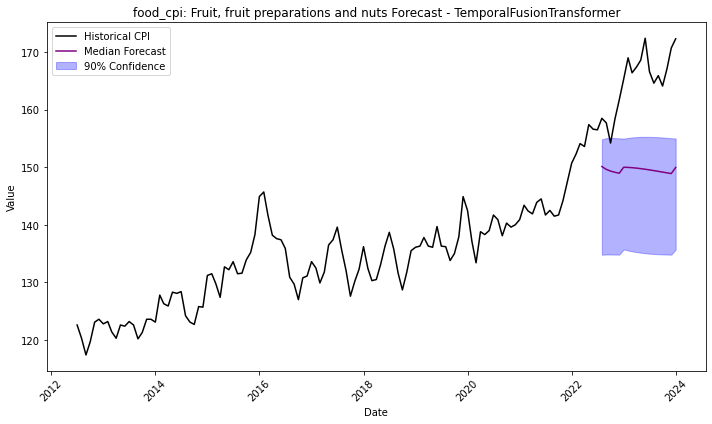

Beginning AutoGluon training... Time limit = 2s
AutoGluon will save models to './output/TEST/ag_global_all_TemporalFusionTransformerModel_exp2_GPT_P2_/random_seed_42/2022-07-01/model_files/'
=================== System Info ===================
AutoGluon Version:  1.1.1
Python Version:     3.8.20
Operating System:   Linux
Platform Machine:   x86_64
Platform Version:   #147~18.04.1-Ubuntu SMP Sat Oct 15 13:10:18 UTC 2022
CPU Count:          32
GPU Count:          1
Memory Avail:       166.77 GB / 188.57 GB (88.4%)
Disk Space Avail:   18208.79 GB / 249006.62 GB (7.3%)

Fitting with arguments:
{'enable_ensemble': True,
 'eval_metric': MAPE,
 'excluded_model_types': ['DirectTabular', 'RecursiveTabular'],
 'hyperparameters': {'TemporalFusionTransformerModel': {}},
 'known_covariates_names': [],
 'num_val_windows': 1,
 'prediction_length': 18,
 'quantile_levels': [0.01, 0.05, 0.1, 0.25, 0.75, 0.9, 0.95, 0.99],
 'random_seed': 42,
 'refit_every_n_windows': 1,
 'refit_full': False,
 'skip_model_

TemporalFusionTransformerModel


	-6.2967       = Validation score (-MAPE)
	2.12    s     = Training runtime
	0.04    s     = Validation (prediction) runtime
Not fitting ensemble due to lack of time remaining. Time left: -0.3 seconds
Training complete. Models trained: ['TemporalFusionTransformer']
Total runtime: 2.20 s
Best model: TemporalFusionTransformer
Best model score: -6.2967
Model not specified in predict, will default to the model with the best validation score: TemporalFusionTransformer
Model not specified in predict, will default to the model with the best validation score: TemporalFusionTransformer


****************** Summary of fit() ******************
Estimated performance of each model:
                       model  score_val  pred_time_val  fit_time_marginal  \
0  TemporalFusionTransformer  -6.296732       0.040385           2.118587   

   fit_order  
0          1  
Number of models trained: 1
Types of models trained:
{'MultiWindowBacktestingModel'}
****************** End of fit() summary ******************


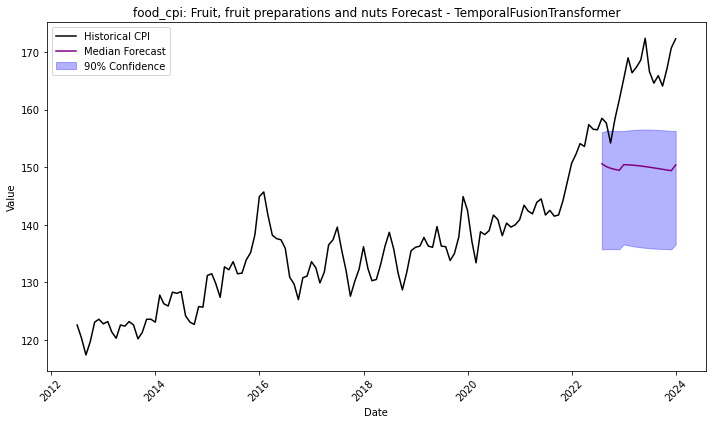

Beginning AutoGluon training... Time limit = 2s
AutoGluon will save models to './output/TEST/ag_global_all_TemporalFusionTransformerModel_exp2_R1_/random_seed_42/2022-07-01/model_files/'
=================== System Info ===================
AutoGluon Version:  1.1.1
Python Version:     3.8.20
Operating System:   Linux
Platform Machine:   x86_64
Platform Version:   #147~18.04.1-Ubuntu SMP Sat Oct 15 13:10:18 UTC 2022
CPU Count:          32
GPU Count:          1
Memory Avail:       166.77 GB / 188.57 GB (88.4%)
Disk Space Avail:   18208.79 GB / 249006.62 GB (7.3%)

Fitting with arguments:
{'enable_ensemble': True,
 'eval_metric': MAPE,
 'excluded_model_types': ['DirectTabular', 'RecursiveTabular'],
 'hyperparameters': {'TemporalFusionTransformerModel': {}},
 'known_covariates_names': [],
 'num_val_windows': 1,
 'prediction_length': 18,
 'quantile_levels': [0.01, 0.05, 0.1, 0.25, 0.75, 0.9, 0.95, 0.99],
 'random_seed': 42,
 'refit_every_n_windows': 1,
 'refit_full': False,
 'skip_model_sele

TemporalFusionTransformerModel


	-5.7980       = Validation score (-MAPE)
	2.11    s     = Training runtime
	0.04    s     = Validation (prediction) runtime
Not fitting ensemble due to lack of time remaining. Time left: -0.2 seconds
Training complete. Models trained: ['TemporalFusionTransformer']
Total runtime: 2.19 s
Best model: TemporalFusionTransformer
Best model score: -5.7980
Model not specified in predict, will default to the model with the best validation score: TemporalFusionTransformer


****************** Summary of fit() ******************
Estimated performance of each model:
                       model  score_val  pred_time_val  fit_time_marginal  \
0  TemporalFusionTransformer  -5.798046       0.043983           2.108406   

   fit_order  
0          1  
Number of models trained: 1
Types of models trained:
{'MultiWindowBacktestingModel'}
****************** End of fit() summary ******************


Model not specified in predict, will default to the model with the best validation score: TemporalFusionTransformer


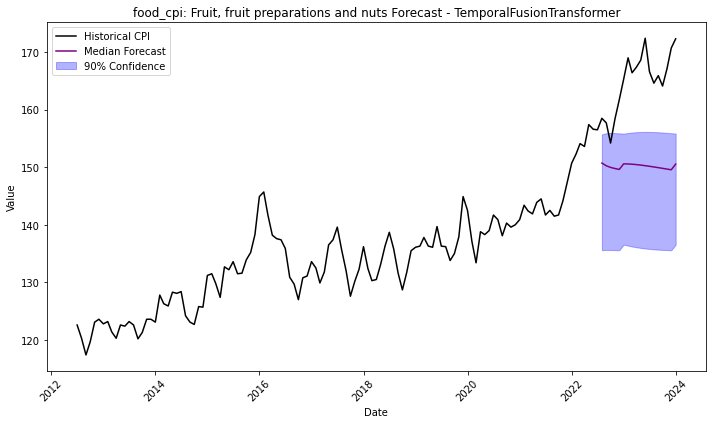

Beginning AutoGluon training... Time limit = 2s
AutoGluon will save models to './output/TEST/ag_global_all_TemporalFusionTransformerModel_exp2_GPT_P1_/random_seed_42/2022-07-01/model_files/'
=================== System Info ===================
AutoGluon Version:  1.1.1
Python Version:     3.8.20
Operating System:   Linux
Platform Machine:   x86_64
Platform Version:   #147~18.04.1-Ubuntu SMP Sat Oct 15 13:10:18 UTC 2022
CPU Count:          32
GPU Count:          1
Memory Avail:       166.77 GB / 188.57 GB (88.4%)
Disk Space Avail:   18208.78 GB / 249006.62 GB (7.3%)

Fitting with arguments:
{'enable_ensemble': True,
 'eval_metric': MAPE,
 'excluded_model_types': ['DirectTabular', 'RecursiveTabular'],
 'hyperparameters': {'TemporalFusionTransformerModel': {}},
 'known_covariates_names': [],
 'num_val_windows': 1,
 'prediction_length': 18,
 'quantile_levels': [0.01, 0.05, 0.1, 0.25, 0.75, 0.9, 0.95, 0.99],
 'random_seed': 42,
 'refit_every_n_windows': 1,
 'refit_full': False,
 'skip_model_

TemporalFusionTransformerModel


	-5.6330       = Validation score (-MAPE)
	2.14    s     = Training runtime
	0.04    s     = Validation (prediction) runtime
Not fitting ensemble due to lack of time remaining. Time left: -0.3 seconds
Training complete. Models trained: ['TemporalFusionTransformer']
Total runtime: 2.22 s
Best model: TemporalFusionTransformer
Best model score: -5.6330
Model not specified in predict, will default to the model with the best validation score: TemporalFusionTransformer
Model not specified in predict, will default to the model with the best validation score: TemporalFusionTransformer


****************** Summary of fit() ******************
Estimated performance of each model:
                       model  score_val  pred_time_val  fit_time_marginal  \
0  TemporalFusionTransformer  -5.633013       0.042287           2.137525   

   fit_order  
0          1  
Number of models trained: 1
Types of models trained:
{'MultiWindowBacktestingModel'}
****************** End of fit() summary ******************


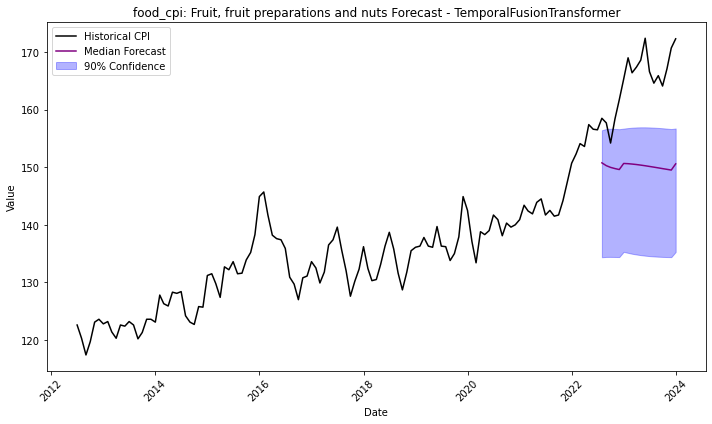

Beginning AutoGluon training... Time limit = 2s
AutoGluon will save models to './output/TEST/ag_global_all_TemporalFusionTransformerModel_exp2_GPT_P4_/random_seed_42/2023-07-01/model_files/'
=================== System Info ===================
AutoGluon Version:  1.1.1
Python Version:     3.8.20
Operating System:   Linux
Platform Machine:   x86_64
Platform Version:   #147~18.04.1-Ubuntu SMP Sat Oct 15 13:10:18 UTC 2022
CPU Count:          32
GPU Count:          1
Memory Avail:       166.76 GB / 188.57 GB (88.4%)
Disk Space Avail:   18208.82 GB / 249006.62 GB (7.3%)

Fitting with arguments:
{'enable_ensemble': True,
 'eval_metric': MAPE,
 'excluded_model_types': ['DirectTabular', 'RecursiveTabular'],
 'hyperparameters': {'TemporalFusionTransformerModel': {}},
 'known_covariates_names': [],
 'num_val_windows': 1,
 'prediction_length': 18,
 'quantile_levels': [0.01, 0.05, 0.1, 0.25, 0.75, 0.9, 0.95, 0.99],
 'random_seed': 42,
 'refit_every_n_windows': 1,
 'refit_full': False,
 'skip_model_

TemporalFusionTransformerModel


	-1.0325       = Validation score (-MAPE)
	2.15    s     = Training runtime
	0.04    s     = Validation (prediction) runtime
Not fitting ensemble due to lack of time remaining. Time left: -0.3 seconds
Training complete. Models trained: ['TemporalFusionTransformer']
Total runtime: 2.23 s
Best model: TemporalFusionTransformer
Best model score: -1.0325
Model not specified in predict, will default to the model with the best validation score: TemporalFusionTransformer
Model not specified in predict, will default to the model with the best validation score: TemporalFusionTransformer


****************** Summary of fit() ******************
Estimated performance of each model:
                       model  score_val  pred_time_val  fit_time_marginal  \
0  TemporalFusionTransformer  -1.032505       0.041184            2.15071   

   fit_order  
0          1  
Number of models trained: 1
Types of models trained:
{'MultiWindowBacktestingModel'}
****************** End of fit() summary ******************


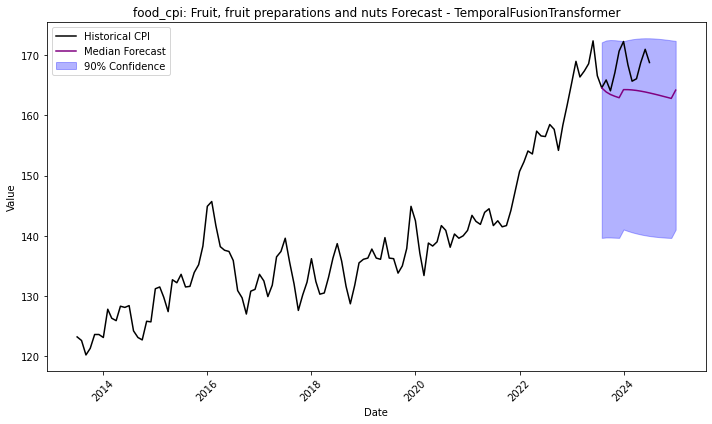

Beginning AutoGluon training... Time limit = 2s
AutoGluon will save models to './output/TEST/ag_global_all_TemporalFusionTransformerModel_exp2_R2_/random_seed_42/2023-07-01/model_files/'
=================== System Info ===================
AutoGluon Version:  1.1.1
Python Version:     3.8.20
Operating System:   Linux
Platform Machine:   x86_64
Platform Version:   #147~18.04.1-Ubuntu SMP Sat Oct 15 13:10:18 UTC 2022
CPU Count:          32
GPU Count:          1
Memory Avail:       166.77 GB / 188.57 GB (88.4%)
Disk Space Avail:   18208.81 GB / 249006.62 GB (7.3%)

Fitting with arguments:
{'enable_ensemble': True,
 'eval_metric': MAPE,
 'excluded_model_types': ['DirectTabular', 'RecursiveTabular'],
 'hyperparameters': {'TemporalFusionTransformerModel': {}},
 'known_covariates_names': [],
 'num_val_windows': 1,
 'prediction_length': 18,
 'quantile_levels': [0.01, 0.05, 0.1, 0.25, 0.75, 0.9, 0.95, 0.99],
 'random_seed': 42,
 'refit_every_n_windows': 1,
 'refit_full': False,
 'skip_model_sele

TemporalFusionTransformerModel


	-0.5329       = Validation score (-MAPE)
	2.14    s     = Training runtime
	0.04    s     = Validation (prediction) runtime
Not fitting ensemble due to lack of time remaining. Time left: -0.3 seconds
Training complete. Models trained: ['TemporalFusionTransformer']
Total runtime: 2.22 s
Best model: TemporalFusionTransformer
Best model score: -0.5329
Model not specified in predict, will default to the model with the best validation score: TemporalFusionTransformer
Model not specified in predict, will default to the model with the best validation score: TemporalFusionTransformer


****************** Summary of fit() ******************
Estimated performance of each model:
                       model  score_val  pred_time_val  fit_time_marginal  \
0  TemporalFusionTransformer  -0.532855       0.043058           2.144353   

   fit_order  
0          1  
Number of models trained: 1
Types of models trained:
{'MultiWindowBacktestingModel'}
****************** End of fit() summary ******************


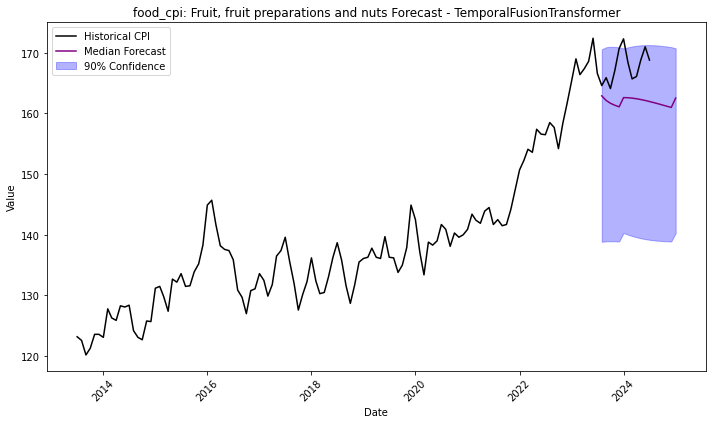

Beginning AutoGluon training... Time limit = 2s
AutoGluon will save models to './output/TEST/ag_global_all_TemporalFusionTransformerModel_exp2_R4_/random_seed_42/2023-07-01/model_files/'
=================== System Info ===================
AutoGluon Version:  1.1.1
Python Version:     3.8.20
Operating System:   Linux
Platform Machine:   x86_64
Platform Version:   #147~18.04.1-Ubuntu SMP Sat Oct 15 13:10:18 UTC 2022
CPU Count:          32
GPU Count:          1
Memory Avail:       166.77 GB / 188.57 GB (88.4%)
Disk Space Avail:   18208.80 GB / 249006.62 GB (7.3%)

Fitting with arguments:
{'enable_ensemble': True,
 'eval_metric': MAPE,
 'excluded_model_types': ['DirectTabular', 'RecursiveTabular'],
 'hyperparameters': {'TemporalFusionTransformerModel': {}},
 'known_covariates_names': [],
 'num_val_windows': 1,
 'prediction_length': 18,
 'quantile_levels': [0.01, 0.05, 0.1, 0.25, 0.75, 0.9, 0.95, 0.99],
 'random_seed': 42,
 'refit_every_n_windows': 1,
 'refit_full': False,
 'skip_model_sele

TemporalFusionTransformerModel


	-0.8246       = Validation score (-MAPE)
	2.11    s     = Training runtime
	0.04    s     = Validation (prediction) runtime
Not fitting ensemble due to lack of time remaining. Time left: -0.2 seconds
Training complete. Models trained: ['TemporalFusionTransformer']
Total runtime: 2.19 s
Best model: TemporalFusionTransformer
Best model score: -0.8246
Model not specified in predict, will default to the model with the best validation score: TemporalFusionTransformer
Model not specified in predict, will default to the model with the best validation score: TemporalFusionTransformer


****************** Summary of fit() ******************
Estimated performance of each model:
                       model  score_val  pred_time_val  fit_time_marginal  \
0  TemporalFusionTransformer  -0.824636       0.043103           2.111467   

   fit_order  
0          1  
Number of models trained: 1
Types of models trained:
{'MultiWindowBacktestingModel'}
****************** End of fit() summary ******************


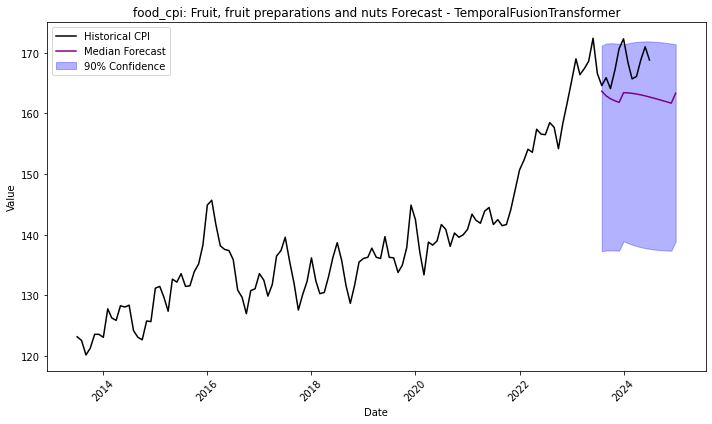

Beginning AutoGluon training... Time limit = 2s
AutoGluon will save models to './output/TEST/ag_global_all_TemporalFusionTransformerModel_exp2_GPT_P3_/random_seed_42/2023-07-01/model_files/'
=================== System Info ===================
AutoGluon Version:  1.1.1
Python Version:     3.8.20
Operating System:   Linux
Platform Machine:   x86_64
Platform Version:   #147~18.04.1-Ubuntu SMP Sat Oct 15 13:10:18 UTC 2022
CPU Count:          32
GPU Count:          1
Memory Avail:       166.77 GB / 188.57 GB (88.4%)
Disk Space Avail:   18208.79 GB / 249006.62 GB (7.3%)

Fitting with arguments:
{'enable_ensemble': True,
 'eval_metric': MAPE,
 'excluded_model_types': ['DirectTabular', 'RecursiveTabular'],
 'hyperparameters': {'TemporalFusionTransformerModel': {}},
 'known_covariates_names': [],
 'num_val_windows': 1,
 'prediction_length': 18,
 'quantile_levels': [0.01, 0.05, 0.1, 0.25, 0.75, 0.9, 0.95, 0.99],
 'random_seed': 42,
 'refit_every_n_windows': 1,
 'refit_full': False,
 'skip_model_

TemporalFusionTransformerModel


	-1.0750       = Validation score (-MAPE)
	2.12    s     = Training runtime
	0.04    s     = Validation (prediction) runtime
Not fitting ensemble due to lack of time remaining. Time left: -0.3 seconds
Training complete. Models trained: ['TemporalFusionTransformer']
Total runtime: 2.20 s
Best model: TemporalFusionTransformer
Best model score: -1.0750
Model not specified in predict, will default to the model with the best validation score: TemporalFusionTransformer
Model not specified in predict, will default to the model with the best validation score: TemporalFusionTransformer


****************** Summary of fit() ******************
Estimated performance of each model:
                       model  score_val  pred_time_val  fit_time_marginal  \
0  TemporalFusionTransformer  -1.074966       0.044422           2.119253   

   fit_order  
0          1  
Number of models trained: 1
Types of models trained:
{'MultiWindowBacktestingModel'}
****************** End of fit() summary ******************


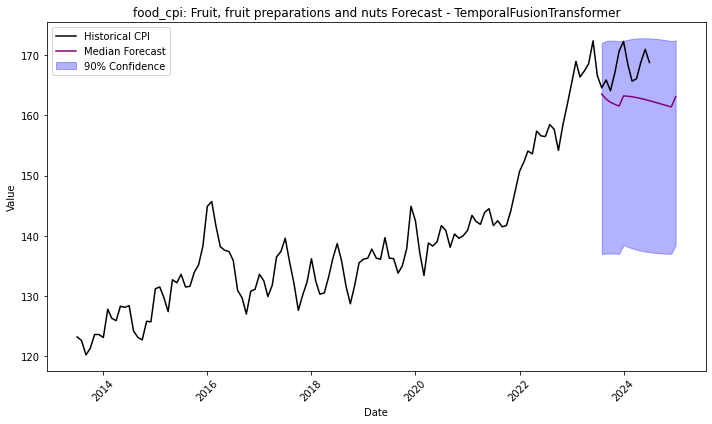

Beginning AutoGluon training... Time limit = 2s
AutoGluon will save models to './output/TEST/ag_global_all_TemporalFusionTransformerModel_exp2_R3_/random_seed_42/2023-07-01/model_files/'
=================== System Info ===================
AutoGluon Version:  1.1.1
Python Version:     3.8.20
Operating System:   Linux
Platform Machine:   x86_64
Platform Version:   #147~18.04.1-Ubuntu SMP Sat Oct 15 13:10:18 UTC 2022
CPU Count:          32
GPU Count:          1
Memory Avail:       166.77 GB / 188.57 GB (88.4%)
Disk Space Avail:   18208.78 GB / 249006.62 GB (7.3%)

Fitting with arguments:
{'enable_ensemble': True,
 'eval_metric': MAPE,
 'excluded_model_types': ['DirectTabular', 'RecursiveTabular'],
 'hyperparameters': {'TemporalFusionTransformerModel': {}},
 'known_covariates_names': [],
 'num_val_windows': 1,
 'prediction_length': 18,
 'quantile_levels': [0.01, 0.05, 0.1, 0.25, 0.75, 0.9, 0.95, 0.99],
 'random_seed': 42,
 'refit_every_n_windows': 1,
 'refit_full': False,
 'skip_model_sele

TemporalFusionTransformerModel


Inferred time series frequency: 'MS'
Provided train_data has 9922 rows (NaN fraction=0.1%), 22 time series. Median time series length is 451 (min=451, max=451). 

Provided data contains following columns:
	target: 'target'

AutoGluon will gauge predictive performance using evaluation metric: 'MAPE'
	This metric's sign has been flipped to adhere to being higher_is_better. The metric score can be multiplied by -1 to get the metric value.

Starting training. Start time is 2024-10-27 07:42:14
Excluded model types: ['DirectTabular', 'RecursiveTabular']
Models that will be trained: ['TemporalFusionTransformer']
Training timeseries model TemporalFusionTransformer. Training for up to 1.6s of the 1.6s of remaining time.
	-0.4639       = Validation score (-MAPE)
	1.87    s     = Training runtime
	0.05    s     = Validation (prediction) runtime
Not fitting ensemble due to lack of time remaining. Time left: -0.3 seconds
Training complete. Models trained: ['TemporalFusionTransformer']
Total runtime

****************** Summary of fit() ******************
Estimated performance of each model:
                       model  score_val  pred_time_val  fit_time_marginal  \
0  TemporalFusionTransformer  -0.463894        0.04641           1.871649   

   fit_order  
0          1  
Number of models trained: 1
Types of models trained:
{'MultiWindowBacktestingModel'}
****************** End of fit() summary ******************


Model not specified in predict, will default to the model with the best validation score: TemporalFusionTransformer


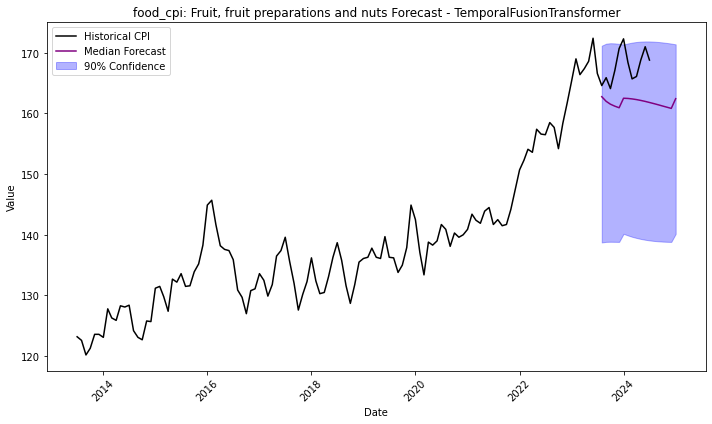

Beginning AutoGluon training... Time limit = 2s
AutoGluon will save models to './output/TEST/ag_global_all_TemporalFusionTransformerModel_exp2_GPT_P2_/random_seed_42/2023-07-01/model_files/'
=================== System Info ===================
AutoGluon Version:  1.1.1
Python Version:     3.8.20
Operating System:   Linux
Platform Machine:   x86_64
Platform Version:   #147~18.04.1-Ubuntu SMP Sat Oct 15 13:10:18 UTC 2022
CPU Count:          32
GPU Count:          1
Memory Avail:       166.79 GB / 188.57 GB (88.4%)
Disk Space Avail:   18208.83 GB / 249006.62 GB (7.3%)

Fitting with arguments:
{'enable_ensemble': True,
 'eval_metric': MAPE,
 'excluded_model_types': ['DirectTabular', 'RecursiveTabular'],
 'hyperparameters': {'TemporalFusionTransformerModel': {}},
 'known_covariates_names': [],
 'num_val_windows': 1,
 'prediction_length': 18,
 'quantile_levels': [0.01, 0.05, 0.1, 0.25, 0.75, 0.9, 0.95, 0.99],
 'random_seed': 42,
 'refit_every_n_windows': 1,
 'refit_full': False,
 'skip_model_

TemporalFusionTransformerModel


	-0.6470       = Validation score (-MAPE)
	2.12    s     = Training runtime
	0.04    s     = Validation (prediction) runtime
Not fitting ensemble due to lack of time remaining. Time left: -0.3 seconds
Training complete. Models trained: ['TemporalFusionTransformer']
Total runtime: 2.20 s
Best model: TemporalFusionTransformer
Best model score: -0.6470
Model not specified in predict, will default to the model with the best validation score: TemporalFusionTransformer
Model not specified in predict, will default to the model with the best validation score: TemporalFusionTransformer


****************** Summary of fit() ******************
Estimated performance of each model:
                       model  score_val  pred_time_val  fit_time_marginal  \
0  TemporalFusionTransformer  -0.646965       0.041072           2.121965   

   fit_order  
0          1  
Number of models trained: 1
Types of models trained:
{'MultiWindowBacktestingModel'}
****************** End of fit() summary ******************


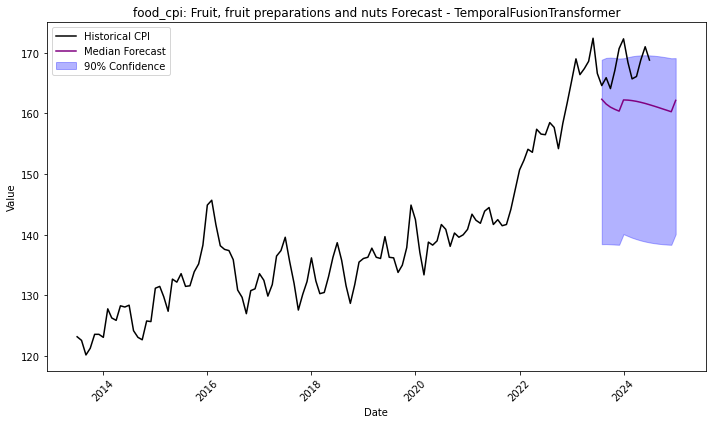

Beginning AutoGluon training... Time limit = 2s
AutoGluon will save models to './output/TEST/ag_global_all_TemporalFusionTransformerModel_exp2_R1_/random_seed_42/2023-07-01/model_files/'
=================== System Info ===================
AutoGluon Version:  1.1.1
Python Version:     3.8.20
Operating System:   Linux
Platform Machine:   x86_64
Platform Version:   #147~18.04.1-Ubuntu SMP Sat Oct 15 13:10:18 UTC 2022
CPU Count:          32
GPU Count:          1
Memory Avail:       166.81 GB / 188.57 GB (88.5%)
Disk Space Avail:   18208.79 GB / 249006.62 GB (7.3%)

Fitting with arguments:
{'enable_ensemble': True,
 'eval_metric': MAPE,
 'excluded_model_types': ['DirectTabular', 'RecursiveTabular'],
 'hyperparameters': {'TemporalFusionTransformerModel': {}},
 'known_covariates_names': [],
 'num_val_windows': 1,
 'prediction_length': 18,
 'quantile_levels': [0.01, 0.05, 0.1, 0.25, 0.75, 0.9, 0.95, 0.99],
 'random_seed': 42,
 'refit_every_n_windows': 1,
 'refit_full': False,
 'skip_model_sele

TemporalFusionTransformerModel


	-0.9890       = Validation score (-MAPE)
	2.15    s     = Training runtime
	0.04    s     = Validation (prediction) runtime
Not fitting ensemble due to lack of time remaining. Time left: -0.3 seconds
Training complete. Models trained: ['TemporalFusionTransformer']
Total runtime: 2.23 s
Best model: TemporalFusionTransformer
Best model score: -0.9890
Model not specified in predict, will default to the model with the best validation score: TemporalFusionTransformer
Model not specified in predict, will default to the model with the best validation score: TemporalFusionTransformer


****************** Summary of fit() ******************
Estimated performance of each model:
                       model  score_val  pred_time_val  fit_time_marginal  \
0  TemporalFusionTransformer  -0.988992       0.042587           2.147834   

   fit_order  
0          1  
Number of models trained: 1
Types of models trained:
{'MultiWindowBacktestingModel'}
****************** End of fit() summary ******************


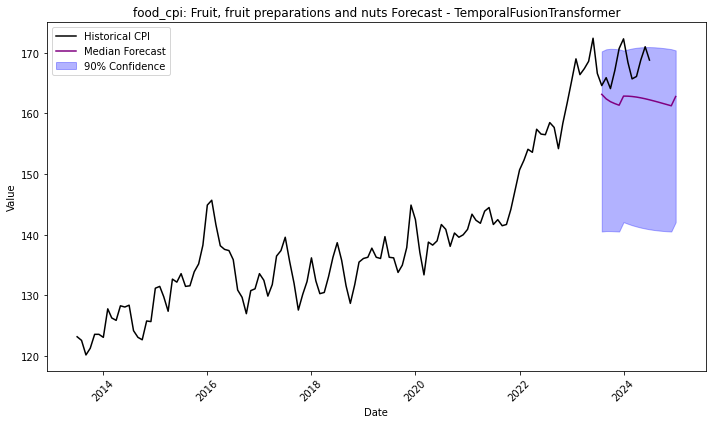

Beginning AutoGluon training... Time limit = 2s
AutoGluon will save models to './output/TEST/ag_global_all_TemporalFusionTransformerModel_exp2_GPT_P1_/random_seed_42/2023-07-01/model_files/'
=================== System Info ===================
AutoGluon Version:  1.1.1
Python Version:     3.8.20
Operating System:   Linux
Platform Machine:   x86_64
Platform Version:   #147~18.04.1-Ubuntu SMP Sat Oct 15 13:10:18 UTC 2022
CPU Count:          32
GPU Count:          1
Memory Avail:       166.81 GB / 188.57 GB (88.5%)
Disk Space Avail:   18208.78 GB / 249006.62 GB (7.3%)

Fitting with arguments:
{'enable_ensemble': True,
 'eval_metric': MAPE,
 'excluded_model_types': ['DirectTabular', 'RecursiveTabular'],
 'hyperparameters': {'TemporalFusionTransformerModel': {}},
 'known_covariates_names': [],
 'num_val_windows': 1,
 'prediction_length': 18,
 'quantile_levels': [0.01, 0.05, 0.1, 0.25, 0.75, 0.9, 0.95, 0.99],
 'random_seed': 42,
 'refit_every_n_windows': 1,
 'refit_full': False,
 'skip_model_

TemporalFusionTransformerModel


	-0.7118       = Validation score (-MAPE)
	2.16    s     = Training runtime
	0.05    s     = Validation (prediction) runtime
Not fitting ensemble due to lack of time remaining. Time left: -0.3 seconds
Training complete. Models trained: ['TemporalFusionTransformer']
Total runtime: 2.24 s
Best model: TemporalFusionTransformer
Best model score: -0.7118
Model not specified in predict, will default to the model with the best validation score: TemporalFusionTransformer
Model not specified in predict, will default to the model with the best validation score: TemporalFusionTransformer


****************** Summary of fit() ******************
Estimated performance of each model:
                       model  score_val  pred_time_val  fit_time_marginal  \
0  TemporalFusionTransformer  -0.711831       0.045318           2.158608   

   fit_order  
0          1  
Number of models trained: 1
Types of models trained:
{'MultiWindowBacktestingModel'}
****************** End of fit() summary ******************


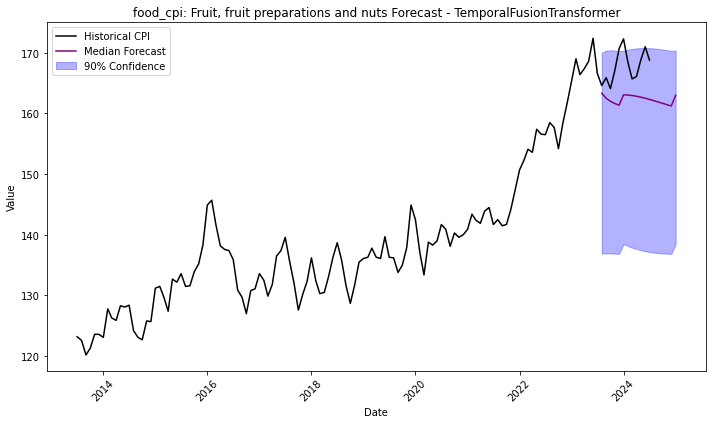

Beginning AutoGluon training... Time limit = 2s
AutoGluon will save models to './output/TEST/ag_global_all_TemporalFusionTransformerModel_exp2_R4_/random_seed_42/2018-07-01/model_files/'
=================== System Info ===================
AutoGluon Version:  1.1.1
Python Version:     3.8.20
Operating System:   Linux
Platform Machine:   x86_64
Platform Version:   #147~18.04.1-Ubuntu SMP Sat Oct 15 13:10:18 UTC 2022
CPU Count:          32
GPU Count:          1
Memory Avail:       166.76 GB / 188.57 GB (88.4%)
Disk Space Avail:   18208.83 GB / 249006.62 GB (7.3%)

Fitting with arguments:
{'enable_ensemble': True,
 'eval_metric': MAPE,
 'excluded_model_types': ['DirectTabular', 'RecursiveTabular'],
 'hyperparameters': {'TemporalFusionTransformerModel': {}},
 'known_covariates_names': [],
 'num_val_windows': 1,
 'prediction_length': 18,
 'quantile_levels': [0.01, 0.05, 0.1, 0.25, 0.75, 0.9, 0.95, 0.99],
 'random_seed': 42,
 'refit_every_n_windows': 1,
 'refit_full': False,
 'skip_model_sele

TemporalFusionTransformerModel


	-1.2137       = Validation score (-MAPE)
	2.13    s     = Training runtime
	0.04    s     = Validation (prediction) runtime
Not fitting ensemble due to lack of time remaining. Time left: -0.3 seconds
Training complete. Models trained: ['TemporalFusionTransformer']
Total runtime: 2.21 s
Best model: TemporalFusionTransformer
Best model score: -1.2137
Model not specified in predict, will default to the model with the best validation score: TemporalFusionTransformer
Model not specified in predict, will default to the model with the best validation score: TemporalFusionTransformer


****************** Summary of fit() ******************
Estimated performance of each model:
                       model  score_val  pred_time_val  fit_time_marginal  \
0  TemporalFusionTransformer  -1.213662       0.043352           2.126486   

   fit_order  
0          1  
Number of models trained: 1
Types of models trained:
{'MultiWindowBacktestingModel'}
****************** End of fit() summary ******************


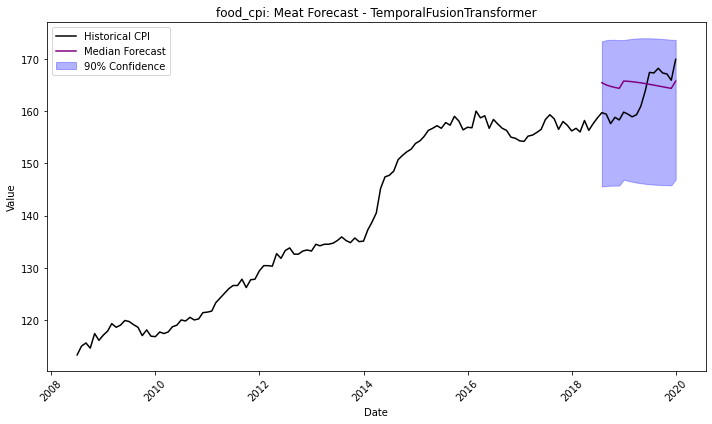

Beginning AutoGluon training... Time limit = 2s
AutoGluon will save models to './output/TEST/ag_global_all_TemporalFusionTransformerModel_exp2_R1_/random_seed_42/2018-07-01/model_files/'
=================== System Info ===================
AutoGluon Version:  1.1.1
Python Version:     3.8.20
Operating System:   Linux
Platform Machine:   x86_64
Platform Version:   #147~18.04.1-Ubuntu SMP Sat Oct 15 13:10:18 UTC 2022
CPU Count:          32
GPU Count:          1
Memory Avail:       166.78 GB / 188.57 GB (88.4%)
Disk Space Avail:   18209.29 GB / 249006.62 GB (7.3%)

Fitting with arguments:
{'enable_ensemble': True,
 'eval_metric': MAPE,
 'excluded_model_types': ['DirectTabular', 'RecursiveTabular'],
 'hyperparameters': {'TemporalFusionTransformerModel': {}},
 'known_covariates_names': [],
 'num_val_windows': 1,
 'prediction_length': 18,
 'quantile_levels': [0.01, 0.05, 0.1, 0.25, 0.75, 0.9, 0.95, 0.99],
 'random_seed': 42,
 'refit_every_n_windows': 1,
 'refit_full': False,
 'skip_model_sele

TemporalFusionTransformerModel


	-1.1255       = Validation score (-MAPE)
	2.47    s     = Training runtime
	0.04    s     = Validation (prediction) runtime
Not fitting ensemble due to lack of time remaining. Time left: -0.6 seconds
Training complete. Models trained: ['TemporalFusionTransformer']
Total runtime: 2.55 s
Best model: TemporalFusionTransformer
Best model score: -1.1255
Model not specified in predict, will default to the model with the best validation score: TemporalFusionTransformer
Model not specified in predict, will default to the model with the best validation score: TemporalFusionTransformer


****************** Summary of fit() ******************
Estimated performance of each model:
                       model  score_val  pred_time_val  fit_time_marginal  \
0  TemporalFusionTransformer  -1.125451       0.040927           2.470123   

   fit_order  
0          1  
Number of models trained: 1
Types of models trained:
{'MultiWindowBacktestingModel'}
****************** End of fit() summary ******************


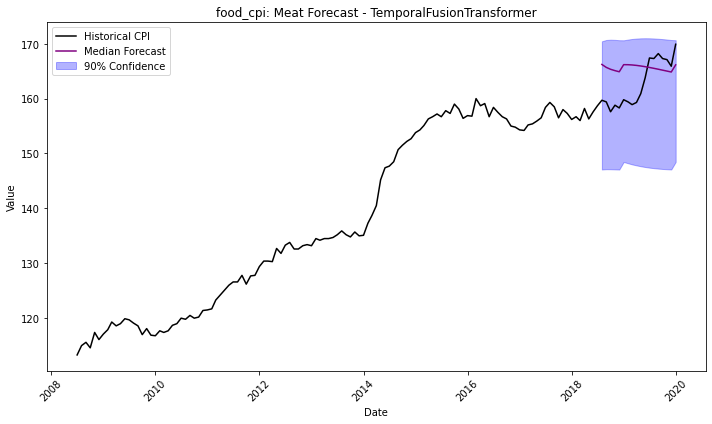

Beginning AutoGluon training... Time limit = 2s
AutoGluon will save models to './output/TEST/ag_global_all_TemporalFusionTransformerModel_exp2_R3_/random_seed_42/2018-07-01/model_files/'
=================== System Info ===================
AutoGluon Version:  1.1.1
Python Version:     3.8.20
Operating System:   Linux
Platform Machine:   x86_64
Platform Version:   #147~18.04.1-Ubuntu SMP Sat Oct 15 13:10:18 UTC 2022
CPU Count:          32
GPU Count:          1
Memory Avail:       166.86 GB / 188.57 GB (88.5%)
Disk Space Avail:   18209.28 GB / 249006.62 GB (7.3%)

Fitting with arguments:
{'enable_ensemble': True,
 'eval_metric': MAPE,
 'excluded_model_types': ['DirectTabular', 'RecursiveTabular'],
 'hyperparameters': {'TemporalFusionTransformerModel': {}},
 'known_covariates_names': [],
 'num_val_windows': 1,
 'prediction_length': 18,
 'quantile_levels': [0.01, 0.05, 0.1, 0.25, 0.75, 0.9, 0.95, 0.99],
 'random_seed': 42,
 'refit_every_n_windows': 1,
 'refit_full': False,
 'skip_model_sele

TemporalFusionTransformerModel


	-1.8070       = Validation score (-MAPE)
	2.13    s     = Training runtime
	0.04    s     = Validation (prediction) runtime
Not fitting ensemble due to lack of time remaining. Time left: -0.3 seconds
Training complete. Models trained: ['TemporalFusionTransformer']
Total runtime: 2.22 s
Best model: TemporalFusionTransformer
Best model score: -1.8070
Model not specified in predict, will default to the model with the best validation score: TemporalFusionTransformer
Model not specified in predict, will default to the model with the best validation score: TemporalFusionTransformer


****************** Summary of fit() ******************
Estimated performance of each model:
                       model  score_val  pred_time_val  fit_time_marginal  \
0  TemporalFusionTransformer  -1.806957       0.044018           2.132779   

   fit_order  
0          1  
Number of models trained: 1
Types of models trained:
{'MultiWindowBacktestingModel'}
****************** End of fit() summary ******************


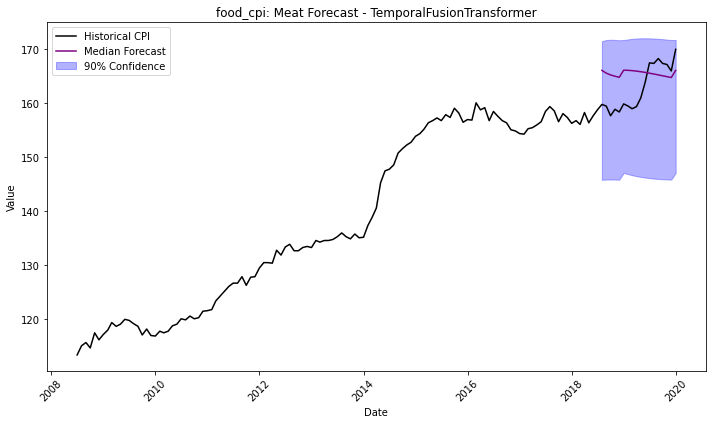

Beginning AutoGluon training... Time limit = 2s
AutoGluon will save models to './output/TEST/ag_global_all_TemporalFusionTransformerModel_exp2_R2_/random_seed_42/2018-07-01/model_files/'
=================== System Info ===================
AutoGluon Version:  1.1.1
Python Version:     3.8.20
Operating System:   Linux
Platform Machine:   x86_64
Platform Version:   #147~18.04.1-Ubuntu SMP Sat Oct 15 13:10:18 UTC 2022
CPU Count:          32
GPU Count:          1
Memory Avail:       166.76 GB / 188.57 GB (88.4%)
Disk Space Avail:   18209.27 GB / 249006.62 GB (7.3%)

Fitting with arguments:
{'enable_ensemble': True,
 'eval_metric': MAPE,
 'excluded_model_types': ['DirectTabular', 'RecursiveTabular'],
 'hyperparameters': {'TemporalFusionTransformerModel': {}},
 'known_covariates_names': [],
 'num_val_windows': 1,
 'prediction_length': 18,
 'quantile_levels': [0.01, 0.05, 0.1, 0.25, 0.75, 0.9, 0.95, 0.99],
 'random_seed': 42,
 'refit_every_n_windows': 1,
 'refit_full': False,
 'skip_model_sele

TemporalFusionTransformerModel


	-0.7197       = Validation score (-MAPE)
	2.11    s     = Training runtime
	0.05    s     = Validation (prediction) runtime
Not fitting ensemble due to lack of time remaining. Time left: -0.3 seconds
Training complete. Models trained: ['TemporalFusionTransformer']
Total runtime: 2.20 s
Best model: TemporalFusionTransformer
Best model score: -0.7197
Model not specified in predict, will default to the model with the best validation score: TemporalFusionTransformer
Model not specified in predict, will default to the model with the best validation score: TemporalFusionTransformer


****************** Summary of fit() ******************
Estimated performance of each model:
                       model  score_val  pred_time_val  fit_time_marginal  \
0  TemporalFusionTransformer  -0.719661       0.046287           2.113385   

   fit_order  
0          1  
Number of models trained: 1
Types of models trained:
{'MultiWindowBacktestingModel'}
****************** End of fit() summary ******************


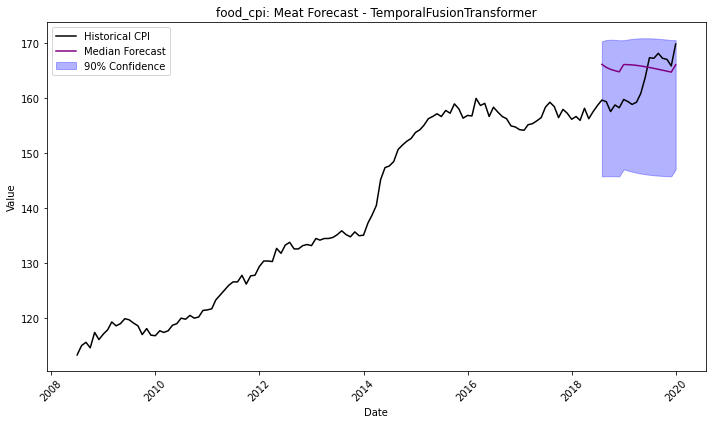

Beginning AutoGluon training... Time limit = 2s
AutoGluon will save models to './output/TEST/ag_global_all_TemporalFusionTransformerModel_exp2_GPT_P1_/random_seed_42/2018-07-01/model_files/'
=================== System Info ===================
AutoGluon Version:  1.1.1
Python Version:     3.8.20
Operating System:   Linux
Platform Machine:   x86_64
Platform Version:   #147~18.04.1-Ubuntu SMP Sat Oct 15 13:10:18 UTC 2022
CPU Count:          32
GPU Count:          1
Memory Avail:       166.75 GB / 188.57 GB (88.4%)
Disk Space Avail:   18209.26 GB / 249006.62 GB (7.3%)

Fitting with arguments:
{'enable_ensemble': True,
 'eval_metric': MAPE,
 'excluded_model_types': ['DirectTabular', 'RecursiveTabular'],
 'hyperparameters': {'TemporalFusionTransformerModel': {}},
 'known_covariates_names': [],
 'num_val_windows': 1,
 'prediction_length': 18,
 'quantile_levels': [0.01, 0.05, 0.1, 0.25, 0.75, 0.9, 0.95, 0.99],
 'random_seed': 42,
 'refit_every_n_windows': 1,
 'refit_full': False,
 'skip_model_

TemporalFusionTransformerModel


	-2.6363       = Validation score (-MAPE)
	2.12    s     = Training runtime
	0.04    s     = Validation (prediction) runtime
Not fitting ensemble due to lack of time remaining. Time left: -0.3 seconds
Training complete. Models trained: ['TemporalFusionTransformer']
Total runtime: 2.22 s
Best model: TemporalFusionTransformer
Best model score: -2.6363
Model not specified in predict, will default to the model with the best validation score: TemporalFusionTransformer
Model not specified in predict, will default to the model with the best validation score: TemporalFusionTransformer


****************** Summary of fit() ******************
Estimated performance of each model:
                       model  score_val  pred_time_val  fit_time_marginal  \
0  TemporalFusionTransformer   -2.63631        0.04416           2.123721   

   fit_order  
0          1  
Number of models trained: 1
Types of models trained:
{'MultiWindowBacktestingModel'}
****************** End of fit() summary ******************


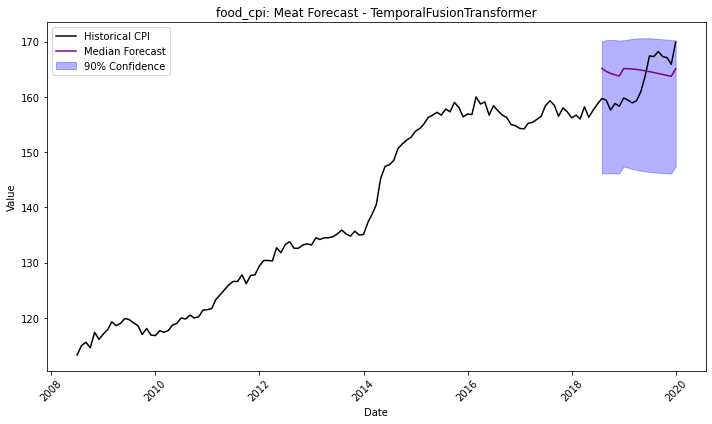

Beginning AutoGluon training... Time limit = 2s
AutoGluon will save models to './output/TEST/ag_global_all_TemporalFusionTransformerModel_exp2_GPT_P4_/random_seed_42/2018-07-01/model_files/'
=================== System Info ===================
AutoGluon Version:  1.1.1
Python Version:     3.8.20
Operating System:   Linux
Platform Machine:   x86_64
Platform Version:   #147~18.04.1-Ubuntu SMP Sat Oct 15 13:10:18 UTC 2022
CPU Count:          32
GPU Count:          1
Memory Avail:       166.76 GB / 188.57 GB (88.4%)
Disk Space Avail:   18209.25 GB / 249006.62 GB (7.3%)

Fitting with arguments:
{'enable_ensemble': True,
 'eval_metric': MAPE,
 'excluded_model_types': ['DirectTabular', 'RecursiveTabular'],
 'hyperparameters': {'TemporalFusionTransformerModel': {}},
 'known_covariates_names': [],
 'num_val_windows': 1,
 'prediction_length': 18,
 'quantile_levels': [0.01, 0.05, 0.1, 0.25, 0.75, 0.9, 0.95, 0.99],
 'random_seed': 42,
 'refit_every_n_windows': 1,
 'refit_full': False,
 'skip_model_

TemporalFusionTransformerModel


	-1.7787       = Validation score (-MAPE)
	2.15    s     = Training runtime
	0.04    s     = Validation (prediction) runtime
Not fitting ensemble due to lack of time remaining. Time left: -0.3 seconds
Training complete. Models trained: ['TemporalFusionTransformer']
Total runtime: 2.22 s
Best model: TemporalFusionTransformer
Best model score: -1.7787
Model not specified in predict, will default to the model with the best validation score: TemporalFusionTransformer
Model not specified in predict, will default to the model with the best validation score: TemporalFusionTransformer


****************** Summary of fit() ******************
Estimated performance of each model:
                       model  score_val  pred_time_val  fit_time_marginal  \
0  TemporalFusionTransformer  -1.778744       0.039261           2.145727   

   fit_order  
0          1  
Number of models trained: 1
Types of models trained:
{'MultiWindowBacktestingModel'}
****************** End of fit() summary ******************


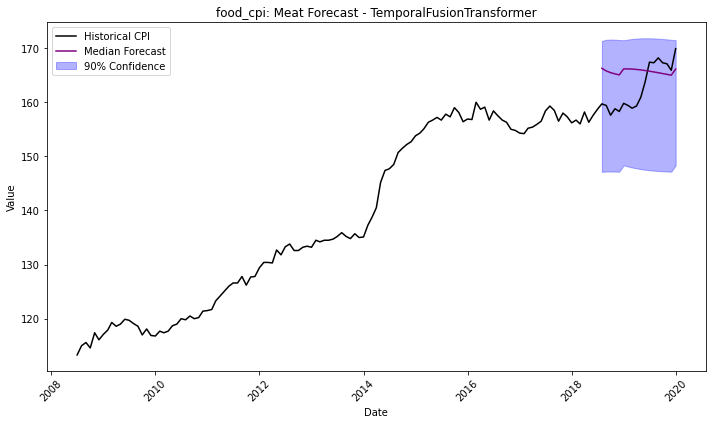

Beginning AutoGluon training... Time limit = 2s
AutoGluon will save models to './output/TEST/ag_global_all_TemporalFusionTransformerModel_exp2_GPT_P3_/random_seed_42/2018-07-01/model_files/'
=================== System Info ===================
AutoGluon Version:  1.1.1
Python Version:     3.8.20
Operating System:   Linux
Platform Machine:   x86_64
Platform Version:   #147~18.04.1-Ubuntu SMP Sat Oct 15 13:10:18 UTC 2022
CPU Count:          32
GPU Count:          1
Memory Avail:       166.76 GB / 188.57 GB (88.4%)
Disk Space Avail:   18209.24 GB / 249006.62 GB (7.3%)

Fitting with arguments:
{'enable_ensemble': True,
 'eval_metric': MAPE,
 'excluded_model_types': ['DirectTabular', 'RecursiveTabular'],
 'hyperparameters': {'TemporalFusionTransformerModel': {}},
 'known_covariates_names': [],
 'num_val_windows': 1,
 'prediction_length': 18,
 'quantile_levels': [0.01, 0.05, 0.1, 0.25, 0.75, 0.9, 0.95, 0.99],
 'random_seed': 42,
 'refit_every_n_windows': 1,
 'refit_full': False,
 'skip_model_

TemporalFusionTransformerModel


	-2.6954       = Validation score (-MAPE)
	2.46    s     = Training runtime
	0.04    s     = Validation (prediction) runtime
Not fitting ensemble due to lack of time remaining. Time left: -0.6 seconds
Training complete. Models trained: ['TemporalFusionTransformer']
Total runtime: 2.55 s
Best model: TemporalFusionTransformer
Best model score: -2.6954
Model not specified in predict, will default to the model with the best validation score: TemporalFusionTransformer
Model not specified in predict, will default to the model with the best validation score: TemporalFusionTransformer


****************** Summary of fit() ******************
Estimated performance of each model:
                       model  score_val  pred_time_val  fit_time_marginal  \
0  TemporalFusionTransformer  -2.695443       0.041214           2.459473   

   fit_order  
0          1  
Number of models trained: 1
Types of models trained:
{'MultiWindowBacktestingModel'}
****************** End of fit() summary ******************


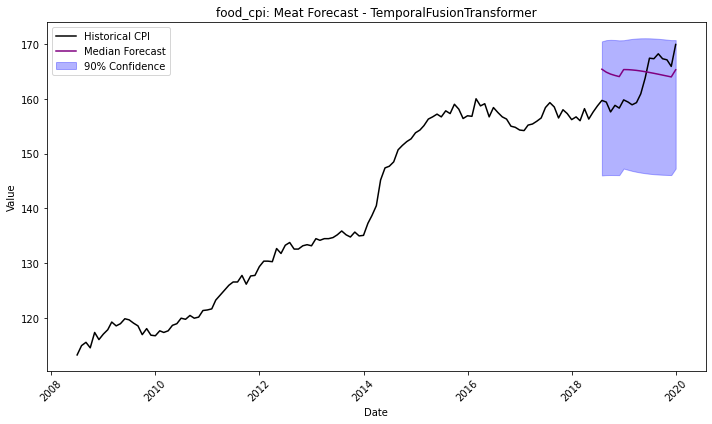

Beginning AutoGluon training... Time limit = 2s
AutoGluon will save models to './output/TEST/ag_global_all_TemporalFusionTransformerModel_exp2_GPT_P2_/random_seed_42/2018-07-01/model_files/'
=================== System Info ===================
AutoGluon Version:  1.1.1
Python Version:     3.8.20
Operating System:   Linux
Platform Machine:   x86_64
Platform Version:   #147~18.04.1-Ubuntu SMP Sat Oct 15 13:10:18 UTC 2022
CPU Count:          32
GPU Count:          1
Memory Avail:       166.76 GB / 188.57 GB (88.4%)
Disk Space Avail:   18209.29 GB / 249006.62 GB (7.3%)

Fitting with arguments:
{'enable_ensemble': True,
 'eval_metric': MAPE,
 'excluded_model_types': ['DirectTabular', 'RecursiveTabular'],
 'hyperparameters': {'TemporalFusionTransformerModel': {}},
 'known_covariates_names': [],
 'num_val_windows': 1,
 'prediction_length': 18,
 'quantile_levels': [0.01, 0.05, 0.1, 0.25, 0.75, 0.9, 0.95, 0.99],
 'random_seed': 42,
 'refit_every_n_windows': 1,
 'refit_full': False,
 'skip_model_

TemporalFusionTransformerModel


	-2.5301       = Validation score (-MAPE)
	2.13    s     = Training runtime
	0.04    s     = Validation (prediction) runtime
Not fitting ensemble due to lack of time remaining. Time left: -0.3 seconds
Training complete. Models trained: ['TemporalFusionTransformer']
Total runtime: 2.21 s
Best model: TemporalFusionTransformer
Best model score: -2.5301
Model not specified in predict, will default to the model with the best validation score: TemporalFusionTransformer
Model not specified in predict, will default to the model with the best validation score: TemporalFusionTransformer


****************** Summary of fit() ******************
Estimated performance of each model:
                       model  score_val  pred_time_val  fit_time_marginal  \
0  TemporalFusionTransformer  -2.530081       0.039424           2.132711   

   fit_order  
0          1  
Number of models trained: 1
Types of models trained:
{'MultiWindowBacktestingModel'}
****************** End of fit() summary ******************


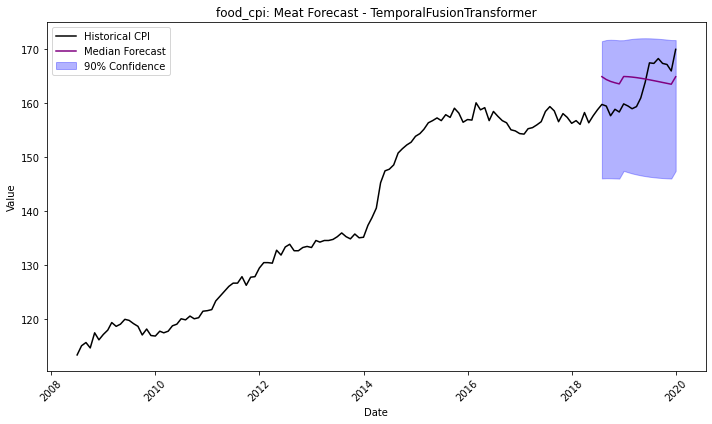

Beginning AutoGluon training... Time limit = 2s
AutoGluon will save models to './output/TEST/ag_global_all_TemporalFusionTransformerModel_exp2_R4_/random_seed_42/2019-07-01/model_files/'
=================== System Info ===================
AutoGluon Version:  1.1.1
Python Version:     3.8.20
Operating System:   Linux
Platform Machine:   x86_64
Platform Version:   #147~18.04.1-Ubuntu SMP Sat Oct 15 13:10:18 UTC 2022
CPU Count:          32
GPU Count:          1
Memory Avail:       166.76 GB / 188.57 GB (88.4%)
Disk Space Avail:   18209.28 GB / 249006.62 GB (7.3%)

Fitting with arguments:
{'enable_ensemble': True,
 'eval_metric': MAPE,
 'excluded_model_types': ['DirectTabular', 'RecursiveTabular'],
 'hyperparameters': {'TemporalFusionTransformerModel': {}},
 'known_covariates_names': [],
 'num_val_windows': 1,
 'prediction_length': 18,
 'quantile_levels': [0.01, 0.05, 0.1, 0.25, 0.75, 0.9, 0.95, 0.99],
 'random_seed': 42,
 'refit_every_n_windows': 1,
 'refit_full': False,
 'skip_model_sele

TemporalFusionTransformerModel


	-0.5634       = Validation score (-MAPE)
	2.12    s     = Training runtime
	0.05    s     = Validation (prediction) runtime
Not fitting ensemble due to lack of time remaining. Time left: -0.3 seconds
Training complete. Models trained: ['TemporalFusionTransformer']
Total runtime: 2.20 s
Best model: TemporalFusionTransformer
Best model score: -0.5634
Model not specified in predict, will default to the model with the best validation score: TemporalFusionTransformer
Model not specified in predict, will default to the model with the best validation score: TemporalFusionTransformer


****************** Summary of fit() ******************
Estimated performance of each model:
                       model  score_val  pred_time_val  fit_time_marginal  \
0  TemporalFusionTransformer  -0.563434         0.0451           2.122894   

   fit_order  
0          1  
Number of models trained: 1
Types of models trained:
{'MultiWindowBacktestingModel'}
****************** End of fit() summary ******************


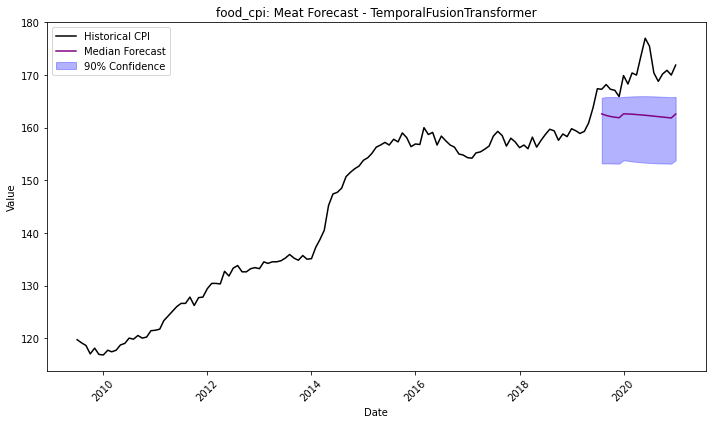

Beginning AutoGluon training... Time limit = 2s
AutoGluon will save models to './output/TEST/ag_global_all_TemporalFusionTransformerModel_exp2_R1_/random_seed_42/2019-07-01/model_files/'
=================== System Info ===================
AutoGluon Version:  1.1.1
Python Version:     3.8.20
Operating System:   Linux
Platform Machine:   x86_64
Platform Version:   #147~18.04.1-Ubuntu SMP Sat Oct 15 13:10:18 UTC 2022
CPU Count:          32
GPU Count:          1
Memory Avail:       166.76 GB / 188.57 GB (88.4%)
Disk Space Avail:   18209.27 GB / 249006.62 GB (7.3%)

Fitting with arguments:
{'enable_ensemble': True,
 'eval_metric': MAPE,
 'excluded_model_types': ['DirectTabular', 'RecursiveTabular'],
 'hyperparameters': {'TemporalFusionTransformerModel': {}},
 'known_covariates_names': [],
 'num_val_windows': 1,
 'prediction_length': 18,
 'quantile_levels': [0.01, 0.05, 0.1, 0.25, 0.75, 0.9, 0.95, 0.99],
 'random_seed': 42,
 'refit_every_n_windows': 1,
 'refit_full': False,
 'skip_model_sele

TemporalFusionTransformerModel


	-0.7702       = Validation score (-MAPE)
	2.14    s     = Training runtime
	0.04    s     = Validation (prediction) runtime
Not fitting ensemble due to lack of time remaining. Time left: -0.3 seconds
Training complete. Models trained: ['TemporalFusionTransformer']
Total runtime: 2.23 s
Best model: TemporalFusionTransformer
Best model score: -0.7702
Model not specified in predict, will default to the model with the best validation score: TemporalFusionTransformer
Model not specified in predict, will default to the model with the best validation score: TemporalFusionTransformer


****************** Summary of fit() ******************
Estimated performance of each model:
                       model  score_val  pred_time_val  fit_time_marginal  \
0  TemporalFusionTransformer  -0.770203       0.041872           2.143736   

   fit_order  
0          1  
Number of models trained: 1
Types of models trained:
{'MultiWindowBacktestingModel'}
****************** End of fit() summary ******************


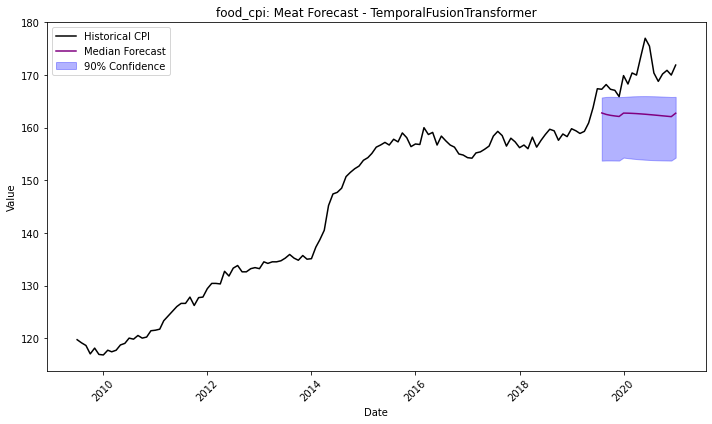

Beginning AutoGluon training... Time limit = 2s
AutoGluon will save models to './output/TEST/ag_global_all_TemporalFusionTransformerModel_exp2_R3_/random_seed_42/2019-07-01/model_files/'
=================== System Info ===================
AutoGluon Version:  1.1.1
Python Version:     3.8.20
Operating System:   Linux
Platform Machine:   x86_64
Platform Version:   #147~18.04.1-Ubuntu SMP Sat Oct 15 13:10:18 UTC 2022
CPU Count:          32
GPU Count:          1
Memory Avail:       166.76 GB / 188.57 GB (88.4%)
Disk Space Avail:   18209.26 GB / 249006.62 GB (7.3%)

Fitting with arguments:
{'enable_ensemble': True,
 'eval_metric': MAPE,
 'excluded_model_types': ['DirectTabular', 'RecursiveTabular'],
 'hyperparameters': {'TemporalFusionTransformerModel': {}},
 'known_covariates_names': [],
 'num_val_windows': 1,
 'prediction_length': 18,
 'quantile_levels': [0.01, 0.05, 0.1, 0.25, 0.75, 0.9, 0.95, 0.99],
 'random_seed': 42,
 'refit_every_n_windows': 1,
 'refit_full': False,
 'skip_model_sele

TemporalFusionTransformerModel


	-0.7058       = Validation score (-MAPE)
	2.12    s     = Training runtime
	0.04    s     = Validation (prediction) runtime
Not fitting ensemble due to lack of time remaining. Time left: -0.2 seconds
Training complete. Models trained: ['TemporalFusionTransformer']
Total runtime: 2.20 s
Best model: TemporalFusionTransformer
Best model score: -0.7058
Model not specified in predict, will default to the model with the best validation score: TemporalFusionTransformer
Model not specified in predict, will default to the model with the best validation score: TemporalFusionTransformer


****************** Summary of fit() ******************
Estimated performance of each model:
                       model  score_val  pred_time_val  fit_time_marginal  \
0  TemporalFusionTransformer  -0.705779       0.042084            2.11684   

   fit_order  
0          1  
Number of models trained: 1
Types of models trained:
{'MultiWindowBacktestingModel'}
****************** End of fit() summary ******************


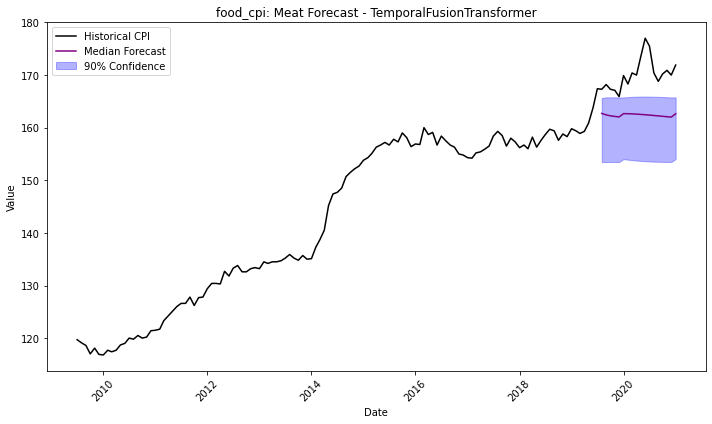

Beginning AutoGluon training... Time limit = 2s
AutoGluon will save models to './output/TEST/ag_global_all_TemporalFusionTransformerModel_exp2_R2_/random_seed_42/2019-07-01/model_files/'
=================== System Info ===================
AutoGluon Version:  1.1.1
Python Version:     3.8.20
Operating System:   Linux
Platform Machine:   x86_64
Platform Version:   #147~18.04.1-Ubuntu SMP Sat Oct 15 13:10:18 UTC 2022
CPU Count:          32
GPU Count:          1
Memory Avail:       166.76 GB / 188.57 GB (88.4%)
Disk Space Avail:   18209.25 GB / 249006.62 GB (7.3%)

Fitting with arguments:
{'enable_ensemble': True,
 'eval_metric': MAPE,
 'excluded_model_types': ['DirectTabular', 'RecursiveTabular'],
 'hyperparameters': {'TemporalFusionTransformerModel': {}},
 'known_covariates_names': [],
 'num_val_windows': 1,
 'prediction_length': 18,
 'quantile_levels': [0.01, 0.05, 0.1, 0.25, 0.75, 0.9, 0.95, 0.99],
 'random_seed': 42,
 'refit_every_n_windows': 1,
 'refit_full': False,
 'skip_model_sele

TemporalFusionTransformerModel


	-0.3725       = Validation score (-MAPE)
	2.41    s     = Training runtime
	0.04    s     = Validation (prediction) runtime
Not fitting ensemble due to lack of time remaining. Time left: -0.6 seconds
Training complete. Models trained: ['TemporalFusionTransformer']
Total runtime: 2.50 s
Best model: TemporalFusionTransformer
Best model score: -0.3725
Model not specified in predict, will default to the model with the best validation score: TemporalFusionTransformer
Model not specified in predict, will default to the model with the best validation score: TemporalFusionTransformer


****************** Summary of fit() ******************
Estimated performance of each model:
                       model  score_val  pred_time_val  fit_time_marginal  \
0  TemporalFusionTransformer  -0.372505        0.04343           2.414651   

   fit_order  
0          1  
Number of models trained: 1
Types of models trained:
{'MultiWindowBacktestingModel'}
****************** End of fit() summary ******************


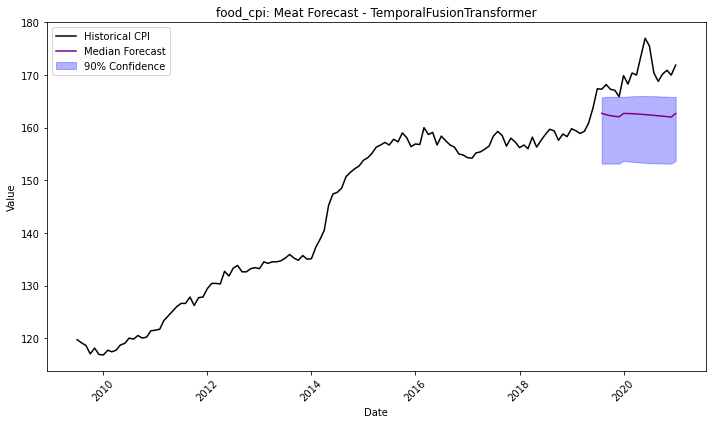

Beginning AutoGluon training... Time limit = 2s
AutoGluon will save models to './output/TEST/ag_global_all_TemporalFusionTransformerModel_exp2_GPT_P1_/random_seed_42/2019-07-01/model_files/'
=================== System Info ===================
AutoGluon Version:  1.1.1
Python Version:     3.8.20
Operating System:   Linux
Platform Machine:   x86_64
Platform Version:   #147~18.04.1-Ubuntu SMP Sat Oct 15 13:10:18 UTC 2022
CPU Count:          32
GPU Count:          1
Memory Avail:       166.76 GB / 188.57 GB (88.4%)
Disk Space Avail:   18209.24 GB / 249006.62 GB (7.3%)

Fitting with arguments:
{'enable_ensemble': True,
 'eval_metric': MAPE,
 'excluded_model_types': ['DirectTabular', 'RecursiveTabular'],
 'hyperparameters': {'TemporalFusionTransformerModel': {}},
 'known_covariates_names': [],
 'num_val_windows': 1,
 'prediction_length': 18,
 'quantile_levels': [0.01, 0.05, 0.1, 0.25, 0.75, 0.9, 0.95, 0.99],
 'random_seed': 42,
 'refit_every_n_windows': 1,
 'refit_full': False,
 'skip_model_

TemporalFusionTransformerModel


	-1.0643       = Validation score (-MAPE)
	2.14    s     = Training runtime
	0.04    s     = Validation (prediction) runtime
Not fitting ensemble due to lack of time remaining. Time left: -0.3 seconds
Training complete. Models trained: ['TemporalFusionTransformer']
Total runtime: 2.21 s
Best model: TemporalFusionTransformer
Best model score: -1.0643
Model not specified in predict, will default to the model with the best validation score: TemporalFusionTransformer
Model not specified in predict, will default to the model with the best validation score: TemporalFusionTransformer


****************** Summary of fit() ******************
Estimated performance of each model:
                       model  score_val  pred_time_val  fit_time_marginal  \
0  TemporalFusionTransformer  -1.064345       0.043483           2.135115   

   fit_order  
0          1  
Number of models trained: 1
Types of models trained:
{'MultiWindowBacktestingModel'}
****************** End of fit() summary ******************


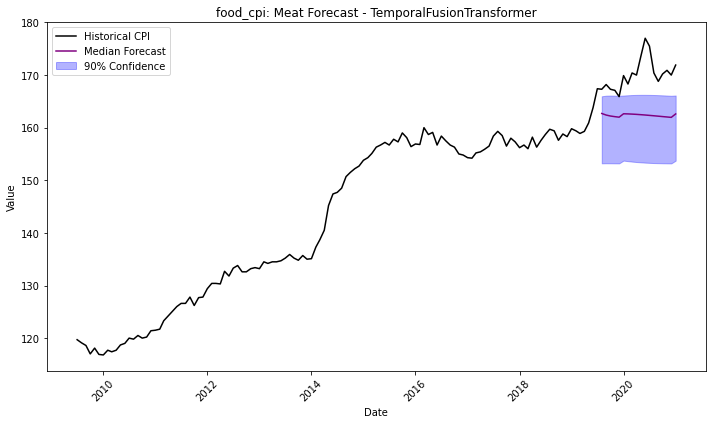

Beginning AutoGluon training... Time limit = 2s
AutoGluon will save models to './output/TEST/ag_global_all_TemporalFusionTransformerModel_exp2_GPT_P4_/random_seed_42/2019-07-01/model_files/'
=================== System Info ===================
AutoGluon Version:  1.1.1
Python Version:     3.8.20
Operating System:   Linux
Platform Machine:   x86_64
Platform Version:   #147~18.04.1-Ubuntu SMP Sat Oct 15 13:10:18 UTC 2022
CPU Count:          32
GPU Count:          1
Memory Avail:       166.76 GB / 188.57 GB (88.4%)
Disk Space Avail:   18209.30 GB / 249006.62 GB (7.3%)

Fitting with arguments:
{'enable_ensemble': True,
 'eval_metric': MAPE,
 'excluded_model_types': ['DirectTabular', 'RecursiveTabular'],
 'hyperparameters': {'TemporalFusionTransformerModel': {}},
 'known_covariates_names': [],
 'num_val_windows': 1,
 'prediction_length': 18,
 'quantile_levels': [0.01, 0.05, 0.1, 0.25, 0.75, 0.9, 0.95, 0.99],
 'random_seed': 42,
 'refit_every_n_windows': 1,
 'refit_full': False,
 'skip_model_

TemporalFusionTransformerModel


	-0.7058       = Validation score (-MAPE)
	2.10    s     = Training runtime
	0.04    s     = Validation (prediction) runtime
Not fitting ensemble due to lack of time remaining. Time left: -0.2 seconds
Training complete. Models trained: ['TemporalFusionTransformer']
Total runtime: 2.18 s
Best model: TemporalFusionTransformer
Best model score: -0.7058
Model not specified in predict, will default to the model with the best validation score: TemporalFusionTransformer
Model not specified in predict, will default to the model with the best validation score: TemporalFusionTransformer


****************** Summary of fit() ******************
Estimated performance of each model:
                       model  score_val  pred_time_val  fit_time_marginal  \
0  TemporalFusionTransformer  -0.705773       0.044211           2.099524   

   fit_order  
0          1  
Number of models trained: 1
Types of models trained:
{'MultiWindowBacktestingModel'}
****************** End of fit() summary ******************


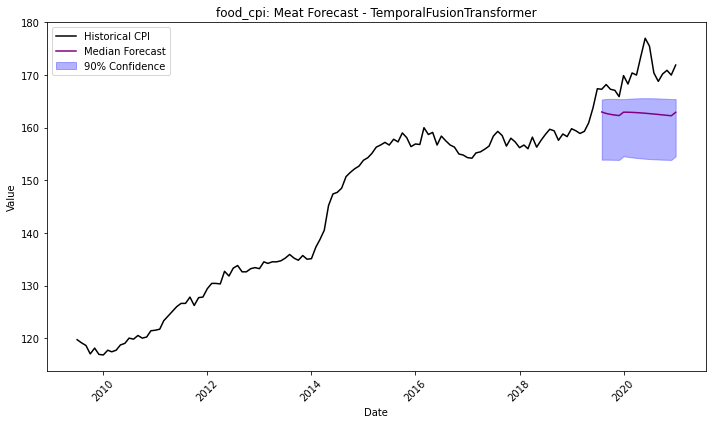

Beginning AutoGluon training... Time limit = 2s
AutoGluon will save models to './output/TEST/ag_global_all_TemporalFusionTransformerModel_exp2_GPT_P3_/random_seed_42/2019-07-01/model_files/'
=================== System Info ===================
AutoGluon Version:  1.1.1
Python Version:     3.8.20
Operating System:   Linux
Platform Machine:   x86_64
Platform Version:   #147~18.04.1-Ubuntu SMP Sat Oct 15 13:10:18 UTC 2022
CPU Count:          32
GPU Count:          1
Memory Avail:       166.76 GB / 188.57 GB (88.4%)
Disk Space Avail:   18209.29 GB / 249006.62 GB (7.3%)

Fitting with arguments:
{'enable_ensemble': True,
 'eval_metric': MAPE,
 'excluded_model_types': ['DirectTabular', 'RecursiveTabular'],
 'hyperparameters': {'TemporalFusionTransformerModel': {}},
 'known_covariates_names': [],
 'num_val_windows': 1,
 'prediction_length': 18,
 'quantile_levels': [0.01, 0.05, 0.1, 0.25, 0.75, 0.9, 0.95, 0.99],
 'random_seed': 42,
 'refit_every_n_windows': 1,
 'refit_full': False,
 'skip_model_

TemporalFusionTransformerModel


	-1.0773       = Validation score (-MAPE)
	2.12    s     = Training runtime
	0.04    s     = Validation (prediction) runtime
Not fitting ensemble due to lack of time remaining. Time left: -0.3 seconds
Training complete. Models trained: ['TemporalFusionTransformer']
Total runtime: 2.21 s
Best model: TemporalFusionTransformer
Best model score: -1.0773
Model not specified in predict, will default to the model with the best validation score: TemporalFusionTransformer
Model not specified in predict, will default to the model with the best validation score: TemporalFusionTransformer


****************** Summary of fit() ******************
Estimated performance of each model:
                       model  score_val  pred_time_val  fit_time_marginal  \
0  TemporalFusionTransformer  -1.077263       0.043958           2.123739   

   fit_order  
0          1  
Number of models trained: 1
Types of models trained:
{'MultiWindowBacktestingModel'}
****************** End of fit() summary ******************


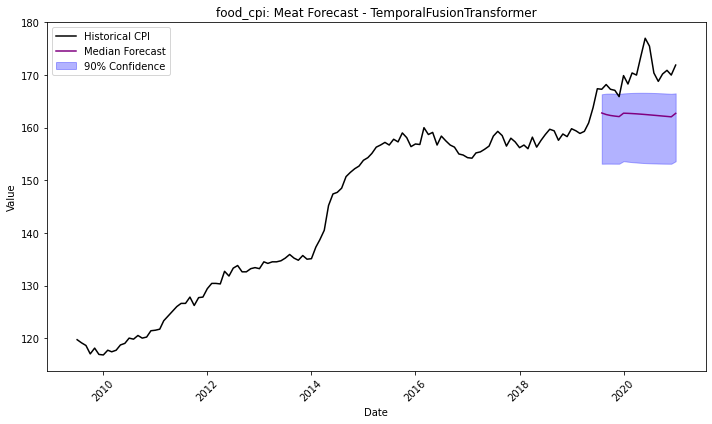

Beginning AutoGluon training... Time limit = 2s
AutoGluon will save models to './output/TEST/ag_global_all_TemporalFusionTransformerModel_exp2_GPT_P2_/random_seed_42/2019-07-01/model_files/'
=================== System Info ===================
AutoGluon Version:  1.1.1
Python Version:     3.8.20
Operating System:   Linux
Platform Machine:   x86_64
Platform Version:   #147~18.04.1-Ubuntu SMP Sat Oct 15 13:10:18 UTC 2022
CPU Count:          32
GPU Count:          1
Memory Avail:       166.80 GB / 188.57 GB (88.5%)
Disk Space Avail:   18209.28 GB / 249006.62 GB (7.3%)

Fitting with arguments:
{'enable_ensemble': True,
 'eval_metric': MAPE,
 'excluded_model_types': ['DirectTabular', 'RecursiveTabular'],
 'hyperparameters': {'TemporalFusionTransformerModel': {}},
 'known_covariates_names': [],
 'num_val_windows': 1,
 'prediction_length': 18,
 'quantile_levels': [0.01, 0.05, 0.1, 0.25, 0.75, 0.9, 0.95, 0.99],
 'random_seed': 42,
 'refit_every_n_windows': 1,
 'refit_full': False,
 'skip_model_

TemporalFusionTransformerModel


	-1.1117       = Validation score (-MAPE)
	2.13    s     = Training runtime
	0.04    s     = Validation (prediction) runtime
Not fitting ensemble due to lack of time remaining. Time left: -0.3 seconds
Training complete. Models trained: ['TemporalFusionTransformer']
Total runtime: 2.20 s
Best model: TemporalFusionTransformer
Best model score: -1.1117
Model not specified in predict, will default to the model with the best validation score: TemporalFusionTransformer
Model not specified in predict, will default to the model with the best validation score: TemporalFusionTransformer


****************** Summary of fit() ******************
Estimated performance of each model:
                       model  score_val  pred_time_val  fit_time_marginal  \
0  TemporalFusionTransformer   -1.11168       0.040245            2.12586   

   fit_order  
0          1  
Number of models trained: 1
Types of models trained:
{'MultiWindowBacktestingModel'}
****************** End of fit() summary ******************


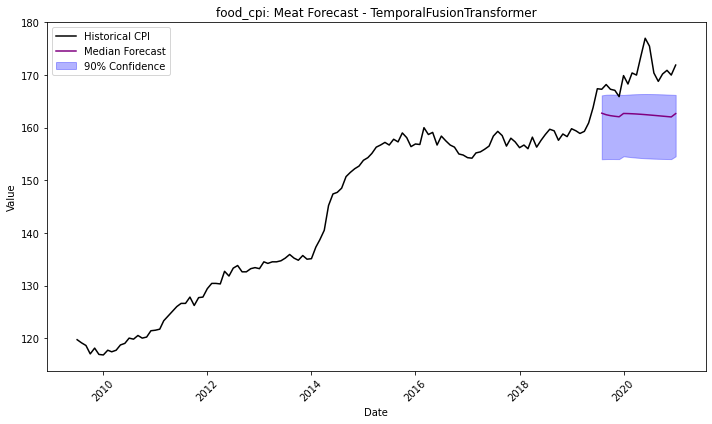

Beginning AutoGluon training... Time limit = 2s
AutoGluon will save models to './output/TEST/ag_global_all_TemporalFusionTransformerModel_exp2_R4_/random_seed_42/2020-07-01/model_files/'
=================== System Info ===================
AutoGluon Version:  1.1.1
Python Version:     3.8.20
Operating System:   Linux
Platform Machine:   x86_64
Platform Version:   #147~18.04.1-Ubuntu SMP Sat Oct 15 13:10:18 UTC 2022
CPU Count:          32
GPU Count:          1
Memory Avail:       166.75 GB / 188.57 GB (88.4%)
Disk Space Avail:   18209.27 GB / 249006.62 GB (7.3%)

Fitting with arguments:
{'enable_ensemble': True,
 'eval_metric': MAPE,
 'excluded_model_types': ['DirectTabular', 'RecursiveTabular'],
 'hyperparameters': {'TemporalFusionTransformerModel': {}},
 'known_covariates_names': [],
 'num_val_windows': 1,
 'prediction_length': 18,
 'quantile_levels': [0.01, 0.05, 0.1, 0.25, 0.75, 0.9, 0.95, 0.99],
 'random_seed': 42,
 'refit_every_n_windows': 1,
 'refit_full': False,
 'skip_model_sele

TemporalFusionTransformerModel


	-0.5329       = Validation score (-MAPE)
	2.12    s     = Training runtime
	0.04    s     = Validation (prediction) runtime
Not fitting ensemble due to lack of time remaining. Time left: -0.3 seconds
Training complete. Models trained: ['TemporalFusionTransformer']
Total runtime: 2.20 s
Best model: TemporalFusionTransformer
Best model score: -0.5329
Model not specified in predict, will default to the model with the best validation score: TemporalFusionTransformer


****************** Summary of fit() ******************
Estimated performance of each model:
                       model  score_val  pred_time_val  fit_time_marginal  \
0  TemporalFusionTransformer  -0.532934       0.044043           2.117068   

   fit_order  
0          1  
Number of models trained: 1
Types of models trained:
{'MultiWindowBacktestingModel'}
****************** End of fit() summary ******************


Model not specified in predict, will default to the model with the best validation score: TemporalFusionTransformer


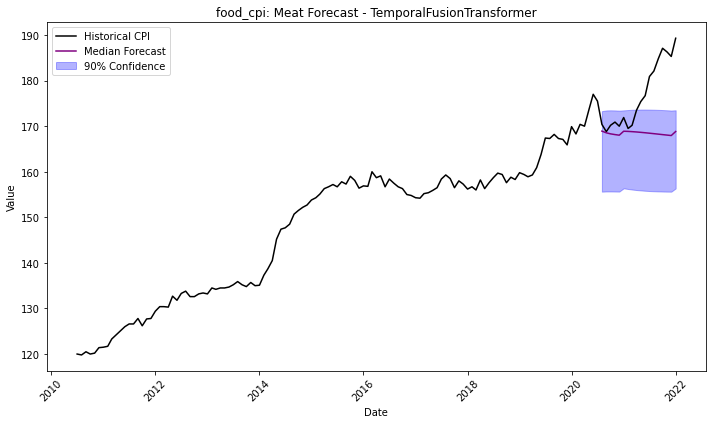

Beginning AutoGluon training... Time limit = 2s
AutoGluon will save models to './output/TEST/ag_global_all_TemporalFusionTransformerModel_exp2_R1_/random_seed_42/2020-07-01/model_files/'
=================== System Info ===================
AutoGluon Version:  1.1.1
Python Version:     3.8.20
Operating System:   Linux
Platform Machine:   x86_64
Platform Version:   #147~18.04.1-Ubuntu SMP Sat Oct 15 13:10:18 UTC 2022
CPU Count:          32
GPU Count:          1
Memory Avail:       166.75 GB / 188.57 GB (88.4%)
Disk Space Avail:   18209.25 GB / 249006.62 GB (7.3%)

Fitting with arguments:
{'enable_ensemble': True,
 'eval_metric': MAPE,
 'excluded_model_types': ['DirectTabular', 'RecursiveTabular'],
 'hyperparameters': {'TemporalFusionTransformerModel': {}},
 'known_covariates_names': [],
 'num_val_windows': 1,
 'prediction_length': 18,
 'quantile_levels': [0.01, 0.05, 0.1, 0.25, 0.75, 0.9, 0.95, 0.99],
 'random_seed': 42,
 'refit_every_n_windows': 1,
 'refit_full': False,
 'skip_model_sele

TemporalFusionTransformerModel


	-2.6318       = Validation score (-MAPE)
	2.12    s     = Training runtime
	0.05    s     = Validation (prediction) runtime
Not fitting ensemble due to lack of time remaining. Time left: -0.3 seconds
Training complete. Models trained: ['TemporalFusionTransformer']
Total runtime: 2.20 s
Best model: TemporalFusionTransformer
Best model score: -2.6318
Model not specified in predict, will default to the model with the best validation score: TemporalFusionTransformer
Model not specified in predict, will default to the model with the best validation score: TemporalFusionTransformer


****************** Summary of fit() ******************
Estimated performance of each model:
                       model  score_val  pred_time_val  fit_time_marginal  \
0  TemporalFusionTransformer  -2.631774        0.04786           2.117743   

   fit_order  
0          1  
Number of models trained: 1
Types of models trained:
{'MultiWindowBacktestingModel'}
****************** End of fit() summary ******************


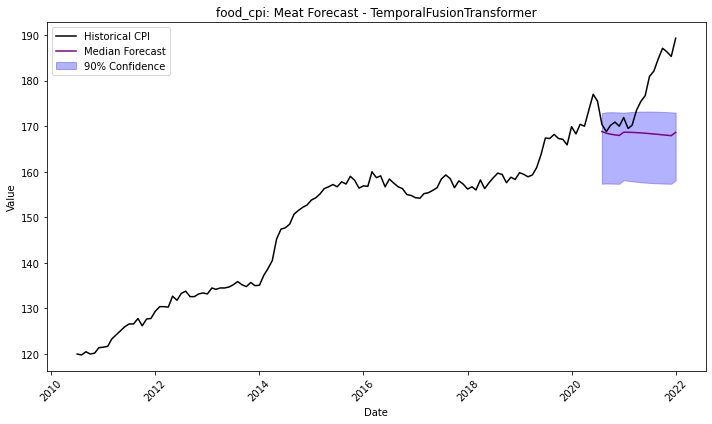

Beginning AutoGluon training... Time limit = 2s
AutoGluon will save models to './output/TEST/ag_global_all_TemporalFusionTransformerModel_exp2_R3_/random_seed_42/2020-07-01/model_files/'
=================== System Info ===================
AutoGluon Version:  1.1.1
Python Version:     3.8.20
Operating System:   Linux
Platform Machine:   x86_64
Platform Version:   #147~18.04.1-Ubuntu SMP Sat Oct 15 13:10:18 UTC 2022
CPU Count:          32
GPU Count:          1
Memory Avail:       166.75 GB / 188.57 GB (88.4%)
Disk Space Avail:   18209.25 GB / 249006.62 GB (7.3%)

Fitting with arguments:
{'enable_ensemble': True,
 'eval_metric': MAPE,
 'excluded_model_types': ['DirectTabular', 'RecursiveTabular'],
 'hyperparameters': {'TemporalFusionTransformerModel': {}},
 'known_covariates_names': [],
 'num_val_windows': 1,
 'prediction_length': 18,
 'quantile_levels': [0.01, 0.05, 0.1, 0.25, 0.75, 0.9, 0.95, 0.99],
 'random_seed': 42,
 'refit_every_n_windows': 1,
 'refit_full': False,
 'skip_model_sele

TemporalFusionTransformerModel


	-0.5794       = Validation score (-MAPE)
	2.13    s     = Training runtime
	0.04    s     = Validation (prediction) runtime
Not fitting ensemble due to lack of time remaining. Time left: -0.3 seconds
Training complete. Models trained: ['TemporalFusionTransformer']
Total runtime: 2.22 s
Best model: TemporalFusionTransformer
Best model score: -0.5794
Model not specified in predict, will default to the model with the best validation score: TemporalFusionTransformer
Model not specified in predict, will default to the model with the best validation score: TemporalFusionTransformer


****************** Summary of fit() ******************
Estimated performance of each model:
                       model  score_val  pred_time_val  fit_time_marginal  \
0  TemporalFusionTransformer  -0.579425        0.04374           2.131352   

   fit_order  
0          1  
Number of models trained: 1
Types of models trained:
{'MultiWindowBacktestingModel'}
****************** End of fit() summary ******************


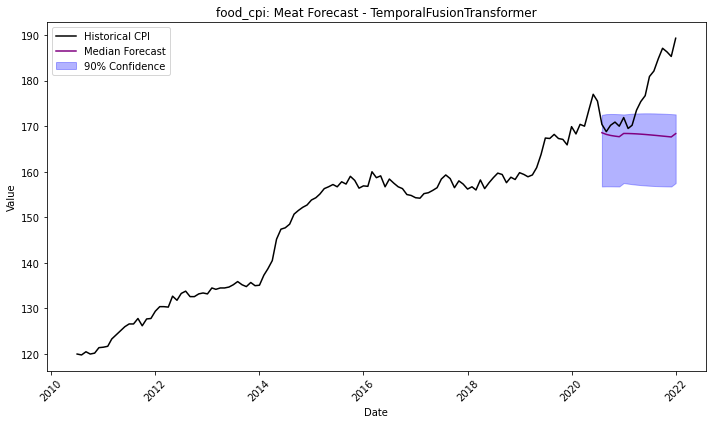

Beginning AutoGluon training... Time limit = 2s
AutoGluon will save models to './output/TEST/ag_global_all_TemporalFusionTransformerModel_exp2_R2_/random_seed_42/2020-07-01/model_files/'
=================== System Info ===================
AutoGluon Version:  1.1.1
Python Version:     3.8.20
Operating System:   Linux
Platform Machine:   x86_64
Platform Version:   #147~18.04.1-Ubuntu SMP Sat Oct 15 13:10:18 UTC 2022
CPU Count:          32
GPU Count:          1
Memory Avail:       166.76 GB / 188.57 GB (88.4%)
Disk Space Avail:   18209.29 GB / 249006.62 GB (7.3%)

Fitting with arguments:
{'enable_ensemble': True,
 'eval_metric': MAPE,
 'excluded_model_types': ['DirectTabular', 'RecursiveTabular'],
 'hyperparameters': {'TemporalFusionTransformerModel': {}},
 'known_covariates_names': [],
 'num_val_windows': 1,
 'prediction_length': 18,
 'quantile_levels': [0.01, 0.05, 0.1, 0.25, 0.75, 0.9, 0.95, 0.99],
 'random_seed': 42,
 'refit_every_n_windows': 1,
 'refit_full': False,
 'skip_model_sele

TemporalFusionTransformerModel


	-0.3764       = Validation score (-MAPE)
	2.14    s     = Training runtime
	0.04    s     = Validation (prediction) runtime
Not fitting ensemble due to lack of time remaining. Time left: -0.3 seconds
Training complete. Models trained: ['TemporalFusionTransformer']
Total runtime: 2.22 s
Best model: TemporalFusionTransformer
Best model score: -0.3764
Model not specified in predict, will default to the model with the best validation score: TemporalFusionTransformer
Model not specified in predict, will default to the model with the best validation score: TemporalFusionTransformer


****************** Summary of fit() ******************
Estimated performance of each model:
                       model  score_val  pred_time_val  fit_time_marginal  \
0  TemporalFusionTransformer   -0.37641       0.042049           2.137669   

   fit_order  
0          1  
Number of models trained: 1
Types of models trained:
{'MultiWindowBacktestingModel'}
****************** End of fit() summary ******************


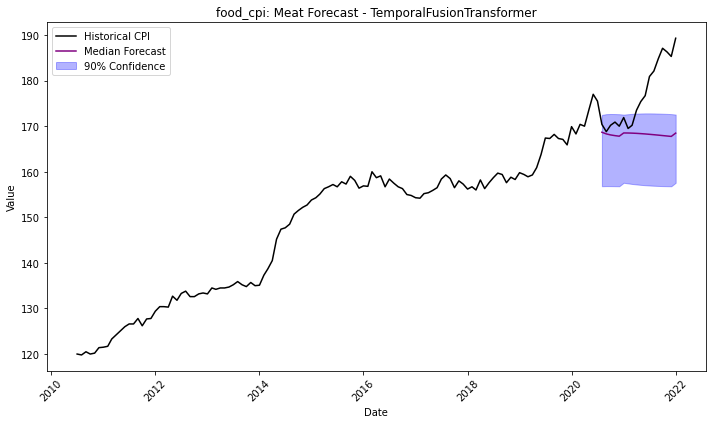

Beginning AutoGluon training... Time limit = 2s
AutoGluon will save models to './output/TEST/ag_global_all_TemporalFusionTransformerModel_exp2_GPT_P1_/random_seed_42/2020-07-01/model_files/'
=================== System Info ===================
AutoGluon Version:  1.1.1
Python Version:     3.8.20
Operating System:   Linux
Platform Machine:   x86_64
Platform Version:   #147~18.04.1-Ubuntu SMP Sat Oct 15 13:10:18 UTC 2022
CPU Count:          32
GPU Count:          1
Memory Avail:       166.75 GB / 188.57 GB (88.4%)
Disk Space Avail:   18209.29 GB / 249006.62 GB (7.3%)

Fitting with arguments:
{'enable_ensemble': True,
 'eval_metric': MAPE,
 'excluded_model_types': ['DirectTabular', 'RecursiveTabular'],
 'hyperparameters': {'TemporalFusionTransformerModel': {}},
 'known_covariates_names': [],
 'num_val_windows': 1,
 'prediction_length': 18,
 'quantile_levels': [0.01, 0.05, 0.1, 0.25, 0.75, 0.9, 0.95, 0.99],
 'random_seed': 42,
 'refit_every_n_windows': 1,
 'refit_full': False,
 'skip_model_

TemporalFusionTransformerModel


	-0.8344       = Validation score (-MAPE)
	2.17    s     = Training runtime
	0.04    s     = Validation (prediction) runtime
Not fitting ensemble due to lack of time remaining. Time left: -0.3 seconds
Training complete. Models trained: ['TemporalFusionTransformer']
Total runtime: 2.25 s
Best model: TemporalFusionTransformer
Best model score: -0.8344
Model not specified in predict, will default to the model with the best validation score: TemporalFusionTransformer
Model not specified in predict, will default to the model with the best validation score: TemporalFusionTransformer


****************** Summary of fit() ******************
Estimated performance of each model:
                       model  score_val  pred_time_val  fit_time_marginal  \
0  TemporalFusionTransformer  -0.834396       0.043951           2.165184   

   fit_order  
0          1  
Number of models trained: 1
Types of models trained:
{'MultiWindowBacktestingModel'}
****************** End of fit() summary ******************


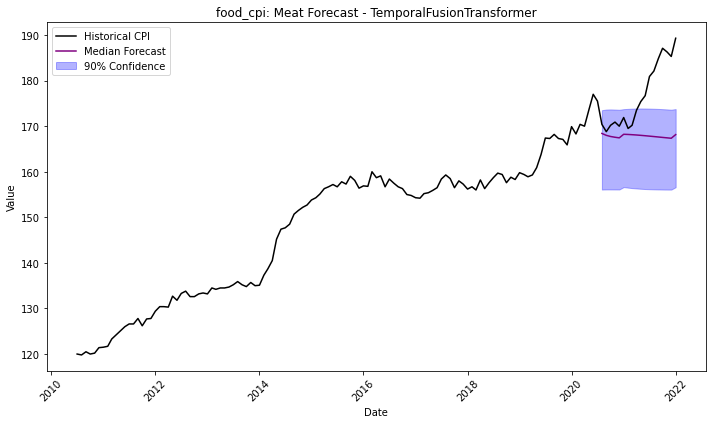

Beginning AutoGluon training... Time limit = 2s
AutoGluon will save models to './output/TEST/ag_global_all_TemporalFusionTransformerModel_exp2_GPT_P4_/random_seed_42/2020-07-01/model_files/'
=================== System Info ===================
AutoGluon Version:  1.1.1
Python Version:     3.8.20
Operating System:   Linux
Platform Machine:   x86_64
Platform Version:   #147~18.04.1-Ubuntu SMP Sat Oct 15 13:10:18 UTC 2022
CPU Count:          32
GPU Count:          1
Memory Avail:       166.75 GB / 188.57 GB (88.4%)
Disk Space Avail:   18209.27 GB / 249006.62 GB (7.3%)

Fitting with arguments:
{'enable_ensemble': True,
 'eval_metric': MAPE,
 'excluded_model_types': ['DirectTabular', 'RecursiveTabular'],
 'hyperparameters': {'TemporalFusionTransformerModel': {}},
 'known_covariates_names': [],
 'num_val_windows': 1,
 'prediction_length': 18,
 'quantile_levels': [0.01, 0.05, 0.1, 0.25, 0.75, 0.9, 0.95, 0.99],
 'random_seed': 42,
 'refit_every_n_windows': 1,
 'refit_full': False,
 'skip_model_

TemporalFusionTransformerModel


	-0.7045       = Validation score (-MAPE)
	2.13    s     = Training runtime
	0.04    s     = Validation (prediction) runtime
Not fitting ensemble due to lack of time remaining. Time left: -0.3 seconds
Training complete. Models trained: ['TemporalFusionTransformer']
Total runtime: 2.20 s
Best model: TemporalFusionTransformer
Best model score: -0.7045
Model not specified in predict, will default to the model with the best validation score: TemporalFusionTransformer
Model not specified in predict, will default to the model with the best validation score: TemporalFusionTransformer


****************** Summary of fit() ******************
Estimated performance of each model:
                       model  score_val  pred_time_val  fit_time_marginal  \
0  TemporalFusionTransformer  -0.704466       0.039365           2.128485   

   fit_order  
0          1  
Number of models trained: 1
Types of models trained:
{'MultiWindowBacktestingModel'}
****************** End of fit() summary ******************


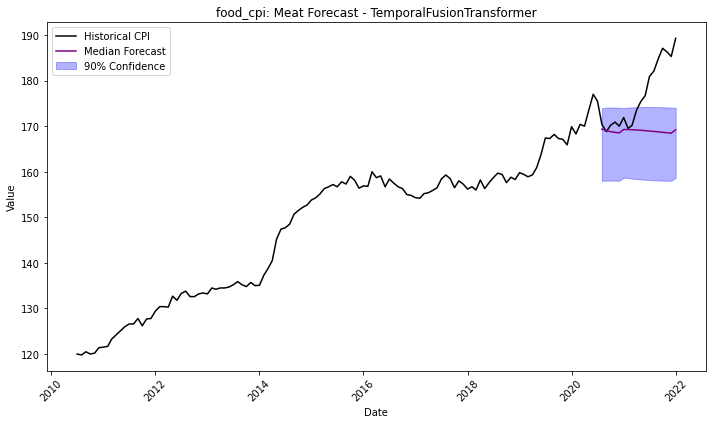

Beginning AutoGluon training... Time limit = 2s
AutoGluon will save models to './output/TEST/ag_global_all_TemporalFusionTransformerModel_exp2_GPT_P3_/random_seed_42/2020-07-01/model_files/'
=================== System Info ===================
AutoGluon Version:  1.1.1
Python Version:     3.8.20
Operating System:   Linux
Platform Machine:   x86_64
Platform Version:   #147~18.04.1-Ubuntu SMP Sat Oct 15 13:10:18 UTC 2022
CPU Count:          32
GPU Count:          1
Memory Avail:       166.75 GB / 188.57 GB (88.4%)
Disk Space Avail:   18208.10 GB / 249006.62 GB (7.3%)

Fitting with arguments:
{'enable_ensemble': True,
 'eval_metric': MAPE,
 'excluded_model_types': ['DirectTabular', 'RecursiveTabular'],
 'hyperparameters': {'TemporalFusionTransformerModel': {}},
 'known_covariates_names': [],
 'num_val_windows': 1,
 'prediction_length': 18,
 'quantile_levels': [0.01, 0.05, 0.1, 0.25, 0.75, 0.9, 0.95, 0.99],
 'random_seed': 42,
 'refit_every_n_windows': 1,
 'refit_full': False,
 'skip_model_

TemporalFusionTransformerModel


	-0.8338       = Validation score (-MAPE)
	2.41    s     = Training runtime
	0.04    s     = Validation (prediction) runtime
Not fitting ensemble due to lack of time remaining. Time left: -0.6 seconds
Training complete. Models trained: ['TemporalFusionTransformer']
Total runtime: 2.50 s
Best model: TemporalFusionTransformer
Best model score: -0.8338
Model not specified in predict, will default to the model with the best validation score: TemporalFusionTransformer
Model not specified in predict, will default to the model with the best validation score: TemporalFusionTransformer


****************** Summary of fit() ******************
Estimated performance of each model:
                       model  score_val  pred_time_val  fit_time_marginal  \
0  TemporalFusionTransformer  -0.833757       0.043359           2.408857   

   fit_order  
0          1  
Number of models trained: 1
Types of models trained:
{'MultiWindowBacktestingModel'}
****************** End of fit() summary ******************


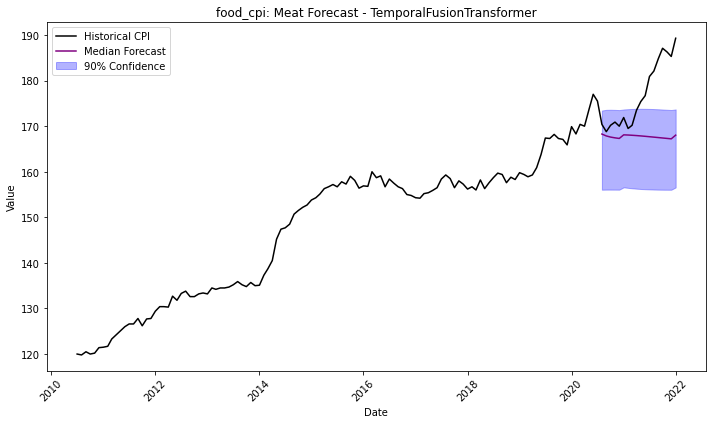

Beginning AutoGluon training... Time limit = 2s
AutoGluon will save models to './output/TEST/ag_global_all_TemporalFusionTransformerModel_exp2_GPT_P2_/random_seed_42/2020-07-01/model_files/'
=================== System Info ===================
AutoGluon Version:  1.1.1
Python Version:     3.8.20
Operating System:   Linux
Platform Machine:   x86_64
Platform Version:   #147~18.04.1-Ubuntu SMP Sat Oct 15 13:10:18 UTC 2022
CPU Count:          32
GPU Count:          1
Memory Avail:       166.78 GB / 188.57 GB (88.4%)
Disk Space Avail:   18208.18 GB / 249006.62 GB (7.3%)

Fitting with arguments:
{'enable_ensemble': True,
 'eval_metric': MAPE,
 'excluded_model_types': ['DirectTabular', 'RecursiveTabular'],
 'hyperparameters': {'TemporalFusionTransformerModel': {}},
 'known_covariates_names': [],
 'num_val_windows': 1,
 'prediction_length': 18,
 'quantile_levels': [0.01, 0.05, 0.1, 0.25, 0.75, 0.9, 0.95, 0.99],
 'random_seed': 42,
 'refit_every_n_windows': 1,
 'refit_full': False,
 'skip_model_

TemporalFusionTransformerModel


	-0.9592       = Validation score (-MAPE)
	2.14    s     = Training runtime
	0.04    s     = Validation (prediction) runtime
Not fitting ensemble due to lack of time remaining. Time left: -0.3 seconds
Training complete. Models trained: ['TemporalFusionTransformer']
Total runtime: 2.21 s
Best model: TemporalFusionTransformer
Best model score: -0.9592
Model not specified in predict, will default to the model with the best validation score: TemporalFusionTransformer
Model not specified in predict, will default to the model with the best validation score: TemporalFusionTransformer


****************** Summary of fit() ******************
Estimated performance of each model:
                       model  score_val  pred_time_val  fit_time_marginal  \
0  TemporalFusionTransformer  -0.959168       0.038867            2.13816   

   fit_order  
0          1  
Number of models trained: 1
Types of models trained:
{'MultiWindowBacktestingModel'}
****************** End of fit() summary ******************


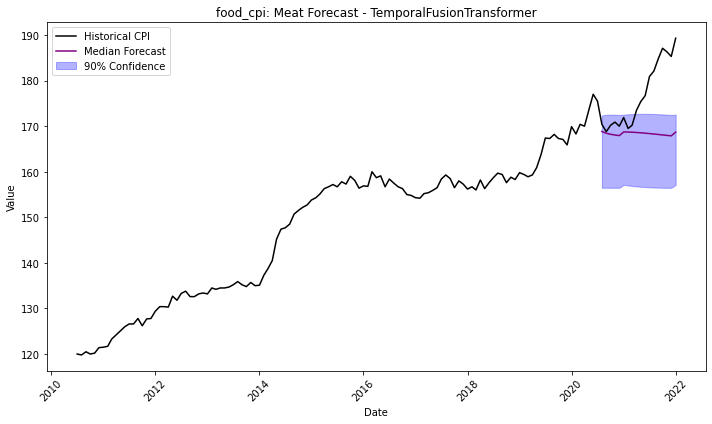

Beginning AutoGluon training... Time limit = 2s
AutoGluon will save models to './output/TEST/ag_global_all_TemporalFusionTransformerModel_exp2_R4_/random_seed_42/2021-07-01/model_files/'
=================== System Info ===================
AutoGluon Version:  1.1.1
Python Version:     3.8.20
Operating System:   Linux
Platform Machine:   x86_64
Platform Version:   #147~18.04.1-Ubuntu SMP Sat Oct 15 13:10:18 UTC 2022
CPU Count:          32
GPU Count:          1
Memory Avail:       166.75 GB / 188.57 GB (88.4%)
Disk Space Avail:   18208.17 GB / 249006.62 GB (7.3%)

Fitting with arguments:
{'enable_ensemble': True,
 'eval_metric': MAPE,
 'excluded_model_types': ['DirectTabular', 'RecursiveTabular'],
 'hyperparameters': {'TemporalFusionTransformerModel': {}},
 'known_covariates_names': [],
 'num_val_windows': 1,
 'prediction_length': 18,
 'quantile_levels': [0.01, 0.05, 0.1, 0.25, 0.75, 0.9, 0.95, 0.99],
 'random_seed': 42,
 'refit_every_n_windows': 1,
 'refit_full': False,
 'skip_model_sele

TemporalFusionTransformerModel


	-0.7126       = Validation score (-MAPE)
	2.15    s     = Training runtime
	0.05    s     = Validation (prediction) runtime
Not fitting ensemble due to lack of time remaining. Time left: -0.3 seconds
Training complete. Models trained: ['TemporalFusionTransformer']
Total runtime: 2.23 s
Best model: TemporalFusionTransformer
Best model score: -0.7126
Model not specified in predict, will default to the model with the best validation score: TemporalFusionTransformer
Model not specified in predict, will default to the model with the best validation score: TemporalFusionTransformer


****************** Summary of fit() ******************
Estimated performance of each model:
                       model  score_val  pred_time_val  fit_time_marginal  \
0  TemporalFusionTransformer  -0.712649       0.045479           2.151847   

   fit_order  
0          1  
Number of models trained: 1
Types of models trained:
{'MultiWindowBacktestingModel'}
****************** End of fit() summary ******************


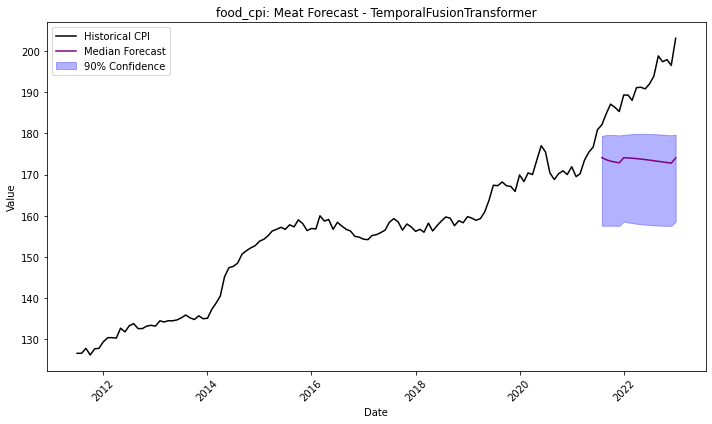

Beginning AutoGluon training... Time limit = 2s
AutoGluon will save models to './output/TEST/ag_global_all_TemporalFusionTransformerModel_exp2_R1_/random_seed_42/2021-07-01/model_files/'
=================== System Info ===================
AutoGluon Version:  1.1.1
Python Version:     3.8.20
Operating System:   Linux
Platform Machine:   x86_64
Platform Version:   #147~18.04.1-Ubuntu SMP Sat Oct 15 13:10:18 UTC 2022
CPU Count:          32
GPU Count:          1
Memory Avail:       166.75 GB / 188.57 GB (88.4%)
Disk Space Avail:   18208.16 GB / 249006.62 GB (7.3%)

Fitting with arguments:
{'enable_ensemble': True,
 'eval_metric': MAPE,
 'excluded_model_types': ['DirectTabular', 'RecursiveTabular'],
 'hyperparameters': {'TemporalFusionTransformerModel': {}},
 'known_covariates_names': [],
 'num_val_windows': 1,
 'prediction_length': 18,
 'quantile_levels': [0.01, 0.05, 0.1, 0.25, 0.75, 0.9, 0.95, 0.99],
 'random_seed': 42,
 'refit_every_n_windows': 1,
 'refit_full': False,
 'skip_model_sele

TemporalFusionTransformerModel


	-1.0406       = Validation score (-MAPE)
	2.13    s     = Training runtime
	0.05    s     = Validation (prediction) runtime
Not fitting ensemble due to lack of time remaining. Time left: -0.3 seconds
Training complete. Models trained: ['TemporalFusionTransformer']
Total runtime: 2.21 s
Best model: TemporalFusionTransformer
Best model score: -1.0406
Model not specified in predict, will default to the model with the best validation score: TemporalFusionTransformer
Model not specified in predict, will default to the model with the best validation score: TemporalFusionTransformer


****************** Summary of fit() ******************
Estimated performance of each model:
                       model  score_val  pred_time_val  fit_time_marginal  \
0  TemporalFusionTransformer  -1.040647       0.045604           2.129544   

   fit_order  
0          1  
Number of models trained: 1
Types of models trained:
{'MultiWindowBacktestingModel'}
****************** End of fit() summary ******************


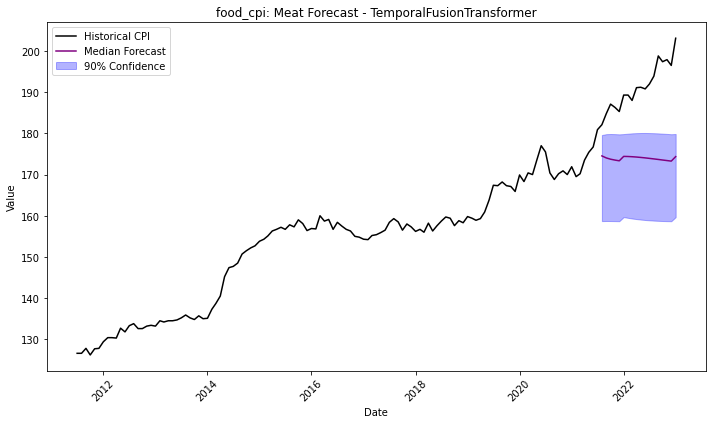

Beginning AutoGluon training... Time limit = 2s
AutoGluon will save models to './output/TEST/ag_global_all_TemporalFusionTransformerModel_exp2_R3_/random_seed_42/2021-07-01/model_files/'
=================== System Info ===================
AutoGluon Version:  1.1.1
Python Version:     3.8.20
Operating System:   Linux
Platform Machine:   x86_64
Platform Version:   #147~18.04.1-Ubuntu SMP Sat Oct 15 13:10:18 UTC 2022
CPU Count:          32
GPU Count:          1
Memory Avail:       166.76 GB / 188.57 GB (88.4%)
Disk Space Avail:   18208.16 GB / 249006.62 GB (7.3%)

Fitting with arguments:
{'enable_ensemble': True,
 'eval_metric': MAPE,
 'excluded_model_types': ['DirectTabular', 'RecursiveTabular'],
 'hyperparameters': {'TemporalFusionTransformerModel': {}},
 'known_covariates_names': [],
 'num_val_windows': 1,
 'prediction_length': 18,
 'quantile_levels': [0.01, 0.05, 0.1, 0.25, 0.75, 0.9, 0.95, 0.99],
 'random_seed': 42,
 'refit_every_n_windows': 1,
 'refit_full': False,
 'skip_model_sele

TemporalFusionTransformerModel


	-0.7122       = Validation score (-MAPE)
	2.14    s     = Training runtime
	0.05    s     = Validation (prediction) runtime
Not fitting ensemble due to lack of time remaining. Time left: -0.3 seconds
Training complete. Models trained: ['TemporalFusionTransformer']
Total runtime: 2.22 s
Best model: TemporalFusionTransformer
Best model score: -0.7122
Model not specified in predict, will default to the model with the best validation score: TemporalFusionTransformer
Model not specified in predict, will default to the model with the best validation score: TemporalFusionTransformer


****************** Summary of fit() ******************
Estimated performance of each model:
                       model  score_val  pred_time_val  fit_time_marginal  \
0  TemporalFusionTransformer  -0.712157        0.04506           2.140646   

   fit_order  
0          1  
Number of models trained: 1
Types of models trained:
{'MultiWindowBacktestingModel'}
****************** End of fit() summary ******************


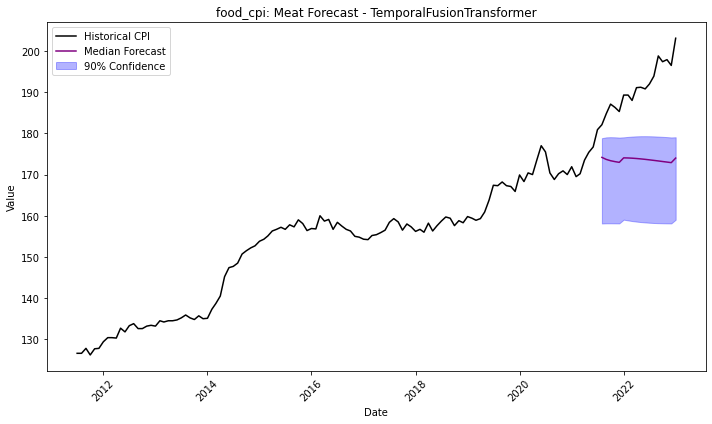

Beginning AutoGluon training... Time limit = 2s
AutoGluon will save models to './output/TEST/ag_global_all_TemporalFusionTransformerModel_exp2_R2_/random_seed_42/2021-07-01/model_files/'
=================== System Info ===================
AutoGluon Version:  1.1.1
Python Version:     3.8.20
Operating System:   Linux
Platform Machine:   x86_64
Platform Version:   #147~18.04.1-Ubuntu SMP Sat Oct 15 13:10:18 UTC 2022
CPU Count:          32
GPU Count:          1
Memory Avail:       166.81 GB / 188.57 GB (88.5%)
Disk Space Avail:   18208.20 GB / 249006.62 GB (7.3%)

Fitting with arguments:
{'enable_ensemble': True,
 'eval_metric': MAPE,
 'excluded_model_types': ['DirectTabular', 'RecursiveTabular'],
 'hyperparameters': {'TemporalFusionTransformerModel': {}},
 'known_covariates_names': [],
 'num_val_windows': 1,
 'prediction_length': 18,
 'quantile_levels': [0.01, 0.05, 0.1, 0.25, 0.75, 0.9, 0.95, 0.99],
 'random_seed': 42,
 'refit_every_n_windows': 1,
 'refit_full': False,
 'skip_model_sele

TemporalFusionTransformerModel


	-0.5359       = Validation score (-MAPE)
	2.14    s     = Training runtime
	0.04    s     = Validation (prediction) runtime
Not fitting ensemble due to lack of time remaining. Time left: -0.3 seconds
Training complete. Models trained: ['TemporalFusionTransformer']
Total runtime: 2.22 s
Best model: TemporalFusionTransformer
Best model score: -0.5359


****************** Summary of fit() ******************
Estimated performance of each model:
                       model  score_val  pred_time_val  fit_time_marginal  \
0  TemporalFusionTransformer  -0.535884        0.04219           2.143627   

   fit_order  
0          1  
Number of models trained: 1
Types of models trained:
{'MultiWindowBacktestingModel'}
****************** End of fit() summary ******************


Model not specified in predict, will default to the model with the best validation score: TemporalFusionTransformer
Model not specified in predict, will default to the model with the best validation score: TemporalFusionTransformer


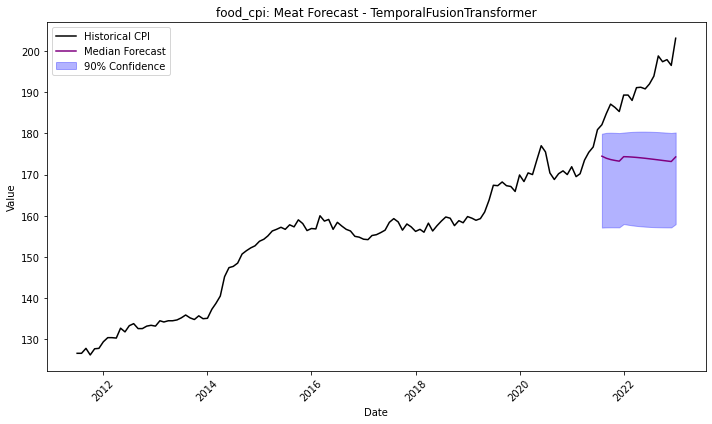

Beginning AutoGluon training... Time limit = 2s
AutoGluon will save models to './output/TEST/ag_global_all_TemporalFusionTransformerModel_exp2_GPT_P1_/random_seed_42/2021-07-01/model_files/'
=================== System Info ===================
AutoGluon Version:  1.1.1
Python Version:     3.8.20
Operating System:   Linux
Platform Machine:   x86_64
Platform Version:   #147~18.04.1-Ubuntu SMP Sat Oct 15 13:10:18 UTC 2022
CPU Count:          32
GPU Count:          1
Memory Avail:       166.75 GB / 188.57 GB (88.4%)
Disk Space Avail:   18208.20 GB / 249006.62 GB (7.3%)

Fitting with arguments:
{'enable_ensemble': True,
 'eval_metric': MAPE,
 'excluded_model_types': ['DirectTabular', 'RecursiveTabular'],
 'hyperparameters': {'TemporalFusionTransformerModel': {}},
 'known_covariates_names': [],
 'num_val_windows': 1,
 'prediction_length': 18,
 'quantile_levels': [0.01, 0.05, 0.1, 0.25, 0.75, 0.9, 0.95, 0.99],
 'random_seed': 42,
 'refit_every_n_windows': 1,
 'refit_full': False,
 'skip_model_

TemporalFusionTransformerModel


	-1.0981       = Validation score (-MAPE)
	2.13    s     = Training runtime
	0.04    s     = Validation (prediction) runtime
Not fitting ensemble due to lack of time remaining. Time left: -0.3 seconds
Training complete. Models trained: ['TemporalFusionTransformer']
Total runtime: 2.21 s
Best model: TemporalFusionTransformer
Best model score: -1.0981
Model not specified in predict, will default to the model with the best validation score: TemporalFusionTransformer
Model not specified in predict, will default to the model with the best validation score: TemporalFusionTransformer


****************** Summary of fit() ******************
Estimated performance of each model:
                       model  score_val  pred_time_val  fit_time_marginal  \
0  TemporalFusionTransformer  -1.098056       0.040137           2.131274   

   fit_order  
0          1  
Number of models trained: 1
Types of models trained:
{'MultiWindowBacktestingModel'}
****************** End of fit() summary ******************


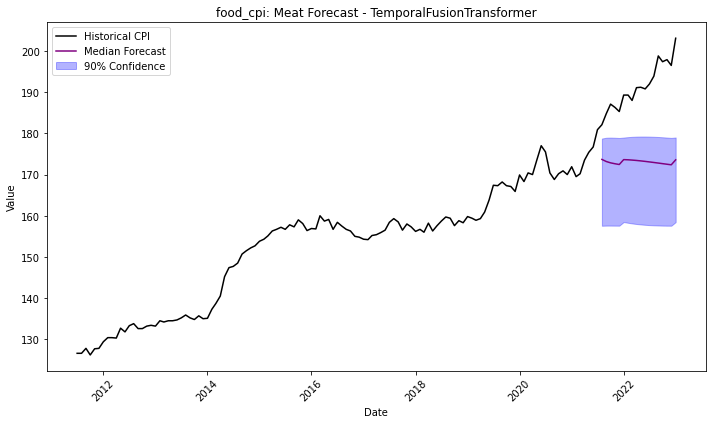

Beginning AutoGluon training... Time limit = 2s
AutoGluon will save models to './output/TEST/ag_global_all_TemporalFusionTransformerModel_exp2_GPT_P4_/random_seed_42/2021-07-01/model_files/'
=================== System Info ===================
AutoGluon Version:  1.1.1
Python Version:     3.8.20
Operating System:   Linux
Platform Machine:   x86_64
Platform Version:   #147~18.04.1-Ubuntu SMP Sat Oct 15 13:10:18 UTC 2022
CPU Count:          32
GPU Count:          1
Memory Avail:       166.75 GB / 188.57 GB (88.4%)
Disk Space Avail:   18208.19 GB / 249006.62 GB (7.3%)

Fitting with arguments:
{'enable_ensemble': True,
 'eval_metric': MAPE,
 'excluded_model_types': ['DirectTabular', 'RecursiveTabular'],
 'hyperparameters': {'TemporalFusionTransformerModel': {}},
 'known_covariates_names': [],
 'num_val_windows': 1,
 'prediction_length': 18,
 'quantile_levels': [0.01, 0.05, 0.1, 0.25, 0.75, 0.9, 0.95, 0.99],
 'random_seed': 42,
 'refit_every_n_windows': 1,
 'refit_full': False,
 'skip_model_

TemporalFusionTransformerModel


	-0.9116       = Validation score (-MAPE)
	2.16    s     = Training runtime
	0.04    s     = Validation (prediction) runtime
Not fitting ensemble due to lack of time remaining. Time left: -0.3 seconds
Training complete. Models trained: ['TemporalFusionTransformer']
Total runtime: 2.24 s
Best model: TemporalFusionTransformer
Best model score: -0.9116
Model not specified in predict, will default to the model with the best validation score: TemporalFusionTransformer
Model not specified in predict, will default to the model with the best validation score: TemporalFusionTransformer


****************** Summary of fit() ******************
Estimated performance of each model:
                       model  score_val  pred_time_val  fit_time_marginal  \
0  TemporalFusionTransformer  -0.911622       0.040748           2.163147   

   fit_order  
0          1  
Number of models trained: 1
Types of models trained:
{'MultiWindowBacktestingModel'}
****************** End of fit() summary ******************


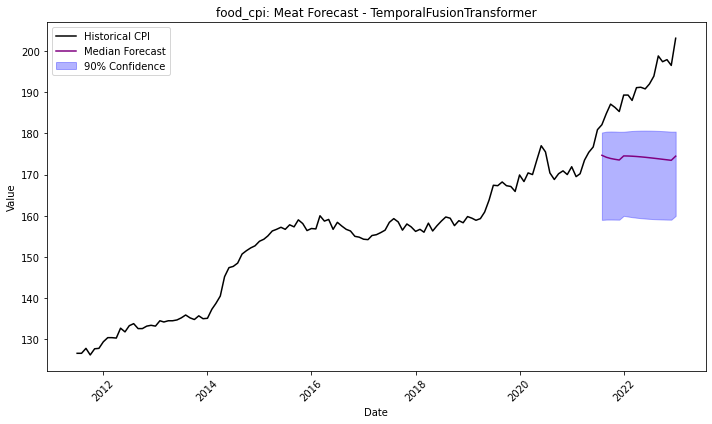

Beginning AutoGluon training... Time limit = 2s
AutoGluon will save models to './output/TEST/ag_global_all_TemporalFusionTransformerModel_exp2_GPT_P3_/random_seed_42/2021-07-01/model_files/'
=================== System Info ===================
AutoGluon Version:  1.1.1
Python Version:     3.8.20
Operating System:   Linux
Platform Machine:   x86_64
Platform Version:   #147~18.04.1-Ubuntu SMP Sat Oct 15 13:10:18 UTC 2022
CPU Count:          32
GPU Count:          1
Memory Avail:       166.75 GB / 188.57 GB (88.4%)
Disk Space Avail:   18208.18 GB / 249006.62 GB (7.3%)

Fitting with arguments:
{'enable_ensemble': True,
 'eval_metric': MAPE,
 'excluded_model_types': ['DirectTabular', 'RecursiveTabular'],
 'hyperparameters': {'TemporalFusionTransformerModel': {}},
 'known_covariates_names': [],
 'num_val_windows': 1,
 'prediction_length': 18,
 'quantile_levels': [0.01, 0.05, 0.1, 0.25, 0.75, 0.9, 0.95, 0.99],
 'random_seed': 42,
 'refit_every_n_windows': 1,
 'refit_full': False,
 'skip_model_

TemporalFusionTransformerModel


	-1.1414       = Validation score (-MAPE)
	2.14    s     = Training runtime
	0.04    s     = Validation (prediction) runtime
Not fitting ensemble due to lack of time remaining. Time left: -0.3 seconds
Training complete. Models trained: ['TemporalFusionTransformer']
Total runtime: 2.22 s
Best model: TemporalFusionTransformer
Best model score: -1.1414
Model not specified in predict, will default to the model with the best validation score: TemporalFusionTransformer
Model not specified in predict, will default to the model with the best validation score: TemporalFusionTransformer


****************** Summary of fit() ******************
Estimated performance of each model:
                       model  score_val  pred_time_val  fit_time_marginal  \
0  TemporalFusionTransformer  -1.141449       0.043183           2.140388   

   fit_order  
0          1  
Number of models trained: 1
Types of models trained:
{'MultiWindowBacktestingModel'}
****************** End of fit() summary ******************


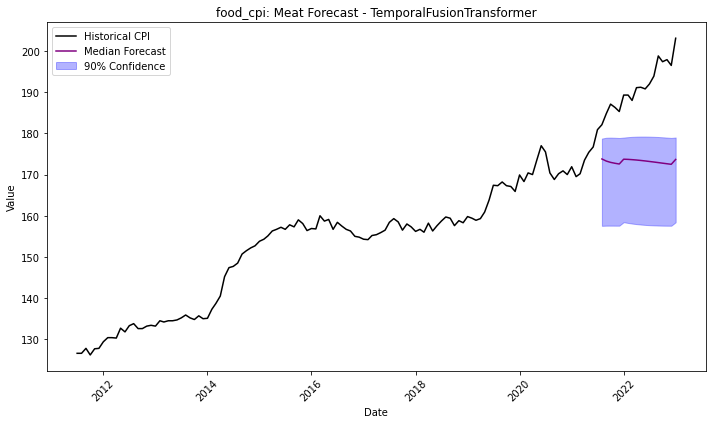

Beginning AutoGluon training... Time limit = 2s
AutoGluon will save models to './output/TEST/ag_global_all_TemporalFusionTransformerModel_exp2_GPT_P2_/random_seed_42/2021-07-01/model_files/'
=================== System Info ===================
AutoGluon Version:  1.1.1
Python Version:     3.8.20
Operating System:   Linux
Platform Machine:   x86_64
Platform Version:   #147~18.04.1-Ubuntu SMP Sat Oct 15 13:10:18 UTC 2022
CPU Count:          32
GPU Count:          1
Memory Avail:       166.75 GB / 188.57 GB (88.4%)
Disk Space Avail:   18208.17 GB / 249006.62 GB (7.3%)

Fitting with arguments:
{'enable_ensemble': True,
 'eval_metric': MAPE,
 'excluded_model_types': ['DirectTabular', 'RecursiveTabular'],
 'hyperparameters': {'TemporalFusionTransformerModel': {}},
 'known_covariates_names': [],
 'num_val_windows': 1,
 'prediction_length': 18,
 'quantile_levels': [0.01, 0.05, 0.1, 0.25, 0.75, 0.9, 0.95, 0.99],
 'random_seed': 42,
 'refit_every_n_windows': 1,
 'refit_full': False,
 'skip_model_

TemporalFusionTransformerModel


	-1.0991       = Validation score (-MAPE)
	2.11    s     = Training runtime
	0.04    s     = Validation (prediction) runtime
Not fitting ensemble due to lack of time remaining. Time left: -0.2 seconds
Training complete. Models trained: ['TemporalFusionTransformer']
Total runtime: 2.18 s
Best model: TemporalFusionTransformer
Best model score: -1.0991
Model not specified in predict, will default to the model with the best validation score: TemporalFusionTransformer
Model not specified in predict, will default to the model with the best validation score: TemporalFusionTransformer


****************** Summary of fit() ******************
Estimated performance of each model:
                       model  score_val  pred_time_val  fit_time_marginal  \
0  TemporalFusionTransformer  -1.099134       0.037994           2.109763   

   fit_order  
0          1  
Number of models trained: 1
Types of models trained:
{'MultiWindowBacktestingModel'}
****************** End of fit() summary ******************


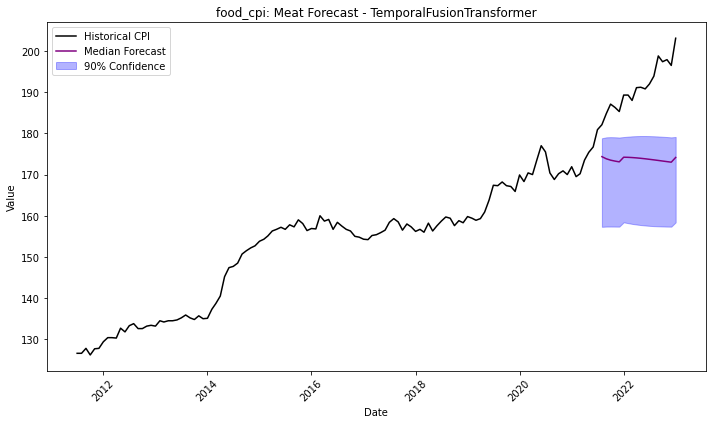

Beginning AutoGluon training... Time limit = 2s
AutoGluon will save models to './output/TEST/ag_global_all_TemporalFusionTransformerModel_exp2_R4_/random_seed_42/2022-07-01/model_files/'
=================== System Info ===================
AutoGluon Version:  1.1.1
Python Version:     3.8.20
Operating System:   Linux
Platform Machine:   x86_64
Platform Version:   #147~18.04.1-Ubuntu SMP Sat Oct 15 13:10:18 UTC 2022
CPU Count:          32
GPU Count:          1
Memory Avail:       166.75 GB / 188.57 GB (88.4%)
Disk Space Avail:   18208.16 GB / 249006.62 GB (7.3%)

Fitting with arguments:
{'enable_ensemble': True,
 'eval_metric': MAPE,
 'excluded_model_types': ['DirectTabular', 'RecursiveTabular'],
 'hyperparameters': {'TemporalFusionTransformerModel': {}},
 'known_covariates_names': [],
 'num_val_windows': 1,
 'prediction_length': 18,
 'quantile_levels': [0.01, 0.05, 0.1, 0.25, 0.75, 0.9, 0.95, 0.99],
 'random_seed': 42,
 'refit_every_n_windows': 1,
 'refit_full': False,
 'skip_model_sele

TemporalFusionTransformerModel


	-5.4322       = Validation score (-MAPE)
	2.10    s     = Training runtime
	0.04    s     = Validation (prediction) runtime
Not fitting ensemble due to lack of time remaining. Time left: -0.2 seconds
Training complete. Models trained: ['TemporalFusionTransformer']
Total runtime: 2.19 s
Best model: TemporalFusionTransformer
Best model score: -5.4322
Model not specified in predict, will default to the model with the best validation score: TemporalFusionTransformer
Model not specified in predict, will default to the model with the best validation score: TemporalFusionTransformer


****************** Summary of fit() ******************
Estimated performance of each model:
                       model  score_val  pred_time_val  fit_time_marginal  \
0  TemporalFusionTransformer  -5.432216       0.041949           2.103347   

   fit_order  
0          1  
Number of models trained: 1
Types of models trained:
{'MultiWindowBacktestingModel'}
****************** End of fit() summary ******************


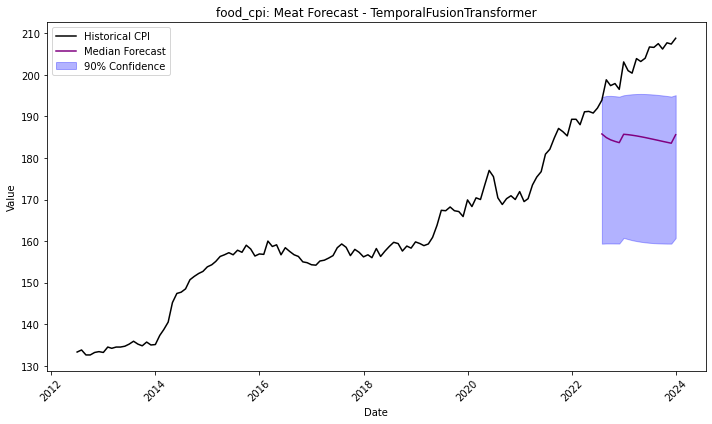

Beginning AutoGluon training... Time limit = 2s
AutoGluon will save models to './output/TEST/ag_global_all_TemporalFusionTransformerModel_exp2_R1_/random_seed_42/2022-07-01/model_files/'
=================== System Info ===================
AutoGluon Version:  1.1.1
Python Version:     3.8.20
Operating System:   Linux
Platform Machine:   x86_64
Platform Version:   #147~18.04.1-Ubuntu SMP Sat Oct 15 13:10:18 UTC 2022
CPU Count:          32
GPU Count:          1
Memory Avail:       166.75 GB / 188.57 GB (88.4%)
Disk Space Avail:   18208.16 GB / 249006.62 GB (7.3%)

Fitting with arguments:
{'enable_ensemble': True,
 'eval_metric': MAPE,
 'excluded_model_types': ['DirectTabular', 'RecursiveTabular'],
 'hyperparameters': {'TemporalFusionTransformerModel': {}},
 'known_covariates_names': [],
 'num_val_windows': 1,
 'prediction_length': 18,
 'quantile_levels': [0.01, 0.05, 0.1, 0.25, 0.75, 0.9, 0.95, 0.99],
 'random_seed': 42,
 'refit_every_n_windows': 1,
 'refit_full': False,
 'skip_model_sele

TemporalFusionTransformerModel


	-5.6651       = Validation score (-MAPE)
	2.15    s     = Training runtime
	0.35    s     = Validation (prediction) runtime
Not fitting ensemble due to lack of time remaining. Time left: -0.6 seconds
Training complete. Models trained: ['TemporalFusionTransformer']
Total runtime: 2.53 s
Best model: TemporalFusionTransformer
Best model score: -5.6651
Model not specified in predict, will default to the model with the best validation score: TemporalFusionTransformer
Model not specified in predict, will default to the model with the best validation score: TemporalFusionTransformer


****************** Summary of fit() ******************
Estimated performance of each model:
                       model  score_val  pred_time_val  fit_time_marginal  \
0  TemporalFusionTransformer  -5.665067       0.346503            2.15116   

   fit_order  
0          1  
Number of models trained: 1
Types of models trained:
{'MultiWindowBacktestingModel'}
****************** End of fit() summary ******************


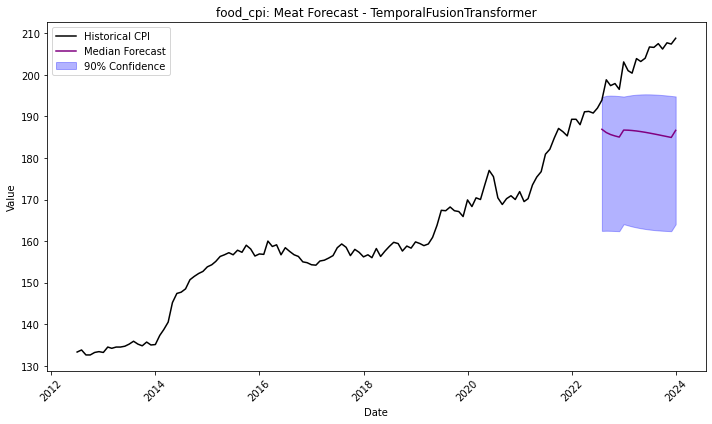

Beginning AutoGluon training... Time limit = 2s
AutoGluon will save models to './output/TEST/ag_global_all_TemporalFusionTransformerModel_exp2_R3_/random_seed_42/2022-07-01/model_files/'
=================== System Info ===================
AutoGluon Version:  1.1.1
Python Version:     3.8.20
Operating System:   Linux
Platform Machine:   x86_64
Platform Version:   #147~18.04.1-Ubuntu SMP Sat Oct 15 13:10:18 UTC 2022
CPU Count:          32
GPU Count:          1
Memory Avail:       166.82 GB / 188.57 GB (88.5%)
Disk Space Avail:   18208.20 GB / 249006.62 GB (7.3%)

Fitting with arguments:
{'enable_ensemble': True,
 'eval_metric': MAPE,
 'excluded_model_types': ['DirectTabular', 'RecursiveTabular'],
 'hyperparameters': {'TemporalFusionTransformerModel': {}},
 'known_covariates_names': [],
 'num_val_windows': 1,
 'prediction_length': 18,
 'quantile_levels': [0.01, 0.05, 0.1, 0.25, 0.75, 0.9, 0.95, 0.99],
 'random_seed': 42,
 'refit_every_n_windows': 1,
 'refit_full': False,
 'skip_model_sele

TemporalFusionTransformerModel


	-0.4345       = Validation score (-MAPE)
	2.18    s     = Training runtime
	0.05    s     = Validation (prediction) runtime
Not fitting ensemble due to lack of time remaining. Time left: -0.3 seconds
Training complete. Models trained: ['TemporalFusionTransformer']
Total runtime: 2.26 s
Best model: TemporalFusionTransformer
Best model score: -0.4345
Model not specified in predict, will default to the model with the best validation score: TemporalFusionTransformer
Model not specified in predict, will default to the model with the best validation score: TemporalFusionTransformer


****************** Summary of fit() ******************
Estimated performance of each model:
                       model  score_val  pred_time_val  fit_time_marginal  \
0  TemporalFusionTransformer  -0.434451       0.050146           2.175012   

   fit_order  
0          1  
Number of models trained: 1
Types of models trained:
{'MultiWindowBacktestingModel'}
****************** End of fit() summary ******************


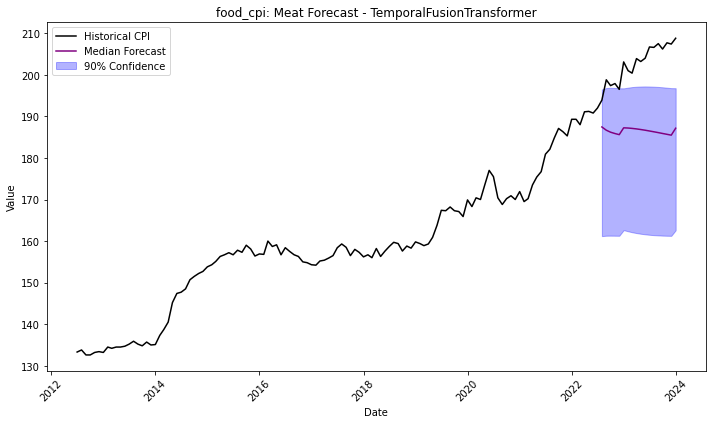

Beginning AutoGluon training... Time limit = 2s
AutoGluon will save models to './output/TEST/ag_global_all_TemporalFusionTransformerModel_exp2_R2_/random_seed_42/2022-07-01/model_files/'
=================== System Info ===================
AutoGluon Version:  1.1.1
Python Version:     3.8.20
Operating System:   Linux
Platform Machine:   x86_64
Platform Version:   #147~18.04.1-Ubuntu SMP Sat Oct 15 13:10:18 UTC 2022
CPU Count:          32
GPU Count:          1
Memory Avail:       166.75 GB / 188.57 GB (88.4%)
Disk Space Avail:   18208.18 GB / 249006.62 GB (7.3%)

Fitting with arguments:
{'enable_ensemble': True,
 'eval_metric': MAPE,
 'excluded_model_types': ['DirectTabular', 'RecursiveTabular'],
 'hyperparameters': {'TemporalFusionTransformerModel': {}},
 'known_covariates_names': [],
 'num_val_windows': 1,
 'prediction_length': 18,
 'quantile_levels': [0.01, 0.05, 0.1, 0.25, 0.75, 0.9, 0.95, 0.99],
 'random_seed': 42,
 'refit_every_n_windows': 1,
 'refit_full': False,
 'skip_model_sele

TemporalFusionTransformerModel


	-0.5630       = Validation score (-MAPE)
	2.15    s     = Training runtime
	0.04    s     = Validation (prediction) runtime
Not fitting ensemble due to lack of time remaining. Time left: -0.3 seconds
Training complete. Models trained: ['TemporalFusionTransformer']
Total runtime: 2.22 s
Best model: TemporalFusionTransformer
Best model score: -0.5630
Model not specified in predict, will default to the model with the best validation score: TemporalFusionTransformer
Model not specified in predict, will default to the model with the best validation score: TemporalFusionTransformer


****************** Summary of fit() ******************
Estimated performance of each model:
                       model  score_val  pred_time_val  fit_time_marginal  \
0  TemporalFusionTransformer  -0.563006       0.041099           2.145056   

   fit_order  
0          1  
Number of models trained: 1
Types of models trained:
{'MultiWindowBacktestingModel'}
****************** End of fit() summary ******************


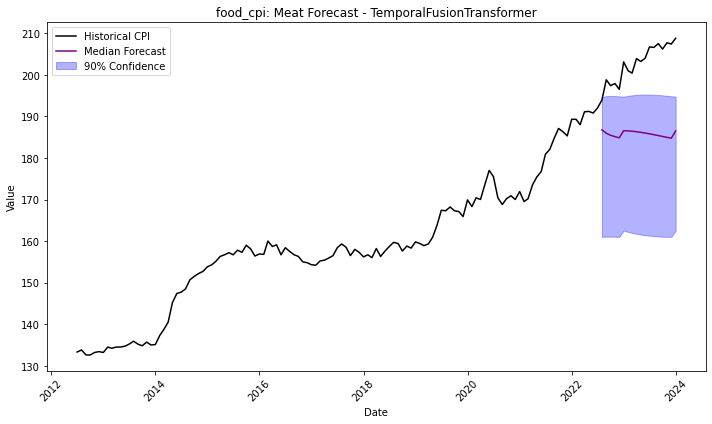

Beginning AutoGluon training... Time limit = 2s
AutoGluon will save models to './output/TEST/ag_global_all_TemporalFusionTransformerModel_exp2_GPT_P1_/random_seed_42/2022-07-01/model_files/'
=================== System Info ===================
AutoGluon Version:  1.1.1
Python Version:     3.8.20
Operating System:   Linux
Platform Machine:   x86_64
Platform Version:   #147~18.04.1-Ubuntu SMP Sat Oct 15 13:10:18 UTC 2022
CPU Count:          32
GPU Count:          1
Memory Avail:       166.75 GB / 188.57 GB (88.4%)
Disk Space Avail:   18208.17 GB / 249006.62 GB (7.3%)

Fitting with arguments:
{'enable_ensemble': True,
 'eval_metric': MAPE,
 'excluded_model_types': ['DirectTabular', 'RecursiveTabular'],
 'hyperparameters': {'TemporalFusionTransformerModel': {}},
 'known_covariates_names': [],
 'num_val_windows': 1,
 'prediction_length': 18,
 'quantile_levels': [0.01, 0.05, 0.1, 0.25, 0.75, 0.9, 0.95, 0.99],
 'random_seed': 42,
 'refit_every_n_windows': 1,
 'refit_full': False,
 'skip_model_

TemporalFusionTransformerModel


	-5.3782       = Validation score (-MAPE)
	2.11    s     = Training runtime
	0.04    s     = Validation (prediction) runtime
Not fitting ensemble due to lack of time remaining. Time left: -0.2 seconds
Training complete. Models trained: ['TemporalFusionTransformer']
Total runtime: 2.19 s
Best model: TemporalFusionTransformer
Best model score: -5.3782
Model not specified in predict, will default to the model with the best validation score: TemporalFusionTransformer
Model not specified in predict, will default to the model with the best validation score: TemporalFusionTransformer


****************** Summary of fit() ******************
Estimated performance of each model:
                       model  score_val  pred_time_val  fit_time_marginal  \
0  TemporalFusionTransformer  -5.378217        0.04181           2.105052   

   fit_order  
0          1  
Number of models trained: 1
Types of models trained:
{'MultiWindowBacktestingModel'}
****************** End of fit() summary ******************


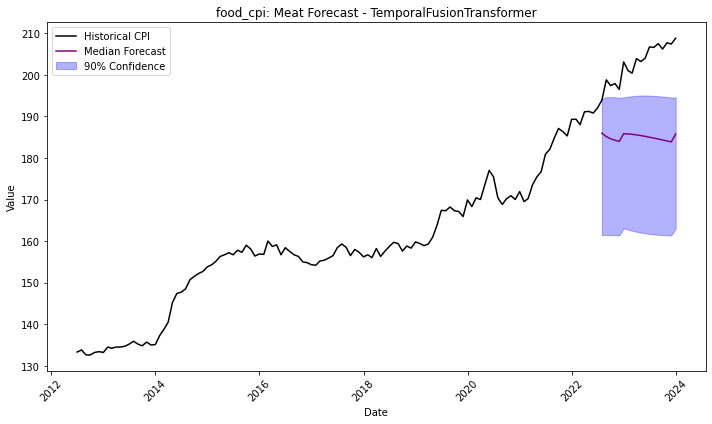

Beginning AutoGluon training... Time limit = 2s
AutoGluon will save models to './output/TEST/ag_global_all_TemporalFusionTransformerModel_exp2_GPT_P4_/random_seed_42/2022-07-01/model_files/'
=================== System Info ===================
AutoGluon Version:  1.1.1
Python Version:     3.8.20
Operating System:   Linux
Platform Machine:   x86_64
Platform Version:   #147~18.04.1-Ubuntu SMP Sat Oct 15 13:10:18 UTC 2022
CPU Count:          32
GPU Count:          1
Memory Avail:       166.74 GB / 188.57 GB (88.4%)
Disk Space Avail:   18208.16 GB / 249006.62 GB (7.3%)

Fitting with arguments:
{'enable_ensemble': True,
 'eval_metric': MAPE,
 'excluded_model_types': ['DirectTabular', 'RecursiveTabular'],
 'hyperparameters': {'TemporalFusionTransformerModel': {}},
 'known_covariates_names': [],
 'num_val_windows': 1,
 'prediction_length': 18,
 'quantile_levels': [0.01, 0.05, 0.1, 0.25, 0.75, 0.9, 0.95, 0.99],
 'random_seed': 42,
 'refit_every_n_windows': 1,
 'refit_full': False,
 'skip_model_

TemporalFusionTransformerModel


	-6.8342       = Validation score (-MAPE)
	2.12    s     = Training runtime
	0.04    s     = Validation (prediction) runtime
Not fitting ensemble due to lack of time remaining. Time left: -0.3 seconds
Training complete. Models trained: ['TemporalFusionTransformer']
Total runtime: 2.20 s
Best model: TemporalFusionTransformer
Best model score: -6.8342
Model not specified in predict, will default to the model with the best validation score: TemporalFusionTransformer
Model not specified in predict, will default to the model with the best validation score: TemporalFusionTransformer


****************** Summary of fit() ******************
Estimated performance of each model:
                       model  score_val  pred_time_val  fit_time_marginal  \
0  TemporalFusionTransformer  -6.834233       0.040193           2.116326   

   fit_order  
0          1  
Number of models trained: 1
Types of models trained:
{'MultiWindowBacktestingModel'}
****************** End of fit() summary ******************


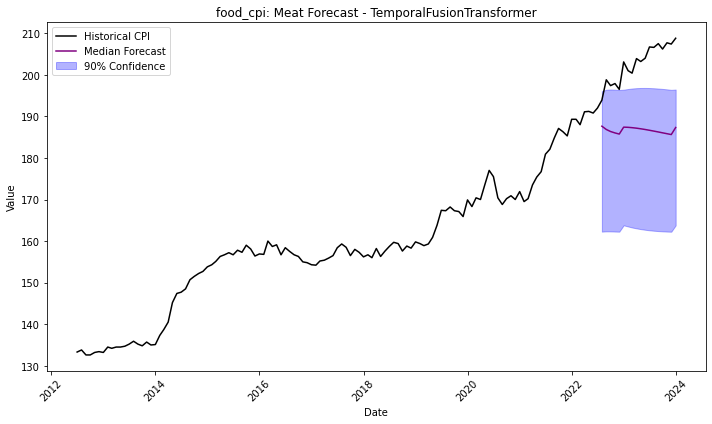

Beginning AutoGluon training... Time limit = 2s
AutoGluon will save models to './output/TEST/ag_global_all_TemporalFusionTransformerModel_exp2_GPT_P3_/random_seed_42/2022-07-01/model_files/'
=================== System Info ===================
AutoGluon Version:  1.1.1
Python Version:     3.8.20
Operating System:   Linux
Platform Machine:   x86_64
Platform Version:   #147~18.04.1-Ubuntu SMP Sat Oct 15 13:10:18 UTC 2022
CPU Count:          32
GPU Count:          1
Memory Avail:       166.78 GB / 188.57 GB (88.4%)
Disk Space Avail:   18208.16 GB / 249006.62 GB (7.3%)

Fitting with arguments:
{'enable_ensemble': True,
 'eval_metric': MAPE,
 'excluded_model_types': ['DirectTabular', 'RecursiveTabular'],
 'hyperparameters': {'TemporalFusionTransformerModel': {}},
 'known_covariates_names': [],
 'num_val_windows': 1,
 'prediction_length': 18,
 'quantile_levels': [0.01, 0.05, 0.1, 0.25, 0.75, 0.9, 0.95, 0.99],
 'random_seed': 42,
 'refit_every_n_windows': 1,
 'refit_full': False,
 'skip_model_

TemporalFusionTransformerModel


	-5.6925       = Validation score (-MAPE)
	2.15    s     = Training runtime
	0.05    s     = Validation (prediction) runtime
Not fitting ensemble due to lack of time remaining. Time left: -0.3 seconds
Training complete. Models trained: ['TemporalFusionTransformer']
Total runtime: 2.24 s
Best model: TemporalFusionTransformer
Best model score: -5.6925
Model not specified in predict, will default to the model with the best validation score: TemporalFusionTransformer
Model not specified in predict, will default to the model with the best validation score: TemporalFusionTransformer


****************** Summary of fit() ******************
Estimated performance of each model:
                       model  score_val  pred_time_val  fit_time_marginal  \
0  TemporalFusionTransformer  -5.692549        0.04642           2.146739   

   fit_order  
0          1  
Number of models trained: 1
Types of models trained:
{'MultiWindowBacktestingModel'}
****************** End of fit() summary ******************


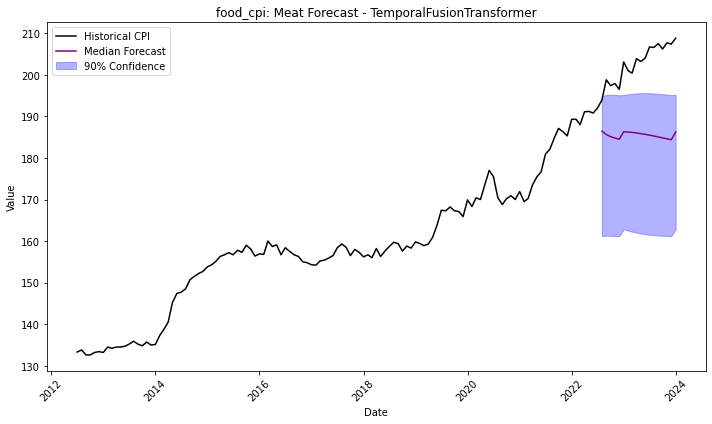

Beginning AutoGluon training... Time limit = 2s
AutoGluon will save models to './output/TEST/ag_global_all_TemporalFusionTransformerModel_exp2_GPT_P2_/random_seed_42/2022-07-01/model_files/'
=================== System Info ===================
AutoGluon Version:  1.1.1
Python Version:     3.8.20
Operating System:   Linux
Platform Machine:   x86_64
Platform Version:   #147~18.04.1-Ubuntu SMP Sat Oct 15 13:10:18 UTC 2022
CPU Count:          32
GPU Count:          1
Memory Avail:       166.73 GB / 188.57 GB (88.4%)
Disk Space Avail:   18208.20 GB / 249006.62 GB (7.3%)

Fitting with arguments:
{'enable_ensemble': True,
 'eval_metric': MAPE,
 'excluded_model_types': ['DirectTabular', 'RecursiveTabular'],
 'hyperparameters': {'TemporalFusionTransformerModel': {}},
 'known_covariates_names': [],
 'num_val_windows': 1,
 'prediction_length': 18,
 'quantile_levels': [0.01, 0.05, 0.1, 0.25, 0.75, 0.9, 0.95, 0.99],
 'random_seed': 42,
 'refit_every_n_windows': 1,
 'refit_full': False,
 'skip_model_

TemporalFusionTransformerModel


Inferred time series frequency: 'MS'
Provided train_data has 8341 rows, 19 time series. Median time series length is 439 (min=439, max=439). 

Provided data contains following columns:
	target: 'target'

AutoGluon will gauge predictive performance using evaluation metric: 'MAPE'
	This metric's sign has been flipped to adhere to being higher_is_better. The metric score can be multiplied by -1 to get the metric value.

Starting training. Start time is 2024-10-27 07:44:18
Excluded model types: ['DirectTabular', 'RecursiveTabular']
Models that will be trained: ['TemporalFusionTransformer']
Training timeseries model TemporalFusionTransformer. Training for up to 1.6s of the 1.6s of remaining time.
	-6.2727       = Validation score (-MAPE)
	1.79    s     = Training runtime
	0.04    s     = Validation (prediction) runtime
Not fitting ensemble due to lack of time remaining. Time left: -0.3 seconds
Training complete. Models trained: ['TemporalFusionTransformer']
Total runtime: 1.87 s
Best model:

****************** Summary of fit() ******************
Estimated performance of each model:
                       model  score_val  pred_time_val  fit_time_marginal  \
0  TemporalFusionTransformer  -6.272709       0.040663           1.785213   

   fit_order  
0          1  
Number of models trained: 1
Types of models trained:
{'MultiWindowBacktestingModel'}
****************** End of fit() summary ******************


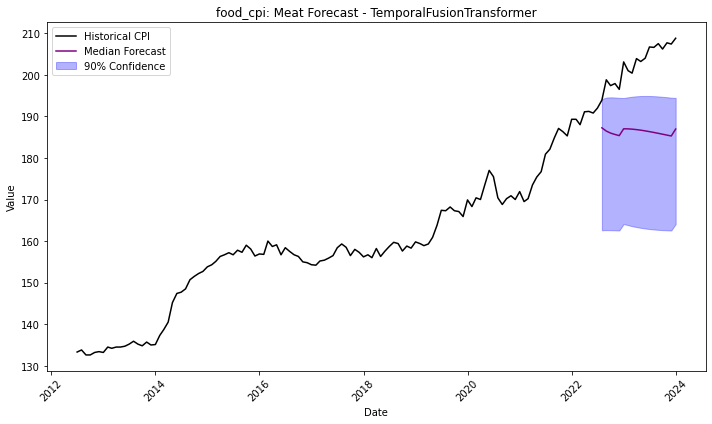

Beginning AutoGluon training... Time limit = 2s
AutoGluon will save models to './output/TEST/ag_global_all_TemporalFusionTransformerModel_exp2_R4_/random_seed_42/2023-07-01/model_files/'
=================== System Info ===================
AutoGluon Version:  1.1.1
Python Version:     3.8.20
Operating System:   Linux
Platform Machine:   x86_64
Platform Version:   #147~18.04.1-Ubuntu SMP Sat Oct 15 13:10:18 UTC 2022
CPU Count:          32
GPU Count:          1
Memory Avail:       166.74 GB / 188.57 GB (88.4%)
Disk Space Avail:   18208.18 GB / 249006.62 GB (7.3%)

Fitting with arguments:
{'enable_ensemble': True,
 'eval_metric': MAPE,
 'excluded_model_types': ['DirectTabular', 'RecursiveTabular'],
 'hyperparameters': {'TemporalFusionTransformerModel': {}},
 'known_covariates_names': [],
 'num_val_windows': 1,
 'prediction_length': 18,
 'quantile_levels': [0.01, 0.05, 0.1, 0.25, 0.75, 0.9, 0.95, 0.99],
 'random_seed': 42,
 'refit_every_n_windows': 1,
 'refit_full': False,
 'skip_model_sele

TemporalFusionTransformerModel


	-0.8459       = Validation score (-MAPE)
	2.14    s     = Training runtime
	0.05    s     = Validation (prediction) runtime
Not fitting ensemble due to lack of time remaining. Time left: -0.3 seconds
Training complete. Models trained: ['TemporalFusionTransformer']
Total runtime: 2.22 s
Best model: TemporalFusionTransformer
Best model score: -0.8459
Model not specified in predict, will default to the model with the best validation score: TemporalFusionTransformer
Model not specified in predict, will default to the model with the best validation score: TemporalFusionTransformer


****************** Summary of fit() ******************
Estimated performance of each model:
                       model  score_val  pred_time_val  fit_time_marginal  \
0  TemporalFusionTransformer  -0.845887       0.045125           2.137545   

   fit_order  
0          1  
Number of models trained: 1
Types of models trained:
{'MultiWindowBacktestingModel'}
****************** End of fit() summary ******************


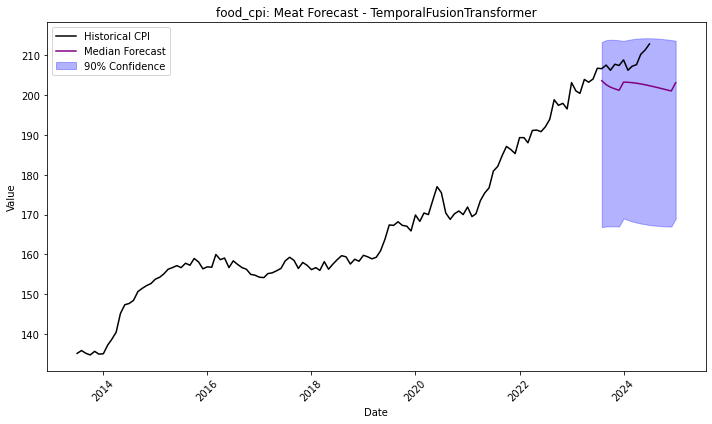

Beginning AutoGluon training... Time limit = 2s
AutoGluon will save models to './output/TEST/ag_global_all_TemporalFusionTransformerModel_exp2_R1_/random_seed_42/2023-07-01/model_files/'
=================== System Info ===================
AutoGluon Version:  1.1.1
Python Version:     3.8.20
Operating System:   Linux
Platform Machine:   x86_64
Platform Version:   #147~18.04.1-Ubuntu SMP Sat Oct 15 13:10:18 UTC 2022
CPU Count:          32
GPU Count:          1
Memory Avail:       166.80 GB / 188.57 GB (88.5%)
Disk Space Avail:   18208.16 GB / 249006.62 GB (7.3%)

Fitting with arguments:
{'enable_ensemble': True,
 'eval_metric': MAPE,
 'excluded_model_types': ['DirectTabular', 'RecursiveTabular'],
 'hyperparameters': {'TemporalFusionTransformerModel': {}},
 'known_covariates_names': [],
 'num_val_windows': 1,
 'prediction_length': 18,
 'quantile_levels': [0.01, 0.05, 0.1, 0.25, 0.75, 0.9, 0.95, 0.99],
 'random_seed': 42,
 'refit_every_n_windows': 1,
 'refit_full': False,
 'skip_model_sele

TemporalFusionTransformerModel


	-0.9923       = Validation score (-MAPE)
	2.13    s     = Training runtime
	0.05    s     = Validation (prediction) runtime
Not fitting ensemble due to lack of time remaining. Time left: -0.3 seconds
Training complete. Models trained: ['TemporalFusionTransformer']
Total runtime: 2.22 s
Best model: TemporalFusionTransformer
Best model score: -0.9923
Model not specified in predict, will default to the model with the best validation score: TemporalFusionTransformer
Model not specified in predict, will default to the model with the best validation score: TemporalFusionTransformer


****************** Summary of fit() ******************
Estimated performance of each model:
                       model  score_val  pred_time_val  fit_time_marginal  \
0  TemporalFusionTransformer  -0.992332       0.045171           2.134802   

   fit_order  
0          1  
Number of models trained: 1
Types of models trained:
{'MultiWindowBacktestingModel'}
****************** End of fit() summary ******************


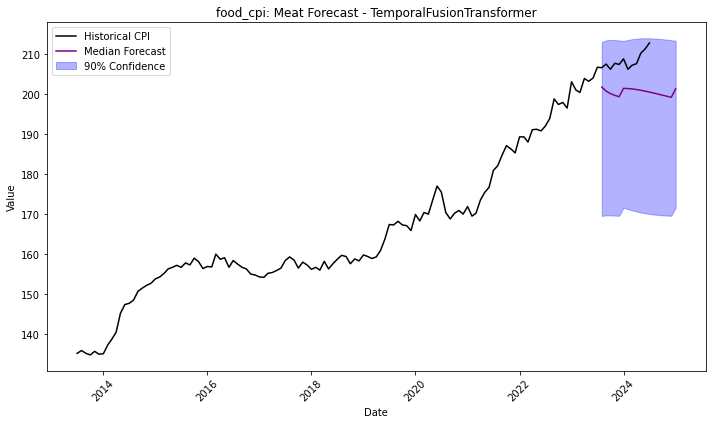

Beginning AutoGluon training... Time limit = 2s
AutoGluon will save models to './output/TEST/ag_global_all_TemporalFusionTransformerModel_exp2_R3_/random_seed_42/2023-07-01/model_files/'
=================== System Info ===================
AutoGluon Version:  1.1.1
Python Version:     3.8.20
Operating System:   Linux
Platform Machine:   x86_64
Platform Version:   #147~18.04.1-Ubuntu SMP Sat Oct 15 13:10:18 UTC 2022
CPU Count:          32
GPU Count:          1
Memory Avail:       166.73 GB / 188.57 GB (88.4%)
Disk Space Avail:   18208.16 GB / 249006.62 GB (7.3%)

Fitting with arguments:
{'enable_ensemble': True,
 'eval_metric': MAPE,
 'excluded_model_types': ['DirectTabular', 'RecursiveTabular'],
 'hyperparameters': {'TemporalFusionTransformerModel': {}},
 'known_covariates_names': [],
 'num_val_windows': 1,
 'prediction_length': 18,
 'quantile_levels': [0.01, 0.05, 0.1, 0.25, 0.75, 0.9, 0.95, 0.99],
 'random_seed': 42,
 'refit_every_n_windows': 1,
 'refit_full': False,
 'skip_model_sele

TemporalFusionTransformerModel


	-0.4656       = Validation score (-MAPE)
	2.12    s     = Training runtime
	0.04    s     = Validation (prediction) runtime
Not fitting ensemble due to lack of time remaining. Time left: -0.3 seconds
Training complete. Models trained: ['TemporalFusionTransformer']
Total runtime: 2.20 s
Best model: TemporalFusionTransformer
Best model score: -0.4656
Model not specified in predict, will default to the model with the best validation score: TemporalFusionTransformer
Model not specified in predict, will default to the model with the best validation score: TemporalFusionTransformer


****************** Summary of fit() ******************
Estimated performance of each model:
                       model  score_val  pred_time_val  fit_time_marginal  \
0  TemporalFusionTransformer  -0.465607       0.043356           2.118178   

   fit_order  
0          1  
Number of models trained: 1
Types of models trained:
{'MultiWindowBacktestingModel'}
****************** End of fit() summary ******************


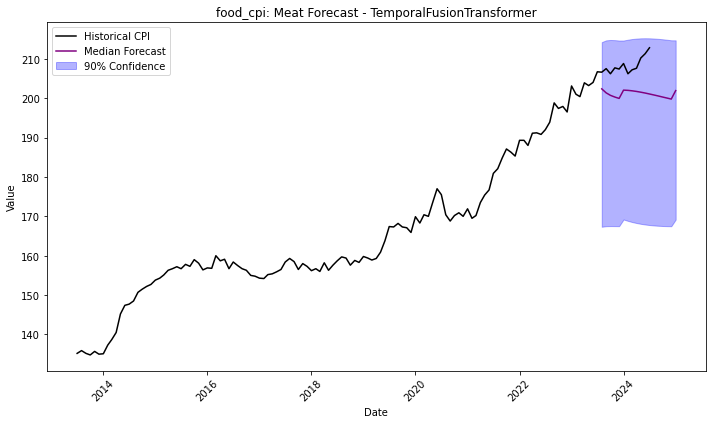

Beginning AutoGluon training... Time limit = 2s
AutoGluon will save models to './output/TEST/ag_global_all_TemporalFusionTransformerModel_exp2_R2_/random_seed_42/2023-07-01/model_files/'
=================== System Info ===================
AutoGluon Version:  1.1.1
Python Version:     3.8.20
Operating System:   Linux
Platform Machine:   x86_64
Platform Version:   #147~18.04.1-Ubuntu SMP Sat Oct 15 13:10:18 UTC 2022
CPU Count:          32
GPU Count:          1
Memory Avail:       166.73 GB / 188.57 GB (88.4%)
Disk Space Avail:   18208.71 GB / 249006.62 GB (7.3%)

Fitting with arguments:
{'enable_ensemble': True,
 'eval_metric': MAPE,
 'excluded_model_types': ['DirectTabular', 'RecursiveTabular'],
 'hyperparameters': {'TemporalFusionTransformerModel': {}},
 'known_covariates_names': [],
 'num_val_windows': 1,
 'prediction_length': 18,
 'quantile_levels': [0.01, 0.05, 0.1, 0.25, 0.75, 0.9, 0.95, 0.99],
 'random_seed': 42,
 'refit_every_n_windows': 1,
 'refit_full': False,
 'skip_model_sele

TemporalFusionTransformerModel


	-0.5319       = Validation score (-MAPE)
	2.13    s     = Training runtime
	0.04    s     = Validation (prediction) runtime
Not fitting ensemble due to lack of time remaining. Time left: -0.3 seconds
Training complete. Models trained: ['TemporalFusionTransformer']
Total runtime: 2.21 s
Best model: TemporalFusionTransformer
Best model score: -0.5319
Model not specified in predict, will default to the model with the best validation score: TemporalFusionTransformer
Model not specified in predict, will default to the model with the best validation score: TemporalFusionTransformer


****************** Summary of fit() ******************
Estimated performance of each model:
                       model  score_val  pred_time_val  fit_time_marginal  \
0  TemporalFusionTransformer  -0.531945       0.044592           2.125141   

   fit_order  
0          1  
Number of models trained: 1
Types of models trained:
{'MultiWindowBacktestingModel'}
****************** End of fit() summary ******************


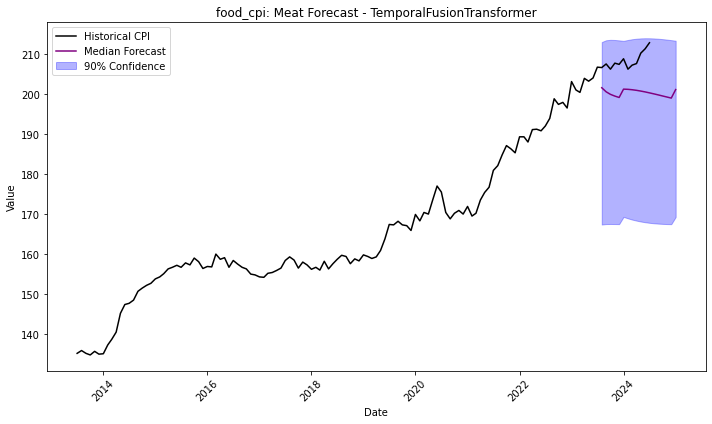

Beginning AutoGluon training... Time limit = 2s
AutoGluon will save models to './output/TEST/ag_global_all_TemporalFusionTransformerModel_exp2_GPT_P1_/random_seed_42/2023-07-01/model_files/'
=================== System Info ===================
AutoGluon Version:  1.1.1
Python Version:     3.8.20
Operating System:   Linux
Platform Machine:   x86_64
Platform Version:   #147~18.04.1-Ubuntu SMP Sat Oct 15 13:10:18 UTC 2022
CPU Count:          32
GPU Count:          1
Memory Avail:       166.73 GB / 188.57 GB (88.4%)
Disk Space Avail:   18208.70 GB / 249006.62 GB (7.3%)

Fitting with arguments:
{'enable_ensemble': True,
 'eval_metric': MAPE,
 'excluded_model_types': ['DirectTabular', 'RecursiveTabular'],
 'hyperparameters': {'TemporalFusionTransformerModel': {}},
 'known_covariates_names': [],
 'num_val_windows': 1,
 'prediction_length': 18,
 'quantile_levels': [0.01, 0.05, 0.1, 0.25, 0.75, 0.9, 0.95, 0.99],
 'random_seed': 42,
 'refit_every_n_windows': 1,
 'refit_full': False,
 'skip_model_

TemporalFusionTransformerModel


	-0.7093       = Validation score (-MAPE)
	2.43    s     = Training runtime
	0.05    s     = Validation (prediction) runtime
Not fitting ensemble due to lack of time remaining. Time left: -0.6 seconds
Training complete. Models trained: ['TemporalFusionTransformer']
Total runtime: 2.51 s
Best model: TemporalFusionTransformer
Best model score: -0.7093
Model not specified in predict, will default to the model with the best validation score: TemporalFusionTransformer
Model not specified in predict, will default to the model with the best validation score: TemporalFusionTransformer


****************** Summary of fit() ******************
Estimated performance of each model:
                       model  score_val  pred_time_val  fit_time_marginal  \
0  TemporalFusionTransformer  -0.709326       0.046247           2.427275   

   fit_order  
0          1  
Number of models trained: 1
Types of models trained:
{'MultiWindowBacktestingModel'}
****************** End of fit() summary ******************


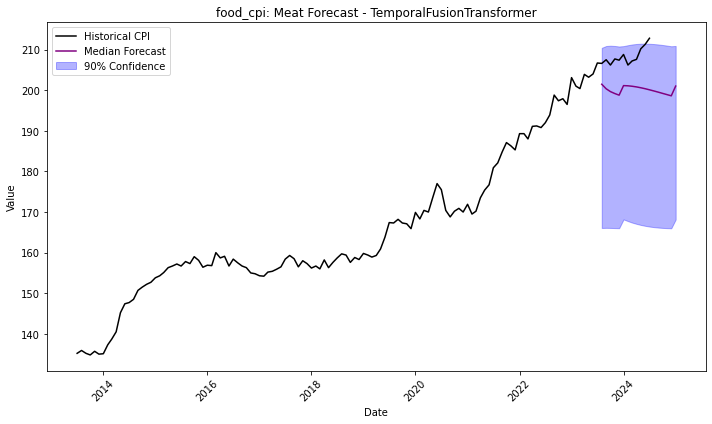

Beginning AutoGluon training... Time limit = 2s
AutoGluon will save models to './output/TEST/ag_global_all_TemporalFusionTransformerModel_exp2_GPT_P4_/random_seed_42/2023-07-01/model_files/'
=================== System Info ===================
AutoGluon Version:  1.1.1
Python Version:     3.8.20
Operating System:   Linux
Platform Machine:   x86_64
Platform Version:   #147~18.04.1-Ubuntu SMP Sat Oct 15 13:10:18 UTC 2022
CPU Count:          32
GPU Count:          1
Memory Avail:       166.81 GB / 188.57 GB (88.5%)
Disk Space Avail:   18208.70 GB / 249006.62 GB (7.3%)

Fitting with arguments:
{'enable_ensemble': True,
 'eval_metric': MAPE,
 'excluded_model_types': ['DirectTabular', 'RecursiveTabular'],
 'hyperparameters': {'TemporalFusionTransformerModel': {}},
 'known_covariates_names': [],
 'num_val_windows': 1,
 'prediction_length': 18,
 'quantile_levels': [0.01, 0.05, 0.1, 0.25, 0.75, 0.9, 0.95, 0.99],
 'random_seed': 42,
 'refit_every_n_windows': 1,
 'refit_full': False,
 'skip_model_

TemporalFusionTransformerModel


	-1.0158       = Validation score (-MAPE)
	2.13    s     = Training runtime
	0.04    s     = Validation (prediction) runtime
Not fitting ensemble due to lack of time remaining. Time left: -0.3 seconds
Training complete. Models trained: ['TemporalFusionTransformer']
Total runtime: 2.20 s
Best model: TemporalFusionTransformer
Best model score: -1.0158
Model not specified in predict, will default to the model with the best validation score: TemporalFusionTransformer
Model not specified in predict, will default to the model with the best validation score: TemporalFusionTransformer


****************** Summary of fit() ******************
Estimated performance of each model:
                       model  score_val  pred_time_val  fit_time_marginal  \
0  TemporalFusionTransformer  -1.015842       0.038441           2.125216   

   fit_order  
0          1  
Number of models trained: 1
Types of models trained:
{'MultiWindowBacktestingModel'}
****************** End of fit() summary ******************


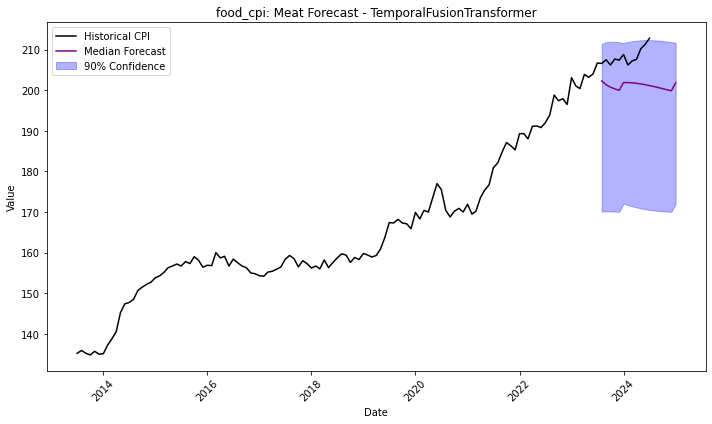

Beginning AutoGluon training... Time limit = 2s
AutoGluon will save models to './output/TEST/ag_global_all_TemporalFusionTransformerModel_exp2_GPT_P3_/random_seed_42/2023-07-01/model_files/'
=================== System Info ===================
AutoGluon Version:  1.1.1
Python Version:     3.8.20
Operating System:   Linux
Platform Machine:   x86_64
Platform Version:   #147~18.04.1-Ubuntu SMP Sat Oct 15 13:10:18 UTC 2022
CPU Count:          32
GPU Count:          1
Memory Avail:       166.87 GB / 188.57 GB (88.5%)
Disk Space Avail:   18208.69 GB / 249006.62 GB (7.3%)

Fitting with arguments:
{'enable_ensemble': True,
 'eval_metric': MAPE,
 'excluded_model_types': ['DirectTabular', 'RecursiveTabular'],
 'hyperparameters': {'TemporalFusionTransformerModel': {}},
 'known_covariates_names': [],
 'num_val_windows': 1,
 'prediction_length': 18,
 'quantile_levels': [0.01, 0.05, 0.1, 0.25, 0.75, 0.9, 0.95, 0.99],
 'random_seed': 42,
 'refit_every_n_windows': 1,
 'refit_full': False,
 'skip_model_

TemporalFusionTransformerModel


	-1.0682       = Validation score (-MAPE)
	2.13    s     = Training runtime
	0.04    s     = Validation (prediction) runtime
Not fitting ensemble due to lack of time remaining. Time left: -0.3 seconds
Training complete. Models trained: ['TemporalFusionTransformer']
Total runtime: 2.22 s
Best model: TemporalFusionTransformer
Best model score: -1.0682
Model not specified in predict, will default to the model with the best validation score: TemporalFusionTransformer
Model not specified in predict, will default to the model with the best validation score: TemporalFusionTransformer


****************** Summary of fit() ******************
Estimated performance of each model:
                       model  score_val  pred_time_val  fit_time_marginal  \
0  TemporalFusionTransformer  -1.068229       0.043748           2.128164   

   fit_order  
0          1  
Number of models trained: 1
Types of models trained:
{'MultiWindowBacktestingModel'}
****************** End of fit() summary ******************


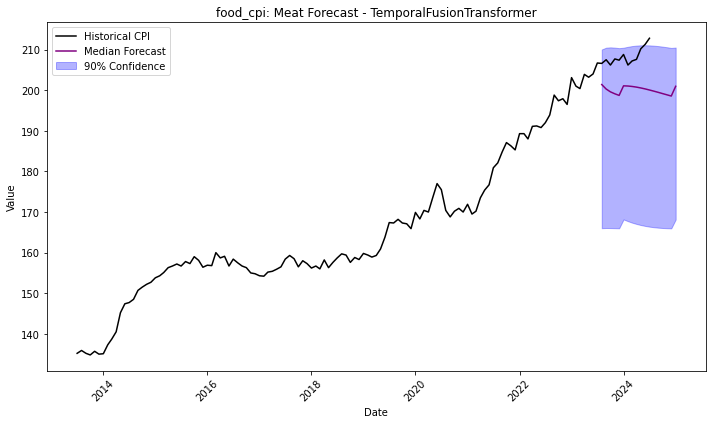

Beginning AutoGluon training... Time limit = 2s
AutoGluon will save models to './output/TEST/ag_global_all_TemporalFusionTransformerModel_exp2_GPT_P2_/random_seed_42/2023-07-01/model_files/'
=================== System Info ===================
AutoGluon Version:  1.1.1
Python Version:     3.8.20
Operating System:   Linux
Platform Machine:   x86_64
Platform Version:   #147~18.04.1-Ubuntu SMP Sat Oct 15 13:10:18 UTC 2022
CPU Count:          32
GPU Count:          1
Memory Avail:       166.74 GB / 188.57 GB (88.4%)
Disk Space Avail:   18208.68 GB / 249006.62 GB (7.3%)

Fitting with arguments:
{'enable_ensemble': True,
 'eval_metric': MAPE,
 'excluded_model_types': ['DirectTabular', 'RecursiveTabular'],
 'hyperparameters': {'TemporalFusionTransformerModel': {}},
 'known_covariates_names': [],
 'num_val_windows': 1,
 'prediction_length': 18,
 'quantile_levels': [0.01, 0.05, 0.1, 0.25, 0.75, 0.9, 0.95, 0.99],
 'random_seed': 42,
 'refit_every_n_windows': 1,
 'refit_full': False,
 'skip_model_

TemporalFusionTransformerModel


	-0.6480       = Validation score (-MAPE)
	2.15    s     = Training runtime
	0.04    s     = Validation (prediction) runtime
Not fitting ensemble due to lack of time remaining. Time left: -0.3 seconds
Training complete. Models trained: ['TemporalFusionTransformer']
Total runtime: 2.23 s
Best model: TemporalFusionTransformer
Best model score: -0.6480
Model not specified in predict, will default to the model with the best validation score: TemporalFusionTransformer
Model not specified in predict, will default to the model with the best validation score: TemporalFusionTransformer


****************** Summary of fit() ******************
Estimated performance of each model:
                       model  score_val  pred_time_val  fit_time_marginal  \
0  TemporalFusionTransformer  -0.647972       0.039985            2.15123   

   fit_order  
0          1  
Number of models trained: 1
Types of models trained:
{'MultiWindowBacktestingModel'}
****************** End of fit() summary ******************


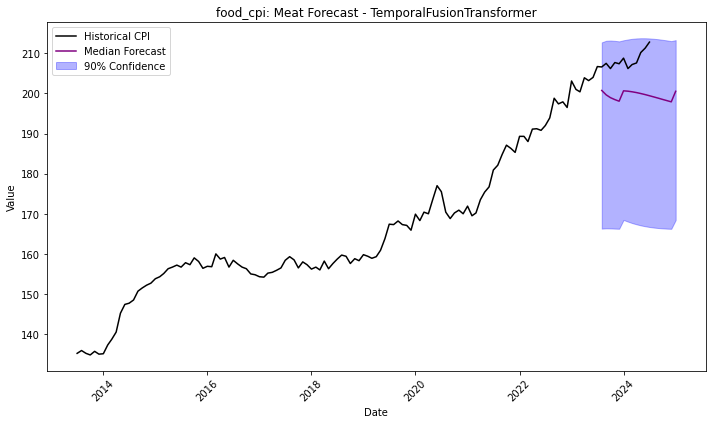

Beginning AutoGluon training... Time limit = 2s
AutoGluon will save models to './output/TEST/ag_global_all_TemporalFusionTransformerModel_exp2_R3_/random_seed_42/2018-07-01/model_files/'
=================== System Info ===================
AutoGluon Version:  1.1.1
Python Version:     3.8.20
Operating System:   Linux
Platform Machine:   x86_64
Platform Version:   #147~18.04.1-Ubuntu SMP Sat Oct 15 13:10:18 UTC 2022
CPU Count:          32
GPU Count:          1
Memory Avail:       166.73 GB / 188.57 GB (88.4%)
Disk Space Avail:   18208.67 GB / 249006.62 GB (7.3%)

Fitting with arguments:
{'enable_ensemble': True,
 'eval_metric': MAPE,
 'excluded_model_types': ['DirectTabular', 'RecursiveTabular'],
 'hyperparameters': {'TemporalFusionTransformerModel': {}},
 'known_covariates_names': [],
 'num_val_windows': 1,
 'prediction_length': 18,
 'quantile_levels': [0.01, 0.05, 0.1, 0.25, 0.75, 0.9, 0.95, 0.99],
 'random_seed': 42,
 'refit_every_n_windows': 1,
 'refit_full': False,
 'skip_model_sele

TemporalFusionTransformerModel


	-1.7939       = Validation score (-MAPE)
	2.14    s     = Training runtime
	0.04    s     = Validation (prediction) runtime
Not fitting ensemble due to lack of time remaining. Time left: -0.3 seconds
Training complete. Models trained: ['TemporalFusionTransformer']
Total runtime: 2.22 s
Best model: TemporalFusionTransformer
Best model score: -1.7939
Model not specified in predict, will default to the model with the best validation score: TemporalFusionTransformer
Model not specified in predict, will default to the model with the best validation score: TemporalFusionTransformer


****************** Summary of fit() ******************
Estimated performance of each model:
                       model  score_val  pred_time_val  fit_time_marginal  \
0  TemporalFusionTransformer  -1.793923       0.041479           2.142639   

   fit_order  
0          1  
Number of models trained: 1
Types of models trained:
{'MultiWindowBacktestingModel'}
****************** End of fit() summary ******************


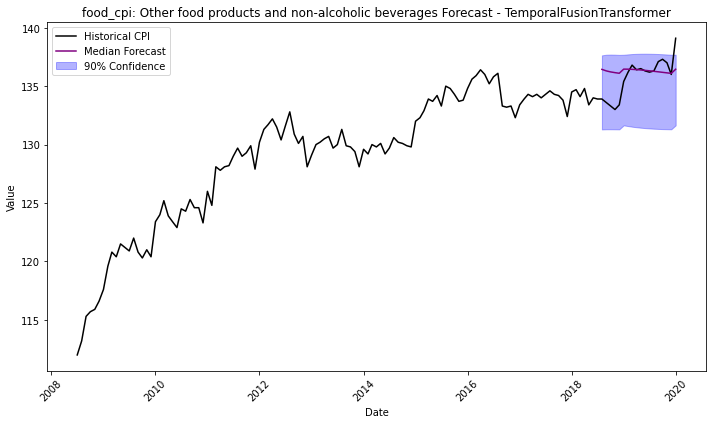

Beginning AutoGluon training... Time limit = 2s
AutoGluon will save models to './output/TEST/ag_global_all_TemporalFusionTransformerModel_exp2_GPT_P3_/random_seed_42/2018-07-01/model_files/'
=================== System Info ===================
AutoGluon Version:  1.1.1
Python Version:     3.8.20
Operating System:   Linux
Platform Machine:   x86_64
Platform Version:   #147~18.04.1-Ubuntu SMP Sat Oct 15 13:10:18 UTC 2022
CPU Count:          32
GPU Count:          1
Memory Avail:       166.74 GB / 188.57 GB (88.4%)
Disk Space Avail:   18208.71 GB / 249006.62 GB (7.3%)

Fitting with arguments:
{'enable_ensemble': True,
 'eval_metric': MAPE,
 'excluded_model_types': ['DirectTabular', 'RecursiveTabular'],
 'hyperparameters': {'TemporalFusionTransformerModel': {}},
 'known_covariates_names': [],
 'num_val_windows': 1,
 'prediction_length': 18,
 'quantile_levels': [0.01, 0.05, 0.1, 0.25, 0.75, 0.9, 0.95, 0.99],
 'random_seed': 42,
 'refit_every_n_windows': 1,
 'refit_full': False,
 'skip_model_

TemporalFusionTransformerModel


	-2.7224       = Validation score (-MAPE)
	2.16    s     = Training runtime
	0.04    s     = Validation (prediction) runtime
Not fitting ensemble due to lack of time remaining. Time left: -0.3 seconds
Training complete. Models trained: ['TemporalFusionTransformer']
Total runtime: 2.24 s
Best model: TemporalFusionTransformer
Best model score: -2.7224
Model not specified in predict, will default to the model with the best validation score: TemporalFusionTransformer
Model not specified in predict, will default to the model with the best validation score: TemporalFusionTransformer


****************** Summary of fit() ******************
Estimated performance of each model:
                       model  score_val  pred_time_val  fit_time_marginal  \
0  TemporalFusionTransformer  -2.722424       0.043415           2.161827   

   fit_order  
0          1  
Number of models trained: 1
Types of models trained:
{'MultiWindowBacktestingModel'}
****************** End of fit() summary ******************


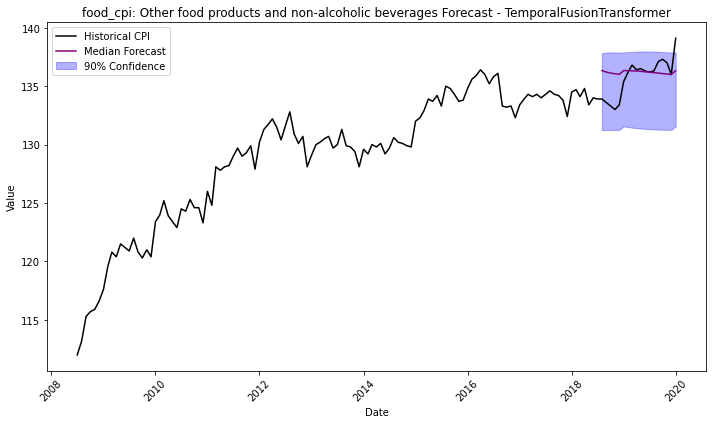

Beginning AutoGluon training... Time limit = 2s
AutoGluon will save models to './output/TEST/ag_global_all_TemporalFusionTransformerModel_exp2_R4_/random_seed_42/2018-07-01/model_files/'
=================== System Info ===================
AutoGluon Version:  1.1.1
Python Version:     3.8.20
Operating System:   Linux
Platform Machine:   x86_64
Platform Version:   #147~18.04.1-Ubuntu SMP Sat Oct 15 13:10:18 UTC 2022
CPU Count:          32
GPU Count:          1
Memory Avail:       166.74 GB / 188.57 GB (88.4%)
Disk Space Avail:   18208.71 GB / 249006.62 GB (7.3%)

Fitting with arguments:
{'enable_ensemble': True,
 'eval_metric': MAPE,
 'excluded_model_types': ['DirectTabular', 'RecursiveTabular'],
 'hyperparameters': {'TemporalFusionTransformerModel': {}},
 'known_covariates_names': [],
 'num_val_windows': 1,
 'prediction_length': 18,
 'quantile_levels': [0.01, 0.05, 0.1, 0.25, 0.75, 0.9, 0.95, 0.99],
 'random_seed': 42,
 'refit_every_n_windows': 1,
 'refit_full': False,
 'skip_model_sele

TemporalFusionTransformerModel


Inferred time series frequency: 'MS'
Provided train_data has 8602 rows, 22 time series. Median time series length is 391 (min=391, max=391). 

Provided data contains following columns:
	target: 'target'

AutoGluon will gauge predictive performance using evaluation metric: 'MAPE'
	This metric's sign has been flipped to adhere to being higher_is_better. The metric score can be multiplied by -1 to get the metric value.

Starting training. Start time is 2024-10-27 07:44:50
Excluded model types: ['DirectTabular', 'RecursiveTabular']
Models that will be trained: ['TemporalFusionTransformer']
Training timeseries model TemporalFusionTransformer. Training for up to 1.6s of the 1.6s of remaining time.
	-1.2519       = Validation score (-MAPE)
	1.81    s     = Training runtime
	0.04    s     = Validation (prediction) runtime
Not fitting ensemble due to lack of time remaining. Time left: -0.3 seconds
Training complete. Models trained: ['TemporalFusionTransformer']
Total runtime: 1.90 s
Best model:

****************** Summary of fit() ******************
Estimated performance of each model:
                       model  score_val  pred_time_val  fit_time_marginal  \
0  TemporalFusionTransformer  -1.251856       0.041757           1.814674   

   fit_order  
0          1  
Number of models trained: 1
Types of models trained:
{'MultiWindowBacktestingModel'}
****************** End of fit() summary ******************


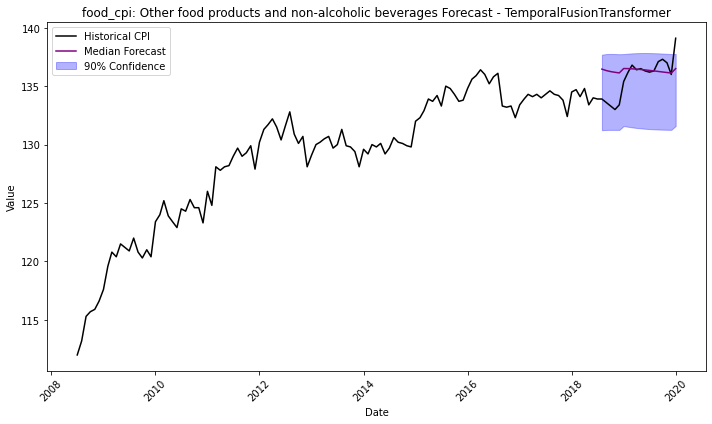

Beginning AutoGluon training... Time limit = 2s
AutoGluon will save models to './output/TEST/ag_global_all_TemporalFusionTransformerModel_exp2_GPT_P4_/random_seed_42/2018-07-01/model_files/'
=================== System Info ===================
AutoGluon Version:  1.1.1
Python Version:     3.8.20
Operating System:   Linux
Platform Machine:   x86_64
Platform Version:   #147~18.04.1-Ubuntu SMP Sat Oct 15 13:10:18 UTC 2022
CPU Count:          32
GPU Count:          1
Memory Avail:       166.74 GB / 188.57 GB (88.4%)
Disk Space Avail:   18208.70 GB / 249006.62 GB (7.3%)

Fitting with arguments:
{'enable_ensemble': True,
 'eval_metric': MAPE,
 'excluded_model_types': ['DirectTabular', 'RecursiveTabular'],
 'hyperparameters': {'TemporalFusionTransformerModel': {}},
 'known_covariates_names': [],
 'num_val_windows': 1,
 'prediction_length': 18,
 'quantile_levels': [0.01, 0.05, 0.1, 0.25, 0.75, 0.9, 0.95, 0.99],
 'random_seed': 42,
 'refit_every_n_windows': 1,
 'refit_full': False,
 'skip_model_

TemporalFusionTransformerModel


	-1.8038       = Validation score (-MAPE)
	2.15    s     = Training runtime
	0.04    s     = Validation (prediction) runtime
Not fitting ensemble due to lack of time remaining. Time left: -0.3 seconds
Training complete. Models trained: ['TemporalFusionTransformer']
Total runtime: 2.23 s
Best model: TemporalFusionTransformer
Best model score: -1.8038
Model not specified in predict, will default to the model with the best validation score: TemporalFusionTransformer
Model not specified in predict, will default to the model with the best validation score: TemporalFusionTransformer


****************** Summary of fit() ******************
Estimated performance of each model:
                       model  score_val  pred_time_val  fit_time_marginal  \
0  TemporalFusionTransformer  -1.803769       0.040046           2.147216   

   fit_order  
0          1  
Number of models trained: 1
Types of models trained:
{'MultiWindowBacktestingModel'}
****************** End of fit() summary ******************


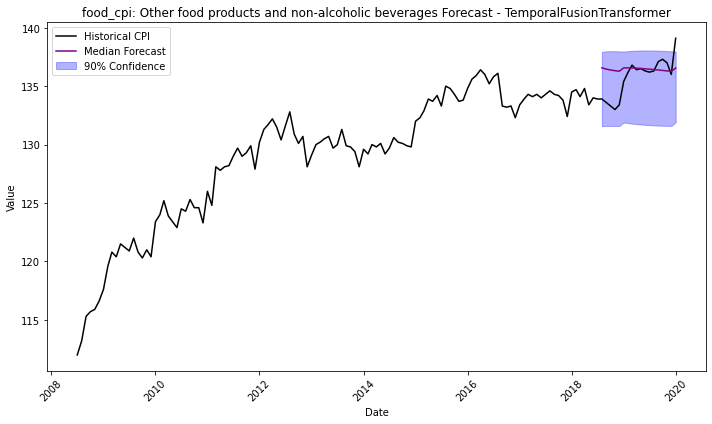

Beginning AutoGluon training... Time limit = 2s
AutoGluon will save models to './output/TEST/ag_global_all_TemporalFusionTransformerModel_exp2_R2_/random_seed_42/2018-07-01/model_files/'
=================== System Info ===================
AutoGluon Version:  1.1.1
Python Version:     3.8.20
Operating System:   Linux
Platform Machine:   x86_64
Platform Version:   #147~18.04.1-Ubuntu SMP Sat Oct 15 13:10:18 UTC 2022
CPU Count:          32
GPU Count:          1
Memory Avail:       166.79 GB / 188.57 GB (88.4%)
Disk Space Avail:   18208.69 GB / 249006.62 GB (7.3%)

Fitting with arguments:
{'enable_ensemble': True,
 'eval_metric': MAPE,
 'excluded_model_types': ['DirectTabular', 'RecursiveTabular'],
 'hyperparameters': {'TemporalFusionTransformerModel': {}},
 'known_covariates_names': [],
 'num_val_windows': 1,
 'prediction_length': 18,
 'quantile_levels': [0.01, 0.05, 0.1, 0.25, 0.75, 0.9, 0.95, 0.99],
 'random_seed': 42,
 'refit_every_n_windows': 1,
 'refit_full': False,
 'skip_model_sele

TemporalFusionTransformerModel


	-0.7117       = Validation score (-MAPE)
	2.12    s     = Training runtime
	0.04    s     = Validation (prediction) runtime
Not fitting ensemble due to lack of time remaining. Time left: -0.3 seconds
Training complete. Models trained: ['TemporalFusionTransformer']
Total runtime: 2.20 s
Best model: TemporalFusionTransformer
Best model score: -0.7117
Model not specified in predict, will default to the model with the best validation score: TemporalFusionTransformer
Model not specified in predict, will default to the model with the best validation score: TemporalFusionTransformer


****************** Summary of fit() ******************
Estimated performance of each model:
                       model  score_val  pred_time_val  fit_time_marginal  \
0  TemporalFusionTransformer  -0.711695       0.044024           2.120062   

   fit_order  
0          1  
Number of models trained: 1
Types of models trained:
{'MultiWindowBacktestingModel'}
****************** End of fit() summary ******************


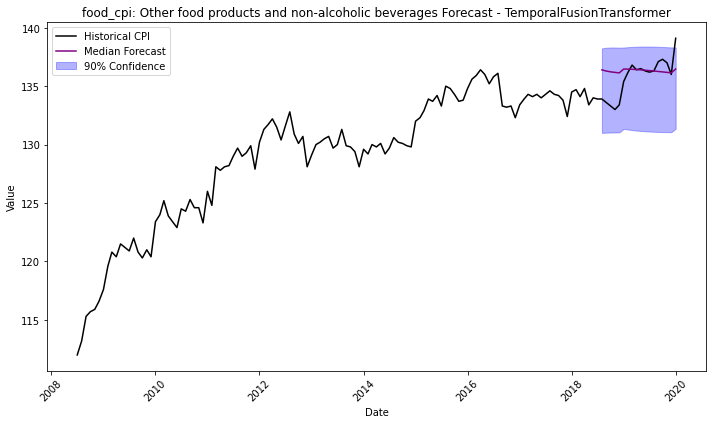

Beginning AutoGluon training... Time limit = 2s
AutoGluon will save models to './output/TEST/ag_global_all_TemporalFusionTransformerModel_exp2_GPT_P1_/random_seed_42/2018-07-01/model_files/'
=================== System Info ===================
AutoGluon Version:  1.1.1
Python Version:     3.8.20
Operating System:   Linux
Platform Machine:   x86_64
Platform Version:   #147~18.04.1-Ubuntu SMP Sat Oct 15 13:10:18 UTC 2022
CPU Count:          32
GPU Count:          1
Memory Avail:       166.75 GB / 188.57 GB (88.4%)
Disk Space Avail:   18208.68 GB / 249006.62 GB (7.3%)

Fitting with arguments:
{'enable_ensemble': True,
 'eval_metric': MAPE,
 'excluded_model_types': ['DirectTabular', 'RecursiveTabular'],
 'hyperparameters': {'TemporalFusionTransformerModel': {}},
 'known_covariates_names': [],
 'num_val_windows': 1,
 'prediction_length': 18,
 'quantile_levels': [0.01, 0.05, 0.1, 0.25, 0.75, 0.9, 0.95, 0.99],
 'random_seed': 42,
 'refit_every_n_windows': 1,
 'refit_full': False,
 'skip_model_

TemporalFusionTransformerModel


	-2.7377       = Validation score (-MAPE)
	2.12    s     = Training runtime
	0.04    s     = Validation (prediction) runtime
Not fitting ensemble due to lack of time remaining. Time left: -0.3 seconds
Training complete. Models trained: ['TemporalFusionTransformer']
Total runtime: 2.20 s
Best model: TemporalFusionTransformer
Best model score: -2.7377
Model not specified in predict, will default to the model with the best validation score: TemporalFusionTransformer
Model not specified in predict, will default to the model with the best validation score: TemporalFusionTransformer


****************** Summary of fit() ******************
Estimated performance of each model:
                       model  score_val  pred_time_val  fit_time_marginal  \
0  TemporalFusionTransformer  -2.737745       0.041951           2.124185   

   fit_order  
0          1  
Number of models trained: 1
Types of models trained:
{'MultiWindowBacktestingModel'}
****************** End of fit() summary ******************


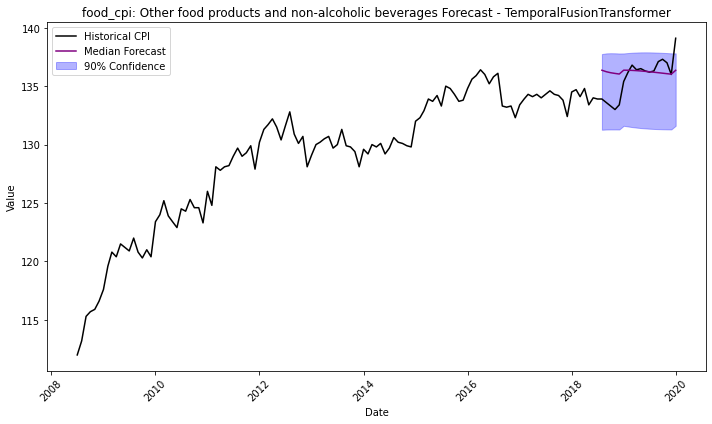

Beginning AutoGluon training... Time limit = 2s
AutoGluon will save models to './output/TEST/ag_global_all_TemporalFusionTransformerModel_exp2_R1_/random_seed_42/2018-07-01/model_files/'
=================== System Info ===================
AutoGluon Version:  1.1.1
Python Version:     3.8.20
Operating System:   Linux
Platform Machine:   x86_64
Platform Version:   #147~18.04.1-Ubuntu SMP Sat Oct 15 13:10:18 UTC 2022
CPU Count:          32
GPU Count:          1
Memory Avail:       166.74 GB / 188.57 GB (88.4%)
Disk Space Avail:   18208.67 GB / 249006.62 GB (7.3%)

Fitting with arguments:
{'enable_ensemble': True,
 'eval_metric': MAPE,
 'excluded_model_types': ['DirectTabular', 'RecursiveTabular'],
 'hyperparameters': {'TemporalFusionTransformerModel': {}},
 'known_covariates_names': [],
 'num_val_windows': 1,
 'prediction_length': 18,
 'quantile_levels': [0.01, 0.05, 0.1, 0.25, 0.75, 0.9, 0.95, 0.99],
 'random_seed': 42,
 'refit_every_n_windows': 1,
 'refit_full': False,
 'skip_model_sele

TemporalFusionTransformerModel


	-1.1395       = Validation score (-MAPE)
	2.12    s     = Training runtime
	0.04    s     = Validation (prediction) runtime
Not fitting ensemble due to lack of time remaining. Time left: -0.3 seconds
Training complete. Models trained: ['TemporalFusionTransformer']
Total runtime: 2.21 s
Best model: TemporalFusionTransformer
Best model score: -1.1395
Model not specified in predict, will default to the model with the best validation score: TemporalFusionTransformer
Model not specified in predict, will default to the model with the best validation score: TemporalFusionTransformer


****************** Summary of fit() ******************
Estimated performance of each model:
                       model  score_val  pred_time_val  fit_time_marginal  \
0  TemporalFusionTransformer  -1.139496       0.042056           2.123455   

   fit_order  
0          1  
Number of models trained: 1
Types of models trained:
{'MultiWindowBacktestingModel'}
****************** End of fit() summary ******************


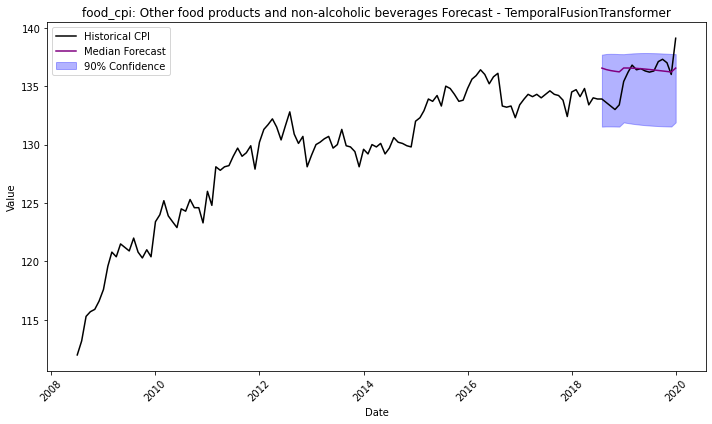

Beginning AutoGluon training... Time limit = 2s
AutoGluon will save models to './output/TEST/ag_global_all_TemporalFusionTransformerModel_exp2_GPT_P2_/random_seed_42/2018-07-01/model_files/'
=================== System Info ===================
AutoGluon Version:  1.1.1
Python Version:     3.8.20
Operating System:   Linux
Platform Machine:   x86_64
Platform Version:   #147~18.04.1-Ubuntu SMP Sat Oct 15 13:10:18 UTC 2022
CPU Count:          32
GPU Count:          1
Memory Avail:       166.82 GB / 188.57 GB (88.5%)
Disk Space Avail:   18208.72 GB / 249006.62 GB (7.3%)

Fitting with arguments:
{'enable_ensemble': True,
 'eval_metric': MAPE,
 'excluded_model_types': ['DirectTabular', 'RecursiveTabular'],
 'hyperparameters': {'TemporalFusionTransformerModel': {}},
 'known_covariates_names': [],
 'num_val_windows': 1,
 'prediction_length': 18,
 'quantile_levels': [0.01, 0.05, 0.1, 0.25, 0.75, 0.9, 0.95, 0.99],
 'random_seed': 42,
 'refit_every_n_windows': 1,
 'refit_full': False,
 'skip_model_

TemporalFusionTransformerModel


	-2.5742       = Validation score (-MAPE)
	2.08    s     = Training runtime
	0.04    s     = Validation (prediction) runtime
Not fitting ensemble due to lack of time remaining. Time left: -0.2 seconds
Training complete. Models trained: ['TemporalFusionTransformer']
Total runtime: 2.16 s
Best model: TemporalFusionTransformer
Best model score: -2.5742


****************** Summary of fit() ******************
Estimated performance of each model:
                       model  score_val  pred_time_val  fit_time_marginal  \
0  TemporalFusionTransformer  -2.574193       0.039819           2.084496   

   fit_order  
0          1  
Number of models trained: 1
Types of models trained:
{'MultiWindowBacktestingModel'}
****************** End of fit() summary ******************


Model not specified in predict, will default to the model with the best validation score: TemporalFusionTransformer
Model not specified in predict, will default to the model with the best validation score: TemporalFusionTransformer


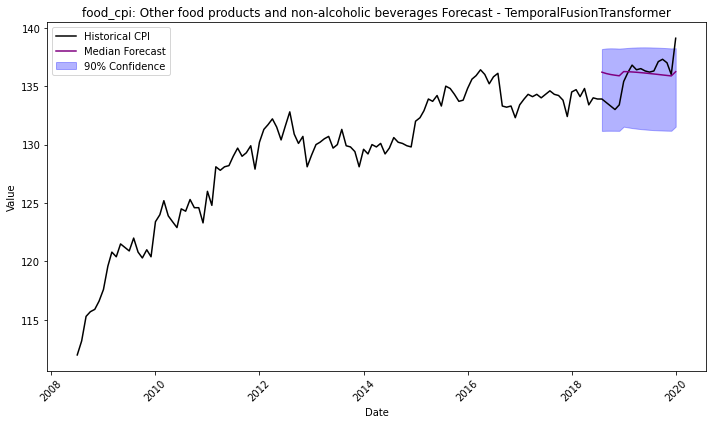

Beginning AutoGluon training... Time limit = 2s
AutoGluon will save models to './output/TEST/ag_global_all_TemporalFusionTransformerModel_exp2_R3_/random_seed_42/2019-07-01/model_files/'
=================== System Info ===================
AutoGluon Version:  1.1.1
Python Version:     3.8.20
Operating System:   Linux
Platform Machine:   x86_64
Platform Version:   #147~18.04.1-Ubuntu SMP Sat Oct 15 13:10:18 UTC 2022
CPU Count:          32
GPU Count:          1
Memory Avail:       166.77 GB / 188.57 GB (88.4%)
Disk Space Avail:   18208.71 GB / 249006.62 GB (7.3%)

Fitting with arguments:
{'enable_ensemble': True,
 'eval_metric': MAPE,
 'excluded_model_types': ['DirectTabular', 'RecursiveTabular'],
 'hyperparameters': {'TemporalFusionTransformerModel': {}},
 'known_covariates_names': [],
 'num_val_windows': 1,
 'prediction_length': 18,
 'quantile_levels': [0.01, 0.05, 0.1, 0.25, 0.75, 0.9, 0.95, 0.99],
 'random_seed': 42,
 'refit_every_n_windows': 1,
 'refit_full': False,
 'skip_model_sele

TemporalFusionTransformerModel


	-0.7058       = Validation score (-MAPE)
	2.14    s     = Training runtime
	0.04    s     = Validation (prediction) runtime
Not fitting ensemble due to lack of time remaining. Time left: -0.3 seconds
Training complete. Models trained: ['TemporalFusionTransformer']
Total runtime: 2.22 s
Best model: TemporalFusionTransformer
Best model score: -0.7058
Model not specified in predict, will default to the model with the best validation score: TemporalFusionTransformer
Model not specified in predict, will default to the model with the best validation score: TemporalFusionTransformer


****************** Summary of fit() ******************
Estimated performance of each model:
                       model  score_val  pred_time_val  fit_time_marginal  \
0  TemporalFusionTransformer  -0.705779       0.042185           2.136946   

   fit_order  
0          1  
Number of models trained: 1
Types of models trained:
{'MultiWindowBacktestingModel'}
****************** End of fit() summary ******************


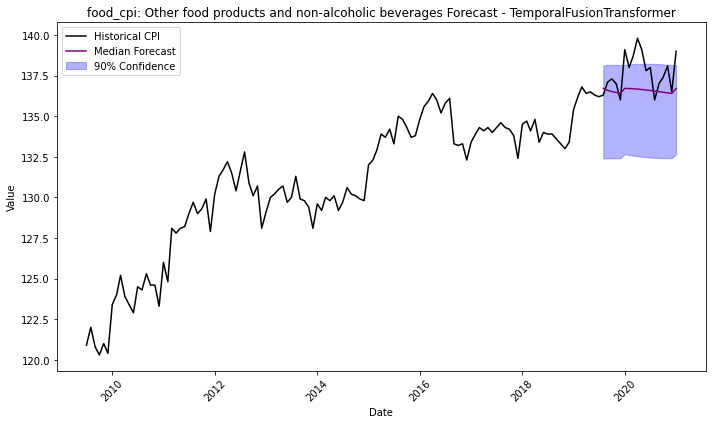

Beginning AutoGluon training... Time limit = 2s
AutoGluon will save models to './output/TEST/ag_global_all_TemporalFusionTransformerModel_exp2_GPT_P3_/random_seed_42/2019-07-01/model_files/'
=================== System Info ===================
AutoGluon Version:  1.1.1
Python Version:     3.8.20
Operating System:   Linux
Platform Machine:   x86_64
Platform Version:   #147~18.04.1-Ubuntu SMP Sat Oct 15 13:10:18 UTC 2022
CPU Count:          32
GPU Count:          1
Memory Avail:       166.73 GB / 188.57 GB (88.4%)
Disk Space Avail:   18208.70 GB / 249006.62 GB (7.3%)

Fitting with arguments:
{'enable_ensemble': True,
 'eval_metric': MAPE,
 'excluded_model_types': ['DirectTabular', 'RecursiveTabular'],
 'hyperparameters': {'TemporalFusionTransformerModel': {}},
 'known_covariates_names': [],
 'num_val_windows': 1,
 'prediction_length': 18,
 'quantile_levels': [0.01, 0.05, 0.1, 0.25, 0.75, 0.9, 0.95, 0.99],
 'random_seed': 42,
 'refit_every_n_windows': 1,
 'refit_full': False,
 'skip_model_

TemporalFusionTransformerModel


	-1.0523       = Validation score (-MAPE)
	2.13    s     = Training runtime
	0.04    s     = Validation (prediction) runtime
Not fitting ensemble due to lack of time remaining. Time left: -0.3 seconds
Training complete. Models trained: ['TemporalFusionTransformer']
Total runtime: 2.22 s
Best model: TemporalFusionTransformer
Best model score: -1.0523
Model not specified in predict, will default to the model with the best validation score: TemporalFusionTransformer
Model not specified in predict, will default to the model with the best validation score: TemporalFusionTransformer


****************** Summary of fit() ******************
Estimated performance of each model:
                       model  score_val  pred_time_val  fit_time_marginal  \
0  TemporalFusionTransformer  -1.052255       0.043004           2.133628   

   fit_order  
0          1  
Number of models trained: 1
Types of models trained:
{'MultiWindowBacktestingModel'}
****************** End of fit() summary ******************


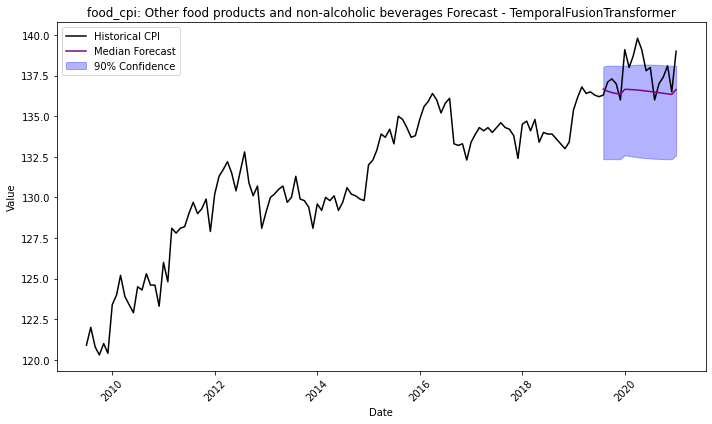

Beginning AutoGluon training... Time limit = 2s
AutoGluon will save models to './output/TEST/ag_global_all_TemporalFusionTransformerModel_exp2_R4_/random_seed_42/2019-07-01/model_files/'
=================== System Info ===================
AutoGluon Version:  1.1.1
Python Version:     3.8.20
Operating System:   Linux
Platform Machine:   x86_64
Platform Version:   #147~18.04.1-Ubuntu SMP Sat Oct 15 13:10:18 UTC 2022
CPU Count:          32
GPU Count:          1
Memory Avail:       166.73 GB / 188.57 GB (88.4%)
Disk Space Avail:   18208.70 GB / 249006.62 GB (7.3%)

Fitting with arguments:
{'enable_ensemble': True,
 'eval_metric': MAPE,
 'excluded_model_types': ['DirectTabular', 'RecursiveTabular'],
 'hyperparameters': {'TemporalFusionTransformerModel': {}},
 'known_covariates_names': [],
 'num_val_windows': 1,
 'prediction_length': 18,
 'quantile_levels': [0.01, 0.05, 0.1, 0.25, 0.75, 0.9, 0.95, 0.99],
 'random_seed': 42,
 'refit_every_n_windows': 1,
 'refit_full': False,
 'skip_model_sele

TemporalFusionTransformerModel


	-0.5594       = Validation score (-MAPE)
	2.14    s     = Training runtime
	0.04    s     = Validation (prediction) runtime
Not fitting ensemble due to lack of time remaining. Time left: -0.3 seconds
Training complete. Models trained: ['TemporalFusionTransformer']
Total runtime: 2.21 s
Best model: TemporalFusionTransformer
Best model score: -0.5594
Model not specified in predict, will default to the model with the best validation score: TemporalFusionTransformer
Model not specified in predict, will default to the model with the best validation score: TemporalFusionTransformer


****************** Summary of fit() ******************
Estimated performance of each model:
                       model  score_val  pred_time_val  fit_time_marginal  \
0  TemporalFusionTransformer   -0.55942       0.042451           2.136172   

   fit_order  
0          1  
Number of models trained: 1
Types of models trained:
{'MultiWindowBacktestingModel'}
****************** End of fit() summary ******************


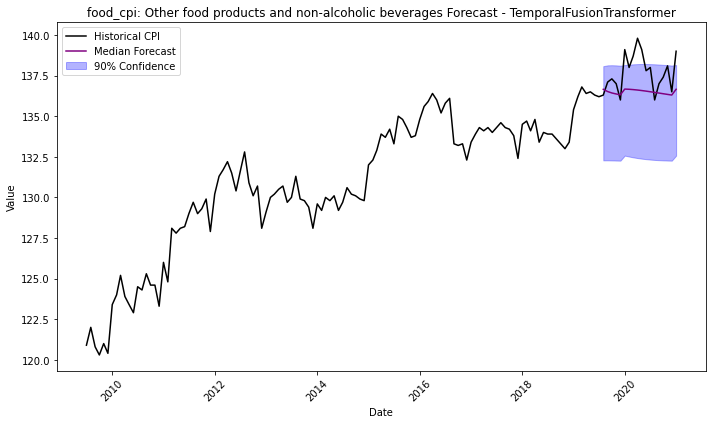

Beginning AutoGluon training... Time limit = 2s
AutoGluon will save models to './output/TEST/ag_global_all_TemporalFusionTransformerModel_exp2_GPT_P4_/random_seed_42/2019-07-01/model_files/'
=================== System Info ===================
AutoGluon Version:  1.1.1
Python Version:     3.8.20
Operating System:   Linux
Platform Machine:   x86_64
Platform Version:   #147~18.04.1-Ubuntu SMP Sat Oct 15 13:10:18 UTC 2022
CPU Count:          32
GPU Count:          1
Memory Avail:       166.73 GB / 188.57 GB (88.4%)
Disk Space Avail:   18208.69 GB / 249006.62 GB (7.3%)

Fitting with arguments:
{'enable_ensemble': True,
 'eval_metric': MAPE,
 'excluded_model_types': ['DirectTabular', 'RecursiveTabular'],
 'hyperparameters': {'TemporalFusionTransformerModel': {}},
 'known_covariates_names': [],
 'num_val_windows': 1,
 'prediction_length': 18,
 'quantile_levels': [0.01, 0.05, 0.1, 0.25, 0.75, 0.9, 0.95, 0.99],
 'random_seed': 42,
 'refit_every_n_windows': 1,
 'refit_full': False,
 'skip_model_

TemporalFusionTransformerModel


	-0.7104       = Validation score (-MAPE)
	2.11    s     = Training runtime
	0.04    s     = Validation (prediction) runtime
Not fitting ensemble due to lack of time remaining. Time left: -0.2 seconds
Training complete. Models trained: ['TemporalFusionTransformer']
Total runtime: 2.19 s
Best model: TemporalFusionTransformer
Best model score: -0.7104
Model not specified in predict, will default to the model with the best validation score: TemporalFusionTransformer
Model not specified in predict, will default to the model with the best validation score: TemporalFusionTransformer


****************** Summary of fit() ******************
Estimated performance of each model:
                       model  score_val  pred_time_val  fit_time_marginal  \
0  TemporalFusionTransformer  -0.710401       0.040332            2.10684   

   fit_order  
0          1  
Number of models trained: 1
Types of models trained:
{'MultiWindowBacktestingModel'}
****************** End of fit() summary ******************


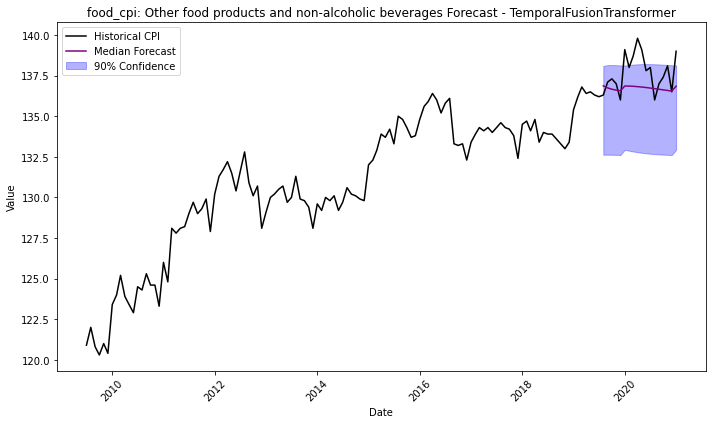

Beginning AutoGluon training... Time limit = 2s
AutoGluon will save models to './output/TEST/ag_global_all_TemporalFusionTransformerModel_exp2_R2_/random_seed_42/2019-07-01/model_files/'
=================== System Info ===================
AutoGluon Version:  1.1.1
Python Version:     3.8.20
Operating System:   Linux
Platform Machine:   x86_64
Platform Version:   #147~18.04.1-Ubuntu SMP Sat Oct 15 13:10:18 UTC 2022
CPU Count:          32
GPU Count:          1
Memory Avail:       166.73 GB / 188.57 GB (88.4%)
Disk Space Avail:   18208.68 GB / 249006.62 GB (7.3%)

Fitting with arguments:
{'enable_ensemble': True,
 'eval_metric': MAPE,
 'excluded_model_types': ['DirectTabular', 'RecursiveTabular'],
 'hyperparameters': {'TemporalFusionTransformerModel': {}},
 'known_covariates_names': [],
 'num_val_windows': 1,
 'prediction_length': 18,
 'quantile_levels': [0.01, 0.05, 0.1, 0.25, 0.75, 0.9, 0.95, 0.99],
 'random_seed': 42,
 'refit_every_n_windows': 1,
 'refit_full': False,
 'skip_model_sele

TemporalFusionTransformerModel


	-0.3746       = Validation score (-MAPE)
	2.12    s     = Training runtime
	0.04    s     = Validation (prediction) runtime
Not fitting ensemble due to lack of time remaining. Time left: -0.3 seconds
Training complete. Models trained: ['TemporalFusionTransformer']
Total runtime: 2.20 s
Best model: TemporalFusionTransformer
Best model score: -0.3746
Model not specified in predict, will default to the model with the best validation score: TemporalFusionTransformer


****************** Summary of fit() ******************
Estimated performance of each model:
                       model  score_val  pred_time_val  fit_time_marginal  \
0  TemporalFusionTransformer  -0.374592       0.041528           2.120463   

   fit_order  
0          1  
Number of models trained: 1
Types of models trained:
{'MultiWindowBacktestingModel'}
****************** End of fit() summary ******************


Model not specified in predict, will default to the model with the best validation score: TemporalFusionTransformer


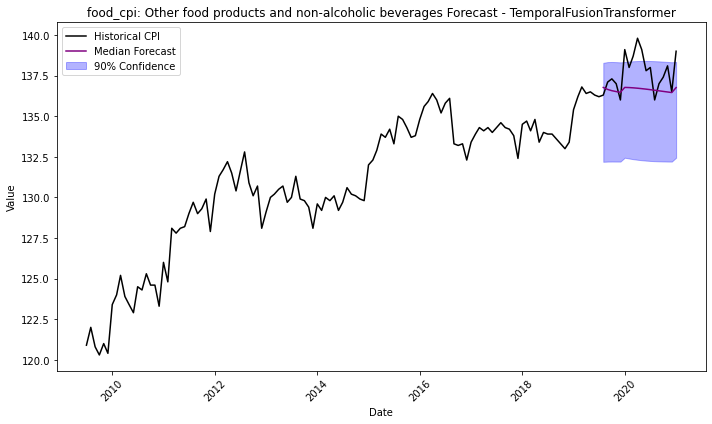

Beginning AutoGluon training... Time limit = 2s
AutoGluon will save models to './output/TEST/ag_global_all_TemporalFusionTransformerModel_exp2_GPT_P1_/random_seed_42/2019-07-01/model_files/'
=================== System Info ===================
AutoGluon Version:  1.1.1
Python Version:     3.8.20
Operating System:   Linux
Platform Machine:   x86_64
Platform Version:   #147~18.04.1-Ubuntu SMP Sat Oct 15 13:10:18 UTC 2022
CPU Count:          32
GPU Count:          1
Memory Avail:       166.73 GB / 188.57 GB (88.4%)
Disk Space Avail:   18208.72 GB / 249006.62 GB (7.3%)

Fitting with arguments:
{'enable_ensemble': True,
 'eval_metric': MAPE,
 'excluded_model_types': ['DirectTabular', 'RecursiveTabular'],
 'hyperparameters': {'TemporalFusionTransformerModel': {}},
 'known_covariates_names': [],
 'num_val_windows': 1,
 'prediction_length': 18,
 'quantile_levels': [0.01, 0.05, 0.1, 0.25, 0.75, 0.9, 0.95, 0.99],
 'random_seed': 42,
 'refit_every_n_windows': 1,
 'refit_full': False,
 'skip_model_

TemporalFusionTransformerModel


	-1.0659       = Validation score (-MAPE)
	2.16    s     = Training runtime
	0.04    s     = Validation (prediction) runtime
Not fitting ensemble due to lack of time remaining. Time left: -0.3 seconds
Training complete. Models trained: ['TemporalFusionTransformer']
Total runtime: 2.24 s
Best model: TemporalFusionTransformer
Best model score: -1.0659
Model not specified in predict, will default to the model with the best validation score: TemporalFusionTransformer
Model not specified in predict, will default to the model with the best validation score: TemporalFusionTransformer


****************** Summary of fit() ******************
Estimated performance of each model:
                       model  score_val  pred_time_val  fit_time_marginal  \
0  TemporalFusionTransformer  -1.065864       0.043341           2.158333   

   fit_order  
0          1  
Number of models trained: 1
Types of models trained:
{'MultiWindowBacktestingModel'}
****************** End of fit() summary ******************


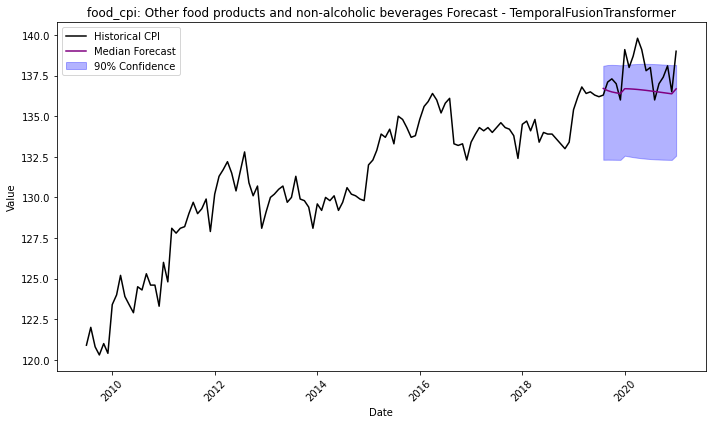

Beginning AutoGluon training... Time limit = 2s
AutoGluon will save models to './output/TEST/ag_global_all_TemporalFusionTransformerModel_exp2_R1_/random_seed_42/2019-07-01/model_files/'
=================== System Info ===================
AutoGluon Version:  1.1.1
Python Version:     3.8.20
Operating System:   Linux
Platform Machine:   x86_64
Platform Version:   #147~18.04.1-Ubuntu SMP Sat Oct 15 13:10:18 UTC 2022
CPU Count:          32
GPU Count:          1
Memory Avail:       166.73 GB / 188.57 GB (88.4%)
Disk Space Avail:   18208.71 GB / 249006.62 GB (7.3%)

Fitting with arguments:
{'enable_ensemble': True,
 'eval_metric': MAPE,
 'excluded_model_types': ['DirectTabular', 'RecursiveTabular'],
 'hyperparameters': {'TemporalFusionTransformerModel': {}},
 'known_covariates_names': [],
 'num_val_windows': 1,
 'prediction_length': 18,
 'quantile_levels': [0.01, 0.05, 0.1, 0.25, 0.75, 0.9, 0.95, 0.99],
 'random_seed': 42,
 'refit_every_n_windows': 1,
 'refit_full': False,
 'skip_model_sele

TemporalFusionTransformerModel


	-0.7906       = Validation score (-MAPE)
	2.13    s     = Training runtime
	0.04    s     = Validation (prediction) runtime
Not fitting ensemble due to lack of time remaining. Time left: -0.3 seconds
Training complete. Models trained: ['TemporalFusionTransformer']
Total runtime: 2.21 s
Best model: TemporalFusionTransformer
Best model score: -0.7906
Model not specified in predict, will default to the model with the best validation score: TemporalFusionTransformer
Model not specified in predict, will default to the model with the best validation score: TemporalFusionTransformer


****************** Summary of fit() ******************
Estimated performance of each model:
                       model  score_val  pred_time_val  fit_time_marginal  \
0  TemporalFusionTransformer  -0.790579       0.043895           2.128226   

   fit_order  
0          1  
Number of models trained: 1
Types of models trained:
{'MultiWindowBacktestingModel'}
****************** End of fit() summary ******************


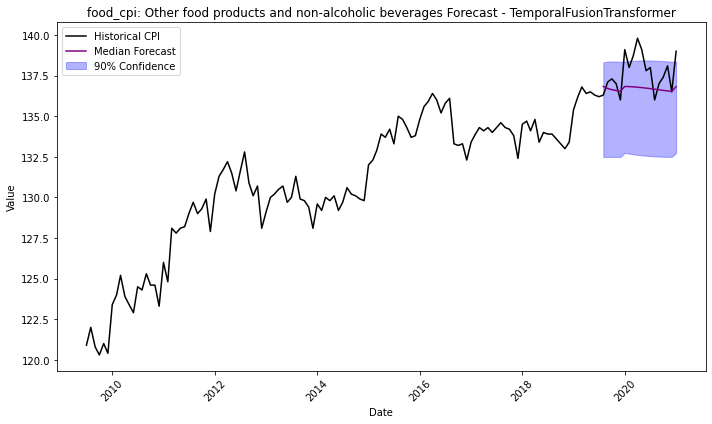

Beginning AutoGluon training... Time limit = 2s
AutoGluon will save models to './output/TEST/ag_global_all_TemporalFusionTransformerModel_exp2_GPT_P2_/random_seed_42/2019-07-01/model_files/'
=================== System Info ===================
AutoGluon Version:  1.1.1
Python Version:     3.8.20
Operating System:   Linux
Platform Machine:   x86_64
Platform Version:   #147~18.04.1-Ubuntu SMP Sat Oct 15 13:10:18 UTC 2022
CPU Count:          32
GPU Count:          1
Memory Avail:       166.73 GB / 188.57 GB (88.4%)
Disk Space Avail:   18208.71 GB / 249006.62 GB (7.3%)

Fitting with arguments:
{'enable_ensemble': True,
 'eval_metric': MAPE,
 'excluded_model_types': ['DirectTabular', 'RecursiveTabular'],
 'hyperparameters': {'TemporalFusionTransformerModel': {}},
 'known_covariates_names': [],
 'num_val_windows': 1,
 'prediction_length': 18,
 'quantile_levels': [0.01, 0.05, 0.1, 0.25, 0.75, 0.9, 0.95, 0.99],
 'random_seed': 42,
 'refit_every_n_windows': 1,
 'refit_full': False,
 'skip_model_

TemporalFusionTransformerModel


	-1.1719       = Validation score (-MAPE)
	2.11    s     = Training runtime
	0.04    s     = Validation (prediction) runtime
Not fitting ensemble due to lack of time remaining. Time left: -0.2 seconds
Training complete. Models trained: ['TemporalFusionTransformer']
Total runtime: 2.19 s
Best model: TemporalFusionTransformer
Best model score: -1.1719
Model not specified in predict, will default to the model with the best validation score: TemporalFusionTransformer
Model not specified in predict, will default to the model with the best validation score: TemporalFusionTransformer


****************** Summary of fit() ******************
Estimated performance of each model:
                       model  score_val  pred_time_val  fit_time_marginal  \
0  TemporalFusionTransformer  -1.171928       0.039025           2.114169   

   fit_order  
0          1  
Number of models trained: 1
Types of models trained:
{'MultiWindowBacktestingModel'}
****************** End of fit() summary ******************


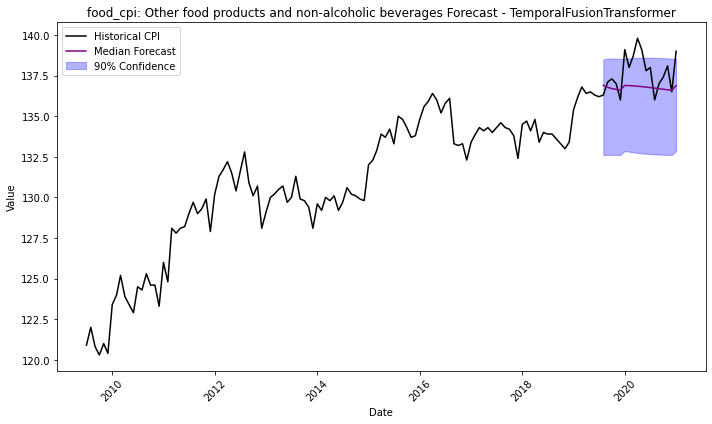

Beginning AutoGluon training... Time limit = 2s
AutoGluon will save models to './output/TEST/ag_global_all_TemporalFusionTransformerModel_exp2_R3_/random_seed_42/2020-07-01/model_files/'
=================== System Info ===================
AutoGluon Version:  1.1.1
Python Version:     3.8.20
Operating System:   Linux
Platform Machine:   x86_64
Platform Version:   #147~18.04.1-Ubuntu SMP Sat Oct 15 13:10:18 UTC 2022
CPU Count:          32
GPU Count:          1
Memory Avail:       166.88 GB / 188.57 GB (88.5%)
Disk Space Avail:   18207.58 GB / 249006.62 GB (7.3%)

Fitting with arguments:
{'enable_ensemble': True,
 'eval_metric': MAPE,
 'excluded_model_types': ['DirectTabular', 'RecursiveTabular'],
 'hyperparameters': {'TemporalFusionTransformerModel': {}},
 'known_covariates_names': [],
 'num_val_windows': 1,
 'prediction_length': 18,
 'quantile_levels': [0.01, 0.05, 0.1, 0.25, 0.75, 0.9, 0.95, 0.99],
 'random_seed': 42,
 'refit_every_n_windows': 1,
 'refit_full': False,
 'skip_model_sele

TemporalFusionTransformerModel


	-0.5871       = Validation score (-MAPE)
	2.06    s     = Training runtime
	0.04    s     = Validation (prediction) runtime
Not fitting ensemble due to lack of time remaining. Time left: -0.3 seconds
Training complete. Models trained: ['TemporalFusionTransformer']
Total runtime: 2.14 s
Best model: TemporalFusionTransformer
Best model score: -0.5871
Model not specified in predict, will default to the model with the best validation score: TemporalFusionTransformer
Model not specified in predict, will default to the model with the best validation score: TemporalFusionTransformer


****************** Summary of fit() ******************
Estimated performance of each model:
                       model  score_val  pred_time_val  fit_time_marginal  \
0  TemporalFusionTransformer  -0.587122       0.044759           2.058565   

   fit_order  
0          1  
Number of models trained: 1
Types of models trained:
{'MultiWindowBacktestingModel'}
****************** End of fit() summary ******************


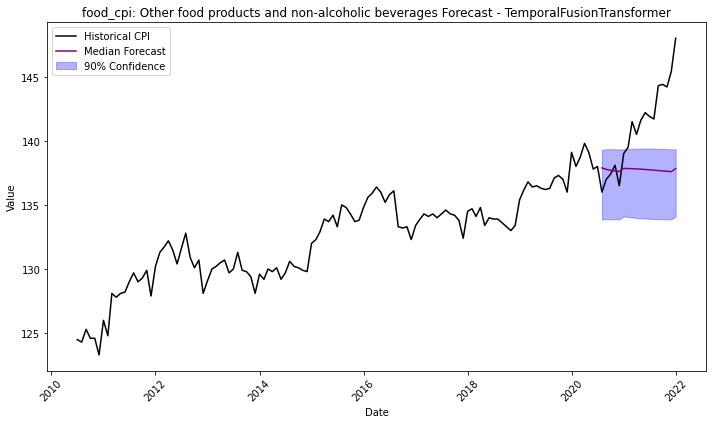

Beginning AutoGluon training... Time limit = 2s
AutoGluon will save models to './output/TEST/ag_global_all_TemporalFusionTransformerModel_exp2_GPT_P3_/random_seed_42/2020-07-01/model_files/'
=================== System Info ===================
AutoGluon Version:  1.1.1
Python Version:     3.8.20
Operating System:   Linux
Platform Machine:   x86_64
Platform Version:   #147~18.04.1-Ubuntu SMP Sat Oct 15 13:10:18 UTC 2022
CPU Count:          32
GPU Count:          1
Memory Avail:       166.72 GB / 188.57 GB (88.4%)
Disk Space Avail:   18207.57 GB / 249006.62 GB (7.3%)

Fitting with arguments:
{'enable_ensemble': True,
 'eval_metric': MAPE,
 'excluded_model_types': ['DirectTabular', 'RecursiveTabular'],
 'hyperparameters': {'TemporalFusionTransformerModel': {}},
 'known_covariates_names': [],
 'num_val_windows': 1,
 'prediction_length': 18,
 'quantile_levels': [0.01, 0.05, 0.1, 0.25, 0.75, 0.9, 0.95, 0.99],
 'random_seed': 42,
 'refit_every_n_windows': 1,
 'refit_full': False,
 'skip_model_

TemporalFusionTransformerModel


	-0.8465       = Validation score (-MAPE)
	2.13    s     = Training runtime
	0.04    s     = Validation (prediction) runtime
Not fitting ensemble due to lack of time remaining. Time left: -0.3 seconds
Training complete. Models trained: ['TemporalFusionTransformer']
Total runtime: 2.21 s
Best model: TemporalFusionTransformer
Best model score: -0.8465
Model not specified in predict, will default to the model with the best validation score: TemporalFusionTransformer
Model not specified in predict, will default to the model with the best validation score: TemporalFusionTransformer


****************** Summary of fit() ******************
Estimated performance of each model:
                       model  score_val  pred_time_val  fit_time_marginal  \
0  TemporalFusionTransformer  -0.846507        0.04318           2.133104   

   fit_order  
0          1  
Number of models trained: 1
Types of models trained:
{'MultiWindowBacktestingModel'}
****************** End of fit() summary ******************


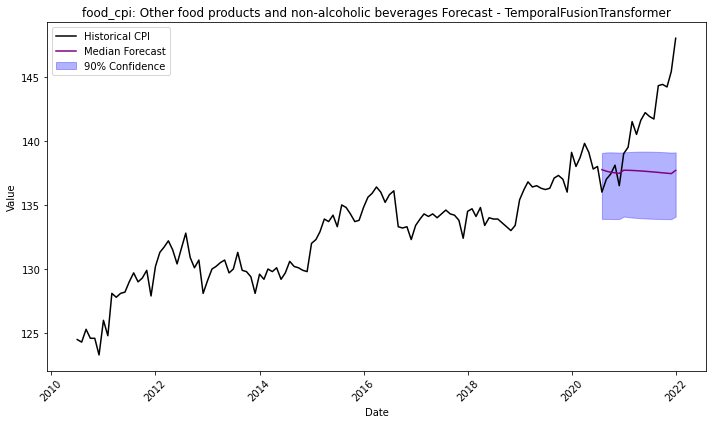

Beginning AutoGluon training... Time limit = 2s
AutoGluon will save models to './output/TEST/ag_global_all_TemporalFusionTransformerModel_exp2_R4_/random_seed_42/2020-07-01/model_files/'
=================== System Info ===================
AutoGluon Version:  1.1.1
Python Version:     3.8.20
Operating System:   Linux
Platform Machine:   x86_64
Platform Version:   #147~18.04.1-Ubuntu SMP Sat Oct 15 13:10:18 UTC 2022
CPU Count:          32
GPU Count:          1
Memory Avail:       166.75 GB / 188.57 GB (88.4%)
Disk Space Avail:   18207.56 GB / 249006.62 GB (7.3%)

Fitting with arguments:
{'enable_ensemble': True,
 'eval_metric': MAPE,
 'excluded_model_types': ['DirectTabular', 'RecursiveTabular'],
 'hyperparameters': {'TemporalFusionTransformerModel': {}},
 'known_covariates_names': [],
 'num_val_windows': 1,
 'prediction_length': 18,
 'quantile_levels': [0.01, 0.05, 0.1, 0.25, 0.75, 0.9, 0.95, 0.99],
 'random_seed': 42,
 'refit_every_n_windows': 1,
 'refit_full': False,
 'skip_model_sele

TemporalFusionTransformerModel


Inferred time series frequency: 'MS'
Provided train_data has 9130 rows, 22 time series. Median time series length is 415 (min=415, max=415). 

Provided data contains following columns:
	target: 'target'

AutoGluon will gauge predictive performance using evaluation metric: 'MAPE'
	This metric's sign has been flipped to adhere to being higher_is_better. The metric score can be multiplied by -1 to get the metric value.

Starting training. Start time is 2024-10-27 07:45:36
Excluded model types: ['DirectTabular', 'RecursiveTabular']
Models that will be trained: ['TemporalFusionTransformer']
Training timeseries model TemporalFusionTransformer. Training for up to 1.6s of the 1.6s of remaining time.
	-0.5015       = Validation score (-MAPE)
	1.86    s     = Training runtime
	0.04    s     = Validation (prediction) runtime
Not fitting ensemble due to lack of time remaining. Time left: -0.3 seconds
Training complete. Models trained: ['TemporalFusionTransformer']
Total runtime: 1.95 s
Best model:

****************** Summary of fit() ******************
Estimated performance of each model:
                       model  score_val  pred_time_val  fit_time_marginal  \
0  TemporalFusionTransformer  -0.501493        0.04252           1.857294   

   fit_order  
0          1  
Number of models trained: 1
Types of models trained:
{'MultiWindowBacktestingModel'}
****************** End of fit() summary ******************


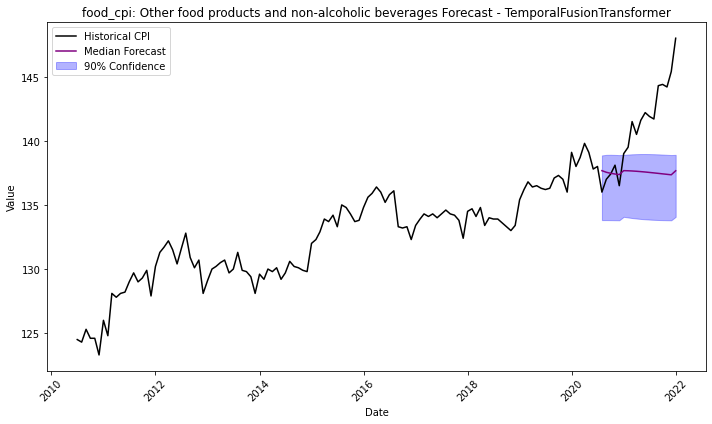

Beginning AutoGluon training... Time limit = 2s
AutoGluon will save models to './output/TEST/ag_global_all_TemporalFusionTransformerModel_exp2_GPT_P4_/random_seed_42/2020-07-01/model_files/'
=================== System Info ===================
AutoGluon Version:  1.1.1
Python Version:     3.8.20
Operating System:   Linux
Platform Machine:   x86_64
Platform Version:   #147~18.04.1-Ubuntu SMP Sat Oct 15 13:10:18 UTC 2022
CPU Count:          32
GPU Count:          1
Memory Avail:       166.73 GB / 188.57 GB (88.4%)
Disk Space Avail:   18207.55 GB / 249006.62 GB (7.3%)

Fitting with arguments:
{'enable_ensemble': True,
 'eval_metric': MAPE,
 'excluded_model_types': ['DirectTabular', 'RecursiveTabular'],
 'hyperparameters': {'TemporalFusionTransformerModel': {}},
 'known_covariates_names': [],
 'num_val_windows': 1,
 'prediction_length': 18,
 'quantile_levels': [0.01, 0.05, 0.1, 0.25, 0.75, 0.9, 0.95, 0.99],
 'random_seed': 42,
 'refit_every_n_windows': 1,
 'refit_full': False,
 'skip_model_

TemporalFusionTransformerModel


	-0.6725       = Validation score (-MAPE)
	2.13    s     = Training runtime
	0.04    s     = Validation (prediction) runtime
Not fitting ensemble due to lack of time remaining. Time left: -0.3 seconds
Training complete. Models trained: ['TemporalFusionTransformer']
Total runtime: 2.20 s
Best model: TemporalFusionTransformer
Best model score: -0.6725
Model not specified in predict, will default to the model with the best validation score: TemporalFusionTransformer
Model not specified in predict, will default to the model with the best validation score: TemporalFusionTransformer


****************** Summary of fit() ******************
Estimated performance of each model:
                       model  score_val  pred_time_val  fit_time_marginal  \
0  TemporalFusionTransformer  -0.672473       0.039691           2.126789   

   fit_order  
0          1  
Number of models trained: 1
Types of models trained:
{'MultiWindowBacktestingModel'}
****************** End of fit() summary ******************


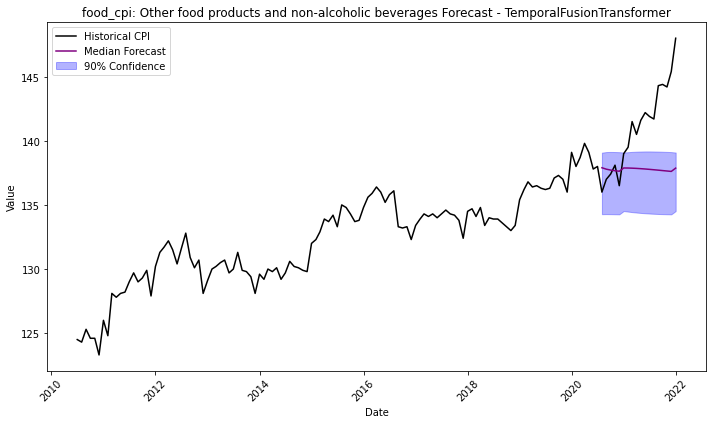

Beginning AutoGluon training... Time limit = 2s
AutoGluon will save models to './output/TEST/ag_global_all_TemporalFusionTransformerModel_exp2_R2_/random_seed_42/2020-07-01/model_files/'
=================== System Info ===================
AutoGluon Version:  1.1.1
Python Version:     3.8.20
Operating System:   Linux
Platform Machine:   x86_64
Platform Version:   #147~18.04.1-Ubuntu SMP Sat Oct 15 13:10:18 UTC 2022
CPU Count:          32
GPU Count:          1
Memory Avail:       166.73 GB / 188.57 GB (88.4%)
Disk Space Avail:   18207.55 GB / 249006.62 GB (7.3%)

Fitting with arguments:
{'enable_ensemble': True,
 'eval_metric': MAPE,
 'excluded_model_types': ['DirectTabular', 'RecursiveTabular'],
 'hyperparameters': {'TemporalFusionTransformerModel': {}},
 'known_covariates_names': [],
 'num_val_windows': 1,
 'prediction_length': 18,
 'quantile_levels': [0.01, 0.05, 0.1, 0.25, 0.75, 0.9, 0.95, 0.99],
 'random_seed': 42,
 'refit_every_n_windows': 1,
 'refit_full': False,
 'skip_model_sele

TemporalFusionTransformerModel


	-0.3753       = Validation score (-MAPE)
	2.13    s     = Training runtime
	0.05    s     = Validation (prediction) runtime
Not fitting ensemble due to lack of time remaining. Time left: -0.3 seconds
Training complete. Models trained: ['TemporalFusionTransformer']
Total runtime: 2.21 s
Best model: TemporalFusionTransformer
Best model score: -0.3753
Model not specified in predict, will default to the model with the best validation score: TemporalFusionTransformer
Model not specified in predict, will default to the model with the best validation score: TemporalFusionTransformer


****************** Summary of fit() ******************
Estimated performance of each model:
                       model  score_val  pred_time_val  fit_time_marginal  \
0  TemporalFusionTransformer  -0.375285       0.045211           2.131176   

   fit_order  
0          1  
Number of models trained: 1
Types of models trained:
{'MultiWindowBacktestingModel'}
****************** End of fit() summary ******************


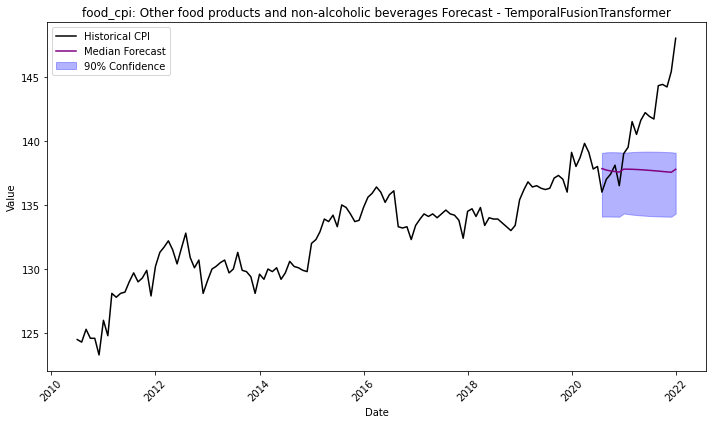

Beginning AutoGluon training... Time limit = 2s
AutoGluon will save models to './output/TEST/ag_global_all_TemporalFusionTransformerModel_exp2_GPT_P1_/random_seed_42/2020-07-01/model_files/'
=================== System Info ===================
AutoGluon Version:  1.1.1
Python Version:     3.8.20
Operating System:   Linux
Platform Machine:   x86_64
Platform Version:   #147~18.04.1-Ubuntu SMP Sat Oct 15 13:10:18 UTC 2022
CPU Count:          32
GPU Count:          1
Memory Avail:       166.73 GB / 188.57 GB (88.4%)
Disk Space Avail:   18207.54 GB / 249006.62 GB (7.3%)

Fitting with arguments:
{'enable_ensemble': True,
 'eval_metric': MAPE,
 'excluded_model_types': ['DirectTabular', 'RecursiveTabular'],
 'hyperparameters': {'TemporalFusionTransformerModel': {}},
 'known_covariates_names': [],
 'num_val_windows': 1,
 'prediction_length': 18,
 'quantile_levels': [0.01, 0.05, 0.1, 0.25, 0.75, 0.9, 0.95, 0.99],
 'random_seed': 42,
 'refit_every_n_windows': 1,
 'refit_full': False,
 'skip_model_

TemporalFusionTransformerModel


	-0.8165       = Validation score (-MAPE)
	2.13    s     = Training runtime
	0.05    s     = Validation (prediction) runtime
Not fitting ensemble due to lack of time remaining. Time left: -0.3 seconds
Training complete. Models trained: ['TemporalFusionTransformer']
Total runtime: 2.21 s
Best model: TemporalFusionTransformer
Best model score: -0.8165
Model not specified in predict, will default to the model with the best validation score: TemporalFusionTransformer
Model not specified in predict, will default to the model with the best validation score: TemporalFusionTransformer


****************** Summary of fit() ******************
Estimated performance of each model:
                       model  score_val  pred_time_val  fit_time_marginal  \
0  TemporalFusionTransformer  -0.816535       0.045011           2.125349   

   fit_order  
0          1  
Number of models trained: 1
Types of models trained:
{'MultiWindowBacktestingModel'}
****************** End of fit() summary ******************


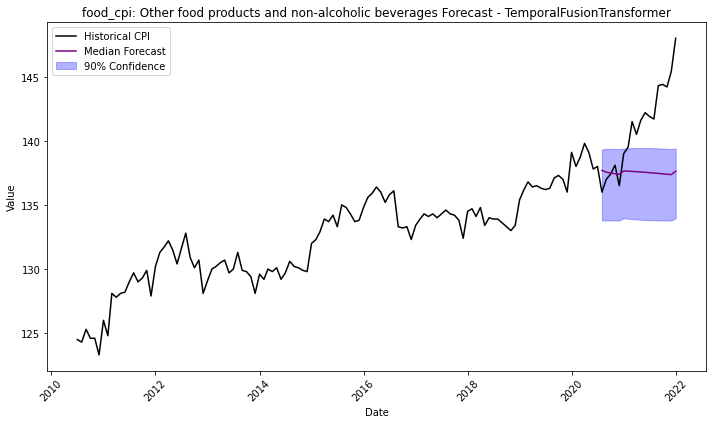

Beginning AutoGluon training... Time limit = 2s
AutoGluon will save models to './output/TEST/ag_global_all_TemporalFusionTransformerModel_exp2_R1_/random_seed_42/2020-07-01/model_files/'
=================== System Info ===================
AutoGluon Version:  1.1.1
Python Version:     3.8.20
Operating System:   Linux
Platform Machine:   x86_64
Platform Version:   #147~18.04.1-Ubuntu SMP Sat Oct 15 13:10:18 UTC 2022
CPU Count:          32
GPU Count:          1
Memory Avail:       166.87 GB / 188.57 GB (88.5%)
Disk Space Avail:   18207.59 GB / 249006.62 GB (7.3%)

Fitting with arguments:
{'enable_ensemble': True,
 'eval_metric': MAPE,
 'excluded_model_types': ['DirectTabular', 'RecursiveTabular'],
 'hyperparameters': {'TemporalFusionTransformerModel': {}},
 'known_covariates_names': [],
 'num_val_windows': 1,
 'prediction_length': 18,
 'quantile_levels': [0.01, 0.05, 0.1, 0.25, 0.75, 0.9, 0.95, 0.99],
 'random_seed': 42,
 'refit_every_n_windows': 1,
 'refit_full': False,
 'skip_model_sele

TemporalFusionTransformerModel


	-2.5992       = Validation score (-MAPE)
	2.11    s     = Training runtime
	0.04    s     = Validation (prediction) runtime
Not fitting ensemble due to lack of time remaining. Time left: -0.3 seconds
Training complete. Models trained: ['TemporalFusionTransformer']
Total runtime: 2.20 s
Best model: TemporalFusionTransformer
Best model score: -2.5992
Model not specified in predict, will default to the model with the best validation score: TemporalFusionTransformer
Model not specified in predict, will default to the model with the best validation score: TemporalFusionTransformer


****************** Summary of fit() ******************
Estimated performance of each model:
                       model  score_val  pred_time_val  fit_time_marginal  \
0  TemporalFusionTransformer  -2.599231       0.042347           2.114907   

   fit_order  
0          1  
Number of models trained: 1
Types of models trained:
{'MultiWindowBacktestingModel'}
****************** End of fit() summary ******************


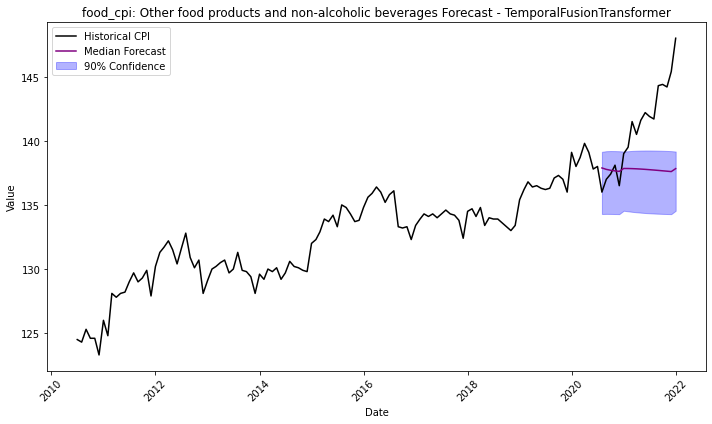

Beginning AutoGluon training... Time limit = 2s
AutoGluon will save models to './output/TEST/ag_global_all_TemporalFusionTransformerModel_exp2_GPT_P2_/random_seed_42/2020-07-01/model_files/'
=================== System Info ===================
AutoGluon Version:  1.1.1
Python Version:     3.8.20
Operating System:   Linux
Platform Machine:   x86_64
Platform Version:   #147~18.04.1-Ubuntu SMP Sat Oct 15 13:10:18 UTC 2022
CPU Count:          32
GPU Count:          1
Memory Avail:       166.73 GB / 188.57 GB (88.4%)
Disk Space Avail:   18207.58 GB / 249006.62 GB (7.3%)

Fitting with arguments:
{'enable_ensemble': True,
 'eval_metric': MAPE,
 'excluded_model_types': ['DirectTabular', 'RecursiveTabular'],
 'hyperparameters': {'TemporalFusionTransformerModel': {}},
 'known_covariates_names': [],
 'num_val_windows': 1,
 'prediction_length': 18,
 'quantile_levels': [0.01, 0.05, 0.1, 0.25, 0.75, 0.9, 0.95, 0.99],
 'random_seed': 42,
 'refit_every_n_windows': 1,
 'refit_full': False,
 'skip_model_

TemporalFusionTransformerModel


	-0.9409       = Validation score (-MAPE)
	2.11    s     = Training runtime
	0.04    s     = Validation (prediction) runtime
Not fitting ensemble due to lack of time remaining. Time left: -0.2 seconds
Training complete. Models trained: ['TemporalFusionTransformer']
Total runtime: 2.19 s
Best model: TemporalFusionTransformer
Best model score: -0.9409


****************** Summary of fit() ******************
Estimated performance of each model:
                       model  score_val  pred_time_val  fit_time_marginal  \
0  TemporalFusionTransformer  -0.940927       0.039884           2.108874   

   fit_order  
0          1  
Number of models trained: 1
Types of models trained:
{'MultiWindowBacktestingModel'}
****************** End of fit() summary ******************


Model not specified in predict, will default to the model with the best validation score: TemporalFusionTransformer
Model not specified in predict, will default to the model with the best validation score: TemporalFusionTransformer


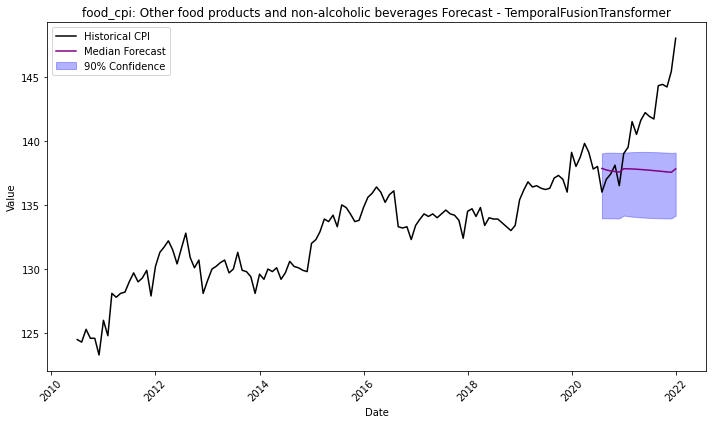

Beginning AutoGluon training... Time limit = 2s
AutoGluon will save models to './output/TEST/ag_global_all_TemporalFusionTransformerModel_exp2_R3_/random_seed_42/2021-07-01/model_files/'
=================== System Info ===================
AutoGluon Version:  1.1.1
Python Version:     3.8.20
Operating System:   Linux
Platform Machine:   x86_64
Platform Version:   #147~18.04.1-Ubuntu SMP Sat Oct 15 13:10:18 UTC 2022
CPU Count:          32
GPU Count:          1
Memory Avail:       166.73 GB / 188.57 GB (88.4%)
Disk Space Avail:   18207.57 GB / 249006.62 GB (7.3%)

Fitting with arguments:
{'enable_ensemble': True,
 'eval_metric': MAPE,
 'excluded_model_types': ['DirectTabular', 'RecursiveTabular'],
 'hyperparameters': {'TemporalFusionTransformerModel': {}},
 'known_covariates_names': [],
 'num_val_windows': 1,
 'prediction_length': 18,
 'quantile_levels': [0.01, 0.05, 0.1, 0.25, 0.75, 0.9, 0.95, 0.99],
 'random_seed': 42,
 'refit_every_n_windows': 1,
 'refit_full': False,
 'skip_model_sele

TemporalFusionTransformerModel


	-0.7122       = Validation score (-MAPE)
	2.15    s     = Training runtime
	0.04    s     = Validation (prediction) runtime
Not fitting ensemble due to lack of time remaining. Time left: -0.3 seconds
Training complete. Models trained: ['TemporalFusionTransformer']
Total runtime: 2.23 s
Best model: TemporalFusionTransformer
Best model score: -0.7122
Model not specified in predict, will default to the model with the best validation score: TemporalFusionTransformer
Model not specified in predict, will default to the model with the best validation score: TemporalFusionTransformer


****************** Summary of fit() ******************
Estimated performance of each model:
                       model  score_val  pred_time_val  fit_time_marginal  \
0  TemporalFusionTransformer  -0.712157        0.04487           2.153362   

   fit_order  
0          1  
Number of models trained: 1
Types of models trained:
{'MultiWindowBacktestingModel'}
****************** End of fit() summary ******************


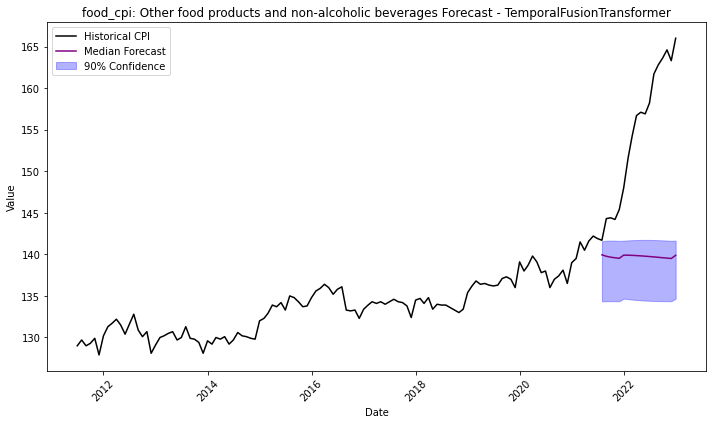

Beginning AutoGluon training... Time limit = 2s
AutoGluon will save models to './output/TEST/ag_global_all_TemporalFusionTransformerModel_exp2_GPT_P3_/random_seed_42/2021-07-01/model_files/'
=================== System Info ===================
AutoGluon Version:  1.1.1
Python Version:     3.8.20
Operating System:   Linux
Platform Machine:   x86_64
Platform Version:   #147~18.04.1-Ubuntu SMP Sat Oct 15 13:10:18 UTC 2022
CPU Count:          32
GPU Count:          1
Memory Avail:       166.73 GB / 188.57 GB (88.4%)
Disk Space Avail:   18207.56 GB / 249006.62 GB (7.3%)

Fitting with arguments:
{'enable_ensemble': True,
 'eval_metric': MAPE,
 'excluded_model_types': ['DirectTabular', 'RecursiveTabular'],
 'hyperparameters': {'TemporalFusionTransformerModel': {}},
 'known_covariates_names': [],
 'num_val_windows': 1,
 'prediction_length': 18,
 'quantile_levels': [0.01, 0.05, 0.1, 0.25, 0.75, 0.9, 0.95, 0.99],
 'random_seed': 42,
 'refit_every_n_windows': 1,
 'refit_full': False,
 'skip_model_

TemporalFusionTransformerModel


	-1.1414       = Validation score (-MAPE)
	2.13    s     = Training runtime
	0.04    s     = Validation (prediction) runtime
Not fitting ensemble due to lack of time remaining. Time left: -0.3 seconds
Training complete. Models trained: ['TemporalFusionTransformer']
Total runtime: 2.22 s
Best model: TemporalFusionTransformer
Best model score: -1.1414
Model not specified in predict, will default to the model with the best validation score: TemporalFusionTransformer
Model not specified in predict, will default to the model with the best validation score: TemporalFusionTransformer


****************** Summary of fit() ******************
Estimated performance of each model:
                       model  score_val  pred_time_val  fit_time_marginal  \
0  TemporalFusionTransformer  -1.141449       0.042136           2.129285   

   fit_order  
0          1  
Number of models trained: 1
Types of models trained:
{'MultiWindowBacktestingModel'}
****************** End of fit() summary ******************


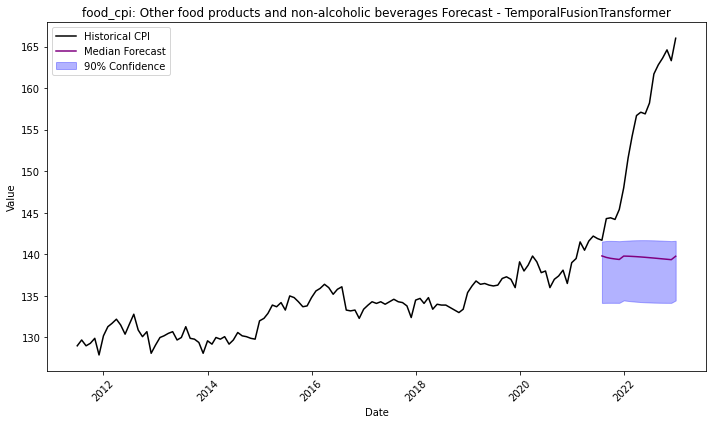

Beginning AutoGluon training... Time limit = 2s
AutoGluon will save models to './output/TEST/ag_global_all_TemporalFusionTransformerModel_exp2_R4_/random_seed_42/2021-07-01/model_files/'
=================== System Info ===================
AutoGluon Version:  1.1.1
Python Version:     3.8.20
Operating System:   Linux
Platform Machine:   x86_64
Platform Version:   #147~18.04.1-Ubuntu SMP Sat Oct 15 13:10:18 UTC 2022
CPU Count:          32
GPU Count:          1
Memory Avail:       166.73 GB / 188.57 GB (88.4%)
Disk Space Avail:   18207.55 GB / 249006.62 GB (7.3%)

Fitting with arguments:
{'enable_ensemble': True,
 'eval_metric': MAPE,
 'excluded_model_types': ['DirectTabular', 'RecursiveTabular'],
 'hyperparameters': {'TemporalFusionTransformerModel': {}},
 'known_covariates_names': [],
 'num_val_windows': 1,
 'prediction_length': 18,
 'quantile_levels': [0.01, 0.05, 0.1, 0.25, 0.75, 0.9, 0.95, 0.99],
 'random_seed': 42,
 'refit_every_n_windows': 1,
 'refit_full': False,
 'skip_model_sele

TemporalFusionTransformerModel


	-0.7055       = Validation score (-MAPE)
	2.13    s     = Training runtime
	0.05    s     = Validation (prediction) runtime
Not fitting ensemble due to lack of time remaining. Time left: -0.3 seconds
Training complete. Models trained: ['TemporalFusionTransformer']
Total runtime: 2.22 s
Best model: TemporalFusionTransformer
Best model score: -0.7055
Model not specified in predict, will default to the model with the best validation score: TemporalFusionTransformer
Model not specified in predict, will default to the model with the best validation score: TemporalFusionTransformer


****************** Summary of fit() ******************
Estimated performance of each model:
                       model  score_val  pred_time_val  fit_time_marginal  \
0  TemporalFusionTransformer  -0.705455       0.045132           2.133401   

   fit_order  
0          1  
Number of models trained: 1
Types of models trained:
{'MultiWindowBacktestingModel'}
****************** End of fit() summary ******************


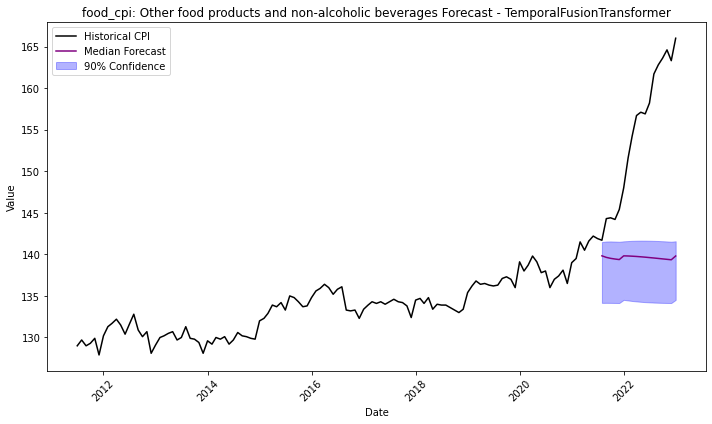

Beginning AutoGluon training... Time limit = 2s
AutoGluon will save models to './output/TEST/ag_global_all_TemporalFusionTransformerModel_exp2_GPT_P4_/random_seed_42/2021-07-01/model_files/'
=================== System Info ===================
AutoGluon Version:  1.1.1
Python Version:     3.8.20
Operating System:   Linux
Platform Machine:   x86_64
Platform Version:   #147~18.04.1-Ubuntu SMP Sat Oct 15 13:10:18 UTC 2022
CPU Count:          32
GPU Count:          1
Memory Avail:       166.83 GB / 188.57 GB (88.5%)
Disk Space Avail:   18207.54 GB / 249006.62 GB (7.3%)

Fitting with arguments:
{'enable_ensemble': True,
 'eval_metric': MAPE,
 'excluded_model_types': ['DirectTabular', 'RecursiveTabular'],
 'hyperparameters': {'TemporalFusionTransformerModel': {}},
 'known_covariates_names': [],
 'num_val_windows': 1,
 'prediction_length': 18,
 'quantile_levels': [0.01, 0.05, 0.1, 0.25, 0.75, 0.9, 0.95, 0.99],
 'random_seed': 42,
 'refit_every_n_windows': 1,
 'refit_full': False,
 'skip_model_

TemporalFusionTransformerModel


	-0.8874       = Validation score (-MAPE)
	2.13    s     = Training runtime
	0.04    s     = Validation (prediction) runtime
Not fitting ensemble due to lack of time remaining. Time left: -0.3 seconds
Training complete. Models trained: ['TemporalFusionTransformer']
Total runtime: 2.21 s
Best model: TemporalFusionTransformer
Best model score: -0.8874
Model not specified in predict, will default to the model with the best validation score: TemporalFusionTransformer
Model not specified in predict, will default to the model with the best validation score: TemporalFusionTransformer


****************** Summary of fit() ******************
Estimated performance of each model:
                       model  score_val  pred_time_val  fit_time_marginal  \
0  TemporalFusionTransformer  -0.887397       0.037989           2.126901   

   fit_order  
0          1  
Number of models trained: 1
Types of models trained:
{'MultiWindowBacktestingModel'}
****************** End of fit() summary ******************


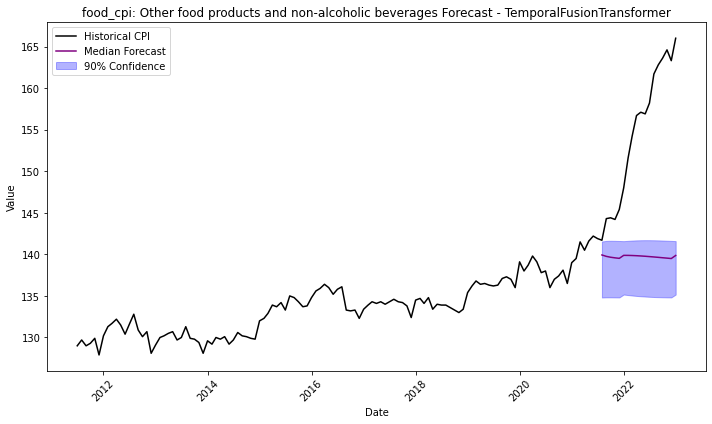

Beginning AutoGluon training... Time limit = 2s
AutoGluon will save models to './output/TEST/ag_global_all_TemporalFusionTransformerModel_exp2_R2_/random_seed_42/2021-07-01/model_files/'
=================== System Info ===================
AutoGluon Version:  1.1.1
Python Version:     3.8.20
Operating System:   Linux
Platform Machine:   x86_64
Platform Version:   #147~18.04.1-Ubuntu SMP Sat Oct 15 13:10:18 UTC 2022
CPU Count:          32
GPU Count:          1
Memory Avail:       166.72 GB / 188.57 GB (88.4%)
Disk Space Avail:   18207.59 GB / 249006.62 GB (7.3%)

Fitting with arguments:
{'enable_ensemble': True,
 'eval_metric': MAPE,
 'excluded_model_types': ['DirectTabular', 'RecursiveTabular'],
 'hyperparameters': {'TemporalFusionTransformerModel': {}},
 'known_covariates_names': [],
 'num_val_windows': 1,
 'prediction_length': 18,
 'quantile_levels': [0.01, 0.05, 0.1, 0.25, 0.75, 0.9, 0.95, 0.99],
 'random_seed': 42,
 'refit_every_n_windows': 1,
 'refit_full': False,
 'skip_model_sele

TemporalFusionTransformerModel


	-0.5359       = Validation score (-MAPE)
	2.17    s     = Training runtime
	0.04    s     = Validation (prediction) runtime
Not fitting ensemble due to lack of time remaining. Time left: -0.3 seconds
Training complete. Models trained: ['TemporalFusionTransformer']
Total runtime: 2.25 s
Best model: TemporalFusionTransformer
Best model score: -0.5359
Model not specified in predict, will default to the model with the best validation score: TemporalFusionTransformer
Model not specified in predict, will default to the model with the best validation score: TemporalFusionTransformer


****************** Summary of fit() ******************
Estimated performance of each model:
                       model  score_val  pred_time_val  fit_time_marginal  \
0  TemporalFusionTransformer  -0.535884       0.042367           2.166229   

   fit_order  
0          1  
Number of models trained: 1
Types of models trained:
{'MultiWindowBacktestingModel'}
****************** End of fit() summary ******************


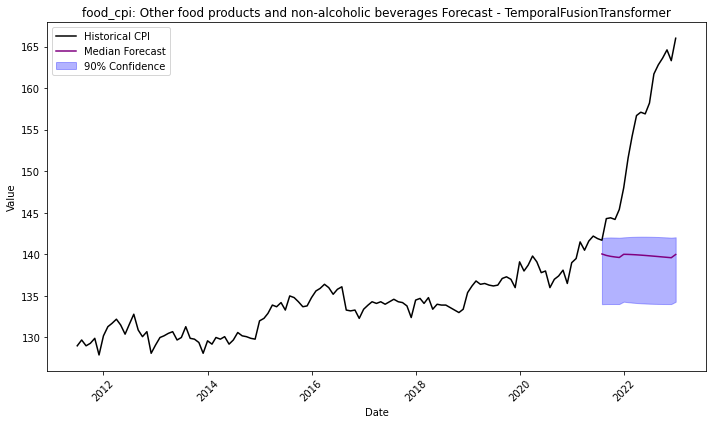

Beginning AutoGluon training... Time limit = 2s
AutoGluon will save models to './output/TEST/ag_global_all_TemporalFusionTransformerModel_exp2_GPT_P1_/random_seed_42/2021-07-01/model_files/'
=================== System Info ===================
AutoGluon Version:  1.1.1
Python Version:     3.8.20
Operating System:   Linux
Platform Machine:   x86_64
Platform Version:   #147~18.04.1-Ubuntu SMP Sat Oct 15 13:10:18 UTC 2022
CPU Count:          32
GPU Count:          1
Memory Avail:       166.72 GB / 188.57 GB (88.4%)
Disk Space Avail:   18207.58 GB / 249006.62 GB (7.3%)

Fitting with arguments:
{'enable_ensemble': True,
 'eval_metric': MAPE,
 'excluded_model_types': ['DirectTabular', 'RecursiveTabular'],
 'hyperparameters': {'TemporalFusionTransformerModel': {}},
 'known_covariates_names': [],
 'num_val_windows': 1,
 'prediction_length': 18,
 'quantile_levels': [0.01, 0.05, 0.1, 0.25, 0.75, 0.9, 0.95, 0.99],
 'random_seed': 42,
 'refit_every_n_windows': 1,
 'refit_full': False,
 'skip_model_

TemporalFusionTransformerModel


Inferred time series frequency: 'MS'
Provided train_data has 9394 rows, 22 time series. Median time series length is 427 (min=427, max=427). 

Provided data contains following columns:
	target: 'target'

AutoGluon will gauge predictive performance using evaluation metric: 'MAPE'
	This metric's sign has been flipped to adhere to being higher_is_better. The metric score can be multiplied by -1 to get the metric value.

Starting training. Start time is 2024-10-27 07:46:07
Excluded model types: ['DirectTabular', 'RecursiveTabular']
Models that will be trained: ['TemporalFusionTransformer']
Training timeseries model TemporalFusionTransformer. Training for up to 1.6s of the 1.6s of remaining time.
	-1.0589       = Validation score (-MAPE)
	1.82    s     = Training runtime
	0.05    s     = Validation (prediction) runtime
Not fitting ensemble due to lack of time remaining. Time left: -0.3 seconds
Training complete. Models trained: ['TemporalFusionTransformer']
Total runtime: 1.91 s
Best model:

****************** Summary of fit() ******************
Estimated performance of each model:
                       model  score_val  pred_time_val  fit_time_marginal  \
0  TemporalFusionTransformer  -1.058939       0.046226           1.821585   

   fit_order  
0          1  
Number of models trained: 1
Types of models trained:
{'MultiWindowBacktestingModel'}
****************** End of fit() summary ******************


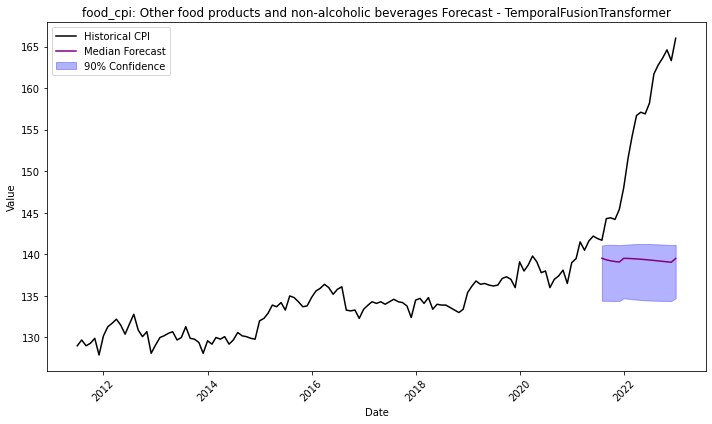

Beginning AutoGluon training... Time limit = 2s
AutoGluon will save models to './output/TEST/ag_global_all_TemporalFusionTransformerModel_exp2_R1_/random_seed_42/2021-07-01/model_files/'
=================== System Info ===================
AutoGluon Version:  1.1.1
Python Version:     3.8.20
Operating System:   Linux
Platform Machine:   x86_64
Platform Version:   #147~18.04.1-Ubuntu SMP Sat Oct 15 13:10:18 UTC 2022
CPU Count:          32
GPU Count:          1
Memory Avail:       166.73 GB / 188.57 GB (88.4%)
Disk Space Avail:   18207.57 GB / 249006.62 GB (7.3%)

Fitting with arguments:
{'enable_ensemble': True,
 'eval_metric': MAPE,
 'excluded_model_types': ['DirectTabular', 'RecursiveTabular'],
 'hyperparameters': {'TemporalFusionTransformerModel': {}},
 'known_covariates_names': [],
 'num_val_windows': 1,
 'prediction_length': 18,
 'quantile_levels': [0.01, 0.05, 0.1, 0.25, 0.75, 0.9, 0.95, 0.99],
 'random_seed': 42,
 'refit_every_n_windows': 1,
 'refit_full': False,
 'skip_model_sele

TemporalFusionTransformerModel


	-1.0379       = Validation score (-MAPE)
	2.13    s     = Training runtime
	0.04    s     = Validation (prediction) runtime
Not fitting ensemble due to lack of time remaining. Time left: -0.3 seconds
Training complete. Models trained: ['TemporalFusionTransformer']
Total runtime: 2.21 s
Best model: TemporalFusionTransformer
Best model score: -1.0379
Model not specified in predict, will default to the model with the best validation score: TemporalFusionTransformer
Model not specified in predict, will default to the model with the best validation score: TemporalFusionTransformer


****************** Summary of fit() ******************
Estimated performance of each model:
                       model  score_val  pred_time_val  fit_time_marginal  \
0  TemporalFusionTransformer  -1.037927       0.044543           2.127156   

   fit_order  
0          1  
Number of models trained: 1
Types of models trained:
{'MultiWindowBacktestingModel'}
****************** End of fit() summary ******************


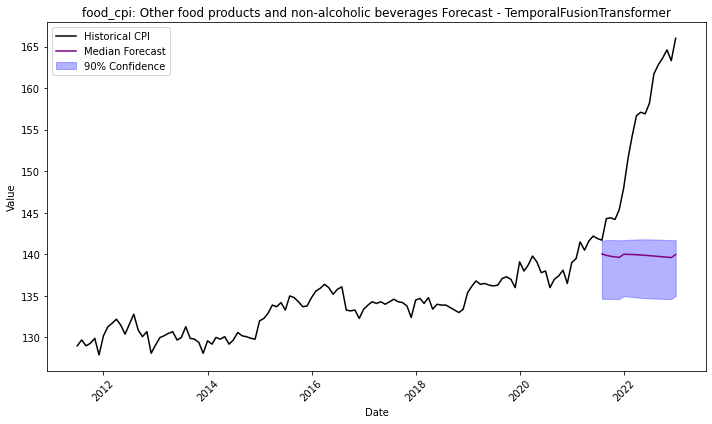

Beginning AutoGluon training... Time limit = 2s
AutoGluon will save models to './output/TEST/ag_global_all_TemporalFusionTransformerModel_exp2_GPT_P2_/random_seed_42/2021-07-01/model_files/'
=================== System Info ===================
AutoGluon Version:  1.1.1
Python Version:     3.8.20
Operating System:   Linux
Platform Machine:   x86_64
Platform Version:   #147~18.04.1-Ubuntu SMP Sat Oct 15 13:10:18 UTC 2022
CPU Count:          32
GPU Count:          1
Memory Avail:       166.72 GB / 188.57 GB (88.4%)
Disk Space Avail:   18207.56 GB / 249006.62 GB (7.3%)

Fitting with arguments:
{'enable_ensemble': True,
 'eval_metric': MAPE,
 'excluded_model_types': ['DirectTabular', 'RecursiveTabular'],
 'hyperparameters': {'TemporalFusionTransformerModel': {}},
 'known_covariates_names': [],
 'num_val_windows': 1,
 'prediction_length': 18,
 'quantile_levels': [0.01, 0.05, 0.1, 0.25, 0.75, 0.9, 0.95, 0.99],
 'random_seed': 42,
 'refit_every_n_windows': 1,
 'refit_full': False,
 'skip_model_

TemporalFusionTransformerModel


	-1.0991       = Validation score (-MAPE)
	2.13    s     = Training runtime
	0.04    s     = Validation (prediction) runtime
Not fitting ensemble due to lack of time remaining. Time left: -0.3 seconds
Training complete. Models trained: ['TemporalFusionTransformer']
Total runtime: 2.22 s
Best model: TemporalFusionTransformer
Best model score: -1.0991
Model not specified in predict, will default to the model with the best validation score: TemporalFusionTransformer
Model not specified in predict, will default to the model with the best validation score: TemporalFusionTransformer


****************** Summary of fit() ******************
Estimated performance of each model:
                       model  score_val  pred_time_val  fit_time_marginal  \
0  TemporalFusionTransformer  -1.099134       0.040112           2.130758   

   fit_order  
0          1  
Number of models trained: 1
Types of models trained:
{'MultiWindowBacktestingModel'}
****************** End of fit() summary ******************


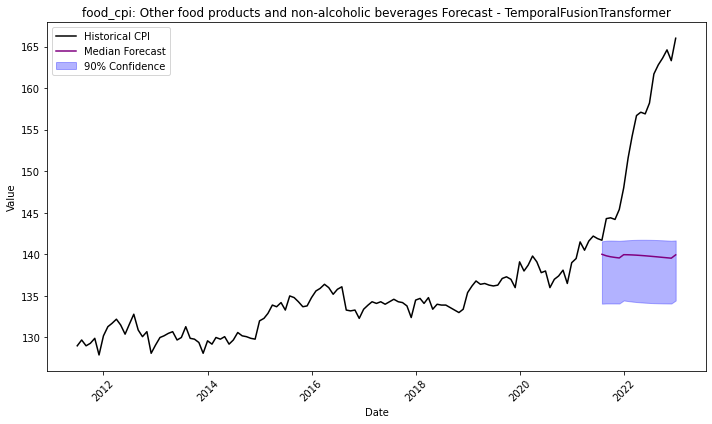

Beginning AutoGluon training... Time limit = 2s
AutoGluon will save models to './output/TEST/ag_global_all_TemporalFusionTransformerModel_exp2_R3_/random_seed_42/2022-07-01/model_files/'
=================== System Info ===================
AutoGluon Version:  1.1.1
Python Version:     3.8.20
Operating System:   Linux
Platform Machine:   x86_64
Platform Version:   #147~18.04.1-Ubuntu SMP Sat Oct 15 13:10:18 UTC 2022
CPU Count:          32
GPU Count:          1
Memory Avail:       166.80 GB / 188.57 GB (88.5%)
Disk Space Avail:   18207.55 GB / 249006.62 GB (7.3%)

Fitting with arguments:
{'enable_ensemble': True,
 'eval_metric': MAPE,
 'excluded_model_types': ['DirectTabular', 'RecursiveTabular'],
 'hyperparameters': {'TemporalFusionTransformerModel': {}},
 'known_covariates_names': [],
 'num_val_windows': 1,
 'prediction_length': 18,
 'quantile_levels': [0.01, 0.05, 0.1, 0.25, 0.75, 0.9, 0.95, 0.99],
 'random_seed': 42,
 'refit_every_n_windows': 1,
 'refit_full': False,
 'skip_model_sele

TemporalFusionTransformerModel


	-0.4240       = Validation score (-MAPE)
	2.19    s     = Training runtime
	0.05    s     = Validation (prediction) runtime
Not fitting ensemble due to lack of time remaining. Time left: -0.3 seconds
Training complete. Models trained: ['TemporalFusionTransformer']
Total runtime: 2.27 s
Best model: TemporalFusionTransformer
Best model score: -0.4240
Model not specified in predict, will default to the model with the best validation score: TemporalFusionTransformer


****************** Summary of fit() ******************
Estimated performance of each model:
                       model  score_val  pred_time_val  fit_time_marginal  \
0  TemporalFusionTransformer  -0.424029       0.046166           2.190368   

   fit_order  
0          1  
Number of models trained: 1
Types of models trained:
{'MultiWindowBacktestingModel'}
****************** End of fit() summary ******************


Model not specified in predict, will default to the model with the best validation score: TemporalFusionTransformer


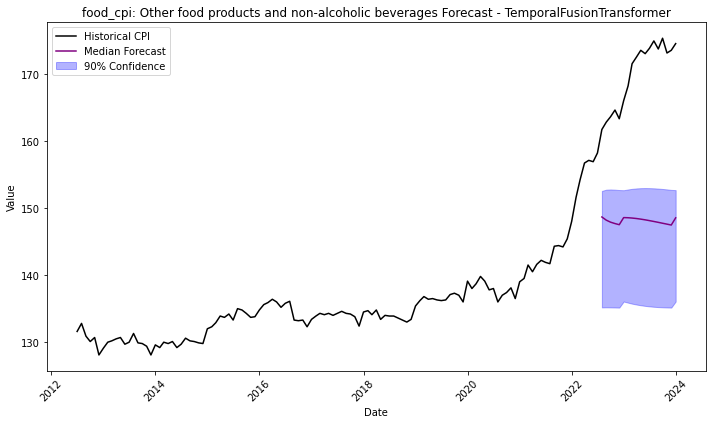

Beginning AutoGluon training... Time limit = 2s
AutoGluon will save models to './output/TEST/ag_global_all_TemporalFusionTransformerModel_exp2_GPT_P3_/random_seed_42/2022-07-01/model_files/'
=================== System Info ===================
AutoGluon Version:  1.1.1
Python Version:     3.8.20
Operating System:   Linux
Platform Machine:   x86_64
Platform Version:   #147~18.04.1-Ubuntu SMP Sat Oct 15 13:10:18 UTC 2022
CPU Count:          32
GPU Count:          1
Memory Avail:       166.73 GB / 188.57 GB (88.4%)
Disk Space Avail:   18207.59 GB / 249006.62 GB (7.3%)

Fitting with arguments:
{'enable_ensemble': True,
 'eval_metric': MAPE,
 'excluded_model_types': ['DirectTabular', 'RecursiveTabular'],
 'hyperparameters': {'TemporalFusionTransformerModel': {}},
 'known_covariates_names': [],
 'num_val_windows': 1,
 'prediction_length': 18,
 'quantile_levels': [0.01, 0.05, 0.1, 0.25, 0.75, 0.9, 0.95, 0.99],
 'random_seed': 42,
 'refit_every_n_windows': 1,
 'refit_full': False,
 'skip_model_

TemporalFusionTransformerModel


	-5.5305       = Validation score (-MAPE)
	2.14    s     = Training runtime
	0.05    s     = Validation (prediction) runtime
Not fitting ensemble due to lack of time remaining. Time left: -0.3 seconds
Training complete. Models trained: ['TemporalFusionTransformer']
Total runtime: 2.22 s
Best model: TemporalFusionTransformer
Best model score: -5.5305
Model not specified in predict, will default to the model with the best validation score: TemporalFusionTransformer
Model not specified in predict, will default to the model with the best validation score: TemporalFusionTransformer


****************** Summary of fit() ******************
Estimated performance of each model:
                       model  score_val  pred_time_val  fit_time_marginal  \
0  TemporalFusionTransformer  -5.530499       0.045467           2.137473   

   fit_order  
0          1  
Number of models trained: 1
Types of models trained:
{'MultiWindowBacktestingModel'}
****************** End of fit() summary ******************


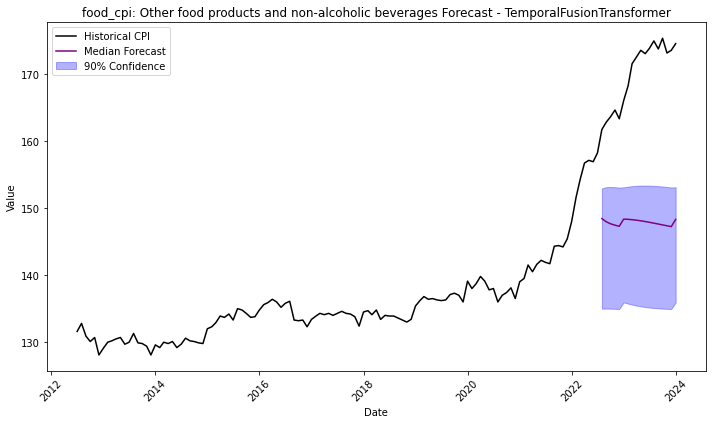

Beginning AutoGluon training... Time limit = 2s
AutoGluon will save models to './output/TEST/ag_global_all_TemporalFusionTransformerModel_exp2_R4_/random_seed_42/2022-07-01/model_files/'
=================== System Info ===================
AutoGluon Version:  1.1.1
Python Version:     3.8.20
Operating System:   Linux
Platform Machine:   x86_64
Platform Version:   #147~18.04.1-Ubuntu SMP Sat Oct 15 13:10:18 UTC 2022
CPU Count:          32
GPU Count:          1
Memory Avail:       166.70 GB / 188.57 GB (88.4%)
Disk Space Avail:   18207.55 GB / 249006.62 GB (7.3%)

Fitting with arguments:
{'enable_ensemble': True,
 'eval_metric': MAPE,
 'excluded_model_types': ['DirectTabular', 'RecursiveTabular'],
 'hyperparameters': {'TemporalFusionTransformerModel': {}},
 'known_covariates_names': [],
 'num_val_windows': 1,
 'prediction_length': 18,
 'quantile_levels': [0.01, 0.05, 0.1, 0.25, 0.75, 0.9, 0.95, 0.99],
 'random_seed': 42,
 'refit_every_n_windows': 1,
 'refit_full': False,
 'skip_model_sele

TemporalFusionTransformerModel


	-5.5690       = Validation score (-MAPE)
	2.11    s     = Training runtime
	0.04    s     = Validation (prediction) runtime
Not fitting ensemble due to lack of time remaining. Time left: -0.3 seconds
Training complete. Models trained: ['TemporalFusionTransformer']
Total runtime: 2.21 s
Best model: TemporalFusionTransformer
Best model score: -5.5690


****************** Summary of fit() ******************
Estimated performance of each model:
                       model  score_val  pred_time_val  fit_time_marginal  \
0  TemporalFusionTransformer  -5.569027       0.044062           2.114981   

   fit_order  
0          1  
Number of models trained: 1
Types of models trained:
{'MultiWindowBacktestingModel'}
****************** End of fit() summary ******************


Model not specified in predict, will default to the model with the best validation score: TemporalFusionTransformer
Model not specified in predict, will default to the model with the best validation score: TemporalFusionTransformer


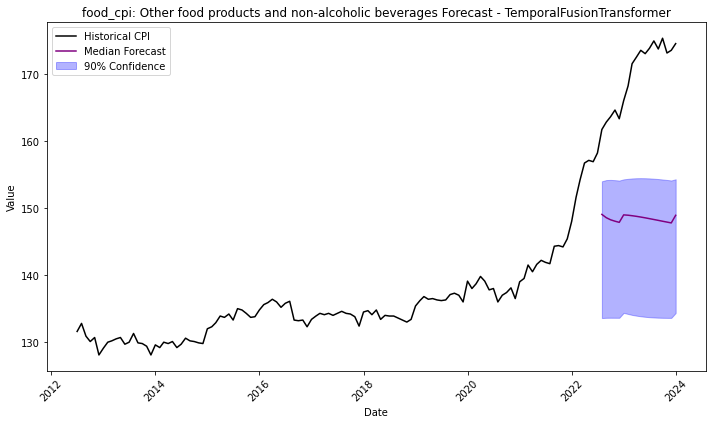

Beginning AutoGluon training... Time limit = 2s
AutoGluon will save models to './output/TEST/ag_global_all_TemporalFusionTransformerModel_exp2_GPT_P4_/random_seed_42/2022-07-01/model_files/'
=================== System Info ===================
AutoGluon Version:  1.1.1
Python Version:     3.8.20
Operating System:   Linux
Platform Machine:   x86_64
Platform Version:   #147~18.04.1-Ubuntu SMP Sat Oct 15 13:10:18 UTC 2022
CPU Count:          32
GPU Count:          1
Memory Avail:       166.72 GB / 188.57 GB (88.4%)
Disk Space Avail:   18207.55 GB / 249006.62 GB (7.3%)

Fitting with arguments:
{'enable_ensemble': True,
 'eval_metric': MAPE,
 'excluded_model_types': ['DirectTabular', 'RecursiveTabular'],
 'hyperparameters': {'TemporalFusionTransformerModel': {}},
 'known_covariates_names': [],
 'num_val_windows': 1,
 'prediction_length': 18,
 'quantile_levels': [0.01, 0.05, 0.1, 0.25, 0.75, 0.9, 0.95, 0.99],
 'random_seed': 42,
 'refit_every_n_windows': 1,
 'refit_full': False,
 'skip_model_

TemporalFusionTransformerModel


	-6.6438       = Validation score (-MAPE)
	2.13    s     = Training runtime
	0.04    s     = Validation (prediction) runtime
Not fitting ensemble due to lack of time remaining. Time left: -0.3 seconds
Training complete. Models trained: ['TemporalFusionTransformer']
Total runtime: 2.21 s
Best model: TemporalFusionTransformer
Best model score: -6.6438
Model not specified in predict, will default to the model with the best validation score: TemporalFusionTransformer
Model not specified in predict, will default to the model with the best validation score: TemporalFusionTransformer


****************** Summary of fit() ******************
Estimated performance of each model:
                       model  score_val  pred_time_val  fit_time_marginal  \
0  TemporalFusionTransformer  -6.643782       0.038904           2.126447   

   fit_order  
0          1  
Number of models trained: 1
Types of models trained:
{'MultiWindowBacktestingModel'}
****************** End of fit() summary ******************


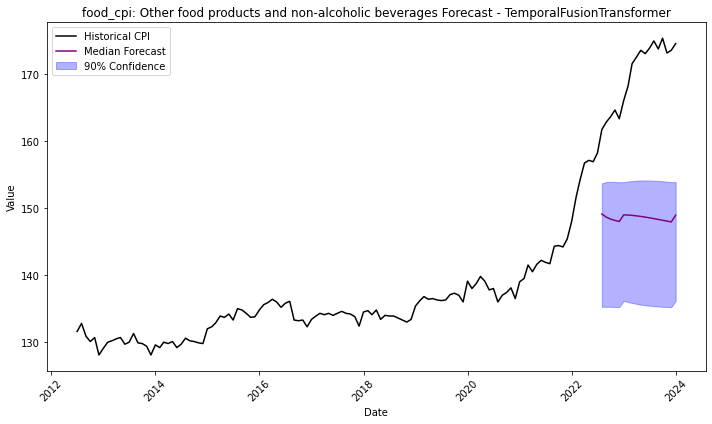

Beginning AutoGluon training... Time limit = 2s
AutoGluon will save models to './output/TEST/ag_global_all_TemporalFusionTransformerModel_exp2_R2_/random_seed_42/2022-07-01/model_files/'
=================== System Info ===================
AutoGluon Version:  1.1.1
Python Version:     3.8.20
Operating System:   Linux
Platform Machine:   x86_64
Platform Version:   #147~18.04.1-Ubuntu SMP Sat Oct 15 13:10:18 UTC 2022
CPU Count:          32
GPU Count:          1
Memory Avail:       166.72 GB / 188.57 GB (88.4%)
Disk Space Avail:   18207.55 GB / 249006.62 GB (7.3%)

Fitting with arguments:
{'enable_ensemble': True,
 'eval_metric': MAPE,
 'excluded_model_types': ['DirectTabular', 'RecursiveTabular'],
 'hyperparameters': {'TemporalFusionTransformerModel': {}},
 'known_covariates_names': [],
 'num_val_windows': 1,
 'prediction_length': 18,
 'quantile_levels': [0.01, 0.05, 0.1, 0.25, 0.75, 0.9, 0.95, 0.99],
 'random_seed': 42,
 'refit_every_n_windows': 1,
 'refit_full': False,
 'skip_model_sele

TemporalFusionTransformerModel


	-0.5577       = Validation score (-MAPE)
	2.21    s     = Training runtime
	0.04    s     = Validation (prediction) runtime
Not fitting ensemble due to lack of time remaining. Time left: -0.3 seconds
Training complete. Models trained: ['TemporalFusionTransformer']
Total runtime: 2.29 s
Best model: TemporalFusionTransformer
Best model score: -0.5577
Model not specified in predict, will default to the model with the best validation score: TemporalFusionTransformer
Model not specified in predict, will default to the model with the best validation score: TemporalFusionTransformer


****************** Summary of fit() ******************
Estimated performance of each model:
                       model  score_val  pred_time_val  fit_time_marginal  \
0  TemporalFusionTransformer   -0.55771       0.044748           2.211869   

   fit_order  
0          1  
Number of models trained: 1
Types of models trained:
{'MultiWindowBacktestingModel'}
****************** End of fit() summary ******************


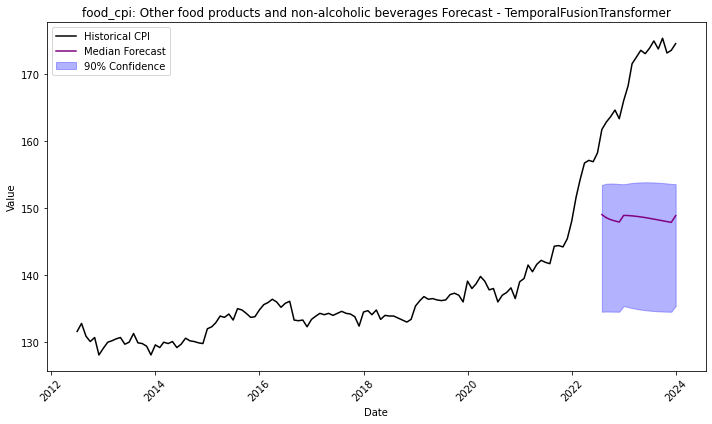

Beginning AutoGluon training... Time limit = 2s
AutoGluon will save models to './output/TEST/ag_global_all_TemporalFusionTransformerModel_exp2_GPT_P1_/random_seed_42/2022-07-01/model_files/'
=================== System Info ===================
AutoGluon Version:  1.1.1
Python Version:     3.8.20
Operating System:   Linux
Platform Machine:   x86_64
Platform Version:   #147~18.04.1-Ubuntu SMP Sat Oct 15 13:10:18 UTC 2022
CPU Count:          32
GPU Count:          1
Memory Avail:       166.70 GB / 188.57 GB (88.4%)
Disk Space Avail:   18207.93 GB / 249006.62 GB (7.3%)

Fitting with arguments:
{'enable_ensemble': True,
 'eval_metric': MAPE,
 'excluded_model_types': ['DirectTabular', 'RecursiveTabular'],
 'hyperparameters': {'TemporalFusionTransformerModel': {}},
 'known_covariates_names': [],
 'num_val_windows': 1,
 'prediction_length': 18,
 'quantile_levels': [0.01, 0.05, 0.1, 0.25, 0.75, 0.9, 0.95, 0.99],
 'random_seed': 42,
 'refit_every_n_windows': 1,
 'refit_full': False,
 'skip_model_

TemporalFusionTransformerModel


	-5.5467       = Validation score (-MAPE)
	2.15    s     = Training runtime
	0.04    s     = Validation (prediction) runtime
Not fitting ensemble due to lack of time remaining. Time left: -0.3 seconds
Training complete. Models trained: ['TemporalFusionTransformer']
Total runtime: 2.23 s
Best model: TemporalFusionTransformer
Best model score: -5.5467
Model not specified in predict, will default to the model with the best validation score: TemporalFusionTransformer
Model not specified in predict, will default to the model with the best validation score: TemporalFusionTransformer


****************** Summary of fit() ******************
Estimated performance of each model:
                       model  score_val  pred_time_val  fit_time_marginal  \
0  TemporalFusionTransformer  -5.546715       0.042349           2.150033   

   fit_order  
0          1  
Number of models trained: 1
Types of models trained:
{'MultiWindowBacktestingModel'}
****************** End of fit() summary ******************


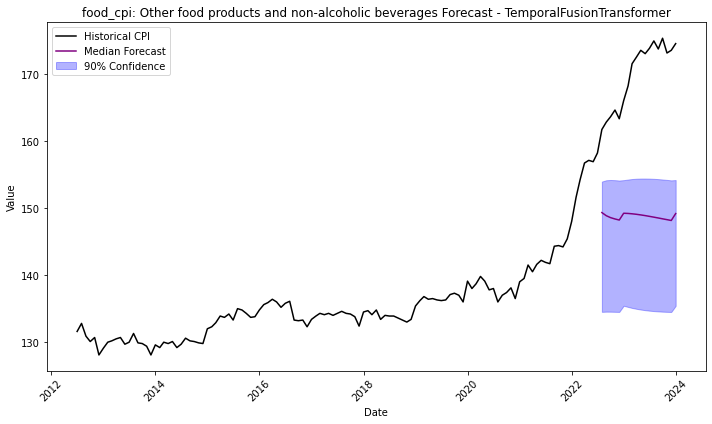

Beginning AutoGluon training... Time limit = 2s
AutoGluon will save models to './output/TEST/ag_global_all_TemporalFusionTransformerModel_exp2_R1_/random_seed_42/2022-07-01/model_files/'
=================== System Info ===================
AutoGluon Version:  1.1.1
Python Version:     3.8.20
Operating System:   Linux
Platform Machine:   x86_64
Platform Version:   #147~18.04.1-Ubuntu SMP Sat Oct 15 13:10:18 UTC 2022
CPU Count:          32
GPU Count:          1
Memory Avail:       166.74 GB / 188.57 GB (88.4%)
Disk Space Avail:   18207.92 GB / 249006.62 GB (7.3%)

Fitting with arguments:
{'enable_ensemble': True,
 'eval_metric': MAPE,
 'excluded_model_types': ['DirectTabular', 'RecursiveTabular'],
 'hyperparameters': {'TemporalFusionTransformerModel': {}},
 'known_covariates_names': [],
 'num_val_windows': 1,
 'prediction_length': 18,
 'quantile_levels': [0.01, 0.05, 0.1, 0.25, 0.75, 0.9, 0.95, 0.99],
 'random_seed': 42,
 'refit_every_n_windows': 1,
 'refit_full': False,
 'skip_model_sele

TemporalFusionTransformerModel


	-5.5852       = Validation score (-MAPE)
	2.15    s     = Training runtime
	0.04    s     = Validation (prediction) runtime
Not fitting ensemble due to lack of time remaining. Time left: -0.3 seconds
Training complete. Models trained: ['TemporalFusionTransformer']
Total runtime: 2.23 s
Best model: TemporalFusionTransformer
Best model score: -5.5852
Model not specified in predict, will default to the model with the best validation score: TemporalFusionTransformer
Model not specified in predict, will default to the model with the best validation score: TemporalFusionTransformer


****************** Summary of fit() ******************
Estimated performance of each model:
                       model  score_val  pred_time_val  fit_time_marginal  \
0  TemporalFusionTransformer  -5.585218       0.043778           2.150394   

   fit_order  
0          1  
Number of models trained: 1
Types of models trained:
{'MultiWindowBacktestingModel'}
****************** End of fit() summary ******************


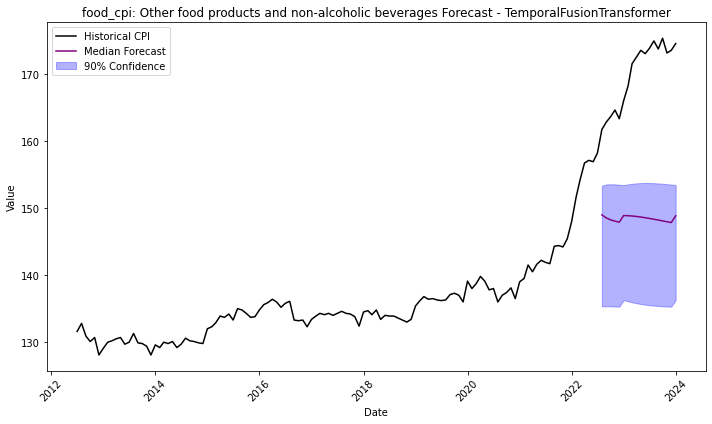

Beginning AutoGluon training... Time limit = 2s
AutoGluon will save models to './output/TEST/ag_global_all_TemporalFusionTransformerModel_exp2_GPT_P2_/random_seed_42/2022-07-01/model_files/'
=================== System Info ===================
AutoGluon Version:  1.1.1
Python Version:     3.8.20
Operating System:   Linux
Platform Machine:   x86_64
Platform Version:   #147~18.04.1-Ubuntu SMP Sat Oct 15 13:10:18 UTC 2022
CPU Count:          32
GPU Count:          1
Memory Avail:       166.69 GB / 188.57 GB (88.4%)
Disk Space Avail:   18207.91 GB / 249006.62 GB (7.3%)

Fitting with arguments:
{'enable_ensemble': True,
 'eval_metric': MAPE,
 'excluded_model_types': ['DirectTabular', 'RecursiveTabular'],
 'hyperparameters': {'TemporalFusionTransformerModel': {}},
 'known_covariates_names': [],
 'num_val_windows': 1,
 'prediction_length': 18,
 'quantile_levels': [0.01, 0.05, 0.1, 0.25, 0.75, 0.9, 0.95, 0.99],
 'random_seed': 42,
 'refit_every_n_windows': 1,
 'refit_full': False,
 'skip_model_

TemporalFusionTransformerModel


	-6.2849       = Validation score (-MAPE)
	2.14    s     = Training runtime
	0.04    s     = Validation (prediction) runtime
Not fitting ensemble due to lack of time remaining. Time left: -0.3 seconds
Training complete. Models trained: ['TemporalFusionTransformer']
Total runtime: 2.22 s
Best model: TemporalFusionTransformer
Best model score: -6.2849
Model not specified in predict, will default to the model with the best validation score: TemporalFusionTransformer
Model not specified in predict, will default to the model with the best validation score: TemporalFusionTransformer


****************** Summary of fit() ******************
Estimated performance of each model:
                       model  score_val  pred_time_val  fit_time_marginal  \
0  TemporalFusionTransformer  -6.284889       0.042789           2.137865   

   fit_order  
0          1  
Number of models trained: 1
Types of models trained:
{'MultiWindowBacktestingModel'}
****************** End of fit() summary ******************


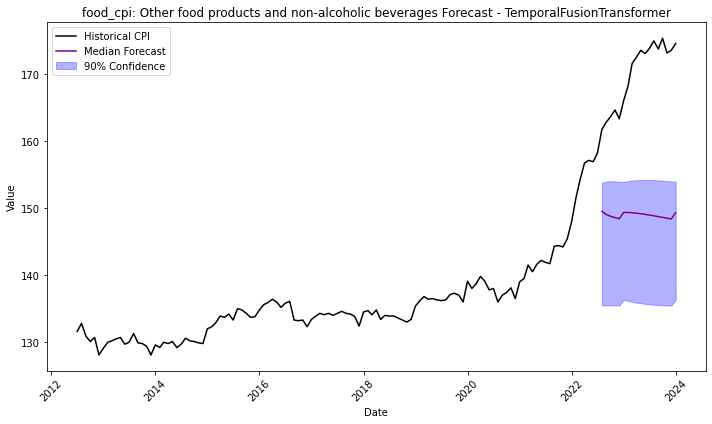

Beginning AutoGluon training... Time limit = 2s
AutoGluon will save models to './output/TEST/ag_global_all_TemporalFusionTransformerModel_exp2_R3_/random_seed_42/2023-07-01/model_files/'
=================== System Info ===================
AutoGluon Version:  1.1.1
Python Version:     3.8.20
Operating System:   Linux
Platform Machine:   x86_64
Platform Version:   #147~18.04.1-Ubuntu SMP Sat Oct 15 13:10:18 UTC 2022
CPU Count:          32
GPU Count:          1
Memory Avail:       166.69 GB / 188.57 GB (88.4%)
Disk Space Avail:   18207.90 GB / 249006.62 GB (7.3%)

Fitting with arguments:
{'enable_ensemble': True,
 'eval_metric': MAPE,
 'excluded_model_types': ['DirectTabular', 'RecursiveTabular'],
 'hyperparameters': {'TemporalFusionTransformerModel': {}},
 'known_covariates_names': [],
 'num_val_windows': 1,
 'prediction_length': 18,
 'quantile_levels': [0.01, 0.05, 0.1, 0.25, 0.75, 0.9, 0.95, 0.99],
 'random_seed': 42,
 'refit_every_n_windows': 1,
 'refit_full': False,
 'skip_model_sele

TemporalFusionTransformerModel


Inferred time series frequency: 'MS'
Provided train_data has 9922 rows (NaN fraction=0.1%), 22 time series. Median time series length is 451 (min=451, max=451). 

Provided data contains following columns:
	target: 'target'

AutoGluon will gauge predictive performance using evaluation metric: 'MAPE'
	This metric's sign has been flipped to adhere to being higher_is_better. The metric score can be multiplied by -1 to get the metric value.

Starting training. Start time is 2024-10-27 07:46:39
Excluded model types: ['DirectTabular', 'RecursiveTabular']
Models that will be trained: ['TemporalFusionTransformer']
Training timeseries model TemporalFusionTransformer. Training for up to 1.6s of the 1.6s of remaining time.
	-0.4643       = Validation score (-MAPE)
	1.86    s     = Training runtime
	0.04    s     = Validation (prediction) runtime
Not fitting ensemble due to lack of time remaining. Time left: -0.3 seconds
Training complete. Models trained: ['TemporalFusionTransformer']
Total runtime

****************** Summary of fit() ******************
Estimated performance of each model:
                       model  score_val  pred_time_val  fit_time_marginal  \
0  TemporalFusionTransformer  -0.464256       0.043568             1.8595   

   fit_order  
0          1  
Number of models trained: 1
Types of models trained:
{'MultiWindowBacktestingModel'}
****************** End of fit() summary ******************


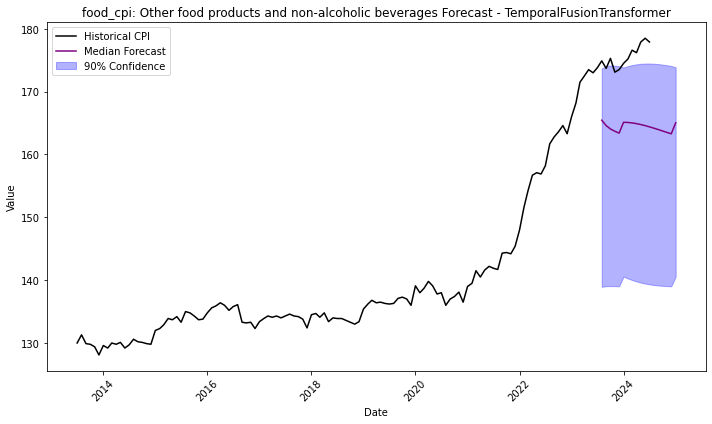

Beginning AutoGluon training... Time limit = 2s
AutoGluon will save models to './output/TEST/ag_global_all_TemporalFusionTransformerModel_exp2_GPT_P3_/random_seed_42/2023-07-01/model_files/'
=================== System Info ===================
AutoGluon Version:  1.1.1
Python Version:     3.8.20
Operating System:   Linux
Platform Machine:   x86_64
Platform Version:   #147~18.04.1-Ubuntu SMP Sat Oct 15 13:10:18 UTC 2022
CPU Count:          32
GPU Count:          1
Memory Avail:       166.69 GB / 188.57 GB (88.4%)
Disk Space Avail:   18207.89 GB / 249006.62 GB (7.3%)

Fitting with arguments:
{'enable_ensemble': True,
 'eval_metric': MAPE,
 'excluded_model_types': ['DirectTabular', 'RecursiveTabular'],
 'hyperparameters': {'TemporalFusionTransformerModel': {}},
 'known_covariates_names': [],
 'num_val_windows': 1,
 'prediction_length': 18,
 'quantile_levels': [0.01, 0.05, 0.1, 0.25, 0.75, 0.9, 0.95, 0.99],
 'random_seed': 42,
 'refit_every_n_windows': 1,
 'refit_full': False,
 'skip_model_

TemporalFusionTransformerModel


	-1.0713       = Validation score (-MAPE)
	2.14    s     = Training runtime
	0.04    s     = Validation (prediction) runtime
Not fitting ensemble due to lack of time remaining. Time left: -0.3 seconds
Training complete. Models trained: ['TemporalFusionTransformer']
Total runtime: 2.22 s
Best model: TemporalFusionTransformer
Best model score: -1.0713
Model not specified in predict, will default to the model with the best validation score: TemporalFusionTransformer
Model not specified in predict, will default to the model with the best validation score: TemporalFusionTransformer


****************** Summary of fit() ******************
Estimated performance of each model:
                       model  score_val  pred_time_val  fit_time_marginal  \
0  TemporalFusionTransformer  -1.071267        0.04216           2.140975   

   fit_order  
0          1  
Number of models trained: 1
Types of models trained:
{'MultiWindowBacktestingModel'}
****************** End of fit() summary ******************


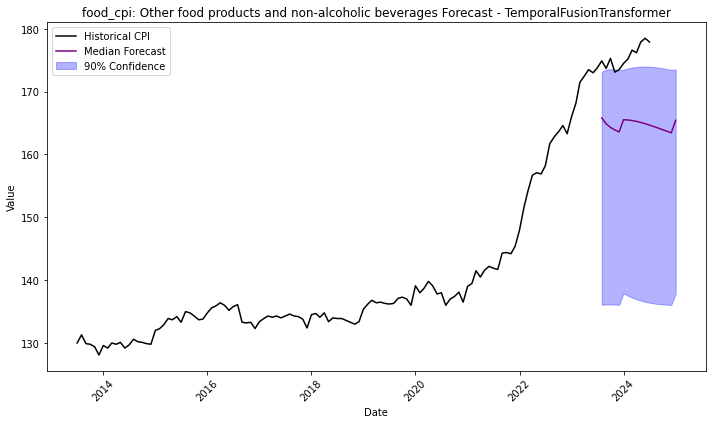

Beginning AutoGluon training... Time limit = 2s
AutoGluon will save models to './output/TEST/ag_global_all_TemporalFusionTransformerModel_exp2_R4_/random_seed_42/2023-07-01/model_files/'
=================== System Info ===================
AutoGluon Version:  1.1.1
Python Version:     3.8.20
Operating System:   Linux
Platform Machine:   x86_64
Platform Version:   #147~18.04.1-Ubuntu SMP Sat Oct 15 13:10:18 UTC 2022
CPU Count:          32
GPU Count:          1
Memory Avail:       166.81 GB / 188.57 GB (88.5%)
Disk Space Avail:   18207.94 GB / 249006.62 GB (7.3%)

Fitting with arguments:
{'enable_ensemble': True,
 'eval_metric': MAPE,
 'excluded_model_types': ['DirectTabular', 'RecursiveTabular'],
 'hyperparameters': {'TemporalFusionTransformerModel': {}},
 'known_covariates_names': [],
 'num_val_windows': 1,
 'prediction_length': 18,
 'quantile_levels': [0.01, 0.05, 0.1, 0.25, 0.75, 0.9, 0.95, 0.99],
 'random_seed': 42,
 'refit_every_n_windows': 1,
 'refit_full': False,
 'skip_model_sele

TemporalFusionTransformerModel


	-0.8547       = Validation score (-MAPE)
	2.13    s     = Training runtime
	0.04    s     = Validation (prediction) runtime
Not fitting ensemble due to lack of time remaining. Time left: -0.3 seconds
Training complete. Models trained: ['TemporalFusionTransformer']
Total runtime: 2.21 s
Best model: TemporalFusionTransformer
Best model score: -0.8547
Model not specified in predict, will default to the model with the best validation score: TemporalFusionTransformer
Model not specified in predict, will default to the model with the best validation score: TemporalFusionTransformer


****************** Summary of fit() ******************
Estimated performance of each model:
                       model  score_val  pred_time_val  fit_time_marginal  \
0  TemporalFusionTransformer   -0.85473       0.042975           2.130934   

   fit_order  
0          1  
Number of models trained: 1
Types of models trained:
{'MultiWindowBacktestingModel'}
****************** End of fit() summary ******************


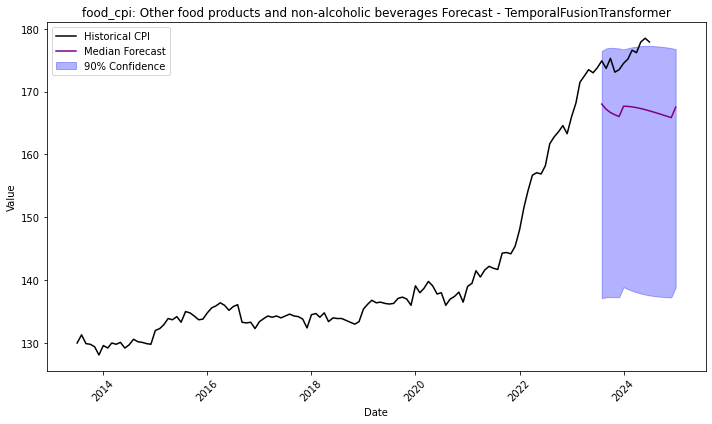

Beginning AutoGluon training... Time limit = 2s
AutoGluon will save models to './output/TEST/ag_global_all_TemporalFusionTransformerModel_exp2_GPT_P4_/random_seed_42/2023-07-01/model_files/'
=================== System Info ===================
AutoGluon Version:  1.1.1
Python Version:     3.8.20
Operating System:   Linux
Platform Machine:   x86_64
Platform Version:   #147~18.04.1-Ubuntu SMP Sat Oct 15 13:10:18 UTC 2022
CPU Count:          32
GPU Count:          1
Memory Avail:       166.69 GB / 188.57 GB (88.4%)
Disk Space Avail:   18207.92 GB / 249006.62 GB (7.3%)

Fitting with arguments:
{'enable_ensemble': True,
 'eval_metric': MAPE,
 'excluded_model_types': ['DirectTabular', 'RecursiveTabular'],
 'hyperparameters': {'TemporalFusionTransformerModel': {}},
 'known_covariates_names': [],
 'num_val_windows': 1,
 'prediction_length': 18,
 'quantile_levels': [0.01, 0.05, 0.1, 0.25, 0.75, 0.9, 0.95, 0.99],
 'random_seed': 42,
 'refit_every_n_windows': 1,
 'refit_full': False,
 'skip_model_

TemporalFusionTransformerModel


	-1.0320       = Validation score (-MAPE)
	2.13    s     = Training runtime
	0.04    s     = Validation (prediction) runtime
Not fitting ensemble due to lack of time remaining. Time left: -0.3 seconds
Training complete. Models trained: ['TemporalFusionTransformer']
Total runtime: 2.21 s
Best model: TemporalFusionTransformer
Best model score: -1.0320
Model not specified in predict, will default to the model with the best validation score: TemporalFusionTransformer
Model not specified in predict, will default to the model with the best validation score: TemporalFusionTransformer


****************** Summary of fit() ******************
Estimated performance of each model:
                       model  score_val  pred_time_val  fit_time_marginal  \
0  TemporalFusionTransformer  -1.031958       0.044817           2.125932   

   fit_order  
0          1  
Number of models trained: 1
Types of models trained:
{'MultiWindowBacktestingModel'}
****************** End of fit() summary ******************


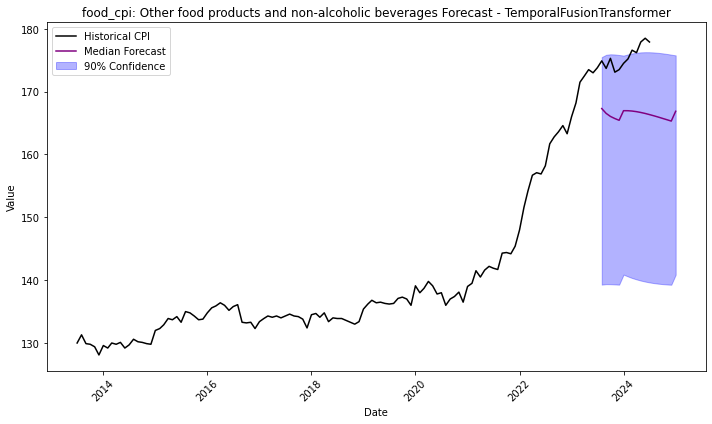

Beginning AutoGluon training... Time limit = 2s
AutoGluon will save models to './output/TEST/ag_global_all_TemporalFusionTransformerModel_exp2_R2_/random_seed_42/2023-07-01/model_files/'
=================== System Info ===================
AutoGluon Version:  1.1.1
Python Version:     3.8.20
Operating System:   Linux
Platform Machine:   x86_64
Platform Version:   #147~18.04.1-Ubuntu SMP Sat Oct 15 13:10:18 UTC 2022
CPU Count:          32
GPU Count:          1
Memory Avail:       166.69 GB / 188.57 GB (88.4%)
Disk Space Avail:   18207.91 GB / 249006.62 GB (7.3%)

Fitting with arguments:
{'enable_ensemble': True,
 'eval_metric': MAPE,
 'excluded_model_types': ['DirectTabular', 'RecursiveTabular'],
 'hyperparameters': {'TemporalFusionTransformerModel': {}},
 'known_covariates_names': [],
 'num_val_windows': 1,
 'prediction_length': 18,
 'quantile_levels': [0.01, 0.05, 0.1, 0.25, 0.75, 0.9, 0.95, 0.99],
 'random_seed': 42,
 'refit_every_n_windows': 1,
 'refit_full': False,
 'skip_model_sele

TemporalFusionTransformerModel


	-0.5325       = Validation score (-MAPE)
	2.12    s     = Training runtime
	0.04    s     = Validation (prediction) runtime
Not fitting ensemble due to lack of time remaining. Time left: -0.3 seconds
Training complete. Models trained: ['TemporalFusionTransformer']
Total runtime: 2.20 s
Best model: TemporalFusionTransformer
Best model score: -0.5325
Model not specified in predict, will default to the model with the best validation score: TemporalFusionTransformer
Model not specified in predict, will default to the model with the best validation score: TemporalFusionTransformer


****************** Summary of fit() ******************
Estimated performance of each model:
                       model  score_val  pred_time_val  fit_time_marginal  \
0  TemporalFusionTransformer  -0.532477       0.044261           2.116622   

   fit_order  
0          1  
Number of models trained: 1
Types of models trained:
{'MultiWindowBacktestingModel'}
****************** End of fit() summary ******************


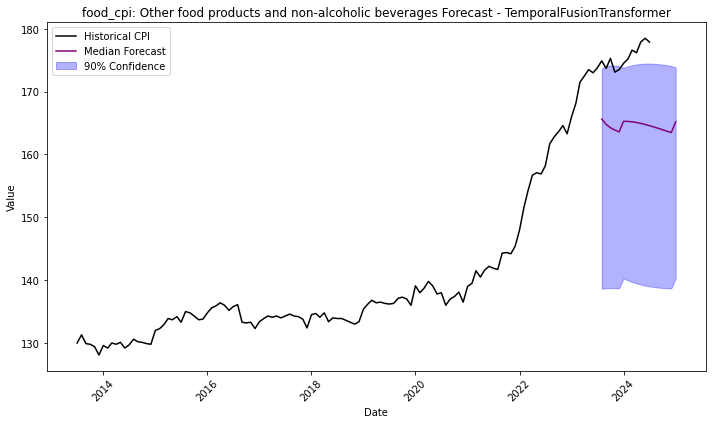

Beginning AutoGluon training... Time limit = 2s
AutoGluon will save models to './output/TEST/ag_global_all_TemporalFusionTransformerModel_exp2_GPT_P1_/random_seed_42/2023-07-01/model_files/'
=================== System Info ===================
AutoGluon Version:  1.1.1
Python Version:     3.8.20
Operating System:   Linux
Platform Machine:   x86_64
Platform Version:   #147~18.04.1-Ubuntu SMP Sat Oct 15 13:10:18 UTC 2022
CPU Count:          32
GPU Count:          1
Memory Avail:       166.69 GB / 188.57 GB (88.4%)
Disk Space Avail:   18207.90 GB / 249006.62 GB (7.3%)

Fitting with arguments:
{'enable_ensemble': True,
 'eval_metric': MAPE,
 'excluded_model_types': ['DirectTabular', 'RecursiveTabular'],
 'hyperparameters': {'TemporalFusionTransformerModel': {}},
 'known_covariates_names': [],
 'num_val_windows': 1,
 'prediction_length': 18,
 'quantile_levels': [0.01, 0.05, 0.1, 0.25, 0.75, 0.9, 0.95, 0.99],
 'random_seed': 42,
 'refit_every_n_windows': 1,
 'refit_full': False,
 'skip_model_

TemporalFusionTransformerModel


	-0.7133       = Validation score (-MAPE)
	2.13    s     = Training runtime
	0.04    s     = Validation (prediction) runtime
Not fitting ensemble due to lack of time remaining. Time left: -0.3 seconds
Training complete. Models trained: ['TemporalFusionTransformer']
Total runtime: 2.21 s
Best model: TemporalFusionTransformer
Best model score: -0.7133


****************** Summary of fit() ******************
Estimated performance of each model:
                       model  score_val  pred_time_val  fit_time_marginal  \
0  TemporalFusionTransformer  -0.713328        0.04383           2.130748   

   fit_order  
0          1  
Number of models trained: 1
Types of models trained:
{'MultiWindowBacktestingModel'}
****************** End of fit() summary ******************


Model not specified in predict, will default to the model with the best validation score: TemporalFusionTransformer
Model not specified in predict, will default to the model with the best validation score: TemporalFusionTransformer


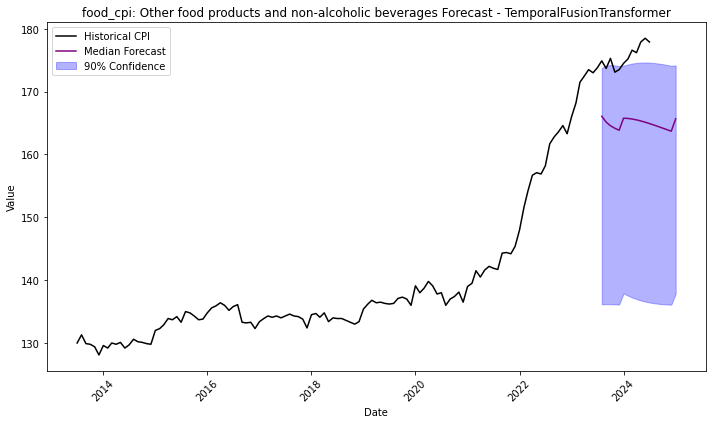

Beginning AutoGluon training... Time limit = 2s
AutoGluon will save models to './output/TEST/ag_global_all_TemporalFusionTransformerModel_exp2_R1_/random_seed_42/2023-07-01/model_files/'
=================== System Info ===================
AutoGluon Version:  1.1.1
Python Version:     3.8.20
Operating System:   Linux
Platform Machine:   x86_64
Platform Version:   #147~18.04.1-Ubuntu SMP Sat Oct 15 13:10:18 UTC 2022
CPU Count:          32
GPU Count:          1
Memory Avail:       166.69 GB / 188.57 GB (88.4%)
Disk Space Avail:   18207.89 GB / 249006.62 GB (7.3%)

Fitting with arguments:
{'enable_ensemble': True,
 'eval_metric': MAPE,
 'excluded_model_types': ['DirectTabular', 'RecursiveTabular'],
 'hyperparameters': {'TemporalFusionTransformerModel': {}},
 'known_covariates_names': [],
 'num_val_windows': 1,
 'prediction_length': 18,
 'quantile_levels': [0.01, 0.05, 0.1, 0.25, 0.75, 0.9, 0.95, 0.99],
 'random_seed': 42,
 'refit_every_n_windows': 1,
 'refit_full': False,
 'skip_model_sele

TemporalFusionTransformerModel


	-0.9890       = Validation score (-MAPE)
	2.11    s     = Training runtime
	0.04    s     = Validation (prediction) runtime
Not fitting ensemble due to lack of time remaining. Time left: -0.2 seconds
Training complete. Models trained: ['TemporalFusionTransformer']
Total runtime: 2.19 s
Best model: TemporalFusionTransformer
Best model score: -0.9890
Model not specified in predict, will default to the model with the best validation score: TemporalFusionTransformer
Model not specified in predict, will default to the model with the best validation score: TemporalFusionTransformer


****************** Summary of fit() ******************
Estimated performance of each model:
                       model  score_val  pred_time_val  fit_time_marginal  \
0  TemporalFusionTransformer  -0.988992       0.041852           2.107829   

   fit_order  
0          1  
Number of models trained: 1
Types of models trained:
{'MultiWindowBacktestingModel'}
****************** End of fit() summary ******************


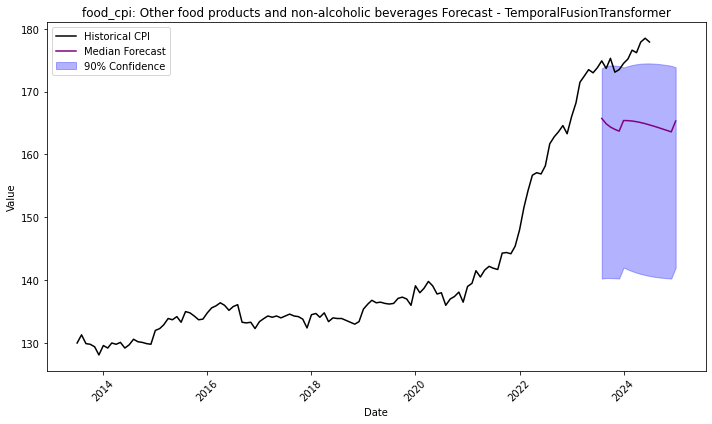

Beginning AutoGluon training... Time limit = 2s
AutoGluon will save models to './output/TEST/ag_global_all_TemporalFusionTransformerModel_exp2_GPT_P2_/random_seed_42/2023-07-01/model_files/'
=================== System Info ===================
AutoGluon Version:  1.1.1
Python Version:     3.8.20
Operating System:   Linux
Platform Machine:   x86_64
Platform Version:   #147~18.04.1-Ubuntu SMP Sat Oct 15 13:10:18 UTC 2022
CPU Count:          32
GPU Count:          1
Memory Avail:       166.69 GB / 188.57 GB (88.4%)
Disk Space Avail:   18207.89 GB / 249006.62 GB (7.3%)

Fitting with arguments:
{'enable_ensemble': True,
 'eval_metric': MAPE,
 'excluded_model_types': ['DirectTabular', 'RecursiveTabular'],
 'hyperparameters': {'TemporalFusionTransformerModel': {}},
 'known_covariates_names': [],
 'num_val_windows': 1,
 'prediction_length': 18,
 'quantile_levels': [0.01, 0.05, 0.1, 0.25, 0.75, 0.9, 0.95, 0.99],
 'random_seed': 42,
 'refit_every_n_windows': 1,
 'refit_full': False,
 'skip_model_

TemporalFusionTransformerModel


	-0.6457       = Validation score (-MAPE)
	2.15    s     = Training runtime
	0.04    s     = Validation (prediction) runtime
Not fitting ensemble due to lack of time remaining. Time left: -0.3 seconds
Training complete. Models trained: ['TemporalFusionTransformer']
Total runtime: 2.23 s
Best model: TemporalFusionTransformer
Best model score: -0.6457
Model not specified in predict, will default to the model with the best validation score: TemporalFusionTransformer
Model not specified in predict, will default to the model with the best validation score: TemporalFusionTransformer


****************** Summary of fit() ******************
Estimated performance of each model:
                       model  score_val  pred_time_val  fit_time_marginal  \
0  TemporalFusionTransformer  -0.645654       0.040986           2.149574   

   fit_order  
0          1  
Number of models trained: 1
Types of models trained:
{'MultiWindowBacktestingModel'}
****************** End of fit() summary ******************


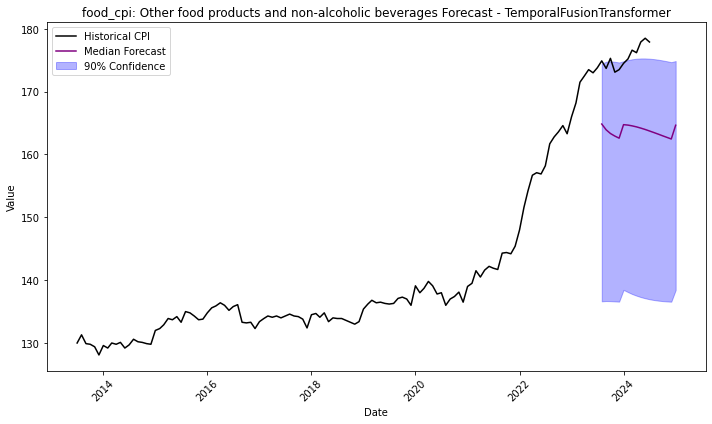

Beginning AutoGluon training... Time limit = 2s
AutoGluon will save models to './output/TEST/ag_global_all_TemporalFusionTransformerModel_exp2_GPT_P3_/random_seed_42/2018-07-01/model_files/'
=================== System Info ===================
AutoGluon Version:  1.1.1
Python Version:     3.8.20
Operating System:   Linux
Platform Machine:   x86_64
Platform Version:   #147~18.04.1-Ubuntu SMP Sat Oct 15 13:10:18 UTC 2022
CPU Count:          32
GPU Count:          1
Memory Avail:       166.90 GB / 188.57 GB (88.5%)
Disk Space Avail:   18207.94 GB / 249006.62 GB (7.3%)

Fitting with arguments:
{'enable_ensemble': True,
 'eval_metric': MAPE,
 'excluded_model_types': ['DirectTabular', 'RecursiveTabular'],
 'hyperparameters': {'TemporalFusionTransformerModel': {}},
 'known_covariates_names': [],
 'num_val_windows': 1,
 'prediction_length': 18,
 'quantile_levels': [0.01, 0.05, 0.1, 0.25, 0.75, 0.9, 0.95, 0.99],
 'random_seed': 42,
 'refit_every_n_windows': 1,
 'refit_full': False,
 'skip_model_

TemporalFusionTransformerModel


	-2.7224       = Validation score (-MAPE)
	2.11    s     = Training runtime
	0.04    s     = Validation (prediction) runtime
Not fitting ensemble due to lack of time remaining. Time left: -0.3 seconds
Training complete. Models trained: ['TemporalFusionTransformer']
Total runtime: 2.20 s
Best model: TemporalFusionTransformer
Best model score: -2.7224
Model not specified in predict, will default to the model with the best validation score: TemporalFusionTransformer
Model not specified in predict, will default to the model with the best validation score: TemporalFusionTransformer


****************** Summary of fit() ******************
Estimated performance of each model:
                       model  score_val  pred_time_val  fit_time_marginal  \
0  TemporalFusionTransformer  -2.722424       0.043689           2.114963   

   fit_order  
0          1  
Number of models trained: 1
Types of models trained:
{'MultiWindowBacktestingModel'}
****************** End of fit() summary ******************


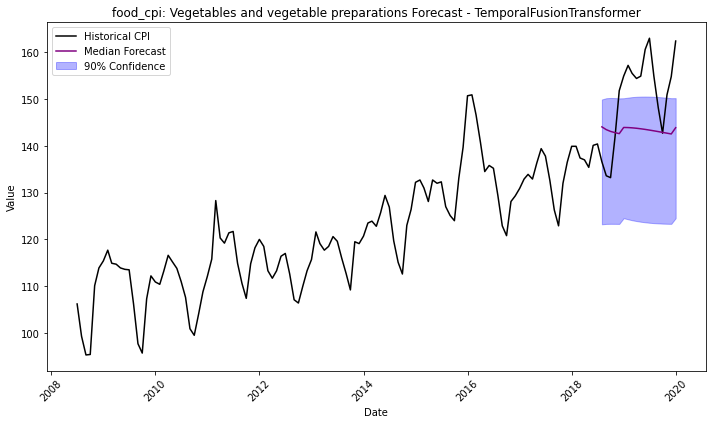

Beginning AutoGluon training... Time limit = 2s
AutoGluon will save models to './output/TEST/ag_global_all_TemporalFusionTransformerModel_exp2_R1_/random_seed_42/2018-07-01/model_files/'
=================== System Info ===================
AutoGluon Version:  1.1.1
Python Version:     3.8.20
Operating System:   Linux
Platform Machine:   x86_64
Platform Version:   #147~18.04.1-Ubuntu SMP Sat Oct 15 13:10:18 UTC 2022
CPU Count:          32
GPU Count:          1
Memory Avail:       166.71 GB / 188.57 GB (88.4%)
Disk Space Avail:   18207.93 GB / 249006.62 GB (7.3%)

Fitting with arguments:
{'enable_ensemble': True,
 'eval_metric': MAPE,
 'excluded_model_types': ['DirectTabular', 'RecursiveTabular'],
 'hyperparameters': {'TemporalFusionTransformerModel': {}},
 'known_covariates_names': [],
 'num_val_windows': 1,
 'prediction_length': 18,
 'quantile_levels': [0.01, 0.05, 0.1, 0.25, 0.75, 0.9, 0.95, 0.99],
 'random_seed': 42,
 'refit_every_n_windows': 1,
 'refit_full': False,
 'skip_model_sele

TemporalFusionTransformerModel


	-1.1451       = Validation score (-MAPE)
	2.15    s     = Training runtime
	0.04    s     = Validation (prediction) runtime
Not fitting ensemble due to lack of time remaining. Time left: -0.3 seconds
Training complete. Models trained: ['TemporalFusionTransformer']
Total runtime: 2.23 s
Best model: TemporalFusionTransformer
Best model score: -1.1451
Model not specified in predict, will default to the model with the best validation score: TemporalFusionTransformer
Model not specified in predict, will default to the model with the best validation score: TemporalFusionTransformer


****************** Summary of fit() ******************
Estimated performance of each model:
                       model  score_val  pred_time_val  fit_time_marginal  \
0  TemporalFusionTransformer  -1.145068       0.043357           2.146476   

   fit_order  
0          1  
Number of models trained: 1
Types of models trained:
{'MultiWindowBacktestingModel'}
****************** End of fit() summary ******************


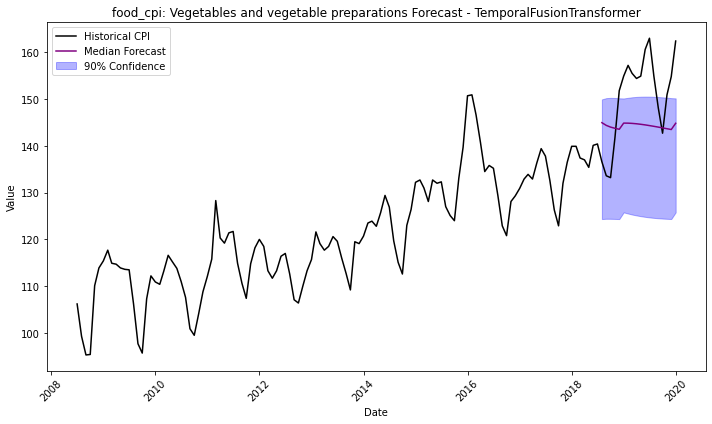

Beginning AutoGluon training... Time limit = 2s
AutoGluon will save models to './output/TEST/ag_global_all_TemporalFusionTransformerModel_exp2_R4_/random_seed_42/2018-07-01/model_files/'
=================== System Info ===================
AutoGluon Version:  1.1.1
Python Version:     3.8.20
Operating System:   Linux
Platform Machine:   x86_64
Platform Version:   #147~18.04.1-Ubuntu SMP Sat Oct 15 13:10:18 UTC 2022
CPU Count:          32
GPU Count:          1
Memory Avail:       166.80 GB / 188.57 GB (88.5%)
Disk Space Avail:   18207.93 GB / 249006.62 GB (7.3%)

Fitting with arguments:
{'enable_ensemble': True,
 'eval_metric': MAPE,
 'excluded_model_types': ['DirectTabular', 'RecursiveTabular'],
 'hyperparameters': {'TemporalFusionTransformerModel': {}},
 'known_covariates_names': [],
 'num_val_windows': 1,
 'prediction_length': 18,
 'quantile_levels': [0.01, 0.05, 0.1, 0.25, 0.75, 0.9, 0.95, 0.99],
 'random_seed': 42,
 'refit_every_n_windows': 1,
 'refit_full': False,
 'skip_model_sele

TemporalFusionTransformerModel


	-1.3325       = Validation score (-MAPE)
	2.42    s     = Training runtime
	0.04    s     = Validation (prediction) runtime
Not fitting ensemble due to lack of time remaining. Time left: -0.6 seconds
Training complete. Models trained: ['TemporalFusionTransformer']
Total runtime: 2.50 s
Best model: TemporalFusionTransformer
Best model score: -1.3325
Model not specified in predict, will default to the model with the best validation score: TemporalFusionTransformer
Model not specified in predict, will default to the model with the best validation score: TemporalFusionTransformer


****************** Summary of fit() ******************
Estimated performance of each model:
                       model  score_val  pred_time_val  fit_time_marginal  \
0  TemporalFusionTransformer  -1.332546       0.041598           2.421624   

   fit_order  
0          1  
Number of models trained: 1
Types of models trained:
{'MultiWindowBacktestingModel'}
****************** End of fit() summary ******************


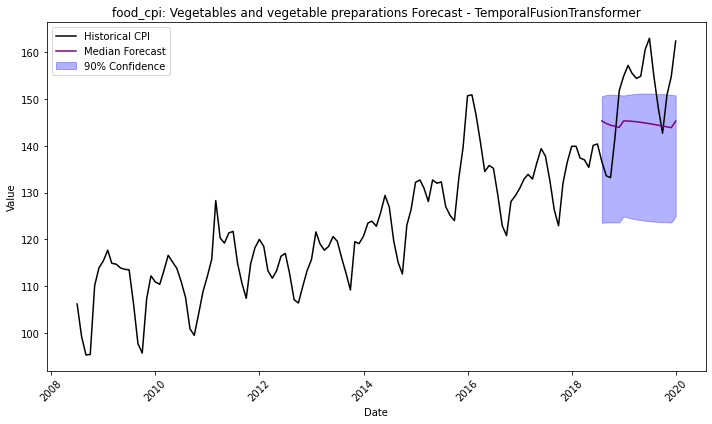

Beginning AutoGluon training... Time limit = 2s
AutoGluon will save models to './output/TEST/ag_global_all_TemporalFusionTransformerModel_exp2_R2_/random_seed_42/2018-07-01/model_files/'
=================== System Info ===================
AutoGluon Version:  1.1.1
Python Version:     3.8.20
Operating System:   Linux
Platform Machine:   x86_64
Platform Version:   #147~18.04.1-Ubuntu SMP Sat Oct 15 13:10:18 UTC 2022
CPU Count:          32
GPU Count:          1
Memory Avail:       166.69 GB / 188.57 GB (88.4%)
Disk Space Avail:   18207.91 GB / 249006.62 GB (7.3%)

Fitting with arguments:
{'enable_ensemble': True,
 'eval_metric': MAPE,
 'excluded_model_types': ['DirectTabular', 'RecursiveTabular'],
 'hyperparameters': {'TemporalFusionTransformerModel': {}},
 'known_covariates_names': [],
 'num_val_windows': 1,
 'prediction_length': 18,
 'quantile_levels': [0.01, 0.05, 0.1, 0.25, 0.75, 0.9, 0.95, 0.99],
 'random_seed': 42,
 'refit_every_n_windows': 1,
 'refit_full': False,
 'skip_model_sele

TemporalFusionTransformerModel


	-0.7197       = Validation score (-MAPE)
	2.15    s     = Training runtime
	0.05    s     = Validation (prediction) runtime
Not fitting ensemble due to lack of time remaining. Time left: -0.3 seconds
Training complete. Models trained: ['TemporalFusionTransformer']
Total runtime: 2.23 s
Best model: TemporalFusionTransformer
Best model score: -0.7197
Model not specified in predict, will default to the model with the best validation score: TemporalFusionTransformer
Model not specified in predict, will default to the model with the best validation score: TemporalFusionTransformer


****************** Summary of fit() ******************
Estimated performance of each model:
                       model  score_val  pred_time_val  fit_time_marginal  \
0  TemporalFusionTransformer  -0.719661       0.046698           2.151378   

   fit_order  
0          1  
Number of models trained: 1
Types of models trained:
{'MultiWindowBacktestingModel'}
****************** End of fit() summary ******************


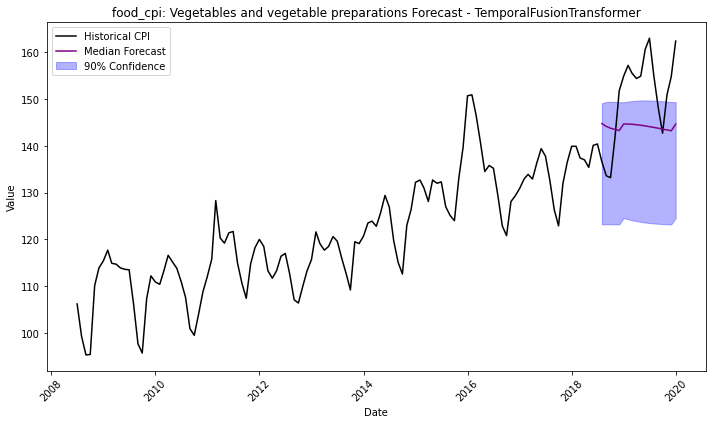

Beginning AutoGluon training... Time limit = 2s
AutoGluon will save models to './output/TEST/ag_global_all_TemporalFusionTransformerModel_exp2_GPT_P2_/random_seed_42/2018-07-01/model_files/'
=================== System Info ===================
AutoGluon Version:  1.1.1
Python Version:     3.8.20
Operating System:   Linux
Platform Machine:   x86_64
Platform Version:   #147~18.04.1-Ubuntu SMP Sat Oct 15 13:10:18 UTC 2022
CPU Count:          32
GPU Count:          1
Memory Avail:       166.84 GB / 188.57 GB (88.5%)
Disk Space Avail:   18207.91 GB / 249006.62 GB (7.3%)

Fitting with arguments:
{'enable_ensemble': True,
 'eval_metric': MAPE,
 'excluded_model_types': ['DirectTabular', 'RecursiveTabular'],
 'hyperparameters': {'TemporalFusionTransformerModel': {}},
 'known_covariates_names': [],
 'num_val_windows': 1,
 'prediction_length': 18,
 'quantile_levels': [0.01, 0.05, 0.1, 0.25, 0.75, 0.9, 0.95, 0.99],
 'random_seed': 42,
 'refit_every_n_windows': 1,
 'refit_full': False,
 'skip_model_

TemporalFusionTransformerModel


	-2.5024       = Validation score (-MAPE)
	2.14    s     = Training runtime
	0.04    s     = Validation (prediction) runtime
Not fitting ensemble due to lack of time remaining. Time left: -0.3 seconds
Training complete. Models trained: ['TemporalFusionTransformer']
Total runtime: 2.21 s
Best model: TemporalFusionTransformer
Best model score: -2.5024
Model not specified in predict, will default to the model with the best validation score: TemporalFusionTransformer
Model not specified in predict, will default to the model with the best validation score: TemporalFusionTransformer


****************** Summary of fit() ******************
Estimated performance of each model:
                       model  score_val  pred_time_val  fit_time_marginal  \
0  TemporalFusionTransformer   -2.50236       0.039299           2.140175   

   fit_order  
0          1  
Number of models trained: 1
Types of models trained:
{'MultiWindowBacktestingModel'}
****************** End of fit() summary ******************


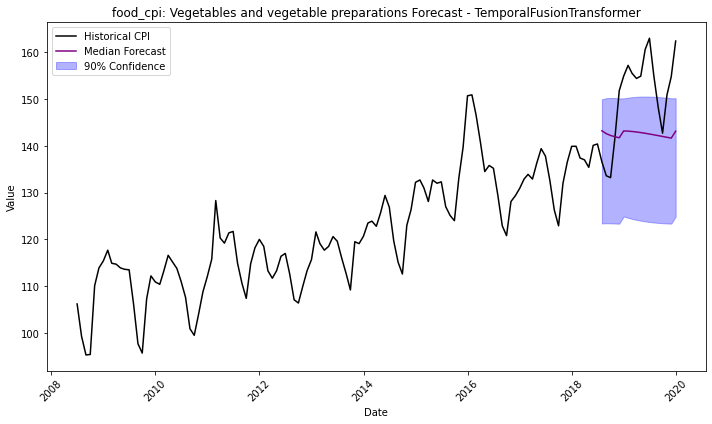

Beginning AutoGluon training... Time limit = 2s
AutoGluon will save models to './output/TEST/ag_global_all_TemporalFusionTransformerModel_exp2_GPT_P1_/random_seed_42/2018-07-01/model_files/'
=================== System Info ===================
AutoGluon Version:  1.1.1
Python Version:     3.8.20
Operating System:   Linux
Platform Machine:   x86_64
Platform Version:   #147~18.04.1-Ubuntu SMP Sat Oct 15 13:10:18 UTC 2022
CPU Count:          32
GPU Count:          1
Memory Avail:       166.69 GB / 188.57 GB (88.4%)
Disk Space Avail:   18207.89 GB / 249006.62 GB (7.3%)

Fitting with arguments:
{'enable_ensemble': True,
 'eval_metric': MAPE,
 'excluded_model_types': ['DirectTabular', 'RecursiveTabular'],
 'hyperparameters': {'TemporalFusionTransformerModel': {}},
 'known_covariates_names': [],
 'num_val_windows': 1,
 'prediction_length': 18,
 'quantile_levels': [0.01, 0.05, 0.1, 0.25, 0.75, 0.9, 0.95, 0.99],
 'random_seed': 42,
 'refit_every_n_windows': 1,
 'refit_full': False,
 'skip_model_

TemporalFusionTransformerModel


	-2.6767       = Validation score (-MAPE)
	2.14    s     = Training runtime
	0.05    s     = Validation (prediction) runtime
Not fitting ensemble due to lack of time remaining. Time left: -0.3 seconds
Training complete. Models trained: ['TemporalFusionTransformer']
Total runtime: 2.22 s
Best model: TemporalFusionTransformer
Best model score: -2.6767
Model not specified in predict, will default to the model with the best validation score: TemporalFusionTransformer
Model not specified in predict, will default to the model with the best validation score: TemporalFusionTransformer


****************** Summary of fit() ******************
Estimated performance of each model:
                       model  score_val  pred_time_val  fit_time_marginal  \
0  TemporalFusionTransformer  -2.676677       0.045296           2.139433   

   fit_order  
0          1  
Number of models trained: 1
Types of models trained:
{'MultiWindowBacktestingModel'}
****************** End of fit() summary ******************


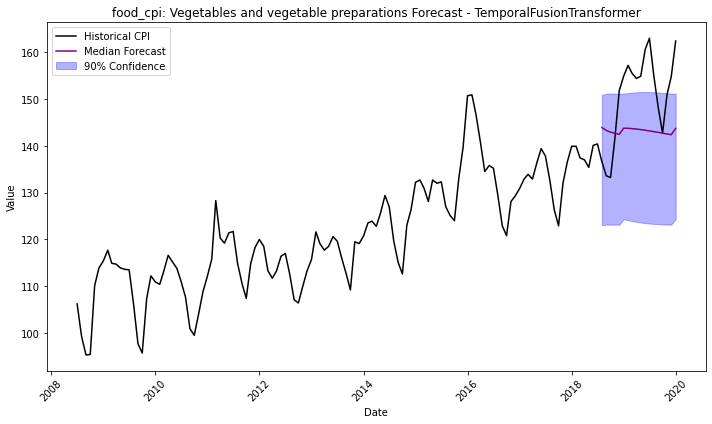

Beginning AutoGluon training... Time limit = 2s
AutoGluon will save models to './output/TEST/ag_global_all_TemporalFusionTransformerModel_exp2_R3_/random_seed_42/2018-07-01/model_files/'
=================== System Info ===================
AutoGluon Version:  1.1.1
Python Version:     3.8.20
Operating System:   Linux
Platform Machine:   x86_64
Platform Version:   #147~18.04.1-Ubuntu SMP Sat Oct 15 13:10:18 UTC 2022
CPU Count:          32
GPU Count:          1
Memory Avail:       166.70 GB / 188.57 GB (88.4%)
Disk Space Avail:   18207.89 GB / 249006.62 GB (7.3%)

Fitting with arguments:
{'enable_ensemble': True,
 'eval_metric': MAPE,
 'excluded_model_types': ['DirectTabular', 'RecursiveTabular'],
 'hyperparameters': {'TemporalFusionTransformerModel': {}},
 'known_covariates_names': [],
 'num_val_windows': 1,
 'prediction_length': 18,
 'quantile_levels': [0.01, 0.05, 0.1, 0.25, 0.75, 0.9, 0.95, 0.99],
 'random_seed': 42,
 'refit_every_n_windows': 1,
 'refit_full': False,
 'skip_model_sele

TemporalFusionTransformerModel


	-1.7263       = Validation score (-MAPE)
	2.20    s     = Training runtime
	0.06    s     = Validation (prediction) runtime
Not fitting ensemble due to lack of time remaining. Time left: -0.3 seconds
Training complete. Models trained: ['TemporalFusionTransformer']
Total runtime: 2.29 s
Best model: TemporalFusionTransformer
Best model score: -1.7263
Model not specified in predict, will default to the model with the best validation score: TemporalFusionTransformer
Model not specified in predict, will default to the model with the best validation score: TemporalFusionTransformer


****************** Summary of fit() ******************
Estimated performance of each model:
                       model  score_val  pred_time_val  fit_time_marginal  \
0  TemporalFusionTransformer  -1.726318       0.055332           2.195725   

   fit_order  
0          1  
Number of models trained: 1
Types of models trained:
{'MultiWindowBacktestingModel'}
****************** End of fit() summary ******************


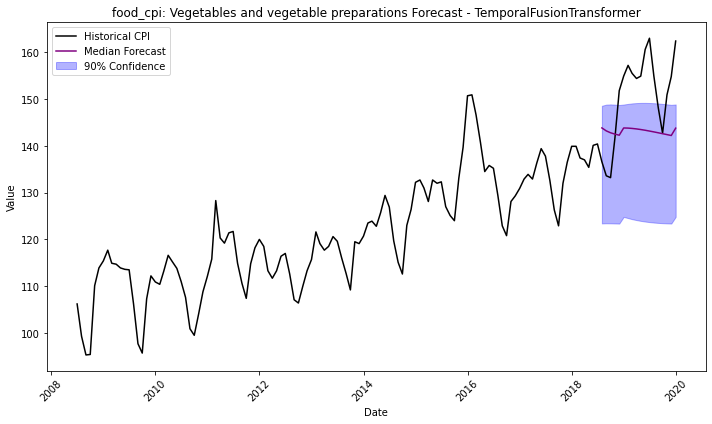

Beginning AutoGluon training... Time limit = 2s
AutoGluon will save models to './output/TEST/ag_global_all_TemporalFusionTransformerModel_exp2_GPT_P4_/random_seed_42/2018-07-01/model_files/'
=================== System Info ===================
AutoGluon Version:  1.1.1
Python Version:     3.8.20
Operating System:   Linux
Platform Machine:   x86_64
Platform Version:   #147~18.04.1-Ubuntu SMP Sat Oct 15 13:10:18 UTC 2022
CPU Count:          32
GPU Count:          1
Memory Avail:       166.67 GB / 188.57 GB (88.4%)
Disk Space Avail:   18207.91 GB / 249006.62 GB (7.3%)

Fitting with arguments:
{'enable_ensemble': True,
 'eval_metric': MAPE,
 'excluded_model_types': ['DirectTabular', 'RecursiveTabular'],
 'hyperparameters': {'TemporalFusionTransformerModel': {}},
 'known_covariates_names': [],
 'num_val_windows': 1,
 'prediction_length': 18,
 'quantile_levels': [0.01, 0.05, 0.1, 0.25, 0.75, 0.9, 0.95, 0.99],
 'random_seed': 42,
 'refit_every_n_windows': 1,
 'refit_full': False,
 'skip_model_

TemporalFusionTransformerModel


	-1.7063       = Validation score (-MAPE)
	2.46    s     = Training runtime
	0.04    s     = Validation (prediction) runtime
Not fitting ensemble due to lack of time remaining. Time left: -0.6 seconds
Training complete. Models trained: ['TemporalFusionTransformer']
Total runtime: 2.54 s
Best model: TemporalFusionTransformer
Best model score: -1.7063
Model not specified in predict, will default to the model with the best validation score: TemporalFusionTransformer
Model not specified in predict, will default to the model with the best validation score: TemporalFusionTransformer


****************** Summary of fit() ******************
Estimated performance of each model:
                       model  score_val  pred_time_val  fit_time_marginal  \
0  TemporalFusionTransformer  -1.706283       0.038821           2.459622   

   fit_order  
0          1  
Number of models trained: 1
Types of models trained:
{'MultiWindowBacktestingModel'}
****************** End of fit() summary ******************


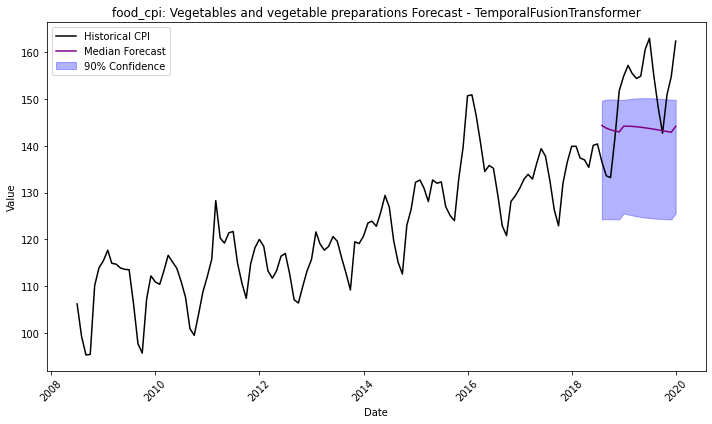

Beginning AutoGluon training... Time limit = 2s
AutoGluon will save models to './output/TEST/ag_global_all_TemporalFusionTransformerModel_exp2_GPT_P3_/random_seed_42/2019-07-01/model_files/'
=================== System Info ===================
AutoGluon Version:  1.1.1
Python Version:     3.8.20
Operating System:   Linux
Platform Machine:   x86_64
Platform Version:   #147~18.04.1-Ubuntu SMP Sat Oct 15 13:10:18 UTC 2022
CPU Count:          32
GPU Count:          1
Memory Avail:       166.69 GB / 188.57 GB (88.4%)
Disk Space Avail:   18207.93 GB / 249006.62 GB (7.3%)

Fitting with arguments:
{'enable_ensemble': True,
 'eval_metric': MAPE,
 'excluded_model_types': ['DirectTabular', 'RecursiveTabular'],
 'hyperparameters': {'TemporalFusionTransformerModel': {}},
 'known_covariates_names': [],
 'num_val_windows': 1,
 'prediction_length': 18,
 'quantile_levels': [0.01, 0.05, 0.1, 0.25, 0.75, 0.9, 0.95, 0.99],
 'random_seed': 42,
 'refit_every_n_windows': 1,
 'refit_full': False,
 'skip_model_

TemporalFusionTransformerModel


	-1.0594       = Validation score (-MAPE)
	2.14    s     = Training runtime
	0.04    s     = Validation (prediction) runtime
Not fitting ensemble due to lack of time remaining. Time left: -0.3 seconds
Training complete. Models trained: ['TemporalFusionTransformer']
Total runtime: 2.22 s
Best model: TemporalFusionTransformer
Best model score: -1.0594
Model not specified in predict, will default to the model with the best validation score: TemporalFusionTransformer
Model not specified in predict, will default to the model with the best validation score: TemporalFusionTransformer


****************** Summary of fit() ******************
Estimated performance of each model:
                       model  score_val  pred_time_val  fit_time_marginal  \
0  TemporalFusionTransformer  -1.059405       0.043221           2.140957   

   fit_order  
0          1  
Number of models trained: 1
Types of models trained:
{'MultiWindowBacktestingModel'}
****************** End of fit() summary ******************


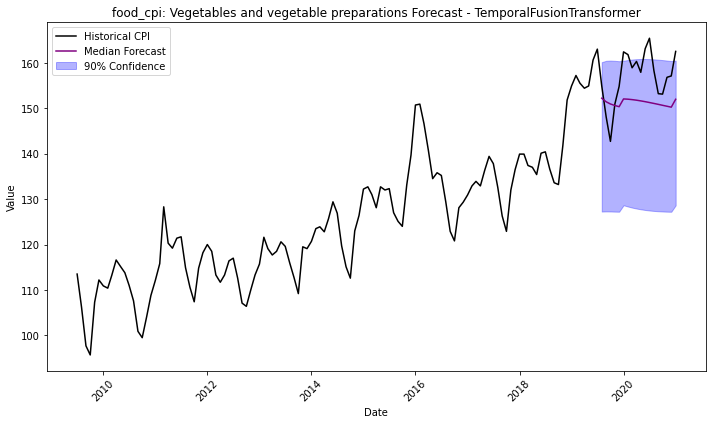

Beginning AutoGluon training... Time limit = 2s
AutoGluon will save models to './output/TEST/ag_global_all_TemporalFusionTransformerModel_exp2_R1_/random_seed_42/2019-07-01/model_files/'
=================== System Info ===================
AutoGluon Version:  1.1.1
Python Version:     3.8.20
Operating System:   Linux
Platform Machine:   x86_64
Platform Version:   #147~18.04.1-Ubuntu SMP Sat Oct 15 13:10:18 UTC 2022
CPU Count:          32
GPU Count:          1
Memory Avail:       166.78 GB / 188.57 GB (88.4%)
Disk Space Avail:   18207.92 GB / 249006.62 GB (7.3%)

Fitting with arguments:
{'enable_ensemble': True,
 'eval_metric': MAPE,
 'excluded_model_types': ['DirectTabular', 'RecursiveTabular'],
 'hyperparameters': {'TemporalFusionTransformerModel': {}},
 'known_covariates_names': [],
 'num_val_windows': 1,
 'prediction_length': 18,
 'quantile_levels': [0.01, 0.05, 0.1, 0.25, 0.75, 0.9, 0.95, 0.99],
 'random_seed': 42,
 'refit_every_n_windows': 1,
 'refit_full': False,
 'skip_model_sele

TemporalFusionTransformerModel


	-0.7653       = Validation score (-MAPE)
	2.14    s     = Training runtime
	0.04    s     = Validation (prediction) runtime
Not fitting ensemble due to lack of time remaining. Time left: -0.3 seconds
Training complete. Models trained: ['TemporalFusionTransformer']
Total runtime: 2.22 s
Best model: TemporalFusionTransformer
Best model score: -0.7653
Model not specified in predict, will default to the model with the best validation score: TemporalFusionTransformer
Model not specified in predict, will default to the model with the best validation score: TemporalFusionTransformer


****************** Summary of fit() ******************
Estimated performance of each model:
                       model  score_val  pred_time_val  fit_time_marginal  \
0  TemporalFusionTransformer  -0.765345       0.042201            2.13755   

   fit_order  
0          1  
Number of models trained: 1
Types of models trained:
{'MultiWindowBacktestingModel'}
****************** End of fit() summary ******************


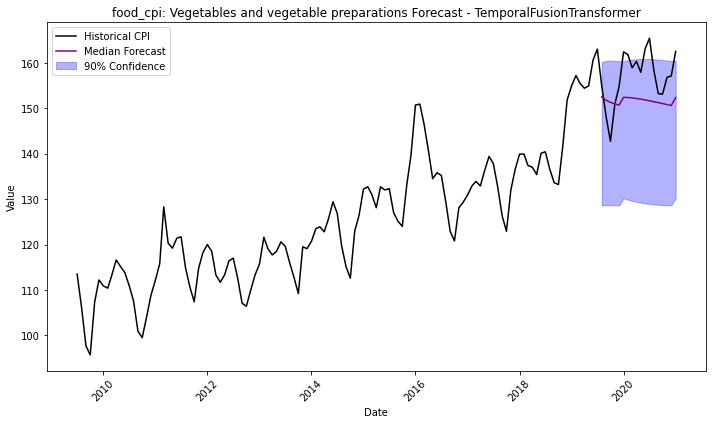

Beginning AutoGluon training... Time limit = 2s
AutoGluon will save models to './output/TEST/ag_global_all_TemporalFusionTransformerModel_exp2_R4_/random_seed_42/2019-07-01/model_files/'
=================== System Info ===================
AutoGluon Version:  1.1.1
Python Version:     3.8.20
Operating System:   Linux
Platform Machine:   x86_64
Platform Version:   #147~18.04.1-Ubuntu SMP Sat Oct 15 13:10:18 UTC 2022
CPU Count:          32
GPU Count:          1
Memory Avail:       166.67 GB / 188.57 GB (88.4%)
Disk Space Avail:   18207.59 GB / 249006.62 GB (7.3%)

Fitting with arguments:
{'enable_ensemble': True,
 'eval_metric': MAPE,
 'excluded_model_types': ['DirectTabular', 'RecursiveTabular'],
 'hyperparameters': {'TemporalFusionTransformerModel': {}},
 'known_covariates_names': [],
 'num_val_windows': 1,
 'prediction_length': 18,
 'quantile_levels': [0.01, 0.05, 0.1, 0.25, 0.75, 0.9, 0.95, 0.99],
 'random_seed': 42,
 'refit_every_n_windows': 1,
 'refit_full': False,
 'skip_model_sele

TemporalFusionTransformerModel


	-0.5634       = Validation score (-MAPE)
	2.14    s     = Training runtime
	0.04    s     = Validation (prediction) runtime
Not fitting ensemble due to lack of time remaining. Time left: -0.3 seconds
Training complete. Models trained: ['TemporalFusionTransformer']
Total runtime: 2.22 s
Best model: TemporalFusionTransformer
Best model score: -0.5634
Model not specified in predict, will default to the model with the best validation score: TemporalFusionTransformer
Model not specified in predict, will default to the model with the best validation score: TemporalFusionTransformer


****************** Summary of fit() ******************
Estimated performance of each model:
                       model  score_val  pred_time_val  fit_time_marginal  \
0  TemporalFusionTransformer  -0.563434       0.042599           2.141078   

   fit_order  
0          1  
Number of models trained: 1
Types of models trained:
{'MultiWindowBacktestingModel'}
****************** End of fit() summary ******************


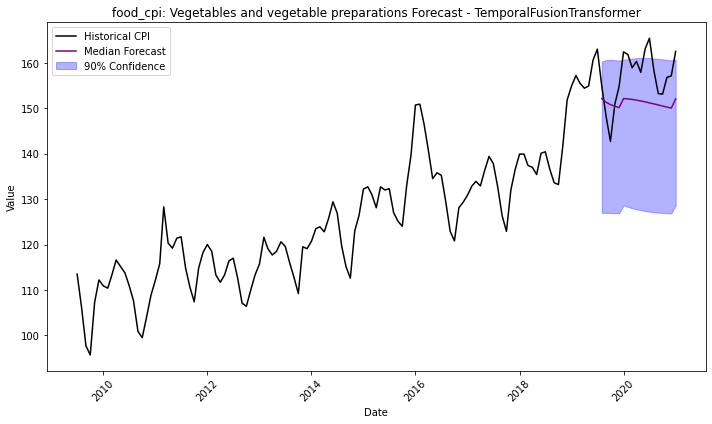

Beginning AutoGluon training... Time limit = 2s
AutoGluon will save models to './output/TEST/ag_global_all_TemporalFusionTransformerModel_exp2_R2_/random_seed_42/2019-07-01/model_files/'
=================== System Info ===================
AutoGluon Version:  1.1.1
Python Version:     3.8.20
Operating System:   Linux
Platform Machine:   x86_64
Platform Version:   #147~18.04.1-Ubuntu SMP Sat Oct 15 13:10:18 UTC 2022
CPU Count:          32
GPU Count:          1
Memory Avail:       166.78 GB / 188.57 GB (88.4%)
Disk Space Avail:   18206.71 GB / 249006.62 GB (7.3%)

Fitting with arguments:
{'enable_ensemble': True,
 'eval_metric': MAPE,
 'excluded_model_types': ['DirectTabular', 'RecursiveTabular'],
 'hyperparameters': {'TemporalFusionTransformerModel': {}},
 'known_covariates_names': [],
 'num_val_windows': 1,
 'prediction_length': 18,
 'quantile_levels': [0.01, 0.05, 0.1, 0.25, 0.75, 0.9, 0.95, 0.99],
 'random_seed': 42,
 'refit_every_n_windows': 1,
 'refit_full': False,
 'skip_model_sele

TemporalFusionTransformerModel


	-0.3725       = Validation score (-MAPE)
	2.08    s     = Training runtime
	0.05    s     = Validation (prediction) runtime
Not fitting ensemble due to lack of time remaining. Time left: -0.3 seconds
Training complete. Models trained: ['TemporalFusionTransformer']
Total runtime: 2.17 s
Best model: TemporalFusionTransformer
Best model score: -0.3725
Model not specified in predict, will default to the model with the best validation score: TemporalFusionTransformer


****************** Summary of fit() ******************
Estimated performance of each model:
                       model  score_val  pred_time_val  fit_time_marginal  \
0  TemporalFusionTransformer  -0.372518       0.045527           2.084671   

   fit_order  
0          1  
Number of models trained: 1
Types of models trained:
{'MultiWindowBacktestingModel'}
****************** End of fit() summary ******************


Model not specified in predict, will default to the model with the best validation score: TemporalFusionTransformer


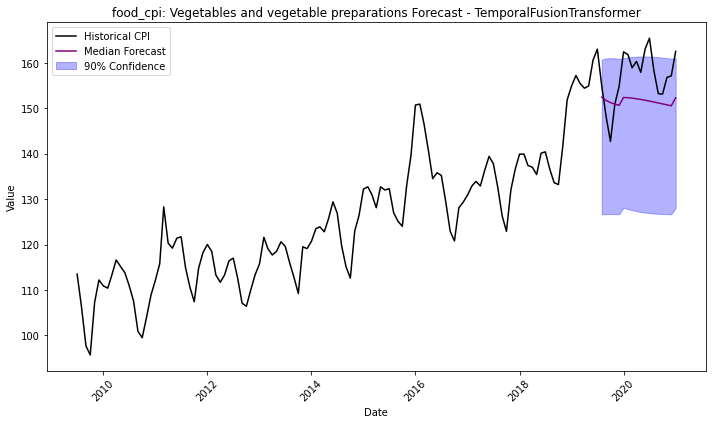

Beginning AutoGluon training... Time limit = 2s
AutoGluon will save models to './output/TEST/ag_global_all_TemporalFusionTransformerModel_exp2_GPT_P2_/random_seed_42/2019-07-01/model_files/'
=================== System Info ===================
AutoGluon Version:  1.1.1
Python Version:     3.8.20
Operating System:   Linux
Platform Machine:   x86_64
Platform Version:   #147~18.04.1-Ubuntu SMP Sat Oct 15 13:10:18 UTC 2022
CPU Count:          32
GPU Count:          1
Memory Avail:       166.67 GB / 188.57 GB (88.4%)
Disk Space Avail:   18206.75 GB / 249006.62 GB (7.3%)

Fitting with arguments:
{'enable_ensemble': True,
 'eval_metric': MAPE,
 'excluded_model_types': ['DirectTabular', 'RecursiveTabular'],
 'hyperparameters': {'TemporalFusionTransformerModel': {}},
 'known_covariates_names': [],
 'num_val_windows': 1,
 'prediction_length': 18,
 'quantile_levels': [0.01, 0.05, 0.1, 0.25, 0.75, 0.9, 0.95, 0.99],
 'random_seed': 42,
 'refit_every_n_windows': 1,
 'refit_full': False,
 'skip_model_

TemporalFusionTransformerModel


	-1.1273       = Validation score (-MAPE)
	2.12    s     = Training runtime
	0.04    s     = Validation (prediction) runtime
Not fitting ensemble due to lack of time remaining. Time left: -0.2 seconds
Training complete. Models trained: ['TemporalFusionTransformer']
Total runtime: 2.20 s
Best model: TemporalFusionTransformer
Best model score: -1.1273
Model not specified in predict, will default to the model with the best validation score: TemporalFusionTransformer
Model not specified in predict, will default to the model with the best validation score: TemporalFusionTransformer


****************** Summary of fit() ******************
Estimated performance of each model:
                       model  score_val  pred_time_val  fit_time_marginal  \
0  TemporalFusionTransformer  -1.127299       0.039784           2.121041   

   fit_order  
0          1  
Number of models trained: 1
Types of models trained:
{'MultiWindowBacktestingModel'}
****************** End of fit() summary ******************


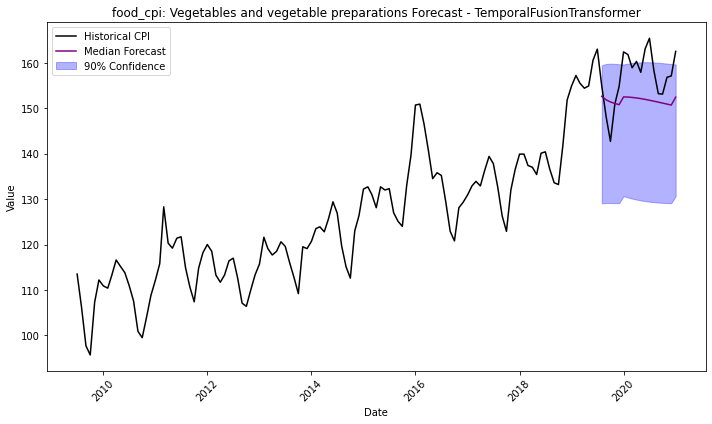

Beginning AutoGluon training... Time limit = 2s
AutoGluon will save models to './output/TEST/ag_global_all_TemporalFusionTransformerModel_exp2_GPT_P1_/random_seed_42/2019-07-01/model_files/'
=================== System Info ===================
AutoGluon Version:  1.1.1
Python Version:     3.8.20
Operating System:   Linux
Platform Machine:   x86_64
Platform Version:   #147~18.04.1-Ubuntu SMP Sat Oct 15 13:10:18 UTC 2022
CPU Count:          32
GPU Count:          1
Memory Avail:       166.67 GB / 188.57 GB (88.4%)
Disk Space Avail:   18206.75 GB / 249006.62 GB (7.3%)

Fitting with arguments:
{'enable_ensemble': True,
 'eval_metric': MAPE,
 'excluded_model_types': ['DirectTabular', 'RecursiveTabular'],
 'hyperparameters': {'TemporalFusionTransformerModel': {}},
 'known_covariates_names': [],
 'num_val_windows': 1,
 'prediction_length': 18,
 'quantile_levels': [0.01, 0.05, 0.1, 0.25, 0.75, 0.9, 0.95, 0.99],
 'random_seed': 42,
 'refit_every_n_windows': 1,
 'refit_full': False,
 'skip_model_

TemporalFusionTransformerModel


	-1.0571       = Validation score (-MAPE)
	2.13    s     = Training runtime
	0.04    s     = Validation (prediction) runtime
Not fitting ensemble due to lack of time remaining. Time left: -0.3 seconds
Training complete. Models trained: ['TemporalFusionTransformer']
Total runtime: 2.21 s
Best model: TemporalFusionTransformer
Best model score: -1.0571
Model not specified in predict, will default to the model with the best validation score: TemporalFusionTransformer
Model not specified in predict, will default to the model with the best validation score: TemporalFusionTransformer


****************** Summary of fit() ******************
Estimated performance of each model:
                       model  score_val  pred_time_val  fit_time_marginal  \
0  TemporalFusionTransformer  -1.057118       0.042482           2.128442   

   fit_order  
0          1  
Number of models trained: 1
Types of models trained:
{'MultiWindowBacktestingModel'}
****************** End of fit() summary ******************


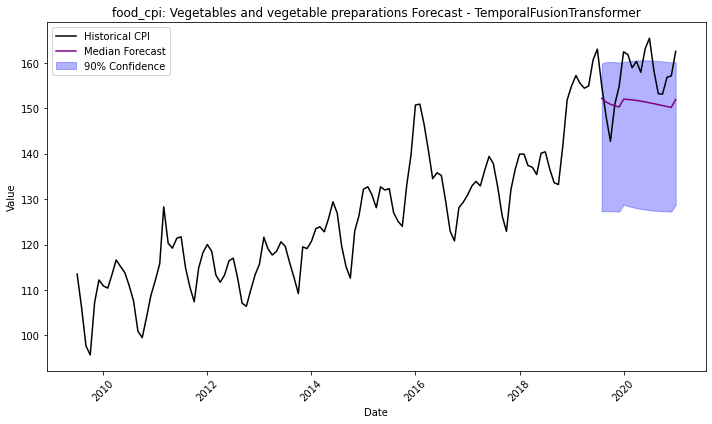

Beginning AutoGluon training... Time limit = 2s
AutoGluon will save models to './output/TEST/ag_global_all_TemporalFusionTransformerModel_exp2_R3_/random_seed_42/2019-07-01/model_files/'
=================== System Info ===================
AutoGluon Version:  1.1.1
Python Version:     3.8.20
Operating System:   Linux
Platform Machine:   x86_64
Platform Version:   #147~18.04.1-Ubuntu SMP Sat Oct 15 13:10:18 UTC 2022
CPU Count:          32
GPU Count:          1
Memory Avail:       166.67 GB / 188.57 GB (88.4%)
Disk Space Avail:   18206.74 GB / 249006.62 GB (7.3%)

Fitting with arguments:
{'enable_ensemble': True,
 'eval_metric': MAPE,
 'excluded_model_types': ['DirectTabular', 'RecursiveTabular'],
 'hyperparameters': {'TemporalFusionTransformerModel': {}},
 'known_covariates_names': [],
 'num_val_windows': 1,
 'prediction_length': 18,
 'quantile_levels': [0.01, 0.05, 0.1, 0.25, 0.75, 0.9, 0.95, 0.99],
 'random_seed': 42,
 'refit_every_n_windows': 1,
 'refit_full': False,
 'skip_model_sele

TemporalFusionTransformerModel


	-0.7260       = Validation score (-MAPE)
	2.11    s     = Training runtime
	0.05    s     = Validation (prediction) runtime
Not fitting ensemble due to lack of time remaining. Time left: -0.3 seconds
Training complete. Models trained: ['TemporalFusionTransformer']
Total runtime: 2.20 s
Best model: TemporalFusionTransformer
Best model score: -0.7260
Model not specified in predict, will default to the model with the best validation score: TemporalFusionTransformer
Model not specified in predict, will default to the model with the best validation score: TemporalFusionTransformer


****************** Summary of fit() ******************
Estimated performance of each model:
                       model  score_val  pred_time_val  fit_time_marginal  \
0  TemporalFusionTransformer   -0.72602       0.047826           2.114957   

   fit_order  
0          1  
Number of models trained: 1
Types of models trained:
{'MultiWindowBacktestingModel'}
****************** End of fit() summary ******************


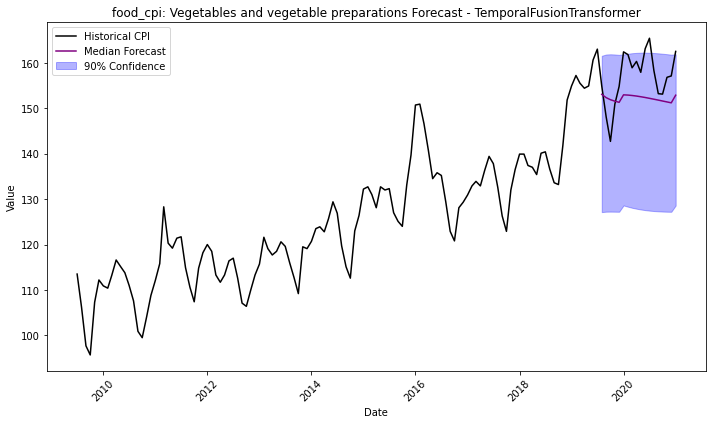

Beginning AutoGluon training... Time limit = 2s
AutoGluon will save models to './output/TEST/ag_global_all_TemporalFusionTransformerModel_exp2_GPT_P4_/random_seed_42/2019-07-01/model_files/'
=================== System Info ===================
AutoGluon Version:  1.1.1
Python Version:     3.8.20
Operating System:   Linux
Platform Machine:   x86_64
Platform Version:   #147~18.04.1-Ubuntu SMP Sat Oct 15 13:10:18 UTC 2022
CPU Count:          32
GPU Count:          1
Memory Avail:       166.67 GB / 188.57 GB (88.4%)
Disk Space Avail:   18206.73 GB / 249006.62 GB (7.3%)

Fitting with arguments:
{'enable_ensemble': True,
 'eval_metric': MAPE,
 'excluded_model_types': ['DirectTabular', 'RecursiveTabular'],
 'hyperparameters': {'TemporalFusionTransformerModel': {}},
 'known_covariates_names': [],
 'num_val_windows': 1,
 'prediction_length': 18,
 'quantile_levels': [0.01, 0.05, 0.1, 0.25, 0.75, 0.9, 0.95, 0.99],
 'random_seed': 42,
 'refit_every_n_windows': 1,
 'refit_full': False,
 'skip_model_

TemporalFusionTransformerModel


	-0.7211       = Validation score (-MAPE)
	2.13    s     = Training runtime
	0.04    s     = Validation (prediction) runtime
Not fitting ensemble due to lack of time remaining. Time left: -0.3 seconds
Training complete. Models trained: ['TemporalFusionTransformer']
Total runtime: 2.21 s
Best model: TemporalFusionTransformer
Best model score: -0.7211
Model not specified in predict, will default to the model with the best validation score: TemporalFusionTransformer
Model not specified in predict, will default to the model with the best validation score: TemporalFusionTransformer


****************** Summary of fit() ******************
Estimated performance of each model:
                       model  score_val  pred_time_val  fit_time_marginal  \
0  TemporalFusionTransformer  -0.721147       0.040359           2.134349   

   fit_order  
0          1  
Number of models trained: 1
Types of models trained:
{'MultiWindowBacktestingModel'}
****************** End of fit() summary ******************


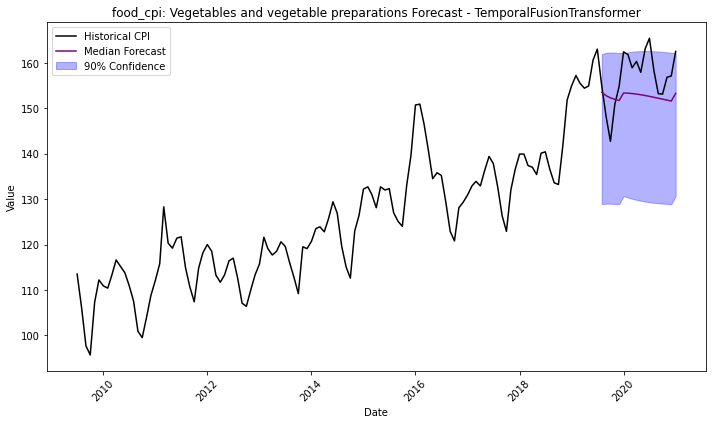

Beginning AutoGluon training... Time limit = 2s
AutoGluon will save models to './output/TEST/ag_global_all_TemporalFusionTransformerModel_exp2_GPT_P3_/random_seed_42/2020-07-01/model_files/'
=================== System Info ===================
AutoGluon Version:  1.1.1
Python Version:     3.8.20
Operating System:   Linux
Platform Machine:   x86_64
Platform Version:   #147~18.04.1-Ubuntu SMP Sat Oct 15 13:10:18 UTC 2022
CPU Count:          32
GPU Count:          1
Memory Avail:       166.67 GB / 188.57 GB (88.4%)
Disk Space Avail:   18206.78 GB / 249006.62 GB (7.3%)

Fitting with arguments:
{'enable_ensemble': True,
 'eval_metric': MAPE,
 'excluded_model_types': ['DirectTabular', 'RecursiveTabular'],
 'hyperparameters': {'TemporalFusionTransformerModel': {}},
 'known_covariates_names': [],
 'num_val_windows': 1,
 'prediction_length': 18,
 'quantile_levels': [0.01, 0.05, 0.1, 0.25, 0.75, 0.9, 0.95, 0.99],
 'random_seed': 42,
 'refit_every_n_windows': 1,
 'refit_full': False,
 'skip_model_

TemporalFusionTransformerModel


	-0.8464       = Validation score (-MAPE)
	2.11    s     = Training runtime
	0.04    s     = Validation (prediction) runtime
Not fitting ensemble due to lack of time remaining. Time left: -0.2 seconds
Training complete. Models trained: ['TemporalFusionTransformer']
Total runtime: 2.19 s
Best model: TemporalFusionTransformer
Best model score: -0.8464
Model not specified in predict, will default to the model with the best validation score: TemporalFusionTransformer
Model not specified in predict, will default to the model with the best validation score: TemporalFusionTransformer


****************** Summary of fit() ******************
Estimated performance of each model:
                       model  score_val  pred_time_val  fit_time_marginal  \
0  TemporalFusionTransformer  -0.846429       0.043145           2.110954   

   fit_order  
0          1  
Number of models trained: 1
Types of models trained:
{'MultiWindowBacktestingModel'}
****************** End of fit() summary ******************


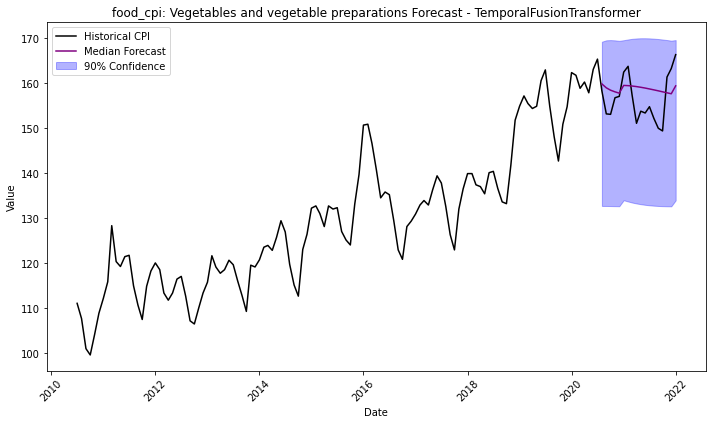

Beginning AutoGluon training... Time limit = 2s
AutoGluon will save models to './output/TEST/ag_global_all_TemporalFusionTransformerModel_exp2_R1_/random_seed_42/2020-07-01/model_files/'
=================== System Info ===================
AutoGluon Version:  1.1.1
Python Version:     3.8.20
Operating System:   Linux
Platform Machine:   x86_64
Platform Version:   #147~18.04.1-Ubuntu SMP Sat Oct 15 13:10:18 UTC 2022
CPU Count:          32
GPU Count:          1
Memory Avail:       166.67 GB / 188.57 GB (88.4%)
Disk Space Avail:   18206.77 GB / 249006.62 GB (7.3%)

Fitting with arguments:
{'enable_ensemble': True,
 'eval_metric': MAPE,
 'excluded_model_types': ['DirectTabular', 'RecursiveTabular'],
 'hyperparameters': {'TemporalFusionTransformerModel': {}},
 'known_covariates_names': [],
 'num_val_windows': 1,
 'prediction_length': 18,
 'quantile_levels': [0.01, 0.05, 0.1, 0.25, 0.75, 0.9, 0.95, 0.99],
 'random_seed': 42,
 'refit_every_n_windows': 1,
 'refit_full': False,
 'skip_model_sele

TemporalFusionTransformerModel


Inferred time series frequency: 'MS'
Provided train_data has 9130 rows (NaN fraction=0.0%), 22 time series. Median time series length is 415 (min=415, max=415). 

Provided data contains following columns:
	target: 'target'

AutoGluon will gauge predictive performance using evaluation metric: 'MAPE'
	This metric's sign has been flipped to adhere to being higher_is_better. The metric score can be multiplied by -1 to get the metric value.

Starting training. Start time is 2024-10-27 07:47:51
Excluded model types: ['DirectTabular', 'RecursiveTabular']
Models that will be trained: ['TemporalFusionTransformer']
Training timeseries model TemporalFusionTransformer. Training for up to 1.6s of the 1.6s of remaining time.
	-2.5542       = Validation score (-MAPE)
	1.85    s     = Training runtime
	0.04    s     = Validation (prediction) runtime
Not fitting ensemble due to lack of time remaining. Time left: -0.3 seconds
Training complete. Models trained: ['TemporalFusionTransformer']
Total runtime

****************** Summary of fit() ******************
Estimated performance of each model:
                       model  score_val  pred_time_val  fit_time_marginal  \
0  TemporalFusionTransformer  -2.554188       0.043635           1.845929   

   fit_order  
0          1  
Number of models trained: 1
Types of models trained:
{'MultiWindowBacktestingModel'}
****************** End of fit() summary ******************


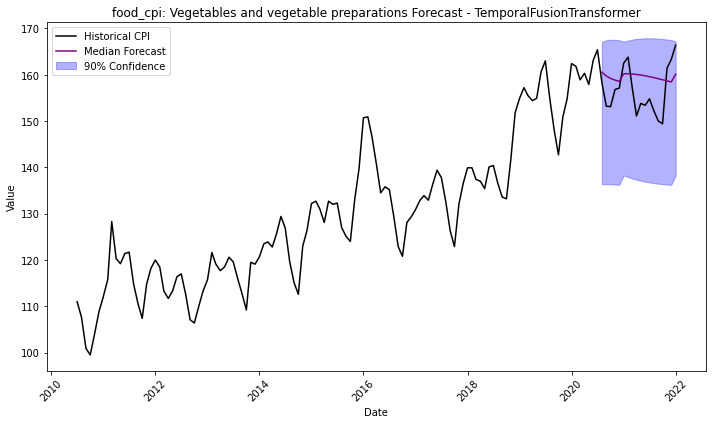

Beginning AutoGluon training... Time limit = 2s
AutoGluon will save models to './output/TEST/ag_global_all_TemporalFusionTransformerModel_exp2_R4_/random_seed_42/2020-07-01/model_files/'
=================== System Info ===================
AutoGluon Version:  1.1.1
Python Version:     3.8.20
Operating System:   Linux
Platform Machine:   x86_64
Platform Version:   #147~18.04.1-Ubuntu SMP Sat Oct 15 13:10:18 UTC 2022
CPU Count:          32
GPU Count:          1
Memory Avail:       166.71 GB / 188.57 GB (88.4%)
Disk Space Avail:   18206.75 GB / 249006.62 GB (7.3%)

Fitting with arguments:
{'enable_ensemble': True,
 'eval_metric': MAPE,
 'excluded_model_types': ['DirectTabular', 'RecursiveTabular'],
 'hyperparameters': {'TemporalFusionTransformerModel': {}},
 'known_covariates_names': [],
 'num_val_windows': 1,
 'prediction_length': 18,
 'quantile_levels': [0.01, 0.05, 0.1, 0.25, 0.75, 0.9, 0.95, 0.99],
 'random_seed': 42,
 'refit_every_n_windows': 1,
 'refit_full': False,
 'skip_model_sele

TemporalFusionTransformerModel


	-0.5350       = Validation score (-MAPE)
	2.13    s     = Training runtime
	0.04    s     = Validation (prediction) runtime
Not fitting ensemble due to lack of time remaining. Time left: -0.3 seconds
Training complete. Models trained: ['TemporalFusionTransformer']
Total runtime: 2.22 s
Best model: TemporalFusionTransformer
Best model score: -0.5350
Model not specified in predict, will default to the model with the best validation score: TemporalFusionTransformer
Model not specified in predict, will default to the model with the best validation score: TemporalFusionTransformer


****************** Summary of fit() ******************
Estimated performance of each model:
                       model  score_val  pred_time_val  fit_time_marginal  \
0  TemporalFusionTransformer  -0.534951       0.042234           2.131387   

   fit_order  
0          1  
Number of models trained: 1
Types of models trained:
{'MultiWindowBacktestingModel'}
****************** End of fit() summary ******************


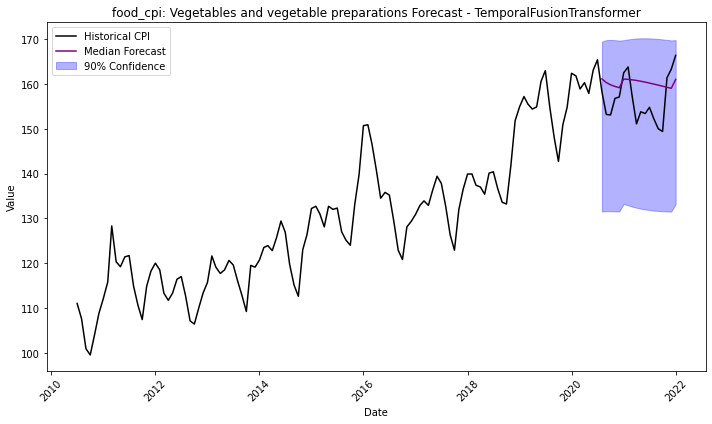

Beginning AutoGluon training... Time limit = 2s
AutoGluon will save models to './output/TEST/ag_global_all_TemporalFusionTransformerModel_exp2_R2_/random_seed_42/2020-07-01/model_files/'
=================== System Info ===================
AutoGluon Version:  1.1.1
Python Version:     3.8.20
Operating System:   Linux
Platform Machine:   x86_64
Platform Version:   #147~18.04.1-Ubuntu SMP Sat Oct 15 13:10:18 UTC 2022
CPU Count:          32
GPU Count:          1
Memory Avail:       166.75 GB / 188.57 GB (88.4%)
Disk Space Avail:   18206.74 GB / 249006.62 GB (7.3%)

Fitting with arguments:
{'enable_ensemble': True,
 'eval_metric': MAPE,
 'excluded_model_types': ['DirectTabular', 'RecursiveTabular'],
 'hyperparameters': {'TemporalFusionTransformerModel': {}},
 'known_covariates_names': [],
 'num_val_windows': 1,
 'prediction_length': 18,
 'quantile_levels': [0.01, 0.05, 0.1, 0.25, 0.75, 0.9, 0.95, 0.99],
 'random_seed': 42,
 'refit_every_n_windows': 1,
 'refit_full': False,
 'skip_model_sele

TemporalFusionTransformerModel


	-0.3753       = Validation score (-MAPE)
	2.11    s     = Training runtime
	0.04    s     = Validation (prediction) runtime
Not fitting ensemble due to lack of time remaining. Time left: -0.3 seconds
Training complete. Models trained: ['TemporalFusionTransformer']
Total runtime: 2.20 s
Best model: TemporalFusionTransformer
Best model score: -0.3753
Model not specified in predict, will default to the model with the best validation score: TemporalFusionTransformer
Model not specified in predict, will default to the model with the best validation score: TemporalFusionTransformer


****************** Summary of fit() ******************
Estimated performance of each model:
                       model  score_val  pred_time_val  fit_time_marginal  \
0  TemporalFusionTransformer  -0.375285         0.0415           2.114311   

   fit_order  
0          1  
Number of models trained: 1
Types of models trained:
{'MultiWindowBacktestingModel'}
****************** End of fit() summary ******************


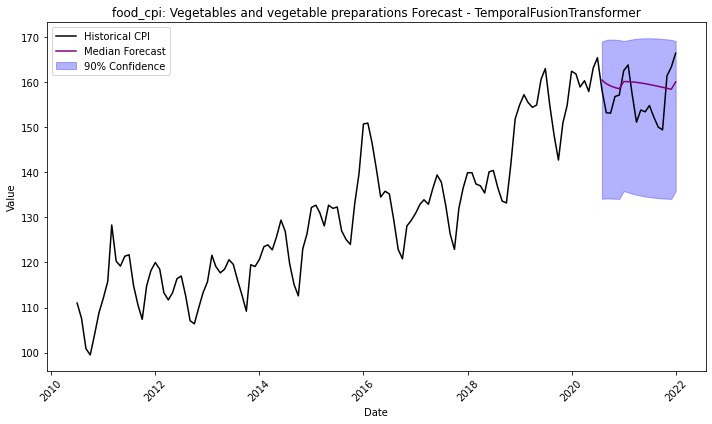

Beginning AutoGluon training... Time limit = 2s
AutoGluon will save models to './output/TEST/ag_global_all_TemporalFusionTransformerModel_exp2_GPT_P2_/random_seed_42/2020-07-01/model_files/'
=================== System Info ===================
AutoGluon Version:  1.1.1
Python Version:     3.8.20
Operating System:   Linux
Platform Machine:   x86_64
Platform Version:   #147~18.04.1-Ubuntu SMP Sat Oct 15 13:10:18 UTC 2022
CPU Count:          32
GPU Count:          1
Memory Avail:       166.67 GB / 188.57 GB (88.4%)
Disk Space Avail:   18206.73 GB / 249006.62 GB (7.3%)

Fitting with arguments:
{'enable_ensemble': True,
 'eval_metric': MAPE,
 'excluded_model_types': ['DirectTabular', 'RecursiveTabular'],
 'hyperparameters': {'TemporalFusionTransformerModel': {}},
 'known_covariates_names': [],
 'num_val_windows': 1,
 'prediction_length': 18,
 'quantile_levels': [0.01, 0.05, 0.1, 0.25, 0.75, 0.9, 0.95, 0.99],
 'random_seed': 42,
 'refit_every_n_windows': 1,
 'refit_full': False,
 'skip_model_

TemporalFusionTransformerModel


	-0.9872       = Validation score (-MAPE)
	2.14    s     = Training runtime
	0.04    s     = Validation (prediction) runtime
Not fitting ensemble due to lack of time remaining. Time left: -0.3 seconds
Training complete. Models trained: ['TemporalFusionTransformer']
Total runtime: 2.21 s
Best model: TemporalFusionTransformer
Best model score: -0.9872
Model not specified in predict, will default to the model with the best validation score: TemporalFusionTransformer
Model not specified in predict, will default to the model with the best validation score: TemporalFusionTransformer


****************** Summary of fit() ******************
Estimated performance of each model:
                       model  score_val  pred_time_val  fit_time_marginal  \
0  TemporalFusionTransformer  -0.987217        0.04049           2.138557   

   fit_order  
0          1  
Number of models trained: 1
Types of models trained:
{'MultiWindowBacktestingModel'}
****************** End of fit() summary ******************


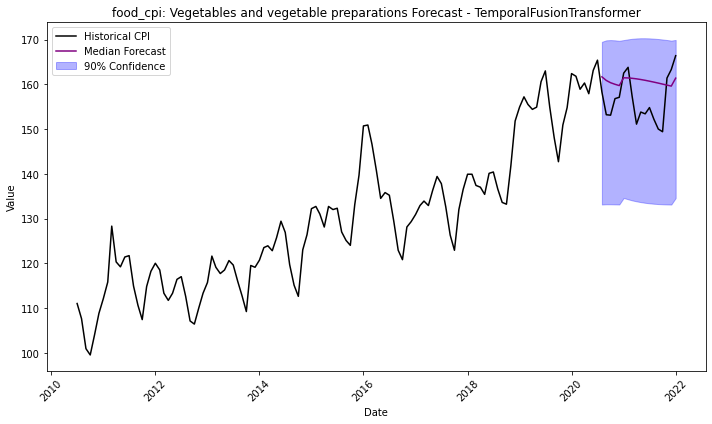

Beginning AutoGluon training... Time limit = 2s
AutoGluon will save models to './output/TEST/ag_global_all_TemporalFusionTransformerModel_exp2_GPT_P1_/random_seed_42/2020-07-01/model_files/'
=================== System Info ===================
AutoGluon Version:  1.1.1
Python Version:     3.8.20
Operating System:   Linux
Platform Machine:   x86_64
Platform Version:   #147~18.04.1-Ubuntu SMP Sat Oct 15 13:10:18 UTC 2022
CPU Count:          32
GPU Count:          1
Memory Avail:       166.67 GB / 188.57 GB (88.4%)
Disk Space Avail:   18206.73 GB / 249006.62 GB (7.3%)

Fitting with arguments:
{'enable_ensemble': True,
 'eval_metric': MAPE,
 'excluded_model_types': ['DirectTabular', 'RecursiveTabular'],
 'hyperparameters': {'TemporalFusionTransformerModel': {}},
 'known_covariates_names': [],
 'num_val_windows': 1,
 'prediction_length': 18,
 'quantile_levels': [0.01, 0.05, 0.1, 0.25, 0.75, 0.9, 0.95, 0.99],
 'random_seed': 42,
 'refit_every_n_windows': 1,
 'refit_full': False,
 'skip_model_

TemporalFusionTransformerModel


	-0.8372       = Validation score (-MAPE)
	2.14    s     = Training runtime
	0.04    s     = Validation (prediction) runtime
Not fitting ensemble due to lack of time remaining. Time left: -0.3 seconds
Training complete. Models trained: ['TemporalFusionTransformer']
Total runtime: 2.23 s
Best model: TemporalFusionTransformer
Best model score: -0.8372
Model not specified in predict, will default to the model with the best validation score: TemporalFusionTransformer
Model not specified in predict, will default to the model with the best validation score: TemporalFusionTransformer


****************** Summary of fit() ******************
Estimated performance of each model:
                       model  score_val  pred_time_val  fit_time_marginal  \
0  TemporalFusionTransformer  -0.837175       0.043136           2.142779   

   fit_order  
0          1  
Number of models trained: 1
Types of models trained:
{'MultiWindowBacktestingModel'}
****************** End of fit() summary ******************


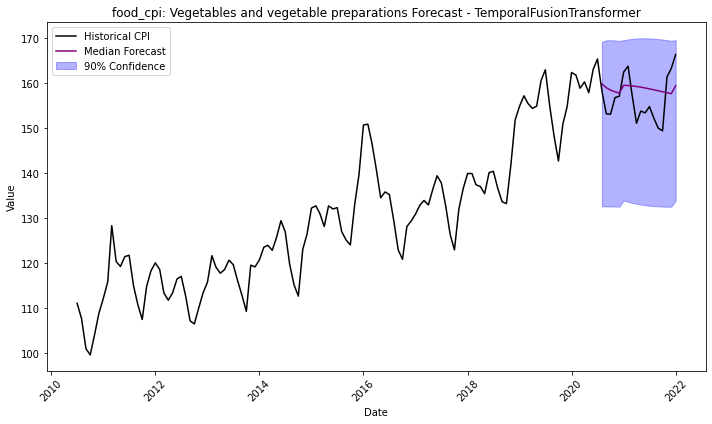

Beginning AutoGluon training... Time limit = 2s
AutoGluon will save models to './output/TEST/ag_global_all_TemporalFusionTransformerModel_exp2_R3_/random_seed_42/2020-07-01/model_files/'
=================== System Info ===================
AutoGluon Version:  1.1.1
Python Version:     3.8.20
Operating System:   Linux
Platform Machine:   x86_64
Platform Version:   #147~18.04.1-Ubuntu SMP Sat Oct 15 13:10:18 UTC 2022
CPU Count:          32
GPU Count:          1
Memory Avail:       166.67 GB / 188.57 GB (88.4%)
Disk Space Avail:   18206.72 GB / 249006.62 GB (7.3%)

Fitting with arguments:
{'enable_ensemble': True,
 'eval_metric': MAPE,
 'excluded_model_types': ['DirectTabular', 'RecursiveTabular'],
 'hyperparameters': {'TemporalFusionTransformerModel': {}},
 'known_covariates_names': [],
 'num_val_windows': 1,
 'prediction_length': 18,
 'quantile_levels': [0.01, 0.05, 0.1, 0.25, 0.75, 0.9, 0.95, 0.99],
 'random_seed': 42,
 'refit_every_n_windows': 1,
 'refit_full': False,
 'skip_model_sele

TemporalFusionTransformerModel


	-0.5794       = Validation score (-MAPE)
	2.13    s     = Training runtime
	0.04    s     = Validation (prediction) runtime
Not fitting ensemble due to lack of time remaining. Time left: -0.6 seconds
Training complete. Models trained: ['TemporalFusionTransformer']
Total runtime: 2.51 s
Best model: TemporalFusionTransformer
Best model score: -0.5794
Model not specified in predict, will default to the model with the best validation score: TemporalFusionTransformer
Model not specified in predict, will default to the model with the best validation score: TemporalFusionTransformer


****************** Summary of fit() ******************
Estimated performance of each model:
                       model  score_val  pred_time_val  fit_time_marginal  \
0  TemporalFusionTransformer  -0.579425       0.044076            2.12972   

   fit_order  
0          1  
Number of models trained: 1
Types of models trained:
{'MultiWindowBacktestingModel'}
****************** End of fit() summary ******************


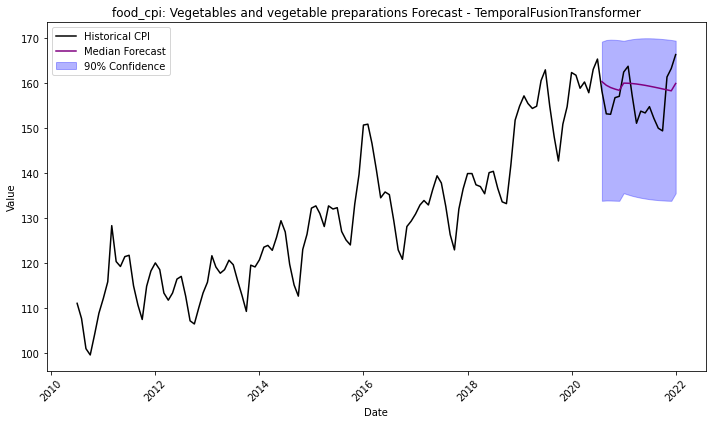

Beginning AutoGluon training... Time limit = 2s
AutoGluon will save models to './output/TEST/ag_global_all_TemporalFusionTransformerModel_exp2_GPT_P4_/random_seed_42/2020-07-01/model_files/'
=================== System Info ===================
AutoGluon Version:  1.1.1
Python Version:     3.8.20
Operating System:   Linux
Platform Machine:   x86_64
Platform Version:   #147~18.04.1-Ubuntu SMP Sat Oct 15 13:10:18 UTC 2022
CPU Count:          32
GPU Count:          1
Memory Avail:       166.68 GB / 188.57 GB (88.4%)
Disk Space Avail:   18206.77 GB / 249006.62 GB (7.3%)

Fitting with arguments:
{'enable_ensemble': True,
 'eval_metric': MAPE,
 'excluded_model_types': ['DirectTabular', 'RecursiveTabular'],
 'hyperparameters': {'TemporalFusionTransformerModel': {}},
 'known_covariates_names': [],
 'num_val_windows': 1,
 'prediction_length': 18,
 'quantile_levels': [0.01, 0.05, 0.1, 0.25, 0.75, 0.9, 0.95, 0.99],
 'random_seed': 42,
 'refit_every_n_windows': 1,
 'refit_full': False,
 'skip_model_

TemporalFusionTransformerModel


	-0.6895       = Validation score (-MAPE)
	2.11    s     = Training runtime
	0.04    s     = Validation (prediction) runtime
Not fitting ensemble due to lack of time remaining. Time left: -0.2 seconds
Training complete. Models trained: ['TemporalFusionTransformer']
Total runtime: 2.20 s
Best model: TemporalFusionTransformer
Best model score: -0.6895
Model not specified in predict, will default to the model with the best validation score: TemporalFusionTransformer
Model not specified in predict, will default to the model with the best validation score: TemporalFusionTransformer


****************** Summary of fit() ******************
Estimated performance of each model:
                       model  score_val  pred_time_val  fit_time_marginal  \
0  TemporalFusionTransformer  -0.689489       0.038407            2.11177   

   fit_order  
0          1  
Number of models trained: 1
Types of models trained:
{'MultiWindowBacktestingModel'}
****************** End of fit() summary ******************


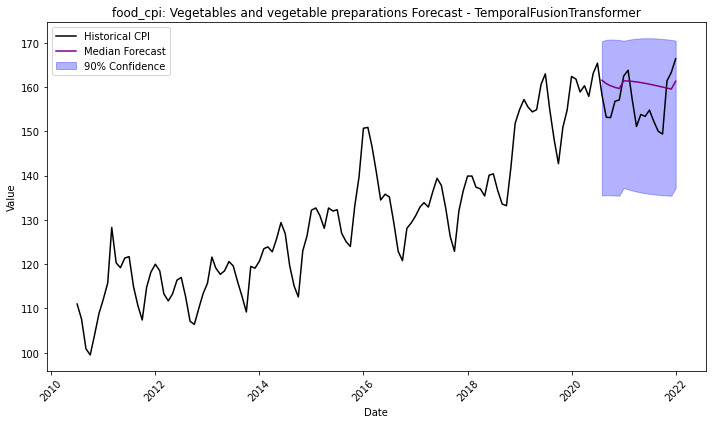

Beginning AutoGluon training... Time limit = 2s
AutoGluon will save models to './output/TEST/ag_global_all_TemporalFusionTransformerModel_exp2_GPT_P3_/random_seed_42/2021-07-01/model_files/'
=================== System Info ===================
AutoGluon Version:  1.1.1
Python Version:     3.8.20
Operating System:   Linux
Platform Machine:   x86_64
Platform Version:   #147~18.04.1-Ubuntu SMP Sat Oct 15 13:10:18 UTC 2022
CPU Count:          32
GPU Count:          1
Memory Avail:       166.67 GB / 188.57 GB (88.4%)
Disk Space Avail:   18206.77 GB / 249006.62 GB (7.3%)

Fitting with arguments:
{'enable_ensemble': True,
 'eval_metric': MAPE,
 'excluded_model_types': ['DirectTabular', 'RecursiveTabular'],
 'hyperparameters': {'TemporalFusionTransformerModel': {}},
 'known_covariates_names': [],
 'num_val_windows': 1,
 'prediction_length': 18,
 'quantile_levels': [0.01, 0.05, 0.1, 0.25, 0.75, 0.9, 0.95, 0.99],
 'random_seed': 42,
 'refit_every_n_windows': 1,
 'refit_full': False,
 'skip_model_

TemporalFusionTransformerModel


	-1.1438       = Validation score (-MAPE)
	2.14    s     = Training runtime
	0.04    s     = Validation (prediction) runtime
Not fitting ensemble due to lack of time remaining. Time left: -0.3 seconds
Training complete. Models trained: ['TemporalFusionTransformer']
Total runtime: 2.22 s
Best model: TemporalFusionTransformer
Best model score: -1.1438
Model not specified in predict, will default to the model with the best validation score: TemporalFusionTransformer
Model not specified in predict, will default to the model with the best validation score: TemporalFusionTransformer


****************** Summary of fit() ******************
Estimated performance of each model:
                       model  score_val  pred_time_val  fit_time_marginal  \
0  TemporalFusionTransformer  -1.143763       0.042167            2.13578   

   fit_order  
0          1  
Number of models trained: 1
Types of models trained:
{'MultiWindowBacktestingModel'}
****************** End of fit() summary ******************


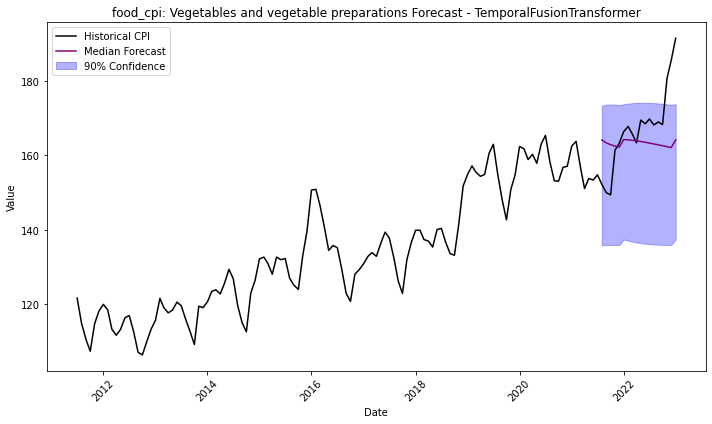

Beginning AutoGluon training... Time limit = 2s
AutoGluon will save models to './output/TEST/ag_global_all_TemporalFusionTransformerModel_exp2_R1_/random_seed_42/2021-07-01/model_files/'
=================== System Info ===================
AutoGluon Version:  1.1.1
Python Version:     3.8.20
Operating System:   Linux
Platform Machine:   x86_64
Platform Version:   #147~18.04.1-Ubuntu SMP Sat Oct 15 13:10:18 UTC 2022
CPU Count:          32
GPU Count:          1
Memory Avail:       166.67 GB / 188.57 GB (88.4%)
Disk Space Avail:   18206.76 GB / 249006.62 GB (7.3%)

Fitting with arguments:
{'enable_ensemble': True,
 'eval_metric': MAPE,
 'excluded_model_types': ['DirectTabular', 'RecursiveTabular'],
 'hyperparameters': {'TemporalFusionTransformerModel': {}},
 'known_covariates_names': [],
 'num_val_windows': 1,
 'prediction_length': 18,
 'quantile_levels': [0.01, 0.05, 0.1, 0.25, 0.75, 0.9, 0.95, 0.99],
 'random_seed': 42,
 'refit_every_n_windows': 1,
 'refit_full': False,
 'skip_model_sele

TemporalFusionTransformerModel


	-1.0335       = Validation score (-MAPE)
	2.12    s     = Training runtime
	0.05    s     = Validation (prediction) runtime
Not fitting ensemble due to lack of time remaining. Time left: -0.3 seconds
Training complete. Models trained: ['TemporalFusionTransformer']
Total runtime: 2.22 s
Best model: TemporalFusionTransformer
Best model score: -1.0335
Model not specified in predict, will default to the model with the best validation score: TemporalFusionTransformer
Model not specified in predict, will default to the model with the best validation score: TemporalFusionTransformer


****************** Summary of fit() ******************
Estimated performance of each model:
                       model  score_val  pred_time_val  fit_time_marginal  \
0  TemporalFusionTransformer  -1.033525       0.047828           2.124063   

   fit_order  
0          1  
Number of models trained: 1
Types of models trained:
{'MultiWindowBacktestingModel'}
****************** End of fit() summary ******************


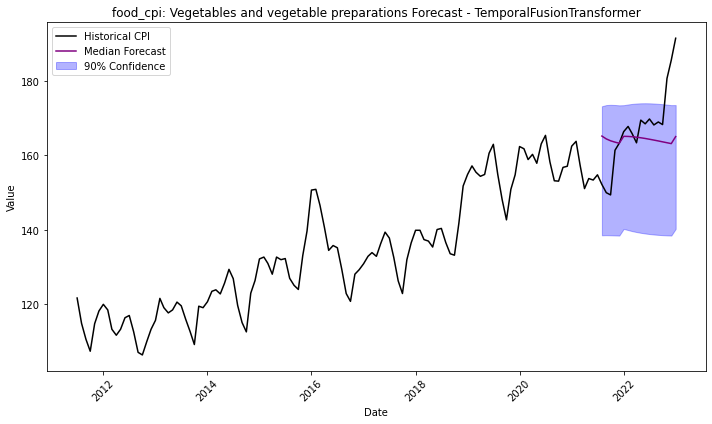

Beginning AutoGluon training... Time limit = 2s
AutoGluon will save models to './output/TEST/ag_global_all_TemporalFusionTransformerModel_exp2_R4_/random_seed_42/2021-07-01/model_files/'
=================== System Info ===================
AutoGluon Version:  1.1.1
Python Version:     3.8.20
Operating System:   Linux
Platform Machine:   x86_64
Platform Version:   #147~18.04.1-Ubuntu SMP Sat Oct 15 13:10:18 UTC 2022
CPU Count:          32
GPU Count:          1
Memory Avail:       166.78 GB / 188.57 GB (88.4%)
Disk Space Avail:   18206.75 GB / 249006.62 GB (7.3%)

Fitting with arguments:
{'enable_ensemble': True,
 'eval_metric': MAPE,
 'excluded_model_types': ['DirectTabular', 'RecursiveTabular'],
 'hyperparameters': {'TemporalFusionTransformerModel': {}},
 'known_covariates_names': [],
 'num_val_windows': 1,
 'prediction_length': 18,
 'quantile_levels': [0.01, 0.05, 0.1, 0.25, 0.75, 0.9, 0.95, 0.99],
 'random_seed': 42,
 'refit_every_n_windows': 1,
 'refit_full': False,
 'skip_model_sele

TemporalFusionTransformerModel


	-0.7055       = Validation score (-MAPE)
	2.16    s     = Training runtime
	0.05    s     = Validation (prediction) runtime
Not fitting ensemble due to lack of time remaining. Time left: -0.3 seconds
Training complete. Models trained: ['TemporalFusionTransformer']
Total runtime: 2.25 s
Best model: TemporalFusionTransformer
Best model score: -0.7055
Model not specified in predict, will default to the model with the best validation score: TemporalFusionTransformer


****************** Summary of fit() ******************
Estimated performance of each model:
                       model  score_val  pred_time_val  fit_time_marginal  \
0  TemporalFusionTransformer  -0.705455       0.046603           2.158009   

   fit_order  
0          1  
Number of models trained: 1
Types of models trained:
{'MultiWindowBacktestingModel'}
****************** End of fit() summary ******************


Model not specified in predict, will default to the model with the best validation score: TemporalFusionTransformer


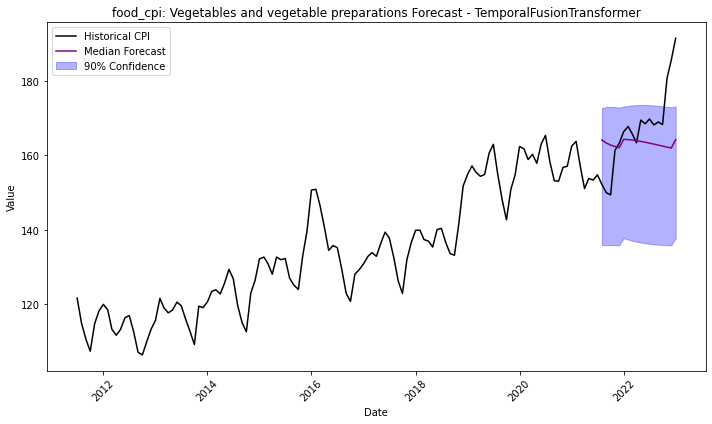

Beginning AutoGluon training... Time limit = 2s
AutoGluon will save models to './output/TEST/ag_global_all_TemporalFusionTransformerModel_exp2_R2_/random_seed_42/2021-07-01/model_files/'
=================== System Info ===================
AutoGluon Version:  1.1.1
Python Version:     3.8.20
Operating System:   Linux
Platform Machine:   x86_64
Platform Version:   #147~18.04.1-Ubuntu SMP Sat Oct 15 13:10:18 UTC 2022
CPU Count:          32
GPU Count:          1
Memory Avail:       166.69 GB / 188.57 GB (88.4%)
Disk Space Avail:   18206.75 GB / 249006.62 GB (7.3%)

Fitting with arguments:
{'enable_ensemble': True,
 'eval_metric': MAPE,
 'excluded_model_types': ['DirectTabular', 'RecursiveTabular'],
 'hyperparameters': {'TemporalFusionTransformerModel': {}},
 'known_covariates_names': [],
 'num_val_windows': 1,
 'prediction_length': 18,
 'quantile_levels': [0.01, 0.05, 0.1, 0.25, 0.75, 0.9, 0.95, 0.99],
 'random_seed': 42,
 'refit_every_n_windows': 1,
 'refit_full': False,
 'skip_model_sele

TemporalFusionTransformerModel


	-0.5338       = Validation score (-MAPE)
	2.20    s     = Training runtime
	0.05    s     = Validation (prediction) runtime
Not fitting ensemble due to lack of time remaining. Time left: -0.3 seconds
Training complete. Models trained: ['TemporalFusionTransformer']
Total runtime: 2.28 s
Best model: TemporalFusionTransformer
Best model score: -0.5338
Model not specified in predict, will default to the model with the best validation score: TemporalFusionTransformer


****************** Summary of fit() ******************
Estimated performance of each model:
                       model  score_val  pred_time_val  fit_time_marginal  \
0  TemporalFusionTransformer  -0.533815       0.046262            2.20142   

   fit_order  
0          1  
Number of models trained: 1
Types of models trained:
{'MultiWindowBacktestingModel'}
****************** End of fit() summary ******************


Model not specified in predict, will default to the model with the best validation score: TemporalFusionTransformer


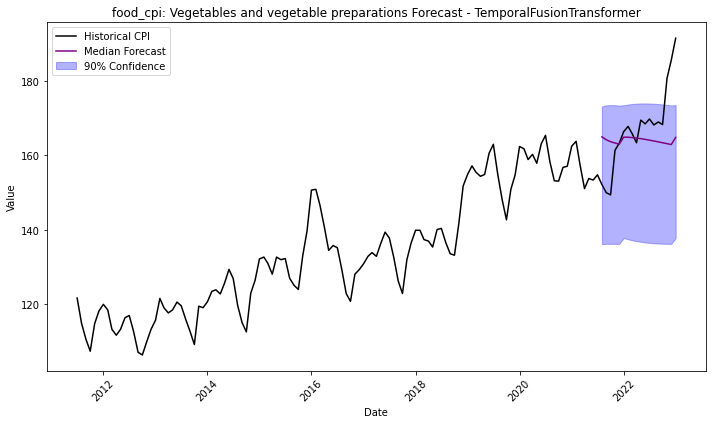

Beginning AutoGluon training... Time limit = 2s
AutoGluon will save models to './output/TEST/ag_global_all_TemporalFusionTransformerModel_exp2_GPT_P2_/random_seed_42/2021-07-01/model_files/'
=================== System Info ===================
AutoGluon Version:  1.1.1
Python Version:     3.8.20
Operating System:   Linux
Platform Machine:   x86_64
Platform Version:   #147~18.04.1-Ubuntu SMP Sat Oct 15 13:10:18 UTC 2022
CPU Count:          32
GPU Count:          1
Memory Avail:       166.65 GB / 188.57 GB (88.4%)
Disk Space Avail:   18206.75 GB / 249006.62 GB (7.3%)

Fitting with arguments:
{'enable_ensemble': True,
 'eval_metric': MAPE,
 'excluded_model_types': ['DirectTabular', 'RecursiveTabular'],
 'hyperparameters': {'TemporalFusionTransformerModel': {}},
 'known_covariates_names': [],
 'num_val_windows': 1,
 'prediction_length': 18,
 'quantile_levels': [0.01, 0.05, 0.1, 0.25, 0.75, 0.9, 0.95, 0.99],
 'random_seed': 42,
 'refit_every_n_windows': 1,
 'refit_full': False,
 'skip_model_

TemporalFusionTransformerModel


	-1.0999       = Validation score (-MAPE)
	2.14    s     = Training runtime
	0.04    s     = Validation (prediction) runtime
Not fitting ensemble due to lack of time remaining. Time left: -0.3 seconds
Training complete. Models trained: ['TemporalFusionTransformer']
Total runtime: 2.21 s
Best model: TemporalFusionTransformer
Best model score: -1.0999
Model not specified in predict, will default to the model with the best validation score: TemporalFusionTransformer
Model not specified in predict, will default to the model with the best validation score: TemporalFusionTransformer


****************** Summary of fit() ******************
Estimated performance of each model:
                       model  score_val  pred_time_val  fit_time_marginal  \
0  TemporalFusionTransformer  -1.099916       0.039648           2.135348   

   fit_order  
0          1  
Number of models trained: 1
Types of models trained:
{'MultiWindowBacktestingModel'}
****************** End of fit() summary ******************


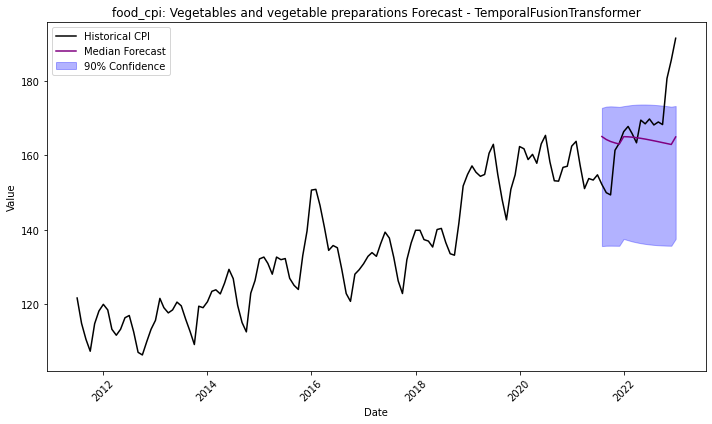

Beginning AutoGluon training... Time limit = 2s
AutoGluon will save models to './output/TEST/ag_global_all_TemporalFusionTransformerModel_exp2_GPT_P1_/random_seed_42/2021-07-01/model_files/'
=================== System Info ===================
AutoGluon Version:  1.1.1
Python Version:     3.8.20
Operating System:   Linux
Platform Machine:   x86_64
Platform Version:   #147~18.04.1-Ubuntu SMP Sat Oct 15 13:10:18 UTC 2022
CPU Count:          32
GPU Count:          1
Memory Avail:       166.65 GB / 188.57 GB (88.4%)
Disk Space Avail:   18206.74 GB / 249006.62 GB (7.3%)

Fitting with arguments:
{'enable_ensemble': True,
 'eval_metric': MAPE,
 'excluded_model_types': ['DirectTabular', 'RecursiveTabular'],
 'hyperparameters': {'TemporalFusionTransformerModel': {}},
 'known_covariates_names': [],
 'num_val_windows': 1,
 'prediction_length': 18,
 'quantile_levels': [0.01, 0.05, 0.1, 0.25, 0.75, 0.9, 0.95, 0.99],
 'random_seed': 42,
 'refit_every_n_windows': 1,
 'refit_full': False,
 'skip_model_

TemporalFusionTransformerModel


	-1.1238       = Validation score (-MAPE)
	2.15    s     = Training runtime
	0.04    s     = Validation (prediction) runtime
Not fitting ensemble due to lack of time remaining. Time left: -0.3 seconds
Training complete. Models trained: ['TemporalFusionTransformer']
Total runtime: 2.23 s
Best model: TemporalFusionTransformer
Best model score: -1.1238
Model not specified in predict, will default to the model with the best validation score: TemporalFusionTransformer
Model not specified in predict, will default to the model with the best validation score: TemporalFusionTransformer


****************** Summary of fit() ******************
Estimated performance of each model:
                       model  score_val  pred_time_val  fit_time_marginal  \
0  TemporalFusionTransformer  -1.123845       0.041957           2.152349   

   fit_order  
0          1  
Number of models trained: 1
Types of models trained:
{'MultiWindowBacktestingModel'}
****************** End of fit() summary ******************


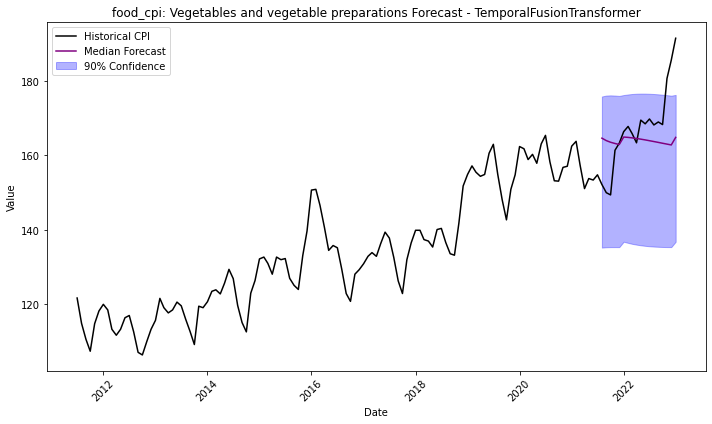

Beginning AutoGluon training... Time limit = 2s
AutoGluon will save models to './output/TEST/ag_global_all_TemporalFusionTransformerModel_exp2_R3_/random_seed_42/2021-07-01/model_files/'
=================== System Info ===================
AutoGluon Version:  1.1.1
Python Version:     3.8.20
Operating System:   Linux
Platform Machine:   x86_64
Platform Version:   #147~18.04.1-Ubuntu SMP Sat Oct 15 13:10:18 UTC 2022
CPU Count:          32
GPU Count:          1
Memory Avail:       166.65 GB / 188.57 GB (88.4%)
Disk Space Avail:   18206.72 GB / 249006.62 GB (7.3%)

Fitting with arguments:
{'enable_ensemble': True,
 'eval_metric': MAPE,
 'excluded_model_types': ['DirectTabular', 'RecursiveTabular'],
 'hyperparameters': {'TemporalFusionTransformerModel': {}},
 'known_covariates_names': [],
 'num_val_windows': 1,
 'prediction_length': 18,
 'quantile_levels': [0.01, 0.05, 0.1, 0.25, 0.75, 0.9, 0.95, 0.99],
 'random_seed': 42,
 'refit_every_n_windows': 1,
 'refit_full': False,
 'skip_model_sele

TemporalFusionTransformerModel


	-0.7258       = Validation score (-MAPE)
	2.13    s     = Training runtime
	0.04    s     = Validation (prediction) runtime
Not fitting ensemble due to lack of time remaining. Time left: -0.3 seconds
Training complete. Models trained: ['TemporalFusionTransformer']
Total runtime: 2.22 s
Best model: TemporalFusionTransformer
Best model score: -0.7258
Model not specified in predict, will default to the model with the best validation score: TemporalFusionTransformer
Model not specified in predict, will default to the model with the best validation score: TemporalFusionTransformer


****************** Summary of fit() ******************
Estimated performance of each model:
                       model  score_val  pred_time_val  fit_time_marginal  \
0  TemporalFusionTransformer  -0.725829       0.042598           2.131573   

   fit_order  
0          1  
Number of models trained: 1
Types of models trained:
{'MultiWindowBacktestingModel'}
****************** End of fit() summary ******************


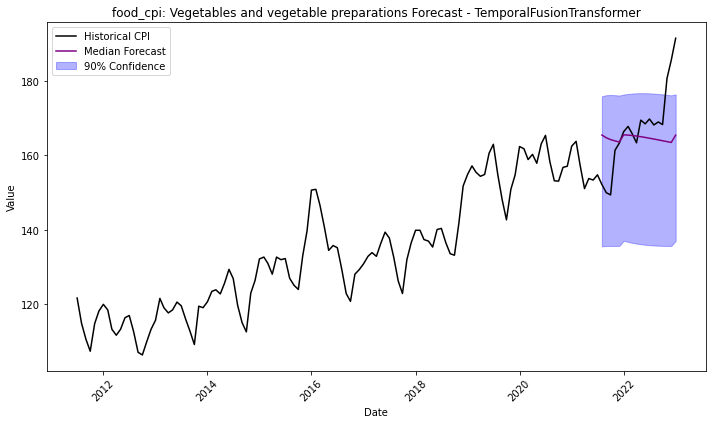

Beginning AutoGluon training... Time limit = 2s
AutoGluon will save models to './output/TEST/ag_global_all_TemporalFusionTransformerModel_exp2_GPT_P4_/random_seed_42/2021-07-01/model_files/'
=================== System Info ===================
AutoGluon Version:  1.1.1
Python Version:     3.8.20
Operating System:   Linux
Platform Machine:   x86_64
Platform Version:   #147~18.04.1-Ubuntu SMP Sat Oct 15 13:10:18 UTC 2022
CPU Count:          32
GPU Count:          1
Memory Avail:       166.65 GB / 188.57 GB (88.4%)
Disk Space Avail:   18207.22 GB / 249006.62 GB (7.3%)

Fitting with arguments:
{'enable_ensemble': True,
 'eval_metric': MAPE,
 'excluded_model_types': ['DirectTabular', 'RecursiveTabular'],
 'hyperparameters': {'TemporalFusionTransformerModel': {}},
 'known_covariates_names': [],
 'num_val_windows': 1,
 'prediction_length': 18,
 'quantile_levels': [0.01, 0.05, 0.1, 0.25, 0.75, 0.9, 0.95, 0.99],
 'random_seed': 42,
 'refit_every_n_windows': 1,
 'refit_full': False,
 'skip_model_

TemporalFusionTransformerModel


	-0.8965       = Validation score (-MAPE)
	2.11    s     = Training runtime
	0.04    s     = Validation (prediction) runtime
Not fitting ensemble due to lack of time remaining. Time left: -0.2 seconds
Training complete. Models trained: ['TemporalFusionTransformer']
Total runtime: 2.19 s
Best model: TemporalFusionTransformer
Best model score: -0.8965
Model not specified in predict, will default to the model with the best validation score: TemporalFusionTransformer
Model not specified in predict, will default to the model with the best validation score: TemporalFusionTransformer


****************** Summary of fit() ******************
Estimated performance of each model:
                       model  score_val  pred_time_val  fit_time_marginal  \
0  TemporalFusionTransformer  -0.896482       0.038753           2.114492   

   fit_order  
0          1  
Number of models trained: 1
Types of models trained:
{'MultiWindowBacktestingModel'}
****************** End of fit() summary ******************


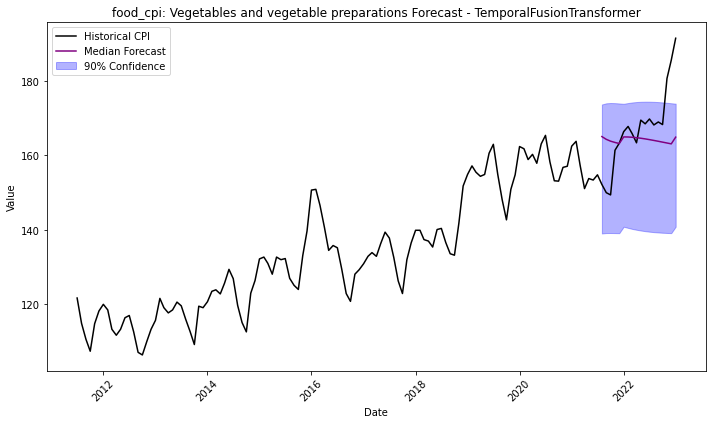

Beginning AutoGluon training... Time limit = 2s
AutoGluon will save models to './output/TEST/ag_global_all_TemporalFusionTransformerModel_exp2_GPT_P3_/random_seed_42/2022-07-01/model_files/'
=================== System Info ===================
AutoGluon Version:  1.1.1
Python Version:     3.8.20
Operating System:   Linux
Platform Machine:   x86_64
Platform Version:   #147~18.04.1-Ubuntu SMP Sat Oct 15 13:10:18 UTC 2022
CPU Count:          32
GPU Count:          1
Memory Avail:       166.65 GB / 188.57 GB (88.4%)
Disk Space Avail:   18207.21 GB / 249006.62 GB (7.3%)

Fitting with arguments:
{'enable_ensemble': True,
 'eval_metric': MAPE,
 'excluded_model_types': ['DirectTabular', 'RecursiveTabular'],
 'hyperparameters': {'TemporalFusionTransformerModel': {}},
 'known_covariates_names': [],
 'num_val_windows': 1,
 'prediction_length': 18,
 'quantile_levels': [0.01, 0.05, 0.1, 0.25, 0.75, 0.9, 0.95, 0.99],
 'random_seed': 42,
 'refit_every_n_windows': 1,
 'refit_full': False,
 'skip_model_

TemporalFusionTransformerModel


	-5.6532       = Validation score (-MAPE)
	2.16    s     = Training runtime
	0.04    s     = Validation (prediction) runtime
Not fitting ensemble due to lack of time remaining. Time left: -0.3 seconds
Training complete. Models trained: ['TemporalFusionTransformer']
Total runtime: 2.25 s
Best model: TemporalFusionTransformer
Best model score: -5.6532
Model not specified in predict, will default to the model with the best validation score: TemporalFusionTransformer
Model not specified in predict, will default to the model with the best validation score: TemporalFusionTransformer


****************** Summary of fit() ******************
Estimated performance of each model:
                       model  score_val  pred_time_val  fit_time_marginal  \
0  TemporalFusionTransformer  -5.653176        0.04405           2.163142   

   fit_order  
0          1  
Number of models trained: 1
Types of models trained:
{'MultiWindowBacktestingModel'}
****************** End of fit() summary ******************


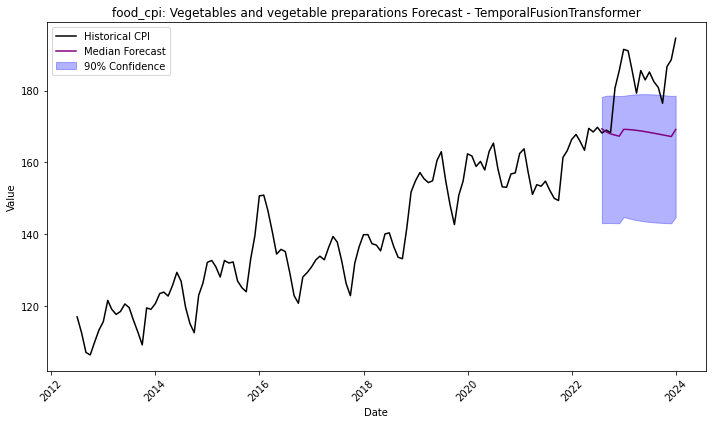

Beginning AutoGluon training... Time limit = 2s
AutoGluon will save models to './output/TEST/ag_global_all_TemporalFusionTransformerModel_exp2_R1_/random_seed_42/2022-07-01/model_files/'
=================== System Info ===================
AutoGluon Version:  1.1.1
Python Version:     3.8.20
Operating System:   Linux
Platform Machine:   x86_64
Platform Version:   #147~18.04.1-Ubuntu SMP Sat Oct 15 13:10:18 UTC 2022
CPU Count:          32
GPU Count:          1
Memory Avail:       166.65 GB / 188.57 GB (88.4%)
Disk Space Avail:   18207.20 GB / 249006.62 GB (7.3%)

Fitting with arguments:
{'enable_ensemble': True,
 'eval_metric': MAPE,
 'excluded_model_types': ['DirectTabular', 'RecursiveTabular'],
 'hyperparameters': {'TemporalFusionTransformerModel': {}},
 'known_covariates_names': [],
 'num_val_windows': 1,
 'prediction_length': 18,
 'quantile_levels': [0.01, 0.05, 0.1, 0.25, 0.75, 0.9, 0.95, 0.99],
 'random_seed': 42,
 'refit_every_n_windows': 1,
 'refit_full': False,
 'skip_model_sele

TemporalFusionTransformerModel


	-5.5852       = Validation score (-MAPE)
	2.13    s     = Training runtime
	0.37    s     = Validation (prediction) runtime
Not fitting ensemble due to lack of time remaining. Time left: -0.6 seconds
Training complete. Models trained: ['TemporalFusionTransformer']
Total runtime: 2.54 s
Best model: TemporalFusionTransformer
Best model score: -5.5852
Model not specified in predict, will default to the model with the best validation score: TemporalFusionTransformer
Model not specified in predict, will default to the model with the best validation score: TemporalFusionTransformer


****************** Summary of fit() ******************
Estimated performance of each model:
                       model  score_val  pred_time_val  fit_time_marginal  \
0  TemporalFusionTransformer  -5.585218       0.370085           2.133053   

   fit_order  
0          1  
Number of models trained: 1
Types of models trained:
{'MultiWindowBacktestingModel'}
****************** End of fit() summary ******************


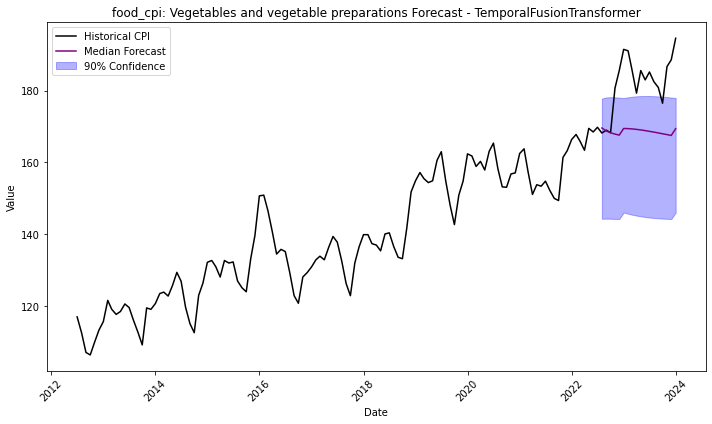

Beginning AutoGluon training... Time limit = 2s
AutoGluon will save models to './output/TEST/ag_global_all_TemporalFusionTransformerModel_exp2_R4_/random_seed_42/2022-07-01/model_files/'
=================== System Info ===================
AutoGluon Version:  1.1.1
Python Version:     3.8.20
Operating System:   Linux
Platform Machine:   x86_64
Platform Version:   #147~18.04.1-Ubuntu SMP Sat Oct 15 13:10:18 UTC 2022
CPU Count:          32
GPU Count:          1
Memory Avail:       166.65 GB / 188.57 GB (88.4%)
Disk Space Avail:   18207.19 GB / 249006.62 GB (7.3%)

Fitting with arguments:
{'enable_ensemble': True,
 'eval_metric': MAPE,
 'excluded_model_types': ['DirectTabular', 'RecursiveTabular'],
 'hyperparameters': {'TemporalFusionTransformerModel': {}},
 'known_covariates_names': [],
 'num_val_windows': 1,
 'prediction_length': 18,
 'quantile_levels': [0.01, 0.05, 0.1, 0.25, 0.75, 0.9, 0.95, 0.99],
 'random_seed': 42,
 'refit_every_n_windows': 1,
 'refit_full': False,
 'skip_model_sele

TemporalFusionTransformerModel


	-5.3453       = Validation score (-MAPE)
	2.15    s     = Training runtime
	0.04    s     = Validation (prediction) runtime
Not fitting ensemble due to lack of time remaining. Time left: -0.3 seconds
Training complete. Models trained: ['TemporalFusionTransformer']
Total runtime: 2.23 s
Best model: TemporalFusionTransformer
Best model score: -5.3453
Model not specified in predict, will default to the model with the best validation score: TemporalFusionTransformer
Model not specified in predict, will default to the model with the best validation score: TemporalFusionTransformer


****************** Summary of fit() ******************
Estimated performance of each model:
                       model  score_val  pred_time_val  fit_time_marginal  \
0  TemporalFusionTransformer  -5.345291       0.043752           2.145538   

   fit_order  
0          1  
Number of models trained: 1
Types of models trained:
{'MultiWindowBacktestingModel'}
****************** End of fit() summary ******************


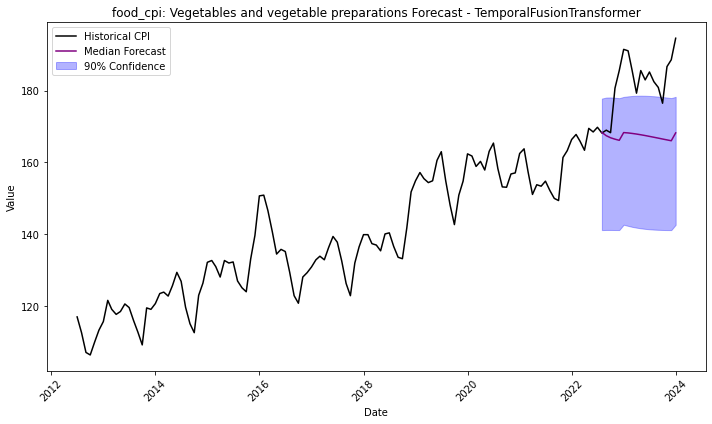

Beginning AutoGluon training... Time limit = 2s
AutoGluon will save models to './output/TEST/ag_global_all_TemporalFusionTransformerModel_exp2_R2_/random_seed_42/2022-07-01/model_files/'
=================== System Info ===================
AutoGluon Version:  1.1.1
Python Version:     3.8.20
Operating System:   Linux
Platform Machine:   x86_64
Platform Version:   #147~18.04.1-Ubuntu SMP Sat Oct 15 13:10:18 UTC 2022
CPU Count:          32
GPU Count:          1
Memory Avail:       166.65 GB / 188.57 GB (88.4%)
Disk Space Avail:   18207.18 GB / 249006.62 GB (7.3%)

Fitting with arguments:
{'enable_ensemble': True,
 'eval_metric': MAPE,
 'excluded_model_types': ['DirectTabular', 'RecursiveTabular'],
 'hyperparameters': {'TemporalFusionTransformerModel': {}},
 'known_covariates_names': [],
 'num_val_windows': 1,
 'prediction_length': 18,
 'quantile_levels': [0.01, 0.05, 0.1, 0.25, 0.75, 0.9, 0.95, 0.99],
 'random_seed': 42,
 'refit_every_n_windows': 1,
 'refit_full': False,
 'skip_model_sele

TemporalFusionTransformerModel


	-0.5799       = Validation score (-MAPE)
	2.14    s     = Training runtime
	0.04    s     = Validation (prediction) runtime
Not fitting ensemble due to lack of time remaining. Time left: -0.3 seconds
Training complete. Models trained: ['TemporalFusionTransformer']
Total runtime: 2.22 s
Best model: TemporalFusionTransformer
Best model score: -0.5799
Model not specified in predict, will default to the model with the best validation score: TemporalFusionTransformer
Model not specified in predict, will default to the model with the best validation score: TemporalFusionTransformer


****************** Summary of fit() ******************
Estimated performance of each model:
                       model  score_val  pred_time_val  fit_time_marginal  \
0  TemporalFusionTransformer  -0.579945       0.041881           2.139312   

   fit_order  
0          1  
Number of models trained: 1
Types of models trained:
{'MultiWindowBacktestingModel'}
****************** End of fit() summary ******************


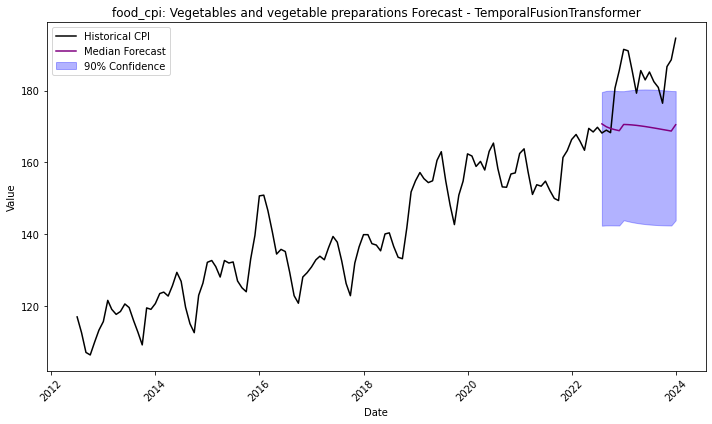

Beginning AutoGluon training... Time limit = 2s
AutoGluon will save models to './output/TEST/ag_global_all_TemporalFusionTransformerModel_exp2_GPT_P2_/random_seed_42/2022-07-01/model_files/'
=================== System Info ===================
AutoGluon Version:  1.1.1
Python Version:     3.8.20
Operating System:   Linux
Platform Machine:   x86_64
Platform Version:   #147~18.04.1-Ubuntu SMP Sat Oct 15 13:10:18 UTC 2022
CPU Count:          32
GPU Count:          1
Memory Avail:       166.73 GB / 188.57 GB (88.4%)
Disk Space Avail:   18207.17 GB / 249006.62 GB (7.3%)

Fitting with arguments:
{'enable_ensemble': True,
 'eval_metric': MAPE,
 'excluded_model_types': ['DirectTabular', 'RecursiveTabular'],
 'hyperparameters': {'TemporalFusionTransformerModel': {}},
 'known_covariates_names': [],
 'num_val_windows': 1,
 'prediction_length': 18,
 'quantile_levels': [0.01, 0.05, 0.1, 0.25, 0.75, 0.9, 0.95, 0.99],
 'random_seed': 42,
 'refit_every_n_windows': 1,
 'refit_full': False,
 'skip_model_

TemporalFusionTransformerModel


	-6.2968       = Validation score (-MAPE)
	2.13    s     = Training runtime
	0.04    s     = Validation (prediction) runtime
Not fitting ensemble due to lack of time remaining. Time left: -0.3 seconds
Training complete. Models trained: ['TemporalFusionTransformer']
Total runtime: 2.21 s
Best model: TemporalFusionTransformer
Best model score: -6.2968
Model not specified in predict, will default to the model with the best validation score: TemporalFusionTransformer
Model not specified in predict, will default to the model with the best validation score: TemporalFusionTransformer


****************** Summary of fit() ******************
Estimated performance of each model:
                       model  score_val  pred_time_val  fit_time_marginal  \
0  TemporalFusionTransformer  -6.296787       0.039141           2.125922   

   fit_order  
0          1  
Number of models trained: 1
Types of models trained:
{'MultiWindowBacktestingModel'}
****************** End of fit() summary ******************


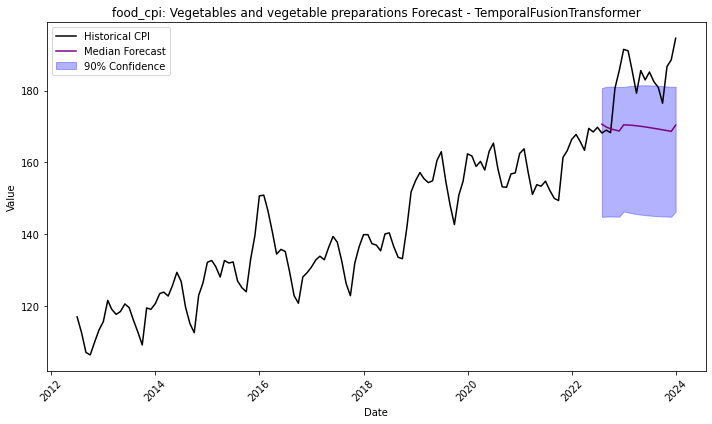

Beginning AutoGluon training... Time limit = 2s
AutoGluon will save models to './output/TEST/ag_global_all_TemporalFusionTransformerModel_exp2_GPT_P1_/random_seed_42/2022-07-01/model_files/'
=================== System Info ===================
AutoGluon Version:  1.1.1
Python Version:     3.8.20
Operating System:   Linux
Platform Machine:   x86_64
Platform Version:   #147~18.04.1-Ubuntu SMP Sat Oct 15 13:10:18 UTC 2022
CPU Count:          32
GPU Count:          1
Memory Avail:       166.64 GB / 188.57 GB (88.4%)
Disk Space Avail:   18207.22 GB / 249006.62 GB (7.3%)

Fitting with arguments:
{'enable_ensemble': True,
 'eval_metric': MAPE,
 'excluded_model_types': ['DirectTabular', 'RecursiveTabular'],
 'hyperparameters': {'TemporalFusionTransformerModel': {}},
 'known_covariates_names': [],
 'num_val_windows': 1,
 'prediction_length': 18,
 'quantile_levels': [0.01, 0.05, 0.1, 0.25, 0.75, 0.9, 0.95, 0.99],
 'random_seed': 42,
 'refit_every_n_windows': 1,
 'refit_full': False,
 'skip_model_

TemporalFusionTransformerModel


	-5.6026       = Validation score (-MAPE)
	2.12    s     = Training runtime
	0.04    s     = Validation (prediction) runtime
Not fitting ensemble due to lack of time remaining. Time left: -0.3 seconds
Training complete. Models trained: ['TemporalFusionTransformer']
Total runtime: 2.20 s
Best model: TemporalFusionTransformer
Best model score: -5.6026
Model not specified in predict, will default to the model with the best validation score: TemporalFusionTransformer
Model not specified in predict, will default to the model with the best validation score: TemporalFusionTransformer


****************** Summary of fit() ******************
Estimated performance of each model:
                       model  score_val  pred_time_val  fit_time_marginal  \
0  TemporalFusionTransformer  -5.602596       0.042787           2.121139   

   fit_order  
0          1  
Number of models trained: 1
Types of models trained:
{'MultiWindowBacktestingModel'}
****************** End of fit() summary ******************


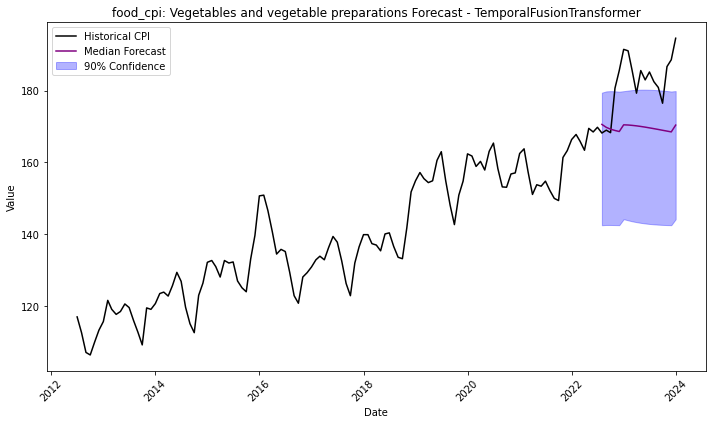

Beginning AutoGluon training... Time limit = 2s
AutoGluon will save models to './output/TEST/ag_global_all_TemporalFusionTransformerModel_exp2_R3_/random_seed_42/2022-07-01/model_files/'
=================== System Info ===================
AutoGluon Version:  1.1.1
Python Version:     3.8.20
Operating System:   Linux
Platform Machine:   x86_64
Platform Version:   #147~18.04.1-Ubuntu SMP Sat Oct 15 13:10:18 UTC 2022
CPU Count:          32
GPU Count:          1
Memory Avail:       166.68 GB / 188.57 GB (88.4%)
Disk Space Avail:   18207.21 GB / 249006.62 GB (7.3%)

Fitting with arguments:
{'enable_ensemble': True,
 'eval_metric': MAPE,
 'excluded_model_types': ['DirectTabular', 'RecursiveTabular'],
 'hyperparameters': {'TemporalFusionTransformerModel': {}},
 'known_covariates_names': [],
 'num_val_windows': 1,
 'prediction_length': 18,
 'quantile_levels': [0.01, 0.05, 0.1, 0.25, 0.75, 0.9, 0.95, 0.99],
 'random_seed': 42,
 'refit_every_n_windows': 1,
 'refit_full': False,
 'skip_model_sele

TemporalFusionTransformerModel


	-0.4337       = Validation score (-MAPE)
	2.12    s     = Training runtime
	0.04    s     = Validation (prediction) runtime
Not fitting ensemble due to lack of time remaining. Time left: -0.3 seconds
Training complete. Models trained: ['TemporalFusionTransformer']
Total runtime: 2.20 s
Best model: TemporalFusionTransformer
Best model score: -0.4337


****************** Summary of fit() ******************
Estimated performance of each model:
                       model  score_val  pred_time_val  fit_time_marginal  \
0  TemporalFusionTransformer  -0.433725       0.041747           2.120066   

   fit_order  
0          1  
Number of models trained: 1
Types of models trained:
{'MultiWindowBacktestingModel'}
****************** End of fit() summary ******************


Model not specified in predict, will default to the model with the best validation score: TemporalFusionTransformer
Model not specified in predict, will default to the model with the best validation score: TemporalFusionTransformer


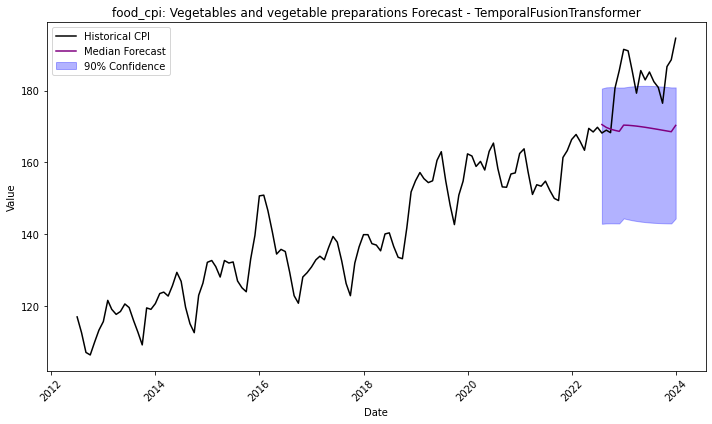

Beginning AutoGluon training... Time limit = 2s
AutoGluon will save models to './output/TEST/ag_global_all_TemporalFusionTransformerModel_exp2_GPT_P4_/random_seed_42/2022-07-01/model_files/'
=================== System Info ===================
AutoGluon Version:  1.1.1
Python Version:     3.8.20
Operating System:   Linux
Platform Machine:   x86_64
Platform Version:   #147~18.04.1-Ubuntu SMP Sat Oct 15 13:10:18 UTC 2022
CPU Count:          32
GPU Count:          1
Memory Avail:       166.76 GB / 188.57 GB (88.4%)
Disk Space Avail:   18207.20 GB / 249006.62 GB (7.3%)

Fitting with arguments:
{'enable_ensemble': True,
 'eval_metric': MAPE,
 'excluded_model_types': ['DirectTabular', 'RecursiveTabular'],
 'hyperparameters': {'TemporalFusionTransformerModel': {}},
 'known_covariates_names': [],
 'num_val_windows': 1,
 'prediction_length': 18,
 'quantile_levels': [0.01, 0.05, 0.1, 0.25, 0.75, 0.9, 0.95, 0.99],
 'random_seed': 42,
 'refit_every_n_windows': 1,
 'refit_full': False,
 'skip_model_

TemporalFusionTransformerModel


	-6.9764       = Validation score (-MAPE)
	2.10    s     = Training runtime
	0.04    s     = Validation (prediction) runtime
Not fitting ensemble due to lack of time remaining. Time left: -0.2 seconds
Training complete. Models trained: ['TemporalFusionTransformer']
Total runtime: 2.18 s
Best model: TemporalFusionTransformer
Best model score: -6.9764
Model not specified in predict, will default to the model with the best validation score: TemporalFusionTransformer
Model not specified in predict, will default to the model with the best validation score: TemporalFusionTransformer


****************** Summary of fit() ******************
Estimated performance of each model:
                       model  score_val  pred_time_val  fit_time_marginal  \
0  TemporalFusionTransformer  -6.976409       0.039264           2.104263   

   fit_order  
0          1  
Number of models trained: 1
Types of models trained:
{'MultiWindowBacktestingModel'}
****************** End of fit() summary ******************


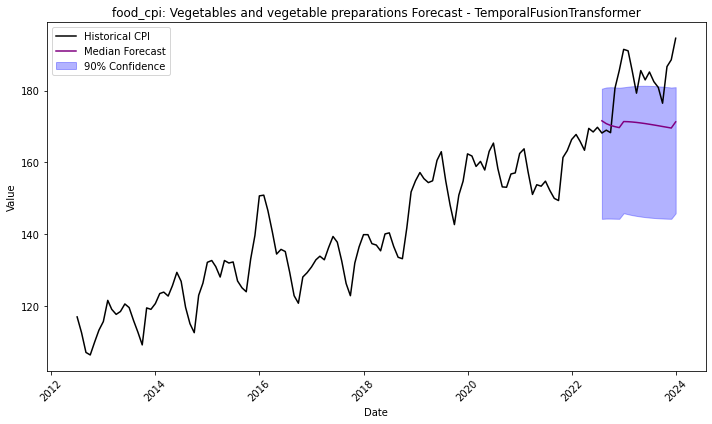

Beginning AutoGluon training... Time limit = 2s
AutoGluon will save models to './output/TEST/ag_global_all_TemporalFusionTransformerModel_exp2_GPT_P3_/random_seed_42/2023-07-01/model_files/'
=================== System Info ===================
AutoGluon Version:  1.1.1
Python Version:     3.8.20
Operating System:   Linux
Platform Machine:   x86_64
Platform Version:   #147~18.04.1-Ubuntu SMP Sat Oct 15 13:10:18 UTC 2022
CPU Count:          32
GPU Count:          1
Memory Avail:       166.63 GB / 188.57 GB (88.4%)
Disk Space Avail:   18207.19 GB / 249006.62 GB (7.3%)

Fitting with arguments:
{'enable_ensemble': True,
 'eval_metric': MAPE,
 'excluded_model_types': ['DirectTabular', 'RecursiveTabular'],
 'hyperparameters': {'TemporalFusionTransformerModel': {}},
 'known_covariates_names': [],
 'num_val_windows': 1,
 'prediction_length': 18,
 'quantile_levels': [0.01, 0.05, 0.1, 0.25, 0.75, 0.9, 0.95, 0.99],
 'random_seed': 42,
 'refit_every_n_windows': 1,
 'refit_full': False,
 'skip_model_

TemporalFusionTransformerModel


	-1.0675       = Validation score (-MAPE)
	2.12    s     = Training runtime
	0.04    s     = Validation (prediction) runtime
Not fitting ensemble due to lack of time remaining. Time left: -0.3 seconds
Training complete. Models trained: ['TemporalFusionTransformer']
Total runtime: 2.20 s
Best model: TemporalFusionTransformer
Best model score: -1.0675
Model not specified in predict, will default to the model with the best validation score: TemporalFusionTransformer
Model not specified in predict, will default to the model with the best validation score: TemporalFusionTransformer


****************** Summary of fit() ******************
Estimated performance of each model:
                       model  score_val  pred_time_val  fit_time_marginal  \
0  TemporalFusionTransformer   -1.06745       0.041789           2.116324   

   fit_order  
0          1  
Number of models trained: 1
Types of models trained:
{'MultiWindowBacktestingModel'}
****************** End of fit() summary ******************


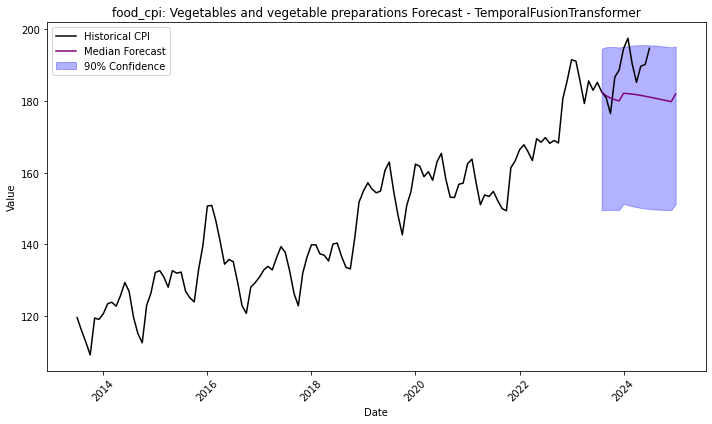

Beginning AutoGluon training... Time limit = 2s
AutoGluon will save models to './output/TEST/ag_global_all_TemporalFusionTransformerModel_exp2_R1_/random_seed_42/2023-07-01/model_files/'
=================== System Info ===================
AutoGluon Version:  1.1.1
Python Version:     3.8.20
Operating System:   Linux
Platform Machine:   x86_64
Platform Version:   #147~18.04.1-Ubuntu SMP Sat Oct 15 13:10:18 UTC 2022
CPU Count:          32
GPU Count:          1
Memory Avail:       166.63 GB / 188.57 GB (88.4%)
Disk Space Avail:   18207.23 GB / 249006.62 GB (7.3%)

Fitting with arguments:
{'enable_ensemble': True,
 'eval_metric': MAPE,
 'excluded_model_types': ['DirectTabular', 'RecursiveTabular'],
 'hyperparameters': {'TemporalFusionTransformerModel': {}},
 'known_covariates_names': [],
 'num_val_windows': 1,
 'prediction_length': 18,
 'quantile_levels': [0.01, 0.05, 0.1, 0.25, 0.75, 0.9, 0.95, 0.99],
 'random_seed': 42,
 'refit_every_n_windows': 1,
 'refit_full': False,
 'skip_model_sele

TemporalFusionTransformerModel


	-0.9890       = Validation score (-MAPE)
	2.13    s     = Training runtime
	0.04    s     = Validation (prediction) runtime
Not fitting ensemble due to lack of time remaining. Time left: -0.3 seconds
Training complete. Models trained: ['TemporalFusionTransformer']
Total runtime: 2.22 s
Best model: TemporalFusionTransformer
Best model score: -0.9890
Model not specified in predict, will default to the model with the best validation score: TemporalFusionTransformer
Model not specified in predict, will default to the model with the best validation score: TemporalFusionTransformer


****************** Summary of fit() ******************
Estimated performance of each model:
                       model  score_val  pred_time_val  fit_time_marginal  \
0  TemporalFusionTransformer  -0.988992       0.043856           2.131649   

   fit_order  
0          1  
Number of models trained: 1
Types of models trained:
{'MultiWindowBacktestingModel'}
****************** End of fit() summary ******************


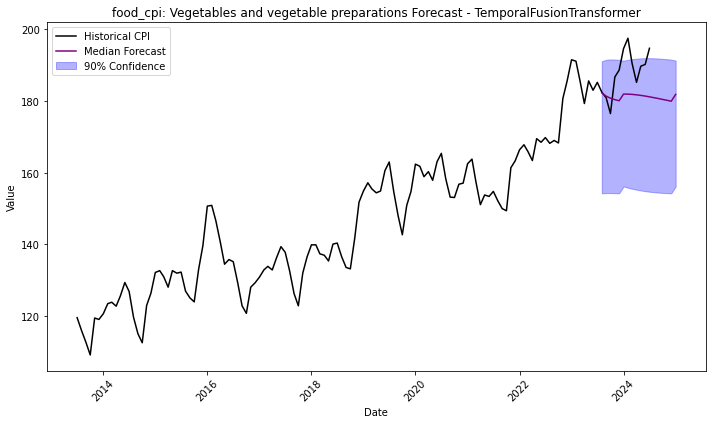

Beginning AutoGluon training... Time limit = 2s
AutoGluon will save models to './output/TEST/ag_global_all_TemporalFusionTransformerModel_exp2_R4_/random_seed_42/2023-07-01/model_files/'
=================== System Info ===================
AutoGluon Version:  1.1.1
Python Version:     3.8.20
Operating System:   Linux
Platform Machine:   x86_64
Platform Version:   #147~18.04.1-Ubuntu SMP Sat Oct 15 13:10:18 UTC 2022
CPU Count:          32
GPU Count:          1
Memory Avail:       166.63 GB / 188.57 GB (88.4%)
Disk Space Avail:   18207.23 GB / 249006.62 GB (7.3%)

Fitting with arguments:
{'enable_ensemble': True,
 'eval_metric': MAPE,
 'excluded_model_types': ['DirectTabular', 'RecursiveTabular'],
 'hyperparameters': {'TemporalFusionTransformerModel': {}},
 'known_covariates_names': [],
 'num_val_windows': 1,
 'prediction_length': 18,
 'quantile_levels': [0.01, 0.05, 0.1, 0.25, 0.75, 0.9, 0.95, 0.99],
 'random_seed': 42,
 'refit_every_n_windows': 1,
 'refit_full': False,
 'skip_model_sele

TemporalFusionTransformerModel


	-0.8099       = Validation score (-MAPE)
	2.13    s     = Training runtime
	0.04    s     = Validation (prediction) runtime
Not fitting ensemble due to lack of time remaining. Time left: -0.3 seconds
Training complete. Models trained: ['TemporalFusionTransformer']
Total runtime: 2.22 s
Best model: TemporalFusionTransformer
Best model score: -0.8099
Model not specified in predict, will default to the model with the best validation score: TemporalFusionTransformer
Model not specified in predict, will default to the model with the best validation score: TemporalFusionTransformer


****************** Summary of fit() ******************
Estimated performance of each model:
                       model  score_val  pred_time_val  fit_time_marginal  \
0  TemporalFusionTransformer  -0.809874       0.043744           2.131859   

   fit_order  
0          1  
Number of models trained: 1
Types of models trained:
{'MultiWindowBacktestingModel'}
****************** End of fit() summary ******************


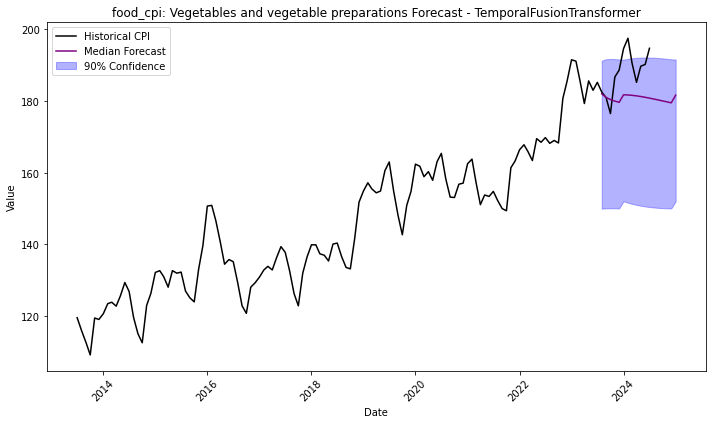

Beginning AutoGluon training... Time limit = 2s
AutoGluon will save models to './output/TEST/ag_global_all_TemporalFusionTransformerModel_exp2_R2_/random_seed_42/2023-07-01/model_files/'
=================== System Info ===================
AutoGluon Version:  1.1.1
Python Version:     3.8.20
Operating System:   Linux
Platform Machine:   x86_64
Platform Version:   #147~18.04.1-Ubuntu SMP Sat Oct 15 13:10:18 UTC 2022
CPU Count:          32
GPU Count:          1
Memory Avail:       166.63 GB / 188.57 GB (88.4%)
Disk Space Avail:   18207.21 GB / 249006.62 GB (7.3%)

Fitting with arguments:
{'enable_ensemble': True,
 'eval_metric': MAPE,
 'excluded_model_types': ['DirectTabular', 'RecursiveTabular'],
 'hyperparameters': {'TemporalFusionTransformerModel': {}},
 'known_covariates_names': [],
 'num_val_windows': 1,
 'prediction_length': 18,
 'quantile_levels': [0.01, 0.05, 0.1, 0.25, 0.75, 0.9, 0.95, 0.99],
 'random_seed': 42,
 'refit_every_n_windows': 1,
 'refit_full': False,
 'skip_model_sele

TemporalFusionTransformerModel


	-0.5329       = Validation score (-MAPE)
	2.14    s     = Training runtime
	0.04    s     = Validation (prediction) runtime
Not fitting ensemble due to lack of time remaining. Time left: -0.3 seconds
Training complete. Models trained: ['TemporalFusionTransformer']
Total runtime: 2.23 s
Best model: TemporalFusionTransformer
Best model score: -0.5329
Model not specified in predict, will default to the model with the best validation score: TemporalFusionTransformer
Model not specified in predict, will default to the model with the best validation score: TemporalFusionTransformer


****************** Summary of fit() ******************
Estimated performance of each model:
                       model  score_val  pred_time_val  fit_time_marginal  \
0  TemporalFusionTransformer  -0.532855        0.04344            2.13951   

   fit_order  
0          1  
Number of models trained: 1
Types of models trained:
{'MultiWindowBacktestingModel'}
****************** End of fit() summary ******************


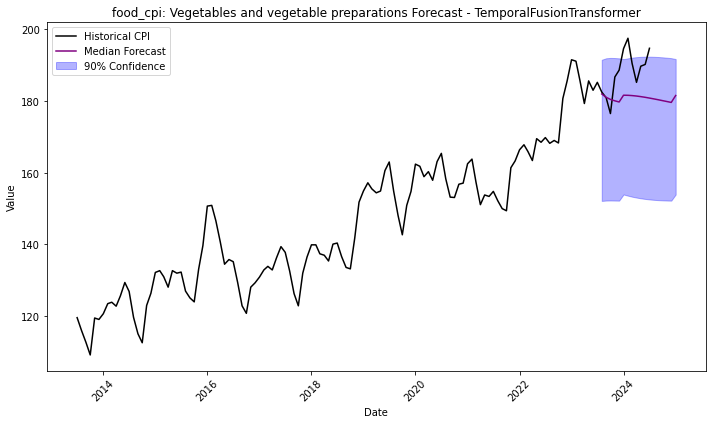

Beginning AutoGluon training... Time limit = 2s
AutoGluon will save models to './output/TEST/ag_global_all_TemporalFusionTransformerModel_exp2_GPT_P2_/random_seed_42/2023-07-01/model_files/'
=================== System Info ===================
AutoGluon Version:  1.1.1
Python Version:     3.8.20
Operating System:   Linux
Platform Machine:   x86_64
Platform Version:   #147~18.04.1-Ubuntu SMP Sat Oct 15 13:10:18 UTC 2022
CPU Count:          32
GPU Count:          1
Memory Avail:       166.63 GB / 188.57 GB (88.4%)
Disk Space Avail:   18207.20 GB / 249006.62 GB (7.3%)

Fitting with arguments:
{'enable_ensemble': True,
 'eval_metric': MAPE,
 'excluded_model_types': ['DirectTabular', 'RecursiveTabular'],
 'hyperparameters': {'TemporalFusionTransformerModel': {}},
 'known_covariates_names': [],
 'num_val_windows': 1,
 'prediction_length': 18,
 'quantile_levels': [0.01, 0.05, 0.1, 0.25, 0.75, 0.9, 0.95, 0.99],
 'random_seed': 42,
 'refit_every_n_windows': 1,
 'refit_full': False,
 'skip_model_

TemporalFusionTransformerModel


	-0.6589       = Validation score (-MAPE)
	2.42    s     = Training runtime
	0.04    s     = Validation (prediction) runtime
Not fitting ensemble due to lack of time remaining. Time left: -0.5 seconds
Training complete. Models trained: ['TemporalFusionTransformer']
Total runtime: 2.49 s
Best model: TemporalFusionTransformer
Best model score: -0.6589
Model not specified in predict, will default to the model with the best validation score: TemporalFusionTransformer
Model not specified in predict, will default to the model with the best validation score: TemporalFusionTransformer


****************** Summary of fit() ******************
Estimated performance of each model:
                       model  score_val  pred_time_val  fit_time_marginal  \
0  TemporalFusionTransformer  -0.658909       0.039648           2.415919   

   fit_order  
0          1  
Number of models trained: 1
Types of models trained:
{'MultiWindowBacktestingModel'}
****************** End of fit() summary ******************


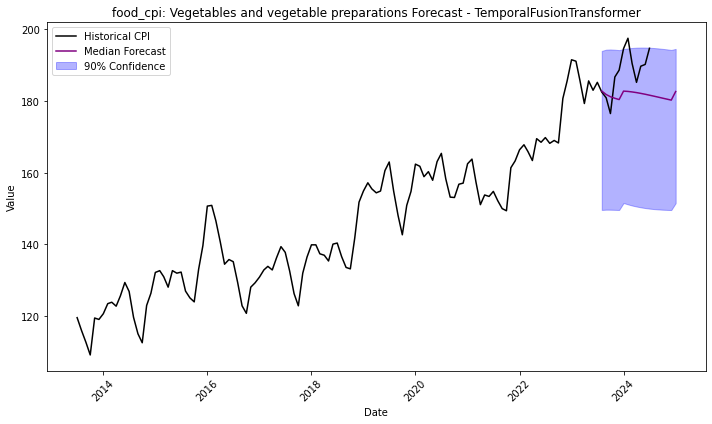

Beginning AutoGluon training... Time limit = 2s
AutoGluon will save models to './output/TEST/ag_global_all_TemporalFusionTransformerModel_exp2_GPT_P1_/random_seed_42/2023-07-01/model_files/'
=================== System Info ===================
AutoGluon Version:  1.1.1
Python Version:     3.8.20
Operating System:   Linux
Platform Machine:   x86_64
Platform Version:   #147~18.04.1-Ubuntu SMP Sat Oct 15 13:10:18 UTC 2022
CPU Count:          32
GPU Count:          1
Memory Avail:       166.63 GB / 188.57 GB (88.4%)
Disk Space Avail:   18207.19 GB / 249006.62 GB (7.3%)

Fitting with arguments:
{'enable_ensemble': True,
 'eval_metric': MAPE,
 'excluded_model_types': ['DirectTabular', 'RecursiveTabular'],
 'hyperparameters': {'TemporalFusionTransformerModel': {}},
 'known_covariates_names': [],
 'num_val_windows': 1,
 'prediction_length': 18,
 'quantile_levels': [0.01, 0.05, 0.1, 0.25, 0.75, 0.9, 0.95, 0.99],
 'random_seed': 42,
 'refit_every_n_windows': 1,
 'refit_full': False,
 'skip_model_

TemporalFusionTransformerModel


	-0.7133       = Validation score (-MAPE)
	2.12    s     = Training runtime
	0.04    s     = Validation (prediction) runtime
Not fitting ensemble due to lack of time remaining. Time left: -0.3 seconds
Training complete. Models trained: ['TemporalFusionTransformer']
Total runtime: 2.19 s
Best model: TemporalFusionTransformer
Best model score: -0.7133
Model not specified in predict, will default to the model with the best validation score: TemporalFusionTransformer
Model not specified in predict, will default to the model with the best validation score: TemporalFusionTransformer


****************** Summary of fit() ******************
Estimated performance of each model:
                       model  score_val  pred_time_val  fit_time_marginal  \
0  TemporalFusionTransformer  -0.713328       0.042415            2.11806   

   fit_order  
0          1  
Number of models trained: 1
Types of models trained:
{'MultiWindowBacktestingModel'}
****************** End of fit() summary ******************


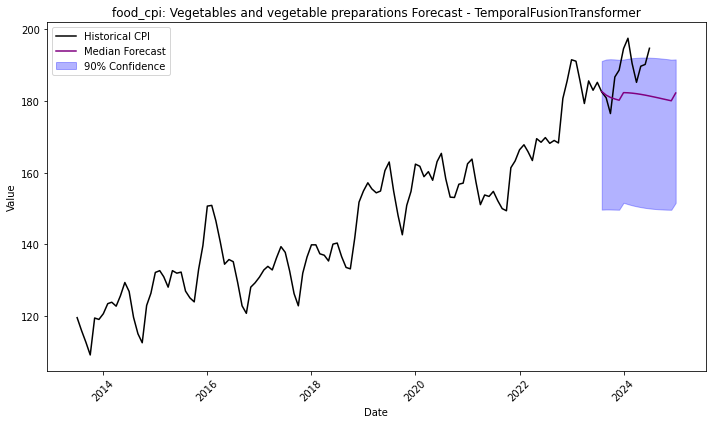

Beginning AutoGluon training... Time limit = 2s
AutoGluon will save models to './output/TEST/ag_global_all_TemporalFusionTransformerModel_exp2_R3_/random_seed_42/2023-07-01/model_files/'
=================== System Info ===================
AutoGluon Version:  1.1.1
Python Version:     3.8.20
Operating System:   Linux
Platform Machine:   x86_64
Platform Version:   #147~18.04.1-Ubuntu SMP Sat Oct 15 13:10:18 UTC 2022
CPU Count:          32
GPU Count:          1
Memory Avail:       166.86 GB / 188.57 GB (88.5%)
Disk Space Avail:   18207.18 GB / 249006.62 GB (7.3%)

Fitting with arguments:
{'enable_ensemble': True,
 'eval_metric': MAPE,
 'excluded_model_types': ['DirectTabular', 'RecursiveTabular'],
 'hyperparameters': {'TemporalFusionTransformerModel': {}},
 'known_covariates_names': [],
 'num_val_windows': 1,
 'prediction_length': 18,
 'quantile_levels': [0.01, 0.05, 0.1, 0.25, 0.75, 0.9, 0.95, 0.99],
 'random_seed': 42,
 'refit_every_n_windows': 1,
 'refit_full': False,
 'skip_model_sele

TemporalFusionTransformerModel


	-0.4656       = Validation score (-MAPE)
	2.13    s     = Training runtime
	0.04    s     = Validation (prediction) runtime
Not fitting ensemble due to lack of time remaining. Time left: -0.3 seconds
Training complete. Models trained: ['TemporalFusionTransformer']
Total runtime: 2.21 s
Best model: TemporalFusionTransformer
Best model score: -0.4656
Model not specified in predict, will default to the model with the best validation score: TemporalFusionTransformer
Model not specified in predict, will default to the model with the best validation score: TemporalFusionTransformer


****************** Summary of fit() ******************
Estimated performance of each model:
                       model  score_val  pred_time_val  fit_time_marginal  \
0  TemporalFusionTransformer  -0.465607       0.043421           2.127222   

   fit_order  
0          1  
Number of models trained: 1
Types of models trained:
{'MultiWindowBacktestingModel'}
****************** End of fit() summary ******************


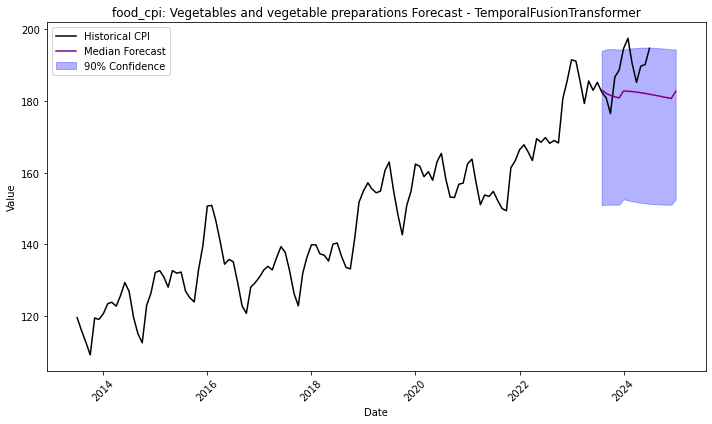

Beginning AutoGluon training... Time limit = 2s
AutoGluon will save models to './output/TEST/ag_global_all_TemporalFusionTransformerModel_exp2_GPT_P4_/random_seed_42/2023-07-01/model_files/'
=================== System Info ===================
AutoGluon Version:  1.1.1
Python Version:     3.8.20
Operating System:   Linux
Platform Machine:   x86_64
Platform Version:   #147~18.04.1-Ubuntu SMP Sat Oct 15 13:10:18 UTC 2022
CPU Count:          32
GPU Count:          1
Memory Avail:       166.63 GB / 188.57 GB (88.4%)
Disk Space Avail:   18207.23 GB / 249006.62 GB (7.3%)

Fitting with arguments:
{'enable_ensemble': True,
 'eval_metric': MAPE,
 'excluded_model_types': ['DirectTabular', 'RecursiveTabular'],
 'hyperparameters': {'TemporalFusionTransformerModel': {}},
 'known_covariates_names': [],
 'num_val_windows': 1,
 'prediction_length': 18,
 'quantile_levels': [0.01, 0.05, 0.1, 0.25, 0.75, 0.9, 0.95, 0.99],
 'random_seed': 42,
 'refit_every_n_windows': 1,
 'refit_full': False,
 'skip_model_

TemporalFusionTransformerModel


	-1.0325       = Validation score (-MAPE)
	2.17    s     = Training runtime
	0.04    s     = Validation (prediction) runtime
Not fitting ensemble due to lack of time remaining. Time left: -0.3 seconds
Training complete. Models trained: ['TemporalFusionTransformer']
Total runtime: 2.25 s
Best model: TemporalFusionTransformer
Best model score: -1.0325
Model not specified in predict, will default to the model with the best validation score: TemporalFusionTransformer
Model not specified in predict, will default to the model with the best validation score: TemporalFusionTransformer


****************** Summary of fit() ******************
Estimated performance of each model:
                       model  score_val  pred_time_val  fit_time_marginal  \
0  TemporalFusionTransformer  -1.032505       0.039425           2.166886   

   fit_order  
0          1  
Number of models trained: 1
Types of models trained:
{'MultiWindowBacktestingModel'}
****************** End of fit() summary ******************


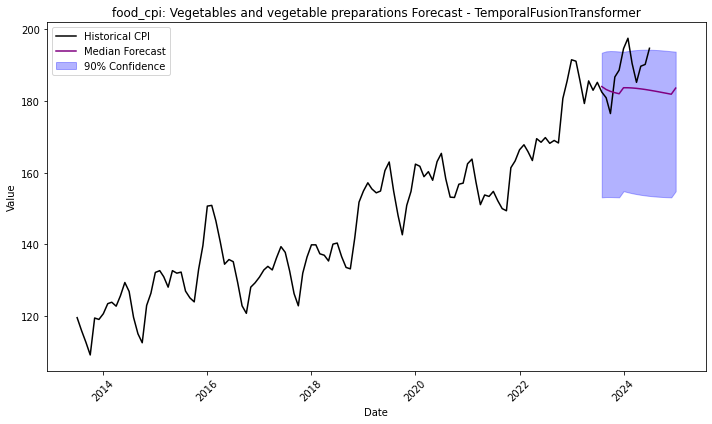

Beginning AutoGluon training... Time limit = 2s
AutoGluon will save models to './output/TEST/ag_global_all_SimpleFeedForwardModel_exp2_R3_/random_seed_42/2018-07-01/model_files/'
=================== System Info ===================
AutoGluon Version:  1.1.1
Python Version:     3.8.20
Operating System:   Linux
Platform Machine:   x86_64
Platform Version:   #147~18.04.1-Ubuntu SMP Sat Oct 15 13:10:18 UTC 2022
CPU Count:          32
GPU Count:          1
Memory Avail:       166.63 GB / 188.57 GB (88.4%)
Disk Space Avail:   18207.21 GB / 249006.62 GB (7.3%)

Fitting with arguments:
{'enable_ensemble': True,
 'eval_metric': MAPE,
 'excluded_model_types': ['DirectTabular', 'RecursiveTabular'],
 'hyperparameters': {'SimpleFeedForwardModel': {}},
 'known_covariates_names': [],
 'num_val_windows': 1,
 'prediction_length': 18,
 'quantile_levels': [0.01, 0.05, 0.1, 0.25, 0.75, 0.9, 0.95, 0.99],
 'random_seed': 42,
 'refit_every_n_windows': 1,
 'refit_full': False,
 'skip_model_selection': False,
 

ag_global_all_SimpleFeedForwardModel
SimpleFeedForwardModel


	-0.3872       = Validation score (-MAPE)
	1.90    s     = Training runtime
	0.04    s     = Validation (prediction) runtime
Not fitting ensemble due to lack of time remaining. Time left: -0.0 seconds
Training complete. Models trained: ['SimpleFeedForward']
Total runtime: 1.96 s
Best model: SimpleFeedForward
Best model score: -0.3872
Model not specified in predict, will default to the model with the best validation score: SimpleFeedForward
Model not specified in predict, will default to the model with the best validation score: SimpleFeedForward


****************** Summary of fit() ******************
Estimated performance of each model:
               model  score_val  pred_time_val  fit_time_marginal  fit_order
0  SimpleFeedForward  -0.387194       0.039448           1.897239          1
Number of models trained: 1
Types of models trained:
{'MultiWindowBacktestingModel'}
****************** End of fit() summary ******************


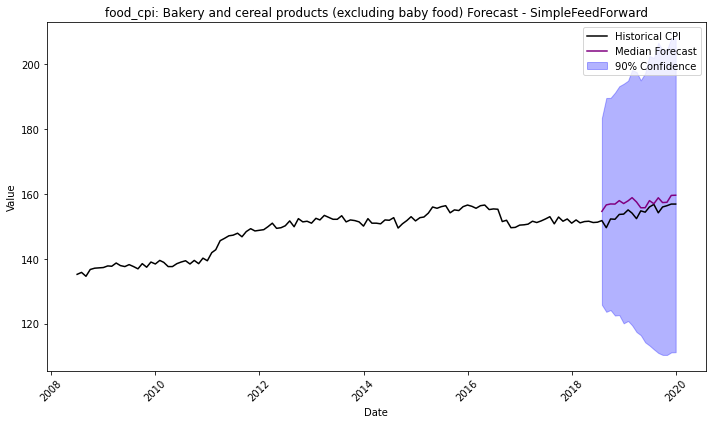

Beginning AutoGluon training... Time limit = 2s
AutoGluon will save models to './output/TEST/ag_global_all_SimpleFeedForwardModel_exp2_GPT_P3_/random_seed_42/2018-07-01/model_files/'
=================== System Info ===================
AutoGluon Version:  1.1.1
Python Version:     3.8.20
Operating System:   Linux
Platform Machine:   x86_64
Platform Version:   #147~18.04.1-Ubuntu SMP Sat Oct 15 13:10:18 UTC 2022
CPU Count:          32
GPU Count:          1
Memory Avail:       166.64 GB / 188.57 GB (88.4%)
Disk Space Avail:   18207.21 GB / 249006.62 GB (7.3%)

Fitting with arguments:
{'enable_ensemble': True,
 'eval_metric': MAPE,
 'excluded_model_types': ['DirectTabular', 'RecursiveTabular'],
 'hyperparameters': {'SimpleFeedForwardModel': {}},
 'known_covariates_names': [],
 'num_val_windows': 1,
 'prediction_length': 18,
 'quantile_levels': [0.01, 0.05, 0.1, 0.25, 0.75, 0.9, 0.95, 0.99],
 'random_seed': 42,
 'refit_every_n_windows': 1,
 'refit_full': False,
 'skip_model_selection': Fals

SimpleFeedForwardModel


	-0.5565       = Validation score (-MAPE)
	1.89    s     = Training runtime
	0.04    s     = Validation (prediction) runtime
Not fitting ensemble due to lack of time remaining. Time left: -0.0 seconds
Training complete. Models trained: ['SimpleFeedForward']
Total runtime: 1.97 s
Best model: SimpleFeedForward
Best model score: -0.5565
Model not specified in predict, will default to the model with the best validation score: SimpleFeedForward
Model not specified in predict, will default to the model with the best validation score: SimpleFeedForward


****************** Summary of fit() ******************
Estimated performance of each model:
               model  score_val  pred_time_val  fit_time_marginal  fit_order
0  SimpleFeedForward  -0.556502       0.039849            1.89329          1
Number of models trained: 1
Types of models trained:
{'MultiWindowBacktestingModel'}
****************** End of fit() summary ******************


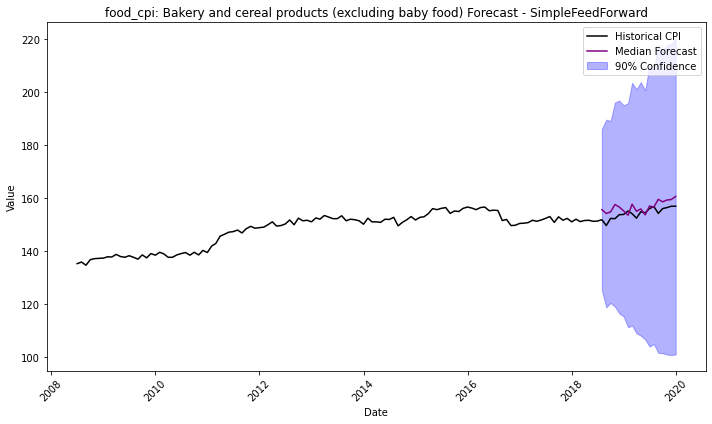

Beginning AutoGluon training... Time limit = 2s
AutoGluon will save models to './output/TEST/ag_global_all_SimpleFeedForwardModel_exp2_R2_/random_seed_42/2018-07-01/model_files/'
=================== System Info ===================
AutoGluon Version:  1.1.1
Python Version:     3.8.20
Operating System:   Linux
Platform Machine:   x86_64
Platform Version:   #147~18.04.1-Ubuntu SMP Sat Oct 15 13:10:18 UTC 2022
CPU Count:          32
GPU Count:          1
Memory Avail:       166.64 GB / 188.57 GB (88.4%)
Disk Space Avail:   18207.21 GB / 249006.62 GB (7.3%)

Fitting with arguments:
{'enable_ensemble': True,
 'eval_metric': MAPE,
 'excluded_model_types': ['DirectTabular', 'RecursiveTabular'],
 'hyperparameters': {'SimpleFeedForwardModel': {}},
 'known_covariates_names': [],
 'num_val_windows': 1,
 'prediction_length': 18,
 'quantile_levels': [0.01, 0.05, 0.1, 0.25, 0.75, 0.9, 0.95, 0.99],
 'random_seed': 42,
 'refit_every_n_windows': 1,
 'refit_full': False,
 'skip_model_selection': False,
 

SimpleFeedForwardModel


	-0.3878       = Validation score (-MAPE)
	2.18    s     = Training runtime
	0.04    s     = Validation (prediction) runtime
Not fitting ensemble due to lack of time remaining. Time left: -0.3 seconds
Training complete. Models trained: ['SimpleFeedForward']
Total runtime: 2.26 s
Best model: SimpleFeedForward
Best model score: -0.3878
Model not specified in predict, will default to the model with the best validation score: SimpleFeedForward
Model not specified in predict, will default to the model with the best validation score: SimpleFeedForward


****************** Summary of fit() ******************
Estimated performance of each model:
               model  score_val  pred_time_val  fit_time_marginal  fit_order
0  SimpleFeedForward  -0.387822       0.038429            2.17821          1
Number of models trained: 1
Types of models trained:
{'MultiWindowBacktestingModel'}
****************** End of fit() summary ******************


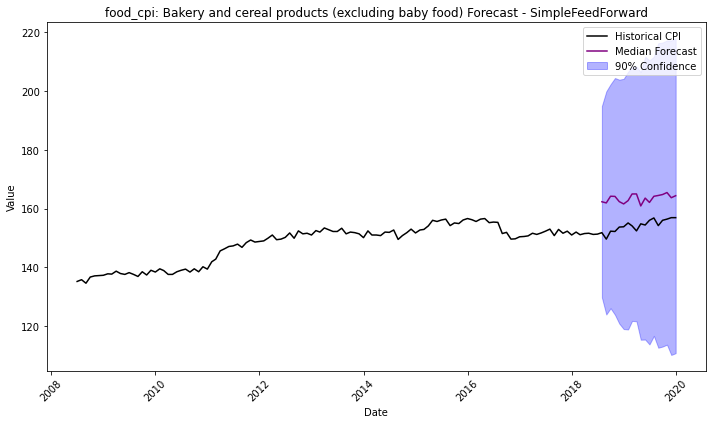

Beginning AutoGluon training... Time limit = 2s
AutoGluon will save models to './output/TEST/ag_global_all_SimpleFeedForwardModel_exp2_GPT_P2_/random_seed_42/2018-07-01/model_files/'
=================== System Info ===================
AutoGluon Version:  1.1.1
Python Version:     3.8.20
Operating System:   Linux
Platform Machine:   x86_64
Platform Version:   #147~18.04.1-Ubuntu SMP Sat Oct 15 13:10:18 UTC 2022
CPU Count:          32
GPU Count:          1
Memory Avail:       166.64 GB / 188.57 GB (88.4%)
Disk Space Avail:   18206.05 GB / 249006.62 GB (7.3%)

Fitting with arguments:
{'enable_ensemble': True,
 'eval_metric': MAPE,
 'excluded_model_types': ['DirectTabular', 'RecursiveTabular'],
 'hyperparameters': {'SimpleFeedForwardModel': {}},
 'known_covariates_names': [],
 'num_val_windows': 1,
 'prediction_length': 18,
 'quantile_levels': [0.01, 0.05, 0.1, 0.25, 0.75, 0.9, 0.95, 0.99],
 'random_seed': 42,
 'refit_every_n_windows': 1,
 'refit_full': False,
 'skip_model_selection': Fals

SimpleFeedForwardModel


	-0.3977       = Validation score (-MAPE)
	1.87    s     = Training runtime
	0.04    s     = Validation (prediction) runtime
Not fitting ensemble due to lack of time remaining. Time left: -0.0 seconds
Training complete. Models trained: ['SimpleFeedForward']
Total runtime: 1.93 s
Best model: SimpleFeedForward
Best model score: -0.3977
Model not specified in predict, will default to the model with the best validation score: SimpleFeedForward
Model not specified in predict, will default to the model with the best validation score: SimpleFeedForward


****************** Summary of fit() ******************
Estimated performance of each model:
               model  score_val  pred_time_val  fit_time_marginal  fit_order
0  SimpleFeedForward  -0.397718       0.039861           1.872042          1
Number of models trained: 1
Types of models trained:
{'MultiWindowBacktestingModel'}
****************** End of fit() summary ******************


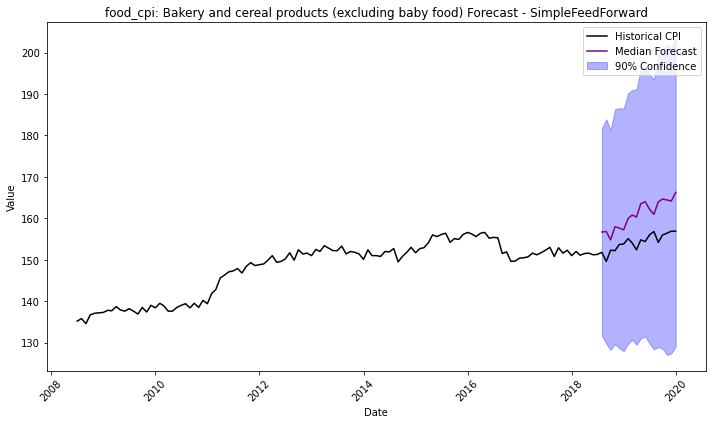

Beginning AutoGluon training... Time limit = 2s
AutoGluon will save models to './output/TEST/ag_global_all_SimpleFeedForwardModel_exp2_R1_/random_seed_42/2018-07-01/model_files/'
=================== System Info ===================
AutoGluon Version:  1.1.1
Python Version:     3.8.20
Operating System:   Linux
Platform Machine:   x86_64
Platform Version:   #147~18.04.1-Ubuntu SMP Sat Oct 15 13:10:18 UTC 2022
CPU Count:          32
GPU Count:          1
Memory Avail:       166.64 GB / 188.57 GB (88.4%)
Disk Space Avail:   18206.20 GB / 249006.62 GB (7.3%)

Fitting with arguments:
{'enable_ensemble': True,
 'eval_metric': MAPE,
 'excluded_model_types': ['DirectTabular', 'RecursiveTabular'],
 'hyperparameters': {'SimpleFeedForwardModel': {}},
 'known_covariates_names': [],
 'num_val_windows': 1,
 'prediction_length': 18,
 'quantile_levels': [0.01, 0.05, 0.1, 0.25, 0.75, 0.9, 0.95, 0.99],
 'random_seed': 42,
 'refit_every_n_windows': 1,
 'refit_full': False,
 'skip_model_selection': False,
 

SimpleFeedForwardModel


	-0.3118       = Validation score (-MAPE)
	1.89    s     = Training runtime
	0.04    s     = Validation (prediction) runtime
Not fitting ensemble due to lack of time remaining. Time left: -0.0 seconds
Training complete. Models trained: ['SimpleFeedForward']
Total runtime: 1.95 s
Best model: SimpleFeedForward
Best model score: -0.3118
Model not specified in predict, will default to the model with the best validation score: SimpleFeedForward
Model not specified in predict, will default to the model with the best validation score: SimpleFeedForward


****************** Summary of fit() ******************
Estimated performance of each model:
               model  score_val  pred_time_val  fit_time_marginal  fit_order
0  SimpleFeedForward  -0.311755       0.040019           1.889028          1
Number of models trained: 1
Types of models trained:
{'MultiWindowBacktestingModel'}
****************** End of fit() summary ******************


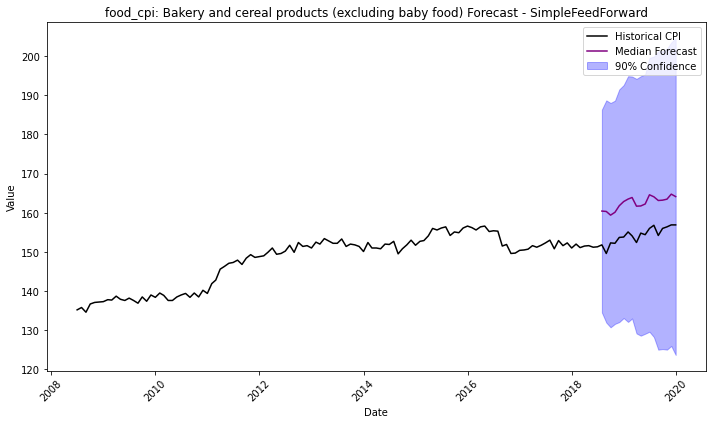

Beginning AutoGluon training... Time limit = 2s
AutoGluon will save models to './output/TEST/ag_global_all_SimpleFeedForwardModel_exp2_R4_/random_seed_42/2018-07-01/model_files/'
=================== System Info ===================
AutoGluon Version:  1.1.1
Python Version:     3.8.20
Operating System:   Linux
Platform Machine:   x86_64
Platform Version:   #147~18.04.1-Ubuntu SMP Sat Oct 15 13:10:18 UTC 2022
CPU Count:          32
GPU Count:          1
Memory Avail:       166.64 GB / 188.57 GB (88.4%)
Disk Space Avail:   18206.20 GB / 249006.62 GB (7.3%)

Fitting with arguments:
{'enable_ensemble': True,
 'eval_metric': MAPE,
 'excluded_model_types': ['DirectTabular', 'RecursiveTabular'],
 'hyperparameters': {'SimpleFeedForwardModel': {}},
 'known_covariates_names': [],
 'num_val_windows': 1,
 'prediction_length': 18,
 'quantile_levels': [0.01, 0.05, 0.1, 0.25, 0.75, 0.9, 0.95, 0.99],
 'random_seed': 42,
 'refit_every_n_windows': 1,
 'refit_full': False,
 'skip_model_selection': False,
 

SimpleFeedForwardModel


	-1.0252       = Validation score (-MAPE)
	0.22    s     = Training runtime
	0.04    s     = Validation (prediction) runtime
Not fitting ensemble as only 1 model was trained.
Training complete. Models trained: ['SimpleFeedForward']
Total runtime: 0.27 s
Best model: SimpleFeedForward
Best model score: -1.0252


****************** Summary of fit() ******************
Estimated performance of each model:
               model  score_val  pred_time_val  fit_time_marginal  fit_order
0  SimpleFeedForward  -1.025164       0.039169           0.217293          1
Number of models trained: 1
Types of models trained:
{'MultiWindowBacktestingModel'}
****************** End of fit() summary ******************


KeyboardInterrupt: 

In [14]:
models_to_test = [
  'SimpleFeedForwardModel',
#   'TemporalFusionTransformerModel',
#    'DeepARModel',

]

EXP_BASE_LIST_GLOBAL = ["ag_global_all"]


for EXP_BASE in EXP_BASE_LIST_GLOBAL:
    EXP_MODEL_LIST = get_model_list(EXP_BASE)
    EXP_MODEL_LIST.reverse()

    for model_type in EXP_MODEL_LIST:
        
        if model_type not in models_to_test:
            continue
            print(model_type)
                

        EXPERIMENT_NAME = f"{EXP_BASE}_{model_type}"
        print(EXPERIMENT_NAME)

        for category in (target_categories):

            
            #For this specific category, collect the experiments that need to be run by filtering the data 
            FILT_EXPS = experiment_dict[category.split("food_cpi: ")[1]]
            
            for cutoff_date in report_sim_dates:
                
                for FILT_NUM in FILT_EXPS:
                    MOD_FILT_NUM = FILT_NUM.replace(category.split("food_cpi: ")[1], "").split('.txt')[0]
                    MOD_EXP_NAME = f"{EXPERIMENT_NAME}_{MOD_FILT_NUM}"
#                     print(FILT_NUM)
                                        
                    with open(f"/h/kupfersk/cfpr_2025/cfpr_variable_selection/Individual_Forecasts/{FILT_NUM}", 'r') as file: 
                        # Use .strip() to remove any trailing newline or spaces
                        item_list = [line.strip() for line in file.readlines()]
                        filt_regressors = item_list
                        
                        
                    
                        
                    forecast_output_dir, plot_output_dir, training_output_dir, model_dir = (
                        create_output_directories(
                            exp_test_description,
                            start_year,
                            MOD_EXP_NAME,
                            cutoff_date,
                            random_seed
                        )
                    )

                    if "_covariates" in EXP_BASE:
                        train_data = processor.get_autogluon_global_with_covariates_df_filt(
                            cutoff_date, filt_regressors
                        )
                    else:
                        train_data = processor.get_autogluon_global_df_filt(cutoff_date, filt_regressors)

                    predictor = fit_predictors_global(model_type, model_dir, train_data, random_seed)


                    process_and_plot_forecasts(
                        predictor,
                        train_data,
                        category,
                        training_output_dir,
                        forecast_output_dir,
                        plot_output_dir,
                        foodprice_df,
                        cutoff_date
                    )

In [ ]:
FILT_NUM